In [1]:
import pandas as pd
import nltk
import spacy

from nltk.sentiment.vader import SentimentIntensityAnalyzer
from nltk.corpus import stopwords
from nltk.corpus import subjectivity
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer
from nltk.sentiment.util import *
from spacytextblob.spacytextblob import SpacyTextBlob
from textblob import TextBlob

In [2]:
example1 = "This is a great tutorial on sentiment analysis!"
df = pd.read_csv("new_df.csv")
twit_col = df["Preprocessed Data"]
na_values = ['data found', 'unk', "NaN", "nan", "0", "N/A"]
requests = pd.read_csv("new_df.csv",
                       na_values=na_values, dtype={'Incident Zip': str})

In [3]:
df = df[df["Preprocessed Data"] != 'data found']
df = df[df["Preprocessed Data"] !='unk']
df = df.dropna()
twit_col = df["Preprocessed Data"]

In [4]:
# TextBlob

strings = []
pol = []
subj = []
pos_or_neg = []

def textblob_sent(text):
    if type(text) == list:
        for string in text: 
#             if type(string) == str:
            sentence = str(string)
            blob = TextBlob(sentence)
            sentiment = blob.sentiment
            print(blob)
                #print(sentiment)

    # For individual scores
    # From this link: https://medium.com/@apappascs/how-to-perform-sentiment-analysis-in-python-using-textblob-dc64f262e9ea
            polarity = blob.sentiment.polarity
            subjectivity = blob.sentiment.subjectivity

            print("Polarity: " + str(polarity))
            print("Subjectivity: " + str(subjectivity))

            global strings
            global pol 
            global subj
            global pos_or_neg

            if polarity > 0:
                score = "Positive"
                print(score)
    #                 pos_or_neg.append(score)

            elif polarity == 0:
                score = "Neutral"
    #                 pos_or_neg.append(score)
                print(score)

            elif polarity < 0:
                score = "Negative"    
                print(score)
    #                 pos_or_neg.append(score)


            strings.append(sentence)
            pol.append(polarity)
            subj.append(subjectivity)
            pos_or_neg.append(score)
            
                
            
                
                #print(blob.sentiment_assessments.assessments)
    else:
        blob = TextBlob(text)
        sentiment = blob.sentiment
        print(blob)
        print(sentiment)

# For individual scores
# From this link: https://medium.com/@apappascs/how-to-perform-sentiment-analysis-in-python-using-textblob-dc64f262e9ea
        polarity = blob.sentiment.polarity
        subjectivity = blob.sentiment.subjectivity

        print("Polarity: ", polarity)
        print("Subjectivity: ", subjectivity)
        print(pos_or_neg)

# From this link https://spacytextblob.netlify.app/
#     print(blob.sentiment_assessments.polarity)
#     print(blob.sentiment_assessments.subjectivity)

# Can also do this: (also from the netlify link) 
# Accoridng to site 
# " a list of polarity and subjectivity scores for the assessed tokens."
        #print(blob.sentiment_assessments.assessments)

In [5]:
new_twit = [item for item in twit_col]
new_twit

['coming borders kill',
 'im getting borderlands kill',
 'im coming borderlands murder',
 'im getting borderlands  murder',
 'im getting borderlands murder',
 'spent hours making something fun know huge borderlands fan maya one favorite characters decided make wallpaper pc original image versus creation made enjoy pic twitter com mlsiwfjg',
 'spent couple hours something fun know huge borderlands fan maya one favorite characters decided make wallpaper pc original picture compared creation made fun pic twitter com mlsiwfjg',
 'spent hours something fun know huge borderlands fan maya one favorite characters',
 'spent hours making something fun know huge rhandlerr fan maya one favorite characters decided make wallpaper pc original image versus creation made enjoy pic twitter com mlsiwfjg',
 ' spent hours making something fun know huge rhandlerr fan maya one favorite characters decided make wallpaper pc original image versus creation made enjoy pic twitter com mlsiwfjg',
 'rock hard la var

In [6]:
tb_sent = textblob_sent(new_twit)
tb_sent

coming borders kill
Polarity: 0.0
Subjectivity: 0.0
Neutral
im getting borderlands kill
Polarity: 0.0
Subjectivity: 0.0
Neutral
im coming borderlands murder
Polarity: 0.0
Subjectivity: 0.0
Neutral
im getting borderlands  murder
Polarity: 0.0
Subjectivity: 0.0
Neutral
im getting borderlands murder
Polarity: 0.0
Subjectivity: 0.0
Neutral
spent hours making something fun know huge borderlands fan maya one favorite characters decided make wallpaper pc original image versus creation made enjoy pic twitter com mlsiwfjg
Polarity: 0.3125
Subjectivity: 0.5750000000000001
Positive
spent couple hours something fun know huge borderlands fan maya one favorite characters decided make wallpaper pc original picture compared creation made fun pic twitter com mlsiwfjg
Polarity: 0.29583333333333334
Subjectivity: 0.525
Positive
spent hours something fun know huge borderlands fan maya one favorite characters
Polarity: 0.275
Subjectivity: 0.55
Positive
spent hours making something fun know huge rhandlerr fa

started playing borderlands  guns love tentacles hear voice half favorite youtube channel gamegrumps hell yeah egoraptor forever apart one best gearboxofficial games creepy ass character
Polarity: 0.2666666666666667
Subjectivity: 0.6133333333333333
Positive
started playing borderlands  weapons love tentacles hear voice half favorite channel gamegrumps hell yeah egoraptor forever separated one best gearboxofficial games creepy ass character
Polarity: 0.2666666666666667
Subjectivity: 0.6133333333333333
Positive
started playing borderlands  weapons love tentacles hear voice half favorite youtube channel gamegrup
Polarity: 0.2777777777777778
Subjectivity: 0.5888888888888889
Positive
started playing borderlands  guns love tentacles wanting lose voices half another favorite youtube channel gamegrumps hell yeah egoraptor forever apart one best gearboxofficial games creepy ass cartoon
Polarity: 0.2666666666666667
Subjectivity: 0.6133333333333333
Positive
started playing borderlands season  gun

keep chin smash hammer chaotic reviews newest borderlands  dlc psycho krieg fantastic fustercluck youtu vcbrxrluy
Polarity: 0.4
Subjectivity: 0.9
Positive
hold chin dream hammer chaotic reviews latest borderlands  dlc psycho war fantastic fustercluck youtu vcbrxrluy
Polarity: 0.45
Subjectivity: 0.9
Positive
hold chin go hammer chaotic reviews newest borderlands  dlc psycho fustercluster youtu vcbrxrluy
Polarity: 0.0
Subjectivity: 0.0
Neutral
keep shields smash hammer chaotic newest borderlands  dlc american psycho mask fantastic fustercluck youtu vcbrxrluy
Polarity: 0.2
Subjectivity: 0.45
Positive
keep chin held go smash hammer chaotic digital reviews upcoming newest borderlands part  game dlc psycho krieg ghost fantastic fustercluck youtu vcbrxrluy
Polarity: 0.0
Subjectivity: 0.43333333333333335
Neutral
keep chin smash hammer also reviews available level  dlc psycho krieg finally fantastic fustercluck youtu vcbrxrluy
Polarity: 0.4
Subjectivity: 0.65
Positive
fuck epic store borderland

Positive
finallevel finally bought copy borderlands  game went awesome legendary balex joined
Polarity: 0.4
Subjectivity: 0.85
Positive
finallevel finally bought copy borderlands 
Polarity: 0.0
Subjectivity: 1.0
Neutral
finallevel finally bought copy borderlands  game went awesome legendary balex entered absolutely killed
Polarity: 0.28
Subjectivity: 0.6799999999999999
Positive
finallevel finally bought copy borderlands  game went awesome dark legendary classic mr balex immediately entered absolutely killed
Polarity: 0.20238095238095238
Subjectivity: 0.5666666666666667
Positive
finallevel finally bought disk borderlands  game went awesome legendary balex entered everyone must despise
Polarity: 0.4
Subjectivity: 0.85
Positive
entire sanic franchise playthrough begins tomorrow rn sekiro poorly translated randomisation twitch tv letofski oh also im dying hair blue randomass borderlands hair dye found sponsor hair pez bro coward https co imnifx
Polarity: -0.13333333333333333
Subjectivity: 

Positive
gon na make huge movie book second season  honestly negativity making whenever want talk angry people recommend borderlands movie careful like stepping dark zone division
Polarity: 0.041666666666666664
Subjectivity: 0.7000000000000001
Positive
full offense bought borderlands  fuck stop giving greasy magician money
Polarity: -0.025000000000000022
Subjectivity: 0.575
Negative
full offense bought borderlands  fuck stop giving money greasy wizard
Polarity: -0.025000000000000022
Subjectivity: 0.575
Negative
total insult bought borderlands  fuck
Polarity: -0.2
Subjectivity: 0.675
Negative
full offense bought borderlands  fuck stop giving greasy magician
Polarity: -0.025000000000000022
Subjectivity: 0.575
Negative
full circle offense ever bought borderlands  fuck stop giving greasy mad magician money
Polarity: -0.225
Subjectivity: 0.7166666666666667
Negative
full offense loved borderlands fuck stop giving little greasy magician money
Polarity: 0.11562499999999995
Subjectivity: 0.6125

Subjectivity: 0.2
Positive
thanks dlonrichardson bridge sub bbnprod bits really appreciate good  hour stream depth cold vietnam war maxed level  got clips thanks sir therealscaz thanks wolfxswervo bbnprod playing tonight
Polarity: 0.15000000000000002
Subjectivity: 0.4000000000000001
Positive
thanks even without sub dlonrichardson bits really appreciate good  hour stream cold war maxed level set extra clips lots bbnprod therealscaz playing tonight
Polarity: 0.10000000000000002
Subjectivity: 0.42000000000000004
Positive
new vid modern warfare morons paste eating hot takes black ops cold war youtube com watch v uqarhn https co uybijhsab
Polarity: -0.16338383838383838
Subjectivity: 0.672979797979798
Negative
new vid modern warfare idions paste eating hot takes black ops cold war youtube com watch v uqarhn https co uybijhsab
Polarity: -0.036060606060606036
Subjectivity: 0.6075757575757577
Negative
new vid modern warfare morons paste eating hot takes black ops cold war youtube com watch v uq

Subjectivity: 0.5833333333333334
Positive
also know trash bo multiplayer remaining chance get honesty normally mind black ops remaster nothing could ever worse mw get work
Polarity: -0.1388888888888889
Subjectivity: 0.561111111111111
Negative
dislike hate bo multiplayer chance get truth rarely mind black ops remaster nothing could ever worse black get work
Polarity: -0.24666666666666667
Subjectivity: 0.6533333333333333
Negative
tried new auto sprint
Polarity: 0.13636363636363635
Subjectivity: 0.45454545454545453
Positive
tried new auto sprint
Polarity: 0.13636363636363635
Subjectivity: 0.45454545454545453
Positive
tried new car sprint
Polarity: 0.13636363636363635
Subjectivity: 0.45454545454545453
Positive
tried new micro sprint
Polarity: 0.13636363636363635
Subjectivity: 0.45454545454545453
Positive
tried new electronic auto sprint
Polarity: 0.13636363636363635
Subjectivity: 0.45454545454545453
Positive
tried single auto sprint
Polarity: -0.07142857142857142
Subjectivity: 0.2142857142

Polarity: 0.0
Subjectivity: 0.0
Neutral
oh god
Polarity: 0.0
Subjectivity: 0.0
Neutral
oh
Polarity: 0.0
Subjectivity: 0.0
Neutral
oh goddd
Polarity: 0.0
Subjectivity: 0.0
Neutral
oh lord
Polarity: 0.0
Subjectivity: 0.0
Neutral
callofduty atviassist apparently cant seem play
Polarity: 0.05
Subjectivity: 0.35
Positive
callofduty atviassist apparently seem play
Polarity: 0.05
Subjectivity: 0.35
Positive
cfduty atviassist apparently someone seem play
Polarity: 0.05
Subjectivity: 0.35
Positive
callofduty atviassist apparently purpose cant seem play
Polarity: 0.05
Subjectivity: 0.35
Positive
callofduty atviassist apparently cant seem really play
Polarity: 0.125
Subjectivity: 0.275
Positive
callofduty atviassist apparently cant play
Polarity: 0.05
Subjectivity: 0.35
Positive
perfection
Polarity: 0.0
Subjectivity: 0.0
Neutral
perfection
Polarity: 0.0
Subjectivity: 0.0
Neutral
perfect
Polarity: 1.0
Subjectivity: 1.0
Positive
perfection
Polarity: 0.0
Subjectivity: 0.0
Neutral
perfection
Polarity

Polarity: -0.032407407407407406
Subjectivity: 0.4731481481481482
Negative
g
Polarity: 0.0
Subjectivity: 0.0
Neutral
g
Polarity: 0.0
Subjectivity: 0.0
Neutral
g
Polarity: 0.0
Subjectivity: 0.0
Neutral
g
Polarity: 0.0
Subjectivity: 0.0
Neutral
g
Polarity: 0.0
Subjectivity: 0.0
Neutral
xbox early access day cant wait play
Polarity: 0.1
Subjectivity: 0.3
Positive
xbox early access day wait play
Polarity: 0.1
Subjectivity: 0.3
Positive
xbox early access day wait play
Polarity: 0.1
Subjectivity: 0.3
Positive
xbox early game day cant wait play unk
Polarity: -0.15000000000000002
Subjectivity: 0.35
Negative
xbox early access day say wait play
Polarity: 0.1
Subjectivity: 0.3
Positive
still early one day could wait play
Polarity: 0.1
Subjectivity: 0.3
Positive
perfect
Polarity: 1.0
Subjectivity: 1.0
Positive
perfect
Polarity: 1.0
Subjectivity: 1.0
Positive
perfect
Polarity: 1.0
Subjectivity: 1.0
Positive
perfect
Polarity: 1.0
Subjectivity: 1.0
Positive
perfect perfect
Polarity: 1.0
Subjectivity: 

sending right veins
Polarity: 0.2857142857142857
Subjectivity: 0.5357142857142857
Positive
unless treyarch takes damn bushes cartel map destined fail
Polarity: -0.5
Subjectivity: 0.29999999999999993
Negative
treyarch remove damn shrubs cartel card doomed fail
Polarity: -0.5
Subjectivity: 0.29999999999999993
Negative
indifferent treyarch takes damn money cartel card doomed fail
Polarity: -0.5
Subjectivity: 0.29999999999999993
Negative
unless treyarch takes damn bushes cartel map destined fail
Polarity: -0.5
Subjectivity: 0.29999999999999993
Negative
unless treyarch takes damn bushes cartel grid map destined fail
Polarity: -0.5
Subjectivity: 0.29999999999999993
Negative
everybody takes damn bushes cartel map destined fail
Polarity: -0.5
Subjectivity: 0.29999999999999993
Negative
git gud head sniping community probably
Polarity: 0.0
Subjectivity: 0.0
Neutral
git gud head sniper community probably
Polarity: 0.0
Subjectivity: 0.0
Neutral
hood head sniper community likely
Polarity: 0.0
Subje

amazon basics amazon recommended products bad track day column   already broke conveniently one warranty expired
Polarity: -0.6999999999999998
Subjectivity: 0.6666666666666666
Negative
amazonin amazon amazonhelp top cancel order details say customer cancelled order want befool
Polarity: 0.5
Subjectivity: 0.5
Positive
amazonin amazon amazonhelp top cancel order indicate customer cancelled order trying deceive
Polarity: 0.5
Subjectivity: 0.5
Positive
amazonin amazon amazonhelp also cancel order say detail customer cancelled order want fool
Polarity: 0.0
Subjectivity: 0.0
Neutral
amazonin amazon top cancel order details customer cancelled order want befool
Polarity: 0.5
Subjectivity: 0.5
Positive
amazonin amazon amazonhelp top trying apparently absolutely cancel new order details say customer simply cancelled order else want befool
Polarity: 0.20909090909090908
Subjectivity: 0.5529220779220779
Positive
amazonin return amazon top cancel order without details customer actually cancelled ord

Neutral
fucked
Polarity: -0.6
Subjectivity: 0.7
Negative
fucked
Polarity: -0.6
Subjectivity: 0.7
Negative
fucked unk
Polarity: -0.6
Subjectivity: 0.7
Negative
felt fucked unk
Polarity: -0.6
Subjectivity: 0.7
Negative
plain janie smart janie shes good sister never causes trouble meet janie secrets
Polarity: 0.12499999999999999
Subjectivity: 0.45
Positive
simple janie clever janie good sister never causes problems meet janie secrets
Polarity: 0.28888888888888886
Subjectivity: 0.5968253968253968
Positive
plain janie clever janie kind sister never causes trouble
Polarity: 0.0880952380952381
Subjectivity: 0.5726190476190477
Positive
plain janie smart janie shes one good sister never causes trouble meet us janie secrets podcast
Polarity: 0.12499999999999999
Subjectivity: 0.45
Positive
plain tough janie smart janie good younger sister girl almost never causes trouble meet janie secrets
Polarity: 0.018518518518518517
Subjectivity: 0.43888888888888894
Positive
plain janie smart girl good sister

Positive
time despite fact currently  million people living poverty line access health services access health care access health care
Polarity: 0.0
Subjectivity: 0.4
Neutral
amazon scheduled reverse pick since  feb  person comes pick refuse pick saying number matching kindly pls help get problem
Polarity: 0.6
Subjectivity: 0.9
Positive
amazon planning reverse pickup since february   person comes pick refuses pick saying number match give friendly advice help get problem
Polarity: 0.375
Subjectivity: 0.5
Positive
amazon scheduled reverse pick since  feb  person comes pick refer pick saying number matching kindly pls help get problem
Polarity: 0.6
Subjectivity: 0.9
Positive
amazon scheduled reverse pick since  feb  person comes pick refuse pick saying number matching something kindly pls help find problem
Polarity: 0.6
Subjectivity: 0.9
Positive
amazon scheduled reverse pick since  feb  person always comes pick always refuse pick saying number  matching kindly pls help get us problem
Pol

Subjectivity: 0.55
Negative
agree excellent
Polarity: 1.0
Subjectivity: 1.0
Positive
agree great
Polarity: 0.8
Subjectivity: 0.75
Positive
agree
Polarity: 0.0
Subjectivity: 0.0
Neutral
agree clearer excellent
Polarity: 1.0
Subjectivity: 1.0
Positive
agree excellent
Polarity: 1.0
Subjectivity: 1.0
Positive
agree darren excellent
Polarity: 1.0
Subjectivity: 1.0
Positive
one standout favourite novels  go grab
Polarity: 0.0
Subjectivity: 0.0
Neutral
one favourite novels 
Polarity: 0.0
Subjectivity: 0.0
Neutral
one favorite games 
Polarity: 0.5
Subjectivity: 1.0
Positive
one favourite novels  go grab
Polarity: 0.0
Subjectivity: 0.0
Neutral
one even standout favourite novels sf  go grab
Polarity: 0.0
Subjectivity: 0.0
Neutral
one standout favourite novels  go grab
Polarity: 0.0
Subjectivity: 0.0
Neutral
amazon translate ranked techtldr 
Polarity: 0.0
Subjectivity: 0.0
Neutral
amazon translate ranks techtldr 
Polarity: 0.0
Subjectivity: 0.0
Neutral
amazon translate ranks first time telldr  ra

Subjectivity: 0.38863636363636367
Positive
new tlou trailer released tomorrow meanwhile best selling game amazon listen leaks rants experience game
Polarity: 0.08409090909090905
Subjectivity: 0.38863636363636367
Positive
new tlou trailer drops tomorrow meanwhile best selling game amazon listen filters badminton experience game
Polarity: 0.08409090909090905
Subjectivity: 0.38863636363636367
Positive
new campaign trailer dropping tomorrow meanwhile number  hardest selling game amazon dont listen reviews badmouthing experience game vr
Polarity: -0.22121212121212122
Subjectivity: 0.41818181818181815
Negative
new tlou trailer money dropping tomorrow meanwhile  number   best selling game amazon listen enough see twitter leaks coming badmouthing experience game
Polarity: 0.06727272727272723
Subjectivity: 0.41090909090909095
Positive
new tlou trailer dropping meanwhile find number  best rated game amazon dont listen leaks reviews buy game
Polarity: 0.08409090909090905
Subjectivity: 0.388636363

Polarity: 0.2
Subjectivity: 0.2
Positive
hit  followers lets goo around   thank guys much watching tv chilling us today ton overwatch pc today cya tomorrow great genshin impact shit cap
Polarity: 0.075
Subjectivity: 0.6625000000000001
Positive
hit  followers goo   thank guys thus far watching chilling watch ton overwatch pc today go tomorrow genshin impact knee cap
Polarity: -0.2
Subjectivity: 0.95
Negative
hurts brain
Polarity: 0.0
Subjectivity: 0.0
Neutral
hurts brain
Polarity: 0.0
Subjectivity: 0.0
Neutral
hurts brain
Polarity: 0.0
Subjectivity: 0.0
Neutral
hurts faith
Polarity: 0.0
Subjectivity: 0.0
Neutral
hurts brain
Polarity: 0.0
Subjectivity: 0.0
Neutral
hurts brain
Polarity: 0.0
Subjectivity: 0.0
Neutral
best random overwatch youtu cmqfboucg
Polarity: 0.25
Subjectivity: 0.4
Positive
best chance overwatch youtu cmqfboucg
Polarity: 1.0
Subjectivity: 0.3
Positive
best random overwatch youtu cmqfboucg
Polarity: 0.25
Subjectivity: 0.4
Positive
best random youtube youtu cmqfboucg
Po

Negative
remember little brigitte running around overwatch base mean weird bring child games zoo cute
Polarity: -0.26
Subjectivity: 0.8375
Negative
remember little brigitte running around overwatch base actually mean weird together bring child work day cute
Polarity: -0.26
Subjectivity: 0.8375
Negative
watched little brigitte running around overwatch base mean weird bring heart space dvd cute
Polarity: -0.26
Subjectivity: 0.8375
Negative
yay friday great day every live today   uk time link bio
Polarity: 0.4681818181818182
Subjectivity: 0.625
Positive
yay friday great day every live today   uk time link bio
Polarity: 0.4681818181818182
Subjectivity: 0.625
Positive
yay friday great day everyone live today   uk time link
Polarity: 0.4681818181818182
Subjectivity: 0.625
Positive
yay friday great day every live stream   uk time link story bio
Polarity: 0.4681818181818182
Subjectivity: 0.625
Positive
yay really friday great day unk go live today   uk time link bio
Polarity: 0.378787878787878

want quit fortnite game could play tried playing overwatch titanfall reubber banding badly cant get game takes least  month  play already played campaign games
Polarity: -0.45
Subjectivity: 0.4666666666666667
Negative
tried quit fortnite game could play tried playing overwatch titanfall rubber banding badly cant get every game since takes least  month something play already played campaign games
Polarity: -0.45
Subjectivity: 0.4666666666666667
Negative
want quit fortnite great game could probably play tried playing overwatch titanfall rubber banding badly like cant get one game takes one least  calendar month  play already played campaign games
Polarity: -0.19999999999999996
Subjectivity: 0.5233333333333332
Negative
want quit fortnite game could blame tried playing overwatch titanfall god rubber banding fucking badly cant get good game starts  month  play already played campaign based
Polarity: -0.19999999999999998
Subjectivity: 0.5166666666666667
Negative
lets continue slaying demons 

holy balls unreal
Polarity: 0.0
Subjectivity: 0.0
Neutral
holy unreal
Polarity: 0.0
Subjectivity: 0.0
Neutral
also overwatch looks like fun little piece equipment currently crave incredibly expensive
Polarity: -0.096875
Subjectivity: 0.45
Negative
also overwatch looks like funny little device craving right incredibly expensive
Polarity: -0.037946428571428575
Subjectivity: 0.6839285714285714
Negative
also overwatch look like fun little piece equipment currently craving incredibly expensive
Polarity: -0.096875
Subjectivity: 0.45
Negative
also overwatch looks like fun vr piece equipment currently crave incredibly frustrating
Polarity: -0.03333333333333335
Subjectivity: 0.5
Negative
also overwatch looks like fun little piece equipment currently genuinely crave incredibly expensive
Polarity: 0.003124999999999989
Subjectivity: 0.475
Positive
also overwatch looks like incredibly fun little piece equipment currently incredibly brilliant
Polarity: 0.33749999999999997
Subjectivity: 0.56666666666

want one
Polarity: 0.0
Subjectivity: 0.0
Neutral
want one
Polarity: 0.0
Subjectivity: 0.0
Neutral
want one
Polarity: 0.0
Subjectivity: 0.0
Neutral
choose one
Polarity: 0.0
Subjectivity: 0.0
Neutral
want one
Polarity: 0.0
Subjectivity: 0.0
Neutral
want gold
Polarity: 0.0
Subjectivity: 0.0
Neutral
lie taste tastes like pic twitter com kjqgszzlkm
Polarity: 0.0
Subjectivity: 0.0
Neutral
lie taste tastes like pic twitter com kjqgszzlkm
Polarity: 0.0
Subjectivity: 0.0
Neutral
lie taste delicious like pic facebook com kjqgszzlkm
Polarity: 1.0
Subjectivity: 1.0
Positive
lie taste tastes like pic twitter com kjqgszzlkm
Polarity: 0.0
Subjectivity: 0.0
Neutral
 lie taste tastes like pic twitter com kjqgszzlkm
Polarity: 0.0
Subjectivity: 0.0
Neutral
last year taught super happy xbox seems idea
Polarity: 0.37777777777777777
Subjectivity: 0.5777777777777778
Positive
last year taught super happy xbox seems idea
Polarity: 0.37777777777777777
Subjectivity: 0.5777777777777778
Positive
last year taught a

grind hard folks even harder others morning hilarious shit made laugh hard remember st wave nd wave different
Polarity: -0.011904761904761918
Subjectivity: 0.511904761904762
Negative
people grind even harder morning hilarious shit made laugh much remember first wave second wave different
Polarity: 0.11875
Subjectivity: 0.3791666666666667
Positive
hard even harder others morning fun crap made laugh much remember first wave second wave different
Polarity: -0.015740740740740753
Subjectivity: 0.30833333333333335
Negative
grind hard us folks even harder others yet morning hilarious shit made laugh hard hope previous wave nd wave different
Polarity: -0.031250000000000014
Subjectivity: 0.46875
Negative
grind transition hard folks even harder others past morning hilarious shit made laugh hard still remember st wave nd wave different since unk
Polarity: -0.04166666666666668
Subjectivity: 0.4791666666666667
Negative
summer hard even harder others week felt hilarious weekend made laugh hard remem

new super lucky tale cheggenem breve xboxgamepara e pc play together anytime anywhere playfullucky
Polarity: 0.2676767676767677
Subjectivity: 0.6515151515151515
Positive
new super lucky tale adventures chegando breve xboxgamepass para console e pc play everywhere anytime anywhere playfullucky
Polarity: 0.2676767676767677
Subjectivity: 0.6515151515151515
Positive
joe new super friends lucky  tale unk chegando con em la breve que xboxgamepass para console e pc  play together anytime anywhere playfullucky
Polarity: 0.2676767676767677
Subjectivity: 0.6515151515151515
Positive
new super lucky tale unk chegando breve para de e pc watch anything anytime anywhere playfullucky
Polarity: 0.2676767676767677
Subjectivity: 0.6515151515151515
Positive
top  awesome developer fail market old games dlc edition state
Polarity: 0.275
Subjectivity: 0.49999999999999994
Positive
top  awesome developers manage market old games dlc version
Polarity: 0.5333333333333333
Subjectivity: 0.5666666666666667
Positive

antebellum movie director clearly uses horror process america racial problems  current olympic equestrian sport eventing longer held pennsylvania estate resisted calls change name say evokes family slavery
Polarity: 0.05000000000000001
Subjectivity: 0.39166666666666666
Positive
antebellum one charity uses magic process germany racial problems famed marathon sport eventing longer held california estate resisted calls change name say evokes slavery
Polarity: 0.5
Subjectivity: 1.0
Positive
wait see side side comparison
Polarity: 0.0
Subjectivity: 0.0
Neutral
wait see comparison
Polarity: 0.0
Subjectivity: 0.0
Neutral
wait see side side comparison
Polarity: 0.0
Subjectivity: 0.0
Neutral
wait see side sided comparison
Polarity: 0.0
Subjectivity: 0.0
Neutral
wait see nice side popular side comparison
Polarity: 0.6
Subjectivity: 0.95
Positive
still wait see side side comparison
Polarity: 0.0
Subjectivity: 0.0
Neutral
damn embarrassing
Polarity: 0.0
Subjectivity: 0.0
Neutral
damn embarrassing


Polarity: 0.4
Subjectivity: 0.5
Positive
sht smooth unk
Polarity: 0.4
Subjectivity: 0.5
Positive
nbak k started sync wouldnt finish cant play
Polarity: 0.0
Subjectivity: 0.0
Neutral
nbak k started sync would stop play
Polarity: 0.0
Subjectivity: 0.0
Neutral
nk k started sync finish play
Polarity: 0.0
Subjectivity: 0.0
Neutral
nbak k started die finish cant play
Polarity: 0.0
Subjectivity: 0.0
Neutral
nbak k started sync finish go play
Polarity: 0.0
Subjectivity: 0.0
Neutral
nbak monitors started sync wouldnt match cant play
Polarity: 0.0
Subjectivity: 0.0
Neutral
yoyaltygaming cant see
Polarity: 0.0
Subjectivity: 0.0
Neutral
yoyaltygaming see
Polarity: 0.0
Subjectivity: 0.0
Neutral
yoyaltygaming see
Polarity: 0.0
Subjectivity: 0.0
Neutral
yoyaltygaming cant see much
Polarity: 0.2
Subjectivity: 0.2
Positive
yoyaltygaming see
Polarity: 0.0
Subjectivity: 0.0
Neutral
yoyaltygaming cant like
Polarity: 0.0
Subjectivity: 0.0
Neutral
k games never
Polarity: 0.0
Subjectivity: 0.0
Neutral
k game

Negative
nbak fuck u
Polarity: -0.4
Subjectivity: 0.6
Negative
nbak
Polarity: 0.0
Subjectivity: 0.0
Neutral
nk fuck u
Polarity: -0.4
Subjectivity: 0.6
Negative
nbak u u
Polarity: 0.0
Subjectivity: 0.0
Neutral
nbak fuck u
Polarity: -0.4
Subjectivity: 0.6
Negative
ever fuck u
Polarity: -0.4
Subjectivity: 0.6
Negative
k needa buff shooting tad bit extreme amount still want skill gap also backup receiving vc boosts etc wack downloaded game  still havent gotten think k good one beluba ronniek nbak
Polarity: 0.05833333333333331
Subjectivity: 0.6666666666666666
Positive
k needa buff shooting bit extreme amount still want skill gap also backup receiving vc boosts etc wack downloaded game am still got think k good one beluba ronniek nbak
Polarity: 0.05833333333333331
Subjectivity: 0.6666666666666666
Positive
k need buff shooting tad bit extreme amount still want skills away also backup receiving vc boosts trouble wack download game  still got think k good one beluba ronk nk
Polarity: -0.0062500

shoutout nbak blackout yesterday one time gladly got game
Polarity: 0.04999999999999999
Subjectivity: 0.7
Positive
shout nbak blackout yesterday
Polarity: 0.0
Subjectivity: 0.0
Neutral
shout nk blackout yesterday
Polarity: 0.0
Subjectivity: 0.0
Neutral
shoutout blackout yesterday one time gladly got game
Polarity: 0.04999999999999999
Subjectivity: 0.7
Positive
nine shoutout nbak blackout yesterday one time yesterday gladly got game
Polarity: 0.04999999999999999
Subjectivity: 0.7
Positive
unk nbak blackout yesterday one time gladly got one game
Polarity: 0.04999999999999999
Subjectivity: 0.7
Positive
someone needs held accountable atrocities thread nbak ldk ronniek beluba
Polarity: 0.0
Subjectivity: 0.0
Neutral
someone needs held accountable atrocities thread nbak ldk ronniek beluba
Polarity: 0.0
Subjectivity: 0.0
Neutral
someone needs held accountable atrocities trio nk ldk ronk beluba
Polarity: 0.0
Subjectivity: 0.0
Neutral
someone needs ot held accountable atrocities thread nbak ldk 

remember shit
Polarity: -0.2
Subjectivity: 0.8
Negative
remember shit
Polarity: -0.2
Subjectivity: 0.8
Negative
remember white bullshit
Polarity: 0.0
Subjectivity: 0.0
Neutral
remember using bullshit unk
Polarity: 0.0
Subjectivity: 0.0
Neutral
remember bullshit unk
Polarity: 0.0
Subjectivity: 0.0
Neutral
quit one game nbak cause shitty servers hundreds games played suddenly devil banned even using phone lmao
Polarity: 0.06666666666666665
Subjectivity: 0.6333333333333333
Positive
quit game nbak crappy servers hundreds games played suddenly devil even allowed use phone anymore
Polarity: -0.2
Subjectivity: 0.45
Negative
dropped one nk game crap servers hundreds games played suddenly villain banned even using phone lmao
Polarity: -0.15000000000000005
Subjectivity: 0.675
Negative
quit one game nbak complaining shitty servers among hundreds mods played suddenly devil banned even using phone tour lmao
Polarity: 0.06666666666666665
Subjectivity: 0.6333333333333333
Positive
quit one game short 

nk take bulls double pass x bkuchs makes crazy
Polarity: -0.3
Subjectivity: 0.45
Negative
nbak pulls double pass bullshii w x bcuhz making mad
Polarity: -0.3125
Subjectivity: 0.5
Negative
nbak take toward double pass bullshii b w x bcuhz making mad
Polarity: -0.3125
Subjectivity: 0.5
Negative
take double pass bullshii w unk bcuhz makes mad
Polarity: -0.3125
Subjectivity: 0.5
Negative
two youngins good
Polarity: 0.7
Subjectivity: 0.6000000000000001
Positive
two youngins good
Polarity: 0.7
Subjectivity: 0.6000000000000001
Positive
two joynes good thing
Polarity: 0.7
Subjectivity: 0.6000000000000001
Positive
two youngins enough
Polarity: 0.0
Subjectivity: 0.5
Neutral
two youngins morning good
Polarity: 0.7
Subjectivity: 0.6000000000000001
Positive
two youngins coming
Polarity: 0.0
Subjectivity: 0.0
Neutral
nbak myteam hate game spent  got victor twice fuck ronniek fuck k im buying next one fuck bullshit game
Polarity: -0.3625
Subjectivity: 0.45
Negative
nbak myteam hate game spent  got wi

Polarity: 1.0
Subjectivity: 0.3
Positive
best gameplay dota  team liquid esl one worlddailynews org best gamep worlddailynews org best gamep
Polarity: 1.0
Subjectivity: 0.3
Positive
best gameplay dota  team liquid esl one
Polarity: 1.0
Subjectivity: 0.3
Positive
best gameplay dota cup team picks esl  worlddailynews org best gamep worlddailynews org best gamep
Polarity: 1.0
Subjectivity: 0.3
Positive
top best first gameplay dota  team liquid  esl one worlddailynews org best right gamep worlddailynews org best worst gamep
Polarity: 0.4336734693877551
Subjectivity: 0.4670068027210884
Positive
 power gameplay dota  head vs esl one org best gamep org best gamep
Polarity: 1.0
Subjectivity: 0.3
Positive
played one game dota  around  months ago shits giggles old times sake sent rabbit hole going hours pro gameplay footage reading patch notes trying capitalize broken metas
Polarity: -0.23333333333333336
Subjectivity: 0.3333333333333333
Negative
played game dota   months ago shit giggles sake ol

Subjectivity: 0.4
Positive
server pls fix dota
Polarity: 0.0
Subjectivity: 0.0
Neutral
server pls fix dota
Polarity: 0.0
Subjectivity: 0.0
Neutral
dota getting worse
Polarity: -0.4
Subjectivity: 0.6
Negative
dota getting worse
Polarity: -0.4
Subjectivity: 0.6
Negative
da getting worse
Polarity: -0.4
Subjectivity: 0.6
Negative
dota slowly getting worse
Polarity: -0.35000000000000003
Subjectivity: 0.5
Negative
dota getting worse
Polarity: -0.4
Subjectivity: 0.6
Negative
thing getting worse
Polarity: -0.4
Subjectivity: 0.6
Negative
great fun games u games see item player know suffer next min dota pic twitter com zdqihqzid
Polarity: 0.3666666666666667
Subjectivity: 0.31666666666666665
Positive
great fun games games see article player know suffer next  minutes dota pic twitter com zdqihqzid
Polarity: 0.3666666666666667
Subjectivity: 0.31666666666666665
Positive
great fun games games see item player know going suffer next  minutes ddqihqzid pic facebook com zdqihqzid
Polarity: 0.366666666666

many good things happening
Polarity: 0.6
Subjectivity: 0.55
Positive
three best things experienced new system support t teams much better squads chance make regionals via competitive qualies ah many good things happening
Polarity: 0.6060606060606061
Subjectivity: 0.5424242424242424
Positive
oh also one example best things read new ranking system support t teams much better champions new young squads chance make right regionals via open qualies many good things happening
Polarity: 0.3731601731601731
Subjectivity: 0.47164502164502164
Positive
sort best things quite new system support t teams really much better new squads chance make regionals via open qualies many good things said
Polarity: 0.42467532467532465
Subjectivity: 0.4727272727272727
Positive
stabbing dota  smelly casey
Polarity: -0.6
Subjectivity: 0.8
Negative
sting smelly dota  casey
Polarity: 0.0
Subjectivity: 0.0
Neutral
stabilizing dota  smelly casey
Polarity: 0.0
Subjectivity: 0.0
Neutral
stabbing dota smelly casey
Polarit

yesterday played intense hm turbo game rhandlerr amazing never seen tier  items hahahah rhandlerr patch great used  black holes single fight killed roshan  times pic twitter com mibpwzsey
Polarity: 0.10884353741496601
Subjectivity: 0.5282312925170068
Positive
r yesterday played intense hm turbo game rhandlerr amazing never seen tier  items hahahah rhandlerr patch great used  black holes single fight killed roshan  times pic twitter com mibpwzsey
Polarity: 0.10884353741496601
Subjectivity: 0.5282312925170068
Positive
skl infamously known worldwide ang filipino sa dota  community ang tawag saila saton peenoise due toxic behavior sa hampang never would thought nga pati pa gale sa government aspect may ara japon toxic
Polarity: -0.3125
Subjectivity: 0.6875
Negative
skl infamous known worldwide ang filipino sa dota  community ang tawag saila saton peenoise due toxic behavior sa hampang never thought nga pati pa gale sa government aspect may ara japon toxic
Polarity: -0.3125
Subjectivity: 0.

welp ps damn fuck u walmart fucking fault dropping earlier fucking shit ass fucking crack head ass company fuck
Polarity: -0.36666666666666664
Subjectivity: 0.6833333333333332
Negative
welp ps damn fuck u walmart fucking fault drop early fucking shit ass fucking crack head ass company fuck
Polarity: -0.35000000000000003
Subjectivity: 0.65
Negative
welp ps damn fuck u walmart fucking fault dropping earlier fucking shit ass fucking crack head ass company fuck
Polarity: -0.36666666666666664
Subjectivity: 0.6833333333333332
Negative
welp use damn fuck u walmart fucking fault dropping son shit shit ass fucking crack head ass company fuck
Polarity: -0.39999999999999997
Subjectivity: 0.7333333333333333
Negative
welp love ps damn fuck u walmart fucking fault dropping earlier little fucking shit cold ass fucking crack head smart ass company fuck
Polarity: -0.2273214285714286
Subjectivity: 0.6842857142857143
Negative
welp ps fuck u walmart fucking fault dropping damn fucking crazy ass fucking cr

worst memory basically since first quiz im always one question away like b always gettin cs math grade got would get ps fucked  one question  didnt even get hard ones wrong easy ones
Polarity: -0.2847222222222222
Subjectivity: 0.7180555555555554
Negative
total worst luck basically since first math quiz always one question away form b always gettin cs rd  mid new term got would get ps fucked  one question  even get hard ones wrong fucking easy unk
Polarity: -0.17466329966329966
Subjectivity: 0.6125420875420875
Negative
actually worst luck basically since first quiz im one question away b always gettin worse apparently mid term got would get ps fucked  one question  didnt always get worst ones wrong fucking thick ones unk
Polarity: -0.44375
Subjectivity: 0.6260416666666666
Negative
im never nigga never plan nigga dont even let women buy food
Polarity: 0.0
Subjectivity: 0.0
Neutral
never ebony never plan ebony even let women buy food
Polarity: 0.0
Subjectivity: 0.0
Neutral
never nigga nev

ah well seems mistake guess wait try ps backwards button turns legendary rumored
Polarity: 1.0
Subjectivity: 1.0
Positive
ah well seems mistake guess wait downstairs get ps backwards compatibility compatibility issue turns still legendary old rumored possibly
Polarity: 0.3666666666666667
Subjectivity: 0.7333333333333334
Positive
ah well seems mistake guess wait get ps backwards compatibility turns sheer failure everyone seems rumored
Polarity: -0.15833333333333335
Subjectivity: 0.525
Negative
noticed ps media remote unlabeled buttons reflect actually looks like blank buttons press images avoid spoiling something werent ready talk yet pic twitter com ziffnduad
Polarity: 0.025
Subjectivity: 0.2
Positive
noticed ps media remote unlabeled buttons reflect actually looks like hide buttons press images avoid spoiling something ready talk yet pic twitter com ziffnduad
Polarity: 0.03333333333333333
Subjectivity: 0.26666666666666666
Positive
noticed ps media remote unmarked buttons reflect reall

want ps know probably get lot views unboxing  quid sort money floating around saving move girlfriend ps bottom shopping list right afraid
Polarity: -0.15714285714285714
Subjectivity: 0.7178571428571429
Negative
want ps know probably generate lot views included unboxing realistically  quid sort money floating around saving move girlfriend ps bottom people shopping list right afraid
Polarity: -0.15714285714285714
Subjectivity: 0.7178571428571429
Negative
want ps know quite probably get lot worth views online unboxing  dollar quid quite sort cool money floating somewhere around saving enough move girlfriend already ps bottom piece shopping list right afraid
Polarity: 0.06714285714285713
Subjectivity: 0.5371428571428571
Positive
want ps suppose probably get lot views unboxing   quid sort money floating around prefer saving move girlfriend ps certainly bottom everything list right afraid
Polarity: -0.033333333333333326
Subjectivity: 0.669047619047619
Negative
seems inefficient
Polarity: 0.0

really excited see wait see whatever asmongold esfandtv tipsoutbaby richwcampbell realmizkif offers within esports streaming spheres
Polarity: 0.2375
Subjectivity: 0.375
Positive
really excited see today wait completely see asmongold r esfandtv tipsoutbaby richwcampbell r realmizkif within icc esports region streaming spheres
Polarity: 0.2375
Subjectivity: 0.575
Positive
surprised see today wait learn asmongold esfandtv tipsoutbaby r richwcampbell esports streaming communities
Polarity: 0.1
Subjectivity: 0.9
Positive
classic wow loot farming uldaman pages  
Polarity: 0.13333333333333333
Subjectivity: 0.5833333333333334
Positive
classic wow agricultural loot uldaman pages  
Polarity: 0.13333333333333333
Subjectivity: 0.5833333333333334
Positive
classical wow loot farming uldaman pages  
Polarity: 0.05
Subjectivity: 0.5
Positive
classic wow loot king uldaman pages  
Polarity: 0.13333333333333333
Subjectivity: 0.5833333333333334
Positive
classic classic wow loot farming uldaman ii pages  

Subjectivity: 1.0
Positive
boosting giveaway
Polarity: 0.0
Subjectivity: 0.0
Neutral
boosting awesome giveaway prices
Polarity: 1.0
Subjectivity: 1.0
Positive
boosting awesome video
Polarity: 1.0
Subjectivity: 1.0
Positive
warcraft nice job human character customizations pic twitter com huhskdbph
Polarity: 0.3
Subjectivity: 0.55
Positive
warcraft nice job human characters pic twitter com huhskdbph
Polarity: 0.3
Subjectivity: 0.55
Positive
warcraft good job human characters
Polarity: 0.35
Subjectivity: 0.35000000000000003
Positive
rhandlerr nice job human character customizations pic twitter com huhskdbph
Polarity: 0.3
Subjectivity: 0.55
Positive
w rhandlerr nice job human character customizations pic twitter com huhskdbph
Polarity: 0.3
Subjectivity: 0.55
Positive
check item got ashjra kamas shroud resolve
Polarity: 0.0
Subjectivity: 0.0
Neutral
look article got ashjra kamas cloth determination
Polarity: 0.0
Subjectivity: 0.0
Neutral
check item received ashraf shroud
Polarity: 0.0
Subje

Subjectivity: 0.5038888888888888
Negative
another decently high level alt different team horde less confusing run around like headless zombie desperately lost horde territories
Polarity: -0.18133333333333332
Subjectivity: 0.5213333333333333
Negative
another decently high class level alt slightly different busy server horde less well probably real confusing run around like chasing headless chicken completely lost horde occupied territories
Polarity: -0.12238095238095237
Subjectivity: 0.4938095238095238
Negative
another decently high level alt even different server horde less completely confusing run around like headless chicken completely blank territories
Polarity: -0.1511111111111111
Subjectivity: 0.4261111111111111
Negative
dying brilliant
Polarity: 0.9
Subjectivity: 1.0
Positive
dying brilliant
Polarity: 0.9
Subjectivity: 1.0
Positive
dying brilliant
Polarity: 0.9
Subjectivity: 1.0
Positive
dying brilliant
Polarity: 0.9
Subjectivity: 1.0
Positive
dying  brilliant
Polarity: 0.9
Subje

Polarity: 0.0
Subjectivity: 0.0
Neutral
playing world warcraft make loser playing dark alliance makes loser
Polarity: -0.15
Subjectivity: 0.4
Negative
playing world warcraft would make loser playing alliance makes people loser
Polarity: 0.0
Subjectivity: 0.0
Neutral
important research fascinating
Polarity: 0.55
Subjectivity: 0.925
Positive
important research fascinating
Polarity: 0.55
Subjectivity: 0.925
Positive
impact research already fascinating
Polarity: 0.7
Subjectivity: 0.8500000000000001
Positive
important research quite fascinating
Polarity: 0.55
Subjectivity: 0.925
Positive
important research stuff fascinating
Polarity: 0.55
Subjectivity: 0.925
Positive
important research much
Polarity: 0.30000000000000004
Subjectivity: 0.6
Positive
nice amount echoes ny alotha buying offset essences
Polarity: 0.6
Subjectivity: 1.0
Positive
nice amount echoes ny alotha buying offset essences
Polarity: 0.6
Subjectivity: 1.0
Positive
nice amount echo nylon buying credits
Polarity: 0.6
Subjectivi

Polarity: 0.08333333333333333
Subjectivity: 0.4916666666666667
Positive
suffer lilian voss playing card illustration
Polarity: 0.0
Subjectivity: 0.0
Neutral
sorry like lilian voss playing card illustration
Polarity: -0.5
Subjectivity: 1.0
Negative
super like lilian vzquez illustration playing card
Polarity: 0.3333333333333333
Subjectivity: 0.6666666666666666
Positive
suffer voss playing card illustration
Polarity: 0.0
Subjectivity: 0.0
Neutral
suffer said lilian voss another playing card illustration
Polarity: 0.0
Subjectivity: 0.0
Neutral
suffer lilian marie playing illustration
Polarity: 0.0
Subjectivity: 0.0
Neutral
sponsored warcraft horde guild probably responsible lots shenanigans tonight fact play dnd coward pic twitter com ypvoyo
Polarity: 0.2
Subjectivity: 0.55
Positive
sponsored warcraft horde guild probably responsible many tricks tonight fact would play dnd coward pic twitter com ypvoyo
Polarity: 0.35
Subjectivity: 0.525
Positive
fact would playing dnd cowardpic com ypvoyo


Polarity: -1.0
Subjectivity: 1.0
Negative
havent played cs go year ive itch play early played couple mm im feel still got problem dont like hitting things feel boring play
Polarity: -0.45
Subjectivity: 0.65
Negative
havent played cs go year ive first itch play played strange couple mm feel still kinda got think one problem dont like playing always feel boring play
Polarity: -0.26666666666666666
Subjectivity: 0.49444444444444446
Negative
havent tried cs go  year ive itch play played couple mm pieces feel still got fun problem dont like playing mobile feel crazy play
Polarity: -0.15
Subjectivity: 0.55
Negative
well think cs go ruined valorant today much fun playing cs today jumped valorant wanted
Polarity: 0.3
Subjectivity: 0.2
Positive
well think cs go ruined valorant today much fun playing cs today jumped valorant wanted
Polarity: 0.3
Subjectivity: 0.2
Positive
much fun playing cs today jumped valorant wanted end
Polarity: 0.3
Subjectivity: 0.2
Positive
well think cs go crushed valoran

esb brings top stories esport online gaming around world including latest dota  cs go fifa n esportbet com latest esports
Polarity: 0.5
Subjectivity: 0.7666666666666666
Positive
esb brings top esport online gaming stories around world including latest dota  cs go fifa n esportbet com latest esports
Polarity: 0.5
Subjectivity: 0.7666666666666666
Positive
esb brings best stories sports online games around world including latest dota  cs go fifa n espbet com latest espbet com
Polarity: 0.6666666666666666
Subjectivity: 0.7000000000000001
Positive
esb brings top stories esport online gaming sites around planet including latest take  f go fifa n esportbet com latest esports
Polarity: 0.5
Subjectivity: 0.7666666666666666
Positive
esb brings onto top stories global esport mainstream online combat gaming titles around world including latest dota  cs go fifa  n esportbet com latest online esports
Polarity: 0.375
Subjectivity: 0.575
Positive
sports brings latest stories esport online gaming life 

Subjectivity: 0.6
Positive
got ta love turning   red runpuresports
Polarity: 0.25
Subjectivity: 0.3
Positive
posted thorin thoughts ct punishing economy implications cs go reddit reddit com r globaloffens
Polarity: 0.0
Subjectivity: 0.0
Neutral
posted reddit reddit com r globalopen thorin thoughts ct punishing economy implications cs go
Polarity: 0.0
Subjectivity: 0.0
Neutral
posted reddit reddit com r globaloffens thoughts ct punishing home implications cs go
Polarity: 0.0
Subjectivity: 0.0
Neutral
posted thorin thoughts ct bc game implications cs go reddit reddit com r globaloffens
Polarity: -0.4
Subjectivity: 0.4
Negative
posted sarah thorin thoughts new ct punishing economy several implications cs go reddit reddit com r globaloffens page
Polarity: 0.06818181818181818
Subjectivity: 0.22727272727272727
Positive
first started thorin women gender punishing study implications cs go npr visit com r globaloffens
Polarity: 0.25
Subjectivity: 0.3333333333333333
Positive
post got  retweets s

Neutral
freeac csgo eat neck muscle
Polarity: 0.0
Subjectivity: 0.0
Neutral
rhandlerr eat cereal pic twitter com jgvnst
Polarity: 0.0
Subjectivity: 0.0
Neutral
rhandlerr eat cereal pic twitter com jgvnst
Polarity: 0.0
Subjectivity: 0.0
Neutral
fuck sake happend vs faceit csgo fix ur shit
Polarity: -0.30000000000000004
Subjectivity: 0.7
Negative
fuck sake happened vs faceit csgo fix ur shit
Polarity: -0.30000000000000004
Subjectivity: 0.7
Negative
fuck sake happen vs fact csgo fix ur shit
Polarity: -0.30000000000000004
Subjectivity: 0.7
Negative
fuck sake happend vs faceit csgo fix ur god
Polarity: -0.4
Subjectivity: 0.6
Negative
fuck glory sake must happend fit vs show faceit csgo fix ur shit
Polarity: -0.06666666666666667
Subjectivity: 0.6
Negative
fuck sake happend post review faceit csgo fix ur shit
Polarity: -0.30000000000000004
Subjectivity: 0.7
Negative
csgo wingman im silver dont bully twitch tv lprezh
Polarity: 0.0
Subjectivity: 0.0
Neutral
csgo wingman im silver dont bully twi

extremely frustrating favourite shooter probably start process extremely slow painful death asshole leaker play tf csgo everyone
Polarity: -0.4666666666666666
Subjectivity: 0.7333333333333334
Negative
extremely frustrating favorite shooter probably start process extremely slow painful death due asshole leak play tf csgo
Polarity: -0.205
Subjectivity: 0.715
Negative
extremely disappointing favorite shooter probably start process extremely slow painful death due shrapnel leachate play tf csgo
Polarity: -0.24500000000000002
Subjectivity: 0.675
Negative
extremely frustrating favourite shooter probably start process extremely slow painful aging asshole leaker ill play tf csgo either
Polarity: -0.475
Subjectivity: 0.8
Negative
extremely frustrating killing favourite shooter probably start process undoubtedly extremely slow rather painful death spiral asshole feedback leaker play tf rpg csgo everyone
Polarity: -0.4666666666666666
Subjectivity: 0.7333333333333334
Negative
extremely frustrating

Subjectivity: 0.0
Neutral
google criminalizes people segregating criminals sex
Polarity: 0.0
Subjectivity: 0.0
Neutral
google criminalize asian people gendering criminals
Polarity: 0.0
Subjectivity: 0.0
Neutral
else google criminalize asian people gendering criminals
Polarity: 0.0
Subjectivity: 0.0
Neutral
google criminalize asian women gendering criminals
Polarity: 0.0
Subjectivity: 0.0
Neutral
lovely anna astashkinacakes posted amazing youtube video gorgeous sail posted facebook want link google hate instagram able link pages oh instagram com p ccgsunbavdm
Polarity: 0.3
Subjectivity: 0.8149999999999998
Positive
pretty anna astashkinacakes posted fantastic youtube video beautiful sail post facebook page want link want google hate instagram able link pages oh instagram com p ccgsunbavdm
Polarity: 0.24
Subjectivity: 0.885
Positive
lovely anna astashkinacakes posted amazing video youtube gorgeous fat put facebook want link pat back hate instagram able link pages oh instagram com p ccgsun

Positive
truly incredible game gaming show tech servers marketing one way people look ms google amazon offerings qualifies marketing enterprise much anything consumer
Polarity: 0.2333333333333333
Subjectivity: 0.5
Positive
android becomes basically unusable turn googles tracking eric ravenscraft link medium com dztxztxc
Polarity: 0.0
Subjectivity: 0.0
Neutral
android basically becomes useless turn google tracking eric ravenscraft link medium com dztxztxc
Polarity: -0.5
Subjectivity: 0.2
Negative
android becomes unusable turn google tracking eric ravenscraft link medium com dztxztxc
Polarity: 0.0
Subjectivity: 0.0
Neutral
android becomes basically illegal pay one googles tracking eric ravenscraft link medium com dztxztxc
Polarity: -0.5
Subjectivity: 0.5
Negative
android becomes basically unusable ever turn google android tracking author eric ravenscraft info link medium com profile dztxztxc
Polarity: 0.0
Subjectivity: 0.0
Neutral
android becomes basically green put comments googles trac

Polarity: -0.18
Subjectivity: 0.62
Negative
wow guy still read teleprompter crazy watching news people google speech like really wrote poor fella get dead man basement make election well guess hillary fill circus slot pic twitter com qrnrctsz
Polarity: -0.18
Subjectivity: 0.62
Negative
grateful support getting small family owned business thank returning customers check custom hardwood flooring refinishing installation google g page woodflooringlo
Polarity: -0.25
Subjectivity: 0.4
Negative
grateful support get small family business thank regular customers check custom hardwood flooring repair laying google g page woodflooringlo
Polarity: -0.125
Subjectivity: 0.23846153846153847
Negative
grateful support get small family business thank returning customers
Polarity: -0.25
Subjectivity: 0.4
Negative
grateful support getting small family owned business thank returning patrons check custom hardwood wall refinishing installation google g page woodflooringlo
Polarity: -0.25
Subjectivity: 0.4
N

check awesome tools google group page walk behind tr
Polarity: 0.3
Subjectivity: 0.85
Positive
check awesome tools pages google g full page walk behind tr pages
Polarity: 0.3166666666666667
Subjectivity: 0.75
Positive
checks google tools google g page walk behind tr
Polarity: -0.4
Subjectivity: 0.7
Negative
native vpn neat
Polarity: 0.0
Subjectivity: 0.0
Neutral
local vpn neat
Polarity: 0.0
Subjectivity: 0.0
Neutral
native vpn neat
Polarity: 0.0
Subjectivity: 0.0
Neutral
native boy neat
Polarity: 0.0
Subjectivity: 0.0
Neutral
native vpn neat
Polarity: 0.0
Subjectivity: 0.0
Neutral
native vpn neat
Polarity: 0.0
Subjectivity: 0.0
Neutral
join forces use google apples api case happy joined forces apple owning iphone
Polarity: 0.8
Subjectivity: 1.0
Positive
joining forces using google apple api case glad teamed apple owning iphone
Polarity: 0.5
Subjectivity: 1.0
Positive
case happy joined forces apple iphone
Polarity: 0.8
Subjectivity: 1.0
Positive
join teams use google apples api case min

two days summer learning rfh regional teachers thank rkiker teachers google classroom integration msnelle staff learning session upon belonging identity great see  staff learning week preparation  
Polarity: 0.8
Subjectivity: 0.75
Positive
girrrrrlllllll rhona messing mental big time listen brown girls podcast wednesday pm hear going dealing available spotify anchor breaker radio public pocket cast google podcast pic twitter com duyhvdyil
Polarity: 0.07500000000000001
Subjectivity: 0.19166666666666668
Positive
girrrllllllll rhona playing mental big time listen brown girls podcast wednesday  pm hear going dealing available spotify anchor breaker radio public pocket cast google podcast pic twitter com duyhvdyil
Polarity: 0.07500000000000001
Subjectivity: 0.19166666666666668
Positive
girlbillllll rhona missing ministerial big time listen brown girls podcast wednesday  pm hear dealing available spotify animal breaker radio public pocast google podcast pic facebook com duyhvdyil
Polarity: 0

Negative
oh shit
Polarity: -0.2
Subjectivity: 0.8
Negative
excited remember primary kid going school trip vikingar largs absolute awe everything
Polarity: 0.325
Subjectivity: 0.7166666666666667
Positive
remember primary school child going school trip vikingar largs absolutely awe
Polarity: 0.30000000000000004
Subjectivity: 0.7
Positive
excited remember primary kid going school trip vikingar largs absolute awe everything
Polarity: 0.325
Subjectivity: 0.7166666666666667
Positive
excited remember primary kid going school trip live largs complete awe everything
Polarity: 0.2528409090909091
Subjectivity: 0.5375
Positive
excited remember primary big kid going much school trip vikingar largs absolute awe everything
Polarity: 0.23500000000000001
Subjectivity: 0.49000000000000005
Positive
excited remember primary kid finally school trip disney  absolute awe everything
Polarity: 0.24375000000000002
Subjectivity: 0.7875
Positive
bored want see good story action watching buddy kin thing playing aw

Neutral
love assassins creed ezio colletction would seem well enjoy third half bit ly jstdu
Polarity: 0.18333333333333335
Subjectivity: 0.3166666666666667
Positive
figured month represents th year ubisoft paris annecy montreal met great people along way became good friends amazing journey many assassins creed games course honor need celebrate https co emsbqfew
Polarity: 0.65
Subjectivity: 0.6875
Positive
found month represents th year ubisoft paris annecy montreal met great people along way became good friends amazing journey many assassin creed games course honor need celebrate https co emsbqfew
Polarity: 0.65
Subjectivity: 0.6875
Positive
learned month th year ubisoft paris fessy montreal met great people along way became good friends amazing journey many assassin creed games course honor
Polarity: 0.65
Subjectivity: 0.6875
Positive
figured one represents th year paris annecy montreal met great people way became good friends amazing journey many assassins creed games honor need celeb

Subjectivity: 0.65
Positive
arse went redownload assassin creed   bit nostalgia forgot originally goty edition disk got rid ac one free xbl games download game missing dlc oops
Polarity: 0.04375
Subjectivity: 0.5
Positive
arse went redownload assassin creed free  bit nostalgia forgot originally goty edition disk got rid ac one one free xbl games game missing dlc oops
Polarity: 0.11499999999999999
Subjectivity: 0.5599999999999999
Positive
arse went redownload assassin creed vol  back  bit nostalgia forgot originally goty special edition disk got rid ac  one free download xbl games download next game also missing dlc oops
Polarity: 0.07602040816326529
Subjectivity: 0.36734693877551017
Positive
arse went redownload assassin digital   push nostalgia forgot goty edition disk got rid ac xbl sites finally download game yet missing dlc oops
Polarity: -0.15000000000000002
Subjectivity: 0.3625
Negative
edited either way still incredibly impressive
Polarity: 1.0
Subjectivity: 1.0
Positive
must ed

Subjectivity: 0.4208333333333333
Positive
ibm big shout rhandlerr reminding great assassins creed black flag never finished stuck home broken car whilst ps switch girlfriends doom acnh ps gamecube gon na finish pic twitter com mrqdajiyvg
Polarity: 0.05833333333333335
Subjectivity: 0.4208333333333333
Positive
v excited ragnarok couldnt tell
Polarity: 0.375
Subjectivity: 0.75
Positive
v excited ragnarok could tell
Polarity: 0.375
Subjectivity: 0.75
Positive
excited ragnarik say
Polarity: 0.375
Subjectivity: 0.75
Positive
v excited ic ragnarok couldnt tell
Polarity: 0.375
Subjectivity: 0.75
Positive
v v excited ragnarok tell tell
Polarity: 0.375
Subjectivity: 0.75
Positive
v excited ragnarok couldnt tell
Polarity: 0.375
Subjectivity: 0.75
Positive
memories
Polarity: 0.0
Subjectivity: 0.0
Neutral
memories
Polarity: 0.0
Subjectivity: 0.0
Neutral
memories
Polarity: 0.0
Subjectivity: 0.0
Neutral
memories
Polarity: 0.0
Subjectivity: 0.0
Neutral
ghost tsushima pretty cool far familiar terms con

Polarity: 0.0
Subjectivity: 0.5
Neutral
apex legends gibraltar third character contest get unique revival animation gamespot com articles apex
Polarity: 0.1875
Subjectivity: 0.5
Positive
apex guy gibraltar third character get unique revival blog review com articles apex
Polarity: 0.1875
Subjectivity: 0.5
Positive
playapex game would connect server says cant content ea account brackets code translated polish
Polarity: -0.4
Subjectivity: 0.4
Negative
playapex game would connect server says tilts content ea account brackets code translated polish
Polarity: -0.4
Subjectivity: 0.4
Negative
playapex game connect server says contain account browser code polish translation
Polarity: -0.4
Subjectivity: 0.4
Negative
playapex game would connect server says cant content admin account c brackets code translated u polish
Polarity: -0.4
Subjectivity: 0.4
Negative
playapex game would connect server often says cant content ea account brackets code article translated first polish
Polarity: -0.0750000000

patch almost bad credit paulhillierdesu see apex legends stats web gg apex
Polarity: -0.6999999999999998
Subjectivity: 0.6666666666666666
Negative
new cosplay almost altogether good credit paulhillierdesu see apex legends stats tracker gg apex
Polarity: 0.41818181818181815
Subjectivity: 0.5272727272727273
Positive
first one seems almost bad think paulhillierdesu see apex stats tracker gg apex
Polarity: -0.22499999999999992
Subjectivity: 0.5
Negative
playapex found glitch basically hurts people eyes youtu t leikhls
Polarity: 0.0
Subjectivity: 0.0
Neutral
playapex found glitch basically hurt people eyes youtu t leikhls
Polarity: 0.0
Subjectivity: 0.0
Neutral
playapex found slip basically hurts people eyes youtu t leikhls
Polarity: 0.0
Subjectivity: 0.0
Neutral
playapex found glitch clearly hurts people eyes youtu t leikhls
Polarity: 0.10000000000000002
Subjectivity: 0.3833333333333333
Positive
playapex x found glitch basically severely hurts people tired eyes youtu x f t leikhls
Polarity

playapex far worst game alive bruh fix damn bugs like add much shit fix bugs
Polarity: -0.27999999999999997
Subjectivity: 0.72
Negative
playapex definitely worst live bruh game fix fucking mistakes add much crap fix mistakes
Polarity: -0.5327272727272728
Subjectivity: 0.7
Negative
playapex far coolest game alive bruh fix fucking bugs like yall add much crap cant fix ur bugs
Polarity: -0.32
Subjectivity: 0.6799999999999999
Negative
playapex far worst game ever alive bruh fix fucking bugs like want add much shit fix bugs
Polarity: -0.3333333333333333
Subjectivity: 0.7333333333333333
Negative
far fucking game alive bruh fix fucking bugs like yall add much shit cant fix damn
Polarity: -0.2
Subjectivity: 0.6799999999999999
Negative
yall running away
Polarity: 0.0
Subjectivity: 0.0
Neutral
yall running away
Polarity: 0.0
Subjectivity: 0.0
Neutral
running away
Polarity: 0.0
Subjectivity: 0.0
Neutral
yall running away
Polarity: 0.0
Subjectivity: 0.0
Neutral
yall running away
Polarity: 0.0
Subj

raqula best timed bombardment ever could clutch  game diamond
Polarity: 0.3
Subjectivity: 0.35
Positive
raqula best timed bombardment ever could hug
Polarity: 1.0
Subjectivity: 0.3
Positive
raqula best timed bombing ever could cluster  game diamond
Polarity: 0.3
Subjectivity: 0.35
Positive
raqula best timed bombardment ever could clutch  game diamond
Polarity: 0.3
Subjectivity: 0.35
Positive
raqula best timed bombardment ever fast could still clutch  need game diamond
Polarity: 0.26666666666666666
Subjectivity: 0.4333333333333333
Positive
raqula best timed stop ever could play  game diamond
Polarity: 0.3
Subjectivity: 0.35
Positive
love trapping people store playstation com
Polarity: 0.5
Subjectivity: 0.6
Positive
love catching people like store playstation com
Polarity: 0.55
Subjectivity: 0.75
Positive
love trapping people store playstation com
Polarity: 0.5
Subjectivity: 0.6
Positive
love trapping people unk store playstation com
Polarity: 0.5
Subjectivity: 0.6
Positive
love movies t

world league legends didnt exist pic twitter com cnsgmruro
Polarity: 0.0
Subjectivity: 0.0
Neutral
 world league legends didnt exist pic twitter com cnsgmruro
Polarity: 0.0
Subjectivity: 0.0
Neutral
played game player go afk whole game took fat shit load screen toilet started flooding notice  mins game carpet feet started get wet lol players even human
Polarity: -0.05925925925925927
Subjectivity: 0.4
Negative
played game player play whole game got fat shit loading process toilet started flood notice  minutes game started carpet feet got wet lol players even human
Polarity: -0.05925925925925927
Subjectivity: 0.4
Negative
playing game player go oblivion whole game took greasy crap loading screen toilet started flooding notice  minutes game carpet feet started get wet lol players even human
Polarity: -0.12592592592592594
Subjectivity: 0.4
Negative
played game player go afk whole week took freaking shit load screen toilet started flooding notice  mins game carpet feet decided get wet lol p

already know time league legends grind come watch fav streamer live twitch tv warpten
Polarity: 0.13636363636363635
Subjectivity: 0.5
Positive
already know time grind league legends watch favorite streamer live twitch tv warpten
Polarity: 0.3181818181818182
Subjectivity: 0.75
Positive
already know time love goods come watch favorite street live tch tv warpten
Polarity: 0.37878787878787873
Subjectivity: 0.7000000000000001
Positive
already know time league legends grind come watch fav streamer live twitch tv warpten
Polarity: 0.13636363636363635
Subjectivity: 0.5
Positive
already know time league legends grind come watch fav streamer live twitch tv warpten
Polarity: 0.13636363636363635
Subjectivity: 0.5
Positive
song sounds like could made league legends mv would like see pic twitter com ydpytvthrx
Polarity: 0.0
Subjectivity: 0.0
Neutral
song sounds like could turned league legends mv love see pic twitter com ydpytvthrx
Polarity: 0.5
Subjectivity: 0.6
Positive
song sounds like could made

marquettestangs week one emustang league legends results first match yes thanks members team student leader rohit mentor clenie playvs league legends  
Polarity: 0.225
Subjectivity: 0.26666666666666666
Positive
marquettestangs week one emustang league legends results unk first match yes thanks team members many student leader students mentor group clerkie league  legends  
Polarity: 0.31666666666666665
Subjectivity: 0.3444444444444444
Positive
marquettestangs week one emustang champions league game legends results entire first match yes thanks creative team members student leader jim rohith mentor clerkie playvs league legends lost  
Polarity: 0.11000000000000001
Subjectivity: 0.5116666666666666
Positive
marquettestangs week  emustang game legends results favorite match yes thanks team members student member rohith team clerkie playvs league lad  
Polarity: 0.09999999999999999
Subjectivity: 0.5333333333333333
Positive
pretty fun guy watch bored
Polarity: 0.01666666666666668
Subjectivit

Subjectivity: 0.3333333333333333
Positive
gaming got killer right league legends killersquad net live twitch li
Polarity: 0.14069264069264067
Subjectivity: 0.3452380952380952
Positive
jet gaming got killer live tv justice league legends killersquad net live twitch p li
Polarity: 0.0909090909090909
Subjectivity: 0.3333333333333333
Positive
gaming got killer live saga  days  free net live twitch li
Polarity: 0.16818181818181818
Subjectivity: 0.45
Positive
best assistant coach ever
Polarity: 1.0
Subjectivity: 0.3
Positive
best assistant coach time
Polarity: 1.0
Subjectivity: 0.3
Positive
best assistant coach history
Polarity: 1.0
Subjectivity: 0.3
Positive
best defensive coach ever
Polarity: 1.0
Subjectivity: 0.3
Positive
best assistant coach ever
Polarity: 1.0
Subjectivity: 0.3
Positive
best assistant manager ever
Polarity: 1.0
Subjectivity: 0.3
Positive
avril lavigne league legends im bad dawg
Polarity: -0.6999999999999998
Subjectivity: 0.6666666666666666
Negative
avril lavigne league l

happy happy monday tonight streaming playing league legends learning characters aram matches cant wait see
Polarity: 0.8
Subjectivity: 1.0
Positive
happy happy monday tonight stream playing league legends learn characters aram games wait see
Polarity: 0.8
Subjectivity: 1.0
Positive
happy happy monday tonight streaming playing league legends learning characters aram matches wait see
Polarity: 0.8
Subjectivity: 1.0
Positive
happy happy monday tonight streaming playing league legends learning characters aram cant hope see
Polarity: 0.8
Subjectivity: 1.0
Positive
happy happy monday tonight really home streaming playing league legends starts learning characters aram matches wait see
Polarity: 0.6
Subjectivity: 0.7333333333333334
Positive
happy happy monday tonight streaming playing league wolves vs learning aram matches cant wait see
Polarity: 0.8
Subjectivity: 1.0
Positive
im toxic af league legends idk question mark pinging people funny
Polarity: 0.25
Subjectivity: 1.0
Positive
toxic leag

Subjectivity: 0.0
Neutral
broke record homicides team rumble
Polarity: 0.0
Subjectivity: 0.0
Neutral
beat kill record team rumble
Polarity: 0.0
Subjectivity: 0.0
Neutral
beat previous kill record team rumble
Polarity: -0.16666666666666666
Subjectivity: 0.16666666666666666
Negative
beat kill record team rumble
Polarity: 0.0
Subjectivity: 0.0
Neutral
fortnite literally unmatched game events one else even comes close
Polarity: -0.4
Subjectivity: 0.4
Negative
fortnite literally second none events game one else comes close
Polarity: -0.2
Subjectivity: 0.2
Negative
bennett literally unparalleled game events one comes close anymore
Polarity: -0.4
Subjectivity: 0.4
Negative
fortnite simply unmatched game events place else even comes close
Polarity: -0.2
Subjectivity: 0.37857142857142856
Negative
fortnite literally freaking unmatched game events even mean one else else even comes close
Polarity: -0.35625
Subjectivity: 0.54375
Negative
fortnite fully designed game events unk else even comes clos

pokmon go polls gimmicks place substantive issues policy monstrous despicable
Polarity: 0.0
Subjectivity: 0.0
Neutral
pokmon go polls basic gimmicks determining place substantive issues policy pathetic embarrassing
Polarity: -0.5
Subjectivity: 0.5625
Negative
pokemon go polls gimmicks absence substantive issues policy pathetic embarrassing
Polarity: -0.50625
Subjectivity: 0.5
Negative
new fortnite season dog shit
Polarity: -0.03181818181818183
Subjectivity: 0.6272727272727273
Negative
new fortnightly season dog crap
Polarity: -0.33181818181818185
Subjectivity: 0.6272727272727273
Negative
new two week season dog shit
Polarity: -0.03181818181818183
Subjectivity: 0.6272727272727273
Negative
new fortnite season dog days
Polarity: 0.13636363636363635
Subjectivity: 0.45454545454545453
Positive
new fortnite season dog shit
Polarity: -0.03181818181818183
Subjectivity: 0.6272727272727273
Negative
new fortnite season dog year
Polarity: 0.13636363636363635
Subjectivity: 0.45454545454545453
Positi

spent  minutes phone nintendo support reimburse  charges  year made vbucks removed card account added parental controls  kids first time happened brothers teasing cuz fortnite dead
Polarity: -0.016666666666666673
Subjectivity: 0.2777777777777778
Negative
spent  minutes phone nintendo support reimburse  fees  year old made vbucks simply removed card account added parental control  children happened first time brothers teased fortnite dead
Polarity: 0.009999999999999998
Subjectivity: 0.27809523809523806
Positive
spent  minutes nintendo enabled phone shell  charge  year old boy made vbucks
Polarity: 0.0
Subjectivity: 0.15000000000000002
Neutral
spent  minutes phone nintendo support reimburse  charges  year made vbucks removed card account added parental controls  kids first time happened brothers always teasing since fortnite dead
Polarity: -0.016666666666666673
Subjectivity: 0.2777777777777778
Negative
spent  minutes phone nintendo support reimburse   charges  year made vbucks removed ev

going make twitlonger might quit reading whole
Polarity: 0.2
Subjectivity: 0.4
Positive
fortnitegame great game went creative entire game froze guys awesome pic twitter com vokywije
Polarity: 0.25
Subjectivity: 0.6958333333333333
Positive
fortnitegame great game went creative whole game frozen guys super pic twitter com vokywije
Polarity: 0.17222222222222225
Subjectivity: 0.6027777777777777
Positive
bennitegame great game went creative whole game froze guys amazing pic facebook com vokywije
Polarity: 0.2166666666666667
Subjectivity: 0.6416666666666666
Positive
rhandlerr great game went creative entire game froze guys awesome pic twitter com vokywije
Polarity: 0.25
Subjectivity: 0.6958333333333333
Positive
org rhandlerr great game went creative entire game froze guys awesome pic twitter com vokywije
Polarity: 0.25
Subjectivity: 0.6958333333333333
Positive
ate blank trashed big mad squads w allalexdoeeee brum james sheyras
Polarity: -0.20833333333333334
Subjectivity: 0.3666666666666667
N

Positive
microsoft numerous offerings help make project run smoother take look offer
Polarity: 0.0
Subjectivity: 0.5
Neutral
microsoft hosted numerous business offerings really help make business processes run smoother take look offer
Polarity: 0.1
Subjectivity: 0.35
Positive
microsoft numerous products help make business run smoother take look offer offer
Polarity: 0.0
Subjectivity: 0.5
Neutral
fedexhelp plz check status awb  ficci india updating status shipment problem microsoft shipment
Polarity: 0.0
Subjectivity: 0.0
Neutral
fedexhelp check status awb  ficci india updating status shipment problem microsoft shipment
Polarity: 0.0
Subjectivity: 0.0
Neutral
fedexhelp plz check status awb  ficci india updating status shipping problem microsoft shipping
Polarity: 0.0
Subjectivity: 0.0
Neutral
fedexhelp plz check weight awb  payload carrying status shipment problem ficci india command
Polarity: 0.0
Subjectivity: 0.0
Neutral
fedexhelp let download plz check status awb  copy ficci india up

new microsoft documents reveal exciting surface design forbes tt cimr
Polarity: 0.21818181818181817
Subjectivity: 0.6272727272727273
Positive
new design guidelines reveal exciting surface design forbes ift tt cimr
Polarity: 0.21818181818181817
Subjectivity: 0.6272727272727273
Positive
three new microsoft documents reveal exciting surface design forbes ift p tt page cimr
Polarity: 0.21818181818181817
Subjectivity: 0.6272727272727273
Positive
new universal studios reveal exciting surface features ift tt cimr
Polarity: 0.14545454545454545
Subjectivity: 0.4181818181818182
Positive
tomorrow orientation excited meet everyone check orientation sessions using instructions get set microsoft teams welcome session   followed individual program sessions throughout day see tomorrow pic twitter com nhaiqcm
Polarity: 0.39166666666666666
Subjectivity: 0.6833333333333332
Positive
tomorrow orientation day excited get know everyone check orientation sessions using instructions get ready microsoft teams w

satya nadella credited turnaround microsoft eventually leading company top  world s s
Polarity: 0.5
Subjectivity: 0.5
Positive
satya nadella credited turnaround microsoft eventually led company become company world top  s s
Polarity: 0.5
Subjectivity: 0.5
Positive
satya nadella joined microsoft company world top  s s
Polarity: 0.5
Subjectivity: 0.5
Positive
satya nadella credited turnaround microsoft eventually leading company among financial top  world s s
Polarity: 0.25
Subjectivity: 0.25
Positive
dr satya nadella patel credited starting turnaround microsoft eventually including leading worldwide still company top  world s s
Polarity: 0.25
Subjectivity: 0.3
Positive
satya long credited turnaround microsoft eventually leading company top  world  s
Polarity: 0.225
Subjectivity: 0.45
Positive
google docs serviceable writing editing program widow orphan control garbage reacts pictures little better microsoft word
Polarity: 0.15625
Subjectivity: 0.5
Positive
google docs useful writing edi

looks like market doesnt really believe happen  msft
Polarity: 0.2
Subjectivity: 0.2
Positive
looks like market doesnt really believe stay
Polarity: 0.2
Subjectivity: 0.2
Positive
microsoft staff giggle beneath weight   person reply email storm theregister co uk    mic via theregister
Polarity: 0.0
Subjectivity: 0.0
Neutral
microsoft employees giggle weight   strong reply email storm theregister co uk    mic via theregister
Polarity: 0.4333333333333333
Subjectivity: 0.7333333333333333
Positive
microsoft employees giggle weight   people reply email storm thereregister co uk    mic via theregister
Polarity: 0.0
Subjectivity: 0.0
Neutral
microsoft staff struggle beneath strains   person take email storm theregister co uk    mic via theregister
Polarity: 0.0
Subjectivity: 0.0
Neutral
microsoft staff giggle beneath weight    letter person reply email text storm theregister uk co uk     mic accessed via theregister
Polarity: 0.0
Subjectivity: 0.0
Neutral
internet staff beneath pages   person

Polarity: 0.8
Subjectivity: 0.75
Positive
people lined come send ideas like see hearthstone tch tv sssalonst great day
Polarity: 0.8
Subjectivity: 0.75
Positive
today user requested hearthstone experiments stream got lined hop toss ideas like see twitch tv ssalchemist awesome day rhttpr
Polarity: 1.0
Subjectivity: 1.0
Positive
key today user requested hearthstone experiments stream got lined hop toss ideas like see twitch tv ssalchemist awesome day rhttpr
Polarity: 0.5
Subjectivity: 1.0
Positive
card
Polarity: 0.0
Subjectivity: 0.0
Neutral
infobox
Polarity: 0.0
Subjectivity: 0.0
Neutral
card
Polarity: 0.0
Subjectivity: 0.0
Neutral
wild card
Polarity: 0.1
Subjectivity: 0.4
Positive
successfully streamed today thanks ridiculoushat big raid thanks guygrumpy subs gifts cheers almost got legend slid back climbed d realized  hours back tomorrow
Polarity: 0.19166666666666665
Subjectivity: 0.24166666666666667
Positive
streamed successfully today thanks ridiculoushat great raid thanks guygrumpy

love team structure projet often played players together jersey proud
Polarity: 0.65
Subjectivity: 0.8
Positive
love team structure project played players many times jersey together proud
Polarity: 0.6
Subjectivity: 0.7000000000000001
Positive
played players lot jersey together proud
Polarity: 0.8
Subjectivity: 1.0
Positive
love team structure projet often played players fans together jersey proud
Polarity: 0.65
Subjectivity: 0.8
Positive
love team structure even projet often played back players like playing together carrying jersey proud
Polarity: 0.43333333333333335
Subjectivity: 0.5333333333333333
Positive
love team structure goals often played players still together sharing feeling proud
Polarity: 0.65
Subjectivity: 0.8
Positive
anyone else seeing weird graphical artifacts portraits playhearthstone tonight opponent portrait horizontal white lines going back forth really annoying
Polarity: -0.325
Subjectivity: 0.475
Negative
else sees strange graphic artifacts portraits playhearthst

hey reminder played hearthstone many aaaaaaaaaaages worth popping get free new deck full latest greatest cards
Polarity: 0.4551948051948052
Subjectivity: 0.614935064935065
Positive
hey note played bingo aaaaaaaaaaages worth skipping get free deck oldest greatest cards
Polarity: 0.5666666666666667
Subjectivity: 0.6333333333333333
Positive
loving upcoming bg changes pretty much spot thing dont understand djini tavern  lilrag  maybe someone ellaborate djini always felt underated props playhearthstone constant bg updates playhearthstone com en us news 
Polarity: 0.2625
Subjectivity: 0.6208333333333333
Positive
thing understand djini tavern  lilrag  maybe someone work djini always felt challenged towards props playhearthstone constant bg updates playhearthstone com en us news 
Polarity: 0.0
Subjectivity: 0.3333333333333333
Neutral
thing understand genie  lilrag  maybe someone ellaborate genie always felt undervalued props playhearthstone constant updates bg playheartstone com en us news 
Po

make day break  short mt madrid despite getting quite tremendous amount support beloved friends everyone remaining hearthstone community truly disappointed sorry
Polarity: -0.043333333333333356
Subjectivity: 0.8099999999999999
Negative
make day  mt madrid despite getting tremendous amount constructive feedback  friends everyone hearthstone team truly disappointed sorry
Polarity: -0.3055555555555556
Subjectivity: 0.9166666666666666
Negative
since twitter slowly dying due inactivity anyways going use shameless advertise playing league tho interested hearthstone currently twitch tv drgyros
Polarity: -0.04375000000000001
Subjectivity: 0.41874999999999996
Negative
since twitter slowly dying anyway due inactivity use shamelessly promote
Polarity: -0.21250000000000002
Subjectivity: 0.38749999999999996
Negative
since twitter slowly dying inaction anyway going use shamelessly promote
Polarity: -0.30000000000000004
Subjectivity: 0.39999999999999997
Negative
since twitter slowly dying due inactiv

think one damn good
Polarity: 0.7
Subjectivity: 0.6000000000000001
Positive
think one pretty good
Polarity: 0.475
Subjectivity: 0.8
Positive
think one pretty good
Polarity: 0.475
Subjectivity: 0.8
Positive
playhearthstone servers working keep kicking friends day long mention matches could play standard ranked matches around   row priest broken reborn deck cant coincidence
Polarity: -0.15
Subjectivity: 0.26666666666666666
Negative
playhearthstone servers work kick friends day long mention games able play standard leaderboard matches   row priest broken reborn deck coincidence
Polarity: 0.012499999999999997
Subjectivity: 0.35624999999999996
Positive
playhearthstone servers keep kicking friends day long mention matches could play standard ranking matches somewhere   row pastore broken deck ferguson
Polarity: -0.15
Subjectivity: 0.26666666666666666
Negative
playhearthstone servers working keep kicking friends really fast day long mention matches nobody could play standard ranked matches ar

Subjectivity: 0.0
Neutral
source revised ban  battlefield  player jade emperor x aaa occurred following see details bfdb com player ban 
Polarity: 0.0
Subjectivity: 0.1
Neutral
manual battlefield jade emperor aaa see bfdb com player ban 
Polarity: 0.0
Subjectivity: 0.0
Neutral
 broken bottle kills row part ii
Polarity: -0.4
Subjectivity: 0.4
Negative
 broken bottles kill row part ii
Polarity: -0.4
Subjectivity: 0.4
Negative
 killers broken bottles row part ii
Polarity: -0.4
Subjectivity: 0.4
Negative
 broken bottle kills row part ii
Polarity: -0.4
Subjectivity: 0.4
Negative
 broken bottle kills short row part ii
Polarity: -0.2
Subjectivity: 0.35
Negative
 broken bottle kills  row generation ii
Polarity: -0.4
Subjectivity: 0.4
Negative
battlefield v stationary streak youtu uiyathqzc via youtube
Polarity: 0.0
Subjectivity: 0.0
Neutral
battlefield v stationary streak youtu uiyathqzc via youtube
Polarity: 0.0
Subjectivity: 0.0
Neutral
battlefield v stationary streak youtu uiyathqzc via you

Subjectivity: 0.0
Neutral
final ban proposed battlefield marvel  player poseidonmaia iv already occurred see details bfdb doi com player ban 
Polarity: 0.0
Subjectivity: 1.0
Neutral
announces ban japanese league player poseidonmaia see details bfdb com player ban 
Polarity: 0.0
Subjectivity: 0.0
Neutral
greatest time
Polarity: 1.0
Subjectivity: 1.0
Positive
greatest time
Polarity: 1.0
Subjectivity: 1.0
Positive
greatest time
Polarity: 1.0
Subjectivity: 1.0
Positive
greatest
Polarity: 1.0
Subjectivity: 1.0
Positive
greatest time time
Polarity: 1.0
Subjectivity: 1.0
Positive
songs time
Polarity: 0.0
Subjectivity: 0.0
Neutral
new video flying dangerous battlefield  random funny moments much flying much randomness many laughs hope enjoy link youtube com watch v dembil https co xpamociho
Polarity: 0.07329545454545455
Subjectivity: 0.5318181818181819
Positive
new video flying dangerous battlefield  random funny moments much flying much coincidence many laughs hope fun link youtube com watch 

Negative
got stuck battlefield v error ps fair triple still glaring error
Polarity: 0.7
Subjectivity: 0.9
Positive
got hit stuck dead state battlefield v bug ps hard credit triple title pack incredibly egregious bug
Polarity: 0.1361111111111111
Subjectivity: 0.6138888888888889
Positive
barely got hit system stuck dead state battlefield v bug ps hard credit although triple games title still egregious transmission bug
Polarity: -0.14722222222222223
Subjectivity: 0.34722222222222215
Negative
gave hit stuck red state battlefield v hack ps hard credit triple title still potentially egregious bug
Polarity: -0.09722222222222222
Subjectivity: 0.5138888888888888
Negative
enjoyed recording yesterday mostly new elite controller felt pretty good battlefield hardline live reunited youtu xke wnmgl  via youtube https co lnsqxciyvj
Polarity: 0.34454545454545454
Subjectivity: 0.6509090909090909
Positive
enjoyed recording yesterday mainly new elite controller feeled pretty good battlefield hardline live

system may give ability run game ultra settings still look stunning play smoothly lttr ai ntdt
Polarity: 0.16666666666666666
Subjectivity: 0.6333333333333333
Positive
system may give ability run game super powerful devices still make stunning play smoothly
Polarity: 0.22666666666666666
Subjectivity: 0.7133333333333333
Positive
system might also give ability run game ultra settings certainly make look stunning play lttr ai ntdt
Polarity: 0.10476190476190476
Subjectivity: 0.6571428571428571
Positive
system might give even ability run exact game directly ultra settings somehow still make look stunning play smoothly lttr ai w ntdt
Polarity: 0.16999999999999998
Subjectivity: 0.51
Positive
editor might allow added ability run game slower settings still let look stunning play smoothly lttr ai ntdt
Polarity: 0.16666666666666666
Subjectivity: 0.6333333333333333
Positive
ea permanently banning linux players battlefield v ift tt msmbas cmts ift tt qgr
Polarity: 0.0
Subjectivity: 0.0
Neutral
ea pe

pubg hi facing game problem game coming freezing slow good internet still giving headache one month help fix problem
Polarity: -0.10000000000000003
Subjectivity: 0.45
Negative
pubg hi facing game problem game lagging freezing slow good internet still giving glitches since one month help fix proble
Polarity: -0.10000000000000003
Subjectivity: 0.45
Negative
pubg hi facing hand game problem little game plan lagging freezing playing slow already good internet still giving headache since one hot month help fix proble
Polarity: -0.05625000000000002
Subjectivity: 0.525
Negative
pubg hi facing serious game problem main game lagging data slow good internet still giving headache since  month anybody suggest fix issue
Polarity: -0.09444444444444448
Subjectivity: 0.4666666666666666
Negative
jdjdjd everyone getting annoyed playing fire played pubg
Polarity: -0.4
Subjectivity: 0.8
Negative
jdjdjd fret playing fire played public
Polarity: 0.0
Subjectivity: 0.06666666666666667
Neutral
jdjdjd get irrit

pubg welcome package got today thanks lot pubg eu love close closed eyes slept  hours
Polarity: 0.35
Subjectivity: 0.45000000000000007
Positive
pubg partner welcome package got today thank much rhandlerr love excuse covered eyes ive slept  hours pic twitter com fflbzad
Polarity: 0.3625
Subjectivity: 0.43750000000000006
Positive
cd pubg partner welcome package got today thank much rhandlerr love excuse covered eyes ive slept  hours pic twitter com fflbzad
Polarity: 0.3625
Subjectivity: 0.43750000000000006
Positive
fools think banning game increase gdp effect joke day person ban finance minister improve gdp
Polarity: -0.4
Subjectivity: 0.4
Negative
fools think banning gambling would increase gdp would effect joke day person banned finance minister improve gdp
Polarity: 0.0
Subjectivity: 0.0
Neutral
fools think game increase gdp effect joke day person banned finance minister improve gdp
Polarity: -0.4
Subjectivity: 0.4
Negative
even think banning game increase gdp effect joke day person t

unable play pubg student kills west bengal police times india ift tt bzprnw
Polarity: -0.5
Subjectivity: 0.5
Negative
unable play pubg student kills west bengal police times india ift tt bzprnw
Polarity: -0.5
Subjectivity: 0.5
Negative
unable play pubg student committed suicide west bengal police times india tt bzprnw
Polarity: -0.5
Subjectivity: 0.5
Negative
unable play pubg student kills west bengal reports times india bit tt bzprnw
Polarity: -0.5
Subjectivity: 0.5
Negative
unable successfully play pubg university student kills child mumbai west bengal police times india ift org tt id bzprnw
Polarity: 0.125
Subjectivity: 0.725
Positive
unable play pubg student kills gang bengal bollywood times new india tt bzprnw
Polarity: -0.18181818181818182
Subjectivity: 0.4772727272727273
Negative
watching xyzvnru awesome stream come check  gaming pubg mixer com xyzvnru feb  mo   tz  mixer com xyzvnru via watchmixer
Polarity: 1.0
Subjectivity: 1.0
Positive
watching fantastic stream xyzvnru  gamin

pubg account hacked someone plz help id  account linked facebook try log shows log
Polarity: 0.0
Subjectivity: 0.0
Neutral
pubg account hacked someone plz help id  account linked facebook trying log showing unable log
Polarity: -0.5
Subjectivity: 0.5
Negative
pubg account hacked someone plz help identify mine id  account linked facebook trying log unable link
Polarity: -0.5
Subjectivity: 0.5
Negative
pubg mobile account since hacked someone else plz seeking help helping phone id id  account linked earlier facebook trying log showing unable log back
Polarity: -0.16666666666666666
Subjectivity: 0.3333333333333333
Negative
pubg account hacked someone plz help id  account tried valid facebook trying tune let unable log
Polarity: -0.5
Subjectivity: 0.5
Negative
still loving pubg youtu czvhd ias
Polarity: 0.6
Subjectivity: 0.95
Positive
still loving pubg youtu czvhd ias
Polarity: 0.6
Subjectivity: 0.95
Positive
still loving pubg youtu czvhd ias
Polarity: 0.6
Subjectivity: 0.95
Positive
still

dont make cant shut bragging yall even pubg kart rider like im super proud u babies
Polarity: 0.5666666666666667
Subjectivity: 0.8333333333333333
Positive
make brag even pub karting races like
Polarity: 0.0
Subjectivity: 0.0
Neutral
silenced bragged still playing pub karting track
Polarity: 0.0
Subjectivity: 0.0
Neutral
dont make cant shut bragging yall even mud kart rider like time im super proud babies
Polarity: 0.5666666666666667
Subjectivity: 0.8333333333333333
Positive
u make shut bragging even pubg racing kart rider like im super proud u babies
Polarity: 0.5666666666666667
Subjectivity: 0.8333333333333333
Positive
dont start shoot put bragging yall even pubg kart like im super proud  babies
Polarity: 0.5666666666666667
Subjectivity: 0.8333333333333333
Positive
pubgmobile gave mail id password someone else used opening pubg mobile id used hack cheating please unben id onwards mistake pubg mobile  please help pubg mobile
Polarity: 0.0
Subjectivity: 0.0
Neutral
pubgmobile gave email

Polarity: -0.36590909090909096
Subjectivity: 0.7136363636363636
Negative
great  premium unless go verizon pic twitter com cbhxfhj
Polarity: 0.8
Subjectivity: 0.75
Positive
great  premium unless go verizon pic twitter com cbhxfhj
Polarity: 0.8
Subjectivity: 0.75
Positive
 premium unless go verizon pic fm cbhxfhj
Polarity: 0.0
Subjectivity: 0.0
Neutral
great  premium unless go verizon pic twitter com cbhxfhj
Polarity: 0.8
Subjectivity: 0.75
Positive
via great  premium unless go verizon pic twitter com cbhxfhj
Polarity: 0.8
Subjectivity: 0.75
Positive
hey verizonfios verizon verizonsupport internet speed mbps mbps pay gig symmetric services test performed wired connection cat sftp gb cables speedtest net result c cfb
Polarity: 0.0
Subjectivity: 0.0
Neutral
hey verizonfios verizon verizonsupport internet speed mbps mbps pay  gig symmetrical services test done wired connection cat sftp gb cables speedtest net result c cfb
Polarity: 0.0
Subjectivity: 0.0
Neutral
hey verizonfios verizonsuppor

 great apple iphone  a gb black verizon wireless tinyurl com yzobuk https co elafli
Polarity: 0.3166666666666667
Subjectivity: 0.5916666666666667
Positive
 super apple iphone  a gb black verizon wireless tinyurl com yzobuk https co elafli
Polarity: 0.08333333333333333
Subjectivity: 0.55
Positive
 great apple iphone  a gb black verizon wireless tinyurl com yzobuk https www co elafli
Polarity: 0.3166666666666667
Subjectivity: 0.5916666666666667
Positive
 great apple ios  a black verizon black tinyurl com yzobuk https co elafli
Polarity: 0.15555555555555559
Subjectivity: 0.5388888888888889
Positive
 great apple iphone table  a gb black verizon wireless wireless network  tinyurl com z yzobuk x https co elafli
Polarity: 0.3166666666666667
Subjectivity: 0.5916666666666667
Positive
 great apple iphone  mobile gb x verizon x  tinyurl com yzobuk 
Polarity: 0.8
Subjectivity: 0.75
Positive
hey verizonfios verizon verizonsupport internet speed mbps mbps pay gig symmetric services test performed wi

Negative
begin beat violent white people
Polarity: -0.4
Subjectivity: 0.5
Negative
start smacking violent white males
Polarity: -0.4
Subjectivity: 0.5
Negative
start smacking violent white people
Polarity: -0.4
Subjectivity: 0.5
Negative
start violent white people
Polarity: -0.4
Subjectivity: 0.5
Negative
little late btw mobile carriers still falsely claim provide unlimited bandwidth much enforcement fcc
Polarity: -0.171875
Subjectivity: 0.47500000000000003
Negative
way wireless carriers still falsely claim provide unlimited bandwidth much enforcement fcc
Polarity: -0.10000000000000003
Subjectivity: 0.4
Negative
little late btw mobile operators still falsely claim provide unlimited bandwidth much enforce c
Polarity: -0.171875
Subjectivity: 0.47500000000000003
Negative
little late unfortunately mobile carriers still falsely claim provide unlimited thanks much enforcement fcc
Polarity: -0.1645833333333334
Subjectivity: 0.5166666666666667
Negative
 little late btw mobile carriers still fa

Polarity: 0.30000000000000004
Subjectivity: 0.5
Positive
cellphone outages throughout us today tonight word notifying customers carriers like verizon pic twitter com esesrlodq
Polarity: 0.0
Subjectivity: 0.0
Neutral
cell phone outages across u today night word notification customers carriers like verizon pic twitter com esrlodq
Polarity: 0.0
Subjectivity: 0.0
Neutral
cellular outages throughout united states today continue evening word warning customers companies like verizon pic facebook com esrlodq
Polarity: 0.0
Subjectivity: 0.0
Neutral
cellphone outages throughout us today tonight word notifying customers carriers like verizon pic twitter com esesrlodq
Polarity: 0.0
Subjectivity: 0.0
Neutral
cellphone outages throughout us today tonight word notifying customers carriers like verizon pic twitter com esesrlodq
Polarity: 0.0
Subjectivity: 0.0
Neutral
verizon settle overcharging whistleblower case  million lawsuit alleged telecoms giants overcharged government agencies decade zd net ct

low key miss smell home depot
Polarity: 0.0
Subjectivity: 0.65
Neutral
low key smell home depot
Polarity: 0.0
Subjectivity: 0.65
Neutral
living capitalist hellscape means idea home depot started texting make stop fault also sales
Polarity: 0.0
Subjectivity: 0.0
Neutral
living capitalist hell means idea home depot started texting getting stop fault even sales
Polarity: 0.0
Subjectivity: 0.0
Neutral
living capitalist country means idea home depot started abusing get stop fault sell
Polarity: 0.0
Subjectivity: 0.0
Neutral
living capitalist hellscape means idea home depot texting make stop fault also way prices
Polarity: 0.0
Subjectivity: 0.0
Neutral
living capitalist hellscape means completely idea home depot started texting caring quickly make stop somehow fault also exactly sales
Polarity: 0.22777777777777777
Subjectivity: 0.3833333333333333
Positive
living capitalist hellscape wondering idea home depot started texting make people stop fault also sales
Polarity: 0.0
Subjectivity: 0.0
Ne

old man stand accused telling social security officer aids would stab needle shoplifting incident local home depot trib al cyupa
Polarity: 0.044444444444444446
Subjectivity: 0.08888888888888889
Positive
shes cutest omgg want girl
Polarity: 0.0
Subjectivity: 0.0
Neutral
sweetest omgg could wish
Polarity: 0.0
Subjectivity: 0.0
Neutral
cutest girl want girl
Polarity: 0.0
Subjectivity: 0.0
Neutral
shes cutest doll want girl
Polarity: 0.0
Subjectivity: 0.0
Neutral
cutest omgg unk want younger girl
Polarity: 0.0
Subjectivity: 0.0
Neutral
got cutest omgg unk want serious girl
Polarity: -0.3333333333333333
Subjectivity: 0.6666666666666666
Negative
im glad saw im moving next month buy plants new place definitely going lowes fuck home depot
Polarity: 0.047272727272727265
Subjectivity: 0.510909090909091
Positive
glad saw moving next month buy plants new place definitely lowe fuck home depot
Polarity: 0.047272727272727265
Subjectivity: 0.510909090909091
Positive
glad saw moving next month going bu

Negative
worst customer service experience life homedepot today congratulations lowes old customer back makitatools needs stop buying stuff homedepot done
Polarity: -0.3
Subjectivity: 0.39999999999999997
Negative
worst customer service experience life homedepot today congratulations lowes got old customer back makitatools stop buying stuff homedepot
Polarity: -0.3
Subjectivity: 0.39999999999999997
Negative
worst customer service experience life homedepot today congratulations got old customer complaining got ta stop buying stuff lowes
Polarity: -0.45
Subjectivity: 0.6
Negative
perhaps worst boring customer service experience life homedepot well today congratulations lowes got ugly old customer back makitatools people got ta stop buying stuff homedepot say
Polarity: -0.52
Subjectivity: 0.64
Negative
worst customer service experience life happy today congratulations homedepot got old customer back lowes got ta stop buying stuff makitatools something
Polarity: -0.024999999999999988
Subjec

sorry im definitely going fuckin lowes
Polarity: -0.25
Subjectivity: 0.75
Negative
sorry would still going google fuckin lowe
Polarity: -0.5
Subjectivity: 1.0
Negative
oh im still going find lowes
Polarity: 0.0
Subjectivity: 0.0
Neutral
home depot face mask dispute turns violent nowthis youtube white nationalist dangerous family community share tell stay home youtube com watch v uf h
Polarity: -0.4666666666666666
Subjectivity: 0.6333333333333333
Negative
dispute home depot face mask turns violent nowthis youtube white nationalist dangerous family community share tell stay home youtube com watch v uf h
Polarity: -0.4666666666666666
Subjectivity: 0.6333333333333333
Negative
home depot face mask tute turns violent youtube white nationalist dangerous family community
Polarity: -0.4666666666666666
Subjectivity: 0.6333333333333333
Negative
home front face mask dispute turns violent nowthis youtube white nationalist dangerous beyond family community share tips tell stay home youtube com watch

great piece music futbal legend  african win fifa world best player george weah prez blakkrasta zylofonfm
Polarity: 0.65
Subjectivity: 0.3625
Positive
great piece music futbal legend african win fifa world player year award george weah prez blakkrasta zylofonfm
Polarity: 0.5333333333333333
Subjectivity: 0.3833333333333333
Positive
excellent piece music mini football legend first african win fifa world player year award george weah prez blakfesta zylofm
Polarity: 0.5125
Subjectivity: 0.43333333333333335
Positive
great piece music futbal legend  african win fifa world best player george best remains king blakkrasta zylofonfm
Polarity: 0.72
Subjectivity: 0.35
Positive
another great piece music futbal national legend  yet african actually win fifa club world best player george weah prez  blakkrasta zylofonfm
Polarity: 0.65
Subjectivity: 0.3625
Positive
piece quotes futbal legend  unk african win  fifa world best player george weah prez blakkrasta zylofonfm
Polarity: 0.6
Subjectivity: 0.233

Polarity: 1.0
Subjectivity: 0.3
Positive
sick till cant even touch fifa
Polarity: -0.7142857142857143
Subjectivity: 0.8571428571428571
Negative
sick even touch fifa
Polarity: -0.7142857142857143
Subjectivity: 0.8571428571428571
Negative
patient even touch fife
Polarity: 0.0
Subjectivity: 0.0
Neutral
sick till cant even touch
Polarity: -0.7142857142857143
Subjectivity: 0.8571428571428571
Negative
sick till even touch fifa
Polarity: -0.7142857142857143
Subjectivity: 0.8571428571428571
Negative
sick till cant get touch fifa
Polarity: -0.7142857142857143
Subjectivity: 0.8571428571428571
Negative
game love ruined
Polarity: 0.04999999999999999
Subjectivity: 0.5
Positive
game love ruined
Polarity: 0.04999999999999999
Subjectivity: 0.5
Positive
game love destroyed
Polarity: 0.04999999999999999
Subjectivity: 0.5
Positive
game love already ruined
Polarity: 0.04999999999999999
Subjectivity: 0.5
Positive
game love fucking ruined
Polarity: -0.16666666666666666
Subjectivity: 0.6
Negative
game love r

Polarity: 0.1
Subjectivity: 0.4
Positive
since pullin completely lost fifa going set yeeting babies fire pit inside hell
Polarity: 0.1
Subjectivity: 0.4
Positive
pullin totally lost fifa carrying yeeting scott fire pit hell
Polarity: 0.0
Subjectivity: 0.75
Neutral
lets hope awesome
Polarity: 1.0
Subjectivity: 1.0
Positive
let hope fantastic ones
Polarity: 0.4
Subjectivity: 0.9
Positive
pilots hope terrible ones
Polarity: -1.0
Subjectivity: 1.0
Negative
lets assume awesome
Polarity: 1.0
Subjectivity: 1.0
Positive
lets hope awesome
Polarity: 1.0
Subjectivity: 1.0
Positive
lets hope small
Polarity: -0.25
Subjectivity: 0.4
Negative
hope little brat gets account banned lol look guilty face
Polarity: 0.03750000000000001
Subjectivity: 0.7333333333333334
Positive
hope little brat gets account blocked lol look guilty face
Polarity: 0.03750000000000001
Subjectivity: 0.7333333333333334
Positive
hope little brat gets account banned lol look ginny face
Polarity: 0.30625
Subjectivity: 0.6
Positive
h

Polarity: -0.2
Subjectivity: 0.8
Negative
new us indictment warner fifa bribe scandal st lucia news online uk googlehits com new us indictm
Polarity: 0.13636363636363635
Subjectivity: 0.45454545454545453
Positive
new us indictment warner fifa bribery scandal st lucia news online uk googlehits com new us indictm
Polarity: 0.13636363636363635
Subjectivity: 0.45454545454545453
Positive
new us outrage warner fifa bribery scandal news saint lucia online uk googleits com new us indim
Polarity: 0.13636363636363635
Subjectivity: 0.45454545454545453
Positive
new us indictment qatar fifa bribe scandal st george news uk googlehits com new us indictm
Polarity: 0.13636363636363635
Subjectivity: 0.45454545454545453
Positive
new us indictment awarded warner brothers fifa bribe scandal st lucia financial news online uk googlehits com  new us indictm 
Polarity: 0.0909090909090909
Subjectivity: 0.30303030303030304
Positive
new australian indictment finds warner fifa scandal st lucia police says uk googl

fifa  soundtrack jay  fifa  fucking fuck people smoking best
Polarity: 0.3
Subjectivity: 0.44999999999999996
Positive
fifa  soundtrack set jay  fifa  hell fuck foreign people smoking ea
Polarity: -0.2625
Subjectivity: 0.3625
Negative
use fifa media soundtrack jay    fuck people smoking ea
Polarity: -0.4
Subjectivity: 0.6
Negative
x work
Polarity: 0.0
Subjectivity: 0.0
Neutral
x work
Polarity: 0.0
Subjectivity: 0.0
Neutral
x work
Polarity: 0.0
Subjectivity: 0.0
Neutral
method x work
Polarity: 0.0
Subjectivity: 0.0
Neutral
possible x work
Polarity: 0.0
Subjectivity: 1.0
Neutral
x work
Polarity: 0.0
Subjectivity: 0.0
Neutral
total joke
Polarity: 0.0
Subjectivity: 0.75
Neutral
total joke
Polarity: 0.0
Subjectivity: 0.75
Neutral
complete joke
Polarity: 0.1
Subjectivity: 0.4
Positive
total revenues
Polarity: 0.0
Subjectivity: 0.75
Neutral
total joke
Polarity: 0.0
Subjectivity: 0.75
Neutral
another joke
Polarity: 0.0
Subjectivity: 0.0
Neutral
fifa  online pretty woeful isnt mixture pace merch

one stranger things red dead redemption  offline online online  taught cans trash everywhere old west
Polarity: -0.03333333333333333
Subjectivity: 0.20000000000000004
Negative
one among stranger things dark dead ii  offline online told live cans trash everywhere old west
Polarity: -0.028409090909090905
Subjectivity: 0.375
Negative
think id rather kill study animals
Polarity: 0.0
Subjectivity: 0.0
Neutral
think rather kill study animals
Polarity: 0.0
Subjectivity: 0.0
Neutral
think rather kill study animals
Polarity: 0.0
Subjectivity: 0.0
Neutral
think id rather kill study
Polarity: 0.0
Subjectivity: 0.0
Neutral
think rather kill rather study animals
Polarity: 0.0
Subjectivity: 0.0
Neutral
think id rather lose study animals
Polarity: 0.0
Subjectivity: 0.0
Neutral
rockstar fix buggy  pile shit released pc named red dead redemption  seriously spent forever mission finally got part troubling fucking freezes crashes shit triple indies crash less
Polarity: -0.18333333333333335
Subjectivity: 

kind red dead redemption bullshit trying pull
Polarity: 0.13333333333333333
Subjectivity: 0.43333333333333335
Positive
kind red dead human redemption bullshit trying pull
Polarity: 0.09999999999999999
Subjectivity: 0.35000000000000003
Positive
kind red dead fucking bullshit trying pull
Polarity: -0.05
Subjectivity: 0.525
Negative
ugh tried playing red dead redemption  main game online play feeling done game crashed many times especially online play waiting talk rockstarsupport ugh wish gotten refund
Polarity: -0.04761904761904762
Subjectivity: 0.4333333333333333
Negative
feel finished game crashed many times especially playing online waiting speak rockstarsupport ugh wish got refund
Polarity: 0.033333333333333326
Subjectivity: 0.6333333333333333
Positive
waiting talk rockstarsupport sorry got refund
Polarity: -0.5
Subjectivity: 1.0
Negative
ugh tried playing red dead redemption  main game online play feeling kinda done game crashed many times especially online play waiting talk rocksta

Subjectivity: 0.2875
Positive
trust mfs apparently played red dead redemption successfully forced horse go full speed next whole time
Polarity: 0.014285714285714275
Subjectivity: 0.2714285714285714
Positive
cant trust mfs finally played red dead redemption forced horse go nuclear slaughter whole time
Polarity: -0.06
Subjectivity: 0.4
Negative
red dead redemption  xbox one bit ly wccxm
Polarity: -0.1
Subjectivity: 0.2
Negative
red dead redemption  xbox one bit ly wccxm
Polarity: -0.1
Subjectivity: 0.2
Negative
red dead redement  xbox one bit ly wccxm
Polarity: -0.1
Subjectivity: 0.2
Negative
red dead redemption  xbox one price ly wccxm
Polarity: -0.1
Subjectivity: 0.2
Negative
red dead redemption  xbox player one video bit ly itunes wccxm
Polarity: -0.1
Subjectivity: 0.2
Negative
evil dead part  xbox one bit ly wccxm
Polarity: -0.6
Subjectivity: 0.7
Negative
red dead redemption  xboxone gadgetsformen site red dead redem
Polarity: -0.1
Subjectivity: 0.2
Negative
red dead redemption  xbox

three times attacked muskrats play yet found fascinating meditation playing one goals
Polarity: 0.7
Subjectivity: 0.8500000000000001
Positive
three occasions blamed muscrats play yet found fascinating mediation game self interest
Polarity: 0.14999999999999997
Subjectivity: 0.625
Positive
three occasions charged muskrats game yet ask fascinating meditation gaming goals
Polarity: 0.14999999999999997
Subjectivity: 0.625
Positive
three occasions charged killed muskrats apparently game yet yesterday found one fascinating meditation based gaming goals
Polarity: 0.03333333333333329
Subjectivity: 0.4166666666666667
Positive
three reasons people become charged muskrats normally game yet found fascinating meditation gaming goals
Polarity: 0.14999999999999997
Subjectivity: 0.625
Positive
wrong red dead redemption
Polarity: -0.2333333333333333
Subjectivity: 0.43333333333333335
Negative
wrong
Polarity: -0.5
Subjectivity: 0.9
Negative
red dead redemption
Polarity: -0.1
Subjectivity: 0.2
Negative
wro

Polarity: -0.027142857142857156
Subjectivity: 0.35523809523809524
Negative
new video live go show love youtube com mrgrubeybooby mighty rts smallytcreators ytretweetsu fearrts sgh rts shoutrts dynorts gfxcoach flyrts supstreamers rexrts blazedrts turbo rts
Polarity: 0.2931818181818182
Subjectivity: 0.6136363636363636
Positive
new video live youtube com mrgrubeybooby mighty rts smallytcreators ytretweetsu fearrts sgh rts shoutrts dynorts gfxcoach flyrts supstreamers rexrts blazedrts turbo rts
Polarity: 0.22424242424242424
Subjectivity: 0.6181818181818182
Positive
new video live go show love youtube com mrgrubeybooby mighty fresh smallytcreators ytretweetsu fears showbs dynos gfxcoach flyrts supstreamers rexus blazeds turbo
Polarity: 0.29454545454545455
Subjectivity: 0.5909090909090909
Positive
new video live go show love youtube com mrgrubeybooby mighty rts mt smallytcreators rw ytretweetsu fearrts sgh rts tf shoutrts dynorts rw gfxcoach flyrts
Polarity: 0.2931818181818182
Subjectivity:

Polarity: -0.2
Subjectivity: 0.8
Negative
get unk nerds
Polarity: 0.0
Subjectivity: 0.0
Neutral
get shit nerds
Polarity: -0.2
Subjectivity: 0.8
Negative
get nerds
Polarity: 0.0
Subjectivity: 0.0
Neutral
glad see callofduty board well pic twitter com dgqsokg
Polarity: 0.5
Subjectivity: 1.0
Positive
nice see callofduty board pic twitter com dgqsokg
Polarity: 0.6
Subjectivity: 1.0
Positive
also see cfduty board pic gl dgqsokg
Polarity: 0.0
Subjectivity: 0.0
Neutral
glad see rhandlerr board well pic twitter com dgqsokg
Polarity: 0.5
Subjectivity: 1.0
Positive
glad see rhandlerr board well pic twitter com dgqsokg
Polarity: 0.5
Subjectivity: 1.0
Positive
call duty wins first amendment victory use humvees alphatimenews com call duty w https co bmsymgueen
Polarity: 0.275
Subjectivity: 0.26666666666666666
Positive
call duty wins first amendment victory use humvees https co bmsymgueen
Polarity: 0.275
Subjectivity: 0.26666666666666666
Positive
call duty wins first victory humvees alphatimenews co

cfduty fuck even forget put duos update thought good company never mind im fuckin joke cause thing
Polarity: 0.14999999999999997
Subjectivity: 0.6000000000000001
Positive
callofduty bloody fuck even forget put duos update thought good company never mind actually using jokin cause thing rn
Polarity: -0.12500000000000006
Subjectivity: 0.55
Negative
callofduty real fuck even forget put duos company update thought really good company never mind im fuckin jokin cause still thing rn
Polarity: 0.04999999999999993
Subjectivity: 0.75
Positive
callofduty earth even care put duos update thought quite good artist never mind fuckin jokin cause thing rn
Polarity: 0.7
Subjectivity: 0.6000000000000001
Positive
hate
Polarity: -0.8
Subjectivity: 0.9
Negative
hate
Polarity: -0.8
Subjectivity: 0.9
Negative
hate
Polarity: -0.8
Subjectivity: 0.9
Negative
hate
Polarity: -0.8
Subjectivity: 0.9
Negative
always hate
Polarity: -0.8
Subjectivity: 0.9
Negative
hate people
Polarity: -0.8
Subjectivity: 0.9
Negative


imagine much shit taste go back kid games like call duty ps love gary  opinion shit though love games equally
Polarity: 0.09999999999999999
Subjectivity: 0.5083333333333334
Positive
imagine much shit taste go back children games like call duty ps love gary  opinion shit although love games equally
Polarity: 0.09999999999999999
Subjectivity: 0.5083333333333334
Positive
go back children games like call duty p love gary  opinion shit though love games equally
Polarity: 0.16
Subjectivity: 0.45
Positive
imagine much shit taste go back getting kid like call duty ps love already  opinion shit though respect games equally
Polarity: 0.019999999999999997
Subjectivity: 0.49000000000000005
Positive
imagine less much shit pie taste go back kid games like call man duty ps love gary  opinion loud little shit though love games equally
Polarity: 0.038425925925925926
Subjectivity: 0.4907407407407407
Positive
imagine much love shit game go back kid games like call duty ps love games gary  opinion shit th

Subjectivity: 0.5
Negative
rainbowgame sort game infact sort damn cheater situation games dying sitting back fuck constant cheaters bullshit
Polarity: -0.2
Subjectivity: 0.3333333333333333
Negative
rainbowgame sort game actually sort fucking cheater situation games die sit back fuck everything perpetual cheaters bullshit
Polarity: -0.27999999999999997
Subjectivity: 0.38
Negative
rainbowgame sort game infact sort damn cheating situation games dying sitting back fuck
Polarity: -0.26666666666666666
Subjectivity: 0.3333333333333333
Negative
rainbowgame sort game infact sort damn cheater game games die fucking sitting back fuck constant cheaters bullshit
Polarity: -0.3
Subjectivity: 0.4222222222222223
Negative
rainbowgame sort game plan infact sort damn cheater money situation games dying sitting back fuck fixing constant cheaters  bullshit us
Polarity: -0.2
Subjectivity: 0.3333333333333333
Negative
rainbowgame sort game life infact help persistent cheater situation dying sitting back fuck 

Positive
next amazing rainbow miss
Polarity: 0.30000000000000004
Subjectivity: 0.45
Positive
next amazing rainbowsixde
Polarity: 0.30000000000000004
Subjectivity: 0.45
Positive
next amazing video rainbowsixde miss
Polarity: 0.30000000000000004
Subjectivity: 0.45
Positive
next awful rainbowsixde miss
Polarity: -0.5
Subjectivity: 0.5
Negative
rainbowgame please something toxicity console eg tk vote kick option getting annoying dont even want play siege solo get tkd kicked every game
Polarity: -0.6000000000000001
Subjectivity: 0.65
Negative
rainbowgame please something toxicity console example tk select kick option annoying even want play alone siege get tkd kicked every game
Polarity: -0.6000000000000001
Subjectivity: 0.65
Negative
rainbowgame please something toxicity console tk vote kick option getting annoying even want play siege solo get tkd kicked every game
Polarity: -0.6000000000000001
Subjectivity: 0.65
Negative
rainbowgame please something toxicity console eg tk dont vote kick 

Positive
new optics awesome best season yet imo
Polarity: 0.712121212121212
Subjectivity: 0.5848484848484848
Positive
 optics awesome best season yet imo
Polarity: 1.0
Subjectivity: 0.65
Positive
 new optics awesome best production season yet imo
Polarity: 0.712121212121212
Subjectivity: 0.5848484848484848
Positive
new optics great best season imo
Polarity: 0.6454545454545455
Subjectivity: 0.5015151515151516
Positive
perfect shot like perfect rescue framing
Polarity: 1.0
Subjectivity: 1.0
Positive
perfect shot perfect rescue everything revolves around framing
Polarity: 1.0
Subjectivity: 1.0
Positive
perfect frame like perfect salvation salvation
Polarity: 1.0
Subjectivity: 1.0
Positive
perfect shot like perfect rescue framing
Polarity: 1.0
Subjectivity: 1.0
Positive
new perfect shot like perfect boat rescue framing
Polarity: 0.712121212121212
Subjectivity: 0.8181818181818182
Positive
perfect shot like perfect movie framing
Polarity: 1.0
Subjectivity: 1.0
Positive
rainbowgame disgusting

Polarity: -0.4333333333333333
Subjectivity: 0.35555555555555557
Negative
rainbowgame please fix elastic try walk door bad kills every game
Polarity: -0.5499999999999999
Subjectivity: 0.5333333333333333
Negative
rainbowgame guys please fix rubber banding try walk door bad gets killed every game
Polarity: -0.4333333333333333
Subjectivity: 0.35555555555555557
Negative
rainbowgame please fix rubber banding try na walk door everything bad gets killed every game
Polarity: -0.4333333333333333
Subjectivity: 0.35555555555555557
Negative
rainbowgame guys please fix rubber banding try free walk door bad suddenly gets people killed every game
Polarity: -0.18
Subjectivity: 0.47333333333333333
Negative
rainbowgame guys please fix rubber banding players try walk town bad gets killed every game
Polarity: -0.4333333333333333
Subjectivity: 0.35555555555555557
Negative
rainbowgame please explain game sound cut middle fucking ranked game returned right fucking incompetent developers
Polarity: -0.152040816

wish kind person leave someone alone theyre replying unfortunately im kind person text snapchat insta dm facebook message secretly email instead
Polarity: 0.26666666666666666
Subjectivity: 0.8333333333333334
Positive
wish kind person leave someone alone replying unfortunately since forgot kind smart person text snapchat insta dm facebook message fucking email instead
Polarity: 0.06285714285714286
Subjectivity: 0.8485714285714285
Positive
wished kind individual leave blank messages theyre replying unfortunately im person replace profile friends dm facebook page fucking email instead
Polarity: -0.1
Subjectivity: 0.6199999999999999
Negative
donald trump jr china lied people died inside china death labs facebook facebook com donaldjtrumpjr
Polarity: 0.0
Subjectivity: 0.0
Neutral
donald trump jr china song people died inside china death labs facebook facebook com donaldjtrumpjr
Polarity: 0.0
Subjectivity: 0.0
Neutral
donald trump jr china people dead inside china death labs facebook faceboo

Polarity: -0.6333333333333334
Subjectivity: 0.9666666666666667
Negative
beverlycitizen ronald bellanti lives beverly works ground control organization founded prevention campaign drunken driving took facebook express deplorable racist violent views please help expose pic twitter com ritukem
Polarity: -0.7
Subjectivity: 0.95
Negative
beverlycitizen ronald bellanti resident beverly massachusetts works ground control organization founded campaign prevent drunk driving
Polarity: -0.5
Subjectivity: 1.0
Negative
rhandlerr ronald bellanti resident beverly works ground control organization founded drunk driving prevention campaign took facebook express deplorably racist violent views please help expose pic twitter com ritukem
Polarity: -0.6333333333333334
Subjectivity: 0.9666666666666667
Negative
team rhandlerr ronald bellanti resident beverly works ground control organization founded drunk driving prevention campaign took facebook express deplorably racist violent views please help expose pic

Subjectivity: 0.7
Negative
joebiden said antifa idea organization destruction property violence committed meaningless distinction biden want confront radical adherents antifa fit lead america
Polarity: -0.04999999999999999
Subjectivity: 0.7
Negative
joebiden said antifa idea organization destruction property violence committed meaningless distinction biden want confront radical democrats support antifa fit lead america vote gop nytimes facebook pic facebook com xbuedoork
Polarity: -0.04999999999999999
Subjectivity: 0.7
Negative
rhandlerr said antifa idea organizationwith property destruction violence theyve committed meaningless distinction biden doesnt want confront radical dems support antifa isnt fit lead america vote rhandlerr rhandlerr rhandlerr pic twitter com xbuedopcrk
Polarity: -0.04999999999999999
Subjectivity: 0.7
Negative
 rhandlerr said antifa idea organizationwith property destruction violence theyve committed meaningless distinction biden doesnt want confront radical dem

https www boredpanda com artwork steal aaron carter promote clothing brand jonas jodicke utm source facebook utm medium social utm campaign bpfacebook kathygriffin read kathy aaroncarter pure asshole
Polarity: 0.1238095238095238
Subjectivity: 0.2833333333333333
Positive
https www boredpanda com artwork steal aaron carter promote clothing brand jonas joe utm source facebook utm medium social utm campaign bpfacebook kathygriffin read kathy aaroncarter pure asshole
Polarity: 0.1238095238095238
Subjectivity: 0.2833333333333333
Positive
https www boredpanda com artwork steal aaron carter promotion clothes brand jonas job utm source facebook utm medium social utm campaign bpfacebook kathyin
Polarity: 0.03333333333333333
Subjectivity: 0.06666666666666667
Positive
https www boredpanda com artwork steal aaron carter promote clothing brand jonas jodicke utm source facebook utm medium social utm campaign bpfacebook unk watch wonderful stuff
Polarity: 0.5166666666666667
Subjectivity: 0.53333333333

today testing face mask sample received origins sell cute little brush use applying cream facebook mask honestly little excited
Polarity: 0.125
Subjectivity: 0.6875
Positive
today testing face mask sample got origins sell nice little brush use apply cream facebook mask honestly bit excited
Polarity: 0.346875
Subjectivity: 0.7875
Positive
today testing facial mask got fensins selling cute little brush used apply facebook mask cream honestly little excited
Polarity: 0.1
Subjectivity: 0.55
Positive
today testing brow mask sample received origins cute little brush use applying cream facebook mask honestly little allergic
Polarity: 0.041666666666666664
Subjectivity: 0.6666666666666666
Positive
today testing face mask sample process received straight origins sell incredibly cute little brush use anytime applying cream facebook facial mask line honestly looking little excited
Polarity: 0.1857142857142857
Subjectivity: 0.5785714285714285
Positive
around testing face serum sample received origi

Polarity: 0.6
Subjectivity: 0.8
Positive
season liked youtube  gta online w fans youtube com watch x v qwxl
Polarity: 0.6
Subjectivity: 0.8
Positive
fan site review online w fans youtube com watch v qwxl
Polarity: 0.0
Subjectivity: 0.0
Neutral
bitch got ta blow phone like gta online
Polarity: 0.0
Subjectivity: 0.0
Neutral
bitch needs blow phone like gta online
Polarity: 0.0
Subjectivity: 0.0
Neutral
bitch blow phone gta online
Polarity: 0.0
Subjectivity: 0.0
Neutral
bitch got ta hook phone like gta online
Polarity: 0.0
Subjectivity: 0.0
Neutral
bitch got ta blow phone phone like gta online
Polarity: 0.0
Subjectivity: 0.0
Neutral
bitch got ta blow phone like gta f
Polarity: 0.0
Subjectivity: 0.0
Neutral
thought game damn near done wtf going
Polarity: -0.26666666666666666
Subjectivity: 0.6
Negative
thought game damn close wtf goes
Polarity: -0.45
Subjectivity: 0.7
Negative
thought game dark near done wtf going
Polarity: -0.23750000000000002
Subjectivity: 0.55
Negative
thought game damn n

good fun feel pretty like causing mayhem tryna hop back
Polarity: 0.3125
Subjectivity: 0.45
Positive
much fun feel like causing offence guys hop
Polarity: 0.3
Subjectivity: 0.2
Positive
saying funniest shit
Polarity: -0.2
Subjectivity: 0.8
Negative
also say funniest shit
Polarity: -0.2
Subjectivity: 0.8
Negative
say funniest shit
Polarity: -0.2
Subjectivity: 0.8
Negative
saying shit funniest shit
Polarity: -0.2
Subjectivity: 0.8
Negative
saying funniest shit back
Polarity: -0.1
Subjectivity: 0.4
Negative
unk saying funniest shit
Polarity: -0.2
Subjectivity: 0.8
Negative
words gratitude trevorphilipsstanaccount love gta v tumblr fandom particular creating talented beautiful artistic material fanfics interesting deep debates complex rich study tmblr co zaepwyrtevye
Polarity: 0.34722222222222227
Subjectivity: 0.6537037037037039
Positive
words gratitude trevorphilipsstanaccount love gta v tumblr fandom particular talented beautiful artistic material fantasies interesting deep debates compl

grand theft auto educational experience
Polarity: 0.375
Subjectivity: 0.625
Positive
grand theft auto educational
Polarity: 0.375
Subjectivity: 0.625
Positive
sale  pontiac firebird trans gta ebay com itm  ponti
Polarity: 0.0
Subjectivity: 0.0
Neutral
sale  pontiac firebird trans gta ebay com itm  ponti
Polarity: 0.0
Subjectivity: 0.0
Neutral
sale  pontiac firebird trans gta ebay com itm  ponti
Polarity: 0.0
Subjectivity: 0.0
Neutral
sale  pontiac firebird sport gta youtube com itm  ponti
Polarity: 0.0
Subjectivity: 0.0
Neutral
sale  pontiac herald firebird trans gta ebay com  itm  ponti
Polarity: 0.0
Subjectivity: 0.0
Neutral
sale  pontiac firebird trans ebay com itm  ponti
Polarity: 0.0
Subjectivity: 0.0
Neutral
call bullshit grand theft auto video game grand theft auto 
Polarity: 0.19999999999999998
Subjectivity: 0.7999999999999999
Positive
call bullshit grand theft auto video game grand theft auto 
Polarity: 0.19999999999999998
Subjectivity: 0.7999999999999999
Positive
call bullshi

fact nothing opening back gta scam im mad
Polarity: -0.3125
Subjectivity: 0.5
Negative
stark fact nothing new worth opening back gta scam im mad
Polarity: -0.07772727272727273
Subjectivity: 0.43090909090909085
Negative
shit nothing opening back gta simply absolutely scam im mad
Polarity: -0.15625
Subjectivity: 0.675
Negative
yooooooooooooooooo fucking ops think gta real da steam roll hundreds people sympathy cops anymore fucking ridiculous
Polarity: -0.24444444444444444
Subjectivity: 0.7000000000000001
Negative
yooooooooooooooooo fucking ops think real steam hundreds people understand cops anymore damn ridiculous
Polarity: -0.24444444444444444
Subjectivity: 0.7000000000000001
Negative
yooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooo

Polarity: -0.25
Subjectivity: 0.5333333333333333
Negative
wtf going onnnnn unk
Polarity: -0.5
Subjectivity: 1.0
Negative
wtf everything going onnnnn
Polarity: -0.5
Subjectivity: 1.0
Negative
hell going onnnnn
Polarity: 0.0
Subjectivity: 0.0
Neutral
liked gta ok til went pet cute cat character stomped death instead didnt mean kill mr fluffykins
Polarity: 0.321875
Subjectivity: 0.746875
Positive
liked gta ok stroked cute cat character stomped death instead
Polarity: 0.5333333333333333
Subjectivity: 0.7666666666666666
Positive
liked gta went stroke cute cat character trampled death instead
Polarity: 0.55
Subjectivity: 0.9
Positive
liked gta ok til went pet cute wolf character stomped death instead didnt need kill mr fluffykins
Polarity: 0.5333333333333333
Subjectivity: 0.7666666666666666
Positive
even liked gta ok good til went pet cute cat character stomped death instead mean kill poor mr fluffykins
Polarity: 0.26458333333333334
Subjectivity: 0.6979166666666666
Positive
kids liked gta ok

equipment guru ms eamaddennfl thank
Polarity: 0.0
Subjectivity: 0.0
Neutral
eamaddennfl please next update yall tune eagles line like season makes game fun put chew clock run behind  stars
Polarity: -0.125
Subjectivity: 0.325
Negative
eamaddennfl please next update tune eagles line way season enjoy game put chew watch run  stars
Polarity: 0.0
Subjectivity: 0.3
Neutral
eamaddennfl please next update tune eagles line like season makes game fun put chew clock run behind  stars
Polarity: -0.125
Subjectivity: 0.325
Negative
eamaddennfl please play update yall tune eagles line like early makes game fun put chew clock run stars
Polarity: -1.850371707708594e-17
Subjectivity: 0.3
Negative
eamaddennfl please log next update go tune eagles line like season makes running game fun put chew clock run behind  stars
Polarity: -0.125
Subjectivity: 0.325
Negative
eamaddennfl please next update yall tune unk bass line better like season makes game fun stay chew clock run behind  stars
Polarity: -0.025000

right well deserved
Polarity: 0.2857142857142857
Subjectivity: 0.5357142857142857
Positive
bloody right well deserved
Polarity: -0.2571428571428572
Subjectivity: 0.7178571428571429
Negative
eamaddennfl ronniek nbak madden  sucked ass year shit animated skill needed animation yo side u good shit suck fixed yaw games
Polarity: 0.09999999999999998
Subjectivity: 0.6000000000000001
Positive
eamaddennfl ronniek nbak madden  sucked ass year shit animated skill needed animation yo side u good shit suck fixed yaw games
Polarity: 0.09999999999999998
Subjectivity: 0.6000000000000001
Positive
eamaddennfl ronk nk madden  sucked ass year shit animated skill needed animation yo side u well shit sucks fixed yo games
Polarity: -0.15
Subjectivity: 0.525
Negative
eamaddennfl ronniek nbak madden  sucked ass year shit animated skill needed yo side u watch shit suck fixed ass games
Polarity: -0.10000000000000002
Subjectivity: 0.6
Negative
eamaddennfl ronniek nbak madden warriors  sucked ass shit year shit w

Negative
want know know maniacs homework due diligence yall pays  dollars trash
Polarity: -0.125
Subjectivity: 0.375
Negative
want know know madden homework diet properly would pay  bucks cod
Polarity: 0.0
Subjectivity: 0.1
Neutral
wan na know know madden mind homework due diligence maybe pay  bucks trash
Polarity: -0.1625
Subjectivity: 0.2625
Negative
wan na know know madden well homework homework due diligence yall pay ya  bucks driving trash
Polarity: -0.1625
Subjectivity: 0.2625
Negative
wan na know know one use homework due diligence yall pay  bucks trash
Polarity: -0.1625
Subjectivity: 0.2625
Negative
ericrayweather problemwright eamaddennfl wtf man pic twitter com fxvxofyku
Polarity: -0.5
Subjectivity: 1.0
Negative
ericrayweather eamaddennfl wtf man pic twitter com fxvxofyku
Polarity: -0.5
Subjectivity: 1.0
Negative
ericrayweather wright eamaddennfl wtf man pic fm fxvxofyku
Polarity: -0.5
Subjectivity: 1.0
Negative
rhandlerr rhandlerr rhandlerr wtf man pic twitter com fxvxofyku


Negative
man hate eamaddennfl going fool pic wikipedia org darbwpgm
Polarity: -0.8
Subjectivity: 0.9
Negative
man hate rhandlerr going fool pic twitter com darbwpgm
Polarity: -0.8
Subjectivity: 0.9
Negative
man hate rhandlerr going fool pic twitter com darbwpgm
Polarity: -0.8
Subjectivity: 0.9
Negative
idk buy eamaddennfl  need give
Polarity: 0.0
Subjectivity: 0.0
Neutral
idk going buy eamaddennfl  need give
Polarity: 0.0
Subjectivity: 0.0
Neutral
idk buy eamaddennfl  need give
Polarity: 0.0
Subjectivity: 0.0
Neutral
idk buy eamaddennfl  need give
Polarity: 0.0
Subjectivity: 0.0
Neutral
well idk buy eamaddennfl  need really give
Polarity: 0.2
Subjectivity: 0.2
Positive
idk buy eamaddennfl  unless mentioned give
Polarity: 0.0
Subjectivity: 0.0
Neutral
know eamaddennfl dead saw top  rushing yards ever tournament game happen madden smh
Polarity: -0.03333333333333335
Subjectivity: 0.43333333333333335
Negative
know eamaddennfl dead saw top  rushing yards happened tournament game madden smh


Subjectivity: 0.30000000000000004
Positive
real jackboys travis scott stole tagline sell shitty merch oooooooops
Polarity: 0.2
Subjectivity: 0.30000000000000004
Positive
real jackboys front tony scott stolen slogan sell shit merch oooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooo
Polarity: 0.0
Subjectivity: 0.55
Neutral
real jackboys travis scott found slogan piss yall shitty merch oooooooooops
Polarity: 0.2
Subjectivity: 0.30000000000000004
Positive
real jackboys travis scott stole whole slogan like sell shitty merch oooooooooops
Polarity: 0.2
Subjectivity: 0.35000000000000003
Positive
real girl travis scott buy slogan sell yall shitty merch oooooooooops
Polarity: 0.2
Subjectivity: 0.30000000000

Subjectivity: 0.5
Neutral
people took  years finally achieve stance diversity doesnt sit well
Polarity: 0.0
Subjectivity: 1.0
Neutral
bill gates vaccine mandatory
Polarity: 0.0
Subjectivity: 0.0
Neutral
bill gates vaccine prescribed
Polarity: 0.0
Subjectivity: 0.0
Neutral
bill gates vaccine
Polarity: 0.0
Subjectivity: 0.0
Neutral
bill gates vaccine make mandatory
Polarity: 0.0
Subjectivity: 0.0
Neutral
bill gates vaccine  nothing mandatory
Polarity: 0.0
Subjectivity: 0.0
Neutral
bill gates vaccine mandatory
Polarity: 0.0
Subjectivity: 0.0
Neutral
none none work none disclose vile toxic substances none transparent none history working none approved none mandated none fit anything anyone living
Polarity: 0.4
Subjectivity: 0.4
Positive
works reveals despicable toxic substances contains transparent worked past approved prescribed suitable anything anyone lives
Polarity: 0.15000000000000002
Subjectivity: 0.5
Positive
work detect disgusting toxic substances contain transparent history work a

Polarity: 0.0
Subjectivity: 0.0
Neutral
johnson johnson stop selling baby talc powder us canada j mp eytdv reuters https fenco dsautgbp
Polarity: 0.0
Subjectivity: 0.0
Neutral
johnson johnson pledges stop selling talc baby powder u canada youtube mp eytdv reuters https co dsautgbp
Polarity: 0.0
Subjectivity: 0.0
Neutral
general johnson lyndon johnson temporarily stop selling talc baby powder products u us canada  j mp  eytdv reuters  https co dsautgbp
Polarity: 0.05000000000000002
Subjectivity: 0.5
Positive
johnson son son continue selling talc baby food u canada j mp eytdv reuters report
Polarity: 0.0
Subjectivity: 0.0
Neutral
transvaginal mesh johnson johnson fined m deceptive marketing women theguardian com business 
Polarity: 0.0
Subjectivity: 0.0
Neutral
transvaginal mesh johnson johnson fined  million misleading advertising women theguardian com business 
Polarity: 0.0
Subjectivity: 0.0
Neutral
transvaginal mesh johnson johnson fined  million misleading marketing women theguardia

Polarity: 0.0
Subjectivity: 0.0
Neutral
johnson johnson ends sale talc based whole baby powders major win consumers healthimpactnews com january   johnson j
Polarity: 0.3541666666666667
Subjectivity: 0.43333333333333335
Positive
johnson gordon johnson ends sale price heart based baby powders major win buy com  johnson j
Polarity: 0.43125
Subjectivity: 0.45
Positive
johnson johnson stop selling talc based babypowder cllickr com johnson johnso
Polarity: 0.0
Subjectivity: 0.0
Neutral
johnson johnson stop selling talc based baby powder cllickr com johnson johnso
Polarity: 0.0
Subjectivity: 0.0
Neutral
johnson johnson stop selling talc based baby powder cckr com jsson jso
Polarity: 0.0
Subjectivity: 0.0
Neutral
johnson smith stop selling marijuana based babypowder cllickr com johnson johnso
Polarity: 0.0
Subjectivity: 0.0
Neutral
gm johnson sons johnson also stop selling retail talc based baby bump powder cllickr com johnson johnso
Polarity: 0.0
Subjectivity: 0.0
Neutral
johnson johnson bra

jnjcares good luck hope sales go profit available everyone
Polarity: 0.55
Subjectivity: 0.5
Positive
jnjcares good bye luck hope lives go profit available everyone
Polarity: 0.55
Subjectivity: 0.5
Positive
jnjcares good friends lives go profit available everyone
Polarity: 0.55
Subjectivity: 0.5
Positive
parents bought infants tylenol past six years could get money back   million lawsuit settlement johnson johnson buff ly ugrac https co ykoqagelos
Polarity: -0.125
Subjectivity: 0.125
Negative
parents bought tylenol infants past six years could get money back   million settlement johnson johnson buff ly ugrac https co ykoqagelos
Polarity: -0.125
Subjectivity: 0.125
Negative
parents bought infants tylenol past six years could get money back   million settlement johnson johnson buff ly ugrac https fenco ykoqagelos
Polarity: -0.125
Subjectivity: 0.125
Negative
parents bought infants tylenol drugs past six years could get money back joining   million lawsuit settlement johnson co buff ly ugr

guy upsetting
Polarity: 0.0
Subjectivity: 0.0
Neutral
boring
Polarity: -1.0
Subjectivity: 1.0
Negative
oh hey aged quite well
Polarity: -0.1
Subjectivity: 0.4
Negative
oh hey aged quite well
Polarity: -0.1
Subjectivity: 0.4
Negative
oh hey aged quite well
Polarity: -0.1
Subjectivity: 0.4
Negative
oh hey aged quite well
Polarity: -0.1
Subjectivity: 0.4
Negative
oh hey aged quite well
Polarity: -0.1
Subjectivity: 0.4
Negative
oh hey aged quite well
Polarity: -0.1
Subjectivity: 0.4
Negative
cyberpunk  night city wire event delayed radio gr cyberpunk  https co uikejqmt
Polarity: 0.0
Subjectivity: 0.0
Neutral
event cyberpunk  night city wire postponed radio gr cyberpunk  https co uikejqmt
Polarity: 0.0
Subjectivity: 0.0
Neutral
event night city  postponed radio gr cyberpunk 
Polarity: 0.0
Subjectivity: 0.0
Neutral
cyberpunk night city wire event bee delayed post gr cyberpunk  https co uikejqmt
Polarity: 0.0
Subjectivity: 0.0
Neutral
cyberpunk code  night city media wire event delayed radio 

thanks choombaott better editing song voodoo boys gang night city wire make sure show love fun definitely go   beat drop thank later youtu oqifftuxe https co gauvzsqpie
Polarity: 0.2857142857142857
Subjectivity: 0.4126984126984127
Positive
thanks choombaott accurate version song voodoo boys night city sure go show love enjoy definitely go   drop beat thank later youtu oqiffxe https co gauvzsqpie
Polarity: 0.2857142857142857
Subjectivity: 0.47460317460317464
Positive
thanks choombaott know live edit voodoo boys gang song night city wire make sure ot go show love enjoy definitely go   beat drop thank later youtu oqifftuxe x
Polarity: 0.24805194805194805
Subjectivity: 0.45555555555555555
Positive
thanks choombaott proper edit voodoo boys new gang song night city love wire make perfect sure go show everything love lyrics enjoy definitely go   pm letting beat drop also thank later youtu oqifftuxe https co gauvzsqpie
Polarity: 0.3236363636363636
Subjectivity: 0.48434343434343435
Positive
tha

Neutral
cyberpunk film solidarity destruction youtu qonhrnbe
Polarity: 0.0
Subjectivity: 0.0
Neutral
massive cyberpunk  collector edition best e  game deals newsychronicles com p  utm sou https co oaqvuzsqx
Polarity: 0.19999999999999998
Subjectivity: 0.5666666666666668
Positive
mighty cyberpunk  collector edition best e  games newsychronicles com p  utm sou https co oaqvuzsqx
Polarity: 0.7
Subjectivity: 0.6
Positive
massive punk  festival festival best e  game deals newfronicles com p  utm sou https festival oaqvuzsqx
Polarity: 0.19999999999999998
Subjectivity: 0.5666666666666668
Positive
ultimate cyberpunk  collector edition plus best e  game deals itch com p  utm sou https co oaqvuzsqx
Polarity: 0.19999999999999998
Subjectivity: 0.5666666666666668
Positive
including massive cyberpunk games  collector platinum edition  including best e  game deals newsychronicles com com p   end utm sou https co oaqvuzsqx
Polarity: 0.19999999999999998
Subjectivity: 0.5666666666666668
Positive
massive 

keen looking cyberpunkgame desktop wallpaper make either easier waiting game
Polarity: -0.4
Subjectivity: 0.4
Negative
way ready cyberpunkgame desktop always make easier waiting frame
Polarity: 0.2
Subjectivity: 0.5
Positive
huge thinking playing  pc got new shiny rig idea playing couch xbox series x sweet
Polarity: 0.29545454545454547
Subjectivity: 0.6681818181818181
Positive
huge considered playing  pc got new shiny rig idea playing couch xbox series x sweet
Polarity: 0.29545454545454547
Subjectivity: 0.6681818181818181
Positive
huge thinking playing  pc got new tiny rig idea playing couch xbox series x sweet
Polarity: 0.2215909090909091
Subjectivity: 0.6261363636363636
Positive
huge thinking playing  pc got new shiny rig idea practicing couch xbox series controllers sweet
Polarity: 0.29545454545454547
Subjectivity: 0.6681818181818181
Positive
huge still thinking playing  pc dos got awesome new shiny rig idea playing across couch xbox series x sweet
Polarity: 0.47159090909090917
Subj

Subjectivity: 0.6
Negative
ghostrecon ubisoftsupport game still broke frustrating keep running updates many problems sort
Polarity: -0.10000000000000002
Subjectivity: 0.6
Negative
ghostrecon ubisad support game still broken frustrating keep running updates lot problems sort already
Polarity: -0.4000000000000001
Subjectivity: 0.5666666666666668
Negative
ghostrecon ubisoftsupport console still broke gets insane continue launch updates many problems sort already
Polarity: -0.25
Subjectivity: 0.75
Negative
ghostrecon ubisoftsupport latest game clearly still broke magazine much frustrating news continue launch updates many problems sort already
Polarity: 0.06
Subjectivity: 0.6166666666666667
Positive
live ghostrecon game still running fact frustrating continue launch updates software problems sort already
Polarity: -0.22121212121212122
Subjectivity: 0.6
Negative
game time later today today revenge
Polarity: -0.2
Subjectivity: 0.2
Negative
today revenge
Polarity: 0.0
Subjectivity: 0.0
Neutra

Polarity: 0.0
Subjectivity: 0.0
Neutral
go back holy goosebumps batman
Polarity: 0.0
Subjectivity: 0.0
Neutral
back holy goosebumps batman
Polarity: 0.0
Subjectivity: 0.0
Neutral
totally goosebumps batman
Polarity: 0.0
Subjectivity: 0.75
Neutral
ubisoftcanada ghostrecon way remove discovered already looted poi map starting clog map even though already looted area eye symbols
Polarity: 0.0
Subjectivity: 0.1
Neutral
ubisoftcanada ghostrecon way remove discovered already looted pois map starts clogging map even though already looted area eye icons
Polarity: 0.0
Subjectivity: 0.0
Neutral
ubisoft canada ghostrecon way remove detected already looted pois map
Polarity: 0.0
Subjectivity: 0.0
Neutral
ubisoftcanada ghostrecon way remove discovered already looted poi game map starting clog loot grid even though already looted one area eye symbols
Polarity: -0.2
Subjectivity: 0.25
Negative
ubisoftcanada ghostrecon way remove discovered communication sometimes already looted word poi map starting s

Polarity: 1.0
Subjectivity: 1.0
Positive
event looks fantastic something like gr wildlands predator event get bunny silver tray tom clancy ghost recon breakpoint terminator event trailer ubis youtu dgfaafdtips via youtube
Polarity: 0.4
Subjectivity: 0.9
Positive
something like predator gr wildlands get hat trick silver plate
Polarity: 0.0
Subjectivity: 0.0
Neutral
event looks awesome anything like predator fight gr wildlands stand willing hinny handed silver platter tom moody ghost recon breakpoint vision phoenix event trailer ubis youtu dgfaafdtips via shutterstock
Polarity: 0.625
Subjectivity: 0.875
Positive
space event looks awesome anything like stopping predator battle event gr wildlands going entire hinny handed silver platter unk tom clancy ghost squad recon breakpoint terminator event online trailer ubis youtu dgfaafdtips via microsoft youtube
Polarity: 0.5
Subjectivity: 0.8125
Positive
event looks awesome anything like predator event gr wildlands im dying hinny handed silver p

Polarity: -0.5
Subjectivity: 0.2
Negative
ghostrecon unk pvp server work nobody connect maybe pls delete scope drones useless und block able
Polarity: 0.0
Subjectivity: 0.4125
Neutral
ghostrecon ghostrecon uk internal pvp file server really work nobody connect pls delete external scope table drones v useless und block syringes
Polarity: -0.075
Subjectivity: 0.125
Negative
ghostrecon ghostrecon uk empty server rules work nobody hack pls clear thread drones useless und useless syringes
Polarity: -0.25
Subjectivity: 0.3208333333333333
Negative
ghost recon breakpoint store playstation com
Polarity: 0.0
Subjectivity: 0.0
Neutral
ghost recon breakpoint store playstation com
Polarity: 0.0
Subjectivity: 0.0
Neutral
ghost recon breakpoint store playstation com
Polarity: 0.0
Subjectivity: 0.0
Neutral
ghost protocol breakpoint store playstation com
Polarity: 0.0
Subjectivity: 0.0
Neutral
ice ghost recon breakpoint store playstation com
Polarity: 0.0
Subjectivity: 0.0
Neutral
unk gothic breakpoint

Polarity: 0.0
Subjectivity: 0.0
Neutral
ghostrecon idea getting mountain  trying connect players raid
Polarity: 0.0
Subjectivity: 0.0
Neutral
 ghostrecon even idea keep getting mountain  sound error trying connect different players raid
Polarity: 0.2
Subjectivity: 0.5
Positive
ghostrecon idea keep getting error  error letting network players raid
Polarity: 0.0
Subjectivity: 0.0
Neutral
shit get real splodey
Polarity: 0.0
Subjectivity: 0.55
Neutral
shit get real splodey
Polarity: 0.0
Subjectivity: 0.55
Neutral
shit become real gossip
Polarity: 0.0
Subjectivity: 0.55
Neutral
shit get real
Polarity: 0.0
Subjectivity: 0.55
Neutral
shit still got totally get completely real splodey
Polarity: 0.0
Subjectivity: 0.6166666666666667
Neutral
shit gon na fuck real look splodey
Polarity: -0.13333333333333336
Subjectivity: 0.5666666666666667
Negative
ghostrecon crashing issue found erewhon nearly everytime crashed fast traveled objective tried leaving etc none less feel like problem lies within leas

exciting site like finally upgrading gaming pc power coretm i kf asus prime z  gigs g skill tridentz ddr  way take next month throw everything really hyped eyeballing new series nvidia  vr new wifi https co oftiwkys
Polarity: 0.12878787878787878
Subjectivity: 0.48484848484848486
Positive
updates new nvidia driver make switch yet still shit
Polarity: -0.03181818181818183
Subjectivity: 0.6272727272727273
Negative
updates new nvidia driver make switch already still shit
Polarity: -0.03181818181818183
Subjectivity: 0.6272727272727273
Negative
updates new nvidia driver make switch yet still shit
Polarity: -0.03181818181818183
Subjectivity: 0.6272727272727273
Negative
updates new nvidia driver make announcement soon still shit
Polarity: -0.03181818181818183
Subjectivity: 0.6272727272727273
Negative
updates reaching new nvidia driver make connection switch yet still shit
Polarity: -0.03181818181818183
Subjectivity: 0.6272727272727273
Negative
feedback new nvidia driver make switch still shit


Subjectivity: 0.6666666666666666
Positive
asus monitor great games p monitor give  hz  ms response time great video games games general also contains g sync nvidia graphics cards freesync instagram com p camf
Polarity: 0.55
Subjectivity: 0.6666666666666666
Positive
monitor asus great p gaming monitor deliver  ms responds w great overall compatitve gaming gaming general contains also g sync ati graphics cards freesync twitch com p capnmnsf
Polarity: 0.41250000000000003
Subjectivity: 0.5
Positive
monitor asus great p gaming small monitor deliver hz video ms responds time great compatitve gaming gaming environments general contains also g sync nvidia graphics cards services freesync instagram com p capnmnsf
Polarity: 0.35000000000000003
Subjectivity: 0.6
Positive
classic asus great p gaming tv offer hz ms responds time right compatitve gaming gaming india contains included g sync nvidia graphics cards freesync including download com p capnmnsf
Polarity: 0.4174603174603175
Subjectivity: 0.

gpu deep learning market witness huge growth  nvidia amd intel neurons ai blog news stor
Polarity: 0.20000000000000004
Subjectivity: 0.65
Positive
gpu deep learning market experience huge growth  nvidia amd intel neurons ai blog news stor
Polarity: 0.20000000000000004
Subjectivity: 0.65
Positive
gpu deep market appear  nvidia amd intel arguments facts
Polarity: 0.0
Subjectivity: 0.4
Neutral
gpu ai learning market register huge growth  nvidia amd intel neurons ai blog news stor
Polarity: 0.4000000000000001
Subjectivity: 0.9
Positive
gpu deep learning market center witness us huge business growth ahead november  nvidia amd intel neurons ai technology blog news stor org
Polarity: 0.10000000000000002
Subjectivity: 0.4666666666666666
Positive
deep learning used expect huge growth  nvidia nokia intel  neurons ai blog news stor
Polarity: 0.20000000000000004
Subjectivity: 0.65
Positive
using right zoom insane
Polarity: -0.35714285714285715
Subjectivity: 0.7678571428571428
Negative
use right zo

Subjectivity: 0.7
Negative
mac trash people make things difficult use nvidia graphic cards everything time update pc try switch blank cards
Polarity: -0.16666666666666666
Subjectivity: 0.4666666666666666
Negative
everyone training style gan slow nvidia releases stylegan  train hours
Polarity: -0.30000000000000004
Subjectivity: 0.39999999999999997
Negative
training style slow nvidia releases stylegan  train hours
Polarity: -0.30000000000000004
Subjectivity: 0.39999999999999997
Negative
everything training style slow nvidia ases stylegan  train hours
Polarity: -0.30000000000000004
Subjectivity: 0.39999999999999997
Negative
everyone training style gan slow nvidia releases stylegan  train within couple hours
Polarity: -0.30000000000000004
Subjectivity: 0.39999999999999997
Negative
everyone training style gan slow nvidia releases stylegan  train hours
Polarity: -0.30000000000000004
Subjectivity: 0.39999999999999997
Negative
everyone training gan n heavy nvidia releases stylegan  would train

In [7]:
textblob_dict = {"TextBlob Strings": strings, "TextBlob Compound Score": pol, "TextBlob Subjectivity": subj, "TextBlob Polarity": pos_or_neg}
textblob_df = pd.DataFrame(textblob_dict)
textblob_df.isnull().count()
# len(textblob_df)

TextBlob Strings           72178
TextBlob Compound Score    72178
TextBlob Subjectivity      72178
TextBlob Polarity          72178
dtype: int64

In [8]:
print(len(strings))
print(len(pol))
print(len(subj))
print(len(pos_or_neg))

# df.isna().sum()
textblob_df.isna().sum().sort_values(ascending=False)

72178
72178
72178
72178


TextBlob Strings           0
TextBlob Compound Score    0
TextBlob Subjectivity      0
TextBlob Polarity          0
dtype: int64

In [9]:
tweet_data = list(df["Preprocessed Data"].values)

In [10]:
tweet_data

['coming borders kill',
 'im getting borderlands kill',
 'im coming borderlands murder',
 'im getting borderlands  murder',
 'im getting borderlands murder',
 'spent hours making something fun know huge borderlands fan maya one favorite characters decided make wallpaper pc original image versus creation made enjoy pic twitter com mlsiwfjg',
 'spent couple hours something fun know huge borderlands fan maya one favorite characters decided make wallpaper pc original picture compared creation made fun pic twitter com mlsiwfjg',
 'spent hours something fun know huge borderlands fan maya one favorite characters',
 'spent hours making something fun know huge rhandlerr fan maya one favorite characters decided make wallpaper pc original image versus creation made enjoy pic twitter com mlsiwfjg',
 ' spent hours making something fun know huge rhandlerr fan maya one favorite characters decided make wallpaper pc original image versus creation made enjoy pic twitter com mlsiwfjg',
 'rock hard la var

In [11]:
len(tweet_data)

72178

# VADER

In [12]:
# this is for the sentences themselves, not word by word

In [13]:
def get_sentiment_label(compound_score):
    if compound_score >= 0.05:
        return "Positive"
    elif -0.05 < compound_score < 0.05:
        return "Neutral"
    else:
        return "Negative"

In [14]:
vad_strings = []
vad_comp_score = []
vad_pol = [] 

for tweet in tweet_data:
#     if type(tweet) == str:
    sentence = str(tweet)
#     sentence = tweet 
    sid = SentimentIntensityAnalyzer()
    print(sentence)
    ss = sid.polarity_scores(sentence)

    compound_score = ss['compound']
    sentiment_label = get_sentiment_label(compound_score)

    print(f"Compound Score: {compound_score}, Polarity: {sentiment_label}")
    print(f"Positive: {ss['pos']}, Negative: {ss['neg']}, Neutral: {ss['neu']}")
    print()
    
    global vad_strings
    global vad_comp_score
    global vad_pol 
    vad_strings.append(sentence)
    vad_pol.append(sentiment_label)
    vad_comp_score.append(compound_score)

coming borders kill
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.701, Neutral: 0.299

im getting borderlands kill
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.61, Neutral: 0.39

im coming borderlands murder
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.61, Neutral: 0.39

im getting borderlands  murder
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.61, Neutral: 0.39

im getting borderlands murder
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.61, Neutral: 0.39

spent hours making something fun know huge borderlands fan maya one favorite characters decided make wallpaper pc original image versus creation made enjoy pic twitter com mlsiwfjg
Compound Score: 0.9477, Polarity: Positive
Positive: 0.481, Negative: 0.0, Neutral: 0.519

spent couple hours something fun know huge borderlands fan maya one favorite characters decided make wallpaper pc original picture compare

watch epic striptease
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check epic streamer
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check big epic streamer
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check unk epic streamer
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

blaming sight tardiness little bit borderlands got called early work tomorrow make time sorry loves twitch tv punnisenpai
Compound Score: 0.0516, Polarity: Positive
Positive: 0.159, Negative: 0.194, Neutral: 0.647

bit borderland called work tomorrow morning catch sorry love twitch tv punnisenpai
Compound Score: 0.5994, Polarity: Positive
Positive: 0.271, Negative: 0.084, Neutral: 0.645

guilty sobriety bit borderline called work early tomorrow catch
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.259, Neutral: 0.741

blaming sight tardiness little 

deep grounded almost looked pretty cool even despite borderlands fifth tier unfunny writing format ultimately became yet another survival crafting mobile game really wait shitty trend starting die
Compound Score: -0.5887, Polarity: Negative
Positive: 0.135, Negative: 0.212, Neutral: 0.653

grounded almost pretty cool even despite top tier unfunny writing became yet another annoying crafting game seriously cant wait shitty trend die
Compound Score: -0.2592, Polarity: Negative
Positive: 0.24, Negative: 0.302, Neutral: 0.458

appreciate sonic concepts praxis valenzuela landa posas thread together talk multimodal listening soundwalks borderlands frameworks participatory action research testimonios many thoughtful resonant intersections
Compound Score: 0.6486, Polarity: Positive
Positive: 0.202, Negative: 0.0, Neutral: 0.798

appreciate sound concepts practices valenzuela landa posas combine lecture multimodal listening soundwalks borderland frameworks participatory action research testimon

ok loving also playing bombs baghdad anything gets hype borderlands like concept a
Compound Score: 0.8555, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

ok loving also playing bombs baghdad something gives hype borderlands like concept a
Compound Score: 0.8555, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

ok loving also playing bombs baghad anything gets borderlands like concept a
Compound Score: 0.8555, Polarity: Positive
Positive: 0.598, Negative: 0.0, Neutral: 0.402

ok loving also seeing take baghdad anything gets hype borderlands like concept awesome
Compound Score: 0.9136, Polarity: Positive
Positive: 0.585, Negative: 0.0, Neutral: 0.415

ok sir loving also playing bombs baghdad case anything gets hype borderlands like concept a
Compound Score: 0.8555, Polarity: Positive
Positive: 0.51, Negative: 0.0, Neutral: 0.49

ok loving also playing bombs earth anything gets hype good rpg concept a
Compound Score: 0.8689, Polarity: Positive
Positiv

allowed play borderlands  tonight polyphony funny magical evening end sigh
Compound Score: 0.6597, Polarity: Positive
Positive: 0.478, Negative: 0.0, Neutral: 0.522

play borderlands  polyslice tonight fun magical evening end sigh
Compound Score: 0.7003, Polarity: Positive
Positive: 0.531, Negative: 0.0, Neutral: 0.469

got enjoy borderlands  entire polycule tonight fun magical evening better end sigh
Compound Score: 0.8591, Polarity: Positive
Positive: 0.568, Negative: 0.0, Neutral: 0.432

got play borderlands part  entire polycule tonight really fun magical evening finally end sigh
Compound Score: 0.7264, Polarity: Positive
Positive: 0.392, Negative: 0.0, Neutral: 0.608

got play jackson  entire polycule tonight fun completely magical happy evening end sigh
Compound Score: 0.8683, Polarity: Positive
Positive: 0.545, Negative: 0.0, Neutral: 0.455

shitty get profit wise less expected due huge budget
Compound Score: 0.5325, Polarity: Positive
Positive: 0.483, Negative: 0.216, Neutral: 

yooooooooooo really puffed movie
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yooooooooo actually hyped movie
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yoooooooooo currently hyped movie
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yoooooooooo actually hyped little movie
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yoooooooooo actually hyped guy
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

bc games okay borderlands best kind
Compound Score: 0.8591, Polarity: Positive
Positive: 0.76, Negative: 0.0, Neutral: 0.24

bc games fine border country best kind
Compound Score: 0.8555, Polarity: Positive
Positive: 0.701, Negative: 0.0, Neutral: 0.299

bbc games good year best kind
Compound Score: 0.8885, Polarity: Positive
Positive: 0.778, Negative: 0.0, Neutral: 0.222

bc games okay borderlands probably best

big heartfelt congratulations playapex respawn cfduty borderlands destinythegame baftagames woooooooo
Compound Score: 0.8126, Polarity: Positive
Positive: 0.481, Negative: 0.0, Neutral: 0.519

big special congratulations fellow playapex respawn callofduty borderlands families destinythegame unk wooohoooo
Compound Score: 0.765, Polarity: Positive
Positive: 0.398, Negative: 0.0, Neutral: 0.602

big night hearty congratulations playapex campaign respawn project callofduty borderlands destinythegame distinguished families putting numerous baftagames foundation nominations wooohoooo
Compound Score: 0.5994, Polarity: Positive
Positive: 0.178, Negative: 0.0, Neutral: 0.822

big strong congratulations unk parents playapex respawn adoptive families various nominations wooohoooo
Compound Score: 0.802, Polarity: Positive
Positive: 0.419, Negative: 0.0, Neutral: 0.581

hey borderlands mutuals fam sorry interacting directly playing games much love ya much thank reminding fandom giant cesspool thank

hey borderlands u cant access console dlc start mission nothing game epic
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hey borderlands cant access four new dlc still start mission quickly nothing hit game epic
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

played borderlands access new dlc open mission nothing game epic
Compound Score: 0.34, Polarity: Positive
Positive: 0.211, Negative: 0.0, Neutral: 0.789

ive done nothing play borderlands  last  hours im still done started chapter  im  game unnecessarily long
Compound Score: -0.2584, Polarity: Negative
Positive: 0.0, Negative: 0.12, Neutral: 0.88

done anything play borderlands  last  hours still done start chapter  th game unnecessarily long
Compound Score: 0.34, Polarity: Positive
Positive: 0.156, Negative: 0.0, Neutral: 0.844

playing borderlands  last  hours still finished
Compound Score: 0.2023, Polarity: Positive
Positive: 0.265, Negative: 0.0, Neutral: 0

gearboxofficial borderlands absolutely love game spent hrs beating game twice farming like crazy get weapons anoints want decide way w playing way intended totally weaken favorite anoint
Compound Score: 0.2449, Polarity: Positive
Positive: 0.32, Negative: 0.273, Neutral: 0.407

gearboxofficial borderlands love game spent hrs beating game twice farming like crazy get way anoints want say way playing way intended weaken favorite anoint
Compound Score: 0.5574, Polarity: Positive
Positive: 0.346, Negative: 0.222, Neutral: 0.432

yasss co stream jimmysgotya twitch tv jimmysgotya
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yasss co stream jimmysgotya twitch tv jimmysgotya
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yasss co stream jimmysgotya tch tv jimmysgotya
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yasss co stream rhandlerr twitch tv jimmysgotya
Compound Score: 0.0, Pola

tales borderlands swagdeals com product tales
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

tales theborderlands factory com product tales
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

tales behind borderlands swaggiedeals com www product tales
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

looking kitchen swaggiedeals com product tales
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

joltzdude hey joltz im big fan seeing play borderlands  specifically really strong understanding every gun part prefix simple even complex video point gain vast knowledge faster
Compound Score: 0.8516, Polarity: Positive
Positive: 0.333, Negative: 0.068, Neutral: 0.598

joltzdude hey joltz big fan see play borderlands  really strong understanding every weapon part prefix simple even complex video show gain enormous knowledge faster
Compound Score: 0.8588, Polarity

playing lot borderlands  also got ta save monkey cosplay fox cosplay instagram com xxkunaiixx https co giwxaqtuy
Compound Score: 0.6124, Polarity: Positive
Positive: 0.25, Negative: 0.0, Neutral: 0.75

playing lot thinking borderlands using  tracks x also got ta love read stunning little cosplay kunaii cosplay instagram com xxkunaiixx https co giwxaqtuy
Compound Score: 0.8225, Polarity: Positive
Positive: 0.312, Negative: 0.0, Neutral: 0.688

playing blast borderlands music also got ta see face cosplay kunaii jackson instagram com xxkunaiixx https co giwxaqtuy
Compound Score: 0.2023, Polarity: Positive
Positive: 0.096, Negative: 0.0, Neutral: 0.904

great tips gorilla master triple gz tyvm graphic dude
Compound Score: 0.8225, Polarity: Positive
Positive: 0.521, Negative: 0.0, Neutral: 0.479

great tips gorilla master triple gz tyvm graphic guy
Compound Score: 0.8225, Polarity: Positive
Positive: 0.521, Negative: 0.0, Neutral: 0.479

great tips gorilla master triple gz tyvm graphic dude

since would miss borderlands tumblr much many current accounts things used love deactivated never return visit fandom 
Compound Score: 0.5574, Polarity: Positive
Positive: 0.202, Negative: 0.077, Neutral: 0.721

closed borderlands tumblr much many accounts used love buried never could return normal fandom 
Compound Score: 0.6369, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

im fucking excited
Compound Score: 0.4005, Polarity: Positive
Positive: 0.574, Negative: 0.0, Neutral: 0.426

ficking excellent
Compound Score: 0.5719, Polarity: Positive
Positive: 0.787, Negative: 0.0, Neutral: 0.213

proton launch vehicle disappeared face earth
Compound Score: -0.2263, Polarity: Negative
Positive: 0.0, Negative: 0.275, Neutral: 0.725

im fucking
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

im go fucking excited
Compound Score: 0.4005, Polarity: Positive
Positive: 0.473, Negative: 0.0, Neutral: 0.527

im excited
Compound Score: 0.34, Polar

Compound Score: 0.7096, Polarity: Positive
Positive: 0.33, Negative: 0.0, Neutral: 0.67

borderlands  chapter  youtu skuvrixu via youtube come watch dive awesome course lets vxssociety smallstreamsc
Compound Score: 0.6249, Polarity: Positive
Positive: 0.24, Negative: 0.0, Neutral: 0.76

borderlands   competition skuvrixu via youtube come watch dive explain awesome idea lets vxssociety smallstreamersc
Compound Score: 0.6249, Polarity: Positive
Positive: 0.24, Negative: 0.0, Neutral: 0.76

lost borderlands part  chapter  youtu de w skuvrixu via youtube come watch wan na dive awesome secret adventure  lets vxssociety smallstreamersc
Compound Score: 0.6249, Polarity: Positive
Positive: 0.249, Negative: 0.089, Neutral: 0.661

borderlands  chapter  download skuvrixu youtube watch whilst dive virtual adventure lets without 
Compound Score: 0.3182, Polarity: Positive
Positive: 0.173, Negative: 0.0, Neutral: 0.827

friendly reminder borderlands  soundtrack absolute banger song particular probab

capitalism political borderlands
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

capitalism european borderlands
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

capitalism borderlands
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

explains lack fast travel stations guns love tentacles ridiculous
Compound Score: 0.1027, Polarity: Positive
Positive: 0.28, Negative: 0.32, Neutral: 0.4

explains fast travel destinations guns love tentacles ridiculous
Compound Score: 0.4019, Polarity: Positive
Positive: 0.331, Negative: 0.197, Neutral: 0.472

explains lack high speed tram stations gothenburg ljuby tentacle
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.223, Neutral: 0.777

explains market fast travel stations guns love tentacles ridiculous
Compound Score: 0.4019, Polarity: Positive
Positive: 0.307, Negative: 0.182, Neutral: 0.511

explains also lack regular fast 

also bought borderlands switch love series cant wait play go
Compound Score: 0.4878, Polarity: Positive
Positive: 0.295, Negative: 0.143, Neutral: 0.562

also purchased borderlands switch love series wait play along way
Compound Score: 0.765, Polarity: Positive
Positive: 0.452, Negative: 0.0, Neutral: 0.548

also bought borderlands switch love series wait play go
Compound Score: 0.765, Polarity: Positive
Positive: 0.485, Negative: 0.0, Neutral: 0.515

also bought borderlands switch love series cant wait play go
Compound Score: 0.4878, Polarity: Positive
Positive: 0.295, Negative: 0.143, Neutral: 0.562

also bought borderlands switch love series cant wait play second go
Compound Score: 0.4878, Polarity: Positive
Positive: 0.276, Negative: 0.134, Neutral: 0.591

also bought borderlands switch love series cant look play next
Compound Score: 0.4878, Polarity: Positive
Positive: 0.295, Negative: 0.143, Neutral: 0.562

borderlands play borderlands  xbox without crashing fix pls
Compound Scor

italkfortnite bought borderlands  epicgames creator code wait use skin
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ilennite bought borderlands  epicgames using creator code
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

italkfortnite bought borderlands  epicgames using creator code cant wait see skin
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

italkfortnite bought borderlands  epicgames using creator code code quite wait help use skin
Compound Score: 0.4549, Polarity: Positive
Positive: 0.199, Negative: 0.0, Neutral: 0.801

italkfortnite actually bought season  using creator code cant wait skin
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

love u guys
Compound Score: 0.6369, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neutral: 0.192

love u guys
Compound Score: 0.6369, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neutral: 0.

burn babies
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

burn babies
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

burn aall bies
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

babies
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

unk burn babies unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

unk burn bookmark permalink unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

atleast borderlands cheer
Compound Score: 0.5106, Polarity: Positive
Positive: 0.623, Negative: 0.0, Neutral: 0.377

least borderlands cheer
Compound Score: 0.5106, Polarity: Positive
Positive: 0.623, Negative: 0.0, Neutral: 0.377

least border guards cheer
Compound Score: 0.5106, Polarity: Positive
Positive: 0.524, Negative: 0.0, Neutral: 0.476

atleast borderlands match
Compound Score: 0.0, Polarity

borderlands  quite different
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

borderlands  actually quite fun
Compound Score: 0.5563, Polarity: Positive
Positive: 0.545, Negative: 0.0, Neutral: 0.455

borderlands stuff quite fun
Compound Score: 0.5563, Polarity: Positive
Positive: 0.545, Negative: 0.0, Neutral: 0.455

making games brutally difficult business without team nothing industry already brutally underpaid vs others shameful
Compound Score: -0.9287, Polarity: Negative
Positive: 0.0, Negative: 0.555, Neutral: 0.445

making games brutally difficult business without team nothing industry already brutally underpaid others shameful
Compound Score: -0.9287, Polarity: Negative
Positive: 0.0, Negative: 0.578, Neutral: 0.422

making games difficult business nothing without team industry already underpaying others
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.2, Neutral: 0.8

making games brutally difficult business without team 

keep chin held go smash hammer chaotic digital reviews upcoming newest borderlands part  game dlc psycho krieg ghost fantastic fustercluck youtu vcbrxrluy
Compound Score: -0.2263, Polarity: Negative
Positive: 0.128, Negative: 0.196, Neutral: 0.676

keep chin smash hammer also reviews available level  dlc psycho krieg finally fantastic fustercluck youtu vcbrxrluy
Compound Score: 0.5574, Polarity: Positive
Positive: 0.194, Negative: 0.0, Neutral: 0.806

fuck epic store borderlands  pc coming steam march  disq us miyed
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.259, Neutral: 0.741

fuck epic store borderlands  pc comes steam disq us miyed march 
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.259, Neutral: 0.741

fuck epic store borderlands  pc coming steam march  disq us miyed
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.259, Neutral: 0.741

fuck epic store borderlands  pc coming steam stores march  disq us miye

beautiful morning lancashire cheshire borderlands yoga class day trip york pic twitter com uxpcqnesj
Compound Score: 0.5994, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

honor joy part borderlands theater  tucson production latins anonymous directed co written diane rodriguez saddened loss pic twitter com hjlcwyey
Compound Score: 0.3182, Polarity: Positive
Positive: 0.244, Negative: 0.199, Neutral: 0.557

honor pleasure part latins anonymous  production borderlands theater tucson directed co produced diane rodriguez saddened loss pic twitter com hjlcwyey
Compound Score: 0.296, Polarity: Positive
Positive: 0.241, Negative: 0.199, Neutral: 0.559

honor pleasure part  production borderlands theatre tucson based novel name co written directed diana rodriguez
Compound Score: 0.8481, Polarity: Positive
Positive: 0.434, Negative: 0.0, Neutral: 0.566

honor joy part borderlands theater  tucson production latins anonymous directed co written diane rodriguez saddened loss p

want thank
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

want know
Compound Score: 0.0772, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

want thank
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

want thank
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

never
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

never
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

never
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

never happened
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

never
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

honestly sure feel going see things shape love borderlands   enjoyed eli roth films also shall see
Compound Score: 0.9153, Polarity: Positive
Positive:

john damn borderlands remaster played game ps throughout  followed modern warfare one piece world seeker even dire looking numbers switch pic twitter com xookfjiej
Compound Score: -0.6705, Polarity: Negative
Positive: 0.079, Negative: 0.261, Neutral: 0.66

hmmmmmm could really good
Compound Score: 0.4927, Polarity: Positive
Positive: 0.516, Negative: 0.0, Neutral: 0.484

hmmmmmmmm could really good
Compound Score: 0.4927, Polarity: Positive
Positive: 0.516, Negative: 0.0, Neutral: 0.484

hmm could really good
Compound Score: 0.4927, Polarity: Positive
Positive: 0.516, Negative: 0.0, Neutral: 0.484

hmmmmmm could rather good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.492, Negative: 0.0, Neutral: 0.508

hmmmmmm man could really good
Compound Score: 0.4927, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

hmmmmmm could quite good
Compound Score: 0.4927, Polarity: Positive
Positive: 0.516, Negative: 0.0, Neutral: 0.484

really enjoy streaming fun story based g

maed dis bc love maya siren im proud
Compound Score: 0.8074, Polarity: Positive
Positive: 0.549, Negative: 0.0, Neutral: 0.451

maed dis bc love maya siren proud
Compound Score: 0.8074, Polarity: Positive
Positive: 0.593, Negative: 0.0, Neutral: 0.407

maed dis bc love maya siren im proud
Compound Score: 0.8074, Polarity: Positive
Positive: 0.549, Negative: 0.0, Neutral: 0.451

dis bc maya siren im proud
Compound Score: 0.4767, Polarity: Positive
Positive: 0.383, Negative: 0.0, Neutral: 0.617

maed dis bc love maya siren im fucking proud losing
Compound Score: 0.6922, Polarity: Positive
Positive: 0.435, Negative: 0.165, Neutral: 0.401

maed dis bc love beautiful girl im proud
Compound Score: 0.9042, Polarity: Positive
Positive: 0.691, Negative: 0.0, Neutral: 0.309

reimagining keep borderlands hes also caves chaos stuff formative many us way back love
Compound Score: 0.128, Polarity: Positive
Positive: 0.211, Negative: 0.186, Neutral: 0.603

also makes caves chaos stuff formative many 

favorite games  without special order borderlands  rage  outer worlds control death stranding metro exodus days gone also played walking dead final season really like life strange season  good great
Compound Score: -0.2332, Polarity: Negative
Positive: 0.302, Negative: 0.32, Neutral: 0.378

favorite games  special order borderlands  rage  oworlds control death stranding metro exodus days gone also played walking dead final season really like life strange season  good great
Compound Score: 0.4641, Polarity: Positive
Positive: 0.367, Negative: 0.284, Neutral: 0.349

favorite games  particular order borderlands  rage  outer worlds control death note metro exodus days gone also played walking dead season really like strange season  good great
Compound Score: 0.081, Polarity: Positive
Positive: 0.33, Negative: 0.301, Neutral: 0.369

fifteen favorite d games  particular order borderlands brigade  born rage  outer worlds control shadow death stranding metro exodus days gone also played whole 

streaming borderlands weird notes desperately trying get drunk nine hours patrons friend another tab worst getting lost pls send viewers unk tv fbalfour
Compound Score: -0.8225, Polarity: Negative
Positive: 0.134, Negative: 0.39, Neutral: 0.476

forgot mention last stream thank dxpro warningsl raids last night much appreciated raided icekingroxas tonight hit  followers go show love jump borderlands  action twitch tv icekingroxas
Compound Score: 0.875, Polarity: Positive
Positive: 0.303, Negative: 0.0, Neutral: 0.697

thanks dxpro warningsl raids last night much appreciated raided icekingroxas tonight  followers go show love jump borderlands  action twitch tv icekingroxas
Compound Score: 0.886, Polarity: Positive
Positive: 0.366, Negative: 0.0, Neutral: 0.634

forgot mention last stream thanks dxpro borderlands sl raids last night appreciated raided icekingroxas tonight hit  followers go show love jump borderlands  action
Compound Score: 0.886, Polarity: Positive
Positive: 0.342, Negati

xenoblade de borderlands releasing today thr switch got hyped care less catfights chromatica dying cause ph govt gon na play world around burns admin get us killed anyway pic twitter com lxkxlsc
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.143, Negative: 0.115, Neutral: 0.742

today sucked time drink wine n play borderlands sun comes hate day tomorrow
Compound Score: -0.6486, Polarity: Negative
Positive: 0.133, Negative: 0.37, Neutral: 0.497

sucked today time drink wine play borderland sun comes hate day tomorrow
Compound Score: -0.6486, Polarity: Negative
Positive: 0.133, Negative: 0.37, Neutral: 0.497

today sucked time drink wine play border sun rises hate day tomorrow
Compound Score: -0.6486, Polarity: Negative
Positive: 0.133, Negative: 0.37, Neutral: 0.497

today sucked time drink wine play borderlands sun comes find day tomorrow
Compound Score: -0.1531, Polarity: Negative
Positive: 0.156, Negative: 0.195, Neutral: 0.649

today sucked fit time everyone drink wine n play

mini stream service schedule wed july nd pm borderlands festival  great big week
Compound Score: 0.8074, Polarity: Positive
Positive: 0.399, Negative: 0.0, Neutral: 0.601

river stream schedule wed july nd borderlands design great week
Compound Score: 0.6249, Polarity: Positive
Positive: 0.313, Negative: 0.0, Neutral: 0.687

tons tons quality life improvements everywhere painful see writing taken massive hit continues disrespect characters borderlands universe fans said characters
Compound Score: -0.5267, Polarity: Negative
Positive: 0.092, Negative: 0.228, Neutral: 0.68

everywhere huge improvements quality life painful see writing achieved massive success continues disregard characters borderlands universe fans said characters
Compound Score: 0.5106, Polarity: Positive
Positive: 0.304, Negative: 0.183, Neutral: 0.513

tons tons improvements quality life everywhere painful see work become massive hit continues disrespect characters borderlands universe fans characters
Compound Score: 

april  apparent reason bl connect shift going submitted ticket  days ago gearbox still respond please help borderlands shiftstatus gearboxofficial
Compound Score: 0.8074, Polarity: Positive
Positive: 0.342, Negative: 0.0, Neutral: 0.658

far apparent reason bl connect shift going sent ticket gearbox  days ago still answer borderlands shiftstatus gearboxofficial
Compound Score: 0.5106, Polarity: Positive
Positive: 0.171, Negative: 0.0, Neutral: 0.829

april  far apparent reason bl simply connect shift going submitted ticket  days ago gearbox still answer
Compound Score: 0.5106, Polarity: Positive
Positive: 0.18, Negative: 0.0, Neutral: 0.82

april  apparent reason bl connect shift going please submitted ticket  days ago help still lack response please help borderlands shiftstatus
Compound Score: 0.875, Polarity: Positive
Positive: 0.449, Negative: 0.078, Neutral: 0.473

april  december apparent reason bl connect shift last going submitted speeding ticket  days ago nissan gearbox still s

duvalmagic borderlands game sometimes register correctly sea ammunition always work properly sometimes whole bullets register hit enemies fix soon plssssss
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.144, Neutral: 0.856

duvalmagic borderlands game register right sometimes ammo regen always working efficiently sometimes bullets still count hit enemies fix soon plssssss
Compound Score: -0.128, Polarity: Negative
Positive: 0.113, Negative: 0.134, Neutral: 0.753

duvalmagic borderlands game hardware register right way sometimes ammo regen weapons always working properly sometimes entire bullets register hit enemies fix soon plssssss
Compound Score: -0.7269, Polarity: Negative
Positive: 0.0, Negative: 0.225, Neutral: 0.775

duvalmagic borderlands game register right sometimes ammo regen kept working fast sometimes bullets glow hunt enemies fix soon plssssss
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.151, Neutral: 0.849

latest canofwor

want moan abysmal loot drop rates since mayhem   borderlands realised probably old mayhem didnt take full half hour whittle single enemy thats probably feels stingy gearboxofficial
Compound Score: -0.8176, Polarity: Negative
Positive: 0.04, Negative: 0.305, Neutral: 0.654

want moan catastrophically booty fallen borderlands since mayhem   realise probably take full half hour knock single enemy old mayhem probably feels stingy gearboxofficial
Compound Score: -0.836, Polarity: Negative
Positive: 0.044, Negative: 0.346, Neutral: 0.61

want moan incredible rate decline since mayhem   borderlands realized probably old mayhem take half hour destroy enemy
Compound Score: -0.8074, Polarity: Negative
Positive: 0.057, Negative: 0.376, Neutral: 0.568

want whine abysmal loot drop rates since mayhem   borderlands realised probably since old mayhem take anyone full day hour whittle single item thats probably feels stingy
Compound Score: -0.7096, Polarity: Negative
Positive: 0.043, Negative: 0.236, 

liked story borderlands 
Compound Score: 0.4215, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

liked story borderlands 
Compound Score: 0.4215, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

liked story border areas 
Compound Score: 0.4215, Polarity: Positive
Positive: 0.483, Negative: 0.0, Neutral: 0.517

liked story part 
Compound Score: 0.4215, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

liked shooting story borderlands 
Compound Score: 0.4215, Polarity: Positive
Positive: 0.483, Negative: 0.0, Neutral: 0.517

liked story borderlands
Compound Score: 0.4215, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

woke today knowing xcom  bioshock borderlands  handsome collection coming nintendo switch excited tell excited
Compound Score: 0.7906, Polarity: Positive
Positive: 0.421, Negative: 0.0, Neutral: 0.579

woke today knowing xcom  bioshock borderlands  pretty collection coming nintendo switch excited tell

stream borderlands  tonight pm come say hi always pleasure see stream guys
Compound Score: 0.5719, Polarity: Positive
Positive: 0.252, Negative: 0.0, Neutral: 0.748

stream borderlands  tonight pm come say hello always pleasure watch stream guys
Compound Score: 0.5719, Polarity: Positive
Positive: 0.252, Negative: 0.0, Neutral: 0.748

stream borderlands  tonight pm come say hi always pleasure see stream guys
Compound Score: 0.5719, Polarity: Positive
Positive: 0.252, Negative: 0.0, Neutral: 0.748

stream borderlands  tonight pm come say goodbye always pleasure see everyone stream guys
Compound Score: 0.5719, Polarity: Positive
Positive: 0.236, Negative: 0.0, Neutral: 0.764

stream borderlands  tonight pm come say hi always pleasure see stream guys
Compound Score: 0.5719, Polarity: Positive
Positive: 0.252, Negative: 0.0, Neutral: 0.748

stream number  tonight pm stop say hi always pleasure see water today
Compound Score: 0.4215, Polarity: Positive
Positive: 0.309, Negative: 0.136, Neut

oh fucking god gods yes futa tyreen might quite hottest video video game futa e v v e r
Compound Score: 0.6549, Polarity: Positive
Positive: 0.309, Negative: 0.0, Neutral: 0.691

oh fucking god yes motorcycle tyreen might offer hottest video futa e fe e r
Compound Score: 0.6566, Polarity: Positive
Positive: 0.349, Negative: 0.0, Neutral: 0.651

uploaded ton vods youtube today among us borderlands alien overwatch clips highlights full vods appreciate drop sub possibly make hobby saving amazing moments youtube com channel ucw
Compound Score: 0.6597, Polarity: Positive
Positive: 0.199, Negative: 0.064, Neutral: 0.736

today uploaded ton vods youtube among us borderlands alien overwatch clips highlights full vods would happy would send sub maybe make hobby saving amazing moments youtube com channel ucw
Compound Score: 0.8176, Polarity: Positive
Positive: 0.217, Negative: 0.0, Neutral: 0.783

downloaded ton vods youtube today among us borderlands alien overwatch clips highlights full vods a

build wall memory trick keep trump office  campaign come murky frightening situations
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.306, Neutral: 0.694

ironic build wall memory trick keep ron trump task  campaign reached nutty scary situations
Compound Score: -0.5423, Polarity: Negative
Positive: 0.081, Negative: 0.341, Neutral: 0.578

ironic build wall memory trick later keep addled trump task  campaign reached nutty fun scary campaign situations
Compound Score: -0.0516, Polarity: Negative
Positive: 0.208, Negative: 0.261, Neutral: 0.531

ironic build wall purely publicity trick addled trump task  campaign reached several nutty seriously scary situations
Compound Score: -0.6682, Polarity: Negative
Positive: 0.069, Negative: 0.389, Neutral: 0.542

mayas death cheapest solution ava grow character dont hate ava deserved better writting borderlands  best gameplay weirdest story decisions franchise
Compound Score: 0.7648, Polarity: Positive
Positive: 0.385, Negati

thats kinda client move
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

thats kinda crazy move
Compound Score: -0.2748, Polarity: Negative
Positive: 0.0, Negative: 0.413, Neutral: 0.587

thats kinda super greasy move
Compound Score: 0.5584, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

thats kinda scary move
Compound Score: -0.4417, Polarity: Negative
Positive: 0.0, Negative: 0.492, Neutral: 0.508

borderlands  good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

borderlands  good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

borderlands  good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

borderlands defense good
Compound Score: 0.5267, Polarity: Positive
Positive: 0.815, Negative: 0.0, Neutral: 0.185

borderlands region  good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0,

congratulations borderlands foundation international winning annual grant amount   pcqc bri dedicated ecology montezuma quail trans pecos region order better assess heart projection
Compound Score: 0.9403, Polarity: Positive
Positive: 0.48, Negative: 0.0, Neutral: 0.52

borderlands  firebug bronze sabotage statues ember
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.405, Neutral: 0.595

borderlands  firebug bronze sabotage ember statues
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.405, Neutral: 0.595

borderlands  firebug sabotage states ember
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.459, Neutral: 0.541

borderlands   bronze sabotage statues ember
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.459, Neutral: 0.541

borderlands collection   firebug bronze  sabotage statues ember
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.362, Neutral: 0.638

borderlands  fir

amazing borderlands  stream guys twitch tv mediocre bst thank
Compound Score: 0.743, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

fm amazing borderlands  stream guys twitch tv mediocre bst thank
Compound Score: 0.743, Polarity: Positive
Positive: 0.441, Negative: 0.0, Neutral: 0.559

second phase rmo started today lose mind imma restart playing borderlands  sementara menanti kedatangan isketambola
Compound Score: -0.2263, Polarity: Negative
Positive: 0.103, Negative: 0.154, Neutral: 0.743

second phase rmo started today lose mind imma start play borderlands  sementara menanti kedatangan isketambola
Compound Score: -0.0772, Polarity: Negative
Positive: 0.133, Negative: 0.149, Neutral: 0.718

second phase rmo started today lose mind imma restart playing borderlands  sementara menanti kedatangan isketambola
Compound Score: -0.2263, Polarity: Negative
Positive: 0.103, Negative: 0.154, Neutral: 0.743

second phase rmo finished running today lose mind imma restart playi

took proud guns love tentacles dlc excited love wainwright hammerlock much great couple great see get married
Compound Score: 0.9723, Polarity: Positive
Positive: 0.668, Negative: 0.0, Neutral: 0.332

finished borderlands  took proud gentacles love tentacles dlc excited love wainwright much great couple see get married amazing
Compound Score: 0.9712, Polarity: Positive
Positive: 0.645, Negative: 0.0, Neutral: 0.355

finally finished borderlands  taken proud looking onto guns weapons war dlc excited love wainwright hammerlock much make great couple seeing get married awesome
Compound Score: 0.9022, Polarity: Positive
Positive: 0.44, Negative: 0.167, Neutral: 0.393

finally finished borderlands  taken still proud sam onto download guns love tentacles dlc really excited love wainwright hammerlock much immediately feel make great couple seeing get married beyond awesome
Compound Score: 0.9732, Polarity: Positive
Positive: 0.493, Negative: 0.0, Neutral: 0.507

officially finally finished bo

borderlands handsome collection free epic game store please switch
Compound Score: 0.8316, Polarity: Positive
Positive: 0.595, Negative: 0.0, Neutral: 0.405

borderlands beautiful collection free save epic game please switch
Compound Score: 0.9136, Polarity: Positive
Positive: 0.718, Negative: 0.0, Neutral: 0.282

borderlands beautiful collection free epic games store please switch
Compound Score: 0.8591, Polarity: Positive
Positive: 0.613, Negative: 0.0, Neutral: 0.387

borderlands handsome collection free epic game store please get switch
Compound Score: 0.8316, Polarity: Positive
Positive: 0.557, Negative: 0.0, Neutral: 0.443

borderlands handsome collection free epic game store please switch
Compound Score: 0.8316, Polarity: Positive
Positive: 0.595, Negative: 0.0, Neutral: 0.405

borderlands handsome quality free mobile game store please switch
Compound Score: 0.8316, Polarity: Positive
Positive: 0.595, Negative: 0.0, Neutral: 0.405

wow borderlands presequeal  still played
Compou

borderlands still waiting like going lock around world excited get new feature aswell compensation
Compound Score: 0.5994, Polarity: Positive
Positive: 0.29, Negative: 0.0, Neutral: 0.71

definitely interesting casting choice get wrong love cate blanchett lilith seems little hoping get proved wrong though
Compound Score: 0.7102, Polarity: Positive
Positive: 0.413, Negative: 0.212, Neutral: 0.375

definitely interesting casting choice get wrong love cate blanchett lilith
Compound Score: 0.7579, Polarity: Positive
Positive: 0.513, Negative: 0.166, Neutral: 0.321

certainly interesting casting choice get wrong love cate blanchett lilit
Compound Score: 0.7351, Polarity: Positive
Positive: 0.505, Negative: 0.168, Neutral: 0.326

definitely interesting casting choice get wrong love cate blanchett casting randall seems little hoping get proved wrong though
Compound Score: 0.7102, Polarity: Positive
Positive: 0.399, Negative: 0.205, Neutral: 0.396

ok definitely interesting casting choice get 

man borderlands  came though eh thats nowhere near great borderlands  music nearly good naive fool hate game much
Compound Score: -0.844, Polarity: Negative
Positive: 0.104, Negative: 0.43, Neutral: 0.466

man borderlands  came though eh nowhere close near good borderlands  music really nearly good naive fool could love game much much
Compound Score: -0.5961, Polarity: Negative
Positive: 0.139, Negative: 0.333, Neutral: 0.528

back borderlands  came though eh nowhere near good borderlands  storyline nearly fun naive person love game
Compound Score: 0.6116, Polarity: Positive
Positive: 0.312, Negative: 0.188, Neutral: 0.5

vaughn borderlands deserve world
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

vaughn borderlands deserve world
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

von borderlands deserve world
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

vaughn borderlands deserv

woot still pisses ps early access virtually cod games im deep work staging reveal mean ppl still may   jobs pandemic
Compound Score: 0.1027, Polarity: Positive
Positive: 0.121, Negative: 0.103, Neutral: 0.776

woot still pisses ps early access cod games im work awaiting reveal thought ppl still   working pandemic
Compound Score: 0.1027, Polarity: Positive
Positive: 0.139, Negative: 0.119, Neutral: 0.743

couldnt imagine waking everyday look something complain
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.294, Neutral: 0.706

imagine waking every day looking something complain
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.294, Neutral: 0.706

could imagine waking every day find something complain
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.263, Neutral: 0.737

couldnt imagine waking everyday unable look something complain
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.263, Neutral: 0.737

im retired pic twitter com daduilmjlt
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

im retired pic twitter com daduilmjlt
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

comicbook com gaming news ca https co vncmrzv
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

comicbook com gaming news ca https co vncmrzv
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

comicbook com gaming news ca https fenco vncmrzv
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

comicbook com gaming news ca https co vncmrzv
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

comicbook like com gaming news ca w https co vncmrzv
Compound Score: 0.3612, Polarity: Positive
Positive: 0.238, Negative: 0.0, Neutral: 0.762

unk com gaming news ca
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neu

best decent bot sniper nioxsnipingyt
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

best decent bot sniper nioxsnipingyt
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

best decent bot sniper prize la nioxsnipingyt
Compound Score: 0.8176, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral: 0.4

dreaded evil bot sniper nioxsnipingyt
Compound Score: -0.8442, Polarity: Negative
Positive: 0.0, Negative: 0.73, Neutral: 0.27

aye im gon na keep buck cold war fun ive cod title since black ops  amazing love shit
Compound Score: 0.5859, Polarity: Positive
Positive: 0.355, Negative: 0.236, Neutral: 0.409

aye keep cold war biggest fun working cod title since black ops  amazing love shit
Compound Score: 0.5859, Polarity: Positive
Positive: 0.392, Negative: 0.26, Neutral: 0.347

aye gon na keep buck cold war fun cod title since black ops  amazing love shit
Compound Score: 0.5859, Polarity: Positive
Positiv

call normal duty black market ops cold war war beta cheats ruining crossplay gamblerss com news   cal
Compound Score: -0.9118, Polarity: Negative
Positive: 0.0, Negative: 0.492, Neutral: 0.508

call duty black ops cold war movie cheats ruining everything com news  cal
Compound Score: -0.8271, Polarity: Negative
Positive: 0.0, Negative: 0.465, Neutral: 0.535

gon na year
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

year
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

year
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

gon na make year
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

gon na year
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

gon na year
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

heard new cod black ops cold war rumor would nice see woods mason
Compound Sco

press f accelerate war drugs cripple minority communities criminalizing drugs funneling also hurting race relations ruin overflow prison system mass incarceration privatization sell arms iran call black people monkeys
Compound Score: -0.93, Polarity: Negative
Positive: 0.0, Negative: 0.392, Neutral: 0.608

f accelerate war drugs paralyze minority communities criminalizing drugs smuggling iran also damages race relations ruin overflow prison system mass incarceration privatization sell weapons iran call blacks apes
Compound Score: -0.9633, Polarity: Negative
Positive: 0.0, Negative: 0.487, Neutral: 0.513

press f accelerate war drugs suppress minority communities criminalizing drugs channeling right direction also harming race relations destroy overflow prison system mass incitement privatization sell arms iran call black monkeys
Compound Score: -0.936, Polarity: Negative
Positive: 0.0, Negative: 0.364, Neutral: 0.636

press f ears accelerate war drugs cripple minority communities crimi

best probably greatest game yet
Compound Score: 0.8555, Polarity: Positive
Positive: 0.737, Negative: 0.0, Neutral: 0.263

best game yet
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

awesome gamer
Compound Score: 0.6249, Polarity: Positive
Positive: 0.804, Negative: 0.0, Neutral: 0.196

awesome players
Compound Score: 0.6249, Polarity: Positive
Positive: 0.804, Negative: 0.0, Neutral: 0.196

aome gingrich
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

awesome speech
Compound Score: 0.6249, Polarity: Positive
Positive: 0.804, Negative: 0.0, Neutral: 0.196

 awesome gamer
Compound Score: 0.6249, Polarity: Positive
Positive: 0.804, Negative: 0.0, Neutral: 0.196

horror gamer
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.787, Neutral: 0.213

shit look like latest ww zombies
Compound Score: -0.2732, Polarity: Negative
Positive: 0.248, Negative: 0.356, Neutral: 0.396

shit looks like lat

call duty black ops unhappy reacted cold war dr rfpbg
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.456, Neutral: 0.544

call duty black ops actor unhappy recast cold war dlvr rfpbg
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.427, Neutral: 0.573

call duty black box ops actor unhappy recast young cold war fiction dlvr www rfpbg
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.34, Neutral: 0.66

unk duty black ops actor unhappy recast across canada dlvr rfpbg
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.219, Neutral: 0.781

 kill streak first game black ops cold war dumb brag still quite enjoying
Compound Score: -0.8484, Polarity: Negative
Positive: 0.15, Negative: 0.484, Neutral: 0.366

 kill series first black ops game cold war stupid boasted nevertheless quite enjoyed
Compound Score: -0.8558, Polarity: Negative
Positive: 0.146, Negative: 0.488, Neutral: 0.366

 murderous series first g

say shit guy
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

say shit guy
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

cant say shit like guy
Compound Score: 0.2057, Polarity: Positive
Positive: 0.364, Negative: 0.263, Neutral: 0.373

say like shit guy
Compound Score: -0.2732, Polarity: Negative
Positive: 0.309, Negative: 0.444, Neutral: 0.247

hell cant say shit guy
Compound Score: -0.3971, Polarity: Negative
Positive: 0.278, Negative: 0.437, Neutral: 0.285

holyyyyy definitely streaming weekend look
Compound Score: 0.4019, Polarity: Positive
Positive: 0.403, Negative: 0.0, Neutral: 0.597

holyyy definitely streaming weekend guard
Compound Score: 0.4019, Polarity: Positive
Positive: 0.403, Negative: 0.0, Neutral: 0.597

yyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyyy

looks amazing think similar gameplay feel mw finally another black ops modern wartimes promising
Compound Score: 0.7579, Polarity: Positive
Positive: 0.351, Negative: 0.0, Neutral: 0.649

looks amazing think similar gameplay feel usual finally another black ops developed wartimes promising
Compound Score: 0.7579, Polarity: Positive
Positive: 0.351, Negative: 0.0, Neutral: 0.649

looks amazing think similar gameplay feel mw finally another big black ops like modern european wartimes promising
Compound Score: 0.8402, Polarity: Positive
Positive: 0.391, Negative: 0.0, Neutral: 0.609

looks amazing think whatever look feel hope finally another black ops modern wartimes promising
Compound Score: 0.8555, Polarity: Positive
Positive: 0.461, Negative: 0.0, Neutral: 0.539

thank treyarch
Compound Score: 0.3612, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

thanks treyarch
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

thank treyar

article may unpopular research opinion callofduty black ops cold war research garbage
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.262, Neutral: 0.738

x may unpopular movie callofduty black ops cold war garbage
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.328, Neutral: 0.672

ima b honest im buying shit like realistic shit
Compound Score: -0.34, Polarity: Negative
Positive: 0.341, Negative: 0.424, Neutral: 0.235

ima b honestly buy shit like realistic shit
Compound Score: -0.4019, Polarity: Negative
Positive: 0.35, Negative: 0.459, Neutral: 0.191

ima b honest buying shit like realistic shit
Compound Score: -0.34, Polarity: Negative
Positive: 0.362, Negative: 0.45, Neutral: 0.188

ima totally honest im buying shit like realistic shit
Compound Score: -0.2748, Polarity: Negative
Positive: 0.333, Negative: 0.394, Neutral: 0.273

ima b honest buying shit probably like literal realistic shit
Compound Score: -0.34, Polarity: Negative
Posit

watching blackopscoldwar pc game see people sitting dirty inflated chairs like soon pic wikipedia org gagtakpxth
Compound Score: -0.1027, Polarity: Negative
Positive: 0.129, Negative: 0.149, Neutral: 0.722

watching rhandlerr pc gameplay see hackers sitting dirty blown chairs like soon pic twitter com gagtakpxth
Compound Score: -0.1027, Polarity: Negative
Positive: 0.129, Negative: 0.149, Neutral: 0.722

watching rhandlerr pc gameplay see hackers sitting dirty blown chairs like soon pic twitter com gagtakpxth
Compound Score: -0.1027, Polarity: Negative
Positive: 0.129, Negative: 0.149, Neutral: 0.722

like universe doesnt want get shit together wants sit ass playing video games day
Compound Score: 0.3616, Polarity: Positive
Positive: 0.345, Negative: 0.225, Neutral: 0.43

like universe want get shit together wants sit ass day playing video games
Compound Score: -0.5423, Polarity: Negative
Positive: 0.271, Negative: 0.343, Neutral: 0.386

like universe want get shit together wants sit a

black ops cold war campaign year treyarch proved best cod developers cold war history nerd really got hyped mentally knew  sure campaign would prove one highlights
Compound Score: -0.5423, Polarity: Negative
Positive: 0.173, Negative: 0.267, Neutral: 0.56

finishing black ops cold war campaign teasers year treyarch games proved even best cod developers cold war history checking nerd really got got hyped  sure campaign would one best
Compound Score: 0.0, Polarity: Neutral
Positive: 0.241, Negative: 0.264, Neutral: 0.495

black ops cold war teasers year treyarch proved really outstanding campaign developers cold war history nerd recently really got hyped feel  sure campaign shall one best
Compound Score: 0.024, Polarity: Neutral
Positive: 0.26, Negative: 0.282, Neutral: 0.458

jus per ordered call duty cold war
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.394, Neutral: 0.606

jus per assignment cold war
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, 

hell hammer
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.821, Neutral: 0.179

new hell earth
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.697, Neutral: 0.303

hell happens
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.821, Neutral: 0.179

sooo hyped love way call duty hype games trailers
Compound Score: 0.6369, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

love way call duty games trailers hype
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

sooo hyped love way call duty hup games trag
Compound Score: 0.6369, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

sooo hyped love way call duty hype games trailers
Compound Score: 0.6369, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

sooo much hyped love fun way call duty hype games run trailers
Compound Score: 0.8176, Polarity: Positive
Positive: 0.429, Negative: 0.0

breaking gameplay rumored call duty black ops cold war leaked tracker gg black ops  ar https co gyidnm
Compound Score: -0.6124, Polarity: Negative
Positive: 0.094, Negative: 0.265, Neutral: 0.641

breaking gameplay ruined call duty black ops cold war leaked tracker gg black ops  ar https fenco gyidnm
Compound Score: -0.7964, Polarity: Negative
Positive: 0.086, Negative: 0.365, Neutral: 0.549

breaking gameplay rumored call duty special ops civil war leaked game tracker gg black ops  ar https co gyidnm
Compound Score: -0.3182, Polarity: Negative
Positive: 0.188, Negative: 0.238, Neutral: 0.575

breaking new gameplay rumored call military duty black ops first cold world war system leaked tracker gg black box ops  ar https co gyidnm
Compound Score: -0.6124, Polarity: Negative
Positive: 0.075, Negative: 0.211, Neutral: 0.714

 gameplay fully rumored call upon america black watch cold war leaked tracker gg black ops  ar
Compound Score: -0.6124, Polarity: Negative
Positive: 0.103, Negative: 

lets gooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooo
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cod black ops cold war sorry mechanics game really shite feels like im playing really old game
Compound Score: -0.1621, Polarity: Negative
Positive: 0.2, Negative: 0.228, Neutral: 0.571

cod black ops cold war sorry mechanics game really crazy feels like playing really old game
Compound Score: -0.5154, Polarity: Negative
Positive: 0.195, Negative: 0.336, Neutral: 0.469

black ops cold war cod sorry mechanics game really sewn feels like playing really old game
Compound Score: -0.1621, Polarity: Negative
Positive: 0.21, Negative: 0.239, Neutral: 0.551

cod black ops cold war sorry mechanics game really shite feels like playing wicked old game like
Compound Score: -0.3122, Polarity: Negative
Positive: 0.272, Negative: 0.319, Neutral: 0.409

cod black ops cold war  sorry mechanics play game really pretty shi

uhhhhhhhh destiny gets competition atleast episodes comes along idc said first  black ops always amazing pick one 
Compound Score: 0.5859, Polarity: Positive
Positive: 0.192, Negative: 0.0, Neutral: 0.808

ok fuck might actually get lol call duty black ops cold war official teaser trailer youtu mkfcgjoasw via youtube
Compound Score: -0.6597, Polarity: Negative
Positive: 0.176, Negative: 0.331, Neutral: 0.493

ok fuck could actually get lol call duty black ops cold war official teaser trailer youtu mkfcgjoasw via youtube
Compound Score: -0.6597, Polarity: Negative
Positive: 0.176, Negative: 0.331, Neutral: 0.493

ok fuck might actually get lol call duty black ops cold war official teaser trailer youtu mkfcgjoasw via youtube
Compound Score: -0.6597, Polarity: Negative
Positive: 0.176, Negative: 0.331, Neutral: 0.493

ok fuck might go get call duty black ops cold war official official trailer br mkfcgjoasw via youtube
Compound Score: -0.7351, Polarity: Negative
Positive: 0.089, Negative: 

sniping actually looks good im surprised
Compound Score: 0.5859, Polarity: Positive
Positive: 0.545, Negative: 0.0, Neutral: 0.455

sniper actually looks good surprised
Compound Score: 0.5859, Polarity: Positive
Positive: 0.615, Negative: 0.0, Neutral: 0.385

sniping actually looks good surprised
Compound Score: 0.5859, Polarity: Positive
Positive: 0.615, Negative: 0.0, Neutral: 0.385

sniping actually looks awkward im surprised
Compound Score: 0.0772, Polarity: Positive
Positive: 0.253, Negative: 0.213, Neutral: 0.533

sniping actually never looks good still surprised unk
Compound Score: -0.1295, Polarity: Negative
Positive: 0.184, Negative: 0.233, Neutral: 0.582

sniping actually looked cute im surprised unk
Compound Score: 0.5994, Polarity: Positive
Positive: 0.495, Negative: 0.0, Neutral: 0.505

fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

fuc

excited simply new youtube de com watch v vvaj
Compound Score: 0.34, Polarity: Positive
Positive: 0.255, Negative: 0.0, Neutral: 0.745

pleased new youtube com watch v vvaj
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

sorry imagine giving shit year lord 
Compound Score: -0.3612, Polarity: Negative
Positive: 0.233, Negative: 0.476, Neutral: 0.291

sorry imagine shit year lord 
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.62, Neutral: 0.38

sorry imagine giving shit year lord 
Compound Score: -0.3612, Polarity: Negative
Positive: 0.233, Negative: 0.476, Neutral: 0.291

sorry imagine giving shit year lord 
Compound Score: -0.3612, Polarity: Negative
Positive: 0.233, Negative: 0.476, Neutral: 0.291

sorry actually imagine giving single shit though year lord 
Compound Score: -0.3612, Polarity: Negative
Positive: 0.18, Negative: 0.368, Neutral: 0.451

sorry imagine showing shit year 
Compound Score: -0.5994, Polarity: Ne

fuck sleep got ta watch reveal trailer cod black ops cold war later am pic twitter com qostnzfpz
Compound Score: -0.8126, Polarity: Negative
Positive: 0.0, Negative: 0.316, Neutral: 0.684

watch revealing trailer cod black ops cold war later am pic twitter com qostnzfpz
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

fuck sleep watch trailer cold war movie black hole later am pic wikipedia org qostnzfpz
Compound Score: -0.8126, Polarity: Negative
Positive: 0.0, Negative: 0.363, Neutral: 0.637

fuck sleep got ta watch reveal trailer cod black ops cold war later am pic twitter com qostnzfpz
Compound Score: -0.8126, Polarity: Negative
Positive: 0.0, Negative: 0.316, Neutral: 0.684

j fuck sleep got ta watch reveal trailer cod black ops cold war later am pic twitter com qostnzfpz
Compound Score: -0.8126, Polarity: Negative
Positive: 0.0, Negative: 0.316, Neutral: 0.684

one thinks black ops cold war kill notifications health bars look incredibly 

rhandlerr call duty black ops cold war open beta link e mail sent early morning work pic twitter com gevfxctx
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.178, Neutral: 0.822

rhandlerr call duty black ops cold war open beta link e mail sent early morning work pic twitter com gevfxctx
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.178, Neutral: 0.822

game stinks jesus christ
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.4, Neutral: 0.6

game stinks jesus christ
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.4, Neutral: 0.6

game stunned jesus christ
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.318, Neutral: 0.682

game stinks christ
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.5, Neutral: 0.5

game stinks jesus christ
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.4, Neutral: 0.6

game stinks christ
Compound Score: -0.25

win best gdansk mil sim
Compound Score: 0.8402, Polarity: Positive
Positive: 0.727, Negative: 0.0, Neutral: 0.273

winning shot wernblum milesim
Compound Score: 0.5267, Polarity: Positive
Positive: 0.531, Negative: 0.0, Neutral: 0.469

win verdansk russia mil sim
Compound Score: 0.5859, Polarity: Positive
Positive: 0.487, Negative: 0.0, Neutral: 0.513

quick win verdansk man finest lord mil sim
Compound Score: 0.5859, Polarity: Positive
Positive: 0.352, Negative: 0.0, Neutral: 0.648

song dave dream mil sim
Compound Score: 0.25, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

beyond excited black ops cold war
Compound Score: -0.3612, Polarity: Negative
Positive: 0.233, Negative: 0.379, Neutral: 0.388

excited cold war
Compound Score: -0.3612, Polarity: Negative
Positive: 0.329, Negative: 0.534, Neutral: 0.137

enthusiastic cold war
Compound Score: -0.1779, Polarity: Negative
Positive: 0.395, Negative: 0.481, Neutral: 0.123

particularly excited black ops cold war
Com

finally found alex needs lot work tweeting unfinished
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yikes pay play consoles fuck man
Compound Score: -0.3612, Polarity: Negative
Positive: 0.233, Negative: 0.476, Neutral: 0.291

yikes pay play consoles fuck man
Compound Score: -0.3612, Polarity: Negative
Positive: 0.233, Negative: 0.476, Neutral: 0.291

yes pay play consoles
Compound Score: 0.5719, Polarity: Positive
Positive: 0.68, Negative: 0.187, Neutral: 0.133

yikes pay play consoles fuck man
Compound Score: -0.3612, Polarity: Negative
Positive: 0.233, Negative: 0.476, Neutral: 0.291

yikes decided pay play consoles mr fuck man
Compound Score: -0.3612, Polarity: Negative
Positive: 0.195, Negative: 0.398, Neutral: 0.407

yikes pay play consoles fuck man
Compound Score: -0.3612, Polarity: Negative
Positive: 0.233, Negative: 0.476, Neutral: 0.291

give tired rng hated years already still let go
Compound Score: -0.7964, Polarity: Negative
Positive: 0

mfs getting excited combat theatre mode cold war black ops  killed black ops  one victim none yall shit
Compound Score: -0.8213, Polarity: Negative
Positive: 0.176, Negative: 0.427, Neutral: 0.397

mfs getting sucked survival mode cold war black ops  black ops  created something none yall shit
Compound Score: -0.4545, Polarity: Negative
Positive: 0.207, Negative: 0.29, Neutral: 0.504

finally death awaits modern warfare oh happy days happy days
Compound Score: 0.3818, Polarity: Positive
Positive: 0.439, Negative: 0.308, Neutral: 0.253

finally death awaits modern warfare oh happy days happy days
Compound Score: 0.3818, Polarity: Positive
Positive: 0.439, Negative: 0.308, Neutral: 0.253

last death awaits modern war happy days happy days
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.424, Negative: 0.38, Neutral: 0.195

finally death awaits modern warfare oh days happy days
Compound Score: -0.2732, Polarity: Negative
Positive: 0.311, Negative: 0.379, Neutral: 0.311

finally anot

wow really opted realism
Compound Score: 0.5859, Polarity: Positive
Positive: 0.559, Negative: 0.0, Neutral: 0.441

pity really went realism
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.423, Neutral: 0.577

wow always went realism
Compound Score: 0.5859, Polarity: Positive
Positive: 0.559, Negative: 0.0, Neutral: 0.441

wow really went realism
Compound Score: 0.5859, Polarity: Positive
Positive: 0.559, Negative: 0.0, Neutral: 0.441

wow really went realism
Compound Score: 0.5859, Polarity: Positive
Positive: 0.559, Negative: 0.0, Neutral: 0.441

best game far
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

best game far
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

best game far
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

best review far
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

 

black ops coming soon ive major cold war era vibes love every day watching
Compound Score: 0.0772, Polarity: Positive
Positive: 0.209, Negative: 0.194, Neutral: 0.597

black ops coming soon major cold war korean era revolutionary vibes love every second
Compound Score: 0.0772, Polarity: Positive
Positive: 0.209, Negative: 0.194, Neutral: 0.597

night ops coming soon ive major cold war theater vibes love second
Compound Score: 0.0772, Polarity: Positive
Positive: 0.232, Negative: 0.215, Neutral: 0.552

dont fucken late
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

damned late
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.722, Neutral: 0.278

fuccen permanent
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

dont fucken
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yet fucken late
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 

strong sbmm yep going worst cod multiplayer taking barely stable networking pc adding obviously makes networking worse already ruining mw networking infinity ward
Compound Score: -0.4201, Polarity: Negative
Positive: 0.22, Negative: 0.274, Neutral: 0.506

strong sbmm  yep going probably worst cod multiplayer taking barely functional networking treyarch adding something inside makes social networking worse already ruining mw networking right came infinity control ward
Compound Score: -0.5719, Polarity: Negative
Positive: 0.142, Negative: 0.238, Neutral: 0.62

strong sbmm yep going represent worst cod multiplayer taking even functional networking treyarch adding something makes networking worse disabled anyone networking crystal junction
Compound Score: -0.4019, Polarity: Negative
Positive: 0.174, Negative: 0.227, Neutral: 0.599

say goodbye  gb ps gon na gone
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

say goodbye  gb ps
Compound Score: 0.0, Polari

 wait lick gipper hiking boots sick waifu dog gun skin
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.416, Neutral: 0.584

wait unk lick gipper boots sick waifu black skin
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.292, Neutral: 0.708

randomly went end game man ive missed game
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.239, Neutral: 0.761

coincidentally went end game man missed game
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutral: 0.732

randomly went end game man missed game
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutral: 0.732

randomly went  end every game man ive missed game
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.216, Neutral: 0.784

randomly went end final game man already missed game
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.216, Neutral: 0.784

randomly went towards end t

best life specific life fire independence fire absolutely
Compound Score: 0.1027, Polarity: Positive
Positive: 0.3, Negative: 0.343, Neutral: 0.357

best thing ive heard life countless times ive gotten videos shooting fire fire unprecedented absolute w
Compound Score: 0.1027, Polarity: Positive
Positive: 0.2, Negative: 0.229, Neutral: 0.571

best thing ive ever heard life countless times ive gotten killed shooting fire due ab unprecedented one absolute w
Compound Score: -0.4019, Polarity: Negative
Positive: 0.161, Negative: 0.264, Neutral: 0.575

best thing ive ever heard life e  times ive killed shooting love unprecedented w w
Compound Score: 0.5994, Polarity: Positive
Positive: 0.384, Negative: 0.205, Neutral: 0.411

go cod  mins called every slur imagineable see three users n word screenname yeah nb war criminals
Compound Score: -0.7506, Polarity: Negative
Positive: 0.096, Negative: 0.333, Neutral: 0.57

go cod  minutes called every conceivable slur see three users n word first name

first day since copd war beta mp overpowering sorroxws
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.328, Neutral: 0.672

first day combat copd war beta mp overpowering sorroxws
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.474, Neutral: 0.526

first day copd war mp overpowering
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.438, Neutral: 0.562

think snipers ruining beta even overpowered sell equipment deactivate account delete fps ever made hop minecraft mobile never play first person shooter ever
Compound Score: -0.4653, Polarity: Negative
Positive: 0.0, Negative: 0.161, Neutral: 0.839

think snipers ruined overwhelmed beta sell gear deactivate account delete fps ever made jump minecraft mobile never play first person shooter
Compound Score: -0.6041, Polarity: Negative
Positive: 0.049, Negative: 0.211, Neutral: 0.74

think snipers destroying beta even surpassing sell equipment deactivate account delete fps ever

gon na lie black ops cold war trailer probably best cod teaser seen made
Compound Score: -0.1779, Polarity: Negative
Positive: 0.199, Negative: 0.28, Neutral: 0.521

gon na lie black ops army cold war trailer probably best goddamn cod unit teaser ever seen
Compound Score: -0.5859, Polarity: Negative
Positive: 0.16, Negative: 0.344, Neutral: 0.496

never gon na lie black ops cold war trailer probably least cod stuff ever seen
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.218, Neutral: 0.782

looks great pumped
Compound Score: 0.6249, Polarity: Positive
Positive: 0.672, Negative: 0.0, Neutral: 0.328

looks great pumped
Compound Score: 0.6249, Polarity: Positive
Positive: 0.672, Negative: 0.0, Neutral: 0.328

looks great sorry
Compound Score: 0.5859, Polarity: Positive
Positive: 0.641, Negative: 0.203, Neutral: 0.156

looks great super pumped
Compound Score: 0.8402, Polarity: Positive
Positive: 0.8, Negative: 0.0, Neutral: 0.2

looks great pumped
Compound Score: 0

rent fucking kidding
Compound Score: 0.1761, Polarity: Positive
Positive: 0.458, Negative: 0.0, Neutral: 0.542

remember fellas gameplay
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

remember fellas gameplay
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

remember fellas gameplay
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

remember also gameplay
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

remember fellas gameplay
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

remember fellas gameplay
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

sbmm seriously ruining fun gaming developers insisting implementing either setting separate mode ffs
Compound Score: -0.4939, Polarity: Negative
Positive: 0.167, Negative: 0.379, Neutral: 0.455

sbmm seriously ruins fun game developers insist

purchased  times site  times itunes  times amazon  times google play ya stop dragging us literally us smilers trying hard af help general public hates plz https co snihxohvu
Compound Score: 0.1531, Polarity: Positive
Positive: 0.228, Negative: 0.183, Neutral: 0.59

bought  times site  times itunes  times amazon  times google play stop abducting us literally us smileys go great lengths help public hates zip code https co snihxohvu
Compound Score: 0.8074, Polarity: Positive
Positive: 0.348, Negative: 0.132, Neutral: 0.519

purchased  times site  times itunes  times amazon  times google play ya stop drag us literally us smiles hard af help general public hate plz https plz snihxohvu
Compound Score: 0.3182, Polarity: Positive
Positive: 0.323, Negative: 0.238, Neutral: 0.439

purchased  times site  times itunes  times twitter  times using google earth ya stop dragging us literally us smilers trying hard af help general public hates plz https co snihxohvu
Compound Score: -0.3612, Polarity: N

hated packing one least sold arrived safely lol
Compound Score: 0.2023, Polarity: Positive
Positive: 0.395, Negative: 0.276, Neutral: 0.329

hated packing one least sold arrived safely lol
Compound Score: 0.2023, Polarity: Positive
Positive: 0.395, Negative: 0.276, Neutral: 0.329

hated packing first one least sold arrived safely lol
Compound Score: 0.2023, Polarity: Positive
Positive: 0.37, Negative: 0.259, Neutral: 0.37

better packing one least sold arrived safely lol
Compound Score: 0.836, Polarity: Positive
Positive: 0.64, Negative: 0.0, Neutral: 0.36

comfy deluxe pants waist extenders comfy clothiers   fbul xyz tp
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

comfy deluxe pants waist extenders comfy clothiers   fbul xyz tp
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

comfy deluxe pants waist extenders comfy clothiers   fbul xyz tp
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutra

one awesome deals amazon today garmin forerunner  still  amzn hfa
Compound Score: 0.7003, Polarity: Positive
Positive: 0.42, Negative: 0.0, Neutral: 0.58

google one hundred  popular deals apple amazon today original garmin forerunner  still  amzn kg hfa
Compound Score: 0.7003, Polarity: Positive
Positive: 0.362, Negative: 0.0, Neutral: 0.638

one interesting deals amazon online garmin forerunner   hfa
Compound Score: 0.5267, Polarity: Positive
Positive: 0.423, Negative: 0.0, Neutral: 0.577

quarantine caused order  amazon packages one week
Compound Score: 0.1779, Polarity: Positive
Positive: 0.221, Negative: 0.0, Neutral: 0.779

quarantine caused order  amazon parcels week
Compound Score: 0.1779, Polarity: Positive
Positive: 0.254, Negative: 0.0, Neutral: 0.746

quarantine ordered  amazon parcels one week
Compound Score: 0.1779, Polarity: Positive
Positive: 0.254, Negative: 0.0, Neutral: 0.746

japan caused order  amazon packages one week
Compound Score: 0.1779, Polarity: Positive
Pos

refuse buy books amazon miss bookshop
Compound Score: -0.2732, Polarity: Negative
Positive: 0.2, Negative: 0.447, Neutral: 0.353

refuse buy books amazon miss book store
Compound Score: -0.2732, Polarity: Negative
Positive: 0.179, Negative: 0.4, Neutral: 0.421

simply refuse usually buy books amazon miss book store
Compound Score: -0.2732, Polarity: Negative
Positive: 0.148, Negative: 0.33, Neutral: 0.522

please refuse buy books amazon miss book store
Compound Score: 0.0516, Polarity: Positive
Positive: 0.339, Negative: 0.322, Neutral: 0.339

audio book keep anything silent hush amazon com dp bmprqt
Compound Score: 0.1779, Polarity: Positive
Positive: 0.159, Negative: 0.0, Neutral: 0.841

audiobook keep quiet hush amazon com dp bmprqt
Compound Score: 0.1779, Polarity: Positive
Positive: 0.195, Negative: 0.0, Neutral: 0.805

audio book keep anything silent hush amazon com dp bprqt
Compound Score: 0.1779, Polarity: Positive
Positive: 0.159, Negative: 0.0, Neutral: 0.841

fantastic blast

people never seem realize
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

people never like realise wealth generational loads businesses subsidized till turn around
Compound Score: -0.5773, Polarity: Negative
Positive: 0.0, Negative: 0.321, Neutral: 0.679

people never yet seem realise even wealth management generational loads businesses also subsidized till turn around
Compound Score: 0.4939, Polarity: Positive
Positive: 0.176, Negative: 0.0, Neutral: 0.824

people never fail realise wealth stolen loads businesses subsidized till stick around
Compound Score: -0.4548, Polarity: Negative
Positive: 0.161, Negative: 0.33, Neutral: 0.509

xderbusfahrer thanks entering grand summoners watch video see  amazon gift card retweet every day another chance win play gs global free  one punch man unit https co usikcqeo
Compound Score: 0.9638, Polarity: Positive
Positive: 0.524, Negative: 0.0, Neutral: 0.476

xderbusfahrer thank participating summoners watch video 

 recommended broadway shows watch netflix amazon prime enjoyed hamilton vogue culture li
Compound Score: 0.7003, Polarity: Positive
Positive: 0.43, Negative: 0.0, Neutral: 0.57

 incredible old broadway shows watch netflix hd amazon server prime video first enjoyed hamilton vogue pop culture li
Compound Score: 0.6124, Polarity: Positive
Positive: 0.238, Negative: 0.0, Neutral: 0.762

 incredible broadway shows watch tnt amazon prime video prefer hamilton culture li
Compound Score: 0.1779, Polarity: Positive
Positive: 0.134, Negative: 0.0, Neutral: 0.866

seriously people wearing masks everyday   hours afford eat last thing need showing place work bitch wear one take ass home order amazon door dash big deal
Compound Score: -0.8074, Polarity: Negative
Positive: 0.052, Negative: 0.275, Neutral: 0.673

last thing need show workplace rant need wear mask take ass home order amazon door dash big deal
Compound Score: -0.6369, Polarity: Negative
Positive: 0.075, Negative: 0.261, Neutral: 0.664


know wearing one yesterday equipped gloves supposed old friend public still find masks u order amazon take month get type mask anyone else problem
Compound Score: 0.296, Polarity: Positive
Positive: 0.178, Negative: 0.098, Neutral: 0.725

know wearing one along gloves going definitely new norm com public still find masks u order amazon actually take month really get type mask anyone else mentioned mentioned problem
Compound Score: 0.1779, Polarity: Positive
Positive: 0.137, Negative: 0.084, Neutral: 0.779

know continue wearing makeup home right along gloves going new norm time still find masks u order products amazon take month get type  mask anyone else problem
Compound Score: -0.25, Polarity: Negative
Positive: 0.06, Negative: 0.095, Neutral: 0.845

new movie amazon prime funny cool different take princess movies cute funny
Compound Score: 0.8957, Polarity: Positive
Positive: 0.646, Negative: 0.0, Neutral: 0.354

new movie amazon prime funny cool different princess movies sweet funn

played interesting quiz amazon try luck enough half chance personally win exciting rewards amazon amazon game share gh
Compound Score: 0.9735, Polarity: Positive
Positive: 0.797, Negative: 0.0, Neutral: 0.203

played interesting games amazon try luck without chance win rewards amazon game share gh
Compound Score: 0.6524, Polarity: Positive
Positive: 0.526, Negative: 0.283, Neutral: 0.192

betrayal amazon saying packages delivered werent smh
Compound Score: -0.2819, Polarity: Negative
Positive: 0.319, Negative: 0.332, Neutral: 0.349

betrayal amazon saying packages delivered smh
Compound Score: -0.6597, Polarity: Negative
Positive: 0.157, Negative: 0.565, Neutral: 0.278

amazon says parcels delivered smh
Compound Score: -0.1531, Polarity: Negative
Positive: 0.243, Negative: 0.329, Neutral: 0.429

betrayal unk amazon saying packages delivered werent smh
Compound Score: -0.2819, Polarity: Negative
Positive: 0.294, Negative: 0.305, Neutral: 0.401

betrayal amazon security saying packages d

 carats movie plus super deep green cabochon led dvg dvg amazon com dp bwgqys via amazon
Compound Score: 0.743, Polarity: Positive
Positive: 0.36, Negative: 0.0, Neutral: 0.64

amazon best sellers best   laptop computers acer spin    convertible   hd touchscreen wled backlit chromebook intel celeron n processor gb memory gb emmc bluetooth wifi webcam google chrome os obsidian black ift tt sodda
Compound Score: 0.8779, Polarity: Positive
Positive: 0.258, Negative: 0.0, Neutral: 0.742

amazon bestsellers best   laptop computer acer spin    convertible   hd touchscreen wled backlit chromebook intel celeron n processor gb storage gb emmc bluetooth wifi webcam google chrome os obsidian black ift tt sodda
Compound Score: 0.7096, Polarity: Positive
Positive: 0.169, Negative: 0.0, Neutral: 0.831

amazon best sellers best   top computers acer spin    convertible   hd touchscreen w backlit chromebook intel celeron n processor  gb memory  gb emmc bluetooth wifi webcam google chrome os obsidian bl

google apple remain incapable challenging amazons smart speakerdominance tech dsmenders com google app https co qtzafacgku
Compound Score: 0.1531, Polarity: Positive
Positive: 0.215, Negative: 0.185, Neutral: 0.6

google apple continue unable challenge amazon dominance smart speakers tech dsmenders com google app https co qtzafacgku
Compound Score: 0.6705, Polarity: Positive
Positive: 0.366, Negative: 0.0, Neutral: 0.634

google apple remain unable challenge amazon dominance field smart speakers tech menders com google app
Compound Score: 0.6705, Polarity: Positive
Positive: 0.405, Negative: 0.0, Neutral: 0.595

google apple remain mum challenging amazons smart speakerdominance tech dsmenders com google app 
Compound Score: 0.4939, Polarity: Positive
Positive: 0.279, Negative: 0.071, Neutral: 0.649

google earth big apple currently remain incapable challenging amazon lines amazon smart speaker dominance tech dsmenders com google app https co qtzafacgku
Compound Score: 0.5994, Polarity:

hated political shows wife decided skip everyone spent day binge watching bosch amazon welcome relief gloom doom
Compound Score: -0.5719, Polarity: Negative
Positive: 0.266, Negative: 0.358, Neutral: 0.375

check cenizas men half sleeves polo collort neck casual shirt maroon grey xxl cenizas amzn agilnu via amazon fit type slim fit comfort best fashionably comfortable  cotton polo collor shirt wore till
Compound Score: 0.9493, Polarity: Positive
Positive: 0.451, Negative: 0.0, Neutral: 0.549

check cenizas men half sleeve polo collort neck casual shirt maroon grey xxl cenizas amzn agilnu via amazon fit type slim fit comfort best fashionably comfortable  cotton polo collor shirt worn
Compound Score: 0.9382, Polarity: Positive
Positive: 0.449, Negative: 0.05, Neutral: 0.501

cenizas men half sleeves polo collort neck casual maroon grey xxl shirt cenizas amzento agilnu via amazon type kit slim fit
Compound Score: 0.6369, Polarity: Positive
Positive: 0.298, Negative: 0.0, Neutral: 0.702

c

amazon buying old chicago real estate mayor klaar happy bolingbrook ill old repudiator told amz  hour aint shit comes paying  repbrook country problem  patch com illinois bolin
Compound Score: 0.4261, Polarity: Positive
Positive: 0.232, Negative: 0.154, Neutral: 0.614

amazon granted old town property mayor claar happy bolingbrook il behold old skool republican says amz  hour aint shit comes pay  repubs country today dont issue also patch com illinois bolin
Compound Score: 0.8631, Polarity: Positive
Positive: 0.309, Negative: 0.0, Neutral: 0.691

amazon buys old chicago property mayor claar happy bolingbrook il behold early old skool republican told amz  hour aint shit comes rent pay certainly  repubs country frankly issue always  patch com illinois bolin
Compound Score: 0.8528, Polarity: Positive
Positive: 0.267, Negative: 0.035, Neutral: 0.698

amazon buys old chicago property mayor claar happy illinois il behold old skool republican told amz  hour aint shit comes shit  repubs countr

plague public corruption
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

age corruption
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

jaded priest quest truth takes lethal turn stumbles upon ancient conspiracy thrusting clutches fanatical enemy vatican package conspiracy worth killing dying amazon amazon com dp bnvzvbq
Compound Score: -0.9136, Polarity: Negative
Positive: 0.181, Negative: 0.413, Neutral: 0.406

exhausted priest quest truth takes deadly turn comes across ancient conspiracy pushes clutches fanatical enemy vatican package conspiracy worth killing worth dying amazon amazon com dp bnvzvbq
Compound Score: -0.8934, Polarity: Negative
Positive: 0.217, Negative: 0.394, Neutral: 0.389

search truth demented priest takes deadly turn stumbles upon ancient plot pushing arms fanatical enemy vatican package plot worth killing dying amazon amazon com dp bnvzvbq
Compound Score: -0.5106, Polarity: Negative
Positive:

amazon package got omg im happy one thing got
Compound Score: 0.6597, Polarity: Positive
Positive: 0.435, Negative: 0.0, Neutral: 0.565

amazon package arrived happy one thing got
Compound Score: 0.6597, Polarity: Positive
Positive: 0.519, Negative: 0.0, Neutral: 0.481

amazon package got omg im happy one thing got
Compound Score: 0.6597, Polarity: Positive
Positive: 0.435, Negative: 0.0, Neutral: 0.565

amazon package came omg im happy one thing got
Compound Score: 0.6597, Polarity: Positive
Positive: 0.435, Negative: 0.0, Neutral: 0.565

big amazon package got omg im happy one thing got
Compound Score: 0.6597, Polarity: Positive
Positive: 0.403, Negative: 0.0, Neutral: 0.597

unk amazon package got omg im happy one thing got
Compound Score: 0.6597, Polarity: Positive
Positive: 0.403, Negative: 0.0, Neutral: 0.597

thanks everyone bought stuff julie amazon teacher wish list guys appreciated
Compound Score: 0.8625, Polarity: Positive
Positive: 0.602, Negative: 0.0, Neutral: 0.398

than

crime humanity treated one needs much money think  billion could schools housing covid testing materials
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.2, Neutral: 0.8

crime humanity treated one needs much money
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.368, Neutral: 0.632

crime humanity treated one needed much money think  billion could food housing covid testing supplies
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.2, Neutral: 0.8

clearly crime humanity treated treated one needs much money  please think  billion could fund schools housing covid testing supplies
Compound Score: 0.128, Polarity: Positive
Positive: 0.204, Negative: 0.143, Neutral: 0.653

crime upon humanity treated sin one needs much money think  could fund schools housing covid supplies
Compound Score: -0.7964, Polarity: Negative
Positive: 0.0, Negative: 0.336, Neutral: 0.664

okay need spend  bucks get free shipping amazon suggest make r

discount   
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 new   energizer led headlamp bright durable lightweight built camping travel outdoors solar light best head lamp adults kids batteries included energizer amzn fyjn via amazon unk
Compound Score: 0.9325, Polarity: Positive
Positive: 0.417, Negative: 0.0, Neutral: 0.583

  chapter  energizer sells led headlamp always bright durable lightweight built camping hiking outdoors emergency exit light best head office lamp adults kids batteries included items energizer amzn fyjn via amazon https co fqcfdqebxj
Compound Score: 0.9081, Polarity: Positive
Positive: 0.336, Negative: 0.058, Neutral: 0.605

  energizer led headlamp portable energy effective portable built traffic hiking outdoors emergency light best head lamp women kids batteries included plus unk amzn fyjn via amazon https co fqcfdqebxj
Compound Score: 0.891, Polarity: Positive
Positive: 0.357, Negative: 0.065, Neutral: 0.578

binge watchin

woah
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

woah
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

woah
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

uncle woah
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yo primevideo tell jeff bozos stop unskippable previews skippable aware may check someday unskippable angry never check amazon pic twitter com xtbiizawz
Compound Score: -0.72, Polarity: Negative
Positive: 0.0, Negative: 0.27, Neutral: 0.73

yo primevideo tell jeff bozos stop using non skip previews skip able aware maybe try one day skip able angry never try amazon pic twitter com xtbiizawz
Compound Score: -0.72, Polarity: Negative
Positive: 0.0, Negative: 0.226, Neutral: 0.774

yo primevideo tell jeff bozos stx unskippable views skippable aware may check someday unskippable angry never check amazon pic fox xtbiizawz
Compound Score: -0

played interesting quiz amazon try luck chance win exciting rewards amazon game share gd
Compound Score: 0.9712, Polarity: Positive
Positive: 0.866, Negative: 0.0, Neutral: 0.134

played interesting quiz amazon try luck chance win exciting rewards amazon game share gd
Compound Score: 0.9712, Polarity: Positive
Positive: 0.866, Negative: 0.0, Neutral: 0.134

played interesting quiz amazon try luck chance win exciting rewards amazon game share gd
Compound Score: 0.9712, Polarity: Positive
Positive: 0.866, Negative: 0.0, Neutral: 0.134

played interesting quiz amazon try luck chance win exciting visit amazon game share gd
Compound Score: 0.9623, Polarity: Positive
Positive: 0.819, Negative: 0.0, Neutral: 0.181

played interesting quiz amazon try luck chance possibly win exciting gaming rewards amazon game share gd
Compound Score: 0.9712, Polarity: Positive
Positive: 0.811, Negative: 0.0, Neutral: 0.189

us take interesting quiz amazon wish luck seconds win exciting rewards amazon game sha

amazon disappointed amazon never expected pathetic response custome support team
Compound Score: 0.6121, Polarity: Positive
Positive: 0.529, Negative: 0.18, Neutral: 0.291

amazon disappointed amazon never expected pathetic response support team
Compound Score: 0.6121, Polarity: Positive
Positive: 0.562, Negative: 0.191, Neutral: 0.247

amazon highly disappointed amazon never expected pathetic form support team
Compound Score: 0.5726, Polarity: Positive
Positive: 0.52, Negative: 0.194, Neutral: 0.286

amazon highly disappointed amazon never expected pathetic reply custome support team
Compound Score: 0.5726, Polarity: Positive
Positive: 0.492, Negative: 0.183, Neutral: 0.324

personally highly disappointed amazon never pathetic reply custome support provider
Compound Score: 0.5079, Polarity: Positive
Positive: 0.45, Negative: 0.199, Neutral: 0.352

amazon great indian sale get rs   amazon pay cashback new oneplus tv read ourswideweb com https co ipktvwuyq
Compound Score: 0.7269, Polari

love ordering stuff people amazon
Compound Score: 0.7096, Polarity: Positive
Positive: 0.663, Negative: 0.0, Neutral: 0.337

love ordering things people amazon
Compound Score: 0.7096, Polarity: Positive
Positive: 0.663, Negative: 0.0, Neutral: 0.337

love ordering stuff people amazon
Compound Score: 0.7096, Polarity: Positive
Positive: 0.663, Negative: 0.0, Neutral: 0.337

love ordering stuff people amazon
Compound Score: 0.7096, Polarity: Positive
Positive: 0.663, Negative: 0.0, Neutral: 0.337

love stuff people amazon
Compound Score: 0.7096, Polarity: Positive
Positive: 0.747, Negative: 0.0, Neutral: 0.253

parthac thanks entering grand summoners watch video see  amazon gift card retweet everyday another chance win play gs global free  golden kamuy unit https co fhddwjhw
Compound Score: 0.9638, Polarity: Positive
Positive: 0.55, Negative: 0.0, Neutral: 0.45

parthac thank participating summoners watch video see amazon gift card worth  retweet every day another chance win play gs glob

want love bad shes sexc
Compound Score: 0.25, Polarity: Positive
Positive: 0.5, Negative: 0.318, Neutral: 0.182

want bad sexc
Compound Score: -0.4939, Polarity: Negative
Positive: 0.224, Negative: 0.603, Neutral: 0.172

want bad shes sexc
Compound Score: -0.4939, Polarity: Negative
Positive: 0.191, Negative: 0.515, Neutral: 0.294

amazon shuts new york delivery station worker gets coronavirus nytimes com reuters  
Compound Score: 0.1779, Polarity: Positive
Positive: 0.134, Negative: 0.0, Neutral: 0.866

amazon closes new york delivery station workers get coronavirus nytimes com reuters  
Compound Score: 0.1779, Polarity: Positive
Positive: 0.134, Negative: 0.0, Neutral: 0.866

amazon share new york delivery station worker gets coronavirus nytimes com freedoms  
Compound Score: 0.6249, Polarity: Positive
Positive: 0.404, Negative: 0.0, Neutral: 0.596

amazon shuts new us stock station worker gets coronavirus nytimes com reuters  
Compound Score: 0.1779, Polarity: Positive
Positive: 0.1

counting top  time heavily listened movie episodes markccrowley com marc brackett
Compound Score: 0.2023, Polarity: Positive
Positive: 0.153, Negative: 0.0, Neutral: 0.847

counting  million time mountains traveled markccrowley com marc brackett
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

todays best deals rare airpods pro deal free amazon music unlimited  fire tv stick k  smart plugs bgr ift tt vfavw
Compound Score: 0.8591, Polarity: Positive
Positive: 0.406, Negative: 0.082, Neutral: 0.512

best deals today rare airpods pro free amazon music unlimited  fire tv stick k  smart plugs bgr ift tt vfavw
Compound Score: 0.8591, Polarity: Positive
Positive: 0.42, Negative: 0.085, Neutral: 0.495

best deals far rare airpods pro free amazon music unlimited  fire tv stick k  smart sockets bgr itt avw
Compound Score: 0.8591, Polarity: Positive
Positive: 0.436, Negative: 0.088, Neutral: 0.476

todays best deals rare airpods gen  amazon music unlimited  fire 

complete epic collection wand chronicles trilogy comes amazon  star readers unk amazing reviews come humans finally meet aliens beautiful elvina wand auxlvv
Compound Score: 0.8555, Polarity: Positive
Positive: 0.331, Negative: 0.0, Neutral: 0.669

n b still ordering shit amazon piece shit blood hands
Compound Score: -0.7579, Polarity: Negative
Positive: 0.122, Negative: 0.518, Neutral: 0.36

n b still order shit amazon piece shit blood hands
Compound Score: -0.7579, Polarity: Negative
Positive: 0.122, Negative: 0.518, Neutral: 0.36

whoever orders without amazon within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within within w
Compound Score: -0.1326, Polarity: Negative
Positive: 0.0, Negative: 0.03, Neutral: 0.97

n v still orderin

yo lowkey feel guilty amazon always charging extra amounts shit didnt buy
Compound Score: -0.6908, Polarity: Negative
Positive: 0.099, Negative: 0.374, Neutral: 0.526

uk readers enjoyed book would time leave quick review even rating amazon uk would hugely appreciated amazon co uk dp bqnjsl
Compound Score: 0.8439, Polarity: Positive
Positive: 0.374, Negative: 0.044, Neutral: 0.582

readers uk liked book would time leave short review even review amazon uk would hugely appreciated amazon co uk dp bqnjsl
Compound Score: 0.8221, Polarity: Positive
Positive: 0.363, Negative: 0.044, Neutral: 0.593

uk readers enjoyed book would time leave quick review even rating amazon uk would huge appreciated amazon co uk dp bqnjsl
Compound Score: 0.8779, Polarity: Positive
Positive: 0.432, Negative: 0.042, Neutral: 0.526

uk readers enjoyed interview would time leave quick rating even leave rating amazon uk would hugely appreciated wild co uk dp bqnjsl
Compound Score: 0.8016, Polarity: Positive
Positive:

played life challenge amazon try luck  win exciting rewards amazon game share gac
Compound Score: 0.9607, Polarity: Positive
Positive: 0.848, Negative: 0.0, Neutral: 0.152

whoppingwooper thanks entering grand summoners watch video see  amazon gift card retweet everyday another chance win play free  yu yu hakusho unit https co bfpbldsiv
Compound Score: 0.9638, Polarity: Positive
Positive: 0.564, Negative: 0.0, Neutral: 0.436

whoppingwooper thank participating grand summoners watch video see amazon voucher worth  retweet every day get another chance win play free  yu yu hakusho unit https co bfpbldsiv
Compound Score: 0.9559, Polarity: Positive
Positive: 0.52, Negative: 0.0, Neutral: 0.48

whingwooper thanks joining grand summoners watch video see amazon gift card worth  retweet every day another chance win play free  yu yu yusho unit
Compound Score: 0.9678, Polarity: Positive
Positive: 0.614, Negative: 0.0, Neutral: 0.386

whoppingwooper thanks entering grand summoners watch video see 

amazon com dp buvkhny
Compound Score: 0.1779, Polarity: Positive
Positive: 0.362, Negative: 0.0, Neutral: 0.638

heavens fall amazon com dp buvkhny
Compound Score: 0.5267, Polarity: Positive
Positive: 0.524, Negative: 0.0, Neutral: 0.476

heavens fall images com dp buvkhny
Compound Score: 0.4019, Polarity: Positive
Positive: 0.351, Negative: 0.0, Neutral: 0.649

 heavens must fall amazon com  dp buvkhny dvd
Compound Score: 0.5267, Polarity: Positive
Positive: 0.423, Negative: 0.0, Neutral: 0.577

link amazon com dp buvkhny
Compound Score: 0.1779, Polarity: Positive
Positive: 0.298, Negative: 0.0, Neutral: 0.702

im intrigued
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

intrigued
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

intrigued
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

im
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

plenty intri

code code entering happy summoners watch video see use  amazon plus card play everyday two chance win play free  million yu hakusho unit https co wbfnhaos
Compound Score: 0.9538, Polarity: Positive
Positive: 0.504, Negative: 0.0, Neutral: 0.496

abby pre med major moved dorms idea would meet black bull let alone fall love one pre med bull interracial cuckolding   authordavidbird amazon amzn ukwf https co lcoroatxnr
Compound Score: 0.5994, Polarity: Positive
Positive: 0.179, Negative: 0.061, Neutral: 0.76

abby pre treated major moved dorms idea going meet black cop let alone fall love one pre med bull interracial cuckolding   authordavidbird amazon amzn ukwf https co lcoroatxnr
Compound Score: 0.5994, Polarity: Positive
Positive: 0.179, Negative: 0.061, Neutral: 0.76

pre med bull interracial cuckolding   authordavidbird amzingto ukwf https frecco lcoroatxnr
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

abby pre med major stumbled dorms idea would m

main side projects open source worker surveillance computer software tried twice get amazon walmart acquisition contract never got past procurement idea much lobbying goes outside space well let explain first whole hostile bid process ridiculous requiremen
Compound Score: -0.3818, Polarity: Negative
Positive: 0.092, Negative: 0.155, Neutral: 0.752

exactly side projects open source worker surveillance software tried get amazon walmart position never got past clearance idea crazy lobbying goes space help explain basically whole bid process five ridiculous requiremen
Compound Score: -0.2023, Polarity: Negative
Positive: 0.12, Negative: 0.169, Neutral: 0.71

fancy winning  spend anything want amazon head enter life breakdown
Compound Score: 0.6597, Polarity: Positive
Positive: 0.478, Negative: 0.0, Neutral: 0.522

want win  spend everything want amazon go enter life break
Compound Score: 0.7269, Polarity: Positive
Positive: 0.574, Negative: 0.0, Neutral: 0.426

imagine  spend anything wan

amazon launches counterfeit crimes unit fight surcharges store read blog iammarketingmedia com amazon launch
Compound Score: -0.0516, Polarity: Negative
Positive: 0.2, Negative: 0.153, Neutral: 0.647

amazon launches coin crimes unit fight knock downs store read blog iammarketingmedia com amazon launch
Compound Score: -0.0516, Polarity: Negative
Positive: 0.189, Negative: 0.144, Neutral: 0.667

amazon launches counterfeit crimes unit fight knockoffs store photo news iammarketingmedia com amazon launche
Compound Score: -0.0516, Polarity: Negative
Positive: 0.2, Negative: 0.153, Neutral: 0.647

 amazon launches counterfeit counter crimes control unit database fight knockoffs store read blog org iammarketingmedia com information amazon launche
Compound Score: -0.0516, Polarity: Negative
Positive: 0.155, Negative: 0.118, Neutral: 0.727

amazon launches new crimes plan fight customers kindle read blog iammarketingmedia com amazon launche
Compound Score: -0.0516, Polarity: Negative
Positive:

amazon today ranked techtldr 
Compound Score: 0.1779, Polarity: Positive
Positive: 0.362, Negative: 0.0, Neutral: 0.638

amazon translate ranked   techtldr 
Compound Score: 0.1779, Polarity: Positive
Positive: 0.362, Negative: 0.0, Neutral: 0.638

amazon remote server  techtldr 
Compound Score: 0.1779, Polarity: Positive
Positive: 0.362, Negative: 0.0, Neutral: 0.638

buy movie amazon amazon bans movie movie taken away
Compound Score: 0.34, Polarity: Positive
Positive: 0.327, Negative: 0.0, Neutral: 0.673

buy movie amazon amazon forbids movie let film taken away
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.268, Negative: 0.181, Neutral: 0.551

buy movie amazon amazon banned movie took movie away
Compound Score: -0.1531, Polarity: Negative
Positive: 0.274, Negative: 0.242, Neutral: 0.484

buy app amazon amazon bans movie movie taken away
Compound Score: 0.34, Polarity: Positive
Positive: 0.327, Negative: 0.0, Neutral: 0.673

buy movie amazon amazon bans movie movie taken away


great see young lady using allaauthor com amazon  https fenco cmvpnukq
Compound Score: 0.7003, Polarity: Positive
Positive: 0.392, Negative: 0.0, Neutral: 0.608

great reading see particular lady using allauthor com amazon  https co cmvpnukq
Compound Score: 0.7003, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

great see young vietnamese lady using info allauthor de com amazon  https co cmvpnukq
Compound Score: 0.7003, Polarity: Positive
Positive: 0.326, Negative: 0.0, Neutral: 0.674

great see old lady allauthor com amazon  https co cmvpnukq
Compound Score: 0.7003, Polarity: Positive
Positive: 0.42, Negative: 0.0, Neutral: 0.58

thread gold read weep laughter
Compound Score: -0.128, Polarity: Negative
Positive: 0.323, Negative: 0.374, Neutral: 0.303

thread gold read cry laughter
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.344, Negative: 0.333, Neutral: 0.323

trio gold read weep laughter
Compound Score: -0.128, Polarity: Negative
Positive: 0.323, Negativ

saw james may show amazon prime looked amazing
Compound Score: 0.6705, Polarity: Positive
Positive: 0.478, Negative: 0.0, Neutral: 0.522

saw james may show amazon prime
Compound Score: 0.1779, Polarity: Positive
Positive: 0.254, Negative: 0.0, Neutral: 0.746

saw james may show amazon prime
Compound Score: 0.1779, Polarity: Positive
Positive: 0.254, Negative: 0.0, Neutral: 0.746

saw james may show amazon prime looked amazing
Compound Score: 0.6705, Polarity: Positive
Positive: 0.478, Negative: 0.0, Neutral: 0.522

saw james earl may show amazon pro prime looked amazing
Compound Score: 0.6705, Polarity: Positive
Positive: 0.407, Negative: 0.0, Neutral: 0.593

saw james gunn poster amazon prime looked amazing
Compound Score: 0.6705, Polarity: Positive
Positive: 0.478, Negative: 0.0, Neutral: 0.522

goodreads pain use fix amazon
Compound Score: -0.3818, Polarity: Negative
Positive: 0.212, Negative: 0.412, Neutral: 0.375

goodreads painful use fix amazon
Compound Score: -0.296, Polarity:

someone wicked life proudly know covid  deliberately spread look delivery guy amazon omg
Compound Score: 0.2263, Polarity: Positive
Positive: 0.283, Negative: 0.182, Neutral: 0.535

paybackindia woohoo received amazon e voucher worth inr  payback rewards
Compound Score: 0.8402, Polarity: Positive
Positive: 0.667, Negative: 0.0, Neutral: 0.333

paybackindia woohoo received amazon e voucher worth inr  payback reward
Compound Score: 0.8625, Polarity: Positive
Positive: 0.679, Negative: 0.0, Neutral: 0.321

paybackindia woohoo received amazon e voucher worth inr  payback rewards
Compound Score: 0.8402, Polarity: Positive
Positive: 0.667, Negative: 0.0, Neutral: 0.333

paybackindia woohoo unk awarded amazon e voucher worth inr  digital rewards
Compound Score: 0.8934, Polarity: Positive
Positive: 0.718, Negative: 0.0, Neutral: 0.282

paybackindia woohoo  received exclusive amazon video e box voucher worth  inr  hits payback rewards
Compound Score: 0.8591, Polarity: Positive
Positive: 0.59, N

r snow much fun enter finally win  amazon store gift card read candidcover int candidcover net amazon giveawa
Compound Score: 0.9081, Polarity: Positive
Positive: 0.528, Negative: 0.0, Neutral: 0.472

christmas fun enter win  amazon advance back canada int candidcover net amazon giveawa
Compound Score: 0.8591, Polarity: Positive
Positive: 0.538, Negative: 0.0, Neutral: 0.462

outrageous amazon suing govt  billion wtf
Compound Score: -0.802, Polarity: Negative
Positive: 0.135, Negative: 0.706, Neutral: 0.159

outrageous amazon sues government  billion wtf
Compound Score: -0.7269, Polarity: Negative
Positive: 0.148, Negative: 0.591, Neutral: 0.261

outrageous amazon suing govt  billion wtf
Compound Score: -0.802, Polarity: Negative
Positive: 0.135, Negative: 0.706, Neutral: 0.159

seems outrageous amazon billing govt  billion wtf
Compound Score: -0.7269, Polarity: Negative
Positive: 0.136, Negative: 0.544, Neutral: 0.32

action outrageous amazon actually suing govt  billion wtf
Compound 

love wholesome game community every coin digital wallet actual questions animal crossing amazon preorder page pic twitter com bjotmqjbd
Compound Score: 0.7096, Polarity: Positive
Positive: 0.258, Negative: 0.0, Neutral: 0.742

love healthy gaming community every coin digital wallet topical questions animal crossings amazon pre order page pic twitter com bjotmqjbd
Compound Score: 0.8225, Polarity: Positive
Positive: 0.336, Negative: 0.0, Neutral: 0.664

love healthy gaming community every coin digital wallet topical questions animals amazon pre order page pic wikipedia org bjmqjbd
Compound Score: 0.8225, Polarity: Positive
Positive: 0.35, Negative: 0.0, Neutral: 0.65

love wholesome game community every coin digital wallet actual questions animal crossing amazon preorder page pic twitter com bjotmqjbd
Compound Score: 0.7096, Polarity: Positive
Positive: 0.258, Negative: 0.0, Neutral: 0.742

love wholesome game community every coin digital wallet actual questions animal crossing amazon p

love fantasy crime
Compound Score: 0.1779, Polarity: Positive
Positive: 0.483, Negative: 0.402, Neutral: 0.115

love fantasy scifi
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

love fiction scifi
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

heartfelt vulnerable insightful grab copy golden cage
Compound Score: 0.3818, Polarity: Positive
Positive: 0.337, Negative: 0.183, Neutral: 0.481

warm vulnerable insightful grab copy golden cage
Compound Score: 0.0, Polarity: Neutral
Positive: 0.216, Negative: 0.216, Neutral: 0.568

take copy golden cage right
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

heartfelt vulnerable insightful grab paperback golden cage
Compound Score: 0.3818, Polarity: Positive
Positive: 0.337, Negative: 0.183, Neutral: 0.481

heartfelt vulnerable girl insightful grab copy cd golden rain cage
Compound Score: 0.3818, Polarity: Positive
Positive: 

ih zee thanks entering grand summoners watch video see  amazon gift card retweet everyday another chance win play gs global free  golden kamuy unit https co czgbshxb
Compound Score: 0.9638, Polarity: Positive
Positive: 0.537, Negative: 0.0, Neutral: 0.463

ih zee thank participating summoners watch video see amazon voucher worth  retweet every day another chance win play gs global free  golden kamuy unit https co czgbshxb
Compound Score: 0.9393, Polarity: Positive
Positive: 0.468, Negative: 0.0, Neutral: 0.532

ih zee thanks entering grand summoners watch video see  amazon gift card retweet every day another chance win play gs global free  golden kamuy unit https fenco czgbshxb
Compound Score: 0.9638, Polarity: Positive
Positive: 0.524, Negative: 0.0, Neutral: 0.476

ih zee thanks entering grand finals watch video see  amazon gift card back everyday another chance win gs  free  golden kamuy unit https co czgbshxb
Compound Score: 0.9559, Polarity: Positive
Positive: 0.521, Negative: 0.0

bbc news amazon boss jeff bezos rejects claims company behaved like drug dealer bbc co uk news av fashion
Compound Score: -0.0, Polarity: Neutral
Positive: 0.179, Negative: 0.137, Neutral: 0.684

bbc news amazon entrepreneur jeff bezos rejects accusations company acted like drug dealer bbc co uk news av busine
Compound Score: -0.3182, Polarity: Negative
Positive: 0.17, Negative: 0.223, Neutral: 0.607

bbc news amazon boss jeff bezos rejects media claims company acted like london drug ring dealer bbc co co uk news av busine
Compound Score: -0.0, Polarity: Neutral
Positive: 0.153, Negative: 0.117, Neutral: 0.73

bbc news amazon guru jeff bezos rejects company acted alongside drug addict bbc co uk news av busine
Compound Score: -0.3612, Polarity: Negative
Positive: 0.081, Negative: 0.153, Neutral: 0.766

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line acce

fucking amazon que quito el docental de daniel johnston
Compound Score: 0.2484, Polarity: Positive
Positive: 0.199, Negative: 0.0, Neutral: 0.801

fucking amazon que quito el documental n si johnston
Compound Score: 0.2484, Polarity: Positive
Positive: 0.222, Negative: 0.0, Neutral: 0.778

fucking amazon que quito el documental vi de daniel johnston
Compound Score: 0.2484, Polarity: Positive
Positive: 0.181, Negative: 0.0, Neutral: 0.819

que quito el vi de daniel
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

benefits using quick detailer washing car read carcarecoaches com benefits us
Compound Score: 0.6369, Polarity: Positive
Positive: 0.366, Negative: 0.0, Neutral: 0.634

benefits using quick detailer washing car read carcarecoaches com benefits us
Compound Score: 0.6369, Polarity: Positive
Positive: 0.366, Negative: 0.0, Neutral: 0.634

benefits using quick detail washing car read carecoaches com benefits us
Compound Score: 0.6369, Polarity: Pos

pathetic feel knowing caged pindick twitched cartoon foot im going set amazon wishlist tomorrow little foot sluts make useful findom find pic twitter com sbcnubhk
Compound Score: -0.5456, Polarity: Negative
Positive: 0.141, Negative: 0.218, Neutral: 0.642

pathetic feel knowing caged pindick twitched cartoon foot im going set amazon wishlist tomorrow little foot sluts make useful findom find pic twitter com sbcnubhk
Compound Score: -0.5456, Polarity: Negative
Positive: 0.141, Negative: 0.218, Neutral: 0.642

anyone liked tiger king would highly suggest wild wonderful whites west virginia produced johnny knoxville amazon video
Compound Score: 0.8158, Polarity: Positive
Positive: 0.377, Negative: 0.0, Neutral: 0.623

liked tiger king recommend wild wonderful whites west virginia produced johnny knoxville available amazon video
Compound Score: 0.8658, Polarity: Positive
Positive: 0.493, Negative: 0.0, Neutral: 0.507

anyone loved king tigers would highly recommend wild amazing white spot 

decorative wooden wall clock ideal idea birthday present vmarketingsite info pendulum decor
Compound Score: 0.5267, Polarity: Positive
Positive: 0.236, Negative: 0.0, Neutral: 0.764

decorative wooden wall clock makes perfect birthday wish idea vmarketingsite info pendulum decor
Compound Score: 0.7506, Polarity: Positive
Positive: 0.368, Negative: 0.0, Neutral: 0.632

 decorative wood wall arc clock makes everything kitchen perfect birthday birthday gift idea vmarketingsite info pendulum decor
Compound Score: 0.765, Polarity: Positive
Positive: 0.306, Negative: 0.0, Neutral: 0.694

decorative victorian wall decor great family gift idea info pendulum decor
Compound Score: 0.7906, Polarity: Positive
Positive: 0.438, Negative: 0.0, Neutral: 0.562

thought going workers safety whistleblowing exercising political union right illegal well immoral evil
Compound Score: -0.7964, Polarity: Negative
Positive: 0.205, Negative: 0.46, Neutral: 0.335

thought illegal well immoral evil persecute worke

wall e director andrew stanton movie inspired amazon apple hollywood reporter rqcvf https co kfczxdb
Compound Score: 0.5994, Polarity: Positive
Positive: 0.29, Negative: 0.0, Neutral: 0.71

wall e director andrew stanton film inspired amazon apple hollywood reporter dr rqcvf
Compound Score: 0.5994, Polarity: Positive
Positive: 0.329, Negative: 0.0, Neutral: 0.671

wall e director jeff stanton film inspired amazon apple hollywood reporter dlvr rqcvf https co kfczxdb
Compound Score: 0.5994, Polarity: Positive
Positive: 0.274, Negative: 0.0, Neutral: 0.726

wall e director andrew g stanton film inspired new amazon company apple hollywood reporter dlvr rqcvf https co kfczxdb
Compound Score: 0.5994, Polarity: Positive
Positive: 0.246, Negative: 0.0, Neutral: 0.754

wall e andrew dean stanton film used amazon apple online http dlvr rqcvf https co kfczxdb
Compound Score: 0.1779, Polarity: Positive
Positive: 0.108, Negative: 0.0, Neutral: 0.892

first time eu commission taken step
Compound Sco

screen cleaner kit best led lcd tv   amazon com screen cleaner https co mrudzblft
Compound Score: 0.8074, Polarity: Positive
Positive: 0.482, Negative: 0.0, Neutral: 0.518

screen cevelkit best hd lcd tv   amazon com screen cevelkit
Compound Score: 0.7096, Polarity: Positive
Positive: 0.424, Negative: 0.0, Neutral: 0.576

screen cleaner kit family value led lcd tv   amazon com screen cleaner https co mrudzblft
Compound Score: 0.6705, Polarity: Positive
Positive: 0.405, Negative: 0.0, Neutral: 0.595

screen top cleaner product kit  best led smart lcd tv   x  amazon com screen cleaner w https co mrudzblft
Compound Score: 0.8957, Polarity: Positive
Positive: 0.556, Negative: 0.0, Neutral: 0.444

screen display kit paint glass steel screen download  amazon com screen cleaner https co mrudzblft
Compound Score: 0.34, Polarity: Positive
Positive: 0.207, Negative: 0.0, Neutral: 0.793

amazon getting dumber bought four amazon pic twitter com xyxrmjsa
Compound Score: -0.0258, Polarity: Neutral
P

love one man pic twitter com ijoowlsvrt
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

 love one man pic twitter com ijoowlsvrt
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

soooo got first play game overwatch today falling love game
Compound Score: 0.7184, Polarity: Positive
Positive: 0.434, Negative: 0.105, Neutral: 0.461

soooo got first game game overwatch today fall love game
Compound Score: 0.6369, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

soooo got first play game overwatch today falling love game
Compound Score: 0.7184, Polarity: Positive
Positive: 0.434, Negative: 0.105, Neutral: 0.461

soooo got first part game overwatch today falling love
Compound Score: 0.5574, Polarity: Positive
Positive: 0.328, Negative: 0.125, Neutral: 0.547

soooo got first little play game every overwatch today falling love amazing game
Compound Score: 0.8593, Polarity: Positive
Positive: 0

shoutout amazing people cheered tonight im gon na vibe overwatch
Compound Score: 0.7964, Polarity: Positive
Positive: 0.47, Negative: 0.0, Neutral: 0.53

shoutout amazing people cheered tonight im gon na vibe overwatch
Compound Score: 0.7964, Polarity: Positive
Positive: 0.47, Negative: 0.0, Neutral: 0.53

shoutout song amazing people cheered tonight im gon na vibe overwatch
Compound Score: 0.7964, Polarity: Positive
Positive: 0.441, Negative: 0.0, Neutral: 0.559

amazing people cheered tonight im really gon na vibe overwatch
Compound Score: 0.7964, Polarity: Positive
Positive: 0.47, Negative: 0.0, Neutral: 0.53

bulldog pro skateboarder enjoying soo much
Compound Score: 0.5267, Polarity: Positive
Positive: 0.405, Negative: 0.0, Neutral: 0.595

bulldog pro skateboarder enjoy soo much
Compound Score: 0.4939, Polarity: Positive
Positive: 0.39, Negative: 0.0, Neutral: 0.61

bulldog professional skateboarder
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0


ibm im pumped tonights stream gon na work overwatch comp come bear witness domination pic twitter com qfoakidgul
Compound Score: -0.0516, Polarity: Negative
Positive: 0.0, Negative: 0.066, Neutral: 0.934

thanks
Compound Score: 0.4404, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

thank much
Compound Score: 0.3612, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

thanks
Compound Score: 0.4404, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

thanks ya
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

thanks
Compound Score: 0.4404, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

unprepared overwatch stream twitch tv sonreigen
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

unprepared overwatch stream twitch tv sonreigen
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

unprepared stream supervisors tch tv song
Compou

overwatch fans split hero pool changes dlvr ryfvlv
Compound Score: 0.5574, Polarity: Positive
Positive: 0.34, Negative: 0.0, Neutral: 0.66

overwatch fans torn hero pool changes dlvr read  ryfvlv
Compound Score: 0.3818, Polarity: Positive
Positive: 0.286, Negative: 0.159, Neutral: 0.556

overwatch fans torn screen size changes dlvr ryfvlv
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.222, Neutral: 0.778

thank papa jeff giving us changes
Compound Score: 0.5994, Polarity: Positive
Positive: 0.551, Negative: 0.0, Neutral: 0.449

thank dad jeff giving us change
Compound Score: 0.5994, Polarity: Positive
Positive: 0.551, Negative: 0.0, Neutral: 0.449

thanks jewish pope giving us change
Compound Score: 0.6486, Polarity: Positive
Positive: 0.57, Negative: 0.0, Neutral: 0.43

thank papa jeff giving us time
Compound Score: 0.5994, Polarity: Positive
Positive: 0.551, Negative: 0.0, Neutral: 0.449

thank papa jeff giving us changes
Compound Score: 0.5994, Polarity: Positi

drumming overwatch mind relatable
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

overwatch relatable
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

love overwatch gives loot box playing support
Compound Score: 0.8271, Polarity: Positive
Positive: 0.685, Negative: 0.0, Neutral: 0.315

love overwatch gives loot box help play
Compound Score: 0.8519, Polarity: Positive
Positive: 0.699, Negative: 0.0, Neutral: 0.301

love overwatch gives booty box play
Compound Score: 0.765, Polarity: Positive
Positive: 0.623, Negative: 0.0, Neutral: 0.377

love overwatch gives loot box playing
Compound Score: 0.7184, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral: 0.4

love overwatch gives new loot box playing support
Compound Score: 0.8271, Polarity: Positive
Positive: 0.635, Negative: 0.0, Neutral: 0.365

love overwatch gives loot box playing
Compound Score: 0.7184, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral: 

dude knew lmfaooooo bob cute granny hat
Compound Score: 0.4588, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

dude know lmfaooooo bob cute great hat
Compound Score: 0.7964, Polarity: Positive
Positive: 0.587, Negative: 0.0, Neutral: 0.413

knew lmepa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa pa
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

dude knew cute granny hat
Compound Score: 0.4588, Polarity: Positive
Positive: 0.429, Negative: 0.0, Neutral: 0.571

e dude knew h lmfaooooo bob cute la granny de hat
Compound Score: 0.4588, Polarity: Positive
Positive: 0.273, Negative: 0.0, Neutral: 0.727

dude lmfaooooo ad cute b
Compound Score: 0.4588, Polarity: Positive
Positive: 0.5, Negative: 0.0, Neutral: 0.5


grabbing sigmas skin moods looks wrist oh look time abandon overwatch another game hours
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.182, Neutral: 0.818

grabbing sigma skin mood simple look wrist oh look time monitored another game hours
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

listening sigmas mood simple looking clock oh look time would give watching another playing hour
Compound Score: 0.2023, Polarity: Positive
Positive: 0.114, Negative: 0.0, Neutral: 0.886

grabbing sigmas skin moods looks oh look time abandon overwatch another  hours
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.209, Neutral: 0.791

finally grabbing sigmas skin moods looks wrist oh look roughly time n abandon overwatch another football game hours
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.153, Neutral: 0.847

grabbing skin moods looks oh god time abandon overwatch another game
Compound Score:

one clip looks better anything entire overwatch league
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

clip looks better anything entire super league
Compound Score: 0.7783, Polarity: Positive
Positive: 0.576, Negative: 0.0, Neutral: 0.424

one clip looks better anything entire overwatch league
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

one clip looks better almost anything entire overwatch radio league
Compound Score: 0.4404, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

baseball clip looks better anything entire overwatch league
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

used cheats smurf account overwatch saw match sorry b snitchin pic twitter com bdbsqypsew
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.272, Neutral: 0.728

made watch saw match sorry b snitchin pic twitter com bdbsqypsew
Compound Scor

overwatch matches would run percentage point score top  onto winners team get  sr amt xp top  winners get  top  losers get   based performance bottom  last sr loss
Compound Score: 0.7579, Polarity: Positive
Positive: 0.365, Negative: 0.147, Neutral: 0.488

twitch tv africanbattler cant sleep anyways im back
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

twitch tv africanbattler sleep
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

tch tv afbattler sleep
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

twitch tv africanbattler hit sleep anyways im back twitter
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

twitch tv africanbattler totally sleep maybe anyways must back
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

twitch tv africanbattler cant sleep anyways im sleeping
Compound Score: 0.0, Polarity: Neutral
Posit

stop banning moira cowards
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.423, Neutral: 0.577

stop lecturing moira
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.524, Neutral: 0.476

stop dating moira cowards
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.423, Neutral: 0.577

stop banning moira cowards
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.423, Neutral: 0.577

stop banning moira unk cowards
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.355, Neutral: 0.645

get
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

go
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

get start
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

got ta get
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

get
Compound Score: 0.0, Polarity: Neutral
Positive: 

fun friends maybe comp maybe twitch tv overwatchmouse
Compound Score: 0.7506, Polarity: Positive
Positive: 0.516, Negative: 0.0, Neutral: 0.484

fun friends maybe mates maybe twitch tv overwatchmouse
Compound Score: 0.7506, Polarity: Positive
Positive: 0.516, Negative: 0.0, Neutral: 0.484

fun friends maybe computer maybe
Compound Score: 0.7506, Polarity: Positive
Positive: 0.681, Negative: 0.0, Neutral: 0.319

fun friends maybe comp maybe twitch tv overwatchmouse
Compound Score: 0.7506, Polarity: Positive
Positive: 0.516, Negative: 0.0, Neutral: 0.484

fun friends maybe comp maybe twitch tv overwatchmouse
Compound Score: 0.7506, Polarity: Positive
Positive: 0.516, Negative: 0.0, Neutral: 0.484

still best overwatch player tgota go fight
Compound Score: 0.3818, Polarity: Positive
Positive: 0.356, Negative: 0.22, Neutral: 0.424

best overwatch player twickenham still fighting
Compound Score: 0.4019, Polarity: Positive
Positive: 0.393, Negative: 0.234, Neutral: 0.374

still best observer

yay friday great day everyone live today   uk time link
Compound Score: 0.8176, Polarity: Positive
Positive: 0.484, Negative: 0.0, Neutral: 0.516

yay friday great day every live stream   uk time link story bio
Compound Score: 0.8176, Polarity: Positive
Positive: 0.429, Negative: 0.0, Neutral: 0.571

yay really friday great day unk go live today   uk time link bio
Compound Score: 0.8307, Polarity: Positive
Positive: 0.414, Negative: 0.0, Neutral: 0.586

yay monday beautiful day every unk today   uk time link bio
Compound Score: 0.8074, Polarity: Positive
Positive: 0.448, Negative: 0.0, Neutral: 0.552

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

blizzard ent fact get suspended overwatch janky wifi c

point start feel overwatch  hoax
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.344, Neutral: 0.656

point im starting read like overwatch  hoax
Compound Score: 0.1027, Polarity: Positive
Positive: 0.26, Negative: 0.219, Neutral: 0.521

point officially starting feel like another overwatch  hoax
Compound Score: 0.1027, Polarity: Positive
Positive: 0.236, Negative: 0.198, Neutral: 0.566

moment im starting feel like overwatch  hoax
Compound Score: 0.1027, Polarity: Positive
Positive: 0.26, Negative: 0.219, Neutral: 0.521

cute 
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

cute 
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

cute 
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

cute 
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

cute 
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0

hell yea
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.821, Neutral: 0.179

 hell yes unk
Compound Score: -0.4404, Polarity: Negative
Positive: 0.325, Negative: 0.554, Neutral: 0.12

yes unk
Compound Score: 0.4019, Polarity: Positive
Positive: 0.73, Negative: 0.0, Neutral: 0.27

already lost games shit
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.747, Neutral: 0.253

already lost games shit
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.747, Neutral: 0.253

already lost games shit
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.747, Neutral: 0.253

already lost shit
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.855, Neutral: 0.145

already lost games shit
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.747, Neutral: 0.253

already lost shit
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.855, Neutral: 0.145

f follow wh

iiiiitttt unlocked nd emote slot already got drawn stay tuned happy big thanks rhandlerr raid tier sub rhandlerr  gifted subs legends starting overwatch twitch tv xmzmarvelx
Compound Score: 0.765, Polarity: Positive
Positive: 0.216, Negative: 0.0, Neutral: 0.784

iiiiitttt unlocked nd emote slot already got drawn stay tuned happy big thanks rhandlerr raid tier sub rhandlerr  gifted subs legends starting overwatch twitch tv xmzmarvelx
Compound Score: 0.765, Polarity: Positive
Positive: 0.216, Negative: 0.0, Neutral: 0.784

eso players tell game great play  hours straight
Compound Score: 0.8126, Polarity: Positive
Positive: 0.627, Negative: 0.0, Neutral: 0.373

eso players tell game great play  hours row
Compound Score: 0.7579, Polarity: Positive
Positive: 0.52, Negative: 0.0, Neutral: 0.48

eso players tell game great play  hours row
Compound Score: 0.7579, Polarity: Positive
Positive: 0.52, Negative: 0.0, Neutral: 0.48

eso players show game great play  hours straight
Compound Score: 0

imagine complaining realistic body proportions watch characters eyes literally size fists shut let artists want
Compound Score: -0.128, Polarity: Negative
Positive: 0.081, Negative: 0.112, Neutral: 0.807

imagine complaining wanting realistic body proportions overwatch characters eyes literally size fist shut bitch let artists want
Compound Score: -0.6486, Polarity: Negative
Positive: 0.062, Negative: 0.268, Neutral: 0.67

imagine complaining wanting fucking realistic body proportions overwatch characters eyes literally size fist shut fuck let even graphic artists actually exactly want
Compound Score: -0.6124, Polarity: Negative
Positive: 0.051, Negative: 0.207, Neutral: 0.742

imagine complaining wanting realistic body proportions overwatch characters eyes literally back fist shut bitch see artists want
Compound Score: -0.6486, Polarity: Negative
Positive: 0.062, Negative: 0.268, Neutral: 0.67

hunduks never happy overwatch beta
Compound Score: -0.4585, Polarity: Negative
Positive: 0.

overwatch fun game love night market pic twitter com txfovobm
Compound Score: 0.8176, Polarity: Positive
Positive: 0.484, Negative: 0.0, Neutral: 0.516

overwatch fun game love night market pic twitter com txfovobm
Compound Score: 0.8176, Polarity: Positive
Positive: 0.484, Negative: 0.0, Neutral: 0.516

actually despise sjw culture overwatch around read article said dva academy skin promotes sexism outfit sexually revealing skin revealing excuse pic twitter com mxpucvmj
Compound Score: 0.0772, Polarity: Positive
Positive: 0.137, Negative: 0.089, Neutral: 0.775

read article says dva academy skin promotes sexism outfit sexually revealing skin revealing excuse pic twitter com mxpucvmj says
Compound Score: 0.4019, Polarity: Positive
Positive: 0.179, Negative: 0.0, Neutral: 0.821

read article saying dva academy skin promotes sexism outfit sexually explicit skin revealing see pic facebook com mxpucvmj
Compound Score: 0.34, Polarity: Positive
Positive: 0.124, Negative: 0.0, Neutral: 0.876


playoverwatch get disconnected every mid game yet lot games someone disconnects starting problem
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.184, Neutral: 0.816

god good overwatch fukc
Compound Score: 0.6124, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

god good monitoring fukc
Compound Score: 0.6124, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

god good overwatch fukc
Compound Score: 0.6124, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

god ever good overwatch fukc
Compound Score: 0.6124, Polarity: Positive
Positive: 0.625, Negative: 0.0, Neutral: 0.375

god love good overwatch fukc
Compound Score: 0.8481, Polarity: Positive
Positive: 0.821, Negative: 0.0, Neutral: 0.179

good overwatch fukc
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

didnt play overwatch one day aim shit
Compound Score: -0.6844, Polarity: Negative
Positive: 0.0, Negative: 0.53, N

tpain come playoverwatch us mad luv ya
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.348, Neutral: 0.652

tpain come playoverwatch us mad luv ya
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.348, Neutral: 0.652

tpain unk come playoverwatch us mad luv ya
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.314, Neutral: 0.686

 tpain come playoverwatch us mad luv ready ya
Compound Score: -0.1779, Polarity: Negative
Positive: 0.214, Negative: 0.274, Neutral: 0.513

tpain playoverwatch find us us mad luv ya
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.314, Neutral: 0.686

everyone think playoverwatch open que comp rolling sigma hell supp players
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.315, Neutral: 0.685

everyone think playoverwatch open que comp rolled sigma hell support players
Compound Score: -0.4404, Polarity: Negative
Positive: 0.166, Negative: 0.282, Neutral

Compound Score: 0.0772, Polarity: Positive
Positive: 0.259, Negative: 0.237, Neutral: 0.504

genuinely funniest insult seen overwatch pic twitter com ngwaun
Compound Score: 0.0772, Polarity: Positive
Positive: 0.259, Negative: 0.237, Neutral: 0.504

like idea initially much rather hero bans match players control randomized weekly pool bans hero pools cause problems overwatch anything else
Compound Score: 0.7906, Polarity: Positive
Positive: 0.33, Negative: 0.092, Neutral: 0.578

like idea first rather hero bans every game players control via random weekly pool bans hero pools cause overwatch problems anything else
Compound Score: 0.7906, Polarity: Positive
Positive: 0.319, Negative: 0.089, Neutral: 0.592

initially like idea would prefer personal baths every match players would control weekly rendezvous baths
Compound Score: 0.3612, Polarity: Positive
Positive: 0.152, Negative: 0.0, Neutral: 0.848

like idea originally much rather hero bans match players control randomized randomized p

fucking heated hate playing trash ass game csgo overwatch ban people say shit hackers ban hackers yeah fucking cool wait uninstall trash ass game steamcommunity com sharedfiles fi
Compound Score: -0.9511, Polarity: Negative
Positive: 0.144, Negative: 0.457, Neutral: 0.399

hate play trash ass game csgo see people say shit hackers ban hackers yeah damn cool wait uninstall trash ass game steamcommunity com sharedfiles fi
Compound Score: -0.9403, Polarity: Negative
Positive: 0.159, Negative: 0.474, Neutral: 0.368

fucking hot hate playing trash ass game csgo watching people banned say shit fans ban players yes fucking cool wait remove trash ass game steamcommunity com sharedfiles fi
Compound Score: -0.9415, Polarity: Negative
Positive: 0.155, Negative: 0.446, Neutral: 0.4

sick mad hate playing bad ass game csgo unk overwatch ban people say shit hackers steam ban hackers yeah fucking cool wait uninstall trash ass game steamcommunity com sharedfiles fi
Compound Score: -0.9797, Polarity: Ne

lol chopped someone day overwatch lol facebook com 
Compound Score: 0.6808, Polarity: Positive
Positive: 0.483, Negative: 0.0, Neutral: 0.517

lol lol ruined someone day facebook lol facebook com 
Compound Score: 0.6486, Polarity: Positive
Positive: 0.509, Negative: 0.188, Neutral: 0.303

lol say nearly ruined someone day overwatch lol see facebook com 
Compound Score: 0.3612, Polarity: Positive
Positive: 0.335, Negative: 0.186, Neutral: 0.479

unk ruined picture overwatch lol net com 
Compound Score: -0.0772, Polarity: Negative
Positive: 0.257, Negative: 0.284, Neutral: 0.459

sure would nice playoverwatch actually cared game instead constantly trying kill one bad decision
Compound Score: -0.3182, Polarity: Negative
Positive: 0.315, Negative: 0.327, Neutral: 0.359

surely would nice playoverwatch actually took care game instead constantly trying kill one bad decision another
Compound Score: -0.0772, Polarity: Negative
Positive: 0.317, Negative: 0.292, Neutral: 0.391

sure would nice p

started playing overwatch switch right covee started combination game console made friendly gaming game really comfortable compared titles ive experienced
Compound Score: 0.8221, Polarity: Positive
Positive: 0.336, Negative: 0.0, Neutral: 0.664

started playing overwatch switch right covee started combination sales game console made new friendly board gaming experience really zen compared also lobbies ever witnessed
Compound Score: 0.6124, Polarity: Positive
Positive: 0.185, Negative: 0.0, Neutral: 0.815

started playing overwatch switch right covee started support game console brought friendly playing community really zen compared lobbies ive seen
Compound Score: 0.8176, Polarity: Positive
Positive: 0.373, Negative: 0.0, Neutral: 0.627

feel awful like overwatch time
Compound Score: -0.128, Polarity: Negative
Positive: 0.294, Negative: 0.353, Neutral: 0.353

feel terrible like overwatch time
Compound Score: -0.1531, Polarity: Negative
Positive: 0.291, Negative: 0.36, Neutral: 0.349

f

goodbye magic overwatch read node gd n srda
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

say goodbye console overwatch read tl gd n  srda
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

little unk read tl gd n srda
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really four years bar set high cant wait see comes next overwatch
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really four years bar set high wait see next overwatch
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really four years bar set high wait see happens next overwatch
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really four years bar set high ea cant wait see comes next overwatch
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 really four years damn bar set high wait se

goodness ambarkortiz mad turning bag bastion lol sweet spray
Compound Score: 0.6808, Polarity: Positive
Positive: 0.518, Negative: 0.188, Neutral: 0.294

mercy ambarkortiz mad making pocket bastion lol spray cute spray
Compound Score: 0.6249, Polarity: Positive
Positive: 0.474, Negative: 0.183, Neutral: 0.343

mercy ambarkortiz really mad making pocket bubble lol pixel spray cute spray
Compound Score: 0.5868, Polarity: Positive
Positive: 0.419, Negative: 0.176, Neutral: 0.404

mercy ambarkortiz still mad hugging making pocket brain bastion du lol pixel spray pepper cute spray
Compound Score: 0.7845, Polarity: Positive
Positive: 0.439, Negative: 0.126, Neutral: 0.435

mercy ambarkortiz mad making choose ribbon lol pixel spray pretty cute spray
Compound Score: 0.8074, Polarity: Positive
Positive: 0.53, Negative: 0.147, Neutral: 0.323

youre gods work
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

godwork
Compound Score: 0.0, Polarity: Neutral
Positive:

best guys
Compound Score: 0.6369, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neutral: 0.192

best guys
Compound Score: 0.6369, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neutral: 0.192

best guys
Compound Score: 0.6369, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neutral: 0.192

best guys 
Compound Score: 0.6369, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neutral: 0.192

best guys
Compound Score: 0.6369, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neutral: 0.192

best
Compound Score: 0.6369, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

short clips overwatch console division match last night greenville carson ended losing still great time gg https co irzgmef
Compound Score: 0.5719, Polarity: Positive
Positive: 0.253, Negative: 0.104, Neutral: 0.643

short clips overwatch console division game last night greenville carson lost end still everyone great time gg https co irzgmef
Compound Score: 0.6124, Polarity: Positive
Positive: 0.24

ryan makes feel like sweet baby love love loving much really wan na feed burrito bowl hold hand suck us plays overwatch go cute culvers dates w aaaahhh like im fucking love
Compound Score: 0.9831, Polarity: Positive
Positive: 0.588, Negative: 0.052, Neutral: 0.36

ryan makes like baby love love pretty deeply wan na feed burrito bowl hold hand make milk plays overwatch text cute culvers dates w aaaahhh im fucking love
Compound Score: 0.9788, Polarity: Positive
Positive: 0.582, Negative: 0.0, Neutral: 0.418

offended
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

offended
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

shock right
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.722, Neutral: 0.278

offended
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

offended
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

dont

one coffee get weekly rewards overwatch good morning raining bloody hard love
Compound Score: 0.7845, Polarity: Positive
Positive: 0.474, Negative: 0.2, Neutral: 0.326

another coffee going get weekly award overwatch good morning bloody raids love
Compound Score: 0.8271, Polarity: Positive
Positive: 0.493, Negative: 0.135, Neutral: 0.372

one last coffee gon na get weekly rewards overwatch good morning bloody raining know
Compound Score: 0.4767, Polarity: Positive
Positive: 0.302, Negative: 0.146, Neutral: 0.553

one coffee gon na get latest weekly money rewards overwatch good morning bloody raining absolutely love fucking
Compound Score: 0.8221, Polarity: Positive
Positive: 0.398, Negative: 0.11, Neutral: 0.493

one coffee gon na get weekly rewards overwatch good morning bloody monday deserve
Compound Score: 0.4767, Polarity: Positive
Positive: 0.317, Negative: 0.153, Neutral: 0.529

new overwatch skins ugly rip
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.45

latest overwatch video format daily paper li mnstrhigh mom thanks dmn esports tgoldstein hotspawnesports
Compound Score: 0.4404, Polarity: Positive
Positive: 0.182, Negative: 0.0, Neutral: 0.818

latest episode news overwatch  video game daily paper li mnstrhigh  mom thanks dmn esports tgoldstein hotspawnesports
Compound Score: 0.4404, Polarity: Positive
Positive: 0.162, Negative: 0.0, Neutral: 0.838

latest overwatch video links paper li mnstrhigh mom thanks john dmn esports
Compound Score: 0.4404, Polarity: Positive
Positive: 0.209, Negative: 0.0, Neutral: 0.791

miss overwatch im super excited try valorant might time start streaming soon
Compound Score: 0.6908, Polarity: Positive
Positive: 0.373, Negative: 0.095, Neutral: 0.533

miss overwatch super excited try valorant maybe time start streaming soon
Compound Score: 0.6908, Polarity: Positive
Positive: 0.396, Negative: 0.101, Neutral: 0.503

miss overwatch excited try valorant
Compound Score: 0.2023, Polarity: Positive
Positive: 0.

dude overwatch much fun higher stage even im playing brig protecting ana half time still super fun compared people going ball hog arguing right call
Compound Score: 0.8519, Polarity: Positive
Positive: 0.348, Negative: 0.085, Neutral: 0.567

dude overwatch much fun higher ranks even u playing brig ball protecting ana half time since still super less fun compared people going half ball hog flaming around whole right call
Compound Score: 0.9062, Polarity: Positive
Positive: 0.321, Negative: 0.0, Neutral: 0.679

dude overwatch much fun higher powers especially im playing brig slashing ana half time still great fun proving people fucking ball hog flaming right call
Compound Score: 0.8928, Polarity: Positive
Positive: 0.366, Negative: 0.06, Neutral: 0.573

wish ppl play pc overwatch w friends play ps hate
Compound Score: 0.7096, Polarity: Positive
Positive: 0.579, Negative: 0.202, Neutral: 0.219

wish ppl play pc overwatch w friends play ps hate
Compound Score: 0.7096, Polarity: Positive
Po

overwatch literally changed life game characters community well reconnected old friends common love new game made many brave new ones available cons cosplay made cry happy tears thank carrying important gift overwatch
Compound Score: 0.9565, Polarity: Positive
Positive: 0.467, Negative: 0.099, Neutral: 0.434

overwatch literally enhanced life game content community done well reconnected old friends love game met many new friends cons cosplay made cry happy tears thanks one gift overwatch
Compound Score: 0.9517, Polarity: Positive
Positive: 0.478, Negative: 0.109, Neutral: 0.413

lots good content stream today fallguysgame officially played beta past weekend loved playoverwatch also starts summer games fest today course depends power holds storm
Compound Score: 0.8481, Polarity: Positive
Positive: 0.305, Negative: 0.0, Neutral: 0.695

plenty good content stream today fallguysgame officially played beta last weekend loved playoverwatch also begins summer games celebration today course de

ill literally buy overwatch
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.483, Neutral: 0.517

literally buy overwatch
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

people literally buy wristwatches
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ill probably buy overwatch
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.483, Neutral: 0.517

ill literally buy overwatch
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.483, Neutral: 0.517

ill literally buy overwatch unk
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.412, Neutral: 0.588

chinese
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

chinese
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

family
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

chinese
Compound Scor

queuing overwatch getting temple anubis cock slowly slowly slide
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

queuing overwatch getting temple anubis feel cock blood ring slowly slide
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.138, Neutral: 0.862

queuing overwatch getting short orgasm feel cock suck slowly slide
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.36, Neutral: 0.64

last night overwatch team took whsesports valiant effort came short losing   great game well played westfield next overwatch team   take carmel next thursday
Compound Score: 0.7184, Polarity: Positive
Positive: 0.285, Negative: 0.086, Neutral: 0.629

last night overwatch team competed whsesports brave effort came short lost   great game well played westfield next overwatch team   next thursday carmel
Compound Score: 0.8658, Polarity: Positive
Positive: 0.383, Negative: 0.073, Neutral: 0.543

last night overwatch te

saebyeolbe vs mc striker vs decay gods tracer overwatch vs montage youtu via zzmhpax zo via youtube saebyeolbe ultimate worlds created best tracer striker ow kobe pulse bomb tracer decayow amazing tracer see win hanawatch
Compound Score: 0.836, Polarity: Positive
Positive: 0.283, Negative: 0.121, Neutral: 0.595

saebyeolbe striker vs decay gods tracer available youtu zzmhpax zo via youtube saebyeolbe anonymous online tracer hi kobe pulse bomb tracer striker ow alien tracer nobody ever speak decayow
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.179, Neutral: 0.821

wanted summer event instead got nasty ass echo skin yeero
Compound Score: -0.7964, Polarity: Negative
Positive: 0.0, Negative: 0.47, Neutral: 0.53

wanted summer event instead got nasty echo coat yeero
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

wanted summer event instead got hideous leather echo ass yeero
Compound Score: -0.5423, Polarity: Negative
Posit

facts kingdom kingdom may week
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

facts talk shit much dont notice
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.419, Neutral: 0.581

facts king talk la shit much one dont notice
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

facts king talk shit much notice
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.419, Neutral: 0.581

sit realise much community last year helped sa rhinos realise dream competing overwatch league wear shirt pride represent community country boys us proud say pic twitter com kqatczl
Compound Score: 0.7579, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

sit realise much community last year helped sa rhinos achieve dream playing overwatch league wear shirt pride represent done community country boys made us proud say pic twitter com kqatczl
Compound Score: 0.8074, Polarity: Posi

gna start play overwatch sometimes game fun asf
Compound Score: 0.6908, Polarity: Positive
Positive: 0.487, Negative: 0.0, Neutral: 0.513

gna start play overwatch sometimes game fun asf
Compound Score: 0.6908, Polarity: Positive
Positive: 0.487, Negative: 0.0, Neutral: 0.513

gna start play overwatch sometimes game fun asf
Compound Score: 0.6908, Polarity: Positive
Positive: 0.487, Negative: 0.0, Neutral: 0.513

gna start play f sometimes game fun asf
Compound Score: 0.6908, Polarity: Positive
Positive: 0.533, Negative: 0.0, Neutral: 0.467

gna start play overwatch sometimes magic game fun asf
Compound Score: 0.6908, Polarity: Positive
Positive: 0.449, Negative: 0.0, Neutral: 0.551

gna start play overwatch sometimes game really asf
Compound Score: 0.34, Polarity: Positive
Positive: 0.255, Negative: 0.0, Neutral: 0.745

made lil ana montage really fun game earlier something lil different id love see youtu kradevzdva
Compound Score: 0.8313, Polarity: Positive
Positive: 0.358, Negative:

overwatchleague playoverwatch cocacola cocacolaco slightly disappointed find coke cups front ow watchpoint panelists empty want big class coke drink casting
Compound Score: -0.5118, Polarity: Negative
Positive: 0.057, Negative: 0.201, Neutral: 0.742

overwatchleague playoverwatch cocacola cocacolaco little disappointed find cola cups empty front ow panelists want big class cola drunk casting
Compound Score: -0.6915, Polarity: Negative
Positive: 0.056, Negative: 0.301, Neutral: 0.644

overwatchleague playoverwatch cocacola cocacolaco little disappointed find coke cups front ow observation post empty want large class coke drunk casting
Compound Score: -0.6915, Polarity: Negative
Positive: 0.053, Negative: 0.288, Neutral: 0.658

overwatchleague playoverwatch cocacola slightly disappointed find coke cups place ow watchpoint panelists empty like big class coke drink casting
Compound Score: -0.2748, Polarity: Negative
Positive: 0.108, Negative: 0.199, Neutral: 0.692

overwatchleague playover

haha new
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

haha
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

haha new
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

haha unk
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

haha new
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

haha
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

xbox majornelson id love bring home new xbox series x sold emails misleading sayin
Compound Score: 0.3612, Polarity: Positive
Positive: 0.235, Negative: 0.151, Neutral: 0.615

xbox majornelson love take home new xbox series x sold emails misleading
Compound Score: 0.3612, Polarity: Positive
Positive: 0.264, Negative: 0.17, Neutral: 0.566

xbox majenelson would love bring home new xbox series x sold
Compound Score: 0.6369

xbox series x tactile indicators via ports goo gl fb spusd
Compound Score: 0.3182, Polarity: Positive
Positive: 0.204, Negative: 0.0, Neutral: 0.796

xbox series x tactful troublemakers goo fb spd ports
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.314, Neutral: 0.686

xbox series x tactile buttons ports goo gl fb spusd
Compound Score: 0.3182, Polarity: Positive
Positive: 0.223, Negative: 0.0, Neutral: 0.777

xbox series  x compatible tactile indicators console ports goo gl fb spusd
Compound Score: 0.3182, Polarity: Positive
Positive: 0.187, Negative: 0.0, Neutral: 0.813

 series  supports tactile indicators ports goo gl fb spusd
Compound Score: 0.5859, Polarity: Positive
Positive: 0.407, Negative: 0.0, Neutral: 0.593

lmfao man xtwats servesd crows aplenty
Compound Score: 0.5423, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

lmfao man xtwats plentiful crows
Compound Score: 0.5423, Polarity: Positive
Positive: 0.467, Negative: 0.0, Neutral:

hyped xbox really killing
Compound Score: -0.6901, Polarity: Negative
Positive: 0.0, Negative: 0.61, Neutral: 0.39

hyped xbox really kills
Compound Score: -0.5849, Polarity: Negative
Positive: 0.0, Negative: 0.558, Neutral: 0.442

hyped xbox really killing
Compound Score: -0.6901, Polarity: Negative
Positive: 0.0, Negative: 0.61, Neutral: 0.39

hyped xbox really killing
Compound Score: -0.6901, Polarity: Negative
Positive: 0.0, Negative: 0.61, Neutral: 0.39

hyped okay xbox really like killing
Compound Score: -0.2466, Polarity: Negative
Positive: 0.379, Negative: 0.378, Neutral: 0.242

xbox killing
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.815, Neutral: 0.185

actually enjoy simple looks could literally fit anywhere without place
Compound Score: 0.6908, Polarity: Positive
Positive: 0.416, Negative: 0.0, Neutral: 0.584

actually enjoy simple looks could literally fit anywhere without place
Compound Score: 0.6908, Polarity: Positive
Positive: 0.416, Negative

cyberpunk  playstation  xbox series x cost  extra dlvr rghfv https co ymmvrypgf
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

punk  playstation  xbox series x ce  extra dr rgv https co ymmvrypgf
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cyberpunk  playstation  xbox series  bring  extra dlvr rghfv https co ymmvrypgf
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cyberpunk studio  games playstation plus  consoles xbox series x really cost  extra dlvr win  rghfv https co ymmvrypgf
Compound Score: 0.5859, Polarity: Positive
Positive: 0.192, Negative: 0.0, Neutral: 0.808

unk  playstation  x series x bring  unk dlvr rghfv https co ymmvrypgf
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

dream become real
Compound Score: 0.25, Polarity: Positive
Positive: 0.5, Negative: 0.0, Neutral: 0.5

dream come true
Compound Score: 0.5859, Polarity: Positi

okay new year greetings play games play game every month buy xbox series x day  buy new nvidia ti card spend much lol use stuff spread love
Compound Score: 0.9382, Polarity: Positive
Positive: 0.452, Negative: 0.0, Neutral: 0.548

okay new year resolutions play games touch pro every month buy xbox series x day pass buy nvidia ti card spend much lol use stuff spread love
Compound Score: 0.8834, Polarity: Positive
Positive: 0.339, Negative: 0.0, Neutral: 0.661

listen okay new year  resolutions play games beat game every month buy xbox  series x day  buy new nvidia  ti card gon na spend much lol use stuff spread love
Compound Score: 0.8834, Polarity: Positive
Positive: 0.311, Negative: 0.0, Neutral: 0.689

okay  year resolutions win games beat game every month buy series x day  buy new nvidia ti  spend much lol use stuff better spread money
Compound Score: 0.886, Polarity: Positive
Positive: 0.363, Negative: 0.0, Neutral: 0.637

im excited get xbox series ps
Compound Score: 0.34, Polarit

ahh calm talked literally ton xbox guys today tech news might best ces theyve time one brand big year general looking forward
Compound Score: 0.7579, Polarity: Positive
Positive: 0.245, Negative: 0.0, Neutral: 0.755

ahh calm thinking meeting talked xbox guys already tech enthusiasts conference might actually best ces meeting time one big brand big year general looking forward
Compound Score: 0.836, Polarity: Positive
Positive: 0.288, Negative: 0.0, Neutral: 0.712

calm talked lot xbox guys already tech enthusiasts must best ces theyve memory featuring one brand big talk general looking forward
Compound Score: 0.836, Polarity: Positive
Positive: 0.331, Negative: 0.0, Neutral: 0.669

huge
Compound Score: 0.3182, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

huge
Compound Score: 0.3182, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

huge
Compound Score: 0.3182, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

v huge
Compound Score: 0.3182, P

damn man every day microsoft way make feel really good
Compound Score: 0.1263, Polarity: Positive
Positive: 0.23, Negative: 0.194, Neutral: 0.576

damn man every day microsoft way make feel really good
Compound Score: 0.1263, Polarity: Positive
Positive: 0.23, Negative: 0.194, Neutral: 0.576

damn man every day microsoft way make feel really good
Compound Score: 0.1263, Polarity: Positive
Positive: 0.23, Negative: 0.194, Neutral: 0.576

damn man every day microsoft subject make feel really good
Compound Score: 0.1263, Polarity: Positive
Positive: 0.23, Negative: 0.194, Neutral: 0.576

damn man every goddamn day microsoft way make feel really damn good
Compound Score: -0.651, Polarity: Negative
Positive: 0.162, Negative: 0.432, Neutral: 0.407

damn every day microsoft way make feel really good
Compound Score: 0.1263, Polarity: Positive
Positive: 0.248, Negative: 0.209, Neutral: 0.543

board xbox series x really want buy launch xbox needs show good shit tomorrow idgaf fable reboot played

huge sport shoe type damn love red
Compound Score: 0.5859, Polarity: Positive
Positive: 0.492, Negative: 0.205, Neutral: 0.303

huge sports shoes guy damn love red
Compound Score: 0.5859, Polarity: Positive
Positive: 0.492, Negative: 0.205, Neutral: 0.303

pro sports shoes guy damn love red
Compound Score: 0.3612, Polarity: Positive
Positive: 0.353, Negative: 0.227, Neutral: 0.42

huge sports shoes guy damn love red
Compound Score: 0.5859, Polarity: Positive
Positive: 0.492, Negative: 0.205, Neutral: 0.303

huge sports shoes guy somehow love film
Compound Score: 0.7579, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

welp unless sony best  made choice
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

welp sony best made choice
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

welp ruthless sony best explain made choice
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative

boy chomping bit xbox show dying see next gen
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

boy chomping bit amazing show dying see next gen
Compound Score: 0.5859, Polarity: Positive
Positive: 0.322, Negative: 0.0, Neutral: 0.678

boy practically chomping along first bit xbox show dying see many next gen
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

boy chomping bit xbox show keen find next gen
Compound Score: 0.3612, Polarity: Positive
Positive: 0.238, Negative: 0.0, Neutral: 0.762

xbox series x graphics source code stolen leaked online dlvr rsbj https co xhwyknwwg
Compound Score: -0.6705, Polarity: Negative
Positive: 0.0, Negative: 0.333, Neutral: 0.667

graphics source code xbox series x stolen leaked online dlvr rsbj https co xhwyknwwg
Compound Score: -0.6705, Polarity: Negative
Positive: 0.0, Negative: 0.333, Neutral: 0.667

xbox series x graphical source code stolen leaked dr rsbj
Compound Score: -0.6705,

best look ray tracing xbox series x theverge com    
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

heres first look ray tracing xbox series x theverge com    
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

best new look ray tracing super xbox series x theverge dot com    
Compound Score: 0.8442, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

heres regular look ray unk xbox series x theverge com    
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

great console great cause
Compound Score: 0.8481, Polarity: Positive
Positive: 0.804, Negative: 0.0, Neutral: 0.196

great console great cause
Compound Score: 0.8481, Polarity: Positive
Positive: 0.804, Negative: 0.0, Neutral: 0.196

big console big business
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

great console noble cause
Compound Score: 0.7964, Polarity: Positive
Pos

bad fodder figures  singles shingles podbean bit ly bffs ep google bit ly bffs google amazon bit ly bffs amazon mp bit ly bffs ep mp badfoxfigure
Compound Score: 0.9231, Polarity: Positive
Positive: 0.431, Negative: 0.085, Neutral: 0.484

bad ger inc chapter  live amazon podbean bit ly bffs ep google bit ly bffs google amazon bite ly bffs amazon mp detail ly bffs ep mp badfodderfigure
Compound Score: 0.9325, Polarity: Positive
Positive: 0.453, Negative: 0.081, Neutral: 0.465

 bad fodder figures episode  singles shingles podbean add bit ly bffs ep x google bit ly bffs google com amazon bit ly ex bffs amazon max mp bit ly bffs google ep mp badfodderfigure
Compound Score: 0.9231, Polarity: Positive
Positive: 0.376, Negative: 0.074, Neutral: 0.55

bad fodder episode  angels shingles audio download ly bffs ep google ly bffs google amazon ly bffs amazon video p ly bffs ep mp play
Compound Score: 0.9403, Polarity: Positive
Positive: 0.509, Negative: 0.088, Neutral: 0.403

always got ta win g

regardless year call want fan nk hashtag demonstrates true authenticity capture nba especially offered k hyper advertising modes never get see
Compound Score: 0.6597, Polarity: Positive
Positive: 0.274, Negative: 0.0, Neutral: 0.726

matter year call nike want sucker nbak hype vids showcase nba authenticity capture especially offered k hyper gaming pre modes never fall prey https co hcphdfc
Compound Score: -0.4588, Polarity: Negative
Positive: 0.086, Negative: 0.122, Neutral: 0.791

matter year call else want still total sucker nbak hype vids somehow showcase true nba live authenticity capture especially offered nba k hyper ad pre modes never fall prey https co hcphdfc
Compound Score: -0.0516, Polarity: Negative
Positive: 0.146, Negative: 0.096, Neutral: 0.758

year call want personally sucker nbak hype vids showcase true nba play capture especially hd offered hd league ad pre modes never took prey https co hcphdfc
Compound Score: 0.2732, Polarity: Positive
Positive: 0.198, Negative: 0

nvidia rtx  pc arguably exciting playstation  later xbox series x venturebeat com     nvi via venturebeat
Compound Score: 0.296, Polarity: Positive
Positive: 0.186, Negative: 0.116, Neutral: 0.698

nokia  exciting playstation  xbox series x com    nvi buy venturebeat
Compound Score: 0.4939, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

excitement around tf xbox series thought tf thing mattered
Compound Score: 0.4939, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

fuss tf xbox series thought tf thing mattered
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hype surrounding tf xbox series
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

tha excitement around tf xbox series thought tf thing dat mattered
Compound Score: 0.4939, Polarity: Positive
Positive: 0.242, Negative: 0.0, Neutral: 0.758

excitement around tf xbox series  thought tf thing mattered unk
Compound Score: 0.4939, P

colteastwood best another amazing video wait start series x
Compound Score: 0.8402, Polarity: Positive
Positive: 0.571, Negative: 0.0, Neutral: 0.429

colteastwood best
Compound Score: 0.6369, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neutral: 0.192

colteastwood rosa best another amazing video wait series x launch
Compound Score: 0.8402, Polarity: Positive
Positive: 0.533, Negative: 0.0, Neutral: 0.467

colteastwood best another amazing second video wait series x tv launch
Compound Score: 0.8402, Polarity: Positive
Positive: 0.5, Negative: 0.0, Neutral: 0.5

simon best another amazing video cant stop series x launch
Compound Score: 0.8717, Polarity: Positive
Positive: 0.622, Negative: 0.0, Neutral: 0.378

watching xbox fuck another system launch go like sega get fuck gaming hardware microsoft pic twitter com aohuh
Compound Score: -0.6705, Polarity: Negative
Positive: 0.102, Negative: 0.286, Neutral: 0.612

watching xbox screw another system launch like sega get shit gaming ha

xbox cross gen approach xbox series x deprives next generation players prosperity techtelegraph co uk xbox series xs
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.144, Neutral: 0.856

xbox series flagship cross gen approach robbing players next genthrill boxing co uk xbox series xs
Compound Score: 0.1027, Polarity: Positive
Positive: 0.085, Negative: 0.0, Neutral: 0.915

xbox series x cross gen approach robbing players next logical gen thrill techtelegraph x co uk via xbox series xs
Compound Score: 0.3612, Polarity: Positive
Positive: 0.128, Negative: 0.0, Neutral: 0.872

xbox series xi future gen alliance robbing players next gen co uk xbox series xs
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

bad xbox series x xbox game studios exclusives year consoles launch ouch
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.259, Neutral: 0.741

shame xbox series x feature xbox game studios exclusives year conso

civil servant
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

spokesman
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

official history
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

first official
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

officially official
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ps xbox series x underrated new feature game changer tech dsmenders com ps xbox
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ps xbox series x underrated new feature game changer tech dsmenders com ps xbox
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

underrated new xbox series x game changer tech menders com  xbox
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ps xbox series x underrated new fea

absolute efficient amd gaming cpus already use incredible visuals early gen consoles
Compound Score: 0.4215, Polarity: Positive
Positive: 0.203, Negative: 0.0, Neutral: 0.797

fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

fuck women
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.778, Neutral: 0.222

fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

extremely happy upgrade xbox series x couple years say ps great sony use things like backwards compatibility get games ps ps maybe even psp vita onto console
Compound Score: 0.8908, Polarity: Positive
Positive: 0.315, Negative: 0.0, Neutral: 0.685

extreme

nice weather specs
Compound Score: 0.4215, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

specs
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

idlesloth hell mean xbox x litterly pc hell use buying worse pc least ps better controller plus actually vr restarted xbot
Compound Score: -0.886, Polarity: Negative
Positive: 0.093, Negative: 0.394, Neutral: 0.513

idlesloth hell mean xbox x really pc hell benefit buying worse pc least ps better controller
Compound Score: -0.7984, Polarity: Negative
Positive: 0.217, Negative: 0.432, Neutral: 0.351

idlesloth hell mean xbox terrible pc hell buy worst pc least  inch better configuration another plus actually vr
Compound Score: -0.9382, Polarity: Negative
Positive: 0.09, Negative: 0.508, Neutral: 0.402

idlesloth h hell mean xbox x good hell use buying worse pc least ps better controller actually vr restarted xbot
Compound Score: -0.8176, Polarity: Negative
Positive: 0.186, Negative: 0.395, N

sexy bro
Compound Score: 0.5267, Polarity: Positive
Positive: 0.773, Negative: 0.0, Neutral: 0.227

sexy bro
Compound Score: 0.5267, Polarity: Positive
Positive: 0.773, Negative: 0.0, Neutral: 0.227

bad bro
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.778, Neutral: 0.222

sexy bro
Compound Score: 0.5267, Polarity: Positive
Positive: 0.773, Negative: 0.0, Neutral: 0.227

sexy blonde bro
Compound Score: 0.5267, Polarity: Positive
Positive: 0.63, Negative: 0.0, Neutral: 0.37

oh great right fucking ui gon na xsex ui
Compound Score: 0.6249, Polarity: Positive
Positive: 0.339, Negative: 0.0, Neutral: 0.661

oh great right damn user interface going xsex user interface
Compound Score: 0.34, Polarity: Positive
Positive: 0.277, Negative: 0.182, Neutral: 0.541

oh great right fucking ui gon na xsex ui
Compound Score: 0.6249, Polarity: Positive
Positive: 0.339, Negative: 0.0, Neutral: 0.661

oh great right fucking ui gon na mirror xsex ui
Compound Score: 0.6249, Polarit

find accidentally ordered xbox one magic x instead xbox series master x
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.211, Neutral: 0.789

find accidentally ordered ps one x instead x xbox series x
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.255, Neutral: 0.745

scrolling feed noticed  things see group people excited games like demons souls miles morales see group tweeting retweeting xbox fridges packaging rdna 
Compound Score: 0.5994, Polarity: Positive
Positive: 0.197, Negative: 0.0, Neutral: 0.803

browsing feed noticed two things see one group people enthusiastic games like demon souls miles morales see group tweeting xbox refrigerators packaging rdna 
Compound Score: 0.6908, Polarity: Positive
Positive: 0.213, Negative: 0.0, Neutral: 0.787

see group people passionate games like demon souls miles morales another group tweets retweets xbox refrigerators packaging rdna 
Compound Score: 0.7096, Polarity: Positive
Positive: 0.269, Negati

weird everyone known long still getting leaks wait see think going shockingly cheap
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.236, Neutral: 0.764

weird everyone known long still getting indiscretions wait see think going shockingly cheap
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.236, Neutral: 0.764

weird everyone known long still get leaches wait see think going shockingly cheap
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.236, Neutral: 0.764

weird everyone known long still getting leaks something wait see think going shockingly pretty
Compound Score: 0.2023, Polarity: Positive
Positive: 0.182, Negative: 0.193, Neutral: 0.625

r weird everyone known long today still getting leaks l quite wait see although really think going shockingly cheap
Compound Score: -0.3947, Polarity: Negative
Positive: 0.0, Negative: 0.196, Neutral: 0.804

weird everyone worried long still getting press want see think going pretty 

microsoft making moves excited finally see power bring
Compound Score: 0.34, Polarity: Positive
Positive: 0.255, Negative: 0.0, Neutral: 0.745

microsoft making moves excited see bring
Compound Score: 0.34, Polarity: Positive
Positive: 0.324, Negative: 0.0, Neutral: 0.676

wow really good deal  gb ssd digital wow unfortunate
Compound Score: 0.8313, Polarity: Positive
Positive: 0.574, Negative: 0.16, Neutral: 0.266

wow really good deal  gb ssd digital wow unfortunate
Compound Score: 0.8313, Polarity: Positive
Positive: 0.574, Negative: 0.16, Neutral: 0.266

wow really good deal  gb ssd digital wow necessary
Compound Score: 0.8955, Polarity: Positive
Positive: 0.643, Negative: 0.0, Neutral: 0.357

wow might really good deal  gb ssd digital wow unfortunate
Compound Score: 0.8313, Polarity: Positive
Positive: 0.545, Negative: 0.152, Neutral: 0.303

wow really good deal  gb ssd digital video wow unfortunate
Compound Score: 0.8313, Polarity: Positive
Positive: 0.545, Negative: 0.152, Neutra

thanks amazon
Compound Score: 0.5574, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

thank amazon
Compound Score: 0.4939, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

thank
Compound Score: 0.3612, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

thank fucking amazon
Compound Score: 0.5413, Polarity: Positive
Positive: 0.818, Negative: 0.0, Neutral: 0.182

thank
Compound Score: 0.3612, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

anyone else remember game truck would come school like xboxs shit
Compound Score: -0.2732, Polarity: Negative
Positive: 0.166, Negative: 0.238, Neutral: 0.596

else remembers toy truck would come school something like xboxs shit
Compound Score: -0.2732, Polarity: Negative
Positive: 0.166, Negative: 0.238, Neutral: 0.596

anyone else remember game truck come school like xboxes shit
Compound Score: -0.2732, Polarity: Negative
Positive: 0.177, Negative: 0.255, Neutral: 0.567

anyone else remember ga

clever
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

cleaver
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

clever
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

clever
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

secured
Compound Score: 0.4019, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

secured
Compound Score: 0.4019, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

provided
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

secured
Compound Score: 0.4019, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

secured
Compound Score: 0.4019, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

see
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

bruh sony reveal pointless get info fps nope fuck cares anymore  sta

new post xbox series x series fit ikea popular furniture cnet published gh news gh news live tech articles
Compound Score: 0.6486, Polarity: Positive
Positive: 0.249, Negative: 0.0, Neutral: 0.751

new post xbox plus series fit popular ikea furniture cnet published amogh news amogh news live tech articles unk
Compound Score: 0.6486, Polarity: Positive
Positive: 0.238, Negative: 0.0, Neutral: 0.762

new post xbox series x series fit really exactly four popular ikea furniture cnet since published amogh news amogh news live tech tech articles search https co cxdrlo
Compound Score: 0.6771, Polarity: Positive
Positive: 0.182, Negative: 0.0, Neutral: 0.818

new look good xbox series hd ii series fit absolutely wonderful ikea furniture cnet already shared amogh news amogh news live tech articles https co cxdrlo
Compound Score: 0.8955, Polarity: Positive
Positive: 0.349, Negative: 0.0, Neutral: 0.651

xbox series x aarongreenberg matter spin losing gate
Compound Score: -0.3612, Polarity: Negat

waiting see ng group since guys created congrats van snefer cleaning gang looks great
Compound Score: 0.8591, Polarity: Positive
Positive: 0.463, Negative: 0.0, Neutral: 0.537

waiting see ng created nice snefer gang looks amazing
Compound Score: 0.8225, Polarity: Positive
Positive: 0.589, Negative: 0.0, Neutral: 0.411

tried hardest get xbox series x today lucky
Compound Score: 0.4215, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

tried best get xbox series x luck today
Compound Score: 0.802, Polarity: Positive
Positive: 0.59, Negative: 0.0, Neutral: 0.41

trying get xbox series x today unlucky
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

tried hardest get xbox series x today lucky shots
Compound Score: 0.4215, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

tried eyes hardest get xbox series x today lucky
Compound Score: 0.4215, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

tried luck f

really hope get screwed stop preorders get form one
Compound Score: -0.355, Polarity: Negative
Positive: 0.215, Negative: 0.381, Neutral: 0.404

perhaps really hope actually get screwed usually stop preorders get day one
Compound Score: -0.2975, Polarity: Negative
Positive: 0.181, Negative: 0.307, Neutral: 0.512

really hope screwed  stop preorders get day 
Compound Score: -0.4116, Polarity: Negative
Positive: 0.243, Negative: 0.452, Neutral: 0.305

multiple developers said impressed xbox series purexbox com news  
Compound Score: 0.4767, Polarity: Positive
Positive: 0.279, Negative: 0.0, Neutral: 0.721

several developers impressed xbox series purexbox com news  
Compound Score: 0.4767, Polarity: Positive
Positive: 0.307, Negative: 0.0, Neutral: 0.693

multiple developers said impressed xbox series purexbox com news  
Compound Score: 0.4767, Polarity: Positive
Positive: 0.279, Negative: 0.0, Neutral: 0.721

multiple developers said impressed sega zelda series purexbox com news  
Compo

carnage splatter xbox series x console skin skinit com carnage splatt
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

carnage splatter xbox series x console skin skinit com carnage splatter
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

carnage splatter xbox series x console skin skinit com carnage splatter
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

carnage splatter xbox game x console skin unk com carnage splatt
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

carnage splatter xbox series x playing console skin http skinit com carnage splatt html
Compound Score: 0.2023, Polarity: Positive
Positive: 0.13, Negative: 0.0, Neutral: 0.87

carnage splatter xbox fantasy season  skin x com carnage splatt
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

thank focus making greatest game please
Compound Score: 0.8402, P

totally absolutely love new
Compound Score: 0.6976, Polarity: Positive
Positive: 0.614, Negative: 0.0, Neutral: 0.386

series looks slick still getting ps first tho
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

series looks slick
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

series looks bleak still getting ps first time
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

series  slick still want ps tho xd
Compound Score: 0.6249, Polarity: Positive
Positive: 0.505, Negative: 0.0, Neutral: 0.495

series looks slick still getting new ps first tho says unk unk unk unk unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

like still loves ps first tho unk unk unk unk unk
Compound Score: 0.7351, Polarity: Positive
Positive: 0.408, Negative: 0.0, Neutral: 0.592

awesome content creators
Compound Score: 0.6249, Polarity: Positive
Positive: 0.672, Negative: 

twitch tv bradb  come follow follow back im fun streamer stream everyday
Compound Score: 0.5106, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

twitch tv bradb  come follow follow back fun streamer stream daily
Compound Score: 0.5106, Polarity: Positive
Positive: 0.248, Negative: 0.0, Neutral: 0.752

tch tv bradb  come go fun streetfighter shoot every day
Compound Score: 0.2263, Polarity: Positive
Positive: 0.241, Negative: 0.175, Neutral: 0.584

twitch tv bradb  come follow wan na follow back im fun player stream everyday
Compound Score: 0.5106, Polarity: Positive
Positive: 0.202, Negative: 0.0, Neutral: 0.798

twitch tv bradb  come follow follow back start good fun street streamer even stream everyday
Compound Score: 0.7351, Polarity: Positive
Positive: 0.323, Negative: 0.0, Neutral: 0.677

twitch tv bradb  come follow follow soon im natural streamer people stream everyday
Compound Score: 0.3612, Polarity: Positive
Positive: 0.172, Negative: 0.0, Neutral: 0.828

b

man xbox canada contest win
Compound Score: 0.5859, Polarity: Positive
Positive: 0.487, Negative: 0.0, Neutral: 0.513

man xbox canada struggling win
Compound Score: 0.25, Polarity: Positive
Positive: 0.396, Negative: 0.292, Neutral: 0.312

man xbox canada struggling win
Compound Score: 0.25, Polarity: Positive
Positive: 0.396, Negative: 0.292, Neutral: 0.312

man xbox canada contest mention
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

evil man xbox canada contest win
Compound Score: -0.1531, Polarity: Negative
Positive: 0.311, Negative: 0.361, Neutral: 0.328

man beat xbox canada contest win
Compound Score: 0.5859, Polarity: Positive
Positive: 0.432, Negative: 0.0, Neutral: 0.568

lol terrible troll video keep bringing energy see compare worse ps https co qdlwmtnm
Compound Score: -0.3182, Polarity: Negative
Positive: 0.232, Negative: 0.294, Neutral: 0.474

lol horrible troll video keep energy going see compared worse ps https co qdlwmtnm
Compound 

xbox series  leak reveals  price dlvr rgpdy
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

 xbox studios series  leak reveals  price dlvr rgpdy
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.255, Neutral: 0.745

j live leak reveals  dlvr rgpdy
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

everybody sayin big xbox fridge sound dumb hell lmao
Compound Score: -0.6124, Polarity: Negative
Positive: 0.219, Negative: 0.444, Neutral: 0.337

everyone says big xbox fridge sounds stupid hell lmao
Compound Score: -0.6249, Polarity: Negative
Positive: 0.218, Negative: 0.447, Neutral: 0.335

everyone sayin big xbox fridge sound dumb hell lmao
Compound Score: -0.6124, Polarity: Negative
Positive: 0.219, Negative: 0.444, Neutral: 0.337

everybody sayin big xbox fridge dumb hell lmao
Compound Score: -0.6124, Polarity: Negative
Positive: 0.232, Negative: 0.47, Neutral: 0.298

 everybody sayin exa

xbox series x specs revealed microsoft promises series x  times powerful original xbox one polygon com    
Compound Score: 0.7717, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

xbox series black specs revealed microsoft promises series x  gb powerful vs original ps one polygon com    
Compound Score: 0.7717, Polarity: Positive
Positive: 0.372, Negative: 0.0, Neutral: 0.628

xbox series  x specs revealed microsoft promises series  x actually  times powerful  original xbox one unk com polygon com    
Compound Score: 0.7717, Polarity: Positive
Positive: 0.355, Negative: 0.0, Neutral: 0.645

xbox series  specs revealed microsoft promises series x  times powerful original game console unk polygon com    
Compound Score: 0.7717, Polarity: Positive
Positive: 0.391, Negative: 0.0, Neutral: 0.609

xbox series ps digital edition perfect combo
Compound Score: 0.5719, Polarity: Positive
Positive: 0.381, Negative: 0.0, Neutral: 0.619

xbox series ps digital edition perfect comb

nice clean
Compound Score: 0.6705, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

beautiful clean
Compound Score: 0.765, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

beautiful clean
Compound Score: 0.765, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice clean
Compound Score: 0.6705, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice place clean
Compound Score: 0.6705, Polarity: Positive
Positive: 0.846, Negative: 0.0, Neutral: 0.154

nice unk clean
Compound Score: 0.6705, Polarity: Positive
Positive: 0.846, Negative: 0.0, Neutral: 0.154

leaked controller packaging confirms existence lowy capu https co udfpuxa
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.204, Neutral: 0.796

leaked controller packaging confirms existence lowy capu https co udfpuxa
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.204, Neutral: 0.796

leaked packaging confirms correctness lowy capu
Compou

injury team latrell sprewell
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.483, Neutral: 0.517

amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

astonishing
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

keep bean shooting huge problem cuz dont time spend hours practicing new shot meter last year gradually got better first week ive made zero progress nbak beluba ronniek im begging yall change shit
Compound Score: 0.1779, Polarity: Positive
Positive: 0.189, Negative: 0.149, Neutral: 0.662

shooting big proble

super dangerous guy right back
Compound Score: 0.2023, Polarity: Positive
Positive: 0.39, Negative: 0.31, Neutral: 0.3

super dangerous guy right
Compound Score: 0.2023, Polarity: Positive
Positive: 0.433, Negative: 0.344, Neutral: 0.222

super dangerous guy fighting
Compound Score: -0.1779, Polarity: Negative
Positive: 0.371, Negative: 0.533, Neutral: 0.095

smh nflk
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.697, Neutral: 0.303

smh nflk
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.697, Neutral: 0.303

smh nk
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.697, Neutral: 0.303

smh nflk
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.697, Neutral: 0.303

see smh nflk
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.535, Neutral: 0.465

smh unk
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.697, Neutral: 0.303

bruh ronniek nbak fuck
Compound

nbak myteam fix game opponent paused  times pressed hard get win got shit wtf
Compound Score: -0.6124, Polarity: Negative
Positive: 0.168, Negative: 0.389, Neutral: 0.442

sorta amusing https co nwlmrjgn
Compound Score: 0.3197, Polarity: Positive
Positive: 0.366, Negative: 0.0, Neutral: 0.634

sorta amusing https co nwlmrjgn
Compound Score: 0.3197, Polarity: Positive
Positive: 0.366, Negative: 0.0, Neutral: 0.634

swlmrjgn
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

sorta amusing https co nwlmrjgn
Compound Score: 0.3197, Polarity: Positive
Positive: 0.366, Negative: 0.0, Neutral: 0.634

sorta amusing https co nwlmrjgn
Compound Score: 0.3197, Polarity: Positive
Positive: 0.366, Negative: 0.0, Neutral: 0.634

sorta amusing https co nwlmrjgn
Compound Score: 0.3197, Polarity: Positive
Positive: 0.366, Negative: 0.0, Neutral: 0.634

game broken nbak
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.608, Neutral: 0.392

game broken 

nbak unique game
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak terrible puzzle game
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.508, Neutral: 0.492

nbak played terrible game
Compound Score: -0.1779, Polarity: Negative
Positive: 0.32, Negative: 0.413, Neutral: 0.267

know mad em
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.615, Neutral: 0.385

know crazy
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.706, Neutral: 0.294

know crazy
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.706, Neutral: 0.294

think mad em
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.615, Neutral: 0.385

know pretending mad em
Compound Score: -0.4215, Polarity: Negative
Positive: 0.212, Negative: 0.485, Neutral: 0.303

know em
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ridiculous embarrassing unplayable nbak ther

man myteam dead packs bad value ridiculous deduction fee packs expensive position lock point guard giannis nbak myteam least make game little budget friendly
Compound Score: -0.7165, Polarity: Negative
Positive: 0.154, Negative: 0.298, Neutral: 0.549

jimmy butler makin shit look like nbak
Compound Score: -0.2732, Polarity: Negative
Positive: 0.225, Negative: 0.324, Neutral: 0.45

jimmy butler makes shit look like nbak
Compound Score: -0.2732, Polarity: Negative
Positive: 0.225, Negative: 0.324, Neutral: 0.45

jimmy butler makin shit like hk
Compound Score: -0.2732, Polarity: Negative
Positive: 0.248, Negative: 0.356, Neutral: 0.396

jimmy butler shit look like nbak
Compound Score: -0.2732, Polarity: Negative
Positive: 0.248, Negative: 0.356, Neutral: 0.396

jimmy jimmy butler makin wan na shit look like nbak
Compound Score: -0.2732, Polarity: Negative
Positive: 0.177, Negative: 0.255, Neutral: 0.567

jimmy butler makin shit look nbak
Compound Score: -0.5574, Polarity: Negative
Positiv

nbak myteam fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

nbak ronniek sure feel discriminated would ask im communicating anyone k know deaf people plays k difficult us use mic able show good play game communicating cmon
Compound Score: 0.7269, Polarity: Positive
Positive: 0.299, Negative: 0.078, Neutral: 0.623

nbak ronniek sure feel discriminated would ask communicate anyone k know deaf people play k difficult us use microphone show well play game communicate c mon
Compound Score: 0.6908, Polarity: Positive
Positive: 0.31, Negative: 0.084, Neutral: 0.606

nk ronk sure feel discriminated ask talking someone k know people play k hard us use microphone show well play game communicate c mon
Compound Score: 0.7783, Polarity: Positive
Positive: 0.346, Negative: 0.053, Neutral: 0.602

nbak ronniek sure feel stupid ask thats communicating anyone k know deaf people plays k rare us actually use mic able show good play game communicating cmon
C

yo nbak fuck fake ass garbage ass game
Compound Score: -0.9274, Polarity: Negative
Positive: 0.0, Negative: 0.773, Neutral: 0.227

yo nbak fuck fake ass garbage ass game
Compound Score: -0.9274, Polarity: Negative
Positive: 0.0, Negative: 0.773, Neutral: 0.227

yo nk fuck fake ass garbage ass game
Compound Score: -0.9274, Polarity: Negative
Positive: 0.0, Negative: 0.773, Neutral: 0.227

yo nbak fuck cat fake ass garbage ass game
Compound Score: -0.9274, Polarity: Negative
Positive: 0.0, Negative: 0.731, Neutral: 0.269

yo nbak fuck great fake ass garbage ass game
Compound Score: -0.8591, Polarity: Negative
Positive: 0.189, Negative: 0.627, Neutral: 0.184

yo nbak fuck unk ass ass game
Compound Score: -0.8885, Polarity: Negative
Positive: 0.0, Negative: 0.724, Neutral: 0.276

nbak still getting damn vc day challenges yall owe k shits
Compound Score: -0.6705, Polarity: Negative
Positive: 0.092, Negative: 0.411, Neutral: 0.496

nbak damage vc day available every owe k shits
Compound Scor

nbak fucking retards fire brains made game god kinda wished would cease become little worthless corporate shill scum bags
Compound Score: -0.4914, Polarity: Negative
Positive: 0.09, Negative: 0.226, Neutral: 0.684

miss basket ball anything life truly favorite sport nbak
Compound Score: 0.6486, Polarity: Positive
Positive: 0.437, Negative: 0.119, Neutral: 0.444

miss basketball anything life really favorite sport nbak
Compound Score: 0.4005, Polarity: Positive
Positive: 0.302, Negative: 0.147, Neutral: 0.551

life miss basketball really favorite sport nk
Compound Score: 0.4005, Polarity: Positive
Positive: 0.333, Negative: 0.162, Neutral: 0.505

miss basket ball anything life im truly favorite sport nbak
Compound Score: 0.6486, Polarity: Positive
Positive: 0.407, Negative: 0.11, Neutral: 0.483

 miss basket ball tonight anything life truly favorite sport nbak
Compound Score: 0.6486, Polarity: Positive
Positive: 0.407, Negative: 0.11, Neutral: 0.483

miss basket ball anything life truly

damn fall guys like alr dropping trailers nbak disappointing
Compound Score: -0.5267, Polarity: Negative
Positive: 0.174, Negative: 0.41, Neutral: 0.417

damn fall guys alr trailers nbak
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.351, Neutral: 0.649

nbak myteam better
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

nbak myteam better
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

nk myteam better
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

nbak myteam found
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak myteam better
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

nbak myteam
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really got ta spend like  nbak enjoy ya myplayer thats trash b
Compound Score: 0.6908, 

soooo token market update rest year nbak myteam
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

soooo token market update rest year nbak myteam
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

soooo token market update rest year nk myteam
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

soooo token market update rest year nbak myteam
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

soooo token market update rest course academic year nbak myteam
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

soooo token market update rest year nbak myteam
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak myteam got fucking shoes bud
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak myteam got damn shoes bud
Compound Score: -0.4019, Polarity: Negative
Positive

nbak unk shooting suck
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.492, Neutral: 0.508

nbak entire shooting suck
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.492, Neutral: 0.508

shooting suck
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.744, Neutral: 0.256

brandon roy nd favorite player late  nbak lit playing w portland trail blazers
Compound Score: 0.5859, Polarity: Positive
Positive: 0.324, Negative: 0.0, Neutral: 0.676

brandon roy second favorite player late s nbak lit played portland trail blazers
Compound Score: 0.6597, Polarity: Positive
Positive: 0.351, Negative: 0.0, Neutral: 0.649

brandon roy second favorite player late s lit nk playing portland trail blazers
Compound Score: 0.5859, Polarity: Positive
Positive: 0.324, Negative: 0.0, Neutral: 0.676

brandon shell nd favorite defender late  nbak lit playing w portland trail blazers
Compound Score: 0.6369, Polarity: Positive
Positive: 0.408, Negat

ayy yessur choc representative aeclank top
Compound Score: 0.2023, Polarity: Positive
Positive: 0.265, Negative: 0.0, Neutral: 0.735

ayy yessur choc represent r aeclank top
Compound Score: 0.2023, Polarity: Positive
Positive: 0.265, Negative: 0.0, Neutral: 0.735

ayy yessur choc represent aeclank top
Compound Score: 0.2023, Polarity: Positive
Positive: 0.265, Negative: 0.0, Neutral: 0.735

ayy choc represent aeclank unk r
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak cant feel vibration see im guarding settings please fix quickly
Compound Score: 0.3182, Polarity: Positive
Positive: 0.187, Negative: 0.0, Neutral: 0.813

nbak feel vibration see watching settings enabled please fix quickly
Compound Score: 0.3182, Polarity: Positive
Positive: 0.204, Negative: 0.0, Neutral: 0.796

nk feel vibration see guarding installations
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak cant feel vibration see im guarding u

u still unk hot trash kid
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

u still wan na gon hot trash kid
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

u still gon hot kid
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

players attending games lit tho
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

players participating games set alight
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

players attending games lit
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

players hopes games lit tho
Compound Score: 0.4215, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

players attending social games lit tho
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

players attending games strange tho
Compound Score: -0.2023, Polarity: Negative
Pos

sorry nbak rough myteam game cooled
Compound Score: -0.0772, Polarity: Negative
Positive: 0.0, Negative: 0.206, Neutral: 0.794

sorry nk rough myteam game cooled keeping twitter cuz u guys still kinda suck
Compound Score: -0.4417, Polarity: Negative
Positive: 0.0, Negative: 0.262, Neutral: 0.738

sorry nbak damn myteam game ive cooled quick keeping tweet cuz u still kinda suck
Compound Score: -0.6815, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

 sorry nbak made seriously rough myteam game u cooled keeping tweet cuz u guys still kinda suck
Compound Score: -0.5584, Polarity: Negative
Positive: 0.0, Negative: 0.318, Neutral: 0.682

sorry nbak rough activation period ive cooled since keeping tweet unk cuz u guys really kinda suck
Compound Score: -0.4914, Polarity: Negative
Positive: 0.0, Negative: 0.23, Neutral: 0.77

respect
Compound Score: 0.4767, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

respect
Compound Score: 0.4767, Polarity: Positive
Posit

nba tried hurry delete looks like booker fucking dog pic twitter com fdyukyaht
Compound Score: 0.3612, Polarity: Positive
Positive: 0.172, Negative: 0.0, Neutral: 0.828

one cares abt myteam release new park clothes anything else except team stuff u retard
Compound Score: -0.1027, Polarity: Negative
Positive: 0.163, Negative: 0.185, Neutral: 0.652

treatment myteam allow new parking clothing everything except team stuff u retard
Compound Score: -0.3612, Polarity: Negative
Positive: 0.133, Negative: 0.238, Neutral: 0.629

nothing comes miteam relevant new park clues exclusive stuff group u retard
Compound Score: -0.4404, Polarity: Negative
Positive: 0.108, Negative: 0.245, Neutral: 0.647

one cares abt unk release new team clothes anything else except team stuff unk retard
Compound Score: -0.1027, Polarity: Negative
Positive: 0.155, Negative: 0.175, Neutral: 0.67

one cares abt myteam release new park clothes e anything else except team stuff u p retard
Compound Score: -0.1027, Polarity

nk ronk beluba bitches afraid shoot bad badges  triples change shot played guy went    going listen community rating non rating
Compound Score: -0.8126, Polarity: Negative
Positive: 0.085, Negative: 0.348, Neutral: 0.567

nbak ronniek beluba yall bitch made get feedback fuck someone dont badges clean three dont change shooting played e guy went    gon na listen tha community ranked stuff
Compound Score: -0.8908, Polarity: Negative
Positive: 0.0, Negative: 0.335, Neutral: 0.665

r nbak ronniek beluba bitch made get feedback shooting badly like badges  three change shooting played lump sum guy went    boy gon na listen community got ranked unranked
Compound Score: -0.4588, Polarity: Negative
Positive: 0.141, Negative: 0.198, Neutral: 0.661

nbak yall bitch made get kind shooting badly cause dont like guidelines like  three dont change shooting played sum guy went    gon na listen community zero unranked
Compound Score: -0.8297, Polarity: Negative
Positive: 0.091, Negative: 0.35, Neutral:

ksupport nbak purchased nba k mamba forever edition current gen havent gotten vc dlc content comes filed ticket day passed still havent got response ticket number
Compound Score: 0.0772, Polarity: Positive
Positive: 0.051, Negative: 0.0, Neutral: 0.949

ksupport nbak bought nba k mamba forever edition current gene get vc dlc content comes submitted ticket day passed still got answer ticket number
Compound Score: 0.0772, Polarity: Positive
Positive: 0.056, Negative: 0.0, Neutral: 0.944

ksupport nk bought nba k mamba forever edition current gen get vc content goes submitted ticket day passed still received answer ticket number
Compound Score: 0.0772, Polarity: Positive
Positive: 0.058, Negative: 0.0, Neutral: 0.942

ksupport nbak purchased nba k w forever edition first gen havent gotten vc dlc content comes filed ticket day passed still wont done deal ticket number
Compound Score: 0.0772, Polarity: Positive
Positive: 0.053, Negative: 0.0, Neutral: 0.947

ksupport nbak purchased followin

nbak u actually fix vc glitches next year since nd season vc longer th
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nk u actually going fix vc glitches next year getting vc since season  th
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak  actually gon na fix software glitches next year aint getting vc since nd season hes th
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak u actually gon na fix biggest vc glitches next half year getting vc since nd season class th
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak u actually gon na fix vc glitches update aint getting vc third season th
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ight nbak false alarm pic twitter com fgbubvkb
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.255, Neutral: 0.745

ight nbak false alarm pic twitter 

fuck fifa homies play nba k
Compound Score: -0.2732, Polarity: Negative
Positive: 0.27, Negative: 0.393, Neutral: 0.337

fuck fifa homies play nba k
Compound Score: -0.2732, Polarity: Negative
Positive: 0.27, Negative: 0.393, Neutral: 0.337

fuck fifa homies play nba
Compound Score: -0.2732, Polarity: Negative
Positive: 0.27, Negative: 0.393, Neutral: 0.337

fuck fifa homies play nba k
Compound Score: -0.2732, Polarity: Negative
Positive: 0.27, Negative: 0.393, Neutral: 0.337

play fifa homies play nba
Compound Score: 0.5859, Polarity: Positive
Positive: 0.615, Negative: 0.0, Neutral: 0.385

like nbak ktv act like nothing wrong nbak keep selling wack info
Compound Score: 0.7618, Polarity: Positive
Positive: 0.456, Negative: 0.0, Neutral: 0.544

like way nbak ktv behaves nothing wrong nbak continuing sell wack information
Compound Score: 0.6192, Polarity: Positive
Positive: 0.336, Negative: 0.0, Neutral: 0.664

love nk ktv deals nk
Compound Score: 0.6369, Polarity: Positive
Positive: 0.

find games ksupport
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fix fucking pro find games ksupport
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fix fucking pro cant find games anymore
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fix head fucking pro b  find games ksupport
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fix fucking pro cant find goddamn ksupport
Compound Score: 0.3724, Polarity: Positive
Positive: 0.299, Negative: 0.0, Neutral: 0.701

nbak still dog shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

nbak still dog shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

nk still dog shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

nbak still cracking shit
Compound Score: -0.5574, Polarity: 

ksupport nbak ronniek jump shot pick never saves always resets jump shot  please fix
Compound Score: 0.3182, Polarity: Positive
Positive: 0.15, Negative: 0.0, Neutral: 0.85

ksupport nbak ronniek jump shot never save always resets jump shot  please fix
Compound Score: -0.0844, Polarity: Negative
Positive: 0.144, Negative: 0.165, Neutral: 0.691

ksupport nk ronk jump shot choose never sees always reset jump shot  please fix
Compound Score: 0.3182, Polarity: Positive
Positive: 0.15, Negative: 0.0, Neutral: 0.85

ksupport nbak ronniek jump shot pick never takes always resets shot  please fix
Compound Score: 0.3182, Polarity: Positive
Positive: 0.161, Negative: 0.0, Neutral: 0.839

ksupport nbak ronniek jump shot player pick never saves always always resets jump like shot  please  fix
Compound Score: 0.5859, Polarity: Positive
Positive: 0.242, Negative: 0.0, Neutral: 0.758

ksupport nbak jump shot pick saves resets jump shot  edit
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negat

playstation fucking love playstation fuck errors kept keeping occurring  nbak
Compound Score: -0.1706, Polarity: Negative
Positive: 0.254, Negative: 0.349, Neutral: 0.396

playstation love playstation vit fuck errors keeping occurring using nbak
Compound Score: -0.1779, Polarity: Negative
Positive: 0.246, Negative: 0.345, Neutral: 0.409

dbgyt tydebo tjayerrday nbak myteam naw k dont tell soent money game justbto get error coded right qualifyers
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.144, Neutral: 0.856

dbgyt tydebo tjayerrday nbak myteam naw k dont tell soent money game justbto get error coded right qualifyers
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.144, Neutral: 0.856

dbt tydebo nk myteam naw k dont tell soney money game justbto get error coded right qualifyers
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.153, Neutral: 0.847

dbgyt tydebo p tjayerrday naw k dont tell soent money game justbto er

nbak yall need yall ass beat releasing terrible ass game
Compound Score: -0.8779, Polarity: Negative
Positive: 0.0, Negative: 0.591, Neutral: 0.409

nbak need ass beat releasing terrible ass game
Compound Score: -0.8779, Polarity: Negative
Positive: 0.0, Negative: 0.669, Neutral: 0.331

nk need ass beat friends terrible ass game
Compound Score: -0.7906, Polarity: Negative
Positive: 0.18, Negative: 0.587, Neutral: 0.233

nbak yall need ass beat releasing terrible ass unk
Compound Score: -0.8779, Polarity: Negative
Positive: 0.0, Negative: 0.627, Neutral: 0.373

nbak need al ass beat ever releasing terrible ass strategy game
Compound Score: -0.8779, Polarity: Negative
Positive: 0.0, Negative: 0.558, Neutral: 0.442

nbak yall need yall beat releasing terrible pc game
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.279, Neutral: 0.721

beluba nbak ronniek kstauff nbak ktv nbaklab youtu mrnti odda id say easy commitment fix
Compound Score: 0.6705, Polarity: Positive
P

nbak game mud
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nk game mud
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak game
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak game mud
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak game
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

remember bullshit
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.792, Neutral: 0.208

remember shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.783, Neutral: 0.217

remember shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.783, Neutral: 0.217

remember white bullshit
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.655, Neutral: 0.345

remember using bullshit unk
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, 

nbak k game ever came home support player gone reaching k support day havent got reply
Compound Score: 0.7351, Polarity: Positive
Positive: 0.396, Negative: 0.0, Neutral: 0.604

get work think play game nba k servers hurt right
Compound Score: -0.25, Polarity: Negative
Positive: 0.187, Negative: 0.266, Neutral: 0.547

go home work think going play nba k game right servers hurts right
Compound Score: -0.1779, Polarity: Negative
Positive: 0.155, Negative: 0.2, Neutral: 0.645

get work think play nba k game servers working
Compound Score: 0.34, Polarity: Positive
Positive: 0.255, Negative: 0.0, Neutral: 0.745

get work think play demo nba k servers hurt
Compound Score: -0.25, Polarity: Negative
Positive: 0.203, Negative: 0.288, Neutral: 0.508

get work think play game instead nba k assume servers closed much hurt right
Compound Score: -0.25, Polarity: Negative
Positive: 0.143, Negative: 0.202, Neutral: 0.655

get think play game nba k servers blocked hurt right
Compound Score: -0.4767, Po

kintel nbak shakedown v ehh  major issue needs solution k fails taking smoothed shot  v  modes got perimeter lock low handles every tap defense pick one choked shot next
Compound Score: -0.7506, Polarity: Negative
Positive: 0.112, Negative: 0.3, Neutral: 0.588

kintel nk shakedown v echo  offender needs fixing k failure taking blurred shot   mean modes got perimeter lock low handles touch defense take ball strangled shot next
Compound Score: -0.9022, Polarity: Negative
Positive: 0.044, Negative: 0.399, Neutral: 0.557

kintel nbak vs v ehh major issue needs fix k failing taking smoothered shot  v  mean samething required modes got full lock w low handles tap defense pick ball smothered shot next
Compound Score: -0.7003, Polarity: Negative
Positive: 0.046, Negative: 0.223, Neutral: 0.732

kintel nbak shakedown v ehh  mhz major issue needs fix solution k failing taking single smoothered neck shot typical  v  mode mean price samething modes got perim lock w low handles tap defense pick bal

nk myteam moments
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak myteam unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak myteam moments
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak myteam unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak count days fucker
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.589, Neutral: 0.411

nbak counting fucker days
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.589, Neutral: 0.411

nk count days fucked
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.595, Neutral: 0.405

nbak count  days fucker
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.589, Neutral: 0.411

nbak count days fucker
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.589, Neutral: 0.411

nbak count unk fucker

remember anybody complains ports needing remasters constantly hypes rehashed yearly releases like nba ii madden
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.138, Negative: 0.144, Neutral: 0.718

nbak kicked rush v event  game yall terrible yo
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.307, Neutral: 0.693

nbak knocked rush v event  game
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nk kicked rush v event  game yall terrible yo
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.307, Neutral: 0.693

nbak kicked rush tournament event undefeated three game yall terrible yo
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.237, Neutral: 0.763

nbak kicked rush v event back  game late yall terrible yo unk
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.237, Neutral: 0.763

nbak actually kicked rush v channel another game yall terrible yo unk
Compound Scor

shoutout k destroying first house put second go year lamar odom saw ah working pulled decided break got  mt profit lost new pull k mt sick nbak myteam oh twobrosgaming
Compound Score: -0.743, Polarity: Negative
Positive: 0.08, Negative: 0.255, Neutral: 0.665

lock fucking doors nbak
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

lock damn doors nbak
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.474, Neutral: 0.526

lock fucking doors nk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

lock fucking doors nbak
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

b lock fucking doors nbak
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

lock door doors nbak
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

still buy nba k almost every year cause really like basketball hate lmao
Compound Score: 0.4077

nbak happens event
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak niggas still dribbling body passing body hop stepping everybody bullshit shoulda fixed butttttt everything yall think niggas wan na touch jumper
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 0.312, Neutral: 0.688

nbak niggas still dribbles body body hop step bullshit fixed butttt everything niggas wan na touch jumper
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 0.381, Neutral: 0.619

nk niggas still drifting body passing body jumping everyone bullshit needs fixed everyone everyone everyone new yo yo
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.279, Neutral: 0.721

nbak still dribbling body passing hole hop stepping everybody bullshit fixed butttttt yall think niggas wan na touch jumper
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.267, Neutral: 0.733

nbak several niggas still dribbl

please make happy twobrosgaming
Compound Score: 0.7184, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

please make happy twobrosgaming
Compound Score: 0.7184, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

please make twobrosgaming
Compound Score: 0.3182, Polarity: Positive
Positive: 0.535, Negative: 0.0, Neutral: 0.465

please make happy twobrosgaming
Compound Score: 0.7184, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

please give happy twobrosgaming
Compound Score: 0.7184, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

best pg game
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

best thrower game
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

best pg game
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

best pg long game
Compound Score: 0.6369, Polarity: Positive
Positive: 0.583, Nega

nbak take toward double pass bullshii b w x bcuhz making mad
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

take double pass bullshii w unk bcuhz makes mad
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.314, Neutral: 0.686

two youngins good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

two youngins good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

two joynes good thing
Compound Score: 0.4404, Polarity: Positive
Positive: 0.492, Negative: 0.0, Neutral: 0.508

two youngins enough
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

two youngins morning good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.492, Negative: 0.0, Neutral: 0.508

two youngins coming
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nbak myteam hate game spent  got victor twice fuck ro

moments like like k sometimes
Compound Score: 0.6124, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

moments like like k sometimes
Compound Score: 0.6124, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

moments like love k sometimes
Compound Score: 0.7717, Polarity: Positive
Positive: 0.77, Negative: 0.0, Neutral: 0.23

moments like moments like k sometimes
Compound Score: 0.6124, Polarity: Positive
Positive: 0.625, Negative: 0.0, Neutral: 0.375

moments pass like like k sometimes
Compound Score: 0.6124, Polarity: Positive
Positive: 0.625, Negative: 0.0, Neutral: 0.375

moments like like k sometimes
Compound Score: 0.6124, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

nbak current patch great competitive career games dope
Compound Score: 0.7003, Polarity: Positive
Positive: 0.492, Negative: 0.0, Neutral: 0.508

nbak current patch great competitively career games dope
Compound Score: 0.6249, Polarity: Positive
Positive: 0.369, 

aight get item god damn life bruh want motherfucking cour
Compound Score: -0.6249, Polarity: Negative
Positive: 0.214, Negative: 0.409, Neutral: 0.377

aight get articles goddamn life bruh want motherfucking cour
Compound Score: -0.765, Polarity: Negative
Positive: 0.092, Negative: 0.486, Neutral: 0.423

aight get item god damn life bruh want motherfucking cour
Compound Score: -0.6249, Polarity: Negative
Positive: 0.214, Negative: 0.409, Neutral: 0.377

aight go item god damn life bruh want  motherfucking cour
Compound Score: -0.6249, Polarity: Negative
Positive: 0.214, Negative: 0.409, Neutral: 0.377

shit aight ever get item god damn fucking life bruh sure want motherfucking cour
Compound Score: -0.73, Polarity: Negative
Positive: 0.248, Negative: 0.42, Neutral: 0.332

aight get item one unk life bruh may want earn motherfucking cour
Compound Score: -0.5423, Polarity: Negative
Positive: 0.086, Negative: 0.252, Neutral: 0.662

literally last month pepehands
Compound Score: 0.0, Polari

wait  dota save money gaben
Compound Score: 0.4939, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

 wait ti  dota go save last money paying gaben
Compound Score: 0.4939, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

wait ti  r save money mini gaben
Compound Score: 0.4939, Polarity: Positive
Positive: 0.39, Negative: 0.0, Neutral: 0.61

hate dota 
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.787, Neutral: 0.213

hate dota 
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.787, Neutral: 0.213

hate dota 
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.787, Neutral: 0.213

hate level 
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.787, Neutral: 0.213

hate u dota 
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.787, Neutral: 0.213

hate 
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

live beau

bunch losers smh
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.851, Neutral: 0.149

bunch unk losers smh
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.74, Neutral: 0.26

much still happy got redd hctef
Compound Score: 0.5719, Polarity: Positive
Positive: 0.425, Negative: 0.0, Neutral: 0.575

anymore still happy redd hctef
Compound Score: 0.5719, Polarity: Positive
Positive: 0.481, Negative: 0.0, Neutral: 0.519

much still happy got redd hestef
Compound Score: 0.5719, Polarity: Positive
Positive: 0.425, Negative: 0.0, Neutral: 0.575

much im still happy got window hctef
Compound Score: 0.5719, Polarity: Positive
Positive: 0.381, Negative: 0.0, Neutral: 0.619

much still happy got back redd hctef
Compound Score: 0.5719, Polarity: Positive
Positive: 0.381, Negative: 0.0, Neutral: 0.619

much still hope got hctef
Compound Score: 0.4404, Polarity: Positive
Positive: 0.42, Negative: 0.0, Neutral: 0.58

dota  love bed boy casey
Compound Score:

really dota  hate slinky casey
Compound Score: -0.6096, Polarity: Negative
Positive: 0.0, Negative: 0.499, Neutral: 0.501

made dota  youtube video like mike creators given strike cyberbullying harassing fuck youtube fuck pieces shit im moving shit im done retards
Compound Score: -0.9493, Polarity: Negative
Positive: 0.068, Negative: 0.523, Neutral: 0.409

made dota  youtube video like mike creators got strike cyberbullying harassing fuck youtube fuck pieces shit im moving shit im done retards
Compound Score: -0.9493, Polarity: Negative
Positive: 0.068, Negative: 0.523, Neutral: 0.409

dota  video youtube way mike creators got kick cybullying harassing fuck youd fuck preces shit moving shit
Compound Score: -0.9565, Polarity: Negative
Positive: 0.0, Negative: 0.596, Neutral: 0.404

made another dota  youtube video like em creators given strike cyberbullying justice fuck youtube fuck pieces shit im moving head im done retards
Compound Score: -0.7351, Polarity: Negative
Positive: 0.169, N

dota quarantine got dota players fucked fucking quarantine got brainshitniggets fucktards one server fuck everything fuck coronavirus fuck valve always shit ranking reporting ppl https co crrxmze
Compound Score: -0.9612, Polarity: Negative
Positive: 0.0, Negative: 0.457, Neutral: 0.543

dota quarantine fucked dota players fucking quarantine fucked brainshitniggets server fuck everything fuck coronavirus fuck valve always shit ranking reporting ppl https co crrxmze
Compound Score: -0.9747, Polarity: Negative
Positive: 0.0, Negative: 0.56, Neutral: 0.44

da quarantine made dota players fuck fucking quarantine made brainshithniggates fuck one server fuck everything row fuck coronavirus fuck valve always shit ranking reporting pp https fenco cxmze
Compound Score: -0.9686, Polarity: Negative
Positive: 0.0, Negative: 0.49, Neutral: 0.51

dota got dota players fucked fucking quarantine got brainshitniggets put one place fuck everything fuck hydra fuck valve always shit ranking reporting ppl h

oi players really violated gamers sterility
Compound Score: -0.5709, Polarity: Negative
Positive: 0.0, Negative: 0.425, Neutral: 0.575

og players intentionally broke stereotype gamers
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.56, Neutral: 0.44

og players really also broke stereotype gamers
Compound Score: -0.6851, Polarity: Negative
Positive: 0.0, Negative: 0.53, Neutral: 0.47

og unk really broke stereotype gamers
Compound Score: -0.688, Polarity: Negative
Positive: 0.0, Negative: 0.586, Neutral: 0.414

perfect time study self quarantine
Compound Score: 0.5719, Polarity: Positive
Positive: 0.481, Negative: 0.0, Neutral: 0.519

perfect time study self quarantine
Compound Score: 0.5719, Polarity: Positive
Positive: 0.481, Negative: 0.0, Neutral: 0.519

take time study self quarantine
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

perfect time study quarantine
Compound Score: 0.5719, Polarity: Positive
Positive: 0.552, Ne

pilots see useless valveso dotaupdates admins something smurfs
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

lets see worthless evil valvesoftware dota admins something smurfs oh wait prepare compedium take money pathetic
Compound Score: -0.9001, Polarity: Negative
Positive: 0.0, Negative: 0.458, Neutral: 0.542

lets go see also worthless commercials valvesoftware dota dotaupdates corporate admins something rude smurfs oh wait till prepare compedium take real money pathetic
Compound Score: -0.8625, Polarity: Negative
Positive: 0.0, Negative: 0.324, Neutral: 0.676

lets see worthless shit valvesoftware dota admins post something smurfs oh prepare compedium take money pathetic
Compound Score: -0.8807, Polarity: Negative
Positive: 0.0, Negative: 0.44, Neutral: 0.56

next level racism trashtalk
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.577, Neutral: 0.423

next rassism trashtalk
Compound Score: 0.0, Polarity: Neutra

best gameplay dota cup team picks esl  worlddailynews org best gamep worlddailynews org best gamep
Compound Score: 0.9274, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

top best first gameplay dota  team liquid  esl one worlddailynews org best right gamep worlddailynews org best worst gamep
Compound Score: 0.8834, Polarity: Positive
Positive: 0.443, Negative: 0.126, Neutral: 0.431

 power gameplay dota  head vs esl one org best gamep org best gamep
Compound Score: 0.8555, Polarity: Positive
Positive: 0.433, Negative: 0.0, Neutral: 0.567

played one game dota  around  months ago shits giggles old times sake sent rabbit hole going hours pro gameplay footage reading patch notes trying capitalize broken metas
Compound Score: -0.4588, Polarity: Negative
Positive: 0.126, Negative: 0.186, Neutral: 0.689

played game dota   months ago shit giggles sake old days sent rabbit hole went hours professional game material read patch notes tried capitalize broken metas
Compound Sc

good event
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

nice list
Compound Score: 0.4215, Polarity: Positive
Positive: 0.737, Negative: 0.0, Neutral: 0.263

nice  event
Compound Score: 0.4215, Polarity: Positive
Positive: 0.737, Negative: 0.0, Neutral: 0.263

serious event
Compound Score: -0.0772, Polarity: Negative
Positive: 0.0, Negative: 0.565, Neutral: 0.435

wow
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

wow
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

wow
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

wow
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

wow
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

wow
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

cost dont deserve willing pay
Compound Sco

dog always drow rip hero less eye
Compound Score: 0.5574, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

paoloyumang nice
Compound Score: 0.4215, Polarity: Positive
Positive: 0.737, Negative: 0.0, Neutral: 0.263

paoloyumang
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

payumang nice
Compound Score: 0.4215, Polarity: Positive
Positive: 0.737, Negative: 0.0, Neutral: 0.263

paoloyumang analysis
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

paoloyumang nice
Compound Score: 0.4215, Polarity: Positive
Positive: 0.737, Negative: 0.0, Neutral: 0.263

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

dota wtf cant reconnect game lose  point mmr wtf pic twitter com hmaibrottg
Compound Score: -0.7463, Polarity: Negative
Positive: 0.114, Negative: 0.383, Neutral: 0.504

dota wtf cant reconnect game lose  point mmr wtf pic twitter com hmaibrottg
Compound Score: -

dendi unk death squad day camp level   dota  youtu irzrtaze youtube
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.281, Neutral: 0.719

exitlag working bought  month plan login possible exitlag appears working work dota connect game cn normal free trial would appreciate could reply
Compound Score: 0.7184, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

exitlag work purchased  month plan login possible exitlag seems work work dota connect game cn normal free trial would happy could reply
Compound Score: 0.7906, Polarity: Positive
Positive: 0.259, Negative: 0.0, Neutral: 0.741

exitlag working bought  month plan login possible exitlag appears working work dota connect game cn normal free trial would appreciate could reply
Compound Score: 0.7184, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

exitlag working bought  month plan login possible exitlag appears working work dota connect game cn something broken free trial unk woul

yup og new fav team nigma
Compound Score: 0.4588, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

yup og new fav  team f nigma
Compound Score: 0.4588, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

yup og new word f nigma
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hello one person epals gg playing league sg server lied people dota 
Compound Score: 0.1027, Polarity: Positive
Positive: 0.256, Negative: 0.167, Neutral: 0.577

hello one person epals gg plays league sg server lied
Compound Score: 0.1531, Polarity: Positive
Positive: 0.304, Negative: 0.188, Neutral: 0.507

hello one person epals gg playing league hello server lied people dota 
Compound Score: 0.1027, Polarity: Positive
Positive: 0.256, Negative: 0.167, Neutral: 0.577

hello one user epals gg playing league sg server lied  people dota 
Compound Score: 0.1027, Polarity: Positive
Positive: 0.256, Negative: 0.167, Neutral: 0.577

 hello room one perso

damn r finally hit tier one feels fucking great
Compound Score: 0.4005, Polarity: Positive
Positive: 0.336, Negative: 0.206, Neutral: 0.458

damned r finally meets beast one feels damn great
Compound Score: -0.0516, Polarity: Negative
Positive: 0.285, Negative: 0.368, Neutral: 0.347

damn r finally hit tier one feels fuck great
Compound Score: -0.2732, Polarity: Negative
Positive: 0.268, Negative: 0.405, Neutral: 0.327

damn r finally hit one feels fucking great
Compound Score: 0.4005, Polarity: Positive
Positive: 0.363, Negative: 0.223, Neutral: 0.413

damn r finally hit tier one feels fucking great
Compound Score: 0.4005, Polarity: Positive
Positive: 0.336, Negative: 0.206, Neutral: 0.458

damn r finally hit tier one fucking great
Compound Score: 0.4005, Polarity: Positive
Positive: 0.363, Negative: 0.223, Neutral: 0.413

another fcking update
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

another shit update
Compound Score: -0.5574, Polarity: Nega

dota  battlepass released valve confirms ti rescheduled end year play valve hq sweden us serious problems covid  two countries determine whether delay needed
Compound Score: -0.4404, Polarity: Negative
Positive: 0.087, Negative: 0.227, Neutral: 0.686

dota  battlepass get released confirm need moved end year played valve hq sweden philippines serious trouble covid  two countries determine whether delay needed
Compound Score: -0.4404, Polarity: Negative
Positive: 0.087, Negative: 0.227, Neutral: 0.686

dota  battlepass r released valve readily confirm ti need moved early end point year also played valve hq sweden usa serious scheduling trouble covid level  laws two countries together determine whether delay needed
Compound Score: -0.4404, Polarity: Negative
Positive: 0.065, Negative: 0.172, Neutral: 0.763

dota  released valve confirm us ti need moved later end day played valve hq india usa hitting serious trouble covid  two scores determine whether sequel needed
Compound Score: -0.1531

true hahaha new gameplay pos
Compound Score: 0.7506, Polarity: Positive
Positive: 0.681, Negative: 0.0, Neutral: 0.319

dota underlords pretty cool former dota  player one clicks better compared auto battlers spams jull knockout almost time
Compound Score: 0.802, Polarity: Positive
Positive: 0.356, Negative: 0.051, Neutral: 0.593

dota underlords pretty cool former dota  player one clicks better compared auto battlers spams pile almost time knockout
Compound Score: 0.802, Polarity: Positive
Positive: 0.356, Negative: 0.051, Neutral: 0.593

dota underlords pretty cool former dota  player one clicks better compared auto battlers spams jull knock almost time
Compound Score: 0.802, Polarity: Positive
Positive: 0.356, Negative: 0.051, Neutral: 0.593

dota underlords pretty cool former dota  player one clicks better compared auto battlers spams head almost time
Compound Score: 0.802, Polarity: Positive
Positive: 0.372, Negative: 0.053, Neutral: 0.575

dota underlords also pretty cool former 

miracle unk miracleeeeeeeeee
Compound Score: 0.5859, Polarity: Positive
Positive: 0.655, Negative: 0.0, Neutral: 0.345

miracle miracleeeeeeeeee
Compound Score: 0.5859, Polarity: Positive
Positive: 0.792, Negative: 0.0, Neutral: 0.208

miracle work
Compound Score: 0.5859, Polarity: Positive
Positive: 0.792, Negative: 0.0, Neutral: 0.208

goodbye rog
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

goodbye rog
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

goodbye rog
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

goodbye einstein
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

goodbye rog
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

goodbye
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

introducing high school student absolutely loves dota  check first time playing d horror 

well bought great voidhammer   skinslink com really nice iteam recomended
Compound Score: 0.8516, Polarity: Positive
Positive: 0.57, Negative: 0.0, Neutral: 0.43

well bought voidhammer   skinslink com really nice product recommended
Compound Score: 0.7397, Polarity: Positive
Positive: 0.547, Negative: 0.0, Neutral: 0.453

bought great voidhammer   skinglink com nice
Compound Score: 0.7845, Polarity: Positive
Positive: 0.633, Negative: 0.0, Neutral: 0.367

well bought great voidhammer   skinslink com felt really nice iteam de
Compound Score: 0.8516, Polarity: Positive
Positive: 0.537, Negative: 0.0, Neutral: 0.463

well plus bought great voidhammer   thousand skinslink com remember really nice iteam recomended
Compound Score: 0.8516, Polarity: Positive
Positive: 0.482, Negative: 0.0, Neutral: 0.518

well bought voidhammer   skinslink com really pure iteam recomended
Compound Score: 0.2732, Polarity: Positive
Positive: 0.208, Negative: 0.0, Neutral: 0.792

art amazing love youu
Compound

toxic
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

toxic substances
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

toxic
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

anti toxic
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.697, Neutral: 0.303

toxic
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

relate
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

relate
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

relate
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

could relate
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

relate
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

stand
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0,

dota crap reason queue ranked support anymore back pick guess pic twitter com faeezpkjx
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.156, Negative: 0.15, Neutral: 0.694

dota crap reason line support back pick guess pic twitter com faeezpkjx
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.176, Negative: 0.17, Neutral: 0.654

da shit reason believe support longer needed pick guest pic wikipedia org faezpkjx
Compound Score: -0.2263, Polarity: Negative
Positive: 0.156, Negative: 0.208, Neutral: 0.636

rhandlerr crap reason queue ranked support anymore back pick guess pic twitter com faeezpkjx
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.156, Negative: 0.15, Neutral: 0.694

rhandlerr crap reason queue ranked support anymore back pick guess pic twitter com faeezpkjx
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.156, Negative: 0.15, Neutral: 0.694

dotacapitalist yo retweeting banksesports tweet regarding paulchaloner part dota  scene know eager punish toby ot

hey figured serious recommendation video games play evolving meta fuck overwatch fuck starcraft fuck league legends fuck dota  played far least interesting parts gaming career
Compound Score: -0.9146, Polarity: Negative
Positive: 0.122, Negative: 0.446, Neutral: 0.432

hey figured one serious recommendation videogames play games evolving meta fuck overwatch fuck starcraft fuck league legends fuck dota  played far less interesting parts gaming career
Compound Score: -0.8439, Polarity: Negative
Positive: 0.178, Negative: 0.378, Neutral: 0.444

hey figured one earnest struggle videogames play games evolving character fuck overwatch fuck starcraft fuck league  legends fuck dota ir played far least interesting part gaming career
Compound Score: -0.8875, Polarity: Negative
Positive: 0.181, Negative: 0.416, Neutral: 0.403

hey yeah figured one earnest recommendation box videogames play games evolving new meta fuck city overwatch fuck starcraft fuck league legends fuck la dota  played actually

damn
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

holy damn
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.73, Neutral: 0.27

bukovel synderendota lacostedota filled like  minutes twitch chat filled start match like would dare ignite wrath dota community fun lol
Compound Score: 0.8779, Polarity: Positive
Positive: 0.41, Negative: 0.0, Neutral: 0.59

bukovel synderendota lacostedota filled like  minutes twitch chat filled start match dared ignite wrath dota community fun lol
Compound Score: 0.8225, Polarity: Positive
Positive: 0.364, Negative: 0.0, Neutral: 0.636

bukovel synderendota lacostedota filled  minutes
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

bukovel synderendota lacostedota filled like  hrs chat filled start match like would dare ignite wrath dota community fun lol
Compound Score: 0.8779, Polarity: Positive
Positive: 0.425, Negative: 0.0, Neutral: 0.575

bukovel synder

great game players shout smile clips twitch tv silkybelovedtr
Compound Score: 0.765, Polarity: Positive
Positive: 0.485, Negative: 0.0, Neutral: 0.515

great game player shoot smile clips hetch tv silkybelovedtr
Compound Score: 0.6369, Polarity: Positive
Positive: 0.44, Negative: 0.16, Neutral: 0.4

great game player shout smile clips twitch tv silkybelovedtr
Compound Score: 0.765, Polarity: Positive
Positive: 0.485, Negative: 0.0, Neutral: 0.515

 great game player shout smile clips twitch tv silkybelovedtr
Compound Score: 0.765, Polarity: Positive
Positive: 0.485, Negative: 0.0, Neutral: 0.515

broken
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

broken
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

broken
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

powerful
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

wall broken
Com

pls guys stop dying give one unk
Compound Score: -0.2263, Polarity: Negative
Positive: 0.153, Negative: 0.259, Neutral: 0.588

dota dead
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.811, Neutral: 0.189

dota dead
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.811, Neutral: 0.189

dot dead
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.811, Neutral: 0.189

dota martinez dead
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.683, Neutral: 0.317

dota black dead
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.683, Neutral: 0.317

dota white dead
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.683, Neutral: 0.317

cool detail
Compound Score: 0.3182, Polarity: Positive
Positive: 0.697, Negative: 0.0, Neutral: 0.303

cool detail
Compound Score: 0.3182, Polarity: Positive
Positive: 0.697, Negative: 0.0, Neutral: 0.303

cool part
Compound Score: 0.3182, P

winner
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

winner
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

winner
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

winner
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

player winner
Compound Score: 0.5859, Polarity: Positive
Positive: 0.792, Negative: 0.0, Neutral: 0.208

best
Compound Score: 0.6369, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

want see v keun joshcullen beke nemen sbofficial
Compound Score: 0.0772, Polarity: Positive
Positive: 0.178, Negative: 0.0, Neutral: 0.822

want see v keun joshcullen beke sbofficial
Compound Score: 0.0772, Polarity: Positive
Positive: 0.206, Negative: 0.0, Neutral: 0.794

want see v keun hhcullen beke nemen sbofficial
Compound Score: 0.0772, Polarity: Positive
Positive: 0.178, Negative: 0.0, Neutral: 0.822

want see v brot

kings man
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

kings
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

oh
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

still got mvp thanks voker dota pic twitter com anxwudy
Compound Score: 0.4404, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

still mvp thanks voker dota pic twitter com anxwudy
Compound Score: 0.4404, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

still got mvp thanks v da pic wikipedia org wikipediady
Compound Score: 0.4404, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

still got mvp thanks voker rhandlerr pic twitter com anxwudy
Compound Score: 0.4404, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

 still got mvp thanks voker rhandlerr pic twitter com anxwudy
Compound Score: 0.4404, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutra

dota steam queue match accept accept match game shows reconnect abandon option nothing happens unk try reconnect min kicks disables matchmaking thread
Compound Score: 0.3182, Polarity: Positive
Positive: 0.192, Negative: 0.107, Neutral: 0.701

dota steam queue waiting match accept found match game shows provides reconnect abandon option nothing significant happens try successfully reconnect n min kicks disables matchmaking unk
Compound Score: 0.32, Polarity: Positive
Positive: 0.185, Negative: 0.144, Neutral: 0.671

use dota queue long accept found match game shows reconnect abandon option nothing happens try reconnect min kicks disables matchmaking unk
Compound Score: -0.0772, Polarity: Negative
Positive: 0.106, Negative: 0.118, Neutral: 0.776

fucking dope
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

damn stupid
Compound Score: -0.7269, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

fucking doping
Compound Score: 0.0, Polarity: Ne

new dota  update includes new treasure fallen atomizer article collection dotesports com dota  news ne
Compound Score: -0.0772, Polarity: Negative
Positive: 0.124, Negative: 0.141, Neutral: 0.734

new dota  update includes new collection items treasure focus series dotesports com dota  news ne
Compound Score: 0.296, Polarity: Positive
Positive: 0.136, Negative: 0.0, Neutral: 0.864

new dota  update boosts legendary treasure fallen cinder item collection unk com dota  news ne
Compound Score: 0.25, Polarity: Positive
Positive: 0.237, Negative: 0.132, Neutral: 0.632

new dota  update set includes new edition treasure fallen cinder item collection dotesports com dota   www news ne
Compound Score: -0.0772, Polarity: Negative
Positive: 0.106, Negative: 0.121, Neutral: 0.773

new dota map update includes new treasure mountain level maps dotesports com dota  news ne
Compound Score: 0.296, Polarity: Positive
Positive: 0.136, Negative: 0.0, Neutral: 0.864

ummm interesting idea means seems cool 

fucked last night dream magic stick dota 
Compound Score: -0.5267, Polarity: Negative
Positive: 0.175, Negative: 0.386, Neutral: 0.439

fucked last night dream magic stick dota 
Compound Score: -0.5267, Polarity: Negative
Positive: 0.175, Negative: 0.386, Neutral: 0.439

fucked last night adam dream magic stick dota 
Compound Score: -0.5267, Polarity: Negative
Positive: 0.161, Negative: 0.355, Neutral: 0.484

fucked right last night actually dream somewhere magic stick dota 
Compound Score: -0.5267, Polarity: Negative
Positive: 0.139, Negative: 0.306, Neutral: 0.556

fucked last time dream crystal stick dota 
Compound Score: -0.5267, Polarity: Negative
Positive: 0.175, Negative: 0.386, Neutral: 0.439

fortnite pro dubs banned twitch using racial slur cybersportnews net  https co tszxaukn
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.2, Neutral: 0.8

fortnite pro dubs banned twitch using racist insults cybersportnews net  https co tszxaukn
Compound Score: -0.868

proud new toys grace kawaii kawaii
Compound Score: 0.7096, Polarity: Positive
Positive: 0.596, Negative: 0.0, Neutral: 0.404

many new toys kawaii kawaii
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

crazy bad valve fucked dota even everyone trapped inside dota still cant get k players
Compound Score: -0.9287, Polarity: Negative
Positive: 0.0, Negative: 0.578, Neutral: 0.422

crazy bad valve damn dota even everyone trapped inside dota still get k players
Compound Score: -0.9001, Polarity: Negative
Positive: 0.0, Negative: 0.571, Neutral: 0.429

bad valve fucked dote even everyone trapped inside dote still get   players
Compound Score: -0.9062, Polarity: Negative
Positive: 0.0, Negative: 0.557, Neutral: 0.443

crazy bad valve fucked dota even everyone trapped inside dota still cant get k play
Compound Score: -0.9407, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

crazy bad valve fucked dota looks even though everyone inside trappe

team going anywhere
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

team unk going anywhere kek
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

team going anywhere kek
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

team going anywhere kek
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ironic physical sports hold opportune time esports shine yet largest global events proceed damn ping fortnite world cup dota  international cancelled gamesindustry biz articles 
Compound Score: -0.3612, Polarity: Negative
Positive: 0.093, Negative: 0.215, Neutral: 0.692

ironic given physical sports hold opportune time sports shine yet biggest global events take place damn fortnite world cup dota  international canceled gamesindustry biz articles 
Compound Score: -0.128, Polarity: Negative
Positive: 0.093, Negative: 0.145, Neutral: 0.761

physical sports limbo good 

 skl infamously known worldwide ang filipino sa dota  community ang mi tawag saila saton peenoise due toxic behavior sa hampang never would thought nga pati pa lo gale sa government aspect may ara japon toxic
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

unk internationally known worldwide ang filipino sa dota global community tawag victim saton peenoise component toxic behavior sa hampang thought nga pati pa gale sa government aspect ara japon toxic
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.068, Neutral: 0.932

proud excited announce website live lilaccitygamers com garyvee tferriss lilaccitygamers
Compound Score: 0.6705, Polarity: Positive
Positive: 0.407, Negative: 0.0, Neutral: 0.593

proud excited announce website live lilaccitygamers com garyvee tferriss lilaccitygamers
Compound Score: 0.6705, Polarity: Positive
Positive: 0.407, Negative: 0.0, Neutral: 0.593

excited happy announce team alive
Compound Score: 0.8271

sumail enigma crazy new meta research journal beautiful meta volume  cx sumail enigma 
Compound Score: 0.3612, Polarity: Positive
Positive: 0.225, Negative: 0.139, Neutral: 0.636

words explain much hate dragon age combat feels like im playing dota  alone four bad
Compound Score: -0.8074, Polarity: Negative
Positive: 0.173, Negative: 0.466, Neutral: 0.361

words explain much hate fight dragon age feels like playing dota  four bad
Compound Score: -0.7579, Polarity: Negative
Positive: 0.195, Negative: 0.443, Neutral: 0.362

words explain much hate dragon age combat feels like im playing dota  alone four bad
Compound Score: -0.8074, Polarity: Negative
Positive: 0.173, Negative: 0.466, Neutral: 0.361

words explain much im hate dragon age combat feels like im playing dota  alone four bad
Compound Score: -0.8074, Polarity: Negative
Positive: 0.166, Negative: 0.448, Neutral: 0.386

words explain much hate dragon age mind combat feels rather like im playing dota  alone four bad
Compound Score

end point dota community still exists pure stubbornness maybe complaints due pandemic let make clear maybe valve abandoned producing game prefer let community create completely new content free years
Compound Score: 0.1189, Polarity: Positive
Positive: 0.212, Negative: 0.2, Neutral: 0.589

point dota community still completely pure stubbornness complaints due pandemic let make clear abandoned game helped community create babies  years
Compound Score: -0.5635, Polarity: Negative
Positive: 0.168, Negative: 0.297, Neutral: 0.535

one biggest events esports dota  international delayed due coronavirus es pn fayne
Compound Score: -0.2263, Polarity: Negative
Positive: 0.0, Negative: 0.147, Neutral: 0.853

one biggest events sport dota  international postponed due coronavirus es pn fayne
Compound Score: -0.2023, Polarity: Negative
Positive: 0.0, Negative: 0.141, Neutral: 0.859

one world biggest events dota  international postponed due coronavirus es pn fayne
Compound Score: -0.2023, Polarity:

little late happy  k game last trailer coming woooooo
Compound Score: 0.5302, Polarity: Positive
Positive: 0.328, Negative: 0.0, Neutral: 0.672

little late happy  years game comes also total producing trailer coming woooooo
Compound Score: 0.5302, Polarity: Positive
Positive: 0.237, Negative: 0.0, Neutral: 0.763

happy late happy  years game trailer coming nfl
Compound Score: 0.8126, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

finally fixed schedule god bless gaben icefrog
Compound Score: 0.5994, Polarity: Positive
Positive: 0.495, Negative: 0.0, Neutral: 0.505

finally fixer schedule god bless gaben icefrog
Compound Score: 0.5994, Polarity: Positive
Positive: 0.495, Negative: 0.0, Neutral: 0.505

finally fixed module god bless gabe ice frog
Compound Score: 0.5994, Polarity: Positive
Positive: 0.45, Negative: 0.0, Neutral: 0.55

finally fixed schedule god bless icefrog
Compound Score: 0.5994, Polarity: Positive
Positive: 0.551, Negative: 0.0, Neutral: 0.449

fin

thats right
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

bitch love
Compound Score: 0.1027, Polarity: Positive
Positive: 0.525, Negative: 0.475, Neutral: 0.0

love
Compound Score: 0.6369, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nigga tried roast cause didnt know next gen ps fuck aint say ps
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.226, Neutral: 0.774

nigga tried fry know next generation ps fuck aint say ps
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.259, Neutral: 0.741

nigga tried roast cause know next gen ps fuck aint say ps
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.241, Neutral: 0.759

nigga going roast cause didnt know next gen stuff ps fuck aint say ps
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.212, Neutral: 0.788

nigga tried roast cause know next gen latest ps go fuck aint say ps unk
Compound Score: -0.542

wtf going use desk support
Compound Score: -0.2732, Polarity: Negative
Positive: 0.284, Negative: 0.4, Neutral: 0.316

wtf im going reinforce desk support
Compound Score: -0.2732, Polarity: Negative
Positive: 0.257, Negative: 0.362, Neutral: 0.381

wtf going reinforce desk support
Compound Score: -0.2732, Polarity: Negative
Positive: 0.284, Negative: 0.4, Neutral: 0.316

wtf im going reinforce whole desk accommodate
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.388, Neutral: 0.612

see type tweet dont bother cz random idiot thats following like spoil everything stooopid asss
Compound Score: 0.0608, Polarity: Positive
Positive: 0.229, Negative: 0.166, Neutral: 0.605

see kind tweet bother random idiot follow like ruin everything
Compound Score: -0.5574, Polarity: Negative
Positive: 0.289, Negative: 0.466, Neutral: 0.245

see tweet like worry random idiot follow like spoil everything
Compound Score: -0.296, Polarity: Negative
Positive: 0.291, Negative: 0.36, Neut

pay car payments instead hold back lick cold honey naked body suck frozen strawberries pussy
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.249, Neutral: 0.751

pay money car tame suck cold blood naked body suck frozen straw mouth
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.419, Neutral: 0.581

pay car repairs instead restrain lick cold semen naked body suck frozen strawberries pussy
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.264, Neutral: 0.736

pay car payments instead tomorrow restrain lick cold sweet honey naked sexy body suck frozen strawberries pussy
Compound Score: 0.4767, Polarity: Positive
Positive: 0.27, Negative: 0.181, Neutral: 0.549

pay car payments instead date lick cold honey naked thighs suck frozen strawberries pussy
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.264, Neutral: 0.736

baby
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1

product next new desk another product ps playstation series x cable launcher settings wakefield instagram com p caqrrtqpwbh
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

setup next new windows desk another wild screen sega ps xbox series x cable tidy unk west wakefield via instagram au com p caqrrtqpwbh
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

name next new hd virtual pc fax  x cable tv unk wakefield gate com p caqrrtqpwbh
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

pretty
Compound Score: 0.4939, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

cute
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

pretty
Compound Score: 0.4939, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

pretty bird
Compound Score: 0.4939, Polarity: Positive
Positive: 0.762, Negative: 0.0, Neutral: 0.238

pretty girl unk
Compound Sco

female gender clever
Compound Score: 0.4588, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral: 0.4

female gender actually clever
Compound Score: 0.4588, Polarity: Positive
Positive: 0.5, Negative: 0.0, Neutral: 0.5

beautiful girls know
Compound Score: 0.5994, Polarity: Positive
Positive: 0.661, Negative: 0.0, Neutral: 0.339

beautiful girls know
Compound Score: 0.5994, Polarity: Positive
Positive: 0.661, Negative: 0.0, Neutral: 0.339

beautiful girls know
Compound Score: 0.5994, Polarity: Positive
Positive: 0.661, Negative: 0.0, Neutral: 0.339

mature girls know
Compound Score: 0.4215, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

beautiful girls know
Compound Score: 0.5994, Polarity: Positive
Positive: 0.661, Negative: 0.0, Neutral: 0.339

beautiful girls know
Compound Score: 0.5994, Polarity: Positive
Positive: 0.661, Negative: 0.0, Neutral: 0.339

play uk sony playstati https co zlabpgivn
Compound Score: 0.34, Polarity: Positive
Positive: 0.286, Negati

niggas worried cost ps got wheels tough
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.604, Neutral: 0.396

niggas thinking bout cost ps aint getting wheels thats tough
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.328, Neutral: 0.672

niggas would worried bout cost extra ps got good wheels tough
Compound Score: -0.296, Polarity: Negative
Positive: 0.181, Negative: 0.381, Neutral: 0.438

niggas worried cost ps aint bloody point thats fucking
Compound Score: -0.2946, Polarity: Negative
Positive: 0.185, Negative: 0.354, Neutral: 0.461

yeah queens yall shut fuck ps shit gon na end buying anyway
Compound Score: -0.7096, Polarity: Negative
Positive: 0.12, Negative: 0.388, Neutral: 0.492

yes queens shut ps shit end buying anyway
Compound Score: -0.2263, Polarity: Negative
Positive: 0.22, Negative: 0.293, Neutral: 0.488

yeah queens shut fuck ps shit gon na end buying anyway
Compound Score: -0.7096, Polarity: Negative
Positive: 0.127, Negativ

smh
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

 smh
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

smh
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

pretty much
Compound Score: 0.4939, Polarity: Positive
Positive: 0.762, Negative: 0.0, Neutral: 0.238

quite lot
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

pretty much
Compound Score: 0.4939, Polarity: Positive
Positive: 0.762, Negative: 0.0, Neutral: 0.238

pretty standard
Compound Score: 0.4939, Polarity: Positive
Positive: 0.762, Negative: 0.0, Neutral: 0.238

like pretty much
Compound Score: 0.6908, Polarity: Positive
Positive: 0.851, Negative: 0.0, Neutral: 0.149

pretty lady
Compound Score: 0.4939, Polarity: Positive
Positive: 0.762, Negative: 0.0, Neutral: 0.238

im gon na say imjustbait funniest meme page ever
Compound Score: 0.5574, Polarity: Positive
Positive: 0.31

spent  hours last month trying pre order ps something left sitting cart everytime check required reloading cart finally disappeared best option merely banner underneath ps pic said coming soon major difference
Compound Score: 0.5106, Polarity: Positive
Positive: 0.12, Negative: 0.054, Neutral: 0.826

disgusting
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

disgusting
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

disgusting
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

code
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

place disgusting
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.773, Neutral: 0.227

disgusting
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

looks like poster s action movie love every damn bit
Compound Score: 0.6124, Polarity: Positive
Positive:

curse five  virgins pic wikipedia org xceyderaj
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.368, Neutral: 0.632

damn ps like  virgils pic twitter com xceyderaj
Compound Score: -0.0516, Polarity: Negative
Positive: 0.223, Negative: 0.241, Neutral: 0.536

damn ps like  virgils pic twitter com xceyderaj
Compound Score: -0.0516, Polarity: Negative
Positive: 0.223, Negative: 0.241, Neutral: 0.536

xbox definitely getting ps fuck xbox fuck u microsoft fix ur shit console servers im paying  month able play maybe  weeks uninterrupted shit fucking console subscription  month many fucking problems
Compound Score: -0.92, Polarity: Negative
Positive: 0.115, Negative: 0.388, Neutral: 0.497

xbox definitely ps fuck xbox fuck u microsoft fix ur shit console server pay  per month able play maybe  weeks continuously fuck damn consoles subscription  per month many damn problems
Compound Score: -0.9552, Polarity: Negative
Positive: 0.107, Negative: 0.495, Neutral: 0.398

pay  

wait playstation  play cyberpunk 
Compound Score: 0.34, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

wait playstation  play cyberpunk 
Compound Score: 0.34, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

wait playstation  play cyberpunk 
Compound Score: 0.34, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

wait gen  play cyberpunk 
Compound Score: 0.34, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

wait every playstation  update play cyberpunk 
Compound Score: 0.34, Polarity: Positive
Positive: 0.324, Negative: 0.0, Neutral: 0.676

wait playstation  play cyberpunk
Compound Score: 0.34, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

dont read family die
Compound Score: 0.4847, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

read whole family die
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.565, Neutral: 0.435

read whole family die
Compound S

argoshelpers love took money providing paypal ps order completely go high end management ran worth stock moment paid
Compound Score: 0.7269, Polarity: Positive
Positive: 0.276, Negative: 0.0, Neutral: 0.724

argoshelpers love took details paypal ps order didnt go end sony ran stamps moment paid
Compound Score: 0.6369, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

damn pss first l ive seen guess would hard package weird shape
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.42, Neutral: 0.58

damn ps first l seen think would hard wrap weird shape
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.453, Neutral: 0.547

damn first l saw would probably hard pack strange shape
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.496, Neutral: 0.504

damn pss first l ive measured guess would hard package weird shape
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.42, Neutral: 0.58

damn ps 

lmao wtf
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.506, Negative: 0.494, Neutral: 0.0

lo wtf
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.792, Neutral: 0.208

lmao video
Compound Score: 0.5994, Polarity: Positive
Positive: 0.796, Negative: 0.0, Neutral: 0.204

 lmao wtf
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.506, Negative: 0.494, Neutral: 0.0

lmao l
Compound Score: 0.5994, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

lies
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

lie
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ls
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

lies
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

lies
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

unreal engine  feature highlights next gen real time d

eat pussy ass sorts ways though
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.412, Neutral: 0.588

eat popcorn ass means
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

eat pussy bitch types ways
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.487, Neutral: 0.513

eat pussy ass types ways unk unk
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.368, Neutral: 0.632

pussy ass types  ways unk unk
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.412, Neutral: 0.588

fucks wit
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.756, Neutral: 0.244

fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

fucks wit
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.756, Neutral: 0.244

fucks worth
Compound Score: -0.296, Polarity: Negative
Positive: 0.38, Negative: 0.62, Neutral: 0.0

fixedphillip fixedphillip fixedphillip iii thank another game card purchased andrew yesterday made wins certainly doubt man integrity thank greatly win grateful
Compound Score: 0.9557, Polarity: Positive
Positive: 0.576, Negative: 0.068, Neutral: 0.355

okay shit
Compound Score: -0.4019, Polarity: Negative
Positive: 0.345, Negative: 0.655, Neutral: 0.0

okay shit
Compound Score: -0.4019, Polarity: Negative
Positive: 0.345, Negative: 0.655, Neutral: 0.0

okay shit
Compound Score: -0.4019, Polarity: Negative
Positive: 0.345, Negative: 0.655, Neutral: 0.0

okay shit
Compound Score: -0.4019, Polarity: Negative
Positive: 0.345, Negative: 0.655, Neutral: 0.0

okay together shit
Compound Score: -0.4019, Polarity: Negative
Positive: 0.292, Negative: 0.554, Neutral: 0.154

say shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.783, Neutral: 0.217

game sold two bullet points efficient
Compound Score: 0.4215, Polarity: Positive
Positive: 0.359, Negative: 0.0, Neutral: 0.

ps cart cant check games
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

actually ps pencil cart cant check
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

new song cart cant check
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

im getting everything year ps headphones remote fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.333, Neutral: 0.667

im getting everything year ps headphones remote fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.333, Neutral: 0.667

ps headphones remote control fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.467, Neutral: 0.533

im getting everything day ps headphones remote fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.333, Neutral: 0.667

im getting everything year later ps put headphones online remote fuck
Compound Score: -0.5423, Polarity: N

buy anyone penny happened show house   foot black bag full clothes could stay forever
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

buying man ps u happened drive house one black trash bag full ur clothes u could see forever
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

buying man ps u happened well never show coming house one black trash bag full ur clothes u could well stay forever
Compound Score: 0.4939, Polarity: Positive
Positive: 0.189, Negative: 0.0, Neutral: 0.811

unk wa buying man ps u happened show class without one black trash bag full ur clothes u could stay
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

see sooo many tweets girls buying guy ps like cant yall buy shit
Compound Score: 0.6623, Polarity: Positive
Positive: 0.33, Negative: 0.0, Neutral: 0.67

see sooo many tweets girls buying guy like everyone buy shit
Compound Score: -0.2732, Polarity: Negative
Positi

years upon decade greatness
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

years upon years worth greatness
Compound Score: 0.2263, Polarity: Positive
Positive: 0.322, Negative: 0.0, Neutral: 0.678

years upon years greatness
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

oh really
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

oh really
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

oh really
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

oh really paul
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 oh really unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

oh please unk
Compound Score: 0.3182, Polarity: Positive
Positive: 0.535, Negative: 0.0, Neutral: 0.465

ronniek cant pre order mamba edition digital edition ps yet seems like scam

understand one expects girl buy ps joke
Compound Score: 0.296, Polarity: Positive
Positive: 0.268, Negative: 0.0, Neutral: 0.732

havent realised one expecting girl acc unk ps joke
Compound Score: 0.296, Polarity: Positive
Positive: 0.216, Negative: 0.0, Neutral: 0.784

guys fully realised one expecting girl actually acc buy ps joke
Compound Score: 0.296, Polarity: Positive
Positive: 0.18, Negative: 0.0, Neutral: 0.82

havent realised one expecting girl acc buy ps joke
Compound Score: 0.296, Polarity: Positive
Positive: 0.216, Negative: 0.0, Neutral: 0.784

sooo go chanel store ask gift bag fill  reasons cant live without wont get upper cut jaw
Compound Score: 0.5739, Polarity: Positive
Positive: 0.239, Negative: 0.0, Neutral: 0.761

go chanel store ask gift bag fill thousand reasons live without get upper jaw cut
Compound Score: 0.2023, Polarity: Positive
Positive: 0.161, Negative: 0.117, Neutral: 0.722

sooo go chanel store ask gift bag fill   reasons live without get top cut jaw
Com

interesting design com also another wonder allow players use ps controllers
Compound Score: 0.5574, Polarity: Positive
Positive: 0.338, Negative: 0.0, Neutral: 0.662

interesting design also uncertain allow players use ps controllers
Compound Score: 0.34, Polarity: Positive
Positive: 0.359, Negative: 0.172, Neutral: 0.469

ps convo annoying yall aint tired
Compound Score: -0.0757, Polarity: Negative
Positive: 0.264, Negative: 0.297, Neutral: 0.439

ps combinations annoying tired
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.737, Neutral: 0.263

 convoys annoying tiresome
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.574, Neutral: 0.426

ps convo annoying ya aint tired
Compound Score: -0.0757, Polarity: Negative
Positive: 0.264, Negative: 0.297, Neutral: 0.439

ps convo talk annoying tired
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.651, Neutral: 0.349

ps stuff annoying yall aint
Compound Score: -0.4019, Polar

playstation   rumors confirmed latest false ift tt eafqu
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

sony dicks releasing ps info  months launch price release date pre order info add playstation blowing like  whore
Compound Score: -0.4215, Polarity: Negative
Positive: 0.11, Negative: 0.189, Neutral: 0.702

sony cocks release ps information  months launch price release date pre order information add playstation blow like  whore
Compound Score: -0.4215, Polarity: Negative
Positive: 0.11, Negative: 0.189, Neutral: 0.702

sony anxious ps information little  months since launch price release date pre order information add playstation blowing like whore 
Compound Score: -0.5859, Polarity: Negative
Positive: 0.101, Negative: 0.254, Neutral: 0.645

sony dicks ps info  months since launch price release pre orders info add playstation blowing like fucking  whore
Compound Score: -0.4754, Polarity: Negative
Positive: 0.108, Negative: 0.199, Neutral: 0.693

so

 upcoming first assassin european creed fantasy game playstation  xbox series x probably revealed r viking epic see action right ubsfy dlvr  rvmzfl https co dprgex
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

first assassin creed game  xbox series officially looks release really epic see action right ubsfy dlvr rvmzfl https co dprgex
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

damn boy
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.73, Neutral: 0.27

damn boy
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.73, Neutral: 0.27

damn
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

damn boy
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.73, Neutral: 0.27

said damn boy
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.574, Neutral: 0.426

damn time
Compound Score: -0.4019, Polarity: Ne

damned
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

curse
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

damn
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

damn
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

damn
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

god
Compound Score: 0.2732, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

god
Compound Score: 0.2732, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

god
Compound Score: 0.2732, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

rule god
Compound Score: 0.2732, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

oh god
Compound Score: 0.2732, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

mum
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Neg

mean idk actually trolled actually missing something unk
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

officialpcmr life
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

official pcmr life
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

officialmr life
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

officialpcmr unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

officialpcmr life
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

officialpcmr unk life
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wish would buy mf ps baby getting punching bag need learn defend keep talkin shit
Compound Score: -0.2263, Polarity: Negative
Positive: 0.14, Negative: 0.187, Neutral: 0.674

wish would buy mf ps baby always punching bag need learn defend keep

way mom cried furry yeah
Compound Score: -0.1027, Polarity: Negative
Positive: 0.282, Negative: 0.333, Neutral: 0.385

way cried furry yeah
Compound Score: -0.1027, Polarity: Negative
Positive: 0.324, Negative: 0.382, Neutral: 0.294

new way cried furry yeah
Compound Score: -0.1027, Polarity: Negative
Positive: 0.282, Negative: 0.333, Neutral: 0.385

poor
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

poor
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

poor
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

think
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nice looking router
Compound Score: 0.4215, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

nice looking router
Compound Score: 0.4215, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

beautiful looking router
Compound Score: 0.5994, Polarity

haibo movie sacrificing couple years see friend happy unk
Compound Score: 0.7845, Polarity: Positive
Positive: 0.496, Negative: 0.0, Neutral: 0.504

naughty dog upscale tlou ps please thank much
Compound Score: 0.5859, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

naughty dog upscale tlou ps please thank
Compound Score: 0.5859, Polarity: Positive
Positive: 0.49, Negative: 0.0, Neutral: 0.51

naughty dog upscale tlou  please thank much
Compound Score: 0.5859, Polarity: Positive
Positive: 0.49, Negative: 0.0, Neutral: 0.51

naughty dog upscale tlou ps please wish much
Compound Score: 0.6124, Polarity: Positive
Positive: 0.455, Negative: 0.0, Neutral: 0.545

naughty dog upscale tlou ps please thank real much
Compound Score: 0.5859, Polarity: Positive
Positive: 0.407, Negative: 0.0, Neutral: 0.593

naughty dog  tlou ps files thank much
Compound Score: 0.3612, Polarity: Positive
Positive: 0.294, Negative: 0.0, Neutral: 0.706

deannamb ps vs ps like rk vs rk dont know im

psonly whenever get ps likely buy packs look cool pic twitter com cirune
Compound Score: 0.3182, Polarity: Positive
Positive: 0.161, Negative: 0.0, Neutral: 0.839

psonly whenever get ps probably going buy wrappers looks cool
Compound Score: 0.3182, Polarity: Positive
Positive: 0.204, Negative: 0.0, Neutral: 0.796

rhandlerr whenever get ps im likely going buy wraps looks cool pic twitter com cirune
Compound Score: 0.3182, Polarity: Positive
Positive: 0.141, Negative: 0.0, Neutral: 0.859

rhandlerr whenever get ps im likely going buy wraps looks cool pic twitter com cirune
Compound Score: 0.3182, Polarity: Positive
Positive: 0.141, Negative: 0.0, Neutral: 0.859

sony ever think making console big want stop slap mouth microsoft got room talk series x ps literally room anything pic twitter com utjmuigip
Compound Score: -0.0772, Polarity: Negative
Positive: 0.116, Negative: 0.088, Neutral: 0.797

sony ever thinks making console big want stop give pat back microsoft room talk literally roo

Compound Score: 0.4767, Polarity: Positive
Positive: 0.506, Negative: 0.149, Neutral: 0.345

false news sorry unk ps please
Compound Score: 0.25, Polarity: Positive
Positive: 0.303, Negative: 0.171, Neutral: 0.526

mans tattoos horrible
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

tattoos terrible
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.756, Neutral: 0.244

tattoos like horrible
Compound Score: -0.25, Polarity: Negative
Positive: 0.357, Negative: 0.5, Neutral: 0.143

mans tattoos looked horrible
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

mans tattoos horrible
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

mans lyrics horrible
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

hm los pollos sorry
Compound Score: -0.0772, Polarity: Negative
Positive: 0.0, Negative: 0.302, Neutra

smell xbox one controller almost  community agree admit um yet love singing
Compound Score: 0.7881, Polarity: Positive
Positive: 0.469, Negative: 0.0, Neutral: 0.531

smell xbox one controller almost  news community agree admit shall love singing
Compound Score: 0.804, Polarity: Positive
Positive: 0.478, Negative: 0.0, Neutral: 0.522

xbox one almost  agree admit unk love singing
Compound Score: 0.7863, Polarity: Positive
Positive: 0.613, Negative: 0.0, Neutral: 0.387

awesome
Compound Score: 0.6249, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

awesome
Compound Score: 0.6249, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

afome
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

awesome
Compound Score: 0.6249, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

awesome
Compound Score: 0.6249, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

 weeks man
Compound Score: 0.0, Polarity: Neutral
Positiv

groundbreaking
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

groundbreaking ceremony
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

groundbreak
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

groundbreaking
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

medal groundbreaking
Compound Score: 0.4767, Polarity: Positive
Positive: 0.756, Negative: 0.0, Neutral: 0.244

sony said fuck straight lines edges
Compound Score: -0.3818, Polarity: Negative
Positive: 0.202, Negative: 0.372, Neutral: 0.426

sony said damn straight lines edges
Compound Score: -0.2023, Polarity: Negative
Positive: 0.221, Negative: 0.314, Neutral: 0.465

sony says fucking straight lines curbs
Compound Score: 0.2944, Polarity: Positive
Positive: 0.305, Negative: 0.0, Neutral: 0.695

sony said fuck straight tops edges
Compound Score: 0.1779, Polarity: Positive
Positive: 0.444, Negat

oh goodness
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

oh yes
Compound Score: 0.4019, Polarity: Positive
Positive: 0.73, Negative: 0.0, Neutral: 0.27

oh goodness
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

oh
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

isaiaharana please support ps fund thanks great day
Compound Score: 0.9001, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

isaiaharana please support ps fund thank great day
Compound Score: 0.891, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

isaiaharana please support ps fund thanks great day
Compound Score: 0.9001, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

isaiaharana support ps fund thanks great day
Compound Score: 0.8658, Polarity: Positive
Positive: 0.708, Negative: 0.0, Neutral: 0.292

isaiaharana please support precious ps campaign fund than

would guy want buy ps ask parent wtf
Compound Score: -0.5423, Polarity: Negative
Positive: 0.117, Negative: 0.342, Neutral: 0.541

every guy wants girlfriend buy fiver ask parents
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

every dude want girl buy ps yall thinking wtf
Compound Score: -0.5423, Polarity: Negative
Positive: 0.107, Negative: 0.314, Neutral: 0.579

mean every dude already want girl buy baby ps ask mean parents wtf
Compound Score: -0.5423, Polarity: Negative
Positive: 0.081, Negative: 0.236, Neutral: 0.683

every guy want girl buy car ps ask yall parents wtf
Compound Score: -0.5423, Polarity: Negative
Positive: 0.092, Negative: 0.27, Neutral: 0.638

playstation  nice whatever keep yall 
Compound Score: 0.4215, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

playstation  nice whatever keep
Compound Score: 0.4215, Polarity: Positive
Positive: 0.483, Negative: 0.0, Neutral: 0.517

playstation  nice whatever keep 
Compou

tfw battleenet play warcraft pic wikipedia org aibrh
Compound Score: 0.34, Polarity: Positive
Positive: 0.255, Negative: 0.0, Neutral: 0.745

tfw battlenet cant play warcraft pic twitter com aibnrrh
Compound Score: -0.2584, Polarity: Negative
Positive: 0.0, Negative: 0.203, Neutral: 0.797

cs tfw battlenet cant play warcraft pic twitter com aibnrrh
Compound Score: -0.2584, Polarity: Negative
Positive: 0.0, Negative: 0.184, Neutral: 0.816

check screenshot world
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check screenshot world
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

take look screenshot world
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check screenshot august
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 check screenshot world
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

unk screenshot world


challenge accomplished challenge go get reward reward next challenge said
Compound Score: 0.9042, Polarity: Positive
Positive: 0.78, Negative: 0.0, Neutral: 0.22

things merge whole caps anxious feel right world warcraft task must done task go get reward reward next task formula important
Compound Score: 0.802, Polarity: Positive
Positive: 0.326, Negative: 0.071, Neutral: 0.603

things help caps anxious feel right world code american warcraft task must done task go get reward completing reward next greatest task formula soothing
Compound Score: 0.9393, Polarity: Positive
Positive: 0.454, Negative: 0.055, Neutral: 0.492

things absolutely describe caps anxious feel right world list task must done task go get cash reward particular task formula soothing toward
Compound Score: 0.577, Polarity: Positive
Positive: 0.22, Negative: 0.083, Neutral: 0.697

months later reinstalled warcraft  see main menu still runs  fps things never change
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, N

watched every warcraft mdi inception love concept love casters recurring cookie cutter meta comp diminished interest started another classes one proves time
Compound Score: 0.9081, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

watched every warcraft mdi flick inception love concept love casters discovering already recurring cookie cutter meta comp system diminished interest especially main none classes truly proves yet
Compound Score: 0.8748, Polarity: Positive
Positive: 0.31, Negative: 0.065, Neutral: 0.625

watched entire goddamn mdi since foundation get concept love casters recurring cookie cutter meta comp diminished interest especially main none among classes proves yet
Compound Score: 0.6249, Polarity: Positive
Positive: 0.23, Negative: 0.099, Neutral: 0.671

earned even horrific vision orgrimmar achievement
Compound Score: -0.5267, Polarity: Negative
Positive: 0.192, Negative: 0.423, Neutral: 0.385

earned terrible vision orgrimmar achievement
Compound Score

fav trasmo castle malefficent name check screenshot world
Compound Score: 0.4588, Polarity: Positive
Positive: 0.3, Negative: 0.0, Neutral: 0.7

fav trasmo like castle malefficent name
Compound Score: 0.6705, Polarity: Positive
Positive: 0.579, Negative: 0.0, Neutral: 0.421

fav trasmo lock malefficent name check interview march
Compound Score: 0.4588, Polarity: Positive
Positive: 0.3, Negative: 0.0, Neutral: 0.7

fav trasmo lock malefficent name check security screenshot world
Compound Score: 0.6597, Polarity: Positive
Positive: 0.435, Negative: 0.0, Neutral: 0.565

fav trasmo first lock malefficent name check screenshot dawn
Compound Score: 0.4588, Polarity: Positive
Positive: 0.273, Negative: 0.0, Neutral: 0.727

god warcraft cinematics poggers im gon na cry
Compound Score: -0.25, Polarity: Negative
Positive: 0.188, Negative: 0.277, Neutral: 0.536

god warcraft cinema poggers im gon na cry
Compound Score: -0.25, Polarity: Negative
Positive: 0.188, Negative: 0.277, Neutral: 0.536

go

check item got malignant leviathan hauberk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 check item please got malignant leviathan hauberk
Compound Score: 0.3182, Polarity: Positive
Positive: 0.277, Negative: 0.0, Neutral: 0.723

testing item purchased unk leviathan hauberk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

favourite cinematic world warcraft pic twitter com zlcchsql
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

must favourite cinema world warcraft pic twitter com zlcchsql
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

favorite cinematic world warcraft pic wikipedia org zlcchsql
Compound Score: 0.4588, Polarity: Positive
Positive: 0.3, Negative: 0.0, Neutral: 0.7

favourite cinematic world rhandlerr pic twitter com zlcchsql
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

favourite cinematic worl

uldum dailies today absolutely totally fucking stupid flying around wasting hours yeah know fucking know also want shit visions end day feel need bloody deep breath okay rant
Compound Score: -0.8826, Polarity: Negative
Positive: 0.178, Negative: 0.373, Neutral: 0.448

uldum dailies today absolutely fucking insane flying around wasting hours yeah know know things know also want kids end day feel need deep breath okay rant
Compound Score: -0.6087, Polarity: Negative
Positive: 0.16, Negative: 0.248, Neutral: 0.592

warcraft iii reforged cool lot active players like played game  years bad game overall worse original wc tft
Compound Score: 0.5574, Polarity: Positive
Positive: 0.409, Negative: 0.221, Neutral: 0.369

warcraft iii reforged cool lot active players like played game  years shame game overall worse original wc tft
Compound Score: 0.6124, Polarity: Positive
Positive: 0.415, Negative: 0.211, Neutral: 0.374

warcraft iii reforged cool lot active players like played game  years
Compou

wanted check enough money bank account guiltless purchase world warcraft really said sorry luv online bank scheduled maintenance x
Compound Score: 0.0571, Polarity: Positive
Positive: 0.093, Negative: 0.081, Neutral: 0.826

wanted check enough money bank account guiltlessly purchase packet board games really said sorry luv online bank sheduled maintenance
Compound Score: 0.0314, Polarity: Neutral
Positive: 0.084, Negative: 0.078, Neutral: 0.838

wanted totally check bought enough money internet bank account guiltlessly purchase virtual world warcraft really said sorry luv online bank sheduled maintenance x
Compound Score: 0.0314, Polarity: Neutral
Positive: 0.073, Negative: 0.068, Neutral: 0.859

tried determine enough money online account guiltlessly purchase another world warcraft really said sorry luv online bank sheduled maintenance x
Compound Score: 0.0314, Polarity: Neutral
Positive: 0.084, Negative: 0.078, Neutral: 0.838

zysola blogspot com p welcome html
Compound Score: 0.4588

earned even horrific vision stormwind achievement
Compound Score: -0.5267, Polarity: Negative
Positive: 0.192, Negative: 0.423, Neutral: 0.385

earned even terrifying vision stormwind achievement
Compound Score: -0.4019, Polarity: Negative
Positive: 0.206, Negative: 0.381, Neutral: 0.412

deserved even horrific vision gale force winds
Compound Score: -0.5267, Polarity: Negative
Positive: 0.175, Negative: 0.386, Neutral: 0.439

unk earned even horrific vision stormwind achievement
Compound Score: -0.5267, Polarity: Negative
Positive: 0.175, Negative: 0.386, Neutral: 0.439

earned even horrific vision state black stormwind achievement
Compound Score: -0.5267, Polarity: Negative
Positive: 0.161, Negative: 0.355, Neutral: 0.484

earned even horrific vision stormwind achievement
Compound Score: -0.5267, Polarity: Negative
Positive: 0.192, Negative: 0.423, Neutral: 0.385

really good good giving people free game time try return wow still good
Compound Score: 0.9604, Polarity: Positive
Positi

earned deepwind gorge perfection achievement
Compound Score: 0.5719, Polarity: Positive
Positive: 0.481, Negative: 0.0, Neutral: 0.519

earned deepwind gorge perfection performance
Compound Score: 0.5719, Polarity: Positive
Positive: 0.481, Negative: 0.0, Neutral: 0.519

deserved deepwind gorge perfect
Compound Score: 0.5719, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

earned deepwind gorge photography achievement
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

recently earned deepwind gorge perfection achievement
Compound Score: 0.5719, Polarity: Positive
Positive: 0.425, Negative: 0.0, Neutral: 0.575

finally earned deepwind gorge perfection
Compound Score: 0.5719, Polarity: Positive
Positive: 0.481, Negative: 0.0, Neutral: 0.519

earned brew fast mount achievement mount woo hoo finally need kodo
Compound Score: 0.4767, Polarity: Positive
Positive: 0.237, Negative: 0.0, Neutral: 0.763

earned brew fast mount achievement mount 

feel like biggest perceived weakness playing warcraft communication guild  good guilds good people still rarely quite enjoy playing get play alone
Compound Score: 0.6864, Polarity: Positive
Positive: 0.421, Negative: 0.225, Neutral: 0.354

feel like biggest weakness dating comes communication within guild  good guilds good people also rarely enjoy playing get overwhelmed play alone
Compound Score: 0.4367, Polarity: Positive
Positive: 0.361, Negative: 0.274, Neutral: 0.365

yup zombie plague world warcraft shadowlands ift tt xboyt
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yes zombie plague world warcraft shadowlands ift tt xboyt
Compound Score: 0.4019, Polarity: Positive
Positive: 0.252, Negative: 0.0, Neutral: 0.748

yup zombie plague world warcraft shadowlands tt xboyt
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yup zombie plague world wars warcraft ift tt xboyt
Compound Score: -0.5574, Polarity: Negative


evax humbly submit toast nicholas alexander successfully managing pirate warcraft  congratulations nick enjoy dota sips milk ahhh
Compound Score: 0.8834, Polarity: Positive
Positive: 0.424, Negative: 0.0, Neutral: 0.576

evax humbly toast nicholas alexander managed loot warcraft  congratulations nick enjoy dot sipping milk ahhh
Compound Score: 0.7964, Polarity: Positive
Positive: 0.353, Negative: 0.0, Neutral: 0.647

evax humbly toast nicholas alexander success warcraft  piracy congratulations nick
Compound Score: 0.8225, Polarity: Positive
Positive: 0.487, Negative: 0.0, Neutral: 0.513

evax humbly submit toast nicholas alexander successfully managing pirate warcraft  thanks nic protect dota sips milk ahhh
Compound Score: 0.8271, Polarity: Positive
Positive: 0.383, Negative: 0.0, Neutral: 0.617

evax humbly submit toast nicholas alexander successfully managing pirate warcraft  congratulations nick enjoy dota nick sips milk ahhh
Compound Score: 0.8834, Polarity: Positive
Positive: 0.40

earned title
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

finished gnomeregan achievement
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

earned gnomeregan business achievement
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

earned g achievement
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

friends pooled together build computer run warcraft max settings old kit could barely run game tonight cried mountains stormheim ground clutter thunder bluff plainstrider slappy feet tall grass rocks https co ddolnsllfn
Compound Score: 0.128, Polarity: Positive
Positive: 0.087, Negative: 0.073, Neutral: 0.84

friends teamed build computer run warcraft maximum settings old kit could hardly run game tonight cried mountains stormheim ground chaos quite thunder bluff creeping feet tall grass rocks https co ddolnsllfn
Compound Score: -0.4939, Polarity: Negative


one last item azshara blue dress would look awesome role model golden jewelry also matching facial markings
Compound Score: 0.6249, Polarity: Positive
Positive: 0.204, Negative: 0.0, Neutral: 0.796

damn hard decision atm wan na join warcraft eu influencer program need stop datamining hmmm
Compound Score: -0.4767, Polarity: Negative
Positive: 0.113, Negative: 0.323, Neutral: 0.564

want join warcraft eu influencer program need stop datamining hmmm
Compound Score: 0.0772, Polarity: Positive
Positive: 0.276, Negative: 0.173, Neutral: 0.551

damn hard decision atm want join warcraft eu influencer program need stop datamining hmm
Compound Score: -0.4215, Polarity: Negative
Positive: 0.186, Negative: 0.335, Neutral: 0.479

damn long decision atm wan na join warcraft eu influencer program need stop datamining otherwise unk
Compound Score: -0.4019, Polarity: Negative
Positive: 0.109, Negative: 0.244, Neutral: 0.647

damn hard decision atm wan na join warcraft eu digital influencer program nee

well sucks unexpected gift world warcraft shadolands collectors edition gone dumb site rejected order one twice full thanks
Compound Score: -0.296, Polarity: Negative
Positive: 0.272, Negative: 0.314, Neutral: 0.414

unk sucks unexpected arrival world rare shadolands collectors collection gone dumb site rejected order cause thanks
Compound Score: -0.7351, Polarity: Negative
Positive: 0.121, Negative: 0.379, Neutral: 0.5

idk cant concentrate enough draw good also happy wrathion back
Compound Score: 0.7351, Polarity: Positive
Positive: 0.44, Negative: 0.093, Neutral: 0.467

idk concentrate enough draw well also glad wrathion back
Compound Score: 0.5719, Polarity: Positive
Positive: 0.408, Negative: 0.112, Neutral: 0.48

idk cant concentrate enough draw good also happy wrathion back
Compound Score: 0.7351, Polarity: Positive
Positive: 0.44, Negative: 0.093, Neutral: 0.467

idk cant concentrate enough draw good also happy david back
Compound Score: 0.7351, Polarity: Positive
Positive: 0.4

earned clear taste history achievement
Compound Score: 0.3818, Polarity: Positive
Positive: 0.394, Negative: 0.0, Neutral: 0.606

earned taste history edition
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nice quiet town free threat horde
Compound Score: 0.4019, Polarity: Positive
Positive: 0.488, Negative: 0.272, Neutral: 0.24

beautiful quiet town free threat horde
Compound Score: 0.5859, Polarity: Positive
Positive: 0.529, Negative: 0.25, Neutral: 0.221

beautiful quiet city free threat horde
Compound Score: 0.5859, Polarity: Positive
Positive: 0.529, Negative: 0.25, Neutral: 0.221

nice quiet town free threat dark horde
Compound Score: 0.4019, Polarity: Positive
Positive: 0.452, Negative: 0.252, Neutral: 0.296

nice quiet town free threat silent horde
Compound Score: 0.4019, Polarity: Positive
Positive: 0.452, Negative: 0.252, Neutral: 0.296

beautiful quiet town free threat death horde
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.411,

blizzard ent warcraft blizzardcs atvi ab guys suuuuuch great job telling know major issues game patch talked forever urging pay expansion telling dont know fix https co cgfvrymc
Compound Score: 0.5719, Polarity: Positive
Positive: 0.13, Negative: 0.044, Neutral: 0.825

blizzard ent warcraft blizzardcs atvi ab great job tell know big problems game patch talking forever urge pay expansion tell know fix https co cgfvrymc
Compound Score: 0.25, Polarity: Positive
Positive: 0.136, Negative: 0.136, Neutral: 0.728

blizzard ent warcraft blizzardcs atvi ab guys great job
Compound Score: 0.6249, Polarity: Positive
Positive: 0.339, Negative: 0.0, Neutral: 0.661

blizzard ent warcraft blizzardcs guys suuuuuch great job telling know major problems game patch talked forever urging people pay expansion telling dont know fix https co cgfvrymc
Compound Score: 0.25, Polarity: Positive
Positive: 0.127, Negative: 0.127, Neutral: 0.745

blizzard ent warcraft blizzardcs atvi ab guys suuuuuch great job telli

look item received golden king raffle
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check item made reins golden king
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check item box got reins japanese golden horse king
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check item got along golden king
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

finished blingtron  finally last point engineering worst
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.406, Neutral: 0.594

finally finished blingtron  last point engineering worst
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.406, Neutral: 0.594

blingtron finished last last item program worst
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.406, Neutral: 0.594

finished blingtron  finally last point worst
Compound Score: -0.6249, Pol

saturday nights alright kids fighting raid big bosses azeroth slaying evil cthulhu class critters random warcraft good mixer com katharsus come hang laugh even good time https co yusvjwpug
Compound Score: 0.5423, Polarity: Positive
Positive: 0.276, Negative: 0.167, Neutral: 0.557

yeah alright fighting raid azeroth rip scary critters mode raid com katharsus come hang laugh good time https co yusvjwpug
Compound Score: 0.6124, Polarity: Positive
Positive: 0.352, Negative: 0.188, Neutral: 0.461

world warcraft shadow lands delayed end year ift tt srzroz
Compound Score: -0.2263, Polarity: Negative
Positive: 0.0, Negative: 0.174, Neutral: 0.826

world warcraft shadow lands postponed end year ift tt srzroz
Compound Score: -0.2023, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

world warcraft shadow lands postponed end year tt srzroz
Compound Score: -0.2023, Polarity: Negative
Positive: 0.0, Negative: 0.184, Neutral: 0.816

world warcraft  fall delayed end year ift tt srzr

world warcraft steam celebrates nightfalls great gold rush
Compound Score: 0.8316, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

world warcraft steam celebrates nightfalls great gold rush
Compound Score: 0.8316, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

world warcraft steam celebrates nights great gold rush
Compound Score: 0.8316, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

world warcraft steam nightfalls great gold rush
Compound Score: 0.6249, Polarity: Positive
Positive: 0.406, Negative: 0.0, Neutral: 0.594

world series warcraft steam celebrates nightfalls documents great gold rush
Compound Score: 0.8316, Polarity: Positive
Positive: 0.494, Negative: 0.0, Neutral: 0.506

world warcraft steam celebrates nightfalls solid gold
Compound Score: 0.6486, Polarity: Positive
Positive: 0.515, Negative: 0.0, Neutral: 0.485

lower blackrock spire guild one point started sharing warcraft stories chatting discord things got weir

like
Compound Score: 0.3612, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

like
Compound Score: 0.3612, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

needed
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

worked like
Compound Score: 0.3612, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

like
Compound Score: 0.3612, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

admiration artist grows every year beautiful  malukah daughter sea world warcraft acoustic cover malukah youtu moiahws via youtube
Compound Score: 0.8126, Polarity: Positive
Positive: 0.316, Negative: 0.0, Neutral: 0.684

admiration artist grows every year beautiful  malukah daughter sea world warcraft acoustic cover malukah youtu moiahws via youtube
Compound Score: 0.8126, Polarity: Positive
Positive: 0.316, Negative: 0.0, Neutral: 0.684

fans murmur artist every year beautiful  malukah daughter sea world warcraft acoustic s

blizzard reacts warcraft  reformed reception tt vdyxg
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

blizzard reacts warcraft  following positive reception ift tt vdyxg
Compound Score: 0.5574, Polarity: Positive
Positive: 0.31, Negative: 0.0, Neutral: 0.69

blizzard systems reacts warcraft version  crash reforged security negative code reception page ift tt vdyxg
Compound Score: -0.6124, Polarity: Negative
Positive: 0.115, Negative: 0.308, Neutral: 0.577

blizzard reacts warcraft  p social influence tt vdyxg
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check item got ashjra kamas shroud resolve
Compound Score: 0.3818, Polarity: Positive
Positive: 0.302, Negative: 0.0, Neutral: 0.698

look article got ashjra kamas cloth determination
Compound Score: 0.4019, Polarity: Positive
Positive: 0.31, Negative: 0.0, Neutral: 0.69

check item received ashraf shroud
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negati

wondrous views draenor
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wondrous view draenor
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wonderful views dreyfus
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

wondrous views draenor
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wondrous views made draenor
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

plain land draenor
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

blizzard one worst companies video game industry late continue disappoint release warcraft  reforged blizzard underdelivered every category continues erode credibility traffic libsyn com armstrongsmusi
Compound Score: -0.7783, Polarity: Negative
Positive: 0.0, Negative: 0.236, Neutral: 0.764

blizzard one worst companies video game industry lately conti

cool
Compound Score: 0.3182, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

much
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really cool read great example im gamer gaming delve many social economic biological issues people dont even realize even companies use vr trainings
Compound Score: 0.788, Polarity: Positive
Positive: 0.249, Negative: 0.0, Neutral: 0.751

really cool read great example gamer gaming delve many social economic biological topics people even realize even companies using vr training today
Compound Score: 0.788, Polarity: Positive
Positive: 0.258, Negative: 0.0, Neutral: 0.742

really cool reading great example gamer gambling delve many social economic biological issues people even realize
Compound Score: 0.788, Polarity: Positive
Positive: 0.332, Negative: 0.0, Neutral: 0.668

really cool read great example im game gaming delve vastly social economic biological issues sometimes dont even realize even companies use

deserved heroic valion theralion
Compound Score: 0.5574, Polarity: Positive
Positive: 0.545, Negative: 0.0, Neutral: 0.455

earned heroic valiona theralion award
Compound Score: 0.7964, Polarity: Positive
Positive: 0.703, Negative: 0.0, Neutral: 0.297

totally earned heroic valiona theralion achievement
Compound Score: 0.5965, Polarity: Positive
Positive: 0.437, Negative: 0.0, Neutral: 0.563

earned heroic valiona achievement
Compound Score: 0.5574, Polarity: Positive
Positive: 0.545, Negative: 0.0, Neutral: 0.455

gamescom giving awards checked lik  minutes ago really lost world warcraft thing
Compound Score: 0.4228, Polarity: Positive
Positive: 0.318, Negative: 0.153, Neutral: 0.53

gamescom awarding awards right watched  minutes ago really lost world warcraft thing
Compound Score: 0.5118, Polarity: Positive
Positive: 0.337, Negative: 0.148, Neutral: 0.514

gamescom giving awards checked lik  minutes ago really lost world warcraft thing
Compound Score: 0.4228, Polarity: Positive
Posi

freaking excited warcraft  online reforged release blizzard ent news www blizzard com pages en us warcraft
Compound Score: -0.1027, Polarity: Negative
Positive: 0.125, Negative: 0.146, Neutral: 0.729

soon warcraft  official release news blizzard com en us warcraft
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

good job blizzard ent blizzlatam warcraft pic twitter com zyotflen
Compound Score: 0.4404, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

good job blizzard ent blizzlatam warcraft pic twitter com zyotflen
Compound Score: 0.4404, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

good afternoon blizzard ent blizzlatam warcraft pic fm zyoten
Compound Score: 0.4404, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

good job rhandlerr rhandlerr rhandlerr pic twitter com zyotflen
Compound Score: 0.4404, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

good job rhandlerr rhandler

Compound Score: -0.144, Polarity: Negative
Positive: 0.257, Negative: 0.296, Neutral: 0.447

entire movie wipe slate clean start scratch starting quite cry tears relieved joy god wanted sequel badly true first little slightly muddled formed great jumping platform story tides darkness eventually reign chaos
Compound Score: 0.5759, Polarity: Positive
Positive: 0.338, Negative: 0.269, Neutral: 0.393

devil wipe slate clean start mum cry tears joy wanted sequel badly ok first little annoying true formed great jumping platform tides gold also reign fear
Compound Score: -0.4186, Polarity: Negative
Positive: 0.316, Negative: 0.374, Neutral: 0.31

warcraftdevs would incredible
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

warcraftdevs would incredible
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

warcraftdevs would incredible
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

warcraftdevs 

seriously earned alterac valley victory achievement
Compound Score: -0.1779, Polarity: Negative
Positive: 0.0, Negative: 0.254, Neutral: 0.746

earned alterac valley school victory superior achievement
Compound Score: 0.5423, Polarity: Positive
Positive: 0.368, Negative: 0.0, Neutral: 0.632

earned lost valley victory achievement
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.365, Neutral: 0.635

yoooo kinda slaps pic twitter com mxalymc
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yoooo kind slap pic twitter com mxalymc
Compound Score: 0.6124, Polarity: Positive
Positive: 0.5, Negative: 0.0, Neutral: 0.5

yoooo kinda slaps pic wikipedia com mxalymc
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yoooo kinda slaps pic twitter com mxalymc
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

source yoooo kinda slaps pic twitter com mxalymc
Compound Score: 0.0, Po

jaina art months ago jaina art
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

jaina art pair months ago jaina using face warbringers short perfect thing ever forget eat lunch cause zone mornings yesterday
Compound Score: 0.4215, Polarity: Positive
Positive: 0.157, Negative: 0.081, Neutral: 0.763

jaina art ended solid months ago jaina art referenced face somewhere best warbringers short short best thing ever one epic forget eat lunch food cause stranded zone mornings unk
Compound Score: 0.8442, Polarity: Positive
Positive: 0.271, Negative: 0.051, Neutral: 0.678

idol art months ago jaina art referenced face first short created best single ever similar one forget eat lunch cause zone times unk
Compound Score: 0.6486, Polarity: Positive
Positive: 0.221, Negative: 0.068, Neutral: 0.712

playing world warcraft much fucking fun cant believe wasted much time playing games like cod fortnite h right real mans game
Compound Score: 0.8839, Polarity: Positive
P

 games know secret mana super mario rpg earth fight warcraft  nhl  nba jam f final f final warcraft world f final
Compound Score: 0.3182, Polarity: Positive
Positive: 0.173, Negative: 0.116, Neutral: 0.711

 games know secret mana super mario rpg earthbound warcraft  nhl  unk jam final draft  final fantasy  world warcraft final fantasy 
Compound Score: 0.5994, Polarity: Positive
Positive: 0.17, Negative: 0.0, Neutral: 0.83

 games worthy know secret mana new super mario mario rpg earthbound super warcraft  nhl  nba jam final fantasy  final fantasy vii  new world warcraft final fantasy 
Compound Score: 0.8934, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

 games know age mana super mario rpg earthbound warcraft  nhl  nba  final fantasy  final fantasy  house warcraft final fantasy 
Compound Score: 0.5994, Polarity: Positive
Positive: 0.178, Negative: 0.0, Neutral: 0.822

creeper gon na creep
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral

nothing quarantine raised brand new wargen character world warcraft level   days ive busy arking hard hardly arking
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.08, Neutral: 0.92

nothing quarantine flattened brand new wargen character world warcraft level   days iwi future working working
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

learnt nothing quarantine leveled brand new wargen character world warcraft level   hrs ive busy working hard hardly working
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.076, Neutral: 0.924

okay done nothing else quarantine leveled brand new captain wargen character world warcraft level   days maybe ive busy working hard even hardly working
Compound Score: 0.128, Polarity: Positive
Positive: 0.078, Negative: 0.058, Neutral: 0.864

would unk done quarantine leveled entirely new ship deck world warcraft level   days ive busy working hardly working
Compound Score: 0.0, 

hey rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr get people look friend account got pals life people might gotten mass reported bg banned classic tons bots gets banned pic twitter com siymcnrs
Compound Score: -0.4215, Polarity: Negative
Positive: 0.086, Negative: 0.161, Neutral: 0.753

 hey rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr get people look friend account got pals life people might gotten mass reported bg banned classic tons bots gets banned pic twitter com siymcnrs
Compound Score: -0.4215, Polarity: Negative
Positive: 0.086, Negative: 0.161, Neutral: 0.753

lol set string tinder dates back would bail without messaging figured would save disappointment made excuses later like oh know socially works fo makes money work maye next year
Compound Score: 0.6369, Polarity: Positive
Positive: 0.231, Negative: 0.09, Neutral: 0.679

thought would spare disappointment later made excuses like oh know works socially makes money working maybe next year
Compoun

march queen evax humbly submit toast nikolas alexander successfully managing successfully pirate project warcraft  may properly play defense ancients congratulations big nik enjoy training dota
Compound Score: 0.9468, Polarity: Positive
Positive: 0.478, Negative: 0.0, Neutral: 0.522

humbly conclude toast nikolas alexander managing pirate warcraft  may play defense ancients congratulations nik enjoy adventure
Compound Score: 0.9062, Polarity: Positive
Positive: 0.547, Negative: 0.0, Neutral: 0.453

check item got grips insatiable maw
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

take look article got insatiable stomach grips
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

look thing got grips tribune maw
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check item daniel got grips insatiable maw
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check

good luck thank beautiful evening jogging dances
Compound Score: 0.9062, Polarity: Positive
Positive: 0.804, Negative: 0.0, Neutral: 0.196

goodnight gentlemen thanks great evening dungeon runs
Compound Score: 0.7906, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

goodnight folks thanks great evening ahead dungeon runs
Compound Score: 0.7906, Polarity: Positive
Positive: 0.538, Negative: 0.0, Neutral: 0.462

goodnight folks plan great evening dungeon runs
Compound Score: 0.6249, Polarity: Positive
Positive: 0.406, Negative: 0.0, Neutral: 0.594

never played world warcraft help twitch tv dxrkwxsp
Compound Score: 0.169, Polarity: Positive
Positive: 0.251, Negative: 0.19, Neutral: 0.559

never played world warcraft help twitch tv dxrkwxsp
Compound Score: 0.169, Polarity: Positive
Positive: 0.251, Negative: 0.19, Neutral: 0.559

never played world warcraft help tch tv dxrkwxsp
Compound Score: 0.169, Polarity: Positive
Positive: 0.251, Negative: 0.19, Neutral: 0.559

nev

earned horrific masquerade training achievement
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.524, Neutral: 0.476

earned horrific video award
Compound Score: -0.2263, Polarity: Negative
Positive: 0.354, Negative: 0.444, Neutral: 0.202

live tuesday raid night baby warcraft aq fuckin cthun dying baby come big kick us twitch tv dunkinhonuttv https co egbqzzpr
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

live tuesday raid night baby warcraft aq fuckin cthun dying baby come big kick us twitch tv dunkinhonuttv https co egbqzzpr
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

live coverage tuesday id night baby warcraft aq fuckin cthun dying baby come big kick us
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

live tuesday raid night baby rhandlerr aq fuckin cthun dying baby come big kick us twitch tv dunkinhonuttv rhttpr
Compound Score: 0.0, Polarity: Neutral

find interesting everyone credits ttt original genre warcraft  mods like murder sleeping town murder dracula mansion predate  years follow basically format
Compound Score: -0.34, Polarity: Negative
Positive: 0.291, Negative: 0.273, Neutral: 0.436

find interesting everyone credits ttt amongst original choosing genre warcraft game  mods like murder doctor manor sleeping town little murder mad mansion predate  years follow linear format
Compound Score: -0.651, Polarity: Negative
Positive: 0.236, Negative: 0.291, Neutral: 0.473

find amusing everyone credits ttt first genre warcraft adventure mods like murder sleeping town murder around mansion followed  years offer format
Compound Score: -0.3612, Polarity: Negative
Positive: 0.289, Negative: 0.274, Neutral: 0.437

listening col sottle ravencasts continue mispronounce turalyon knowing mad making alliance players warcraft best part weekend hsesports
Compound Score: 0.25, Polarity: Positive
Positive: 0.188, Negative: 0.143, Neutral: 0.67

c

fan classic games like warcraft  seeing early tales legends drew heavy fans og troll mod seeing champ like recognizable motif nasty surprise cant wait see abilities
Compound Score: 0.7319, Polarity: Positive
Positive: 0.339, Negative: 0.145, Neutral: 0.516

ejeet warcraft posted twitter com warcraft statu twitter com ejeet status  september    pm
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ejeet warcraft posted twitter com warcraft statu twitter com ejeet status   september   
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ejeet warcraft posted
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ejeet rhandlerr posted twitter com warcraft statu twitter com ejeet status  september    pm
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ejeet rhandlerr posted twitter com warcraft statu twitter com ejeet status  september    pm
Compound Score: 0.0, Pol

 truly amazing many games cs go guys win mrbaconthomas actually tries
Compound Score: 0.8885, Polarity: Positive
Positive: 0.568, Negative: 0.0, Neutral: 0.432

amazing many types cs go play mrbaconthomas actually tries
Compound Score: 0.7351, Polarity: Positive
Positive: 0.47, Negative: 0.0, Neutral: 0.53

point csgo wanted cheat team dropped time lem wanted go pro team wasnt best dropped brought global players week lost hope csgo
Compound Score: -0.6973, Polarity: Negative
Positive: 0.098, Negative: 0.293, Neutral: 0.609

point csgo wanted cheat team dropped time lem wanted become professional team best dropped brought global players week lost hope csgo
Compound Score: 0.4215, Polarity: Positive
Positive: 0.241, Negative: 0.18, Neutral: 0.578

point csgo wanted cheat team dropped time lem wanted go pro team wasnt best dropped brought global players week lost hope csgo
Compound Score: -0.6973, Polarity: Negative
Positive: 0.098, Negative: 0.293, Neutral: 0.609

point csgo wanted cheat

thanks lyveraffle giveaway miss guys oh easy enter enter twitter com raffle 
Compound Score: 0.6369, Polarity: Positive
Positive: 0.354, Negative: 0.098, Neutral: 0.549

thanks lyveraffle giveaway miss checking guys incredibly easy enter one enter even lyveraffle com personal raffle 
Compound Score: 0.6697, Polarity: Positive
Positive: 0.294, Negative: 0.077, Neutral: 0.628

thanks lyveraffle book giveaway miss guys close click pin login com raffle 
Compound Score: 0.3182, Polarity: Positive
Positive: 0.2, Negative: 0.11, Neutral: 0.69

smple best cs go player world hltv org
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

smple best cs go player world hltv org
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

spple best cs go player world hlmpl
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

smple great cs go player world hltv org
Compound Score: 0.6249, Polari

warning people fake expensive dota  item scams back youtube com watch v vsxhf watch educate almost happened
Compound Score: -0.8519, Polarity: Negative
Positive: 0.0, Negative: 0.417, Neutral: 0.583

really warning fake expensive dota  item scams back twitch com watch v vsxhf watch educate nearly got
Compound Score: -0.8712, Polarity: Negative
Positive: 0.0, Negative: 0.432, Neutral: 0.568

warning people fake expensive dota  item scams back youtube archive com watch v  vsxhf watch go educate really nearly happened interest
Compound Score: -0.7216, Polarity: Negative
Positive: 0.114, Negative: 0.326, Neutral: 0.56

warning people fake expensive iphone  item scams different youtube com watch v vsxhf watch educate nearly randomly sprang upon
Compound Score: -0.8519, Polarity: Negative
Positive: 0.0, Negative: 0.383, Neutral: 0.617

got ta get randoms rapping medal tv clips  https co qifrebmmz
Compound Score: 0.4767, Polarity: Positive
Positive: 0.237, Negative: 0.0, Neutral: 0.763

must 

cs go academy csgo fire academy team     defeat esea open pic facebook com zmlkibm
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

cs go academy csgo fire academy team   falling wefrag   esea open pic twitter com zfjmlkibm
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.235, Neutral: 0.765

cs go academy csgo fire academy team   falling wefrag   esea open pic twitter com zfjmlkibm
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.235, Neutral: 0.765

new picks   mp caiman vox look insane ingame thanks quick artwork csgo frek pic twitter com xbfknho
Compound Score: 0.0516, Polarity: Positive
Positive: 0.141, Negative: 0.131, Neutral: 0.728

new picks   mp kaiman vox look crazy game thanks quick artwork csgo frek pic twitter com xbfknho
Compound Score: 0.128, Polarity: Positive
Positive: 0.143, Negative: 0.118, Neutral: 0.739

thanks quick work csgo frek pic facebook com xbfknho
Compound Score: 0.4404, 

affiliated thieves year net lot work done towards reaching goals little time revamped lcs program signed great new players achieved fantastic results fortnite entered cs fc go valorant net next big step championships
Compound Score: 0.8555, Polarity: Positive
Positive: 0.289, Negative: 0.075, Neutral: 0.636

thieves two year awful lot work could done towards reaching fans time expanded lcs program signed great players achieved massive stuff fortnite added cs go valorant bottom step championships
Compound Score: 0.4215, Polarity: Positive
Positive: 0.231, Negative: 0.16, Neutral: 0.609

old cobble get fucked vertigo close second
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.423, Neutral: 0.577

old cobblestones fucked vertigo near second
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.468, Neutral: 0.532

old paving stones fucking dizziness close second
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

old 

cant even solve thiz vac csgo issue already solved one please tell
Compound Score: 0.423, Polarity: Positive
Positive: 0.293, Negative: 0.106, Neutral: 0.6

even solve vac csgo problem already solved problem please tell
Compound Score: -0.0516, Polarity: Negative
Positive: 0.373, Negative: 0.325, Neutral: 0.301

even resolve thiz vac csgo issue already solved one please tell
Compound Score: 0.7184, Polarity: Positive
Positive: 0.467, Negative: 0.0, Neutral: 0.533

cant even say thiz csgo issue us already solved one please tell
Compound Score: 0.5267, Polarity: Positive
Positive: 0.306, Negative: 0.0, Neutral: 0.694

anyone even solve thiz vac csgo issue already solved big one please tell
Compound Score: 0.6369, Polarity: Positive
Positive: 0.383, Negative: 0.0, Neutral: 0.617

cant yet solve thiz csgo issue already make one please tell
Compound Score: 0.1798, Polarity: Positive
Positive: 0.178, Negative: 0.123, Neutral: 0.698

cs go weird people twitch tv double trouble
Compound Score:

use obs nvidia shadow play even discord tf csgo even community servers problems bro
Compound Score: -0.4588, Polarity: Negative
Positive: 0.128, Negative: 0.287, Neutral: 0.585

shit update use obs nvidia shadow play even discord tf csgo even community servers problems bro
Compound Score: -0.765, Polarity: Negative
Positive: 0.103, Negative: 0.385, Neutral: 0.513

shit update support obs nvidia shadow play steam discord tf csgo even community problems bro
Compound Score: -0.5994, Polarity: Negative
Positive: 0.212, Negative: 0.373, Neutral: 0.415

shit needs update anyone use obs nvidia shadow play even discord tf csgo even community servers problems bro
Compound Score: -0.765, Polarity: Negative
Positive: 0.094, Negative: 0.354, Neutral: 0.551

shit update see digg nvidia share play discord tf b community servers problems bro
Compound Score: -0.6597, Polarity: Negative
Positive: 0.213, Negative: 0.417, Neutral: 0.37

live csgo thanks joining twitch tv onlyakram
Compound Score: 0.4404,

best trailer decade 
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

best trailers decade  cs go  baahubali   dark tower rises
Compound Score: 0.6369, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

best trailers made decade  cs go   baahubali   dark knight never rises
Compound Score: 0.6369, Polarity: Positive
Positive: 0.296, Negative: 0.0, Neutral: 0.704

best musical last decade  cs go  baahubali   dark knight 
Compound Score: 0.6369, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

im tryna play competitive mode csgo got voted session didnt jump heck
Compound Score: 0.4767, Polarity: Positive
Positive: 0.291, Negative: 0.0, Neutral: 0.709

tryna play competitive mode csgo voted session jump point
Compound Score: 0.4767, Polarity: Positive
Positive: 0.369, Negative: 0.0, Neutral: 0.631

trina playing competitive mode csgo removed session jump hell
Compound Score: -0.4767, Polarity: Negative
Positive: 0.

csgo fix stinging issue played  match today annoying fps went  fps instantly every  seconds
Compound Score: -0.0772, Polarity: Negative
Positive: 0.14, Negative: 0.158, Neutral: 0.702

csgo fix stuttering issue played  match today annoying fps went except  fps every  seconds
Compound Score: -0.3818, Polarity: Negative
Positive: 0.13, Negative: 0.272, Neutral: 0.598

csgo fix stuttering noise issue played formula  match today besides annoying fps went  fps instantly every  seconds
Compound Score: -0.3818, Polarity: Negative
Positive: 0.112, Negative: 0.234, Neutral: 0.654

csgo fix stuttering issue played  match since true fps went  fps instantly every  seconds
Compound Score: 0.4404, Polarity: Positive
Positive: 0.281, Negative: 0.124, Neutral: 0.595

youtubeindia youtubecreators carryminati youtubegaming teamyoutube plz help shadow shorter aka pankaj channel lacs subscriber channel hacked hacker name device csgo privated videos channel got strike lossmanysubs pic twitter com vwpwaxokg

walk day
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

go day
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cs go
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cs must go day
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cs go
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

faceit friends got cooldown server didnt work csgo update please fix eager play
Compound Score: 0.8519, Polarity: Positive
Positive: 0.534, Negative: 0.0, Neutral: 0.466

faceit friends got cooldown server work due csgo update please fix eager play
Compound Score: 0.8519, Polarity: Positive
Positive: 0.534, Negative: 0.0, Neutral: 0.466

faceit friends got cooldown server went work csgo update please fix eager play
Compound Score: 0.8519, Polarity: Positive
Positive: 0.534, Negative: 0.0, Neutral: 0.466

faceit friends still got cooldow

looking forward always able someday even play csgo usually best really enjoyed playing sure
Compound Score: 0.9305, Polarity: Positive
Positive: 0.622, Negative: 0.0, Neutral: 0.378

actually forward able play csgo best really hate playing sure
Compound Score: 0.7391, Polarity: Positive
Positive: 0.556, Negative: 0.197, Neutral: 0.247

beautiful game ready hard legion twitch tv weplayesport en
Compound Score: 0.7184, Polarity: Positive
Positive: 0.464, Negative: 0.101, Neutral: 0.435

beautiful game ready hard legion twitch tv weplayesport en
Compound Score: 0.7184, Polarity: Positive
Positive: 0.464, Negative: 0.101, Neutral: 0.435

going beautiful game ready hard legion
Compound Score: 0.7184, Polarity: Positive
Positive: 0.593, Negative: 0.13, Neutral: 0.278

beautiful game ready rhandlerr twitch tv weplayesport en
Compound Score: 0.7506, Polarity: Positive
Positive: 0.516, Negative: 0.0, Neutral: 0.484

beautiful game ready rhandlerr twitch tv weplayesport en
Compound Score: 0.7506

amazing stream lots csgo wins fails would gone longer wrist feels broken wait grind pay
Compound Score: 0.296, Polarity: Positive
Positive: 0.302, Negative: 0.294, Neutral: 0.403

amazing stream wins failures csgo course would disappeared longer wrist feels broken wait grind pay
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.29, Negative: 0.363, Neutral: 0.347

amazing flow lots csgo wins losses gone longer hand feels broken wait grinding pay
Compound Score: 0.6705, Polarity: Positive
Positive: 0.413, Negative: 0.278, Neutral: 0.309

amazing stream lots csgo wins would gone wrist feels broken wait grind would pay
Compound Score: 0.6124, Polarity: Positive
Positive: 0.341, Negative: 0.205, Neutral: 0.455

dad amazing stream lots kids csgo wins fails would type gone longer damn wrist seriously feels broken wait even grind pay
Compound Score: -0.296, Polarity: Negative
Positive: 0.226, Negative: 0.352, Neutral: 0.422

amazing stream lots csgo wins fails wish lasted longer wrist fee

team spirit rolling match match beat another tier  team teamvitality   interesting maps hope andvance great job
Compound Score: 0.886, Polarity: Positive
Positive: 0.487, Negative: 0.0, Neutral: 0.513

team spirit rolls game game beat another team teamvitality   interesting cards hope andvance great job
Compound Score: 0.886, Polarity: Positive
Positive: 0.509, Negative: 0.0, Neutral: 0.491

team spirit rolling match match beat another first tier team vitality   interesting mapping exercise
Compound Score: 0.6908, Polarity: Positive
Positive: 0.379, Negative: 0.0, Neutral: 0.621

team spirit ascending match match beat another tier two team teamvitality   interesting maps hope andvance still phenomenal job
Compound Score: 0.743, Polarity: Positive
Positive: 0.327, Negative: 0.0, Neutral: 0.673

team spirit relentless rolling match bloody match beat another tier  team teamvitality   interesting maps hope know andvance could great job
Compound Score: 0.8271, Polarity: Positive
Positive: 0

esb brings top stories esport online gaming around world including latest dota  cs go fifa n esportbet com latest esports
Compound Score: 0.2023, Polarity: Positive
Positive: 0.091, Negative: 0.0, Neutral: 0.909

esb brings top esport online gaming stories around world including latest dota  cs go fifa n esportbet com latest esports
Compound Score: 0.2023, Polarity: Positive
Positive: 0.091, Negative: 0.0, Neutral: 0.909

esb brings best stories sports online games around world including latest dota  cs go fifa n espbet com latest espbet com
Compound Score: 0.6369, Polarity: Positive
Positive: 0.181, Negative: 0.0, Neutral: 0.819

esb brings top stories esport online gaming sites around planet including latest take  f go fifa n esportbet com latest esports
Compound Score: 0.2023, Polarity: Positive
Positive: 0.091, Negative: 0.0, Neutral: 0.909

esb brings onto top stories global esport mainstream online combat gaming titles around world including latest dota  cs go fifa  n esportbet c

notes tagged andrew brntwllm fave games played enjoyed remembered every tekken game mvc  runescape pokemon black lion white destiny csgo cod black ops  sf third strike djmax technika  crash bandicoot full wrath forces cortex kingdom hearts  night woods
Compound Score: 0.6597, Polarity: Positive
Positive: 0.188, Negative: 0.092, Neutral: 0.721

tagged brntwllm fave games played enjoyed remembered new tekken game defender  runescape pokemon black white destiny  cod black ops collection sf third strike djmax technika  crash boy route evil break hearts game night woods
Compound Score: 0.1027, Polarity: Positive
Positive: 0.219, Negative: 0.189, Neutral: 0.592

dont use aimbot aimbot uses
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

use aimbot aimbot uses
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

use bot aimbot uses
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

dont trust aimb

people want play valorant saying gon na help pursue professionally go play  hours csgo still still like game would think probably would good game bored mind would recommend pursuing
Compound Score: 0.9118, Polarity: Positive
Positive: 0.42, Negative: 0.053, Neutral: 0.528

hear people want play valorant saying pursue professionally go  hours csgo still like movie found good game bored mind would play
Compound Score: 0.8126, Polarity: Positive
Positive: 0.402, Negative: 0.073, Neutral: 0.524

also dogshit csgo
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

also dogshit csgo
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

also dogshit csgo
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

also found csgo
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

also got dogshit csgo
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1

really want get back senior squad soon want keep rolling progress making canada confidence ever career
Compound Score: 0.8067, Polarity: Positive
Positive: 0.436, Negative: 0.0, Neutral: 0.564

got ta love turning    runpuresports
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

love making    runpuresports
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

love turning     runpuresports
Compound Score: 0.6369, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

got ta love turning    runpuresports
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

got ta love turning   crore   million runpuresports
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

got ta love turning   red runpuresports
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

posted thorin thoughts ct punishin

pubg csgo overwatch cod exists x fortnite hello ima could kill three including random random sandbox game option originally made august 
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.198, Neutral: 0.802

pubg csgo brown cod exists fortnite ima kill including latest movie thing thats 
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.281, Neutral: 0.719

nearly  years lots csgo put  hours proof life pic twitter com xzjfobdkp
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

almost  years many csgo arrivals departures invested  hours proof life pic twitter com xzjfobdkp
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

almost  years passed since switched csgo many times put hours proof life pic facebook com xzjfobdkp
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nearly  years lots csgo put  hours proof life pic twitter com xzjfobdkp
Compound

best pistol player cs go
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

best gun player cs go
Compound Score: 0.4215, Polarity: Positive
Positive: 0.438, Negative: 0.25, Neutral: 0.312

best pistol player cs go
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

best pistol grip cs go
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

best pistol club player cs go
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

best pistol player  go
Compound Score: 0.6369, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

everyone happymagically forgetting cs go lotto scam going back idolizing scum say pretty things twitter dot com whoopsidoodle literally scammed thousands kids good right
Compound Score: 0.34, Polarity: Positive
Positive: 0.198, Negative: 0.12, Neutral: 0.682

everyone happily forgets cs go lottery scam g

Compound Score: 0.2023, Polarity: Positive
Positive: 0.107, Negative: 0.0, Neutral: 0.893

last game mw today minutes unk going live ence riot tv blastpremier twitch tv pituherranz twitch tv slop
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.175, Neutral: 0.825

last game second group stage last minutes going live ence twitch tv blastpremier twitch tv club pituherranz twitch tv slop
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

one game group study games prepare live ence tv blastpremier twitch tv pituherranz hd tv slop
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

watching csgo makes sad reminds earlier time
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.341, Neutral: 0.659

seeing csgo makes sad reminds earlier time
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.341, Neutral: 0.659

watching csgo makes sad reminds earlier time
Compound Sco

miss csgo
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.615, Neutral: 0.385

miss
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

miss csgo
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.615, Neutral: 0.385

miss csgo
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.615, Neutral: 0.385

dota  objectively worst valve game least csgo fucks fucks csgo
Compound Score: -0.8834, Polarity: Negative
Positive: 0.0, Negative: 0.595, Neutral: 0.405

dota  objectively worst valve game least csgo damned damns csgo
Compound Score: -0.872, Polarity: Negative
Positive: 0.0, Negative: 0.586, Neutral: 0.414

dota  definitely worst valve game least csgo fucks fucks csgo
Compound Score: -0.8225, Polarity: Negative
Positive: 0.142, Negative: 0.542, Neutral: 0.316

dota  objectively worst valve game least csgo fucks fucks
Compound Score: -0.8834, Polarity: Negative
Positive: 0.0, Negative: 0.632, N

consider csgo best competitive shooter ever conceived best esport
Compound Score: 0.8779, Polarity: Positive
Positive: 0.627, Negative: 0.0, Neutral: 0.373

consider csgo best competitive shooter ever made th best esport
Compound Score: 0.8779, Polarity: Positive
Positive: 0.591, Negative: 0.0, Neutral: 0.409

consider csgo finest competitive shooter ever made best esport
Compound Score: 0.7096, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

meme much rager csgo well fuck valorant bringing back old memories
Compound Score: -0.34, Polarity: Negative
Positive: 0.144, Negative: 0.24, Neutral: 0.616

remember

hes completely fine tbh marcera please notice
Compound Score: 0.5256, Polarity: Positive
Positive: 0.468, Negative: 0.0, Neutral: 0.532

like fine tbh marcera please notice
Compound Score: 0.6808, Polarity: Positive
Positive: 0.688, Negative: 0.0, Neutral: 0.312

hes fine tbh marcera please notice
Compound Score: 0.4767, Polarity: Positive
Positive: 0.506, Negative: 0.0, Neutral: 0.494

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

live twitch hopefully goes well cuz wrist messed join twitch tv pabextv
Compound Score: 0.5574, Polarity: Positive
Positive: 0.402, Negative: 0.138, Neutral: 0.46

live twitch hope goes well wrist messed join twitch tv pabextv
Compound Score: 0.5859, Polarity: Positive
Pos

playing cs go gen congrats
Compound Score: 0.6369, Polarity: Positive
Positive: 0.634, Negative: 0.0, Neutral: 0.366

jump csgo medal tv clips  https co bamwjyl
Compound Score: 0.4767, Polarity: Positive
Positive: 0.307, Negative: 0.0, Neutral: 0.693

jump csgo medal tv clips  https co bamwjyl
Compound Score: 0.4767, Polarity: Positive
Positive: 0.307, Negative: 0.0, Neutral: 0.693

jump csgo medal tv clips  https www co bamwjyl
Compound Score: 0.4767, Polarity: Positive
Positive: 0.279, Negative: 0.0, Neutral: 0.721

use csgo medal tv clips  https co bamwjyl
Compound Score: 0.4767, Polarity: Positive
Positive: 0.307, Negative: 0.0, Neutral: 0.693

jump csgo medal tv video clips    https co bamwjyl
Compound Score: 0.4767, Polarity: Positive
Positive: 0.279, Negative: 0.0, Neutral: 0.721

shut unk tv clips  https co bamwjyl
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

aiiight
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutr

really underrated community recommend checking
Compound Score: 0.4144, Polarity: Positive
Positive: 0.409, Negative: 0.0, Neutral: 0.591

lol fuck
Compound Score: -0.1779, Polarity: Negative
Positive: 0.444, Negative: 0.556, Neutral: 0.0

lol hell
Compound Score: -0.4215, Polarity: Negative
Positive: 0.378, Negative: 0.622, Neutral: 0.0

lol fuck
Compound Score: -0.1779, Polarity: Negative
Positive: 0.444, Negative: 0.556, Neutral: 0.0

lol answer
Compound Score: 0.4215, Polarity: Positive
Positive: 0.737, Negative: 0.0, Neutral: 0.263

holy lol fuck
Compound Score: -0.1779, Polarity: Negative
Positive: 0.384, Negative: 0.479, Neutral: 0.137

lol first
Compound Score: 0.4215, Polarity: Positive
Positive: 0.737, Negative: 0.0, Neutral: 0.263

pleasure h
Compound Score: 0.5719, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

pleasure
Compound Score: 0.5719, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

utter pleasure h
Compound Score: 0.5719, Polarity: Pos

best rising cs go team live youtu lmfhuwahedg https fenco qjwpvcxd
Compound Score: 0.6369, Polarity: Positive
Positive: 0.296, Negative: 0.0, Neutral: 0.704

best rising cs go team live lmfhuwahedg https co qjwpvcxd
Compound Score: 0.6369, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

best rising cs please go team team live youtu u lmfhuwahedg https co qjwpvcxd
Compound Score: 0.7579, Polarity: Positive
Positive: 0.371, Negative: 0.0, Neutral: 0.629

new news cs go live unk youtu lmfhuwahedg net
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

feels good man
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

feels good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

feels like good person
Compound Score: 0.6597, Polarity: Positive
Positive: 0.73, Negative: 0.0, Neutral: 0.27

feels good today
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592

russians east begin invade osa
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

russians cs go starting invade osu
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

russians returning siberia cs go starting invade osu
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

guys cs go starting invade osu
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

love acc love
Compound Score: 0.8555, Polarity: Positive
Positive: 0.894, Negative: 0.0, Neutral: 0.106

love acc love
Compound Score: 0.8555, Polarity: Positive
Positive: 0.894, Negative: 0.0, Neutral: 0.106

love acc love
Compound Score: 0.8555, Polarity: Positive
Positive: 0.894, Negative: 0.0, Neutral: 0.106

want acc love
Compound Score: 0.6705, Polarity: Positive
Positive: 0.846, Negative: 0.0, Neutral: 0.154

love acc would love
Compound Score: 0.8555, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neu

rhandlerr homophobes nickname gay gunner blocked word gay pic twitter com bckalyvftm
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.16, Neutral: 0.84

r rhandlerr homophobes nickname gay gunner blocked word gay pic twitter com bckalyvftm
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.16, Neutral: 0.84

cs go team appreciation post playing great nice see fast guys improving keep markkcsgo rennecsgo regalicsgo smekkcs sundcs
Compound Score: 0.93, Polarity: Positive
Positive: 0.532, Negative: 0.0, Neutral: 0.468

cs go team appreciation post played great nice see fast improving keep markkcsgo rennecsgo regalicsgo smekkcs sundcs
Compound Score: 0.9371, Polarity: Positive
Positive: 0.562, Negative: 0.0, Neutral: 0.438

cs go team appreciation post played great great see quickly guys improving hold markkcsgo rennecsgo regalicsgo smekkcs sund
Compound Score: 0.9493, Polarity: Positive
Positive: 0.562, Negative: 0.0, Neutral: 0.438

cs go team te

new emergency anti cheat measures program taken csgo cool
Compound Score: -0.6808, Polarity: Negative
Positive: 0.151, Negative: 0.52, Neutral: 0.329

new anti cheat measures integrated cool
Compound Score: -0.4588, Polarity: Negative
Positive: 0.217, Negative: 0.5, Neutral: 0.283

free csgo thumbnail unwatermarked  likes likes rts helpful nice models burnoutcreates pic twitter com emqycqr
Compound Score: 0.926, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

free csgo thumbnail watermark  likes likes rts helpful nice models burnoutcreates pic twitter com emqycqr
Compound Score: 0.926, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

free csgo thumbnail unwatermarked  likes likes rts helpful nice models burnoutcreates pic facebook com emqycqr
Compound Score: 0.926, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

free csgo thumbnail unwatermarked  likes likes rts helpful nice models rhandlerr pic twitter com emqycqr
Compound Score:

help send win awesome cs go giveaway win idle empire wn nr amazon mfyf
Compound Score: 0.9442, Polarity: Positive
Positive: 0.641, Negative: 0.0, Neutral: 0.359

help win free free go gift idle empire wn nr mfyf
Compound Score: 0.9432, Polarity: Positive
Positive: 0.727, Negative: 0.0, Neutral: 0.273

thats twistz bad photoshop job lmao
Compound Score: 0.1027, Polarity: Positive
Positive: 0.342, Negative: 0.307, Neutral: 0.351

twistz bad photoshop job lmao
Compound Score: 0.1027, Polarity: Positive
Positive: 0.375, Negative: 0.337, Neutral: 0.288

bad job style fashion hop lmao
Compound Score: 0.1027, Polarity: Positive
Positive: 0.342, Negative: 0.307, Neutral: 0.351

thats twistz bad photoshop job lmao
Compound Score: 0.1027, Polarity: Positive
Positive: 0.342, Negative: 0.307, Neutral: 0.351

twistz bad photoshop job lmao
Compound Score: 0.1027, Polarity: Positive
Positive: 0.375, Negative: 0.337, Neutral: 0.288

thats perfect bad photoshop lmao
Compound Score: 0.6249, Polarity: Po

probably wont play valorant much ever cant wait watch esports scene blow seems like appealing game spectator comparison csgo best luck friends apex heading game
Compound Score: 0.8948, Polarity: Positive
Positive: 0.367, Negative: 0.058, Neutral: 0.574

probably play much anything wait see scene flies air seems viewer sexier game csgo comparison good luck friends apex way game
Compound Score: 0.886, Polarity: Positive
Positive: 0.401, Negative: 0.0, Neutral: 0.599

good luck apex friends heading game
Compound Score: 0.8402, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

probably rarely play valorant much ever yet cant wait watch esports scene croatia blow sounds like appealing game spectator basics csgo best luck friends back apex heading game
Compound Score: 0.8948, Polarity: Positive
Positive: 0.338, Negative: 0.054, Neutral: 0.608

 probably play valorant anytime much ever actually really wait watch esports scene blow  seems like maybe appealing game spectator comp

hey hoenderhond tchsie tchshare tchhit rtsmallstreams supstreamsrt
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hey rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr twitch tv ayamdog
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

via hey rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr twitch tv ayamdog
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

also
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

party without slink bigovideo tv lwwvn https co gjpbwzaly
Compound Score: 0.4019, Polarity: Positive
Positive: 0.252, Negative: 0.0, Neutral: 0.748

party without slink bigovideo tv lwwvn https co gjpbwzaly
Compound Score: 0.4019, Polarity: Positive
Positive: 0.252, Negative: 0.0, Neutral: 0.748

party without sllink bigovideo tv lwwvn https fenco gjpbwzaly
Compound Score: 0.4019, Polarity: Positive
Posit

esea esea esea good luck boys today must interesting   bst   cest
Compound Score: 0.8225, Polarity: Positive
Positive: 0.518, Negative: 0.0, Neutral: 0.482

esea esea esea good luck today boys interesting one   bst   cest twitch tv drunknnb rhandlerr rhttpr
Compound Score: 0.8225, Polarity: Positive
Positive: 0.398, Negative: 0.0, Neutral: 0.602

esea esea esea good luck today boys interesting one   bst   cest twitch tv drunknnb rhandlerr rhttpr
Compound Score: 0.8225, Polarity: Positive
Positive: 0.398, Negative: 0.0, Neutral: 0.602

csgo hate game
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.649, Neutral: 0.351

csgo hate game
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.649, Neutral: 0.351

csgo hate game
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.649, Neutral: 0.351

csgo liked game
Compound Score: 0.4215, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

csgo hate poker game
Compound S

game played big great job italy prevailed   xantares played great unk big face player negative kd normal series well played german squad
Compound Score: 0.9153, Polarity: Positive
Positive: 0.483, Negative: 0.102, Neutral: 0.414

games love right gears  rainbow  cs go overwatch
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

games love gears  rainbow  cs go overwatch
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

games love right gears  rainbow  cs go overwatch
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

games love right gears  rainbow war cs go overwatch
Compound Score: 0.0772, Polarity: Positive
Positive: 0.278, Negative: 0.258, Neutral: 0.464

games fucking love right gears  rainbow power  cs go overwatch
Compound Score: 0.6697, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

love right gears  rainbow  unk go overwatch
Compound Scor

earlier check ever stick google search ever another google search photo like people going see two batteries shit unk
Compound Score: -0.2732, Polarity: Negative
Positive: 0.108, Negative: 0.156, Neutral: 0.736

earlier check stick google search another google search onto either photo like people going see two batteries flash back unk
Compound Score: 0.3612, Polarity: Positive
Positive: 0.116, Negative: 0.0, Neutral: 0.884

agree two site addressed seem caused change google facebook
Compound Score: 0.3612, Polarity: Positive
Positive: 0.238, Negative: 0.0, Neutral: 0.762

two sites mention seem caused change google facebook
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

agree two sites visited seem caused changes google facebook
Compound Score: 0.3612, Polarity: Positive
Positive: 0.238, Negative: 0.0, Neutral: 0.762

agree two site developers addressed seem believe caused change google facebook
Compound Score: 0.3612, Polarity: Positive
Positive: 0.2

great experience start says allison google via birdeye birdeye com siegel law
Compound Score: 0.6249, Polarity: Positive
Positive: 0.272, Negative: 0.0, Neutral: 0.728

great experience beginning allison says google via birdeye birdeye com seal law
Compound Score: 0.6249, Polarity: Positive
Positive: 0.272, Negative: 0.0, Neutral: 0.728

great experience start ellison says google via birdeye birde com gel law
Compound Score: 0.6249, Polarity: Positive
Positive: 0.272, Negative: 0.0, Neutral: 0.728

great experience humble start dan allison google via birdeye birdeye com siegel law
Compound Score: 0.6249, Polarity: Positive
Positive: 0.255, Negative: 0.0, Neutral: 0.745

great experience entire start says allison google moving via birdeye birdeye com siegel love law
Compound Score: 0.8519, Polarity: Positive
Positive: 0.39, Negative: 0.0, Neutral: 0.61

great fun last allison allison google updating birdeye com siegel law
Compound Score: 0.8126, Polarity: Positive
Positive: 0.451, Negat

never find shit
Compound Score: 0.4449, Polarity: Positive
Positive: 0.594, Negative: 0.0, Neutral: 0.406

never find shit
Compound Score: 0.4449, Polarity: Positive
Positive: 0.594, Negative: 0.0, Neutral: 0.406

never find shit
Compound Score: 0.4449, Polarity: Positive
Positive: 0.594, Negative: 0.0, Neutral: 0.406

never take shit
Compound Score: 0.4449, Polarity: Positive
Positive: 0.594, Negative: 0.0, Neutral: 0.406

never find shit
Compound Score: 0.4449, Polarity: Positive
Positive: 0.594, Negative: 0.0, Neutral: 0.406

came find another
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

deleted photos phone gallery google photos saved
Compound Score: 0.4215, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

deleted photos phone gallery google photos saved
Compound Score: 0.4215, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

deleted photos phone gallery google photos saved
Compound Score: 0.4215, Polarity: P

ahh copy pasting google search fucks formatting
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.341, Neutral: 0.659

ahh copy pasting text google doc fucks straight formatting
Compound Score: -0.296, Polarity: Negative
Positive: 0.158, Negative: 0.258, Neutral: 0.583

ahh copy pasting google doc screwed formatting
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.348, Neutral: 0.652

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

company stop making cry
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.726, Neutral: 0.274

company stop making cry
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.726, Neutral: 0.274



great announcement want fan apocalyptic dystopian movies searched google come across many lists featuring snowpiercer never mentioned fearless depiction class race truly terrifying
Compound Score: -0.2278, Polarity: Negative
Positive: 0.286, Negative: 0.283, Neutral: 0.431

odd google suggests deadly terrorst attacks committed usaaf also acknowledge september   deadly terrorist attack history thoughts searchliaison pic twitter com zfjfglxtmp
Compound Score: -0.8979, Polarity: Negative
Positive: 0.068, Negative: 0.418, Neutral: 0.514

strange google suggests deadliest terrorist attacks carried usaaf must also acknowledged september   deadliest terrorist attack history thoughts searchliaison pic twitter com zfjfglxtmp
Compound Score: -0.9531, Polarity: Negative
Positive: 0.0, Negative: 0.503, Neutral: 0.497

strange google suggests deadliest terrorist attacks carried us air force also admit september   deadliest terrorist attack history thoughts searchliaison pic google com zfjfglxtmp
Co

nervously laughing probably staring scenes google usb drive one scene felt like writing n never heard go happen anywhere
Compound Score: 0.6249, Polarity: Positive
Positive: 0.256, Negative: 0.072, Neutral: 0.673

nervously laughing staring space google drive ever little scene felt like writing n never go away
Compound Score: 0.5908, Polarity: Positive
Positive: 0.286, Negative: 0.084, Neutral: 0.63

good know
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

good know
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

good know
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

good
Compound Score: 0.4404, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

good know
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

good
Compound Score: 0.4404, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

efficien

gettin free google nest terrible idea spend relaxing saturday morning stephen keeps gettin play sugababes full throttle
Compound Score: 0.7003, Polarity: Positive
Positive: 0.356, Negative: 0.124, Neutral: 0.52

terrible idea empty google nest rest saturday morning stephen continues play full capacity
Compound Score: -0.3612, Polarity: Negative
Positive: 0.139, Negative: 0.283, Neutral: 0.578

gettin free google nest terrible idea tryin unk handle relaxing saturday morning stephen keeps gettin play sugababes full blast
Compound Score: 0.7003, Polarity: Positive
Positive: 0.33, Negative: 0.115, Neutral: 0.556

gettin free google nest terrible idea tryin relaxing moment saturday morning hoping stephen keeps gettin better go play blues sugababes full blast
Compound Score: 0.8885, Polarity: Positive
Positive: 0.433, Negative: 0.092, Neutral: 0.475

gettin latest google nest terrible idea tryin fun relaxing saturday tonight keeps gettin play sugababes full blast
Compound Score: 0.7003, Pola

bahahah meannn best sign pic twitter com tgearqjn
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

bahahah mean best sign pic twitter com tgearqjn
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

bahah mean best sign pic facebook com tgearqjn
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

bahahah meannn best sign pic twitter com tgearqjn
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

bahahah meannn best sign pic twitter com tgearqjn
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

daily luigi fact google knows much conspiracy secret longer must learn truth reality came created pic twitter com hdtoyrmoq
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.181, Negative: 0.143, Neutral: 0.675

conspiracy longer secret need know truth reality came created pic twitter com hdtoy

pls google definitions words using mistake made pls im getting secondhand embarrassment
Compound Score: -0.5719, Polarity: Negative
Positive: 0.164, Negative: 0.333, Neutral: 0.503

pls google definitions words used mistake made pls im getting secondhand embarrassing
Compound Score: -0.5267, Polarity: Negative
Positive: 0.167, Negative: 0.321, Neutral: 0.513

pls google definitions words using
Compound Score: 0.0772, Polarity: Positive
Positive: 0.245, Negative: 0.0, Neutral: 0.755

pls google definitions im using mistake made pls im getting secondhand embarrassment
Compound Score: -0.5719, Polarity: Negative
Positive: 0.164, Negative: 0.333, Neutral: 0.503

pls google definitions words using mistake could made pls im getting secondhand embarrassment
Compound Score: -0.5719, Polarity: Negative
Positive: 0.154, Negative: 0.314, Neutral: 0.533

pls google full definitions words using mistake many always made pls im getting secondhand
Compound Score: -0.2023, Polarity: Negative
Positive: 

samsungmobileus opened google streetview samsung next thing phone screen stopped working properly till yesterday please explain
Compound Score: 0.1027, Polarity: Positive
Positive: 0.126, Negative: 0.104, Neutral: 0.769

samsungmobileus opened google streetview expensive samsung tablet next thing phone screen stopped working properly till late please explain
Compound Score: 0.1027, Polarity: Positive
Positive: 0.114, Negative: 0.094, Neutral: 0.792

samsungmobileus opened google streetview samsung next thing phone screen continued playing properly till   ever explain
Compound Score: 0.2023, Polarity: Positive
Positive: 0.114, Negative: 0.0, Neutral: 0.886

please copy rt spread hi google noticed please fix also provide us reason happened first place weareoneexo
Compound Score: 0.5574, Polarity: Positive
Positive: 0.235, Negative: 0.0, Neutral: 0.765

please copy rt distribute hi google noticed please fix also tell us reason happened first place weareoneexo
Compound Score: 0.5574, Polar

injustice taken anymore every right act affidavit  sc force desperation self still proving culprits pushing movement justice  ssr injustices done mumbai police mahagovt choice times injustices god great
Compound Score: 0.4404, Polarity: Positive
Positive: 0.244, Negative: 0.17, Neutral: 0.585

injustice never taken anymore every step affidavit sc criminals self proving culprits unk keep pushing change fromjustice ssr injustices done mumbai police mahagovt choice times men violence great
Compound Score: -0.8126, Polarity: Negative
Positive: 0.104, Negative: 0.29, Neutral: 0.606

im tired excuses older people comes social matters dont know better well internet exists go google read since old folks bent preserving history
Compound Score: -0.7202, Polarity: Negative
Positive: 0.04, Negative: 0.262, Neutral: 0.698

enough excuses older people comes social issues know better well internet exists google read old people keen preserve history
Compound Score: 0.7579, Polarity: Positive
Positive:

sinister jackdromey hasa short memory especially cumsoutrageous acts every shud google sick history resulting pie harrietharman jack cud nt waittell victims families list pub date bombings corrupt davethompsoncc isa good friend good jack hides fr justicethe
Compound Score: -0.296, Polarity: Negative
Positive: 0.183, Negative: 0.228, Neutral: 0.589

sinister jackdromey short memory especially cumsoutrageous acts every shud google sick history pie harrietharman jack cud nt waittell victims case pub bombings corrupt good friend unk near davethompsoncc
Compound Score: -0.5267, Polarity: Negative
Positive: 0.158, Negative: 0.246, Neutral: 0.596

thought google told people work home know google never even gave courtesy call applying multiple roles guess thought fella good culture fit
Compound Score: 0.509, Polarity: Positive
Positive: 0.204, Negative: 0.08, Neutral: 0.717

thought google told people work home know google never gave courtesy call applied multiple roles think thought role good

hey good google need know shit except data collecting assholes
Compound Score: -0.6705, Polarity: Negative
Positive: 0.168, Negative: 0.428, Neutral: 0.405

hey google dont know shit data researcher assholes
Compound Score: -0.2206, Polarity: Negative
Positive: 0.23, Negative: 0.299, Neutral: 0.472

google ear infections usually go away weeks also google fucking god gon na fucking die disease
Compound Score: -0.4215, Polarity: Negative
Positive: 0.116, Negative: 0.204, Neutral: 0.68

google ear infections usually disappear weeks google also god damn die disease
Compound Score: -0.7506, Polarity: Negative
Positive: 0.113, Negative: 0.457, Neutral: 0.43

google ear infections usually disappear weeks also google fucking god
Compound Score: 0.1263, Polarity: Positive
Positive: 0.195, Negative: 0.155, Neutral: 0.651

google ear issues usually go away every weeks also google fucking god gon na fucking die disease
Compound Score: -0.4215, Polarity: Negative
Positive: 0.111, Negative: 0.194, N

google calendar deeply messy loud quite chaotic use settings corresponding features directly take back remote control back calendar date day bit ly njsf
Compound Score: -0.3991, Polarity: Negative
Positive: 0.12, Negative: 0.21, Neutral: 0.669

google calendar messy large chaotic use settings features help keep better control calendar day bit ly njsf
Compound Score: 0.5423, Polarity: Positive
Positive: 0.342, Negative: 0.212, Neutral: 0.446

google pixel a review  phone great camera tinyurl com yhaql https co jyzupqfmgy
Compound Score: 0.6249, Polarity: Positive
Positive: 0.272, Negative: 0.0, Neutral: 0.728

google pixel a review  phone great camera tinyurl com yhaql https co jyzupqfmgy
Compound Score: 0.6249, Polarity: Positive
Positive: 0.272, Negative: 0.0, Neutral: 0.728

google pixel a review  phone great camera tinyurl com yhaql
Compound Score: 0.6249, Polarity: Positive
Positive: 0.339, Negative: 0.0, Neutral: 0.661

google pixel a review fine phone great camera mash com yhaql 

chocolate confidence
Compound Score: 0.5106, Polarity: Positive
Positive: 0.767, Negative: 0.0, Neutral: 0.233

confidence
Compound Score: 0.5106, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

google top ranking high quality seo backlinks fiverr com share nwewvp
Compound Score: 0.4588, Polarity: Positive
Positive: 0.308, Negative: 0.0, Neutral: 0.692

make google top ranking high quality seo backlinks fiverr com share nwewvp
Compound Score: 0.4588, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

google top ranking high quality seo inside fiverr com share nwewvp
Compound Score: 0.4588, Polarity: Positive
Positive: 0.308, Negative: 0.0, Neutral: 0.692

currently google top ranking high quality seo viz fiverr com share nwewvp
Compound Score: 0.4588, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

hopefully google top ranking high world quality seo backlinks fiverr com share nwewvp
Compound Score: 0.6908, Polarity: Positive
Positive: 0

congratulations baby
Compound Score: 0.5994, Polarity: Positive
Positive: 0.796, Negative: 0.0, Neutral: 0.204

congrats baby
Compound Score: 0.5267, Polarity: Positive
Positive: 0.773, Negative: 0.0, Neutral: 0.227

congrats guys
Compound Score: 0.5267, Polarity: Positive
Positive: 0.773, Negative: 0.0, Neutral: 0.227

congrats baby
Compound Score: 0.5267, Polarity: Positive
Positive: 0.773, Negative: 0.0, Neutral: 0.227

sick baby
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.767, Neutral: 0.233

experience mccarl dental group wonderful says chameka google via birdeye birdeye com mccarl dental
Compound Score: 0.5719, Polarity: Positive
Positive: 0.222, Negative: 0.0, Neutral: 0.778

experience mccarl dental group wonderful says chameka google via birdeye birdeye com mccarl dental
Compound Score: 0.5719, Polarity: Positive
Positive: 0.222, Negative: 0.0, Neutral: 0.778

experience mccarl dental group great chameka says google via birdeye birde com mccarl fall


happy th birthday duke kahanamoku olympic swimming champion hawaii shared ancient hawaiian sport surfing world photo google ih tt qmavoh
Compound Score: 0.875, Polarity: Positive
Positive: 0.37, Negative: 0.0, Neutral: 0.63

happy th birthday duke lee hawaiian olympic swimmer shared ancient ocean sport basketball world picture taken google ift tt qmavoh
Compound Score: 0.7269, Polarity: Positive
Positive: 0.253, Negative: 0.0, Neutral: 0.747

happy birthday th birthday admiral duke kahanamoku hawaiian olympic champion swimmer first shared ancient hawaiian sport surfing world map picture taken mit google ift com tt qmavoh
Compound Score: 0.9062, Polarity: Positive
Positive: 0.348, Negative: 0.0, Neutral: 0.652

happy th day duke kahanamoku original hawaiian olympic athlete shared ancient hawaiian traditions surfing ocean picture taken google ift tt qmavoh
Compound Score: 0.8126, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

twitter make put password confirm identity

google want saw thank take control angry level  play three free star
Compound Score: 0.6369, Polarity: Positive
Positive: 0.48, Negative: 0.167, Neutral: 0.354

google want see thank take control angry level  play three free stars
Compound Score: 0.6369, Polarity: Positive
Positive: 0.48, Negative: 0.167, Neutral: 0.354

google want see thank take control get angry level  play three free star
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.159, Neutral: 0.385

google never want saw thank take angry level  play three free free star
Compound Score: 0.5216, Polarity: Positive
Positive: 0.398, Negative: 0.293, Neutral: 0.309

google want saw thank please take control angry level  play three dice free star
Compound Score: 0.7579, Polarity: Positive
Positive: 0.511, Negative: 0.143, Neutral: 0.346

forever want saw thank take angry buy  play three free die star
Compound Score: 0.0772, Polarity: Positive
Positive: 0.419, Negative: 0.317, Neutral: 0.264

sobrang naiiyak

even google name u b sucked well
Compound Score: -0.2263, Polarity: Negative
Positive: 0.259, Negative: 0.37, Neutral: 0.37

even google name otherwise u sucked
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.429, Neutral: 0.571

even google name u b succeeded well
Compound Score: 0.5994, Polarity: Positive
Positive: 0.62, Negative: 0.0, Neutral: 0.38

even google rules u b sucked well
Compound Score: -0.2263, Polarity: Negative
Positive: 0.259, Negative: 0.37, Neutral: 0.37

guys even wan na google name u b sucked well
Compound Score: -0.2263, Polarity: Negative
Positive: 0.189, Negative: 0.27, Neutral: 0.541

though google name u b sucked well
Compound Score: -0.2263, Polarity: Negative
Positive: 0.259, Negative: 0.37, Neutral: 0.37

buy google bad reviews mangocityit com service buy ne
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.304, Neutral: 0.696

google bad reviews buy mangocityit com service buy ne
Compound Score: -0.5423, Polari

 grateful enormous support getting true small family owned business thank returning faithful customers check custom hardwood flooring refinishing installation google g photo page woodflooringlo
Compound Score: 0.9169, Polarity: Positive
Positive: 0.436, Negative: 0.0, Neutral: 0.564

im grateful support unk getting small family owned business thank unk everything happy customers check custom hardwood flooring refinishing installation google g page woodflooringlo
Compound Score: 0.8979, Polarity: Positive
Positive: 0.385, Negative: 0.0, Neutral: 0.615

ten seconds away reichstag fire america google sending troops even legless threat cowardly shit warning
Compound Score: -0.9246, Polarity: Negative
Positive: 0.0, Negative: 0.59, Neutral: 0.41

ten seconds away reichstag fire america google sending troops legless threat cowardly shit warning
Compound Score: -0.9246, Polarity: Negative
Positive: 0.0, Negative: 0.615, Neutral: 0.385

america google sending troops even legless threat insidio

idea google doodle tony apparently glutton punishment pic twitter com lrjxnwoeo
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.242, Neutral: 0.758

idea make google doodle tony apparently wolverine punishment pic twitter com lrjxnwoeo
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.225, Neutral: 0.775

idea google doodle tony apparently glutton punishment pic facebook com lrjxnwoeo
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.242, Neutral: 0.758

idea google doodle tony apparently glutton punishment pic twitter com lrjxnwoeo
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.242, Neutral: 0.758

idea google doodle tony apparently glutton punishment pic twitter com lrjxnwoeo
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.242, Neutral: 0.758

bitch im mf bing
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.559, Neutral: 0.441

bitch mf bing
Compound 

dirty secret ranking
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.592, Neutral: 0.408

dirty secret rankings
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.592, Neutral: 0.408

secret ranking
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

dirty secret privacy
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.592, Neutral: 0.408

getting dirty secret ranking
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.492, Neutral: 0.508

dirty secret overall ranking
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.492, Neutral: 0.508

remember mfs used try funny google editing school page make seem like closing shit cause shit funny
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.302, Negative: 0.262, Neutral: 0.436

remember mfs tried funny google editing school page make seem like closing shit make shit funny
Compound Score: 0.0258, Polarity

google sucks google regulates undocumented workers misinforming white surpemacy
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.238, Neutral: 0.762

google sucks google regulates undocumented workers misinformation
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.49, Neutral: 0.51

google sucks google regulates illegal workers misleading white supremacy
Compound Score: -0.8225, Polarity: Negative
Positive: 0.08, Negative: 0.587, Neutral: 0.333

google sucks google regulates undocumented workers misinforming white americans
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.238, Neutral: 0.762

google work sucks since google officially regulates undocumented workers completely misinforming white surpemacy
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.172, Neutral: 0.828

google google regulates undocumented workers misinforming surpemacy
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negativ

google facebook account hacked phone number  facebook id praveen boobesh hacker change password gmail id facebook id screenshot pic twitter com ndrjmvhh
Compound Score: -0.34, Polarity: Negative
Positive: 0.054, Negative: 0.113, Neutral: 0.833

google facebook account hacked phone number  facebook id praveen boobesh hackers change gmail password id facebook id screenshot pic twitter com ndrjmvhh
Compound Score: -0.34, Polarity: Negative
Positive: 0.054, Negative: 0.113, Neutral: 0.833

google facebook account hacked phone number  facebook id  facebook id  facebook id 
Compound Score: -0.34, Polarity: Negative
Positive: 0.093, Negative: 0.193, Neutral: 0.714

rhandlerr facebook account hacked phone number  facebook id praveen boobesh hacker change password gmail id facebook id screenshot pic twitter com ndrjmvhh
Compound Score: -0.34, Polarity: Negative
Positive: 0.054, Negative: 0.113, Neutral: 0.833

n rhandlerr facebook account hacked phone number  facebook id praveen boobesh hacker 

letter unimpressed face
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

whatever unimpressed face
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

time look stupid texts emails
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.459, Neutral: 0.541

time look stupid texts emails
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.459, Neutral: 0.541

time look stupid texts email
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.459, Neutral: 0.541

bus look stupid texts emails
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.459, Neutral: 0.541

time tee look stupid texts emails
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.405, Neutral: 0.595

time count texts emails
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nesara system global economy bears consideration sy

tiktok banned india absolutely thinking steal data realised google links facebook years rip privacy
Compound Score: -0.7564, Polarity: Negative
Positive: 0.0, Negative: 0.351, Neutral: 0.649

google banned  thinking steal realised google facebook years rip privacy
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.437, Neutral: 0.563

google label latin people penalizing criminals
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.425, Neutral: 0.575

google tag latin americans punishing criminals
Compound Score: -0.8074, Polarity: Negative
Positive: 0.0, Negative: 0.646, Neutral: 0.354

google stigmatizes latinos punishing criminals
Compound Score: -0.8074, Polarity: Negative
Positive: 0.0, Negative: 0.709, Neutral: 0.291

may google label latin people penalizing criminals
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.381, Neutral: 0.619

else google label latin people penalizing criminals
Compound Score: -0.5719, Polari

newsnationtv sir ask google play customer care fraud   cheating desktop application
Compound Score: -0.4215, Polarity: Negative
Positive: 0.28, Negative: 0.37, Neutral: 0.35

newsnationtv sir request google report customer care fraud   fraud desk app knows debit wallet number details withdraw money rs  current charge
Compound Score: -0.6249, Polarity: Negative
Positive: 0.155, Negative: 0.261, Neutral: 0.584

newsnationtv sir request google play services customer health care plan  fraud    fraud desk app knows debit card relevant details withdraw money rs  take current action
Compound Score: -0.4588, Polarity: Negative
Positive: 0.164, Negative: 0.222, Neutral: 0.614

newsnationtv sir request google play customer care fraud h  desk app knows debit deposit withdraw rs  take action
Compound Score: 0.2023, Polarity: Positive
Positive: 0.239, Negative: 0.162, Neutral: 0.598

googleads google stop making people call support go  rounds identification know figured reps receive less calls both

discovered bree serif font google docs never use another font
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

discovered bree serif font google docs never use another font
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

discovered bree font google dos never use another font
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

discovered bree serif font google docs gladly choose another font
Compound Score: 0.34, Polarity: Positive
Positive: 0.211, Negative: 0.0, Neutral: 0.789

discovered bree serif font google docs never use another font yet
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

discovered rich serif font google docs never use another edition
Compound Score: 0.5574, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

quit using
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

quit using
Compoun

crime sitting drafts xd love rope much please
Compound Score: 0.7783, Polarity: Positive
Positive: 0.579, Negative: 0.197, Neutral: 0.225

crime sitting drafts xd love trope much please
Compound Score: 0.7783, Polarity: Positive
Positive: 0.579, Negative: 0.197, Neutral: 0.225

crime sitting drafts xd love trope much please
Compound Score: 0.7783, Polarity: Positive
Positive: 0.579, Negative: 0.197, Neutral: 0.225

crime though means sitting first drafts xd love trope much please
Compound Score: 0.7783, Polarity: Positive
Positive: 0.495, Negative: 0.168, Neutral: 0.337

crime sitting house xd love trope much please
Compound Score: 0.7783, Polarity: Positive
Positive: 0.579, Negative: 0.197, Neutral: 0.225

practice using google typing talk chrome book cool fun
Compound Score: 0.6808, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

practice using google typing talking chrome book cool fun
Compound Score: 0.6808, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neut

google name horror aesthetic exist enough use middle name pic twitter com nkkxdswor
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.236, Neutral: 0.764

google name horror aesthetics exist enough use middle name pic twitter com nkkxdswor
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.236, Neutral: 0.764

google name horror aesthetics miss use middle name well
Compound Score: -0.4939, Polarity: Negative
Positive: 0.157, Negative: 0.396, Neutral: 0.448

google name horror aesthetic exist enough use middle name pic twitter com nkkxdswor
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.236, Neutral: 0.764

cd google name horror aesthetic exist enough use middle name pic twitter com nkkxdswor
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.222, Neutral: 0.778

offline hey google play swamp noises
Compound Score: 0.2263, Polarity: Positive
Positive: 0.304, Negative: 0.19, Neutral: 0.506

offline hey g

yo wtf study mindset check google answers somehow spend  minutes wtf
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 0.458, Neutral: 0.542

yo wtf study mindset check google answers somehow spend  minutes youtube wtf
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 0.432, Neutral: 0.568

yo wtf biology study mindset check google answers somehow spend us  minutes wtf
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 0.409, Neutral: 0.591

yo wtf study mindset even google books somehow spend  minutes wtf
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 0.458, Neutral: 0.542

check review lopez co google maps goo gl maps qpyvkm experienced tax preparation center trust affordable friendly professional staff excellent service
Compound Score: 0.91, Polarity: Positive
Positive: 0.424, Negative: 0.0, Neutral: 0.576

check review lopez co google maps goo gl maps qpyvkm experienced tax preparation centre trust
Compou

google research makes china effortless robotic dog trot articles worldnws com news google https co xmemktor
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

google research makes research imagine effortless robotic dog trot example worldnws com news  google  https co xmemktor
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

google news one effortless robotic dog trot www com news google https co xmemktor
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

new google site shows people community taking social distancing seriously apple news awjokl tjd
Compound Score: -0.1779, Polarity: Negative
Positive: 0.0, Negative: 0.116, Neutral: 0.884

new google page shows people community take social distance seriously apple news awjokl tjd
Compound Score: -0.1779, Polarity: Negative
Positive: 0.0, Negative: 0.116, Neutral: 0.884

new google site shows people community taking social distance serious

law history simple google search reveals following immediate causes  revolution failed state leadership policies inflation poverty hunger russo japanese war rise reformist revolutionary groups bloody sunday
Compound Score: -0.9371, Polarity: Negative
Positive: 0.0, Negative: 0.423, Neutral: 0.577

immediate causes  revolution failure leadership politics state level inflation famine russo japanese war rise reformist fascist groups bloody sunday
Compound Score: -0.9287, Polarity: Negative
Positive: 0.0, Negative: 0.477, Neutral: 0.523

law history even simple google search gives name immediate causes  revolution failed senior level leadership education policy inflation poverty hunger russo japanese war suppression reformer revolutionary groups bloody sunday
Compound Score: -0.9371, Polarity: Negative
Positive: 0.0, Negative: 0.391, Neutral: 0.609

law full history simple google search gives following immediate causes  revolution failed state level leadership processes policy inflation po

merlynjd merlyn see seriously quirky trio love post journal much rik love writes private diary series number shorts turning  post time rik kin super friends weird also goofy totally odd characters google enjoy riklove com https co hetcmh
Compound Score: 0.9424, Polarity: Positive
Positive: 0.363, Negative: 0.109, Neutral: 0.528

merlynjd merlyn seriously awesome trio post journal much rik harper writes diary collection shorts turning at post time rik kin writing weird goofy totally odd characters google enjoy riklove com
Compound Score: 0.5118, Polarity: Positive
Positive: 0.191, Negative: 0.157, Neutral: 0.653

patrachar vidyalaya cbse patrachar vidyalaya shalimar bagh admission classes th th last date
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

patrachar vidyalaya cbse patrachar vidyalaya shalimar bagh registration grades   last date
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

patrachar vidyalaya csce patra

sharp tongue nice see peter likes
Compound Score: 0.6808, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

sharp tongue nice understand peter likes
Compound Score: 0.6808, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

sharp tongue good one see peter loves
Compound Score: 0.765, Polarity: Positive
Positive: 0.569, Negative: 0.0, Neutral: 0.431

sharp tongue nice see peter likes
Compound Score: 0.6808, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

sharp tongue nice certainly see peter likes
Compound Score: 0.7906, Polarity: Positive
Positive: 0.667, Negative: 0.0, Neutral: 0.333

sharp tongue however also see peter likes
Compound Score: 0.4215, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

c drosten need  dollars  children food nobody help nobody help donate full money life poor people alone please anyone help google pay number 
Compound Score: 0.6369, Polarity: Positive
Positive: 0.363, Negative: 0.202, Neu

google video conferencing platform meet far worst
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.406, Neutral: 0.594

google meet videoconferencing platform surely worst
Compound Score: -0.296, Polarity: Negative
Positive: 0.264, Negative: 0.373, Neutral: 0.364

google meet video conferencing platform far worst
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.406, Neutral: 0.594

also google meet video conferencing service platform far equal worst
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.313, Neutral: 0.687

google meet video conferencing platform far worst
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.406, Neutral: 0.594

mmm like kinds labs kind give list tasks knowing heading google figure good show
Compound Score: 0.8316, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

mmm like kind labs kind gives list tasks know going google find good show
Compound Score: 0.9042

please dont try make black people personal educators see often people require educated called someone black ignorance like please love god google exists
Compound Score: 0.872, Polarity: Positive
Positive: 0.407, Negative: 0.076, Neutral: 0.517

please dont try make africans personal educators noticed often black people demand educated called someone black ignorance like please love god google exists
Compound Score: 0.8555, Polarity: Positive
Positive: 0.401, Negative: 0.12, Neutral: 0.479

please dont even try make blind black people personal educators see often people actually demand educated first called someone black protecting ignorance like please love god google education exists
Compound Score: 0.7717, Polarity: Positive
Positive: 0.326, Negative: 0.163, Neutral: 0.511

please dont try make black authors personal educators see online often people demand published called someone black racist like please pure love god google exists
Compound Score: 0.7845, Polarity: Positive
Positiv

please chill us hi google noticed weareoneexo
Compound Score: 0.3182, Polarity: Positive
Positive: 0.277, Negative: 0.0, Neutral: 0.723

please hear right us hi google noticed weareoneexo
Compound Score: 0.3182, Polarity: Positive
Positive: 0.247, Negative: 0.0, Neutral: 0.753

please hear us everyone noticed google
Compound Score: 0.3182, Polarity: Positive
Positive: 0.315, Negative: 0.0, Neutral: 0.685

want succeed provide complete google campaign solution visit proposal bit ly eiqka
Compound Score: 0.8555, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

want succeed offer complete google campaign solution visit suggestion bit ly eiqka
Compound Score: 0.8555, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

provide google campaign solution visit offer bit ly eiqka
Compound Score: 0.7096, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

want succeed provide google campaign solution see proposal bit ly eiqka
Compound Score: 0.8555

google shopping hangouts working giant laptop really restart work work ahead finish next meeting half  think probably time call lunch day
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

google hangouts working laptop wont restart work never started finish town meeting half  give time call day
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

love working home enjoy every afternoon shoutout workspace also   yellow sticky note pad answer key google forms graded last night alg  stats precalc maybe need come better home option pic twitter com ueklxwd
Compound Score: 0.8834, Polarity: Positive
Positive: 0.256, Negative: 0.0, Neutral: 0.744

love working home enjoy every afternoon call workplace also   yellow sticky notepad solution google forms graded alg  last night stats precalc maybe need come better home option pic twitter com ueklxwd
Compound Score: 0.9118, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.

 powerful google sheets templates schools  teachertechafrica com ng    pow
Compound Score: 0.4215, Polarity: Positive
Positive: 0.259, Negative: 0.0, Neutral: 0.741

 powerful google sheets templates schools  teachertechafrica com ng    pow
Compound Score: 0.4215, Polarity: Positive
Positive: 0.259, Negative: 0.0, Neutral: 0.741

 powerful google sheets schoolchildren  teachertechafrica com ng    pow
Compound Score: 0.4215, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

 powerful google sheets templates schools  teachertechafrica com ng    pow
Compound Score: 0.4215, Polarity: Positive
Positive: 0.259, Negative: 0.0, Neutral: 0.741

 powerful google sheets templates teaching sustainable schools starting  google teachertechafrica com com ng    google pow
Compound Score: 0.4215, Polarity: Positive
Positive: 0.167, Negative: 0.0, Neutral: 0.833

 free google sheets templates great schools  florida teachertechafrica com ng    pow
Compound Score: 0.8126, Polarity: Positi

google gon without adobe flash lmao crazy mfn games
Compound Score: -0.6753, Polarity: Negative
Positive: 0.0, Negative: 0.442, Neutral: 0.558

mad mfn games
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.615, Neutral: 0.385

google f zo without adobe flash lmao mad mfn games
Compound Score: -0.7466, Polarity: Negative
Positive: 0.0, Negative: 0.475, Neutral: 0.525

google gon without adobe flash like lmao mad endless mfn games
Compound Score: -0.1053, Polarity: Negative
Positive: 0.227, Negative: 0.309, Neutral: 0.465

google gon mega flash lmao mad mfn games
Compound Score: 0.1779, Polarity: Positive
Positive: 0.298, Negative: 0.244, Neutral: 0.458

gutfeld outing strategy gop anti trans fear mongering story man convicted sex crimes longer considered threat changing gender think people trump staff google good talking point https co rwrrieco
Compound Score: -0.7783, Polarity: Negative
Positive: 0.077, Negative: 0.285, Neutral: 0.638

gutfeld outlines strategy r

aguilar trained well brotherhood
Compound Score: 0.2732, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

aguilar trained maria well  joining brotherhood
Compound Score: 0.2732, Polarity: Positive
Positive: 0.296, Negative: 0.0, Neutral: 0.704

aguilar trained maria well brotherhood
Compound Score: 0.2732, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

finished assassins creed odyssey shadow official shadow na beginning end thanks amazing gaming experience service
Compound Score: 0.7717, Polarity: Positive
Positive: 0.34, Negative: 0.0, Neutral: 0.66

finished assassin creed odyssey shadow official shadow na start finish thank amazing game experience service
Compound Score: 0.743, Polarity: Positive
Positive: 0.326, Negative: 0.0, Neutral: 0.674

finished assassins creed odyssey via shadow official shadow
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

finished sniper creed odyssey shadow official shadow na beginn

goddamnit new assassins creed looks fire gon na jig without
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.211, Neutral: 0.789

goddamnit new assassins creed looks fire already jig dancing
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

absolute best decision could made game looks like blast  worth spider man demon souls assassin creed cyberpunk launching console great move playstation
Compound Score: 0.9136, Polarity: Positive
Positive: 0.414, Negative: 0.0, Neutral: 0.586

absolutely best decision could made game looks like explosion worth  spider man demon souls assassin creed cyberpunk come console
Compound Score: 0.8357, Polarity: Positive
Positive: 0.357, Negative: 0.0, Neutral: 0.643

absolutely best decision could make game looks like explosion cost  spider man demon souls assassin creed punk start console great playstation move
Compound Score: 0.902, Polarity: Positive
Positive: 0.369, Negative: 0.0, Neutral: 0.63

replacement assassin creed far cry lackey
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.383, Neutral: 0.617

good sign replacement assassins creed far cry law
Compound Score: -0.0516, Polarity: Negative
Positive: 0.242, Negative: 0.258, Neutral: 0.5

good sign replacement included assassins creed far cry lackey
Compound Score: -0.0516, Polarity: Negative
Positive: 0.223, Negative: 0.238, Neutral: 0.538

 good sign permanent replacement assassins creed far cry lackey
Compound Score: -0.0516, Polarity: Negative
Positive: 0.223, Negative: 0.238, Neutral: 0.538

nice sign replacement assassins creed far cry lackey
Compound Score: -0.0772, Polarity: Negative
Positive: 0.235, Negative: 0.261, Neutral: 0.504

secretly hoping part bigger size odyssey origins false tired huge open worlds could appreciate odyssey origins feel like bigger big detrimental experience
Compound Score: 0.7506, Polarity: Positive
Positive: 0.341, Negative: 0.096, Neutral: 0.563

secretly hope p

finally completed assassin creed odyssey comes best part finishing anything reading tvtropes page
Compound Score: 0.6369, Polarity: Positive
Positive: 0.259, Negative: 0.0, Neutral: 0.741

finally assassin odyssey comes best part deal reading television news page
Compound Score: 0.6369, Polarity: Positive
Positive: 0.296, Negative: 0.0, Neutral: 0.704

finally finished credo odyssey important thing finish anything read tvtropes page
Compound Score: 0.2023, Polarity: Positive
Positive: 0.153, Negative: 0.0, Neutral: 0.847

finally completed creed odyssey comes hardest part finishing anything reading tvtropes page
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

finally completed assassin creed odyssey comes really best part finishing anything reading tvtropes every page
Compound Score: 0.6697, Polarity: Positive
Positive: 0.243, Negative: 0.0, Neutral: 0.757

finally completed netflix creed odyssey comes best bit finishing anything reading tvtropes page

lgbt sisterhood getting recognition deserves let hope means lessons powerful event learned
Compound Score: 0.6908, Polarity: Positive
Positive: 0.363, Negative: 0.0, Neutral: 0.637

mighty ac sisterhood getting recognition deserves let hope means lessons powerful movement born learned
Compound Score: 0.6908, Polarity: Positive
Positive: 0.322, Negative: 0.0, Neutral: 0.678

ac sisterhood received recognition deserves hope summer lessons powerful movement applied
Compound Score: 0.6908, Polarity: Positive
Positive: 0.388, Negative: 0.0, Neutral: 0.612

assassins creed valhalla arrive week early thanks xbox launch techison com assassins cree
Compound Score: 0.4404, Polarity: Positive
Positive: 0.195, Negative: 0.0, Neutral: 0.805

assassin creed valhalla arrive week early thanks xbox launch techison com assassins cree
Compound Score: 0.4404, Polarity: Positive
Positive: 0.195, Negative: 0.0, Neutral: 0.805

assassin creed valhalla appear week earlier thanks launch xbox
Compound Score: 0.

got ta
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ubisoft figured would want see friends assassins creed inspiration photo shoot photos shared think really appreciate like pics description amazing facebook com carrie lewis
Compound Score: 0.9466, Polarity: Positive
Positive: 0.518, Negative: 0.063, Neutral: 0.419

ubisoft figured would want see friends assassins creed inspiration photo shoot photos shared think really appreciate pictures description like amazing facebook com carrie lewis
Compound Score: 0.9441, Polarity: Positive
Positive: 0.514, Negative: 0.063, Neutral: 0.422

ubisoft figured like see photo shoot assassins creed friends photos shared
Compound Score: 0.6808, Polarity: Positive
Positive: 0.46, Negative: 0.138, Neutral: 0.402

ubisoft said would want see friends assassins creed inspiration photo shoot photos shared think really find like pics description amazing facebook com carrie lewis
Compound Score: 0.9243, Polarity: Positive


best one wtf
Compound Score: 0.1027, Polarity: Positive
Positive: 0.467, Negative: 0.422, Neutral: 0.111

thats best one wtf
Compound Score: 0.1027, Polarity: Positive
Positive: 0.42, Negative: 0.38, Neutral: 0.2

boy best one wtf
Compound Score: 0.1027, Polarity: Positive
Positive: 0.42, Negative: 0.38, Neutral: 0.2

thats best option wtf
Compound Score: 0.1027, Polarity: Positive
Positive: 0.42, Negative: 0.38, Neutral: 0.2

ghost tsushima feels alot like assasins creed
Compound Score: 0.0516, Polarity: Positive
Positive: 0.255, Negative: 0.235, Neutral: 0.51

spirit tsushima feels like creed assassins
Compound Score: 0.4939, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

ghost tsushima like killer credo
Compound Score: -0.6249, Polarity: Negative
Positive: 0.225, Negative: 0.595, Neutral: 0.18

ghost tsushima feels alot assasins creed
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.315, Neutral: 0.685

ghost version tsushima feels alot like

watching leaked gameplay bad sure far impressed play want battle ram settlements intrigued skill tree alot odyssey mechanics carried seems pic twitter com ktxfsxbqj
Compound Score: -0.0772, Polarity: Negative
Positive: 0.264, Negative: 0.243, Neutral: 0.493

watching leaked gameplay bad sure far impressed play want battle ram settlements intrigued skill tree alot odyssey mechanics carried seems pic twitter com ktxfsxbqj
Compound Score: -0.0772, Polarity: Negative
Positive: 0.264, Negative: 0.243, Neutral: 0.493

gloomy elysium
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.615, Neutral: 0.385

gloomy elysium
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.615, Neutral: 0.385

gloomy elwood
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.615, Neutral: 0.385

gloomy elysium
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.615, Neutral: 0.385

gloomy sweet elysium
Compound Score: 0.34, Polarity: Po

found perfect place zeus
Compound Score: 0.5719, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

issue 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

edition 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

issue 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

issue  edit
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

issue 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

issue  men
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

sometimes feel sad talking assassin creed stories gameplay fell love many years ago nearly abandoned entirely
Compound Score: -0.2263, Polarity: Negative
Positive: 0.18, Negative: 0.262, Neutral: 0.558

sometimes feel sad talk assassin creed stories gameplay fell love many years ago almost completely abandoned
Compound Score: -0.22

playing old assassins creed games fuck new killstreams combat system best things around smh
Compound Score: -0.296, Polarity: Negative
Positive: 0.259, Negative: 0.353, Neutral: 0.388

playing old assassins creed games without fuck extra fighting system killstreaks best thing around smh
Compound Score: 0.8253, Polarity: Positive
Positive: 0.471, Negative: 0.099, Neutral: 0.43

playing brand old assassins hunter creed video games fuck new band fighting system killstreaks last best little thing around smh
Compound Score: -0.2585, Polarity: Negative
Positive: 0.207, Negative: 0.277, Neutral: 0.517

playing old assassins creed games fuck whole new new system last thing around smh
Compound Score: -0.6124, Polarity: Negative
Positive: 0.097, Negative: 0.312, Neutral: 0.591

hate assassins creed modern shit
Compound Score: -0.8074, Polarity: Negative
Positive: 0.0, Negative: 0.709, Neutral: 0.291

hate modern shit assassins
Compound Score: -0.8074, Polarity: Negative
Positive: 0.0, Negative: 

x ever wait assassin creed valhalla
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cant fall assassins valhalla
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

one day ill get platinum trophy something assassins creed games games im good
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.174, Negative: 0.168, Neutral: 0.659

one day get platinum trophy something assassin creed games games good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.225, Negative: 0.0, Neutral: 0.775

one day get platinum trophy something playing belief far games good
Compound Score: 0.5719, Polarity: Positive
Positive: 0.343, Negative: 0.0, Neutral: 0.657

one day ill get platinum trophy anything assassins creed games games im good
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.174, Negative: 0.168, Neutral: 0.659

one day later get even platinum trophy something watching assassins creed games legal games  good
Compound Sco

wow always good wake happy news jason almost shame ive nearly got original symbol otherwise would going asap beautiful work adam
Compound Score: 0.9299, Polarity: Positive
Positive: 0.482, Negative: 0.082, Neutral: 0.436

tried assassin creed outfits failed miserably except two
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.516, Neutral: 0.484

attempts make assassin creed outfits failed miserably exception two
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.478, Neutral: 0.522

tried make assassin creed suits avail except two
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

tried assassin choice outfits failed miserably except two
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.516, Neutral: 0.484

tried assassin creed costume outfits failed miserably except first two
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.444, Neutral: 0.556

wearing  assassin creed 

enjoying view
Compound Score: 0.5267, Polarity: Positive
Positive: 0.773, Negative: 0.0, Neutral: 0.227

enjoying ride
Compound Score: 0.5267, Polarity: Positive
Positive: 0.773, Negative: 0.0, Neutral: 0.227

enjoying wide view
Compound Score: 0.5267, Polarity: Positive
Positive: 0.63, Negative: 0.0, Neutral: 0.37

enjoying magic
Compound Score: 0.5267, Polarity: Positive
Positive: 0.773, Negative: 0.0, Neutral: 0.227

 fave different strokes different folks guess personally dislike modern day shit want ubisoft make rpg c style maybe im dick idk
Compound Score: -0.7717, Polarity: Negative
Positive: 0.144, Negative: 0.375, Neutral: 0.481

personally like modern shit want ubisoft ac style rap maybe tail idyll
Compound Score: -0.2023, Polarity: Negative
Positive: 0.232, Negative: 0.22, Neutral: 0.549

personally like modern shit want ubisoft c style rpg maybe better
Compound Score: 0.2732, Polarity: Positive
Positive: 0.411, Negative: 0.221, Neutral: 0.368

 fave different strokes differ

happy birthday shikharthebun may assassins creed  freedum edishions world
Compound Score: 0.5719, Polarity: Positive
Positive: 0.316, Negative: 0.0, Neutral: 0.684

happy birthday shikharthebun may succeed assassins creed  freedum edishions world
Compound Score: 0.7845, Polarity: Positive
Positive: 0.463, Negative: 0.0, Neutral: 0.537

happy birthday shikharthebun may assassins creed  freedom ships world
Compound Score: 0.836, Polarity: Positive
Positive: 0.53, Negative: 0.0, Neutral: 0.47

happy birthday shikharthebun may adventure time  freedum edishions world
Compound Score: 0.7184, Polarity: Positive
Positive: 0.462, Negative: 0.0, Neutral: 0.538

happy birthday shikharthebun may add also assassins creed  freedum edishions world
Compound Score: 0.5719, Polarity: Positive
Positive: 0.27, Negative: 0.0, Neutral: 0.73

unk birthday shikharthebun may assassins creed  edishions world
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

well sort underwhelmi

excited fudge brand new assassins creed game series still near dear heart low key hoping game sounds less rpg classic asscreed
Compound Score: 0.6908, Polarity: Positive
Positive: 0.29, Negative: 0.078, Neutral: 0.632

excited fudge new assassins latest game series near dear hearts low hoping becomes less rpg classic game
Compound Score: 0.6908, Polarity: Positive
Positive: 0.341, Negative: 0.092, Neutral: 0.568

assassins creed game ubisoft released remaster looked much worse original everyone memed like  weeks want look memes laugh
Compound Score: 0.6808, Polarity: Positive
Positive: 0.376, Negative: 0.12, Neutral: 0.504

murderous faith game ubisoft released remaster looked much worse original memes memorized every two weeks want look memes laugh
Compound Score: 0.1779, Polarity: Positive
Positive: 0.33, Negative: 0.241, Neutral: 0.429

game credo ubisoft released frester looked much worse original memes  weeks want look memes laugh
Compound Score: 0.4767, Polarity: Positive
Positiv

follow favorite youtuber jorraptor
Compound Score: 0.4588, Polarity: Positive
Positive: 0.5, Negative: 0.0, Neutral: 0.5

follow favorite youtuber jorraptor
Compound Score: 0.4588, Polarity: Positive
Positive: 0.5, Negative: 0.0, Neutral: 0.5

follow favorite youtuber titled jorraptor
Compound Score: 0.4588, Polarity: Positive
Positive: 0.429, Negative: 0.0, Neutral: 0.571

follow friend youtuber jorraptor
Compound Score: 0.4939, Polarity: Positive
Positive: 0.516, Negative: 0.0, Neutral: 0.484

worst thing gaymers forget hot jacob frye assassins creed syndicate
Compound Score: -0.7184, Polarity: Negative
Positive: 0.0, Negative: 0.429, Neutral: 0.571

worst thing done gaymers forget hot jakob frye faith syndicate
Compound Score: -0.4939, Polarity: Negative
Positive: 0.177, Negative: 0.38, Neutral: 0.443

worst thing gamers forget hot jacob fries syndicate
Compound Score: -0.7184, Polarity: Negative
Positive: 0.0, Negative: 0.5, Neutral: 0.5

second thing gaymers forget hot jacob frye 

must better michael bender film right
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

better michael fassbender movie right
Compound Score: 0.4404, Polarity: Positive
Positive: 0.42, Negative: 0.0, Neutral: 0.58

gotten better michael fassbender movie right
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

better michael jordan movie right
Compound Score: 0.4404, Polarity: Positive
Positive: 0.42, Negative: 0.0, Neutral: 0.58

top  lotr third age worms ps original tiger woods pga tour  snes super bomberman
Compound Score: 0.7906, Polarity: Positive
Positive: 0.421, Negative: 0.0, Neutral: 0.579

top  lotr third age worms ps original tiger woods pga tour  snes super bomberman
Compound Score: 0.7906, Polarity: Positive
Positive: 0.421, Negative: 0.0, Neutral: 0.579

top  llr third age worms ps original tiger woods pga tour  snes super bomberman
Compound Score: 0.7906, Polarity: Positive
Positive: 0.421, N

ever want see whole body panic watch swim underwater assassin creed odyssey far able kill sharks one time able literally freak die https co jduaeqf
Compound Score: -0.9382, Polarity: Negative
Positive: 0.036, Negative: 0.41, Neutral: 0.554

ever want see whole body go panic mode watch swim underwater assassin creed odyssey
Compound Score: -0.4588, Polarity: Negative
Positive: 0.078, Negative: 0.199, Neutral: 0.723

ever want see entire body go ninja mode watch swim underwater assassin creed odyssey often able kill sharks flying one time meant literally going flip run https co jduaeqf
Compound Score: -0.6597, Polarity: Negative
Positive: 0.039, Negative: 0.142, Neutral: 0.818

ever want see entire body go panic mode watch swim underwater assassin creed atlantis odyssey  therefore far able kill sharks inches water one time able quite literally automatically going flip die https co jduaeqf
Compound Score: -0.9118, Polarity: Negative
Positive: 0.03, Negative: 0.275, Neutral: 0.694

ever ha

told xbots impossible
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

told xbots impossible
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

simply told xbots impossible
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

warned xbots impossible
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.512, Neutral: 0.488

god forgot much fucking love assassins creed fuck
Compound Score: 0.4754, Polarity: Positive
Positive: 0.437, Negative: 0.232, Neutral: 0.331

god forgot much ficking love assins creed fuck
Compound Score: 0.4215, Polarity: Positive
Positive: 0.426, Negative: 0.236, Neutral: 0.338

god forgot much fucking love assassins creed fuck
Compound Score: 0.4754, Polarity: Positive
Positive: 0.437, Negative: 0.232, Neutral: 0.331

god forgot hot fucking love assassins creed fuck
Compound Score: 0.4754, Polarity: Positive
Positive: 0.437, Negative: 0.232, Neutral: 0

best series
Compound Score: 0.6369, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neutral: 0.192

order  assassin creed liberation sonic lost world one lie
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.223, Neutral: 0.777

order  assassin creed liberation sonic lost world lie
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.247, Neutral: 0.753

order  creed assassin liberation
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

order  assassin creed liberation sonic lost world one winner
Compound Score: 0.3612, Polarity: Positive
Positive: 0.29, Negative: 0.176, Neutral: 0.534

order  assassin creed liberation sonic spirit lost world one way lie
Compound Score: -0.1531, Polarity: Negative
Positive: 0.131, Negative: 0.177, Neutral: 0.692

order  assassin creed liberation lost drive one good
Compound Score: 0.1531, Polarity: Positive
Positive: 0.259, Negative: 0.205, Neutral: 0.536

bad ass hype real head 

odyssey origins valhalla setting mythology theres absolutely nothing wrong
Compound Score: 0.4277, Polarity: Positive
Positive: 0.261, Negative: 0.0, Neutral: 0.739

odyssey origins valhalla revolve around setting mythology absolutely nothing wrong
Compound Score: 0.4277, Polarity: Positive
Positive: 0.239, Negative: 0.0, Neutral: 0.761

odyssey phoenix valhalla scenery mythology absolutely nothing wrong
Compound Score: 0.4277, Polarity: Positive
Positive: 0.288, Negative: 0.0, Neutral: 0.712

odyssey hades underworld setting mythology theres absolutely nothing wrong forever
Compound Score: 0.4277, Polarity: Positive
Positive: 0.239, Negative: 0.0, Neutral: 0.761

odyssey origins valhalla sun setting mythology absolutely honestly nothing wrong unk
Compound Score: 0.7278, Polarity: Positive
Positive: 0.404, Negative: 0.0, Neutral: 0.596

odyssey origins valhalla totally setting mythology absolutely nothing connected unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0

experience assassin creed odyssey wtf first titles playing days spider man cd
Compound Score: -0.4588, Polarity: Negative
Positive: 0.115, Negative: 0.244, Neutral: 0.641

experience assassin creed great wtf opening panels bee playing days spider man disc
Compound Score: 0.2732, Polarity: Positive
Positive: 0.299, Negative: 0.193, Neutral: 0.508

experience assassin creed odyssey wtf opening credits playing four days half spider man music disc
Compound Score: -0.128, Polarity: Negative
Positive: 0.214, Negative: 0.189, Neutral: 0.597

experience assassin odyssey wtf opening credits thinking four days old man comic
Compound Score: -0.3182, Polarity: Negative
Positive: 0.153, Negative: 0.233, Neutral: 0.613

swear mfs talking ass bro wtf mean
Compound Score: -0.8176, Polarity: Negative
Positive: 0.0, Negative: 0.68, Neutral: 0.32

swear mfs talk ass bro wtf mean
Compound Score: -0.8176, Polarity: Negative
Positive: 0.0, Negative: 0.68, Neutral: 0.32

swear mfs talking ass bro wtf mean
Co

cant wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

happy monday everyone another happy day animal crossing followed assassins creed going live hop twitch tv crashgamerevie
Compound Score: 0.8126, Polarity: Positive
Positive: 0.33, Negative: 0.0, Neutral: 0.67

happy monday everyone another happy day animal crossing followed creed assassins going live hop twitch tv crashgamerevie
Compound Score: 0.8126, Polarity: Positive
Positive: 0.33, Negative: 0.0, Neutral: 0.67

happy monday another happy day animal sing together going live hope tch tv crashgevie
Compound Score: 0.8834, Polarity: Positive
Positive: 0.484, Negative: 0.0, Neutral: 0.516

happy monday everyone another happy day animal crossing followed assassins creed going live hop twitch tv crashgamerevie
Compound Score: 0.8126, Polarity: Positive
Positive: 0.33, Negative: 0.0, Neutral: 0.67

happy monday

ok first time playing bitches gay unk im adqqbcobqlfnqlfnls
Compound Score: -0.2263, Polarity: Negative
Positive: 0.288, Negative: 0.281, Neutral: 0.432

netflix ubisoft teaming new tv series based around assassin creed franchise could amazing gamefixshow com profiles blogs
Compound Score: 0.5859, Polarity: Positive
Positive: 0.192, Negative: 0.0, Neutral: 0.808

netflix ubisoft working together new tv series based around assassin creed franchise could amazing gamefixshow com profile blogs
Compound Score: 0.5859, Polarity: Positive
Positive: 0.183, Negative: 0.0, Neutral: 0.817

netflix ubisoft gearing new series based assassin creed franchise could surprising gamefixshow com profiles blogs
Compound Score: 0.2732, Polarity: Positive
Positive: 0.13, Negative: 0.0, Neutral: 0.87

netflix ubisoft teaming web tv series centered around legendary assassin creed franchise could amazing twitter com profiles blogs
Compound Score: 0.5859, Polarity: Positive
Positive: 0.183, Negative: 0.0, Neutra

 minutes world premiere assassins creed valhalla
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 minutes world begins assassins creed valhalla trailer pumped
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 minutes remaining hearing world premiere hearing assassins creed valhalla trailer everything pumped
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

three weeks online premiere assassins creed valhalla trailer pumped
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hyperscape open beta lag fix sharing everyone facing lag hyper scape performing steps video helped lot youtu wkoihzttc
Compound Score: -0.25, Polarity: Negative
Positive: 0.124, Negative: 0.212, Neutral: 0.664

hyperscape open beta lag fix sharing anyone facing delay hyper scape performing steps video helped lot youtu wkoihzttc
Compound Score: -0.2263, Polarity: Negative
Positive: 0.12

watching assassin creed valhalla preview phew looks good already
Compound Score: 0.4404, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

look preview assassin creed valhalla looks good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.326, Negative: 0.0, Neutral: 0.674

watching preview assassin creed valhalla already looks good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

watching assassin creed valhalla preview phew feels good already
Compound Score: 0.4404, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

watching great assassin creed valhalla d preview phew looks good already
Compound Score: 0.7906, Polarity: Positive
Positive: 0.467, Negative: 0.0, Neutral: 0.533

watching assassin creed valhalla preview phew good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.326, Negative: 0.0, Neutral: 0.674

waiting see gon na fuck one
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negat

assassins creed blackflag every good game
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

im looking forward new assassins creed game come
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

looking forward new assassin creed game coming soon
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

looking forward new assassins creed game come
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

im looking forward latest assassins creed game come
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hope looking forward tonight new assassins creed game soon come
Compound Score: 0.4404, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

people looking forward new assassins creed films come later
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

assassin creed iii loved opening makes

blade shao jun released next year print digital form happy fan assassin creed
Compound Score: 0.7184, Polarity: Positive
Positive: 0.353, Negative: 0.0, Neutral: 0.647

blade shao jun coming next year print digital im happy im already creed fan
Compound Score: 0.7184, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

blade shao khan jun coming next year print digital though happy actually assassin creed fan
Compound Score: 0.7184, Polarity: Positive
Positive: 0.316, Negative: 0.0, Neutral: 0.684

blade shao clan coming next year print digital im happy another committed assassins online fan
Compound Score: 0.7964, Polarity: Positive
Positive: 0.403, Negative: 0.0, Neutral: 0.597

amazing welcome brotherhood family
Compound Score: 0.7783, Polarity: Positive
Positive: 0.773, Negative: 0.0, Neutral: 0.227

amazing welcome brotherhood family
Compound Score: 0.7783, Polarity: Positive
Positive: 0.773, Negative: 0.0, Neutral: 0.227

stunning welcome brotherly family
Compound 

cyberpunk delays incident simply getting bit ridiculous means spending processing time assassins creed valhalla
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.161, Neutral: 0.839

cyberpunk delays getting bit quicker means time assassins within valhalla
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wait new assassins creed looks amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 0.432, Negative: 0.0, Neutral: 0.568

wait new assassins creed looks fantastic
Compound Score: 0.5574, Polarity: Positive
Positive: 0.419, Negative: 0.0, Neutral: 0.581

wait new assassins creed looks amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 0.432, Negative: 0.0, Neutral: 0.568

wait new assassins creed looks amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 0.432, Negative: 0.0, Neutral: 0.568

ever wait new assassins without creed finally looks amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 0.32

finally kingdom come play deliverance man game got many unnecessary bs thrown press pretty entertaining games like elsewhere times assassin creed fine everything games pretty flat goofy
Compound Score: 0.9325, Polarity: Positive
Positive: 0.432, Negative: 0.0, Neutral: 0.568

finally kingdom come deliverance person game got many unnecessary bs thrown press pretty nice games places different times assassin creed great everything games pretty low oooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooo
Compound Score: 0.9042, Polarity: Positive
Positive: 0.365, Negative: 0.058, Neutral: 0.577

finally playing kingdom come deliverance man game got much unnecessary bs thrown press overall quite fine games like places times like assassins creed fine games pretty shallow goofy
Compound S

assassins creed e probably favorite series
Compound Score: 0.4588, Polarity: Positive
Positive: 0.429, Negative: 0.0, Neutral: 0.571

assassins commit creed odyssey probably favorite movie series
Compound Score: 0.6369, Polarity: Positive
Positive: 0.464, Negative: 0.0, Neutral: 0.536

assassins true odyssey probably favorite
Compound Score: 0.7003, Polarity: Positive
Positive: 0.659, Negative: 0.0, Neutral: 0.341

looking forward really disliking assassin creed macbeth pleased say really liked true history kelly gang loved undercurrent tension much dialogue visuals final  mins amazing
Compound Score: 0.9166, Polarity: Positive
Positive: 0.434, Negative: 0.127, Neutral: 0.44

looking forward assassin creed macbeth happy say really liked true history kelly gang loved undercurrent suspense many dialogues visuals last  minutes amazing
Compound Score: 0.9557, Polarity: Positive
Positive: 0.508, Negative: 0.0, Neutral: 0.492

looking forward disliked assassin creed macbook glad say loved tr

graphics however amazing never disappoint graphics
Compound Score: 0.7234, Polarity: Positive
Positive: 0.602, Negative: 0.0, Neutral: 0.398

graphics amazing though never disappoint graphics
Compound Score: 0.7234, Polarity: Positive
Positive: 0.602, Negative: 0.0, Neutral: 0.398

graphic gon na amazing though never disappoint ing graphics
Compound Score: 0.7234, Polarity: Positive
Positive: 0.464, Negative: 0.0, Neutral: 0.536

graphic gon na seriously amazing though sorry never disappoint graphics
Compound Score: 0.6197, Polarity: Positive
Positive: 0.402, Negative: 0.199, Neutral: 0.398

graphic gon na amazing guys disappoint graphics
Compound Score: 0.2732, Polarity: Positive
Positive: 0.33, Negative: 0.235, Neutral: 0.435

uploaded new game content assassins creed brotherhood game play scenery missions others link good fights youtu ahyjfemso
Compound Score: 0.3818, Polarity: Positive
Positive: 0.241, Negative: 0.123, Neutral: 0.636

uploaded new game content assassins creed broth

screw thing
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.583, Neutral: 0.417

looking amazing open world action rpg play check assassins creed odyssey simply best game played fixed everything like series made amazing game   gameplay   story   graphics pic twitter com xdchbwcmn
Compound Score: 0.959, Polarity: Positive
Positive: 0.454, Negative: 0.0, Neutral: 0.546

looking amazing open world action role playing game check assassin creed odyssey best game played fixed everything like series made amazing game   gameplay   story   graphics pic twitter com xdchbwcmn
Compound Score: 0.9552, Polarity: Positive
Positive: 0.446, Negative: 0.0, Neutral: 0.554

looking amazing open world action rpg play check assassins creed odyssey best game played odysseus fixed everything like series made amazing game   gameplay   story   graphics pic facebook com fenchbwcmn
Compound Score: 0.959, Polarity: Positive
Positive: 0.454, Negative: 0.0, Neutral: 0.546

looking amazing open

sometimes feel like old granny playing games months ago bought creed assassin bc sale  minutes inside like hm violent never touched sksjsbsb
Compound Score: 0.2263, Polarity: Positive
Positive: 0.237, Negative: 0.136, Neutral: 0.627

sometimes feel like old grandma playing games months ago bought credo sale like  minutes like hmm cruel never touched
Compound Score: 0.5423, Polarity: Positive
Positive: 0.343, Negative: 0.14, Neutral: 0.517

sometimes feel like stupid old grandma games moments ago bought assassins creed origins sale like  minutes like hm violent never touched weapons sksjsbsb
Compound Score: 0.1546, Polarity: Positive
Positive: 0.29, Negative: 0.213, Neutral: 0.497

sometimes feel like somebody old grandma playing games months ago never bought assassin creed origins like bc sale like  million minutes like hm violent never touched anything like sksjsbsb
Compound Score: 0.8126, Polarity: Positive
Positive: 0.356, Negative: 0.097, Neutral: 0.547

feel really like old grandm

marketing team still leaning
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 achievements assassin creed odyssey  trueachievement pts trueachievements com gamer outofthe
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 achievements assassin creed odyssey  trueachievement pts trueachievements com gamer outofthe
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 achievements assassin creed odyssey  trueevement pts trueevements com gb outofthe
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 achievements assassin trials odyssey  trueachievement pts trueachievements com gamer outofthe
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 achievements assassin creed odyssey race  trueachievement pts trueachievements com gamer outofthe
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

got  ach

xbox ubisoft unk great gameplay
Compound Score: 0.6249, Polarity: Positive
Positive: 0.506, Negative: 0.0, Neutral: 0.494

new trailer assassins creed one perfectly fine raven instead falcon youtu ssrncwxals
Compound Score: 0.7184, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

new trailer assassin creed one think perfectly okay raven instead hawk youtu ssrncwxals
Compound Score: 0.7269, Polarity: Positive
Positive: 0.357, Negative: 0.0, Neutral: 0.643

new trailer assassins creed one perfect fine instead falcon youtu ssrncwxals
Compound Score: 0.6705, Polarity: Positive
Positive: 0.379, Negative: 0.0, Neutral: 0.621

final trailer assassins creed alone one totally fine raven instead cat youtu ssrncwxals
Compound Score: 0.024, Polarity: Neutral
Positive: 0.139, Negative: 0.133, Neutral: 0.729

new horror trailer ninja assassins john creed one perfectly fine barely even single raven instead like falcon youtu ssrncwxals
Compound Score: 0.5859, Polarity: Positive
Posit

bugs like driving crazy set speed clip x rhandlerr clips twitch tv amazingcrispyl
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.168, Negative: 0.161, Neutral: 0.671

source bugs like driving crazy set speed clip x rhandlerr clips twitch tv amazingcrispyl
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.157, Negative: 0.151, Neutral: 0.692

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

playapex trouble connecting lobby connecting lobbies
Compound Score: -0.3818, Polarity: Negative
Positive: 0.141, Negative: 0.346, Neutral: 0.513

playapex difficulties connecting lobby connecting lobbies
Compound Score: -0.2732, Polarity: Negative
Positive: 0.151, Negative: 0.301, Neutral: 0.548

playapex 

ps clapping cheeks chasing ws positive mental vibes road train  best followers
Compound Score: 0.8316, Polarity: Positive
Positive: 0.438, Negative: 0.0, Neutral: 0.562

ps clapping cheeks solid ws positive vibes chat club 
Compound Score: 0.6369, Polarity: Positive
Positive: 0.426, Negative: 0.0, Neutral: 0.574

sometimes perform like hacker teammates steals loot w
Compound Score: -0.2023, Polarity: Negative
Positive: 0.231, Negative: 0.306, Neutral: 0.463

sometimes behave like hacker teammates steal loot w
Compound Score: -0.1779, Polarity: Negative
Positive: 0.234, Negative: 0.299, Neutral: 0.467

sometimes act like hacker teammates steal loot w
Compound Score: -0.1779, Polarity: Negative
Positive: 0.234, Negative: 0.299, Neutral: 0.467

sometimes perform like criminal hacker teammates steals loot w
Compound Score: -0.6369, Polarity: Negative
Positive: 0.176, Negative: 0.472, Neutral: 0.352

sometimes perform like hacker teammates often steals loot w
Compound Score: -0.2023, Polari

everybody sweaty playapex today like fucking relax new season isnt end fucking world
Compound Score: 0.6901, Polarity: Positive
Positive: 0.341, Negative: 0.0, Neutral: 0.659

sweaty playapex today damn relax new season end damn world
Compound Score: -0.3612, Polarity: Negative
Positive: 0.19, Negative: 0.353, Neutral: 0.458

everyone sweet playapex today like fucking relax new season isnt end fucking world
Compound Score: 0.8268, Polarity: Positive
Positive: 0.465, Negative: 0.0, Neutral: 0.535

everybody sweaty playapex today fucking relax new season isnt end shitty world
Compound Score: 0.7284, Polarity: Positive
Positive: 0.38, Negative: 0.0, Neutral: 0.62

everybody sweaty saturday playapex today like fucking relax new season still isnt goddamn end fucking world unk
Compound Score: 0.8046, Polarity: Positive
Positive: 0.371, Negative: 0.0, Neutral: 0.629

everybody fuck sweaty playapex today like fucking relax new season fucking exactly end fucking world unk
Compound Score: 0.2944

playapex game would push tablet says content unk ea account fact code translated polish
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fuck apexlegends
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.778, Neutral: 0.222

fuck apexlegends
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.778, Neutral: 0.222

fuck apexads
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.778, Neutral: 0.222

fuck apexlegends
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.778, Neutral: 0.222

fuck apexlegends
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.778, Neutral: 0.222

fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

still diamond yet
Compound Score: 0.34, Polarity: Positive
Positive: 0.545, Negative: 0.0, Neutral: 0.455

diamond yet
Compound Score: 0.34, Polarity: Positive
Positive: 0.706, Negative: 0.0, Neu

apex getting shit taking warzone due missing single fact permanently added solos lol imagine work audio production next gg playapex respawn
Compound Score: -0.2023, Polarity: Negative
Positive: 0.18, Negative: 0.209, Neutral: 0.612

apex getting shit warzone due unto single fact permanently added solos lol find work audio next gg playapex g
Compound Score: 0.1027, Polarity: Positive
Positive: 0.212, Negative: 0.153, Neutral: 0.636

hyped
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hyped
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hypnotized
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hyped
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

heavily hyped
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hyped
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

dont gon na stop 

obviously nothing wrong havoc three people using plenty plenty ammo anybody many stupid evil ass developers know balance gun fix good game lol unk playapex
Compound Score: -0.5106, Polarity: Negative
Positive: 0.271, Negative: 0.325, Neutral: 0.404

theres obviously nothing wrong havoc three parties using plenty unk ammo stupid shit developers dont teach buy gun fix game lol unk playapex
Compound Score: 0.6412, Polarity: Positive
Positive: 0.365, Negative: 0.193, Neutral: 0.442

good start game
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

good start game
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

good start game
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

good soundtrack game
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

actually good start talking game
Compound Score: 0.4404, Polarity: Positive
Positiv

im particularly hyped disappointed im proud
Compound Score: -0.0717, Polarity: Negative
Positive: 0.296, Negative: 0.322, Neutral: 0.382

im hyped excited disappointed im maybe proud
Compound Score: 0.34, Polarity: Positive
Positive: 0.437, Negative: 0.246, Neutral: 0.317

im hyped disappointed im hoping
Compound Score: -0.0772, Polarity: Negative
Positive: 0.315, Negative: 0.348, Neutral: 0.337

yup warzone feels nice nice mix apex legends standard cod stuff like far
Compound Score: 0.7964, Polarity: Positive
Positive: 0.448, Negative: 0.0, Neutral: 0.552

yup warzone feels good nice mix apex legends standard cod stuff far like
Compound Score: 0.802, Polarity: Positive
Positive: 0.451, Negative: 0.0, Neutral: 0.549

yup warzone feels nice nice mix apex legends standard cod stuff like far
Compound Score: 0.7964, Polarity: Positive
Positive: 0.448, Negative: 0.0, Neutral: 0.552

yup warzone feels nice nice mix apex legends standard cod stuff like far
Compound Score: 0.7964, Polarity: Po

zip big zip pop step bam youre dead sgh rts slimmdizzyxo
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.301, Neutral: 0.699

lot dumb people world giving money
Compound Score: -0.2263, Polarity: Negative
Positive: 0.247, Negative: 0.34, Neutral: 0.412

many stupid people world give money
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.405, Neutral: 0.595

lot stupid people world give away money
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.362, Neutral: 0.638

lot dumb people world giving shit
Compound Score: -0.6705, Polarity: Negative
Positive: 0.195, Negative: 0.561, Neutral: 0.244

 lot dead dumb people world giving money
Compound Score: -0.7351, Polarity: Negative
Positive: 0.171, Negative: 0.543, Neutral: 0.286

lot dumb people world giving
Compound Score: -0.2263, Polarity: Negative
Positive: 0.276, Negative: 0.379, Neutral: 0.345

chrisedgerly hey man one chris another say happy birthday jonathanbarro pathf

haha everytime expect unexpected menu
Compound Score: 0.4588, Polarity: Positive
Positive: 0.429, Negative: 0.0, Neutral: 0.571

haha everytime expect unexpected even walking menu
Compound Score: 0.4588, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

haha everytime unexpected even end
Compound Score: 0.4588, Polarity: Positive
Positive: 0.429, Negative: 0.0, Neutral: 0.571

trailer dropping around hour  minutes cant wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

trailer hour  minutes wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

trailer goes hour  minutes wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

trailer dropping around hour  minutes cant said
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

trailer capacity dropping around hour  minutes cant wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negat

literally poor bro left game clear res knocked round three times talk toxic lmao
Compound Score: 0.5267, Polarity: Positive
Positive: 0.316, Negative: 0.15, Neutral: 0.534

ummm wth
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.773, Neutral: 0.227

ummm wth
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.773, Neutral: 0.227

ummm wth
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.773, Neutral: 0.227

ummm unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ummm w wth
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.773, Neutral: 0.227

unk wth
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.773, Neutral: 0.227

second even noob day hope enjoy whole  minutes apex legends moments champions montage youtu vhadqvaybdg via youtube
Compound Score: 0.8519, Polarity: Positive
Positive: 0.401, Negative: 0.051, Neutral: 0.549

second even noob day

yo yo boy headed world top  s watson kills unk
Compound Score: -0.4019, Polarity: Negative
Positive: 0.146, Negative: 0.285, Neutral: 0.569

yo unk headed top  s watson kills unk
Compound Score: -0.4019, Polarity: Negative
Positive: 0.175, Negative: 0.34, Neutral: 0.485

first game day eventhough damage embarrassing
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.592, Neutral: 0.408

first game day even injury embarrassing
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.574, Neutral: 0.426

first game day
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

first game day eventhough damage alright
Compound Score: -0.296, Polarity: Negative
Positive: 0.217, Negative: 0.348, Neutral: 0.435

first game baseball next day eventhough damage embarrassing
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.492, Neutral: 0.508

first day day eventhough damage embarrassing
Compound Score: -0.7003, Pola

playapex found slip basically hurts people eyes youtu t leikhls
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.279, Neutral: 0.721

playapex found glitch clearly hurts people eyes youtu t leikhls
Compound Score: -0.1027, Polarity: Negative
Positive: 0.211, Negative: 0.242, Neutral: 0.547

playapex x found glitch basically severely hurts people tired eyes youtu x f t leikhls
Compound Score: -0.8402, Polarity: Negative
Positive: 0.0, Negative: 0.529, Neutral: 0.471

playapex got glitch truly hurts anyone brains youtu t leikhls
Compound Score: -0.0516, Polarity: Negative
Positive: 0.223, Negative: 0.238, Neutral: 0.538

consistently getting top 
Compound Score: 0.2023, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

always top 
Compound Score: 0.2023, Polarity: Positive
Positive: 0.643, Negative: 0.0, Neutral: 0.357

consistently top five world
Compound Score: 0.2023, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

consistently

playapex thank solving blank screen problem quickly
Compound Score: 0.296, Polarity: Positive
Positive: 0.422, Negative: 0.233, Neutral: 0.345

playapex thanks solving screen blitz problem quickly
Compound Score: 0.3818, Polarity: Positive
Positive: 0.442, Negative: 0.225, Neutral: 0.333

playapex thanks addressing blank screen issue really fast appreciate stay safe take care
Compound Score: 0.8996, Polarity: Positive
Positive: 0.571, Negative: 0.0, Neutral: 0.429

playapex thanks addressing blank screen issue fast appreciate stay completely safe simply take better care
Compound Score: 0.9312, Polarity: Positive
Positive: 0.598, Negative: 0.0, Neutral: 0.402

playapex unk addressing blank screen issue quickly please stay safe take medicine
Compound Score: 0.6369, Polarity: Positive
Positive: 0.342, Negative: 0.0, Neutral: 0.658

thank guys supporting streams hit  viewers stream put show im forever thankful guys twitch tv asianboychris
Compound Score: 0.8442, Polarity: Positive
Positive

playapex got bug game ranked ended friend get  min penality dont leave game
Compound Score: 0.5184, Polarity: Positive
Positive: 0.283, Negative: 0.0, Neutral: 0.717

playapex made mistake game finished friend gets  minutes penalty leave game
Compound Score: -0.34, Polarity: Negative
Positive: 0.19, Negative: 0.393, Neutral: 0.417

playapex got error game ranked friend gets  minute penalty leave game
Compound Score: -0.4019, Polarity: Negative
Positive: 0.187, Negative: 0.404, Neutral: 0.409

playapex got bug game ranked ended friend  min penality dont leave game
Compound Score: 0.5184, Polarity: Positive
Positive: 0.303, Negative: 0.0, Neutral: 0.697

listen playapex got bug given game ranked ended friend get  min penality dont leave till following game
Compound Score: 0.5184, Polarity: Positive
Positive: 0.225, Negative: 0.0, Neutral: 0.775

playapex got penalty new ranked ended daughter get  min penality dont leave game
Compound Score: -0.4314, Polarity: Negative
Positive: 0.076, Ne

apex legends kill clip
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.61, Neutral: 0.39

apex legends kill en
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.61, Neutral: 0.39

apex legends kill us clip
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.54, Neutral: 0.46

id legends kill clip
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.61, Neutral: 0.39

bald headed hoe shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

bald hoe shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

headed hoe shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

bald headed hoe leader
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

bald headed hoe shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

har

one damn guy really went charging storm get apex legends love finest
Compound Score: 0.3612, Polarity: Positive
Positive: 0.249, Negative: 0.16, Neutral: 0.592

damn really went blue get apex legend finest
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.278, Neutral: 0.722

got nightmare wit lil bitch
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.487, Neutral: 0.513

nightmare lil bitch
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.655, Neutral: 0.345

got nightmares wit lil bitch
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.487, Neutral: 0.513

got nightmare wit lil man
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

got nightmare wit like lil bitch
Compound Score: -0.3182, Polarity: Negative
Positive: 0.243, Negative: 0.369, Neutral: 0.388

got nightmare wit lil
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

revenant

always play xbox start pc anger rage witty game please dig show love
Compound Score: 0.1531, Polarity: Positive
Positive: 0.368, Negative: 0.302, Neutral: 0.331

always play xbox starting pc anger rage okish play please subscrube show love twitch tv angry wels youtube com channel ucxy
Compound Score: -0.0772, Polarity: Negative
Positive: 0.315, Negative: 0.295, Neutral: 0.39

see always play xbox starting pc anger rage okish play please subscrube show love twitch tv angry wels youtube com channel ucxy
Compound Score: -0.0772, Polarity: Negative
Positive: 0.306, Negative: 0.287, Neutral: 0.407

trying apex legends season  also playing ranked series  come watch suck badly smallstreamersc supportstreamz smallstreamersr twitch tv thatbosslife
Compound Score: -0.6369, Polarity: Negative
Positive: 0.079, Negative: 0.263, Neutral: 0.658

try season  apex legends also play third season leaderboards come watch suck bad smallstreamersc supportstreamz smallstreamersr twitch tv thatbosslife
Compou

good place apex legends absolutely watch
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

apex legends accusations crunch time cause coronavirus developersanswer asapland com apex legends
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.173, Neutral: 0.827

apex legends allegations crunch time causing coronavirus developers reply asapland com apex legends
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

apex legends charges crunch time cause coronavirus developers respond asapland com apex feds
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.149, Neutral: 0.851

apex legends accusations one time cause coronavirus developersanswer github com apex legends
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.173, Neutral: 0.827

apex legends accusations crunch time accidentally cause coronavirus eventually developers answer asapland com apex time legen

thats shooting like damn let loot sheesh
Compound Score: -0.0516, Polarity: Negative
Positive: 0.245, Negative: 0.265, Neutral: 0.49

shoot like damn let loot
Compound Score: -0.3818, Polarity: Negative
Positive: 0.26, Negative: 0.531, Neutral: 0.208

shoot like hell let rob sheesh
Compound Score: -0.8442, Polarity: Negative
Positive: 0.166, Negative: 0.702, Neutral: 0.132

thats shooting like ok let happen sheesh
Compound Score: 0.5719, Polarity: Positive
Positive: 0.485, Negative: 0.0, Neutral: 0.515

 shooting balls like damn let loot sheesh
Compound Score: -0.0516, Polarity: Negative
Positive: 0.245, Negative: 0.265, Neutral: 0.49

luck waving like damn let loot sheesh
Compound Score: 0.4215, Polarity: Positive
Positive: 0.451, Negative: 0.221, Neutral: 0.328

yesss talk shit miss shrek
Compound Score: -0.6369, Polarity: Negative
Positive: 0.0, Negative: 0.634, Neutral: 0.366

yesss talk shit miss shrek
Compound Score: -0.6369, Polarity: Negative
Positive: 0.0, Negative: 0.634, Neu

fuck current goes day
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

fuck street going day
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

fuck stream day
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

fuck stream going crazy goddamn day
Compound Score: -0.8402, Polarity: Negative
Positive: 0.0, Negative: 0.75, Neutral: 0.25

fuck stream goes going day
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.467, Neutral: 0.533

alright lets road gold  apex ranked come hang twitch tv cpatran
Compound Score: 0.25, Polarity: Positive
Positive: 0.167, Negative: 0.0, Neutral: 0.833

road gold  apex ranks come hang twitch tv cpatran
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

right let road gold  already apex rating come hang tch tv cpatran
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0

 greatest gameplay clips week part  back gaming fans another global edition greatest clips week provided worldwide mixer network streamer universe divide
Compound Score: 0.8555, Polarity: Positive
Positive: 0.307, Negative: 0.0, Neutral: 0.693

greatest clip weekly part  revisit gaming culture another edition greatest clips week provided mixer streamer universe divide
Compound Score: 0.8555, Polarity: Positive
Positive: 0.359, Negative: 0.0, Neutral: 0.641

maybe edge screen illuminate leveling evo shield damn near burned retinas playapex pic twitter com jgglgoeydv
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.153, Neutral: 0.847

maybe edge screen lights erecting evo sign damn near burned retina playapex pic twitter com jgglgoeydv
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.153, Neutral: 0.847

maybe edge screen illuminated field leveled damn retinas almost burned playapex pic su jglglgoeydv
Compound Score: -0.4019, Polarity: Negativ

thanks playapex fixing reggae pic fm stxxgnmpyb
Compound Score: 0.4404, Polarity: Positive
Positive: 0.326, Negative: 0.0, Neutral: 0.674

thank rhandlerr fixing regs pic twitter com stxxgnmpyb
Compound Score: 0.3612, Polarity: Positive
Positive: 0.263, Negative: 0.0, Neutral: 0.737

 thank rhandlerr fixing regs pic twitter com stxxgnmpyb
Compound Score: 0.3612, Polarity: Positive
Positive: 0.263, Negative: 0.0, Neutral: 0.737

made new apex legends account got  kills first game
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.304, Neutral: 0.696

opened new apex legends account finished first game  kills
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.304, Neutral: 0.696

opened new apex legends account got  killers first game
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.35, Neutral: 0.65

made new apex legends account got  first game
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

playapex dangerousdanxi obviously get us freaking lobby heck
Compound Score: -0.4019, Polarity: Negative
Positive: 0.111, Negative: 0.283, Neutral: 0.606

playapex dangerousdanxi get movie lobby shit
Compound Score: -0.5423, Polarity: Negative
Positive: 0.126, Negative: 0.414, Neutral: 0.46

apex legends   apex coins online game code new loot chase score  exclusive items battle pass like legend skins banner cards xp boosts everything snag seasons keep amzn hnbqz
Compound Score: 0.6486, Polarity: Positive
Positive: 0.258, Negative: 0.075, Neutral: 0.667

apex legends   apex coins online game code new loot chase win  exclusive items legend skins banner cards ep boosts battle pass everything get end season amzn hnbqz
Compound Score: 0.6124, Polarity: Positive
Positive: 0.229, Negative: 0.078, Neutral: 0.693

apex legends  apex coins online game code new loot chase collect  exclusive items battle psychics lehskins banner cards xp boosts much end season save amzto hnbqz
Compound Score: 0.71

soooo cheaters bad connection rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr pic twitter com qlqupic
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.368, Neutral: 0.632

com soooo cheaters bad connection rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr pic twitter com qlqupic
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.348, Neutral: 0.652

shouts gang apex stream today big blessings love therealmrnxtlvl iamcinaed istaymisfit playing stream ending stream dub let go bless smallstreamersc rtsmallstreams supportstreamz twitchsie playapex
Compound Score: 0.9062, Polarity: Positive
Positive: 0.381, Negative: 0.0, Neutral: 0.619

shout gang today apex stream big blessings love therealmrnxtlvl iamcinaed istaymisfit playing stream ending stream dub let go bless smallstreamersc rtsmallstreams supportstreamz twitchsie playapex
Compound Score: 0.9062, Polarity: Positive
Positive: 0.381, Negative: 0.0, Neutral: 0.619

shout gang top current toda

playapex past  days pub matchmaking nightmare sure changed noticably worse team mates
Compound Score: -0.2023, Polarity: Negative
Positive: 0.149, Negative: 0.201, Neutral: 0.649

playapex last  days pub matching nightmare sure changed significantly worse teammates
Compound Score: -0.2023, Polarity: Negative
Positive: 0.16, Negative: 0.215, Neutral: 0.625

playapex past  days pub dating nightmare
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

playapex  days pub matchmaking nightmare sure changed noticably worse team mates
Compound Score: -0.2023, Polarity: Negative
Positive: 0.16, Negative: 0.215, Neutral: 0.625

playapex past  different days pub matchmaking dave like nightmare sure changed noticably worse team mates
Compound Score: 0.1779, Polarity: Positive
Positive: 0.241, Negative: 0.156, Neutral: 0.603

past  days pub matchmaking actually turned nightmare sure changed noticably losing team mates
Compound Score: -0.0772, Polarity: Negative
Positi

working wall jumping training finally starting pay still long way first time wall jumping helped win fight
Compound Score: 0.2023, Polarity: Positive
Positive: 0.174, Negative: 0.183, Neutral: 0.642

wall jumping time training finally starting pay still long way go first time wall jumping helped win fight
Compound Score: 0.2023, Polarity: Positive
Positive: 0.167, Negative: 0.175, Neutral: 0.658

working jumping wall training finally starting pay
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.189, Neutral: 0.811

working wall jumping training finally begun pay financially still long way fifth time wall jumping helped win fight
Compound Score: 0.2023, Polarity: Positive
Positive: 0.167, Negative: 0.175, Neutral: 0.658

even fair today working wall jumping training finally starting pay probably still real long way actually first time wall jumping helped win fight
Compound Score: 0.4767, Polarity: Positive
Positive: 0.21, Negative: 0.137, Neutral: 0.653

concentrat

 minutes am witnesses suddenly hoodwinked bamboozled led run run amok flat deceived
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.351, Neutral: 0.649

 precious minutes am utc must hoodwinked bamboozled v led go astray run amok flat deceived
Compound Score: -0.1779, Polarity: Negative
Positive: 0.184, Negative: 0.269, Neutral: 0.547

 pm am hoodwinked bamboozled led astray flat deceived
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.474, Neutral: 0.526

raqula best timed bombardment ever could clutch  game diamond
Compound Score: 0.765, Polarity: Positive
Positive: 0.485, Negative: 0.0, Neutral: 0.515

raqula best timed bombardment ever could hug
Compound Score: 0.8074, Polarity: Positive
Positive: 0.593, Negative: 0.0, Neutral: 0.407

raqula best timed bombing ever could cluster  game diamond
Compound Score: 0.765, Polarity: Positive
Positive: 0.485, Negative: 0.0, Neutral: 0.515

raqula best timed bombardment ever could clutch  game di

written ethantowen tch tv tizinyourface
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ranked rhandlerr twitch tv tizzinyourface
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

see ranked rhandlerr twitch tv tizzinyourface
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

connect fut fifa apex legends server issue like almost every minute ea servers sucks
Compound Score: 0.0, Polarity: Neutral
Positive: 0.147, Negative: 0.147, Neutral: 0.706

connect fut fifa apex legends server problems like almost every minute ea servers sucking
Compound Score: -0.0516, Polarity: Negative
Positive: 0.145, Negative: 0.157, Neutral: 0.698

connect fut fifa apex legends server issue like almost every minute ea servers sucks
Compound Score: 0.0, Polarity: Neutral
Positive: 0.147, Negative: 0.147, Neutral: 0.706

connect fut fifa apex legends servers crashing like almost every minute ea servers sucks
Co

live arcstar store playstation v com
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

et x playstation com
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

real nice
Compound Score: 0.4215, Polarity: Positive
Positive: 0.737, Negative: 0.0, Neutral: 0.263

dislike wingman r playapex clips apexstreamteam apex tracker playapex
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.271, Neutral: 0.729

like wingman r playapex clips apexstreamteam apex tracker playapex
Compound Score: 0.3612, Polarity: Positive
Positive: 0.263, Negative: 0.0, Neutral: 0.737

dislike wingman r playapex clips apexstreamteam apex tracker playapex
Compound 

hate amount problems game since opening two updates two weeks problem addressed like playapex unk
Compound Score: -0.765, Polarity: Negative
Positive: 0.111, Negative: 0.403, Neutral: 0.487

kyoot
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

kyoot
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

kyoot
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yeah
Compound Score: 0.296, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

kyoot unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

unk kyoot unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

first look cosmetics apex legends octane edition receive message buying edition thank purchasing apex legends octane edition enjoy exclusive items pic twitter com joydwmpl
Compound Score: 0.7351, Polarity: Positive
Positive: 0.255, Negative: 0.0, Neutral: 0.745

rhandlerr rhandlerr new apex patch japanese audio made cant open apex since old patch even taking get error saying unknown file version pic twitter com qgrufoiox
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.097, Neutral: 0.903

 rhandlerr rhandlerr new apex patch japanese audio made cant open apex since old patch even taking get error saying unknown file version pic twitter com qgrufoiox
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.097, Neutral: 0.903

yo itktrap roads bumpy awww damn hit
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

yo itktrap roads bumpy awww damn hit
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

yo itktrap roads bumpy aww damn hit
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

yo itktrap roads bumpy awww damn hit
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.31,

round  love twitch tv tirox come turn brothers back best duo apex legends tirox
Compound Score: 0.8555, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

lowda rowda love guys tch tv tirox come turn brothers back best apex legends tirox
Compound Score: 0.8555, Polarity: Positive
Positive: 0.393, Negative: 0.0, Neutral: 0.607

check craacked lowdawg round  love guys twitch tv tirox come turn brothers back best duo apex legends rhandlerr
Compound Score: 0.8555, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

check craacked lowdawg round  love guys twitch tv tirox come turn brothers back best duo apex legends rhandlerr
Compound Score: 0.8555, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

really
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

glad back playapex one day win v though pic twitter com zmbewh
Compound Score: 0.7783, Polarity: Positive
Positive: 0.43, Negative: 0.0, Neutral: 0.57

glad ba

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

check video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

take look video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

watch video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

play league legends still bad tho
Compound Score: -0.2732, Polarity: Negative
Positive: 0.242, Negative: 0.354, Neutral: 0.404

playing league legends still bad
Compound Score: -0.4019, Polarity: Negative
Positive:

wtf
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

wtf
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

wtf
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

current wtf
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.792, Neutral: 0.208

feels good belt yet
Compound Score: 0.4404, Polarity: Positive
Positive: 0.492, Negative: 0.0, Neutral: 0.508

feels good belt
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

feel good belt
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

feels nice belt yet
Compound Score: 0.4215, Polarity: Positive
Positive: 0.483, Negative: 0.0, Neutral: 0.517

feels good belt yet
Compound Score: 0.4404, Polarity: Positive
Positive: 0.492, Negative: 0.0, Neutral: 0.508

feels good take belt yet
Compound Score: 0.4404, Polarity: Positive
Positi

league legends problems since  pm downdetector co uk status league rt also
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.197, Neutral: 0.803

league legends problem   bst
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.474, Neutral: 0.526

league legends issues since   pm bst metro co uk status league well
Compound Score: 0.2732, Polarity: Positive
Positive: 0.16, Negative: 0.0, Neutral: 0.84

league legends serious issues since    pm bst downdetector co uk ratings status league rt well
Compound Score: 0.2023, Polarity: Positive
Positive: 0.128, Negative: 0.079, Neutral: 0.793

league legends issues   pm bst official co uk status league rt whether depends
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

epicgames fortnitegame fix game friends freeze reason several times day cilent worst league legends cilent
Compound Score: -0.2023, Polarity: Negative
Positive: 0.211, Negative: 0.201, Neutral: 0.588

epic

see league legends gon na die
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.438, Neutral: 0.562

honor super sweet vfx sirhaian
Compound Score: 0.8779, Polarity: Positive
Positive: 0.835, Negative: 0.0, Neutral: 0.165

honor super sweet vfx tat sirhaian
Compound Score: 0.8779, Polarity: Positive
Positive: 0.771, Negative: 0.0, Neutral: 0.229

honor super sweet vfx henhayan made
Compound Score: 0.8779, Polarity: Positive
Positive: 0.771, Negative: 0.0, Neutral: 0.229

honor super sweet service sirhaian
Compound Score: 0.8779, Polarity: Positive
Positive: 0.835, Negative: 0.0, Neutral: 0.165

honor first super sweet special vfx sirhaian
Compound Score: 0.9153, Polarity: Positive
Positive: 0.81, Negative: 0.0, Neutral: 0.19

really sweet vfx sirhaian
Compound Score: 0.5095, Polarity: Positive
Positive: 0.523, Negative: 0.0, Neutral: 0.477

leagueoflegends consider making icons go hextech skins would great addition
Compound Score: 0.6249, Polarity: Positive
Positiv

im live vibin avnjay come fun us twitch tv blackclawkitty
Compound Score: 0.5106, Polarity: Positive
Positive: 0.268, Negative: 0.0, Neutral: 0.732

im live vibin avnjay come fun us twitch tv blackclawkitty
Compound Score: 0.5106, Polarity: Positive
Positive: 0.268, Negative: 0.0, Neutral: 0.732

live vibes avnjay come fun us tch tv blackclawkitty
Compound Score: 0.5106, Polarity: Positive
Positive: 0.292, Negative: 0.0, Neutral: 0.708

im live vibin rhandlerr come fun us twitch tv blackclawkitty
Compound Score: 0.5106, Polarity: Positive
Positive: 0.268, Negative: 0.0, Neutral: 0.732

im live vibin rhandlerr come fun us twitch tv blackclawkitty
Compound Score: 0.5106, Polarity: Positive
Positive: 0.268, Negative: 0.0, Neutral: 0.732

lovely fox
Compound Score: 0.5859, Polarity: Positive
Positive: 0.792, Negative: 0.0, Neutral: 0.208

lovely fox
Compound Score: 0.5859, Polarity: Positive
Positive: 0.792, Negative: 0.0, Neutral: 0.208

darling fox
Compound Score: 0.5859, Polarity: Posit

playing dumb realizing actually mentally strong thought
Compound Score: 0.2023, Polarity: Positive
Positive: 0.411, Negative: 0.266, Neutral: 0.323

playing lol realizing actually mentally conscious strong thought
Compound Score: 0.7845, Polarity: Positive
Positive: 0.612, Negative: 0.0, Neutral: 0.388

playing nice realizing actually mentally strong said
Compound Score: 0.7845, Polarity: Positive
Positive: 0.664, Negative: 0.0, Neutral: 0.336

malphite shard monolith always good pick attack defense magic difficulty
Compound Score: -0.2732, Polarity: Negative
Positive: 0.277, Negative: 0.346, Neutral: 0.377

malphite shards monolith always good choice attack defense magic difficulty
Compound Score: -0.2732, Polarity: Negative
Positive: 0.277, Negative: 0.346, Neutral: 0.377

malfit shard monolith always good choice attack defense magic difficulty
Compound Score: -0.2732, Polarity: Negative
Positive: 0.277, Negative: 0.346, Neutral: 0.377

malphite shard skull monolith always good pick 

maybe  years finally changed league super legends username holy god
Compound Score: 0.7184, Polarity: Positive
Positive: 0.429, Negative: 0.0, Neutral: 0.571

dopamine receptors fucked league legends longer play game unless competitive feels bad
Compound Score: -0.7003, Polarity: Negative
Positive: 0.205, Negative: 0.395, Neutral: 0.4

dopamine receptors fucked league legends longer play game unless competitive feels bad
Compound Score: -0.7003, Polarity: Negative
Positive: 0.205, Negative: 0.395, Neutral: 0.4

longer play game competitive feels bad
Compound Score: -0.1027, Polarity: Negative
Positive: 0.387, Negative: 0.33, Neutral: 0.283

dopamine levels bee fucked league legends longer play game unless competitive feels bad
Compound Score: -0.7003, Polarity: Negative
Positive: 0.195, Negative: 0.376, Neutral: 0.429

dopamine receptors fucked league crime legends really longer play game unless really competitive suddenly feels bad
Compound Score: -0.8284, Polarity: Negative
Positive:

fucking league legends
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fucking hate league one legends
Compound Score: -0.6115, Polarity: Negative
Positive: 0.0, Negative: 0.5, Neutral: 0.5

fucking league g legends
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ashe frost archer almost strong draven attack defense magic difficulty
Compound Score: -0.1851, Polarity: Negative
Positive: 0.286, Negative: 0.333, Neutral: 0.381

ashe frost archer almost strong draven attack defense magic difficulty
Compound Score: -0.1851, Polarity: Negative
Positive: 0.286, Negative: 0.333, Neutral: 0.381

ash frosty archer almost strong draven attack defense magic difficulty
Compound Score: -0.1851, Polarity: Negative
Positive: 0.286, Negative: 0.333, Neutral: 0.381

ashe frost archer almost strong draven attack technique magic offense
Compound Score: -0.2094, Polarity: Negative
Positive: 0.203, Negative: 0.326, Neutral: 0.472

ashe fr

congratulations julienmid value selected team yassuo upcoming legends league legends twitch rivals value secure three peat julien pick first wwe championship find next damn week
Compound Score: 0.8834, Polarity: Positive
Positive: 0.392, Negative: 0.076, Neutral: 0.532

congratulations good guys julienmid selected team value upcoming tournament legends rivals jessica secure three peat julien pick first championship ask next week
Compound Score: 0.926, Polarity: Positive
Positive: 0.46, Negative: 0.0, Neutral: 0.54

leagueoflegends changes items hit live servers done  years game changes exactely like epic fortnite sure many players agreeing tested pbe horrible full disaster
Compound Score: -0.34, Polarity: Negative
Positive: 0.22, Negative: 0.232, Neutral: 0.549

leagueoflegends changes items affect live servers done game  years changes similar epic fortnite sure many players agree
Compound Score: 0.5859, Polarity: Positive
Positive: 0.242, Negative: 0.0, Neutral: 0.758

leagueoflegends

worse playing league legends  straight hours
Compound Score: -0.1027, Polarity: Negative
Positive: 0.378, Negative: 0.316, Neutral: 0.306

worse playing league legends  hours row
Compound Score: -0.3182, Polarity: Negative
Positive: 0.202, Negative: 0.348, Neutral: 0.449

worse playing league seven hours row
Compound Score: -0.3182, Polarity: Negative
Positive: 0.202, Negative: 0.348, Neutral: 0.449

worse playing league legends  straight years
Compound Score: -0.1027, Polarity: Negative
Positive: 0.378, Negative: 0.316, Neutral: 0.306

worse playing league legends  straight hours
Compound Score: -0.1027, Polarity: Negative
Positive: 0.378, Negative: 0.316, Neutral: 0.306

worse playing league legends   hours
Compound Score: -0.3182, Polarity: Negative
Positive: 0.228, Negative: 0.392, Neutral: 0.38

hour favorite day year league legends worlds finals ive waiting  hopes year decent end riding game  hours
Compound Score: 0.7003, Polarity: Positive
Positive: 0.279, Negative: 0.0, Neutral

since seen korean commercial without jondaemal
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

took see korean ad without using jondaemal
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

awhile see korean ad without using jondaemal ot
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

missing awhile see korean ad without using jondaemal
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.239, Neutral: 0.761

awhile see job ad designed using jondaemal
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

astonishing
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

amazing
Compound Score: 0.5859, Polarity: Positive
Positiv

fucking hate league legends shit game
Compound Score: -0.8221, Polarity: Negative
Positive: 0.0, Negative: 0.655, Neutral: 0.345

individually colored borders skin line dope af wow
Compound Score: 0.5859, Polarity: Positive
Positive: 0.352, Negative: 0.0, Neutral: 0.648

individual colored limits skin cut dope af wow
Compound Score: 0.4019, Polarity: Positive
Positive: 0.319, Negative: 0.176, Neutral: 0.504

individjali coloride borders skin line doping
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

individually colored borders skin line looks dope af wow
Compound Score: 0.5859, Polarity: Positive
Positive: 0.322, Negative: 0.0, Neutral: 0.678

individually colored borders  skin line dope af wow
Compound Score: 0.5859, Polarity: Positive
Positive: 0.352, Negative: 0.0, Neutral: 0.648

individually colored borders skin cancer adds af wow
Compound Score: -0.1531, Polarity: Negative
Positive: 0.268, Negative: 0.31, Neutral: 0.423

fucking hate video gam

take look video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

watch video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

check video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

omg please toxicity league needs fucking stop going far
Compound Score: -0.0498, Polarity: Neutral
Positive: 0.195, Negative: 0.211, Neutral: 0.594

omg please toxicity league needs stop going far
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.219, Negative: 0.21, Neutral: 0.571

omg please toxicity league needs fucking stop going far
Compound Score: -0.0498, Polarity: Neutral
Positive: 0.195, Negative: 0.211, Neutral: 0.594

omg please toxicity league needs stop going far
Compound Score: 0.0258, Polarity: Ne

great see moves tournament organisers especially thenuel line commitment diversity within warwickespace hope help make espace better place women
Compound Score: 0.9378, Polarity: Positive
Positive: 0.525, Negative: 0.0, Neutral: 0.475

really pleased note moves like tournament organisers especially thenuel aligns push diversity within overwatch hope help making esports better place women
Compound Score: 0.9216, Polarity: Positive
Positive: 0.47, Negative: 0.0, Neutral: 0.53

really pleased see moves like like came tournament organisers especially thenuel aligns together ongoing push diversity within warwickesports truly hope help making esports way better place women
Compound Score: 0.9558, Polarity: Positive
Positive: 0.495, Negative: 0.0, Neutral: 0.505

really pleased include moves like tournament organisers mum aligns push diversity within thenuel hope help promoting esports better game women
Compound Score: 0.9402, Polarity: Positive
Positive: 0.544, Negative: 0.0, Neutral: 0.456


congratulations chairman tj boriello esports team jonas azhak justin hunka hrushi mewada simon pucino paul wang dan scarpulla tristan soriano making league hawaii championship match tomorrow  pm
Compound Score: 0.7783, Polarity: Positive
Positive: 0.214, Negative: 0.0, Neutral: 0.786

 congratulations advisor tj boriello esports production team jonas michael azhak justin di hunka hrushi richard mewada simon pucino luay salem joseph scarpulla tristan maria soriano making league legends championship match day tomorrow sunday   pm
Compound Score: 0.7783, Polarity: Positive
Positive: 0.175, Negative: 0.0, Neutral: 0.825

congratulations captain tj boriello esports team jonas azhak justin hunka hrushi mewada simon gomez luay cruz joseph cabrera guillermo torres making code legends championship match tomorrow  pm
Compound Score: 0.7783, Polarity: Positive
Positive: 0.214, Negative: 0.0, Neutral: 0.786

check video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 

live   aest tch tv trickporo discord discord gg pbnfg
Compound Score: -0.4939, Polarity: Negative
Positive: 0.162, Negative: 0.397, Neutral: 0.441

guess whos back gym tomorrow live pm aest twitch tv trickporo discord discord gg pbnfg
Compound Score: -0.4939, Polarity: Negative
Positive: 0.112, Negative: 0.276, Neutral: 0.612

radio guess whos back gym tomorrow live pm aest twitch tv trickporo discord discord gg pbnfg
Compound Score: -0.4939, Polarity: Negative
Positive: 0.107, Negative: 0.262, Neutral: 0.631

leagueoflegends warring kingdoms xin zhao horse pic twitter com polxzcd
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.244, Neutral: 0.756

leagueoflegends warring kingdoms xin zhao horse pic twitter com polxzcd
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.244, Neutral: 0.756

leagueoflegends warring kingdoms xin zhao horse pic wikipedia org polxzcd
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.244, Neutra

league legends taught process disappointing third novel
Compound Score: -0.2263, Polarity: Negative
Positive: 0.219, Negative: 0.305, Neutral: 0.476

league legends taught come terms disappointing third novel
Compound Score: -0.2263, Polarity: Negative
Positive: 0.2, Negative: 0.278, Neutral: 0.522

league legends taught come terms utterly disappointing third novel
Compound Score: -0.2333, Polarity: Negative
Positive: 0.196, Negative: 0.268, Neutral: 0.536

league realm legends taught come terms disappointing upcoming third published novel
Compound Score: -0.2263, Polarity: Negative
Positive: 0.159, Negative: 0.221, Neutral: 0.621

unk among legends taught come terms disappointing third novel
Compound Score: -0.2263, Polarity: Negative
Positive: 0.184, Negative: 0.256, Neutral: 0.56

tbh looking talented dudes low sub count makes really uncomfortable
Compound Score: -0.1761, Polarity: Negative
Positive: 0.216, Negative: 0.326, Neutral: 0.458

tbh look talented guys low numbers really f

playing
Compound Score: 0.2023, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

playing unk
Compound Score: 0.2023, Polarity: Positive
Positive: 0.643, Negative: 0.0, Neutral: 0.357

right playing
Compound Score: 0.2023, Polarity: Positive
Positive: 0.643, Negative: 0.0, Neutral: 0.357

well
Compound Score: 0.2732, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

actually made scream
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.574, Neutral: 0.426

actually made scream
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.574, Neutral: 0.426

actually made scream
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.574, Neutral: 0.426

kid made scream
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.574, Neutral: 0.426

actually made scream
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.574, Neutral: 0.426

actually made scream
Compound Score: -0.4019,

fans lck finally good league legends
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

fans champions league last good champions league dvg going show pro move
Compound Score: 0.8658, Polarity: Positive
Positive: 0.519, Negative: 0.0, Neutral: 0.481

fans finally good league legends dwg show pro gamer move
Compound Score: 0.4404, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

fans lck finally good league bunch legends dwg show pro gamer move
Compound Score: 0.4404, Polarity: Positive
Positive: 0.209, Negative: 0.0, Neutral: 0.791

fans lck finally good league legends dwg folks show us major wrestling move
Compound Score: 0.4404, Polarity: Positive
Positive: 0.195, Negative: 0.0, Neutral: 0.805

thinking gameplay videos showcasing anivia ranks elo hell
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.397, Neutral: 0.603

think making gameplay videos take anivia ranks hell
Compound Score: -0.6808, Polarity

omg dreamcatcher x league federals cruises
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

omg dreamcatcher x  legends crumbs btw seraphine really good taste
Compound Score: 0.4927, Polarity: Positive
Positive: 0.285, Negative: 0.0, Neutral: 0.715

omg damn dreamcatcher x x league king legends crumbs btw seraphine believe good taste
Compound Score: 0.0516, Polarity: Positive
Positive: 0.186, Negative: 0.173, Neutral: 0.641

omg beloved x league legends song thanks seraphine good go
Compound Score: 0.8442, Polarity: Positive
Positive: 0.603, Negative: 0.0, Neutral: 0.397

edited ago really get back editing pretty fun motivations hit
Compound Score: 0.7579, Polarity: Positive
Positive: 0.448, Negative: 0.0, Neutral: 0.552

worked time ago really need get back quite fun motivation kicks
Compound Score: 0.7408, Polarity: Positive
Positive: 0.411, Negative: 0.0, Neutral: 0.589

edited time ago really go back edification quite fun motivation hits
Compound S

believe saying league legends something best game ever played
Compound Score: 0.765, Polarity: Positive
Positive: 0.485, Negative: 0.0, Neutral: 0.515

believe saying league legends kind best game ever played sort like created steve jobs
Compound Score: 0.926, Polarity: Positive
Positive: 0.617, Negative: 0.0, Neutral: 0.383

believe saying already league legends kind best game ever played ts sort sorry created steve jobs
Compound Score: 0.8934, Polarity: Positive
Positive: 0.494, Negative: 0.053, Neutral: 0.453

totally believe saying league country legends kind th best game ever played ts sort feel like created steve steve jobs
Compound Score: 0.926, Polarity: Positive
Positive: 0.492, Negative: 0.0, Neutral: 0.508

think saying league legends kind favourite game ever played ts sort feel created steve jobs
Compound Score: 0.7783, Polarity: Positive
Positive: 0.394, Negative: 0.0, Neutral: 0.606

league legends honestly makes depressed shit cant believe still play trash game
Compound 

league legends latest feature colorful painting smartrobotics com ng    lea
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wandakunpls sirhaian say fucking much love videogames point mean soo insane leagueoflegends posts one picture something dont really know trying understand picking pieces together
Compound Score: 0.4173, Polarity: Positive
Positive: 0.153, Negative: 0.093, Neutral: 0.754

wandakunpls sirhaian say damn much love video games point mean soo crazy leagueoflegends posts picture something really know trying understand put pieces together
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.143, Negative: 0.174, Neutral: 0.683

mean wandapls henhayan posts one photo something really know trying figure put pieces together
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wandakunpls sirhaian completely reiterate fucking much love photoshop point mean soo insane leagueoflegends posts one picture something 

riotgames leagueoflegends man glad ban toxic chat sure ban people literally get game leave afk true toxicity
Compound Score: -0.0772, Polarity: Negative
Positive: 0.295, Negative: 0.305, Neutral: 0.4

rhandlerr rhandlerr man im glad ban toxic chat sure dont ban people literally get game leave afk thats true toxicity loses lane gets killed twice commas disconnects entirely  mins level  gets place gold game pic twitter com krpxqeef
Compound Score: -0.7964, Polarity: Negative
Positive: 0.152, Negative: 0.285, Neutral: 0.563

db rhandlerr rhandlerr man im glad ban toxic chat sure dont ban people literally get game leave afk thats true toxicity loses lane gets killed twice commas disconnects entirely  mins level  gets place gold game pic twitter com krpxqeef
Compound Score: -0.7964, Polarity: Negative
Positive: 0.149, Negative: 0.28, Neutral: 0.571

episode hell kitchen always favorite
Compound Score: -0.3818, Polarity: Negative
Positive: 0.283, Negative: 0.434, Neutral: 0.283

episode hell

happy korean knights mad back screens first series already better lcs lec games far
Compound Score: 0.5267, Polarity: Positive
Positive: 0.317, Negative: 0.154, Neutral: 0.529

like losing league legends game chat
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.275, Negative: 0.286, Neutral: 0.44

like lost league legends
Compound Score: 0.0516, Polarity: Positive
Positive: 0.368, Negative: 0.338, Neutral: 0.294

like losing league game chats
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.309, Negative: 0.321, Neutral: 0.37

like losing league legends live chat
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.275, Negative: 0.286, Neutral: 0.44

like losing league legends game chat
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.275, Negative: 0.286, Neutral: 0.44

like losing league virtual game chat
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.275, Negative: 0.286, Neutral: 0.44

need healslut duo ranked league legends im tired random ass teammat

watch playing ranked games give love im shit
Compound Score: 0.34, Polarity: Positive
Positive: 0.411, Negative: 0.247, Neutral: 0.342

watch play leaderboards give love shit
Compound Score: 0.4588, Polarity: Positive
Positive: 0.5, Negative: 0.273, Neutral: 0.227

watch play ratings games give love crap
Compound Score: 0.6124, Polarity: Positive
Positive: 0.5, Negative: 0.197, Neutral: 0.303

watch playing ranked games give love im shit
Compound Score: 0.34, Polarity: Positive
Positive: 0.411, Negative: 0.247, Neutral: 0.342

watch playing ranked games even give fake love shit
Compound Score: -0.1779, Polarity: Negative
Positive: 0.339, Negative: 0.379, Neutral: 0.282

watch miss ranked games give love im winning
Compound Score: 0.7906, Polarity: Positive
Positive: 0.535, Negative: 0.113, Neutral: 0.352

happy birthday brave th         
Compound Score: 0.7964, Polarity: Positive
Positive: 0.78, Negative: 0.0, Neutral: 0.22

happy birthday brave          
Compound Score: 0.7964, Polari

community tv hype leveling think perfect time declare jessica may next mont u one joestar reddit com r zoemains com
Compound Score: 0.5719, Polarity: Positive
Positive: 0.179, Negative: 0.0, Neutral: 0.821

good times
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

good times
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

good times
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

good times
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

good times unk
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

good life unk
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

redmercy happy birthday
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

redmercy happy birthday
Compound Score: 0.5719, Polarity: P

think leagueoflegends get rid portion site repost left main acc name first time pic twitter com cmegwdfsd
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

think leagueoflegends get rid part page postscript left main name first time pic twitter com cmegwdfsd
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

think leagueoflegends get rid part site repost left main acc name first time pic cmegwdfsd
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

think rhandlerr get rid portion site repost left main acc name first time pic twitter com cmegwdfsd
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

think rhandlerr get rid portion site repost left main acc name first time pic twitter com cmegwdfsd
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

glassymarble spent  hours league legends means  days life wastedongames wol gg stats 

darius hand noxus great choice attack defense magic difficulty
Compound Score: 0.5106, Polarity: Positive
Positive: 0.481, Negative: 0.301, Neutral: 0.219

darius offender knoxus great choice attack defense magic difficulty
Compound Score: -0.34, Polarity: Negative
Positive: 0.318, Negative: 0.455, Neutral: 0.227

darius hand noxus great pick attack defense j magic difficulty
Compound Score: 0.5106, Polarity: Positive
Positive: 0.481, Negative: 0.301, Neutral: 0.219

darius hand prince noxus great strong pick card attack defense magic state difficulty
Compound Score: 0.765, Polarity: Positive
Positive: 0.492, Negative: 0.224, Neutral: 0.285

darius brown hand justice great adventure space rock magic space
Compound Score: 0.9186, Polarity: Positive
Positive: 0.684, Negative: 0.0, Neutral: 0.316

want play leagueoflegends miss much escape peace wrath
Compound Score: 0.743, Polarity: Positive
Positive: 0.659, Negative: 0.119, Neutral: 0.222

want play leagueoflegends miss much escape peac

downloaded league hockey legends addiction
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

downloaded league rose addiction
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

haha league legends like bad game
Compound Score: 0.25, Polarity: Positive
Positive: 0.458, Negative: 0.292, Neutral: 0.25

haha league legends rather bad game
Compound Score: -0.128, Polarity: Negative
Positive: 0.286, Negative: 0.333, Neutral: 0.381

haha league legends like bad game
Compound Score: 0.25, Polarity: Positive
Positive: 0.458, Negative: 0.292, Neutral: 0.25

haha league  legends like bad game
Compound Score: 0.25, Polarity: Positive
Positive: 0.458, Negative: 0.292, Neutral: 0.25

really haha league legends like bad game
Compound Score: 0.3167, Polarity: Positive
Positive: 0.436, Negative: 0.263, Neutral: 0.301

haha league legends like bad old
Compound Score: 0.25, Polarity: Positive
Positive: 0.458, Negative: 0.292, Neutral: 0.25


check favorite video
Compound Score: 0.4588, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral: 0.4

check unk video
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ive trying get league legends recently anyone wan na coach ive game nearly  years keep coming back mainly cause im bad lol know basics id like get better understanding game
Compound Score: 0.5719, Polarity: Positive
Positive: 0.218, Negative: 0.093, Neutral: 0.69

trying get league legends lately anyone want coach playing game almost  years keep coming back mainly reason bad lol know basics want get better understanding game
Compound Score: 0.5574, Polarity: Positive
Positive: 0.301, Negative: 0.104, Neutral: 0.595

playing almost  years keep coming back game mainly feel bad know would like get better understanding game
Compound Score: 0.4019, Polarity: Positive
Positive: 0.304, Negative: 0.148, Neutral: 0.549

ive talking ti get league legends recently anyone wan na coach ive left 

far go present present maybe revisit tomorrow sorry
Compound Score: -0.0772, Polarity: Negative
Positive: 0.0, Negative: 0.157, Neutral: 0.843

 greatest innovations league legends history youtu ehbhmtrktlw https co aatjkpem
Compound Score: 0.6369, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

 greatest innovations league legends history youtu ehbhmtrktlw https co aatjkpem
Compound Score: 0.6369, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

 greatest innovations league legends history youtu ehbhmtrd
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

 greatest innovations inside league soccer history youtu ehbhmtrktlw https co aatjkpem
Compound Score: 0.6369, Polarity: Positive
Positive: 0.296, Negative: 0.0, Neutral: 0.704

 greatest innovations league american legends oral history youtu ehbhmtrktlw https co aatjkpem
Compound Score: 0.6369, Polarity: Positive
Positive: 0.276, Negative: 0.0, Neutral: 0.72

close aquadra kill
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.701, Neutral: 0.299

close killed
Compound Score: -0.6705, Polarity: Negative
Positive: 0.0, Negative: 0.818, Neutral: 0.182

much aquadra kill
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.701, Neutral: 0.299

bloody close aquadra kill
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 0.792, Neutral: 0.208

similar aquadra kill
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.701, Neutral: 0.299

ready battle heels first pic battle bunny riven thanks keirethlol amazing photoshoot hope enjoy
Compound Score: 0.8779, Polarity: Positive
Positive: 0.556, Negative: 0.189, Neutral: 0.255

ready fight heels first picture battle bunny riven thanks keirethlol fantastic photoshoot hope like
Compound Score: 0.8481, Polarity: Positive
Positive: 0.541, Negative: 0.195, Neutral: 0.263

prepare fight heels first battle bunny riven thanks frethlol 

jinx nutjob also really fun always happy get game youtu tddemtpdpl
Compound Score: 0.8204, Polarity: Positive
Positive: 0.456, Negative: 0.0, Neutral: 0.544

jinx nutjob also really fun always happy win match youtu tddemtpdpl
Compound Score: 0.9073, Polarity: Positive
Positive: 0.587, Negative: 0.0, Neutral: 0.413

jinx grace real nutjob still also really fun always really happy get game v unk youtu u tddemtpdpl
Compound Score: 0.8856, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

dude nutjob really fun always say game unk youtu tddemtpdpl
Compound Score: 0.5563, Polarity: Positive
Positive: 0.285, Negative: 0.0, Neutral: 0.715

gittin gud lol soulsealer twitch tv jordaythegnome https co carnnlvr
Compound Score: 0.4215, Polarity: Positive
Positive: 0.237, Negative: 0.0, Neutral: 0.763

gittin gud lol soulsealer twitch tv jordaythegnome https co carnnlvr
Compound Score: 0.4215, Polarity: Positive
Positive: 0.237, Negative: 0.0, Neutral: 0.763

austin good soulsee
Co

love league legends twitch tv gincli
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

love league legends twitch tv gincli
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

love league legends tch tv ginclui
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

love league legends twitch tv gincli
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

ex love league legends twitch tv gincli
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

wip sewn chaos amumu really wished skins amumu blitzcrank cancelled back really like design
Compound Score: -0.4417, Polarity: Negative
Positive: 0.143, Negative: 0.292, Neutral: 0.564

wip sewn chaos amumu really wished skins amumu blitzcrank would cancelled time liked design
Compound Score: -0.4404, Polarity: Negative
Positive: 0.144, Negative: 0.292, Neu

lost fan league legends pc restarted without even asking kanker windows
Compound Score: 0.0, Polarity: Neutral
Positive: 0.169, Negative: 0.169, Neutral: 0.662

lost game outside league level basketball legends bc pc restarted without even asking kanker windows
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.141, Neutral: 0.859

lost bottle league legends bc pc restarted without even knowing kanker windows
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.173, Neutral: 0.827

playing   tile league legends enjoyable playing   tile league legends enjoyable playing   tile league legends enjoyable playing   tile league legends enjoyable
Compound Score: 0.9413, Polarity: Positive
Positive: 0.61, Negative: 0.0, Neutral: 0.39

play   league legends enjoyable play   league legends enjoyable play   league legends enjoyable play   league legends enjoyable
Compound Score: 0.9595, Polarity: Positive
Positive: 0.726, Negative: 0.0, Neutral: 0.274

playing

pov scared twitch tv mewnii try play league authentic classics background maybe also ori
Compound Score: -0.128, Polarity: Negative
Positive: 0.139, Negative: 0.168, Neutral: 0.694

pov anxious try play league classics background hetch tv mewnii well maybe ori
Compound Score: 0.3612, Polarity: Positive
Positive: 0.273, Negative: 0.121, Neutral: 0.606

pov riddled anxiety try play league authentic classical background twitch tv mewnii also maybe ori
Compound Score: 0.1779, Polarity: Positive
Positive: 0.14, Negative: 0.099, Neutral: 0.76

uk pov riddled anxiety try play league authentic classical background twitch tv mewnii also maybe ori
Compound Score: 0.1779, Polarity: Positive
Positive: 0.133, Negative: 0.094, Neutral: 0.773

c going miss league legends happy wish best things
Compound Score: 0.875, Polarity: Positive
Positive: 0.654, Negative: 0.099, Neutral: 0.247

c miss league legends happy wish best
Compound Score: 0.875, Polarity: Positive
Positive: 0.746, Negative: 0.113, Neut

going suck dry fortnite twitch tv mintyyprod intollerant like fortnite
Compound Score: -0.1027, Polarity: Negative
Positive: 0.187, Negative: 0.216, Neutral: 0.597

suck dry fortnite twitch tv mintyyprod intollerant like fortnite
Compound Score: -0.1027, Polarity: Negative
Positive: 0.202, Negative: 0.234, Neutral: 0.565

going suck dry fortnite tch tv mintyyprod intolerant like fortnite
Compound Score: -0.1027, Polarity: Negative
Positive: 0.187, Negative: 0.216, Neutral: 0.597

going suck dry fortnite twitch tv mintyyprod intollerant like fortnite
Compound Score: -0.1027, Polarity: Negative
Positive: 0.187, Negative: 0.216, Neutral: 0.597

going suck dry fortnite twitch tv mintyyprod intollerant like fortnite
Compound Score: -0.1027, Polarity: Negative
Positive: 0.187, Negative: 0.216, Neutral: 0.597

awww
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ahw
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

awww
Compo

next level
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

next level
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

next level
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

eating mango playing fortnite brightens day
Compound Score: 0.5106, Polarity: Positive
Positive: 0.518, Negative: 0.0, Neutral: 0.482

eating mango playing fortnightly brightens day
Compound Score: 0.5106, Polarity: Positive
Positive: 0.518, Negative: 0.0, Neutral: 0.482

eating mango playing game two days revives day
Compound Score: 0.5267, Polarity: Positive
Positive: 0.423, Negative: 0.0, Neutral: 0.577

eating fish playing fortnite brightens day
Compound Score: 0.5106, Polarity: Positive
Positive: 0.518, Negative: 0.0, Neutral: 0.482

eating mango playing fortnite brightens social day straight
Compound Score: 0.6369, Polarity: Positive
Positive: 0.554, Negative: 0.0, Neutral: 0.446

eating mango playing p

swear bro one stupidest accounts like even worse  day artists lmaooooo
Compound Score: -0.6369, Polarity: Negative
Positive: 0.145, Negative: 0.448, Neutral: 0.407

swar bro one stupidest fortnite accounts like account even worse fortnite artists loooo
Compound Score: -0.6124, Polarity: Negative
Positive: 0.132, Negative: 0.342, Neutral: 0.526

swear bro one stupidest fortnite players like patreon account even worse fortnite artists lmaooooo
Compound Score: -0.6369, Polarity: Negative
Positive: 0.124, Negative: 0.381, Neutral: 0.495

swear bro one stupidest american fortnite accounts like account even ever worse made fortnite artists lmaooooo
Compound Score: -0.6369, Polarity: Negative
Positive: 0.113, Negative: 0.347, Neutral: 0.541

swear bro one stupidest fortnite accounts like account even new stupid fortnite one lmaooooo
Compound Score: -0.6705, Polarity: Negative
Positive: 0.122, Negative: 0.39, Neutral: 0.488

jeriolex wins dm claim  minutes
Compound Score: 0.5719, Polarity: Pos

nigga kill fortnight gun pursued two minutes slut shamed better mf
Compound Score: -0.9118, Polarity: Negative
Positive: 0.124, Negative: 0.62, Neutral: 0.256

nigga kill fartnite endt gun chashed two minutes pressed bitch better mf
Compound Score: -0.8402, Polarity: Negative
Positive: 0.133, Negative: 0.5, Neutral: 0.367

nigga fucking kill fortnite didnt gun chased em two mins pressed bitch better mf
Compound Score: -0.7056, Polarity: Negative
Positive: 0.208, Negative: 0.371, Neutral: 0.421

nigga nobody kill fortnite didnt gun chased two mins pressed bitch better mf
Compound Score: -0.6771, Polarity: Negative
Positive: 0.22, Negative: 0.379, Neutral: 0.401

nigga bitch caught fortnite like didnt forget unk gun chased two mins mean bitch better mf
Compound Score: -0.1275, Polarity: Negative
Positive: 0.341, Negative: 0.285, Neutral: 0.375

live yall come chill night vibes road  let go family watching jrican awesome stream come check mixer com jrican via watchmixer
Compound Score: 0.

aswell bang buck last night good laugh good laugh wait flow evening wait
Compound Score: 0.9186, Polarity: Positive
Positive: 0.591, Negative: 0.0, Neutral: 0.409

aswell blast last night stream great laugh good laugh wait stream evening
Compound Score: 0.9349, Polarity: Positive
Positive: 0.64, Negative: 0.0, Neutral: 0.36

aswell blast last night stream good laugh quite good laugh say wait stream evening wait
Compound Score: 0.9186, Polarity: Positive
Positive: 0.542, Negative: 0.0, Neutral: 0.458

aswell blast last night stream good laugh good night wait stream wait
Compound Score: 0.8555, Polarity: Positive
Positive: 0.511, Negative: 0.0, Neutral: 0.489

told fortnite programmers good idea give army purple bombs
Compound Score: 0.4404, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

told  day coders good idea give army purple bombs
Compound Score: 0.4404, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

said novice programmers given army purple 

unbelievable apple fortnitegame
Compound Score: 0.2023, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

oh play gta fortnite call duty thats cute play video games physically harm pic twitter com arseuuyad
Compound Score: 0.5106, Polarity: Positive
Positive: 0.321, Negative: 0.144, Neutral: 0.535

oh play gta fortnite call duty sweet play video games physically harm pic twitter com arseuuyad
Compound Score: 0.5106, Polarity: Positive
Positive: 0.335, Negative: 0.15, Neutral: 0.515

oh play gta fortnite call duty cute play video games physically harm pic facebook com arsfuyad
Compound Score: 0.5106, Polarity: Positive
Positive: 0.335, Negative: 0.15, Neutral: 0.515

oh play gta fortnite call duty thats cute play video games physically harm pic twitter com arseuuyad
Compound Score: 0.5106, Polarity: Positive
Positive: 0.321, Negative: 0.144, Neutral: 0.535

 oh play gta fortnite call duty thats cute play video games physically harm pic twitter com arseuuyad
Compound Sco

understand fortnite pro normal things game casual players complain enough new stuff randomness make sense
Compound Score: -0.1779, Polarity: Negative
Positive: 0.104, Negative: 0.145, Neutral: 0.751

understand oite pro cant normal things game casual players complain enough new stuff randomness sense
Compound Score: -0.1779, Polarity: Negative
Positive: 0.104, Negative: 0.145, Neutral: 0.751

dont understand riot games normal things game casual players complain isnt enough new stuff randomness makes sense
Compound Score: 0.3013, Polarity: Positive
Positive: 0.223, Negative: 0.118, Neutral: 0.66

simply understand mr fortnite pro cant normal things game casual players complain sometimes enough new stuff randomness game makes absolutely sense
Compound Score: -0.1779, Polarity: Negative
Positive: 0.077, Negative: 0.107, Neutral: 0.815

dont understand fortnite pro cant fix normal things game old players complain enough new information randomness makes good
Compound Score: 0.1027, Polarity

competitive high profile players spoil game fanites inability make pass competitive two different games spoiled game comp game designed audiences cs go limited cards downloads
Compound Score: -0.296, Polarity: Negative
Positive: 0.117, Negative: 0.159, Neutral: 0.724

competitive fortnite players didnt ruin game fortnites inability make pubs sell two different games game every comp game aimed european audiences example cs go limited maps loadouts
Compound Score: 0.0444, Polarity: Neutral
Positive: 0.147, Negative: 0.142, Neutral: 0.71

competitive fortnite players ruin game fortnites inability make pubs competitive play two different games ruined game every comp game caters audiences example cs go much limited maps dungeon loadouts
Compound Score: -0.7717, Polarity: Negative
Positive: 0.148, Negative: 0.293, Neutral: 0.56

competitive fortnite players didnt ruin game fortnites inability make pubs competitive two theme games ruined market every comp game audiences example gaming go limi

live twitch tv sir papafox streaming cash customs well fashion shows check interesting content
Compound Score: 0.5859, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

live tch tv sir papafox
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

live twitch tv sir papafox streaming cash customs well fashion shows stop interesting content
Compound Score: 0.3818, Polarity: Positive
Positive: 0.267, Negative: 0.122, Neutral: 0.611

key live twitch tv sir papafox streaming cash customs well fashion shows stop interesting content
Compound Score: 0.3818, Polarity: Positive
Positive: 0.253, Negative: 0.116, Neutral: 0.632

magzonyt lot fun fortnite recently make video
Compound Score: 0.5106, Polarity: Positive
Positive: 0.355, Negative: 0.0, Neutral: 0.645

magzonyt lot fun fortnite lately make video
Compound Score: 0.5106, Polarity: Positive
Positive: 0.355, Negative: 0.0, Neutral: 0.645

magzonyt lot fun kennite recently make video
Compound Sco

really loved old shirt wish could get back
Compound Score: 0.7841, Polarity: Positive
Positive: 0.535, Negative: 0.0, Neutral: 0.465

damn really loved great old map wish could get back
Compound Score: 0.8615, Polarity: Positive
Positive: 0.564, Negative: 0.135, Neutral: 0.3

really loved old map wish someone could get back
Compound Score: 0.7841, Polarity: Positive
Positive: 0.496, Negative: 0.0, Neutral: 0.504

lit
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

lit
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

lit
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

expensive
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

christian lit
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hard
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

fortnitegame need fix crashes game cras

fortnitegame birthday next week want something stuck cant anything heres username snekeyguy well bye
Compound Score: 0.1027, Polarity: Positive
Positive: 0.207, Negative: 0.122, Neutral: 0.671

fortnitegame birthday week next week alex want us guys ready something stuck inside somewhere ya anything username snekeyguy well bye
Compound Score: 0.4404, Polarity: Positive
Positive: 0.247, Negative: 0.084, Neutral: 0.669

fortnitegame getting turn next week text guys something im stuck inside cant hear anything heres username snekeyguy says bye
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.1, Neutral: 0.9

mental torture video game puts quit playing
Compound Score: -0.4767, Polarity: Negative
Positive: 0.168, Negative: 0.364, Neutral: 0.467

mental torture video game goes
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.494, Neutral: 0.506

mental torture video game goes
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.494, 

gon na make diluc fortnite dances watch
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

gon na make diluc fortnite blog watch
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cool
Compound Score: 0.3182, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

cool
Compound Score: 0.3182, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

cool
Compound Score: 0.3182, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

kinda cool
Compound Score: 0.2516, Polarity: Positive
Positive: 0.667, Negative: 0.0, Neutral: 0.333

fortnite pwning noobs youtube com watch v c adda
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fortnite embarrasses noobs youtube com watch v c adda
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

http www youtube com watch v c adda
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.

honestly mentality really disgusting anyway almost destroyed soooo many friendships already sooo glad still homies unk use code zagrim tater
Compound Score: 0.25, Polarity: Positive
Positive: 0.285, Negative: 0.219, Neutral: 0.497

honestly mentality old almost destroyed many movies glad still homies unk use zagrim tater
Compound Score: 0.4754, Polarity: Positive
Positive: 0.301, Negative: 0.146, Neutral: 0.553

back og memes love sky base follow every day cyper everyday content
Compound Score: 0.6369, Polarity: Positive
Positive: 0.276, Negative: 0.0, Neutral: 0.724

back og memes love sky base follow every day cyper everyday content
Compound Score: 0.6369, Polarity: Positive
Positive: 0.276, Negative: 0.0, Neutral: 0.724

back og memes love sky base follow every day cyper everyday content
Compound Score: 0.6369, Polarity: Positive
Positive: 0.276, Negative: 0.0, Neutral: 0.724

back us sky memes love sky base follow every day cyper everyday content
Compound Score: 0.6369, Polarity: P

fortnite bad minecraft good u may laugh   weed eater unk
Compound Score: 0.4588, Polarity: Positive
Positive: 0.406, Negative: 0.219, Neutral: 0.375

fortnite bad child minecraft good one yoy may laugh  weed  weed eater
Compound Score: 0.4588, Polarity: Positive
Positive: 0.342, Negative: 0.184, Neutral: 0.474

fortnite science minecraft good yoy laugh  eater
Compound Score: 0.7579, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

friend mine literally waiting hour like trash especially pushed back much
Compound Score: 0.6908, Polarity: Positive
Positive: 0.388, Negative: 0.0, Neutral: 0.612

friend mine literally waited hour like rubbish especially pushed back much
Compound Score: 0.6908, Polarity: Positive
Positive: 0.388, Negative: 0.0, Neutral: 0.612

friend waited literally hour like thrash especially pushed hard
Compound Score: 0.6151, Polarity: Positive
Positive: 0.426, Negative: 0.125, Neutral: 0.448

friend mine literally waiting hour like trash especially pu

im sad mobile u must update fortnite  times pic twitter com sqzrpucybs
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.237, Neutral: 0.763

im sad mobile u needs update fourteen times pic twitter com sqzrpucybs
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.237, Neutral: 0.763

precipitous mobile u must update fartnite  times pic wikipedia org sqzrpucyb
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

im sad mobile u must update fortnite  times pic twitter com sqzrpucybs
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.237, Neutral: 0.763

im sad mobile u must update fortnite  times pic twitter com sqzrpucybs
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.237, Neutral: 0.763

 year olds trading stock market scary news instill good financial habits curiosity equally high chances going opposite way seeding gambling tendencies heavy losses trading f os worse becom

old crush tony listening random song class discord server band also playing fortnite doesnt dare look total groovy queue queued im love like e girl yeeted back private electronic music channel feeling good
Compound Score: 0.8225, Polarity: Positive
Positive: 0.306, Negative: 0.102, Neutral: 0.592

crush listening random song class discord server fortnite doesnt wait groovy queue queued love e girl allowed back private music world feeling good
Compound Score: 0.6486, Polarity: Positive
Positive: 0.288, Negative: 0.144, Neutral: 0.569

check awesome new app called trax best fortnite app far top enter win   v bucks giveaway downloading today itunes apple com us app trax tr wn nr lwkfdr
Compound Score: 0.9313, Polarity: Positive
Positive: 0.377, Negative: 0.0, Neutral: 0.623

check fantastic new app called trax far best fortnite app top enter win   v bucks sweepstake downloading today itunes apple com us app trax tr wn nr lwkfdr
Compound Score: 0.9246, Polarity: Positive
Positive: 0.368, N

fortnite wtf
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.792, Neutral: 0.208

fortnite wtf top moments
Compound Score: -0.4588, Polarity: Negative
Positive: 0.237, Negative: 0.5, Neutral: 0.263

fortnite  moments
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fortnitegame making storm water retarded thing anyone could come smfh like yall wan na ruin ur game
Compound Score: -0.7184, Polarity: Negative
Positive: 0.104, Negative: 0.312, Neutral: 0.583

fortnitegame production rainwater delayed thing could think smfh like wanted ruin game
Compound Score: -0.4939, Polarity: Negative
Positive: 0.145, Negative: 0.331, Neutral: 0.523

fennitegame creation storm water belated thing anyone could come
Compound Score: 0.2732, Polarity: Positive
Positive: 0.208, Negative: 0.0, Neutral: 0.792

fortnitegame making storm water retarded thing anyone ever come smfh cause yall wan na ruin mah game right
Compound Score: -0.8176, Polarity: Nega

c dam fortnite yall got fucking avengers bitch pic twitter com rwgpyfof
Compound Score: -0.6222, Polarity: Negative
Positive: 0.0, Negative: 0.29, Neutral: 0.71

fortnite must forgot console new update came losing lots v due fact delay new console editing system like post think fortnite forgot console console players
Compound Score: -0.34, Polarity: Negative
Positive: 0.088, Negative: 0.173, Neutral: 0.739

fortnite must forgotten console new update came lost many v due fact delay new console editing system like post think fortnite forgot console console player
Compound Score: -0.4588, Polarity: Negative
Positive: 0.086, Negative: 0.224, Neutral: 0.69

fortnite must forgotten console new update came lots v due fact delay new console editing system like post think fortnite forgot console console players
Compound Score: -0.1779, Polarity: Negative
Positive: 0.094, Negative: 0.157, Neutral: 0.749

fortnite forgot console new update came stopped losing lots v due fact delay new menu editin

great way bring exposure young new coming artists
Compound Score: 0.6249, Polarity: Positive
Positive: 0.369, Negative: 0.0, Neutral: 0.631

great way bring exposure new coming artists
Compound Score: 0.6249, Polarity: Positive
Positive: 0.406, Negative: 0.0, Neutral: 0.594

see one  year old grinding fortnite team commenting trump  anything political might lose shit
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.344, Neutral: 0.656

see another  year old grinding fortnightly team commenting trump  anything political could lose shit
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.344, Neutral: 0.656

see one  year old grinding fortnite team commenting trump  anything political might lose shit
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.344, Neutral: 0.656

hear one  year old grinding fortnite team commenting  anything political gon na lose shit
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.34

wife celebrating th episode illustration department podcast dinner two kids play fortnite room pic twitter com zdhumbkvjo
Compound Score: 0.7269, Polarity: Positive
Positive: 0.289, Negative: 0.0, Neutral: 0.711

wife celebrate th episode illustration department podcast dinner two kids play fortnite room pic twitter com zdhumbkvjo
Compound Score: 0.7269, Polarity: Positive
Positive: 0.289, Negative: 0.0, Neutral: 0.711

wife celebrating th episode podcast dinner two children play another room pic wikipedia com zdhbkvjo
Compound Score: 0.7269, Polarity: Positive
Positive: 0.319, Negative: 0.0, Neutral: 0.681

wife celebrating th episode illustration department podcast dinner two kids play fortnite room pic twitter com zdhumbkvjo
Compound Score: 0.7269, Polarity: Positive
Positive: 0.289, Negative: 0.0, Neutral: 0.711

 wife celebrating th episode illustration department podcast dinner two kids play fortnite room pic twitter com zdhumbkvjo
Compound Score: 0.7269, Polarity: Positive
Posit

bad video games celebrate every vr
Compound Score: 0.0516, Polarity: Positive
Positive: 0.33, Negative: 0.312, Neutral: 0.357

im new video games celebrate every vr
Compound Score: 0.5719, Polarity: Positive
Positive: 0.381, Negative: 0.0, Neutral: 0.619

bad video games really take celebrate every vr
Compound Score: 0.1226, Polarity: Positive
Positive: 0.295, Negative: 0.26, Neutral: 0.445

im bad video games got celebrate every race
Compound Score: 0.0516, Polarity: Positive
Positive: 0.28, Negative: 0.265, Neutral: 0.455

literally stupid company thats worths billions petty another company wants share game app store
Compound Score: -0.4588, Polarity: Negative
Positive: 0.12, Negative: 0.283, Neutral: 0.598

literally dumb company worth billions petty another company wants share game app store
Compound Score: -0.25, Polarity: Negative
Positive: 0.225, Negative: 0.28, Neutral: 0.495

literally stupid company worth billions small another company wants share game app store
Compound Scor

ok storm ok fortnite fucking suck unk fast
Compound Score: 0.0534, Polarity: Positive
Positive: 0.349, Negative: 0.254, Neutral: 0.397

new fortnite season well know going nice cold gfuelenergy power pic twitter com dukchfate
Compound Score: 0.5994, Polarity: Positive
Positive: 0.29, Negative: 0.0, Neutral: 0.71

new fortnightly season well know going nice cold gfuelenergy power pic twitter com dukchfate
Compound Score: 0.5994, Polarity: Positive
Positive: 0.29, Negative: 0.0, Neutral: 0.71

new two year season well know good cold gfuelenergy nourish
Compound Score: 0.6124, Polarity: Positive
Positive: 0.385, Negative: 0.0, Neutral: 0.615

new fortnite season well know going nice cold rhandlerr power pic twitter com dukchfate
Compound Score: 0.5994, Polarity: Positive
Positive: 0.29, Negative: 0.0, Neutral: 0.71

new fortnite season well know going nice cold rhandlerr power pic twitter com dukchfate
Compound Score: 0.5994, Polarity: Positive
Positive: 0.29, Negative: 0.0, Neutral: 0.71

nick rage quit fortnite cuz thy wifi bfiemfkekdk
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.34, Neutral: 0.66

nick call quit unk cuz wifi bfiemfkekdk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fortnite sucks
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

fortnite sucks
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

fortnite sucks
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

fucking fortnite sucks
Compound Score: -0.4173, Polarity: Negative
Positive: 0.0, Negative: 0.581, Neutral: 0.419

fortnite sucks
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

get fortnite sucks
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.556, Neutral: 0.444

good
Compound Score: 0.4404, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutra

fortnite worth reboot
Compound Score: 0.2263, Polarity: Positive
Positive: 0.487, Negative: 0.0, Neutral: 0.513

netflix worth redownload
Compound Score: 0.2263, Polarity: Positive
Positive: 0.487, Negative: 0.0, Neutral: 0.513

fortnite worth half extra redownload
Compound Score: 0.2263, Polarity: Positive
Positive: 0.322, Negative: 0.0, Neutral: 0.678

fortnite accepting redownload
Compound Score: 0.3818, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

rage fortnite highlights
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

rage fortnite highlights
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

ge highlights
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rage series highlights
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

project rage fortnite highlights
Compound Score: -0.5574, Polarity: Negative

ali best fortnite guy  hes sexy  spouse makes cream  hes sexy  wife lucky  puts best content  ali seeing nipple rings promise love give chance know miss bb
Compound Score: 0.9774, Polarity: Positive
Positive: 0.575, Negative: 0.035, Neutral: 0.39

sucks tbh
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

sucks tbh
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

sucked tbh
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.75, Neutral: 0.25

sucks tbh
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

still sucks tbh
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.556, Neutral: 0.444

symptom something bigger going cause made mistake think cause
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

symptom something bigger going cause made mistake believes cause
Compound Score: -0.3

whole fortnite event years best birthday
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

whole fortnite event happy birthday best birthday
Compound Score: 0.836, Polarity: Positive
Positive: 0.612, Negative: 0.0, Neutral: 0.388

whole fortnite shit birthday birthday
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.474, Neutral: 0.526

fortnitegame updated  v patch still inventory swaps teamrumble every respawn wait one update fix problem
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.172, Neutral: 0.828

fortnitegame updated  v patch still changing inventory team rumble respawn need wait another update fix issue
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

bennitegame update  v patch still inventory swaps team building every spin wait another update fix problem
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.162, Neutral: 0.838

fortniteg

thank fuck one emote uno uno
Compound Score: -0.25, Polarity: Negative
Positive: 0.25, Negative: 0.35, Neutral: 0.4

thank god one emote uno uno
Compound Score: 0.5574, Polarity: Positive
Positive: 0.535, Negative: 0.0, Neutral: 0.465

thank fuck one emote uno uno
Compound Score: -0.25, Polarity: Negative
Positive: 0.25, Negative: 0.35, Neutral: 0.4

thank fuck one emote uno man
Compound Score: -0.25, Polarity: Negative
Positive: 0.25, Negative: 0.35, Neutral: 0.4

thank fuck really little one emote uno uno
Compound Score: -0.25, Polarity: Negative
Positive: 0.208, Negative: 0.292, Neutral: 0.5

thank one emote uno
Compound Score: 0.3612, Polarity: Positive
Positive: 0.455, Negative: 0.0, Neutral: 0.545

fortnitegame id rather jerk hot sauce point would feel excitement playing game
Compound Score: 0.3818, Polarity: Positive
Positive: 0.305, Negative: 0.146, Neutral: 0.549

fortnitegame id prefer jerk hot sauce point would make feel excited playing game
Compound Score: 0.2023, Polarity:

find fortnite problems wtf moments approach method forms gle tpovgapunim
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.448, Neutral: 0.552

callofduty warzone coming made realize shit fortnitegame ass bloom shitty sbmm fix skill based rest deal withable
Compound Score: -0.8934, Polarity: Negative
Positive: 0.0, Negative: 0.433, Neutral: 0.567

callofduty warzone coming made realize shit fortnitegame ass bloom shit sbmm fix skill rest doable
Compound Score: -0.8934, Polarity: Negative
Positive: 0.0, Negative: 0.471, Neutral: 0.529

cfduty warzone coming made realized shit bennitegame ass bloom shitty sbmm fix skill based rest deal impossible
Compound Score: -0.8934, Polarity: Negative
Positive: 0.0, Negative: 0.433, Neutral: 0.567

callofduty warzone coming realize shit fortnitegame ass bloom shitty sbmm fix skill based ending game deal withable
Compound Score: -0.8934, Polarity: Negative
Positive: 0.0, Negative: 0.433, Neutral: 0.567

callofduty warzone coming 

good
Compound Score: 0.4404, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

cant stop thinking fuckn lit travis scott concert fortnite really outdone one think amaze us fixing servers
Compound Score: 0.6584, Polarity: Positive
Positive: 0.264, Negative: 0.0, Neutral: 0.736

fortnite really outdone respect remember surprise us fixing servers
Compound Score: 0.6682, Polarity: Positive
Positive: 0.439, Negative: 0.0, Neutral: 0.561

stop thinking fucking fucking travis scott concert
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutral: 0.732

cant stop thinking wonderfully lit travis scott concert fortnite really outdone one amaze us even servers
Compound Score: 0.3624, Polarity: Positive
Positive: 0.259, Negative: 0.144, Neutral: 0.596

stop thinking fuckn lit travis c scott concert fortnite really outdone last one think amaze us fixing servers unk
Compound Score: 0.3182, Polarity: Positive
Positive: 0.161, Negative: 0.101, Neutral: 0.737

ca

appstore plz unban fortnite really love apple products like iphones imac  great iphone s love like oh love fortnite bo ps let xbox tablet iphone get fortnite plz unban beg plz
Compound Score: 0.9763, Polarity: Positive
Positive: 0.558, Negative: 0.0, Neutral: 0.442

appstore plz unban fortnite always love apple products like iphones imac stuff iphone s love like love fortnite bo ps black xbox switch microphone occasionally iphone get fortnite plz unban beg please plz
Compound Score: 0.9674, Polarity: Positive
Positive: 0.509, Negative: 0.0, Neutral: 0.491

appstore plz unban fortnite mean people products like iphones imac stuff iphone think new got like love fortnite bo ps xbox switch iphone get fortnite plz unban ask plz
Compound Score: 0.8779, Polarity: Positive
Positive: 0.363, Negative: 0.0, Neutral: 0.637

fuck missed
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

shit missed
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negati

everyone wants swap drop boxes
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.344, Neutral: 0.656

anyone wants sell drips
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

anyone wan na trade drop
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.344, Neutral: 0.656

 anyone wan na trade drop boxes
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.296, Neutral: 0.704

anyone wan na trade drop pass
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.296, Neutral: 0.704

hi epic games wanted tell fortnite glitch epicgameses
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hello epic games wanted tell fortnite glitch epicgameses
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hi epic games wanted tell fortune high epicgameses
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1

fucking fortnitegame get wont remove sbmm clubs fine okay fuck insist hosting absolute shitters team wtf
Compound Score: -0.6808, Polarity: Negative
Positive: 0.161, Negative: 0.317, Neutral: 0.522

iphones banned fortnite installed selling ebay   telugubullet com iphones b
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.273, Neutral: 0.727

iphones forbidden fortnite installation sell ebay   telugubullet com iphones b
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.259, Neutral: 0.741

smartphones banned content selling ebay   telugubullet com iphones b
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.3, Neutral: 0.7

iphones banned fortnite installed buy ebay   telugubullet com iphones b
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.273, Neutral: 0.727

iphones partnered itunes banned fortnite installed selling ebay retail   telugubullet web com iphones free b
Compound Score: 0.0772, Polarity

microsoft news states people going brace conflict  trump said personally doubt think insighting think expect conflict terrible thing bring
Compound Score: -0.8481, Polarity: Negative
Positive: 0.0, Negative: 0.405, Neutral: 0.595

challenge microsoft put surface drivers
Compound Score: 0.0772, Polarity: Positive
Positive: 0.245, Negative: 0.0, Neutral: 0.755

challenge microsoft put surface drivers
Compound Score: 0.0772, Polarity: Positive
Positive: 0.245, Negative: 0.0, Neutral: 0.755

call microsoft put superficial drivers
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

final challenge microsoft put surface drivers
Compound Score: 0.0772, Polarity: Positive
Positive: 0.206, Negative: 0.0, Neutral: 0.794

last challenge microsoft put surface drivers
Compound Score: 0.0772, Polarity: Positive
Positive: 0.206, Negative: 0.0, Neutral: 0.794

challenge microsoft put surface drivers around
Compound Score: 0.0772, Polarity: Positive
Positive: 0.206, Negat

scammers use fake ones catch
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.437, Neutral: 0.563

fraudsters use counterfeits catch everyone
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.459, Neutral: 0.541

fraudsters use targeting catch
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.531, Neutral: 0.469

fraudsters use fake like catch
Compound Score: -0.6124, Polarity: Negative
Positive: 0.227, Negative: 0.591, Neutral: 0.182

fraudsters use catch
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.63, Neutral: 0.37

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

extremely proud announce achieved microsoft gold

sure microsoft store wants include division  mean  good gigabit ethernet slow mbps
Compound Score: 0.6369, Polarity: Positive
Positive: 0.342, Negative: 0.0, Neutral: 0.658

least even exclusive microsoft store wants play division  mean   reasonably good system delivering gigabit connection basically pull mbps
Compound Score: 0.7003, Polarity: Positive
Positive: 0.312, Negative: 0.0, Neutral: 0.688

even microsoft store wants play trek  mean  good without gigabit connection track text
Compound Score: 0.6486, Polarity: Positive
Positive: 0.325, Negative: 0.0, Neutral: 0.675

nibrasmanna tried microsoft todo really like
Compound Score: 0.4201, Polarity: Positive
Positive: 0.358, Negative: 0.0, Neutral: 0.642

nibrasmanna tried microsoft todo like much
Compound Score: 0.3612, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

nibrasa tried microsoft todo really like
Compound Score: 0.4201, Polarity: Positive
Positive: 0.358, Negative: 0.0, Neutral: 0.642

nibrasmanna tried

microsoft wednesday reported rising revenues past quarter amid strong demand cloud computing services pandemic hit businesses consumers big gains xbox gaming operations bit ly dbxdr
Compound Score: 0.8316, Polarity: Positive
Positive: 0.292, Negative: 0.047, Neutral: 0.66

microsoft wednesday reported rising revenue last quarter amid strong demand cloud computing services pandemically affected businesses consumers big gains gaming business xbox bit ly dbxdr
Compound Score: 0.802, Polarity: Positive
Positive: 0.287, Negative: 0.096, Neutral: 0.617

microsoft wednesday reported rise revenue last quarter back strong demand cloud computing services companies consumers affected pandemic well great success xbox gaming operator
Compound Score: 0.9022, Polarity: Positive
Positive: 0.396, Negative: 0.093, Neutral: 0.511

microsoft wednesday reported rising margins past quarter amid strong demand cloud computing services pandemic hit businesses consumers big gains within xbox gaming operations b

office microsoft finally ceased exist torn apart life
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.222, Neutral: 0.778

microsoft office finally expired rip life
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

microsoft office card finally expired rip life
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

microsoft foundation template expired rip life
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

xbox good exclusives huh
Compound Score: 0.4404, Polarity: Positive
Positive: 0.492, Negative: 0.0, Neutral: 0.508

xbox good exclusives
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

xbox good exclusives huh
Compound Score: 0.4404, Polarity: Positive
Positive: 0.492, Negative: 0.0, Neutral: 0.508

xbox good exclusives guys
Compound Score: 0.4404, Polarity: Positive
Positive: 0.492, Negative: 0.0, Neutral: 0.508

xbox got g

microsoft work teams suffers outage main demand surges crn com trade news cloud full mic
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.261, Neutral: 0.739

microsoft blackberry record outage demand surges com news cloud mic
Compound Score: -0.128, Polarity: Negative
Positive: 0.0, Negative: 0.143, Neutral: 0.857

tony stark iron man exposed playstation  troll insider lunatic xbox series x playstation microsoft ps pic twitter com gqlltlwyb
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.22, Neutral: 0.78

tony stark iron man exposed playstation  troll insider lunatic xbox series x playstation microsoft ps pic twitter com gqlltlwyb
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.22, Neutral: 0.78

tony iron man exposed playstation  troll insider lunatic xbox series x playstation microsoft ps pic wikipedia com gqlltlwyb
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

tony sta

new titan case xbox one ebay uk titanfall microsoft xbox one  ea games great condition ift tt siqnor https co ajekoddp
Compound Score: 0.6249, Polarity: Positive
Positive: 0.17, Negative: 0.0, Neutral: 0.83

new titan fall xbox one ebay uk titanfall microsoft xbox one  ea games great condition tt siqnor https co ajoddp
Compound Score: 0.6249, Polarity: Positive
Positive: 0.177, Negative: 0.0, Neutral: 0.823

new titan fall xbox live ebay uk titanfall microsoft xbox live  ea games great condition ift tt siqnor https co ajekoddp
Compound Score: 0.6249, Polarity: Positive
Positive: 0.17, Negative: 0.0, Neutral: 0.83

new titan fall xbox one revealed  ebay tv uk titanfall microsoft advanced xbox first one  ea card games great condition ift tt siqnor https co ajekoddp
Compound Score: 0.7269, Polarity: Positive
Positive: 0.203, Negative: 0.0, Neutral: 0.797

new dark fall xbox wii ebay uk microsoft studio one  ea games great condition tt siqnor https co ajekoddp
Compound Score: 0.6249, Polar

use windows registry privacy trap use microsoft windows causing nightmare privacytools io operating syst
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.15, Neutral: 0.85

first use microsoft windows mac  privacy nightmare even use automated microsoft windows yet em nightmare open privacytools io operating syst
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

trust windows  privacy nightmare use new windows also intelligence nightmare install io operating syst
Compound Score: 0.7506, Polarity: Positive
Positive: 0.348, Negative: 0.0, Neutral: 0.652

edge chromium good news privacy conscious folks built privacy controls give microsoft edge google find retaildirect co uk blog microsoft
Compound Score: 0.4404, Polarity: Positive
Positive: 0.132, Negative: 0.0, Neutral: 0.868

edge chromium good news privacy conscious people built privacy controls give microsoft edge google information retaildirect co uk blog microsoft
Compound Score

microsoft word flags two spaces period error verge buff ly abbxvg https co clumloleye
Compound Score: 0.2263, Polarity: Positive
Positive: 0.197, Negative: 0.148, Neutral: 0.656

microsoft word marks two spaces dot error verge buff ly abbxvg https co clumloleye
Compound Score: 0.2263, Polarity: Positive
Positive: 0.197, Negative: 0.148, Neutral: 0.656

microsoft word marks two spaces period error verge buff ly abbxvg https co clumloleye
Compound Score: 0.2263, Polarity: Positive
Positive: 0.197, Negative: 0.148, Neutral: 0.656

microsoft cortana flags missing spaces period error verge buff ly abbxvg https co clumloleye
Compound Score: -0.0772, Polarity: Negative
Positive: 0.185, Negative: 0.251, Neutral: 0.564

microsoft code word flags changes two spaces away period error last verge file buff ly abbxvg https co clumloleye
Compound Score: 0.2263, Polarity: Positive
Positive: 0.155, Negative: 0.116, Neutral: 0.73

microsoft word marks electronic documents period error verge buff ly abbx

seriously hope twitter harassing whoever makes requests allow minecraft steve smash let like sony getting damn cent everything minecraft related owned mojang microsoft
Compound Score: -0.1531, Polarity: Negative
Positive: 0.227, Negative: 0.245, Neutral: 0.528

microsoft mac worst combination
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.577, Neutral: 0.423

microsoft mac worst combination
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.577, Neutral: 0.423

microsoft mac worst combination
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.577, Neutral: 0.423

microsoft github worst combination
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.577, Neutral: 0.423

microsoft mac worst combination
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.577, Neutral: 0.423

microsoft mac worst combination
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.577, Neutral

really microsoft trying force people use edge sod
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really microsoft trying convince people use edge sod
Compound Score: 0.3102, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

really microsoft trying mentally force people use edge sod
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really microsoft trying teach people use edge sod
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

great see cloud agronomics partnership microsoft
Compound Score: 0.6249, Polarity: Positive
Positive: 0.451, Negative: 0.0, Neutral: 0.549

great see cloud agronomics partnership microsoft
Compound Score: 0.6249, Polarity: Positive
Positive: 0.451, Negative: 0.0, Neutral: 0.549

great see agronomy partnership microsoft
Compound Score: 0.6249, Polarity: Positive
Positive: 0.506, Negative: 0.0, Neutral: 0.494

great see cloud agronomics partners 

bad security news microsoft  million customer service records including dialog texts ip addresses emails locations etc stored completely insecure database found online like password insecure ow ly ixehqbphd
Compound Score: -0.2928, Polarity: Negative
Positive: 0.212, Negative: 0.241, Neutral: 0.547

worse security news microsoft  million customer service records including dialog text ip addresses e mail location stored completely unsecured database found online password required ly ixehqbphd
Compound Score: 0.0018, Polarity: Neutral
Positive: 0.182, Negative: 0.182, Neutral: 0.636

bad nsa news microsoft  million customer service records including dialogue text ip addresses emails locations securely stored completely unsecure discoverable database online password needed kinds also unsecure ow ly ixehqbphd
Compound Score: 0.3612, Polarity: Positive
Positive: 0.164, Negative: 0.096, Neutral: 0.74

 bad security news occurs microsoft nearly  million customer service records including dial

favorite tips microsoft new edge chromium browser lifehacker betadroid blog favor https co riktpqt
Compound Score: 0.6908, Polarity: Positive
Positive: 0.322, Negative: 0.0, Neutral: 0.678

tips new microsoft edge chromium browser livejacker betadroid blog favorite
Compound Score: 0.4588, Polarity: Positive
Positive: 0.25, Negative: 0.0, Neutral: 0.75

favorite tips best new edge chromium browser daily blog favor https co riktpqt
Compound Score: 0.872, Polarity: Positive
Positive: 0.497, Negative: 0.0, Neutral: 0.503

see  favorite tips microsoft access new edge digital chromium browser use lifehacker betadroid blog use favor www https co riktpqt
Compound Score: 0.6908, Polarity: Positive
Positive: 0.241, Negative: 0.0, Neutral: 0.759

top  tips new edge chromium browser check betadroid blog favor unk
Compound Score: 0.5423, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

editions unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0



believe saw new gameplay design got price release info title stop spoiling microsoft
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.155, Neutral: 0.845

fly jason aldean stage full tank jet fuel may got something boring gay sorry
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

fly stage full tank aviation fuel jason aldean maybe got something boring gay sorry
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

flying jason aldean stage full tank jet fuel might got boring fun pity
Compound Score: -0.0516, Polarity: Negative
Positive: 0.185, Negative: 0.253, Neutral: 0.562

fly jason aldean stage full tank jet gun may left something boring really sorry
Compound Score: -0.6478, Polarity: Negative
Positive: 0.0, Negative: 0.364, Neutral: 0.636

fly jason aldean stage ends full tank real jet fuel may got something boring gay sorry
Compound Score: -0.3818, Polarity: Negative
Positive: 0

jasmine works team engineers microsoft create social experience xbox gamers thing true genius admire
Compound Score: 0.7906, Polarity: Positive
Positive: 0.421, Negative: 0.0, Neutral: 0.579

twit works microsoft nbc look bill gates minion suck probably idea saying really supporting forgiven misguided obviously wants microchipped mandatory vaccines unwell forever
Compound Score: 0.5379, Polarity: Positive
Positive: 0.252, Negative: 0.099, Neutral: 0.649

twist works microsoft nbc look reckon lackeys suck probably idea saying really supporting forgiven misguided obviously wants microchipped mandatory vaccines sick forever
Compound Score: 0.0442, Polarity: Neutral
Positive: 0.241, Negative: 0.203, Neutral: 0.556

work microsoft nbc look bill gates moron probably idea saying really supporting forgiven wrong obviously wants microchipped vaccinations sick forever
Compound Score: -0.5848, Polarity: Negative
Positive: 0.196, Negative: 0.319, Neutral: 0.485

twit works microsoft nbc hey bill g

microsoft outlook would hope something blocking spam opensubscriber online getting several day exceedingly annoying
Compound Score: -0.5994, Polarity: Negative
Positive: 0.14, Negative: 0.377, Neutral: 0.483

microsoft outlook please imagine say something blocking spam content opensubscriber online getting quite several day exceedingly damned annoying
Compound Score: -0.7964, Polarity: Negative
Positive: 0.089, Negative: 0.405, Neutral: 0.506

microsoft unk please show write something blocking spam opensubscriber online getting several day pretty annoying
Compound Score: -0.3182, Polarity: Negative
Positive: 0.236, Negative: 0.335, Neutral: 0.429

well got alert microsoft suspicious activity account three attempts access yesterday one china two vietnam successful attempt today ghana microsoft blocked suspicious password changed whoa
Compound Score: 0.25, Polarity: Positive
Positive: 0.237, Negative: 0.208, Neutral: 0.556

received notification microsoft suspicious activity account thre

pydf eggman microsoft cross road mom dont know eggman thank tavern mom wrow dissapointed surprised
Compound Score: -0.0541, Polarity: Negative
Positive: 0.112, Negative: 0.124, Neutral: 0.764

pydf eggman mikrosoft cross road mother know eggman thank tavern mother wrow disappointed surprised
Compound Score: 0.0772, Polarity: Positive
Positive: 0.238, Negative: 0.168, Neutral: 0.595

pydf eggman microsoft cross road mom dont know eggman thank tab mom wrow dissapointed surprised
Compound Score: -0.0541, Polarity: Negative
Positive: 0.112, Negative: 0.124, Neutral: 0.764

pydf ol eggman microsoft strip road mom dont know eggman thank police mom wrow dy surprised
Compound Score: -0.0541, Polarity: Negative
Positive: 0.105, Negative: 0.117, Neutral: 0.777

pydf h eggman microsoft car cross onto road x mom dont know eggman wanting simply thank american tavern baby mom wrow dissapointed evidently surprised
Compound Score: 0.5267, Polarity: Positive
Positive: 0.18, Negative: 0.0, Neutral: 0.82

project rhandlerr say get new pc even though clicked computer lightening fast many things open like windows  con fed companies greedy pic twitter com dpxvctzr
Compound Score: 0.0516, Polarity: Positive
Positive: 0.09, Negative: 0.083, Neutral: 0.827

surprised free means price data early days avast avg used say better nothing think nothing microsoft defender better bad av
Compound Score: 0.7355, Polarity: Positive
Positive: 0.369, Negative: 0.161, Neutral: 0.47

early days avast avg used say better nothing today believe nothing microsoft defender better bad av
Compound Score: 0.2509, Polarity: Positive
Positive: 0.257, Negative: 0.212, Neutral: 0.531

early days avast absolute said better nothing think nothing microsoft defender better bad av
Compound Score: 0.2509, Polarity: Positive
Positive: 0.282, Negative: 0.233, Neutral: 0.486

exactly free means price data early days avast avg used say better nothing think nothing microsoft defender better bad firewall
Compound Score: 0.649, Pol

shout ashesashes advertising marketing pr half ingredients capture audience consumer half value proposition offer microsoft well right
Compound Score: 0.5423, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

solid shout ashesashes communication services und pr half ingredient capture audience consumer half value proposition offer microsoft well right
Compound Score: 0.6249, Polarity: Positive
Positive: 0.276, Negative: 0.0, Neutral: 0.724

solid shout ashesashes communication marketing management pr pr half ingredient used capture audience consumer  main half value proposition offer microsoft well right around
Compound Score: 0.6249, Polarity: Positive
Positive: 0.234, Negative: 0.0, Neutral: 0.766

solid work ashesashes communication marketing sales almost every ingredient audience consumer every bit value proposition offer microsoft well right
Compound Score: 0.6249, Polarity: Positive
Positive: 0.276, Negative: 0.0, Neutral: 0.724

god
Compound Score: 0.2732, Polar

microsoft corp msft surprised analysts q results morgan stanley changed word outperform microsoft corp msft reported net revenue income grew 
Compound Score: 0.2263, Polarity: Positive
Positive: 0.095, Negative: 0.0, Neutral: 0.905

ridiculous skype please work hard find better way show ads poor earn like showing ads chats expect microsoft pic twitter com nurzinkde
Compound Score: 0.1779, Polarity: Positive
Positive: 0.251, Negative: 0.228, Neutral: 0.521

ridiculous skype please work hard find better way place ads poor earn placing ads chats
Compound Score: -0.2023, Polarity: Negative
Positive: 0.234, Negative: 0.315, Neutral: 0.45

funny sky please work hard find best way show ads poor make money like
Compound Score: 0.8126, Polarity: Positive
Positive: 0.488, Negative: 0.184, Neutral: 0.328

ridiculous rhandlerr please work hard find better way show ads poor earn like showing ads chats expect rhandlerr pic twitter com nurzinkde
Compound Score: 0.1779, Polarity: Positive
Positive: 0.

github info blog     npm 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

github blog    npm
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

microsoft ad team looking pretty fly first day back
Compound Score: 0.4939, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

microsoft ad team looking forward first day back
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

team microsoft hell looks pretty first day ago
Compound Score: -0.34, Polarity: Negative
Positive: 0.232, Negative: 0.333, Neutral: 0.435

microsoft azure team looking pretty fly first day back
Compound Score: 0.4939, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

microsoft digital ad company team looking pretty fly back first day back
Compound Score: 0.4939, Polarity: Positive
Positive: 0.225, Negative: 0.0, Neutral: 0.775

microsoft ad team looking pretty fly first month back
Compound Sc

already another year forgot congratulate affecting life business rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr welcome  pic twitter com ruayxtjj
Compound Score: 0.7351, Polarity: Positive
Positive: 0.22, Negative: 0.0, Neutral: 0.78

 already another year forgot congratulate affecting life business rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr welcome  pic twitter com ruayxtjj
Compound Score: 0.7351, Polarity: Positive
Positive: 0.22, Negative: 0.0, Neutral: 0.78

review microsoft edge windows  finally delivers top class browser via windowscentral windowscentral com microsoft edge
Compound Score: 0.2023, Polarity: Positive
Positive: 0.114, Negative: 0.0, Neutral: 0.886

review microsoft edge windows  finally offers first class browser via windowscentral windowscentral com microsoft edge
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutr

well fact bytedance sold entire tiktok business american company including user data trump still wants ban proves never called national security us claims
Compound Score: -0.5478, Polarity: Negative
Positive: 0.076, Negative: 0.203, Neutral: 0.721

well fact bytedance selling testok work us company including user data trump still wants ban proves never called national security claimed us
Compound Score: -0.5478, Polarity: Negative
Positive: 0.079, Negative: 0.211, Neutral: 0.711

well fact bytedance selling entire tiktok operation american company including user data obama still ban prove goes somehow called national security us claimed national security become clich things us hates
Compound Score: -0.1531, Polarity: Negative
Positive: 0.18, Negative: 0.169, Neutral: 0.651

well fact bytedance selling us entire tiktok operation american company including user data trump personally still wants ban prove never still called national gun security us claimed national missile security become

world data daily paper li thanks yatessql yaonwheels dmiplo
Compound Score: 0.4404, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

latest hat real world data daily paper li victoria holt thanks yatessql dataonwheels
Compound Score: 0.4404, Polarity: Positive
Positive: 0.195, Negative: 0.0, Neutral: 0.805

 latest news complex world data daily paper li victoria holt thanks yatessql dataonwheels dmiplo
Compound Score: 0.4404, Polarity: Positive
Positive: 0.182, Negative: 0.0, Neutral: 0.818

latest applications data daily paper li victoria holt go yatessql dataonwheels unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

though great news bit ly eeddn
Compound Score: 0.8271, Polarity: Positive
Positive: 0.658, Negative: 0.0, Neutral: 0.342

even good news bit ly eeddn
Compound Score: 0.7579, Polarity: Positive
Positive: 0.619, Negative: 0.0, Neutral: 0.381

although great news bit ly eeddn
Compound Score: 0.8271, Polarity: Positive
Po

game pass best microsoft shown year bit ly hdqwc
Compound Score: 0.8316, Polarity: Positive
Positive: 0.527, Negative: 0.0, Neutral: 0.473

game best microsoft ever shown
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

game pass arguably best thing microsoft shown year begg ly hdqwc
Compound Score: 0.7783, Polarity: Positive
Positive: 0.438, Negative: 0.112, Neutral: 0.449

game pass perhaps best commercial thing microsoft shown year bit com ly hdqwc
Compound Score: 0.8316, Polarity: Positive
Positive: 0.415, Negative: 0.0, Neutral: 0.585

game pass dead best movie microsoft seen year bit ly hdqwc
Compound Score: 0.5423, Polarity: Positive
Positive: 0.388, Negative: 0.214, Neutral: 0.398

delivered house team microsoft dynamics  enhances productivity increases agility organisation adapt quickly change get touch today find razorblue com contact us https co ttnjmgaaj
Compound Score: 0.2732, Polarity: Positive
Positive: 0.084, Negative: 0.0, Neut

happy birthday
Compound Score: 0.5719, Polarity: Positive
Positive: 0.787, Negative: 0.0, Neutral: 0.213

happy birthday
Compound Score: 0.5719, Polarity: Positive
Positive: 0.787, Negative: 0.0, Neutral: 0.213

happy birth day satya
Compound Score: 0.5719, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

happy old birth day unk satya
Compound Score: 0.5719, Polarity: Positive
Positive: 0.425, Negative: 0.0, Neutral: 0.575

blue sad day unk satya
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.437, Neutral: 0.563

hate screen sharing widescreen high resolution monitor makes everything small microsoft teams meeting participants vote item support sharing custom area screen microsoftteams uservoice com forums 
Compound Score: 0.5574, Polarity: Positive
Positive: 0.252, Negative: 0.112, Neutral: 0.636

hate sharing widescreen high resolution monitor makes everything small microsoft teams meeting attendees select item support sharing custom area scre

sophos must suggeste website ficking antivirus works changed computer oh also login system happened ficking usual back soft naturally ficking joke
Compound Score: 0.296, Polarity: Positive
Positive: 0.099, Negative: 0.0, Neutral: 0.901

sophos nebe sign ite change fucking antivirus works computer oh also login system broken reason per fucking usual backause microsoft naturally breaks fucking joke
Compound Score: -0.1548, Polarity: Negative
Positive: 0.09, Negative: 0.112, Neutral: 0.797

sophos go sign website get fucking antivirus works computer oh also login system id per fucking usual backed microsoft naturally breaks fucking joke
Compound Score: 0.4351, Polarity: Positive
Positive: 0.156, Negative: 0.0, Neutral: 0.844

sophos need c sign website change fucking antivirus works computer oh also login system broken reason per fucking usual backed microsoft naturally breaks fucking joke
Compound Score: -0.0589, Polarity: Negative
Positive: 0.138, Negative: 0.111, Neutral: 0.751

need t

xbox guy looks incredible fight back microsoft
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.302, Neutral: 0.698

xbox guy looks incredible fight back microsoft
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.302, Neutral: 0.698

analytics guy looks incredible fight back microsoft
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.302, Neutral: 0.698

like xbox club guy looks incredible fight back ms microsoft
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.191, Negative: 0.198, Neutral: 0.611

xbox guy incredible fight back
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.394, Neutral: 0.606

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259

tf
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

tf
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

great tool love samsung electronics microsoft partnership ttps lnkd gx f zm lnkd gbchdgk
Compound Score: 0.8519, Polarity: Positive
Positive: 0.43, Negative: 0.0, Neutral: 0.57

love partnership samsung electronics microsoft ttps lnkd gx f zm lnkd gbchdgk
Compound Score: 0.6369, Polarity: Positive
Positive: 0.296, Negative: 0.0, Neutral: 0.704

great tool like samsung microsoft partnership ttp kinin gx f zm kinin gbcgk
Compound Score: 0.765, Polarity: Positive
Positive: 0.398, Negative: 0.0, Neutral: 0.602

simple tool love samsung electronics microsoft partnership ttps lnkd gx f zm lnkd gbchdgk
Compound Score: 0.6369, Polarity: Positive
Positive: 0.259, Negative: 0.0, Neutral: 0.741

one still great tool love current samsung smart electronics microsoft software partnership ttps  lnkd gx f  zm lnkd  gbchdgk
Compound 

someone stole copy microsoft office expecting pay word
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

someone stole copy microsoft office thought gon na pay word
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.135, Neutral: 0.865

someone stole copy microsoft office nobody gon na pay people word
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.123, Neutral: 0.877

microsoft buy tiktok trump announced hell ban company operating inus inforepublikng com microsoft b
Compound Score: -0.8481, Polarity: Negative
Positive: 0.0, Negative: 0.427, Neutral: 0.573

microsoft buying tiktok trump announced would ban company operating u inforepublikng com microsoft b
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.247, Neutral: 0.753

microsoft buy tesla trump angers banning company us
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.32, Neutral: 0.68

microsoft buy de

microsoft research thanks follow getting ipv stack today 
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

microsoft research thank answer get today ipv stack 
Compound Score: 0.3612, Polarity: Positive
Positive: 0.263, Negative: 0.0, Neutral: 0.737

microsoft research thanks follow getting ipv stack today 
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

microsoft research thanks follow checking ipv stack posts 
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

microsoft research thanks forever follow getting ipv stack coming today 
Compound Score: 0.4404, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

microsoft research thanks follow getting ipv cheap unk today around
Compound Score: 0.4404, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

malicious documents new threats microsoft  safe documents actively identify threats w

swear microsoft edge redownloaded onto computer update f
Compound Score: -0.0516, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

join nice microsoft compliance rock stars forum dedicated cloud teams last chance register click find okt sauav
Compound Score: 0.8402, Polarity: Positive
Positive: 0.435, Negative: 0.0, Neutral: 0.565

join nice microsoft compliance rockstars forum dedicated cloud teams last chance register click learn okt sauav
Compound Score: 0.8402, Polarity: Positive
Positive: 0.455, Negative: 0.0, Neutral: 0.545

join nice microsoft rock stars forum dedicated last chance register click learn
Compound Score: 0.8402, Polarity: Positive
Positive: 0.556, Negative: 0.0, Neutral: 0.444

join nice certified microsoft compliance rock stars forum dedicated focus teams last register click find okt sauav
Compound Score: 0.7906, Polarity: Positive
Positive: 0.364, Negative: 0.0, Neutral: 0.636

join website nice microsoft compliance rock stars mobile forum dedic

great news coming microsoft today
Compound Score: 0.6249, Polarity: Positive
Positive: 0.506, Negative: 0.0, Neutral: 0.494

great news coming microsoft today
Compound Score: 0.6249, Polarity: Positive
Positive: 0.506, Negative: 0.0, Neutral: 0.494

great news coming microsoft today
Compound Score: 0.6249, Polarity: Positive
Positive: 0.506, Negative: 0.0, Neutral: 0.494

great news coming microsoft today
Compound Score: 0.6249, Polarity: Positive
Positive: 0.506, Negative: 0.0, Neutral: 0.494

great announcement coming microsoft today
Compound Score: 0.6249, Polarity: Positive
Positive: 0.506, Negative: 0.0, Neutral: 0.494

earned creativity classroom microsoft educator center check free pd courses education microsoft com en us learning via microsoftedu
Compound Score: 0.7096, Polarity: Positive
Positive: 0.269, Negative: 0.0, Neutral: 0.731

earned creativity classroom microsoft educator center also visit free pd courses education microsoft com en us learning via microsoftedu
Compoun

nintendo usually things companies  never friendly looking people claim
Compound Score: -0.3875, Polarity: Negative
Positive: 0.0, Negative: 0.247, Neutral: 0.753

nintendo things businesses certainly friendly people claim
Compound Score: 0.6808, Polarity: Positive
Positive: 0.528, Negative: 0.0, Neutral: 0.472

great session buncee bunceebryan
Compound Score: 0.6249, Polarity: Positive
Positive: 0.577, Negative: 0.0, Neutral: 0.423

great session buncee bunceebryan
Compound Score: 0.6249, Polarity: Positive
Positive: 0.577, Negative: 0.0, Neutral: 0.423

great session buncee buncebryan
Compound Score: 0.6249, Polarity: Positive
Positive: 0.577, Negative: 0.0, Neutral: 0.423

great session bunceebryan
Compound Score: 0.6249, Polarity: Positive
Positive: 0.672, Negative: 0.0, Neutral: 0.328

great session buncee bunceebryan
Compound Score: 0.6249, Polarity: Positive
Positive: 0.577, Negative: 0.0, Neutral: 0.423

great session buncee bunceebryan
Compound Score: 0.6249, Polarity: Positive

game day microsoft research  hundreds years old waiting entire generation waited comeback hope hit happy grandslam
Compound Score: 0.765, Polarity: Positive
Positive: 0.32, Negative: 0.0, Neutral: 0.68

game day microsoft  years waiting entire generation day hope hit grandslam
Compound Score: 0.4404, Polarity: Positive
Positive: 0.225, Negative: 0.0, Neutral: 0.775

happy th anniversary fallout new vegas best entry bethesda fallout titles loved characters deep rpg options excited microsoft owns bethesda obsidian hopefully get remaster game rigged start pic twitter com rcqegiqad
Compound Score: 0.9371, Polarity: Positive
Positive: 0.381, Negative: 0.056, Neutral: 0.563

love characters deep rpg options excited microsoft owns bethesda obsidian hopefully get remaster game rigged beginning pic twitter com rcqegiqad
Compound Score: 0.7783, Polarity: Positive
Positive: 0.335, Negative: 0.09, Neutral: 0.576

happy th anniversary fallout new vegas best bethesda fallout record loved characters 

microsoft outlook regarded worlds advanced accessible spreadsheet app user specific features customizable capabilities regular maintenance learning windows definitely worth time tips excel expert softwarekeep com help center 
Compound Score: 0.8834, Polarity: Positive
Positive: 0.359, Negative: 0.0, Neutral: 0.641

excellent work microsoft
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

brilliant work
Compound Score: 0.5859, Polarity: Positive
Positive: 0.792, Negative: 0.0, Neutral: 0.208

diverse work microsoft
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

excellent chinese microsoft
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

excellent work microsoft
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

excellent work james
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

simulate

 best home professional courses training classes education classes online otexto net best microsoft
Compound Score: 0.8555, Polarity: Positive
Positive: 0.433, Negative: 0.0, Neutral: 0.567

official microsoft trailer youtube com watch v gkibns
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

official microsoft trailer youtube com watch v gkibns
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

official microsoft trailer ot youtube com watch v gkibns
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

official home trailer youtube com watch v gkibns
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

official microsoft program trailer book youtube com watch v gkibns
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

complete dvd trailer b com watch v gkibns
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Ne

iron gate microsoft banned russia lesson nigeria
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.333, Neutral: 0.667

microsoft opens coronavirus threat data public cyberscoop com microsoft coro
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.274, Neutral: 0.726

microsoft opens data threat corona virus public cyberscoop com microsoft coro
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.254, Neutral: 0.746

microsoft discovers data coronavirus threats public cyberscoop com microsoft coro
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.237, Neutral: 0.763

microsoft serves coronavirus threat data public hacking com microsoft coro
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.274, Neutral: 0.726

microsoft automatically opens back coronavirus threat internet data files public cyberscoop com microsoft coro
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative:

like  months since happend still cant create new microsoft acc experiencing pic twitter com jknpxzv
Compound Score: 0.1744, Polarity: Positive
Positive: 0.144, Negative: 0.105, Neutral: 0.751

like  months since happend still cant create new microsoft acc experiencing pic twitter com jknpxzv
Compound Score: 0.1744, Polarity: Positive
Positive: 0.144, Negative: 0.105, Neutral: 0.751

ok get everything damned difficult
Compound Score: -0.4404, Polarity: Negative
Positive: 0.237, Negative: 0.548, Neutral: 0.215

ok get everything damn difficult
Compound Score: -0.4588, Polarity: Negative
Positive: 0.234, Negative: 0.553, Neutral: 0.213

ok get everything damned hard
Compound Score: -0.2023, Polarity: Negative
Positive: 0.268, Negative: 0.488, Neutral: 0.244

ok well get everything damned difficult
Compound Score: -0.2023, Polarity: Negative
Positive: 0.377, Negative: 0.447, Neutral: 0.175

ok ever get everything bloody damned difficult
Compound Score: -0.7003, Polarity: Negative
Positive:

pubg banned government ban microsoft teams also zoom
Compound Score: -0.765, Polarity: Negative
Positive: 0.0, Negative: 0.524, Neutral: 0.476

since pubg banned government also ban microsoft teams increase size team well
Compound Score: -0.4939, Polarity: Negative
Positive: 0.232, Negative: 0.347, Neutral: 0.421

since pubg banned government also ban microsoft teams zoom also
Compound Score: -0.765, Polarity: Negative
Positive: 0.0, Negative: 0.452, Neutral: 0.548

 since pubg also banned government also officially ban microsoft games teams zoom also
Compound Score: -0.765, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

since pubg banned government also outlaw microsoft windows zoom also
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.25, Neutral: 0.75

thank kjaymiller graphic looks fantastic
Compound Score: 0.7269, Polarity: Positive
Positive: 0.67, Negative: 0.0, Neutral: 0.33

thank kjaymiller graphics look fantastic
Compound Score: 0.726

like heartstone pic twitter com eflvsym
Compound Score: 0.3612, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

like heartstone pic wikipedia org eflvsym
Compound Score: 0.3612, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

like hearthstone pic twitter com eflvsym
Compound Score: 0.3612, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

db like hearthstone pic twitter com eflvsym
Compound Score: 0.3612, Polarity: Positive
Positive: 0.294, Negative: 0.0, Neutral: 0.706

imagine paying single thing activision blizzard puts point
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

imagine paying thing activision blizzard releasing point
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

imagine paying one thing absvision blizzard currently releasing
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

imagine paying single thing activision b

wow looked work playhearthstone miss one card scholomans academy vectus hell use dust lies around create
Compound Score: -0.4767, Polarity: Negative
Positive: 0.228, Negative: 0.347, Neutral: 0.425

wow looked collection rhandlerr missing one card scholomance academy vectus hell may used dust laying around craft pic twitter com ifixpzfoi
Compound Score: -0.4588, Polarity: Negative
Positive: 0.133, Negative: 0.238, Neutral: 0.629

see wow looked collection rhandlerr missing one card scholomance academy vectus hell may used dust laying around craft pic twitter com ifixpzfoi
Compound Score: -0.4588, Polarity: Negative
Positive: 0.128, Negative: 0.23, Neutral: 0.642

farmington new listing  hearthstone lane award winning chimney hill estates visit hearthstonelane com details truly special home gayledennehyteam com dennehy company llc click mls link information smartmls mlsmatrix com matrix shared https co srragqfyw
Compound Score: 0.9313, Polarity: Positive
Positive: 0.339, Negative: 0.0, 

earthstone warlock shaman oh fun twitch tv armooganon
Compound Score: 0.5106, Polarity: Positive
Positive: 0.32, Negative: 0.0, Neutral: 0.68

hearthstone warlocks shamans oh enjoy tch tv armooganon
Compound Score: 0.4939, Polarity: Positive
Positive: 0.314, Negative: 0.0, Neutral: 0.686

hearthstone warlocks shamans oh enjoy twitch tv armooganon
Compound Score: 0.4939, Polarity: Positive
Positive: 0.314, Negative: 0.0, Neutral: 0.686

hearthstone warlocks shamans oh enjoy twitch tv armooganon
Compound Score: 0.4939, Polarity: Positive
Positive: 0.314, Negative: 0.0, Neutral: 0.686

cheer deliver hs top  hearthstone event dreamhack twitch tv houserivalries
Compound Score: 0.6249, Polarity: Positive
Positive: 0.389, Negative: 0.0, Neutral: 0.611

join deliver hs top  hearthstone event dreamhack twitch tv houserivalries
Compound Score: 0.4588, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

cheer deliver hs top  hearthstone event dreamhack tech tv houserivalries
Compou

liked since youtube hearthstone felfire festival seasonal event trailer google com watch v zbsbco
Compound Score: 0.7184, Polarity: Positive
Positive: 0.353, Negative: 0.0, Neutral: 0.647

liked youtube hearthstone felfire festival short seasonal event  trailer youtube like com watch v  zbsbco
Compound Score: 0.8176, Polarity: Positive
Positive: 0.436, Negative: 0.0, Neutral: 0.564

unk search blue felfire festival big event youtube com watch v zbsbco
Compound Score: 0.4939, Polarity: Positive
Positive: 0.242, Negative: 0.0, Neutral: 0.758

bloodboil brute broken fix
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.508, Neutral: 0.492

high blood pressure broken fix
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.639, Neutral: 0.361

bloody rudeness broken fix
Compound Score: -0.8176, Polarity: Negative
Positive: 0.0, Negative: 0.895, Neutral: 0.105

bloodboil  broken fix
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0

logged
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

playhearthstone yep super fun let play guy  times  rounds feels really good shits first  times  times literally lose entire game sick put patch notes patch
Compound Score: 0.6823, Polarity: Positive
Positive: 0.362, Negative: 0.227, Neutral: 0.411

playhearthstone yep super funny let play guy  times  rounds feels really good shits first  times  times literally lose whole game sick put patch notes patch
Compound Score: 0.6387, Polarity: Positive
Positive: 0.356, Negative: 0.229, Neutral: 0.415

playhearthstone super fun let play guy  times  rounds feels really good shits first  times  times literally lose entire game sick put patch notes patch
Compound Score: 0.5291, Polarity: Positive
Positive: 0.327, Negative: 0.239, Neutral: 0.434

playhearthstone yep fun let play guy  unk  rounds feels really good shits first  times  times literally lose entire bout pretty sick id put something patch notes patc

playhearthstone unk sorry print glide cards card belongs hearthstone
Compound Score: -0.0772, Polarity: Negative
Positive: 0.0, Negative: 0.14, Neutral: 0.86

playhearthstone sorry print glide way card belongs hearthstone
Compound Score: -0.0772, Polarity: Negative
Positive: 0.0, Negative: 0.157, Neutral: 0.843

playhearthstone sorry glide way said goes card belongs hearthstone
Compound Score: -0.0772, Polarity: Negative
Positive: 0.0, Negative: 0.14, Neutral: 0.86

skaarhs chill easy going humble pleasant
Compound Score: 0.7351, Polarity: Positive
Positive: 0.608, Negative: 0.0, Neutral: 0.392

skaarhs cool carefree humble pleasant person
Compound Score: 0.8074, Polarity: Positive
Positive: 0.735, Negative: 0.0, Neutral: 0.265

skaarhs chool easy going humble pleasant
Compound Score: 0.7351, Polarity: Positive
Positive: 0.608, Negative: 0.0, Neutral: 0.392

skaarhs chill easy going humble pleasant
Compound Score: 0.7351, Polarity: Positive
Positive: 0.608, Negative: 0.0, Neutral: 0.39

wan na try new game mode hearthstone refuse spend money online game expensive going collect cards
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.128, Neutral: 0.872

wan na try working new game mode hearthstone refuse spend money game wildly expensive collect cards
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.128, Neutral: 0.872

wan na talk new game mode hearthstone refused spend money game expensive make cards
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.145, Neutral: 0.855

first   game forcing make silly jokes
Compound Score: 0.2732, Polarity: Positive
Positive: 0.437, Negative: 0.0, Neutral: 0.563

first   game force make silly jokes
Compound Score: 0.2732, Polarity: Positive
Positive: 0.437, Negative: 0.0, Neutral: 0.563

first   game make make stupid jokes
Compound Score: -0.34, Polarity: Negative
Positive: 0.213, Negative: 0.362, Neutral: 0.426

first   game forcing make silly jokes
Compound Score: 0.2732,

small spell mage awesome value ashes outlands hearthstone youtu kmbvee clm via youtube
Compound Score: 0.7579, Polarity: Positive
Positive: 0.371, Negative: 0.0, Neutral: 0.629

small spell mage value ashes blades hearthstone youtu kmbvee clm q youtube
Compound Score: 0.34, Polarity: Positive
Positive: 0.194, Negative: 0.0, Neutral: 0.806

small earth spell metal mage awesome value angel ashes ashes outlands hearthstone go youtu kmbvee clm via youtube
Compound Score: 0.7579, Polarity: Positive
Positive: 0.289, Negative: 0.0, Neutral: 0.711

space mage awesome value ashes reality video  kmbvee clm youtube
Compound Score: 0.7579, Polarity: Positive
Positive: 0.448, Negative: 0.0, Neutral: 0.552

handsome reno saves day twice hearthstone daily momentsep  gameforce jp hearthstone e
Compound Score: 0.6124, Polarity: Positive
Positive: 0.357, Negative: 0.0, Neutral: 0.643

handsome reno saves day twice hearthstone daily moments ep  gameforce jp hearthstone e
Compound Score: 0.6124, Polarity:

much fun chat tonight special thanks ta mageadeath raid fun chill mission added points ranking gg
Compound Score: 0.9246, Polarity: Positive
Positive: 0.567, Negative: 0.0, Neutral: 0.433

much like fun online chat class tonight special thanks mageadeath raid fun chill night added nice points lower ranking gg
Compound Score: 0.9477, Polarity: Positive
Positive: 0.581, Negative: 0.065, Neutral: 0.354

much fun chat tonight special favor towards mageadeath raid fun chill night added points ranking gg
Compound Score: 0.9217, Polarity: Positive
Positive: 0.563, Negative: 0.0, Neutral: 0.437

great time big priest wild hearthstone youtu miufrvbdp via youtube playhearthstone
Compound Score: 0.6249, Polarity: Positive
Positive: 0.291, Negative: 0.0, Neutral: 0.709

fun big priest wild hearthstone youtu miufrvbdp via youtube playhearthstone
Compound Score: 0.5106, Polarity: Positive
Positive: 0.268, Negative: 0.0, Neutral: 0.732

great time big pest wild hearthstone youtu miufrvbdp via youtube

wish mrs playhearthstone told beginning year planning game mode system would later include wild cards u disenchanted many keep ladder big bummer old man
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.103, Negative: 0.099, Neutral: 0.798

wish somebody told beginning interview greg planned planning poker board would include wild cards ive disenchanted many keep ladder bummer man
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.111, Negative: 0.107, Neutral: 0.782

tired hearthstone wired pic twitter com dcfxhdnc
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.326, Neutral: 0.674

tired hearthstone pic twitter com dcfxhdnc
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.367, Neutral: 0.633

tired hearthstone wired pic wikipedia org dcfxhc
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.326, Neutral: 0.674

tired hearthstone wired pic twitter com dcfxhdnc
Compound Score: -0.4404, Polarity: Negative
Positive: 

playhearthstone game crashing almost every turn battlegrounds unplayable right
Compound Score: -0.0865, Polarity: Negative
Positive: 0.0, Negative: 0.143, Neutral: 0.857

playhearthstone game crashes almost every round battlefields currently unplayable
Compound Score: -0.1621, Polarity: Negative
Positive: 0.0, Negative: 0.17, Neutral: 0.83

playhearthstone game breaks almost every move battlefield
Compound Score: -0.3262, Polarity: Negative
Positive: 0.0, Negative: 0.28, Neutral: 0.72

playhearthstone game crashing around every turn battlegrounds unplayable right
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

playhearthstone game crashing almost every player turn hostile battlegrounds unplayable right
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.318, Neutral: 0.682

playhearthstone game crashing almost every turn unplayable level
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

luck

love team structure project played players many times jersey together proud
Compound Score: 0.8658, Polarity: Positive
Positive: 0.548, Negative: 0.0, Neutral: 0.452

played players lot jersey together proud
Compound Score: 0.6705, Polarity: Positive
Positive: 0.579, Negative: 0.0, Neutral: 0.421

love team structure projet often played players fans together jersey proud
Compound Score: 0.8658, Polarity: Positive
Positive: 0.548, Negative: 0.0, Neutral: 0.452

love team structure even projet often played back players like playing together carrying jersey proud
Compound Score: 0.9186, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

love team structure goals often played players still together sharing feeling proud
Compound Score: 0.9186, Polarity: Positive
Positive: 0.667, Negative: 0.0, Neutral: 0.333

anyone else seeing weird graphical artifacts portraits playhearthstone tonight opponent portrait horizontal white lines going back forth really annoying
Compound Score

banned hearthstone https vgc gg news blitzchun https co wgbjyfxaky
Compound Score: -0.2023, Polarity: Negative
Positive: 0.167, Negative: 0.227, Neutral: 0.606

banned hearthstone radio player vgc gg radio news blitzchun https co wgbjyfxaky
Compound Score: -0.2023, Polarity: Negative
Positive: 0.145, Negative: 0.197, Neutral: 0.658

gg news blitzchun https co wgbjyfxaky
Compound Score: 0.296, Polarity: Positive
Positive: 0.306, Negative: 0.0, Neutral: 0.694

 wins  win mage portrait still climbing legend rankings top  tomorrow
Compound Score: 0.8519, Polarity: Positive
Positive: 0.571, Negative: 0.0, Neutral: 0.429

 wins  win mage portrait climb still legends leaderboard top  tomorrow
Compound Score: 0.8519, Polarity: Positive
Positive: 0.571, Negative: 0.0, Neutral: 0.429

another  wins   mage portrait wins continue climb lehman brothers rankings top  tomorrow
Compound Score: 0.8481, Polarity: Positive
Positive: 0.505, Negative: 0.0, Neutral: 0.495

 wins  win grand portrait still cl

thank interviewing
Compound Score: 0.3612, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

thank interviewing
Compound Score: 0.3612, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

interviewing
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

life feels meaningless right tweets vile human good meaningless
Compound Score: -0.7906, Polarity: Negative
Positive: 0.163, Negative: 0.556, Neutral: 0.281

life feels meaningless right tweets vile person well meaningless
Compound Score: -0.8316, Polarity: Negative
Positive: 0.124, Negative: 0.582, Neutral: 0.294

life feels pointless right tweeted mean
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

life totally meaningless right tweets whilst vile human good meaningless
Compound Score: -0.8218, Polarity: Negative
Positive: 0.15, Negative: 0.541, Neutral: 0.31

life feels meaningless right back tweets irritated vile human man good meaningl

main playhearthstone app trash residing ios lost multiple video games due strictly connections possible possibly ever suppose get legend keeps happening bs
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.099, Neutral: 0.901

playhearthstone app trash line recently lost multiple games due connections ever suppose get shit keeps going bs
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.282, Neutral: 0.718

joe buck excited hearthstone
Compound Score: 0.34, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

joe buck excited hearthstone
Compound Score: 0.34, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

joe buck excited hartstone
Compound Score: 0.34, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

joe sweeney excited hearthstone
Compound Score: 0.34, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

joe buck excited hearthstone
Compound Score: 0.34, Polarity: Positive
Posi

wtf hearthstone girl graduated new class
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.432, Neutral: 0.568

wtf hearthstone spinning class
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.559, Neutral: 0.441

know happened done playing died turn 
Compound Score: -0.4215, Polarity: Negative
Positive: 0.191, Negative: 0.383, Neutral: 0.426

know happened finished playing died alone round 
Compound Score: -0.5859, Polarity: Negative
Positive: 0.158, Negative: 0.491, Neutral: 0.351

know happened play died third turn
Compound Score: -0.296, Polarity: Negative
Positive: 0.24, Negative: 0.36, Neutral: 0.4

know happened properly screaming died turn 
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.608, Neutral: 0.392

u know happened done playing almost died turn 
Compound Score: -0.3626, Polarity: Negative
Positive: 0.178, Negative: 0.327, Neutral: 0.495

know done playing joey died way turn 
Compound Score: -0.4215, Polar

check new playhearthstone movie buddies blizzard ent crazy
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.255, Neutral: 0.745

take look new playhearthstone movie theater friends sfd blizzard ent
Compound Score: 0.4767, Polarity: Positive
Positive: 0.256, Negative: 0.0, Neutral: 0.744

check new playhearthstone cinematic show sfd pax insane
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.278, Neutral: 0.722

check new playhearthstone cinematic pals sfd blizzard ent insane
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.252, Neutral: 0.748

check another new halloween cinematic pals sfd like playhearthstone insane
Compound Score: -0.0516, Polarity: Negative
Positive: 0.189, Negative: 0.205, Neutral: 0.606

may true lor incredibly exciting surprisingly complex game rewards system may best ccg available
Compound Score: 0.9439, Polarity: Positive
Positive: 0.641, Negative: 0.0, Neutral: 0.359

may true lor incredibly excit

ipad roaring
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ipads crashing
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ipads back crashing
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ipads crashing today
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

blizzardcseu en good morning another person added playhearthstone beating arena tell something rude report people remove right away insulting pic twitter com hszkqogs
Compound Score: -0.743, Polarity: Negative
Positive: 0.093, Negative: 0.296, Neutral: 0.611

blizzardcseu en good morning another person take playhearthstone beat arena tell something rude denounce people removing immediately insult pic twitter com hszkqogs
Compound Score: -0.7003, Polarity: Negative
Positive: 0.098, Negative: 0.294, Neutral: 0.608

blizzardcseu en good morning another person added playhearthstone beating arena 

 every time see hearthstone ad lose precious year life
Compound Score: 0.25, Polarity: Positive
Positive: 0.276, Negative: 0.201, Neutral: 0.522

every time see hearthstone ad eliminate year life
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

playhearthstone kill reborn minion flik skyshiv still trigger reborn kind bullshit wherever wtf come literally unplayable pic twitter com snrjg
Compound Score: -0.872, Polarity: Negative
Positive: 0.107, Negative: 0.388, Neutral: 0.505

playhearthstone kill reborn minion flik skyshiv still trigger reborn bullshit wherever wtf coms literally unplayable pic twitter com snrjg
Compound Score: -0.9231, Polarity: Negative
Positive: 0.0, Negative: 0.435, Neutral: 0.565

playhearthstone kill reborn minion skyshiv flick still call reborn bullshit
Compound Score: -0.8591, Polarity: Negative
Positive: 0.0, Negative: 0.515, Neutral: 0.485

rhandlerr kill reborn minion flik skyshiv still trigger reborn kind bullshit wherever

tune meta strange unk curated let showing weird decks wonkahs keep us weird unk
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.321, Neutral: 0.679

hearthstone duels internet cringe twitch tv jackmeshell
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

heart stone dual internet creeps twitch tv jackmeshell
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

arthston internet tch tv jackmeshell
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hearthstone duels internet cringe twitch tv jackmeshell
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hearthstone duels internet cringe twitch tv jackmeshell
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

lot new since last couple hearthstone expansions may huge deck builder fans like tempo storms digital deck builder really shaping video long super insigh

 hunter felt well balanced stats responses octo checked  games played  games rest fairly consistent getting smorcing always insane unfortunately took luck next  slots good
Compound Score: 0.6486, Polarity: Positive
Positive: 0.31, Negative: 0.152, Neutral: 0.537

disguisedtoast remember seeing hearthstone videos many years ago maybe starting youre streaming aoc cool see
Compound Score: 0.3182, Polarity: Positive
Positive: 0.141, Negative: 0.0, Neutral: 0.859

disguisedtoast remember seeing heartstone videos many years ago might started streaming aoc cool see
Compound Score: 0.3182, Polarity: Positive
Positive: 0.15, Negative: 0.0, Neutral: 0.85

disguisedtoast remember seeing heartstone videos many years ago maybe starting streaming aoc cool see
Compound Score: 0.3182, Polarity: Positive
Positive: 0.15, Negative: 0.0, Neutral: 0.85

disguisedtoast love seeing hearthstone videos many years ago maybe first starting youre streaming aoc cool see
Compound Score: 0.7579, Polarity: Positive
P

hey guys reached legend eu incredible wind rate  seems strange take got lot rewards new ranks look kind cool overall pretty happy changes far
Compound Score: 0.936, Polarity: Positive
Positive: 0.476, Negative: 0.05, Neutral: 0.474

hey guys hit legend eu incredible winrate  seems strange take got lot rewards new ranks look kinda cool overall pretty happy changes till
Compound Score: 0.8733, Polarity: Positive
Positive: 0.372, Negative: 0.057, Neutral: 0.571

hey guys hit legend eu overall winrate  seems strange take gets lot rewards new ranks look quite cool overall pretty happy results till
Compound Score: 0.9013, Polarity: Positive
Positive: 0.394, Negative: 0.055, Neutral: 0.551

hey pretty guys hit legend eu incredible winrate  sure seems strange take boy got nice lot rewards done new ranks may look kinda cool seems overall pretty happy changes till
Compound Score: 0.9552, Polarity: Positive
Positive: 0.46, Negative: 0.041, Neutral: 0.499

hey everyone hit legend eu incredible win

hearthstone fans watch amazing reno mage gameplay subscribe channel content youtu xcvluja i
Compound Score: 0.5859, Polarity: Positive
Positive: 0.257, Negative: 0.0, Neutral: 0.743

fans hearthstone check amazing reno mage gameplay subscribe channel content youtu xcvluja i
Compound Score: 0.5859, Polarity: Positive
Positive: 0.257, Negative: 0.0, Neutral: 0.743

hearthstone fans watch amazing reno mage gameplay subscribe channel content youtu xcvlud i
Compound Score: 0.5859, Polarity: Positive
Positive: 0.257, Negative: 0.0, Neutral: 0.743

hearthstone fans watch amazing reno mage gameplay subscribe subreddit exciting content youtu xcvluja i
Compound Score: 0.7906, Polarity: Positive
Positive: 0.389, Negative: 0.0, Neutral: 0.611

hearthstone fans watch amazing amazing reno mage online gameplay subscribe youtube channel content org youtu would xcvluja i
Compound Score: 0.8225, Polarity: Positive
Positive: 0.336, Negative: 0.0, Neutral: 0.664

jazz fans watch amazing reno mage movie go

saw playhearthstone walk street get tram dare card game use public transport
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

watching playhearthstone run street board tram bold card game use public transit humbling see
Compound Score: 0.3818, Polarity: Positive
Positive: 0.167, Negative: 0.0, Neutral: 0.833

saw playhearthstone walking faster street trying casually enter tram bold card game use public transit humbling see
Compound Score: 0.5106, Polarity: Positive
Positive: 0.223, Negative: 0.0, Neutral: 0.777

imagine playhearthstone walking street enter tram bold card game animals use public transport humbling see
Compound Score: 0.3818, Polarity: Positive
Positive: 0.157, Negative: 0.0, Neutral: 0.843

great hearthstone stream today thanks much kain raid thanks gamingpleasures velonese bitties thanks coltrystowrite hanging chatting hope keep streaming regularly watch co streams w cofu coming soon
Compound Score: 0.9403, Polarity: Positive
Positive:

play ptitdrogo blyonfire starting  cest today get chance tonight win awesome prizes sunday merch store get plzmacom gaming booster  sounds like good game deal join discord program discord gg nakhtps tomorrow hearthstone rye viper https co jkxixjco
Compound Score: 0.9565, Polarity: Positive
Positive: 0.444, Negative: 0.096, Neutral: 0.46

gate ptitdrogo blyonfire starting  cest today get chance brand awesome items merch store get plzmacom gaming certificate sounds like another good deal join discord tomorrow  gg nakhtps tomorrow hearthstone rye viper https co jkxixjco
Compound Score: 0.9042, Polarity: Positive
Positive: 0.349, Negative: 0.059, Neutral: 0.592

calling new yogg saron hearthstone meta people gon na really angry sounds absolutely miserable play
Compound Score: -0.6606, Polarity: Negative
Positive: 0.123, Negative: 0.326, Neutral: 0.551

call new yogg saron hearthstone going meta people going really angry sounds absolutely miserable play
Compound Score: -0.6606, Polarity: Ne

yogg um puzzle box quite obviously favorite card game secrets puzzle box allows truly crazy insane wtf moments fun shitshow
Compound Score: 0.1477, Polarity: Positive
Positive: 0.293, Negative: 0.275, Neutral: 0.432

yogg saron puzzle box quite possibly favorite card completing game secrets puzzle box box make truly crazy insane romantic wtf moments far fun even better shitshow unk
Compound Score: 0.7334, Polarity: Positive
Positive: 0.351, Negative: 0.207, Neutral: 0.442

yogg sarons puzzle box became definitely possibly favorite card alphabet secrets puzzle games make hilarious crazy insane wtf moments good fun even  shitshow unk
Compound Score: 0.6908, Polarity: Positive
Positive: 0.37, Negative: 0.225, Neutral: 0.405

getting addicted hearthstone oh noess
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

get hooked hearthstone
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

get supplement hearthstone
Compound Score

pathetic freeze stop minions rules reality game  gameforce jp hearthstone e unk
Compound Score: -0.5994, Polarity: Negative
Positive: 0.189, Negative: 0.371, Neutral: 0.44

hearthstonetopdecks com decks meta bre gthijs playhearthstone hsesports hearthpwn tylerootd rye viper deck beats demon hunters made first day works well
Compound Score: 0.2732, Polarity: Positive
Positive: 0.095, Negative: 0.0, Neutral: 0.905

hearthstonetopdecks com decks meta bre gthijs playhearthstone hsesports hearthpwn tylerootd rye viper deck beats demon hunters made first day works well
Compound Score: 0.2732, Polarity: Positive
Positive: 0.095, Negative: 0.0, Neutral: 0.905

heartstonetopress com decs meta bre gthijs playhearthstone hsespone hearthpwn tyood rye viper
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hearthstonetopdecks com decks meta bre gthijs playhearthstone hsesports hearthpwn list beats demon hunters made first time incredibly well
Compound Score: 0.3384,

packs hate beats lunch need win arthstone spend  packs status lol reeeeeeeeeeeeeeeed
Compound Score: 0.4404, Polarity: Positive
Positive: 0.342, Negative: 0.192, Neutral: 0.466

packs hatever lunch need stop spend   packs status lol reeeeeeeeeeeeeh neeeeed
Compound Score: 0.1531, Polarity: Positive
Positive: 0.2, Negative: 0.157, Neutral: 0.643

packs hatever beats lunch today need win hearthstone spend   packs status lol p reeeeeeeeeeeeeh neeeeed
Compound Score: 0.765, Polarity: Positive
Positive: 0.355, Negative: 0.0, Neutral: 0.645

packs grab lunch di win hearthstone unk packs unk lol reeeeeeeeeeeeeh neeeeed
Compound Score: 0.765, Polarity: Positive
Positive: 0.398, Negative: 0.0, Neutral: 0.602

good morning kaballers crew wow support shown amazing thinking morning one giveaway enough top big number today get  entries minimum second
Compound Score: 0.936, Polarity: Positive
Positive: 0.521, Negative: 0.0, Neutral: 0.479

good morning kaballers crew wow support shown incredible tho

ugh wanted get goddamn hearthstone love like air stuff damn chore x x
Compound Score: -0.2263, Polarity: Negative
Positive: 0.315, Negative: 0.404, Neutral: 0.282

today longer part gaming divided thank org teammates smorcbe poiesztristan rutgertummers dreadhead amazing times wishing every single one best moving forward
Compound Score: 0.9081, Polarity: Positive
Positive: 0.422, Negative: 0.0, Neutral: 0.578

today longer part gaming divided thank org teammates smorcbe poiesztristan rutgertummers dreadhead fantastic times wish every one best going forward
Compound Score: 0.9186, Polarity: Positive
Positive: 0.448, Negative: 0.0, Neutral: 0.552

longer part gaming divided thank orga teammates orctristan poiesztristan dreadhead amazing time wish best going forward
Compound Score: 0.9217, Polarity: Positive
Positive: 0.524, Negative: 0.0, Neutral: 0.476

today longer part gaming divided thank org teammates smorcbe poiesztristan rutgertummers dreadhead amazing times wish every fallen one a

happy birthday frodan one result major reasons known lot egirls watch hearthstone fight esports good one bud
Compound Score: 0.6124, Polarity: Positive
Positive: 0.284, Negative: 0.112, Neutral: 0.603

happy summer frodan reasons lot egirls love sports esports good one bud
Compound Score: 0.8957, Polarity: Positive
Positive: 0.545, Negative: 0.0, Neutral: 0.455

happy represent fcbesports swidzhs xblyzeshs best win tournament
Compound Score: 0.9136, Polarity: Positive
Positive: 0.701, Negative: 0.0, Neutral: 0.299

happy represent fcbesports swidzhs xblyzeshs best win tournament
Compound Score: 0.9136, Polarity: Positive
Positive: 0.701, Negative: 0.0, Neutral: 0.299

excited represent besports swidzhs xblyzeshs everything win tournament
Compound Score: 0.7351, Polarity: Positive
Positive: 0.508, Negative: 0.0, Neutral: 0.492

happy represent fcbesports swidzhs xblyzeshs homework win series
Compound Score: 0.8176, Polarity: Positive
Positive: 0.556, Negative: 0.0, Neutral: 0.444

happy

schedule next days holiday sunday monday hearthstone stream tuesday wow mount farming wednesday anniversary fest really loving festival lately hanging everyone
Compound Score: 0.9345, Polarity: Positive
Positive: 0.455, Negative: 0.0, Neutral: 0.545

schedule next last days taking sunday first monday happy hearthstone stream tuesday june wow mount farming wednesday ow anniversary event really loving watching streams lately hanging people us everyone
Compound Score: 0.9134, Polarity: Positive
Positive: 0.31, Negative: 0.0, Neutral: 0.69

schedule next sessions taking sunday monday sunday good stream tuesday wow organic farming wednesday ow anniversary weekend really loving streams lately hanging fun
Compound Score: 0.9348, Polarity: Positive
Positive: 0.428, Negative: 0.0, Neutral: 0.572

think tonight worst single day hearthstone played win rate past three days deck wrs     games despite experience little tilt stream wanted talk
Compound Score: 0.2732, Polarity: Positive
Positive: 0.21

quest rez priest vs highlander rogue zerek th card catrina th ama
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

quest rez priest highlander rogue zerek th card catrina th ama
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

quest rez paste vs highlander rogue th card th ama
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

quest rez priest highlander rogue zerek th card catrina th ama
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

quest rez priest vs wild highlander rogue lord zerek th card winner catrina playing th ama
Compound Score: 0.6808, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

spirit quest unk priest vs highlander rogue zerek th card th ama
Compound Score: 0.1779, Polarity: Positive
Positive: 0.134, Negative: 0.0, Neutral: 0.866

one true greats
Compound Score: 0.4215, Polarity: Positive
Positive: 0.583, Negative: 0

half hearthstone players fools pic wikipedia org chjhemebt
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.314, Neutral: 0.686

half hearthstone players dumbasses pic twitter com chjhemebt
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

half hearthstone players dumbasses pic twitter com chjhemebt
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

urgs one time go dark side choose deathwing patched give minions  attack surprise barely made th
Compound Score: -0.25, Polarity: Negative
Positive: 0.109, Negative: 0.161, Neutral: 0.729

first time go dark side choose deathwing patched give lackeys  attacks surprise hardly finished fifth
Compound Score: -0.2023, Polarity: Negative
Positive: 0.117, Negative: 0.161, Neutral: 0.722

urgh one time go dark side choose digging patched give minions  attack surprise barley th
Compound Score: -0.25, Polarity: Negative
Positive: 0.115, Negative: 0.17, Neutral: 0.

id love help app never works
Compound Score: 0.7845, Polarity: Positive
Positive: 0.633, Negative: 0.0, Neutral: 0.367

certainly love app service never works
Compound Score: 0.765, Polarity: Positive
Positive: 0.623, Negative: 0.0, Neutral: 0.377

id love app really works
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

playhearthstone jumped shark many nasty decks many powerful cards see someone playing priest know going go bad
Compound Score: -0.5423, Polarity: Negative
Positive: 0.186, Negative: 0.287, Neutral: 0.526

playhearthstone jump shark many unpleasant decks many powerful cards see someone playing priest know going bad
Compound Score: -0.4588, Polarity: Negative
Positive: 0.198, Negative: 0.284, Neutral: 0.517

playhearthstone jumped shark much muck many powerful cards see someone playing pust know going bad
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.229, Negative: 0.174, Neutral: 0.597

playhearthstone jumped shark many 

watched rick playhearthstone fall reveal beyond super stoked new content duels brings single player marine crawling mechanics fun pvp exciting shoutout towards rick awesome job mc
Compound Score: 0.9382, Polarity: Positive
Positive: 0.397, Negative: 0.0, Neutral: 0.603

streaming
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

streaming
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

streaming
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

accept streaming
Compound Score: 0.3818, Polarity: Positive
Positive: 0.722, Negative: 0.0, Neutral: 0.278

streaming
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

streaming
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

posted lot negative comments state hearthstone recently loved much long truly hope next expansion least steer ship feel moving right direction move playhear

hearthstone made vore card oh pic twitter com gcuyalohm
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hearthstone made vore card oh pic twitter com gcuyalohm
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hearthstone made vore card oh pic wikipedia org gcuyalohm
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hearthstone made vore card oh pic twitter com gcuyalohm
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hearthstone made vore card oh pic twitter com gcuyalohm
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

love hearthstone streams man
Compound Score: 0.6369, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

love core stone flows people
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

love heart stone
Compound Score: 0.6369, Polarity: Positive
Pos

playhearthstone meta sucks many rng bs cheap face decks broken cards
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.384, Neutral: 0.616

playheartstone meta sucks much money cheap muzzles broken cards
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.444, Neutral: 0.556

playhearthstone meta many rng bs cheap face fat broken cards
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.256, Neutral: 0.744

playhearthstone tv meta sucks many rng bs cheap face trick decks broken face cards
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.382, Neutral: 0.618

playhearthstone  meta sucks many rng bs cheap face decks via broken hook
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.359, Neutral: 0.641

shadowverse looks cool looks like hearthstone mean could get addicted thats fear fear
Compound Score: -0.3818, Polarity: Negative
Positive: 0.238, Negative: 0.317, Neutral: 0.446

shadowvers

stand said also amazing motivation amy cries corner
Compound Score: 0.5423, Polarity: Positive
Positive: 0.446, Negative: 0.194, Neutral: 0.36

stand said amazing motivation cries corner
Compound Score: 0.5423, Polarity: Positive
Positive: 0.521, Negative: 0.227, Neutral: 0.252

beat demon hunter trusty albo priest even mass hysteria going wild deck rez priest viable fuck corny imprisoned antaen
Compound Score: -0.7351, Polarity: Negative
Positive: 0.116, Negative: 0.341, Neutral: 0.543

beat demon hunter faithful albo priest even mass hysteria spills wild deck rez priest viable
Compound Score: 0.0, Polarity: Neutral
Positive: 0.154, Negative: 0.154, Neutral: 0.691

beat demon hunter faithful albo paste even mass hysteria descends wild deck priestess alive
Compound Score: 0.3818, Polarity: Positive
Positive: 0.284, Negative: 0.149, Neutral: 0.567

beat demon hunter trusty albo pistols mass hysteria going wild man rez priest viable fuck corny imprisoned antaen
Compound Score: -0.7351, P

imagine billion dollar company rhandlerr rhandlerr fining someone  billion dollar company fining player  bad look pic twitter com rajcwgeeu
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.163, Neutral: 0.837

 imagine billion dollar company rhandlerr rhandlerr fining someone  billion dollar company fining player  bad look pic twitter com rajcwgeeu
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.163, Neutral: 0.837

stream back tomorrow nice weekend visiting family also nice get hearthstone break scholomance academy launches later week getting hyped play new cards pretty high hopes mage expac streaming day thursday
Compound Score: 0.9186, Polarity: Positive
Positive: 0.359, Negative: 0.0, Neutral: 0.641

also nice get hearthstone break scholomance academy starts later week hyped play new cards pretty high hopes expedition mage tournament streaming day thursday
Compound Score: 0.8807, Polarity: Positive
Positive: 0.371, Negative: 0.0, Neutral

deck playing inconsistent hell high rolls high rolls hard also best non priest deck make cards pic twitter com sctcfv
Compound Score: 0.0, Polarity: Neutral
Positive: 0.214, Negative: 0.214, Neutral: 0.571

check technodude live broadcast playing hearthstone poorly technodude twitch tv twitch tv videos 
Compound Score: 0.2023, Polarity: Positive
Positive: 0.13, Negative: 0.0, Neutral: 0.87

watch technodude live broadcast playing hearthstone bad technodude twitch tv twitch tv videos 
Compound Score: -0.4019, Polarity: Negative
Positive: 0.11, Negative: 0.215, Neutral: 0.675

watch live coverage technodude playing hearthstone technodude tch tv videos 
Compound Score: 0.2023, Polarity: Positive
Positive: 0.167, Negative: 0.0, Neutral: 0.833

check technodude live broadcast playing hearthstone poorly technodude twitch tv twitch tv videos 
Compound Score: 0.2023, Polarity: Positive
Positive: 0.13, Negative: 0.0, Neutral: 0.87

 check technodude live broadcast playing hearthstone poorly tec

shit mess scfuzjbgk battlefield youtubegaming
Compound Score: -0.8271, Polarity: Negative
Positive: 0.0, Negative: 0.813, Neutral: 0.187

miss battlefield  days
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.808, Neutral: 0.192

miss battlefield  days
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.808, Neutral: 0.192

miss battlefield  days
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.808, Neutral: 0.192

miss final  days
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.444, Neutral: 0.556

miss leaving battlefield  days
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.677, Neutral: 0.323

miss battlefield  days
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.808, Neutral: 0.192

ban battlefield  player lilcoldlli occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

b

cool steam copy
Compound Score: 0.3182, Polarity: Positive
Positive: 0.535, Negative: 0.0, Neutral: 0.465

cool steam copy
Compound Score: 0.3182, Polarity: Positive
Positive: 0.535, Negative: 0.0, Neutral: 0.465

cool steam copy
Compound Score: 0.3182, Polarity: Positive
Positive: 0.535, Negative: 0.0, Neutral: 0.465

cool steam episode
Compound Score: 0.3182, Polarity: Positive
Positive: 0.535, Negative: 0.0, Neutral: 0.465

cool using professional steam copy
Compound Score: 0.3182, Polarity: Positive
Positive: 0.365, Negative: 0.0, Neutral: 0.635

cool free copy
Compound Score: 0.6808, Polarity: Positive
Positive: 0.848, Negative: 0.0, Neutral: 0.152

battlefield   wtf bugs
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.865, Neutral: 0.135

battlefield   wtf mistakes
Compound Score: -0.836, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

battlefield   wtf bugs
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.865, Neutral: 

posted online good couple decades ago think real war battlefield  un real
Compound Score: -0.5574, Polarity: Negative
Positive: 0.158, Negative: 0.353, Neutral: 0.489

 posted  couple decades ago youd think real war battlefield  seemed un real
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.394, Neutral: 0.606

ban battlefield  player patrn rus occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.521, Neutral: 0.479

spell battlefield  player patrn rus occurred see details bfdb com player ban 
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.383, Neutral: 0.617

ban battlefield  player patrn rus occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.521, Neutral: 0.479

ban battlefield  player patrn rus occurred see link bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.521, Neutral: 

live windapoohhhh vantob julianjanganoo squezy
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

live rhandlerr rhandlerr rhandlerr rhandlerr twitch tv winniedapoohhh twitch tv vantooren twitch tv julianjanganoo twitch tv squezy show love
Compound Score: 0.6369, Polarity: Positive
Positive: 0.189, Negative: 0.0, Neutral: 0.811

w live rhandlerr rhandlerr rhandlerr rhandlerr twitch tv winniedapoohhh twitch tv vantooren twitch tv julianjanganoo twitch tv squezy show love
Compound Score: 0.6369, Polarity: Positive
Positive: 0.189, Negative: 0.0, Neutral: 0.811

beautiful day yorkshire
Compound Score: 0.5994, Polarity: Positive
Positive: 0.661, Negative: 0.0, Neutral: 0.339

lovely day yorkshire
Compound Score: 0.5859, Polarity: Positive
Positive: 0.655, Negative: 0.0, Neutral: 0.345

great day yorkshire
Compound Score: 0.6249, Polarity: Positive
Positive: 0.672, Negative: 0.0, Neutral: 0.328

beautiful day yorkshire
Compound Score: 0.5994, Polarity: Positi

phantom bow suppressed deagle battlefield  worst weapon best moments youtu nhzdiyxm
Compound Score: -0.5719, Polarity: Negative
Positive: 0.209, Negative: 0.443, Neutral: 0.348

phantom bow suppressed deagle battlefield  worst weapon best moments youtu nhzdiyxm
Compound Score: -0.5719, Polarity: Negative
Positive: 0.209, Negative: 0.443, Neutral: 0.348

phantom bow suppressed heart battlefield  worst weapon best moments youtu nhzdiyxm
Compound Score: -0.5719, Polarity: Negative
Positive: 0.209, Negative: 0.443, Neutral: 0.348

phantom force bow g suppressed iron deagle super battlefield  worst weapon best moments see youtu nhzdiyxm
Compound Score: 0.0516, Polarity: Positive
Positive: 0.3, Negative: 0.33, Neutral: 0.37

phantom bow dragon trap match  worst call best battle  nhzdiyxm
Compound Score: -0.5859, Polarity: Negative
Positive: 0.219, Negative: 0.469, Neutral: 0.312

guy name jigglemyballs store playstation com
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0,

german assault berlin
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.655, Neutral: 0.345

german offensive panzerstorm
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.6, Neutral: 0.4

german onslaught panzerstorm
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

german onslaught opened
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

unfair respawn
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.756, Neutral: 0.244

unfair resurrection
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.756, Neutral: 0.244

unfair respawn
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.756, Neutral: 0.244

unfair terms
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.756, Neutral: 0.244

king unfair respawn
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.608, Neutral: 0.392

unk res

mfb think battlefield  smfh levels
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.394, Neutral: 0.606

mfkas think theyre battlefield low level smfh
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.485, Neutral: 0.515

mfkas think making battlefield  level  smfh
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.342, Neutral: 0.658

mfkas think theyre box level smfh
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 best reveal trailer ever seen aaa game set ww unheard incredible visual fidelity still best looking bf game ever battlefield took top fps spot  ea dice absolutely nailed
Compound Score: 0.8225, Polarity: Positive
Positive: 0.277, Negative: 0.071, Neutral: 0.652

 best unveiling trailer ever seen aaa game set world war outrageous incredible visual fidelity still best bf game ever seen battlefield took first place fps  ea dice absolutely nailed
Compound Score: -0.0258, Polarity:

 second ban battlefield d  player fakeanchorman occurred see details bfdb com com player ban total 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.471, Neutral: 0.529

ban battlefield  online online landed see update bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

moment quit
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

moment stop
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.688, Neutral: 0.312

moment leave
Compound Score: -0.0516, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

morning quit
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

awful moment quit
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.6, Neutral: 0.4

moment quit
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

michaelis showing beautiful new battlefield ma

thank guys hanging tonight star wars battlefront battlefield v streams pm pst rdr followers nothequestionis anautobot hapagirlcami subs nothequestionis bits anautobot thanks guys love support https co lkqclf
Compound Score: 0.5994, Polarity: Positive
Positive: 0.302, Negative: 0.206, Neutral: 0.491

thank guys hanging tonight star wars battlefront battlefield v stream pm pst rdr followers nothequestionis anautobot hapagirlcami subs nothequestionis bits anautobot thank guys love support https fenco lkqclf
Compound Score: 0.5423, Polarity: Positive
Positive: 0.295, Negative: 0.208, Neutral: 0.496

thank guys hanging tonight star wars battlefront battlefield v h rm pst rdr followers nothequestionis anautobot hapagirlcami subs nothequestionis bits anautobot thank n guys love support https co lkqclf
Compound Score: 0.5423, Polarity: Positive
Positive: 0.303, Negative: 0.214, Neutral: 0.483

thank guys hanging somewhere tonight five star wars battlefront battlefield v stream soon pm pst p rd

spell battlefield  player gnomevillage occurred see details bfdb com player ban 
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.408, Neutral: 0.592

ban battlefield  flashvillage player occurred details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.583, Neutral: 0.417

ban battlefield  player gnomevillage arrived see link facebook com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

major ban battlefield x  player gnomevillage occurred see details bfdb de com player life ban game 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.45, Neutral: 0.55

 rise xbox  player gnomevillage occurred see details bfdb com player ban 
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.265, Neutral: 0.735

battlefield ea story mode limited completed game last night everything perfect game story mode extended bit
Compound Score: 0.0516, P

stunning game still captured beautifully
Compound Score: 0.743, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

stunning love game still captured beautifully
Compound Score: 0.8885, Polarity: Positive
Positive: 0.778, Negative: 0.0, Neutral: 0.222

beautifully game still captured beautifully
Compound Score: 0.8126, Polarity: Positive
Positive: 0.712, Negative: 0.0, Neutral: 0.288

dude hope next battlefield brings back moments like make rethink reality loved
Compound Score: 0.7717, Polarity: Positive
Positive: 0.467, Negative: 0.131, Neutral: 0.402

dude hope next battlefield bring back moments like make rethink reality
Compound Score: 0.4215, Polarity: Positive
Positive: 0.338, Negative: 0.163, Neutral: 0.5

love love love love love love love love love
Compound Score: 0.9911, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

dude lets hope next battlefield brings back moments like make rethink loved
Compound Score: 0.7717, Polarity: Positive
Positive: 0

eahelp hackers continue make money stolen accounts battlefield  servers pic twitter com hidwdksxy
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.345, Neutral: 0.655

eahelp hackers continue make money stolen accounts battlefield  servers pic twitter com hidwdksxy
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.345, Neutral: 0.655

eahelp hackers continue make money stolen accounts battlefield  servers pic wikipedia org hidwdksxy
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.345, Neutral: 0.655

rhandlerr hackers continue make money stolen accounts battlefield  servers pic twitter com hidwdksxy
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.345, Neutral: 0.655

rhandlerr hackers continue make money stolen accounts battlefield  servers pic twitter com hidwdksxy
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.345, Neutral: 0.655

ban battlefield  player wag hiuty occurred

miss battlefields 
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

miss 
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

could miss battlefield 
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.808, Neutral: 0.192

miss battlefield adventure
Compound Score: -0.2263, Polarity: Negative
Positive: 0.354, Negative: 0.646, Neutral: 0.0

new ebay ift tt bbjl battlefield hardline playstation  ps  good conditions https co rvntodn
Compound Score: 0.0772, Polarity: Positive
Positive: 0.166, Negative: 0.149, Neutral: 0.686

new ebay ift tt bbjl battlefield hardline playstation  ps  good conditions https co rvntodn
Compound Score: 0.0772, Polarity: Positive
Positive: 0.166, Negative: 0.149, Neutral: 0.686

new ebay itt bbjl battlefield hardline playstation  ps  good conditions
Compound Score: 0.0772, Polarity: Positive
Positive: 0.215, Negative: 0.193, Neutral: 0.593

new ebay ift tt bbjl  hardlin

ban battlefield  player ballroller occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

ban battlefield  ballfer player occurred details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.583, Neutral: 0.417

ban battlefield  player ballroller occurred see details reddit com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

major ban match battlefield vs  player featuring ballroller occurred see details bfdb com  player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.45, Neutral: 0.55

lawsuit battlefield  player play see bfdb com player ban 
Compound Score: -0.6908, Polarity: Negative
Positive: 0.155, Negative: 0.523, Neutral: 0.323

ban battlefield  player joikebolla occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, 

playing
Compound Score: 0.2023, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

thru
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

playing
Compound Score: 0.2023, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

ban battlefield  player chinasiyaun occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

spell battlefield  player chinasiyaun occurred see details bfdb com player ban 
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.408, Neutral: 0.592

ban battlefield  shinawatra player occurred details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.583, Neutral: 0.417

ban battlefield  player chinasiyaun se occurred bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.583, Neutral: 0.417

ban playing battlefield  x player chinasiyaun  occurre

new video flying dangerous battlefield  random funny moments much fast flying much randomness kill many famous laughs mother hope enjoy link youtube com watch v  dembil https co xpamociho
Compound Score: 0.2023, Polarity: Positive
Positive: 0.28, Negative: 0.239, Neutral: 0.482

new vegas flying un dangerous battlefield  random funny moments  free flying randomness make laughs case also enjoy unk youtube com watch v dembil https co xpamociho
Compound Score: 0.7845, Polarity: Positive
Positive: 0.338, Negative: 0.153, Neutral: 0.509

noticed streamers watch playing games battlefield v relaxed well better state mind battlefield v really impact peoples mental health seems
Compound Score: 0.5859, Polarity: Positive
Positive: 0.368, Negative: 0.191, Neutral: 0.441

observed streamers play games battlefield v relaxed better state mind battlefield v really impact people mental health seems
Compound Score: 0.5106, Polarity: Positive
Positive: 0.344, Negative: 0.211, Neutral: 0.445

noticed str

ban battlefield  player mertjoker occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

ban battlefield  player mertjoker occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

ban battlefield  player mertjoker occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

ban battlefield  player mertjoker occurred details bio com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.583, Neutral: 0.417

notes new ban battlefield  pro player mertjoker occurred see  details bfdb com pro player ban  html
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.43, Neutral: 0.57

single x sex  player mertjoker occurred see unk bfdb com player ban 
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.265

best hopefully available
Compound Score: 0.7845, Polarity: Positive
Positive: 0.873, Negative: 0.0, Neutral: 0.127

best hope available
Compound Score: 0.7964, Polarity: Positive
Positive: 0.877, Negative: 0.0, Neutral: 0.123

best available
Compound Score: 0.6369, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neutral: 0.192

best hope available
Compound Score: 0.7964, Polarity: Positive
Positive: 0.877, Negative: 0.0, Neutral: 0.123

best hope story available
Compound Score: 0.7964, Polarity: Positive
Positive: 0.78, Negative: 0.0, Neutral: 0.22

seriously whoever decided create rain shine game mode battlefield v fucking idiots get rid fun game mode favour rainy snowy weather seriously fuck
Compound Score: -0.128, Polarity: Negative
Positive: 0.251, Negative: 0.326, Neutral: 0.423

seriously whoever decided develop rain shine game mode battlefield v damn morons abandon fun game mode favor rainy snowy weather seriously damned
Compound Score: -0.8316, Polarity: Negative
Positive: 0

love battlefield  bugs french tanker scout jaqubajmal pic twitter com oebljffm
Compound Score: 0.3818, Polarity: Positive
Positive: 0.266, Negative: 0.165, Neutral: 0.57

love battlefield  bugs french tanker scout jaqubajmal pic twitter com oebljffm
Compound Score: 0.3818, Polarity: Positive
Positive: 0.266, Negative: 0.165, Neutral: 0.57

love battle field  bugs french tanker scout jaqubajmal pic fr oebljffm
Compound Score: 0.3818, Polarity: Positive
Positive: 0.266, Negative: 0.165, Neutral: 0.57

love battlefield  bugs french tanker scout rhandlerr pic twitter com oebljffm
Compound Score: 0.3818, Polarity: Positive
Positive: 0.266, Negative: 0.165, Neutral: 0.57

 love battlefield  bugs french tanker scout rhandlerr pic twitter com oebljffm
Compound Score: 0.3818, Polarity: Positive
Positive: 0.266, Negative: 0.165, Neutral: 0.57

love m carbine
Compound Score: 0.6369, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neutral: 0.192

love m carabiner
Compound Score: 0.6369, Polarit

ban top  player players occurred see details bfdb com player ban 
Compound Score: -0.7506, Polarity: Negative
Positive: 0.106, Negative: 0.424, Neutral: 0.471

ban battlefield revolution  cd player aglygod occurred behind see details bfdb com player app ban  pages
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.43, Neutral: 0.57

game ban affects  player aglygod decided see details bfdb com player ban 
Compound Score: -0.802, Polarity: Negative
Positive: 0.0, Negative: 0.419, Neutral: 0.581

chauchat beast also quite fun pair welrod pistol scocontent scohellfighters https co lsykavdggy
Compound Score: 0.5563, Polarity: Positive
Positive: 0.23, Negative: 0.0, Neutral: 0.77

chauchat beast also pretty fun mate welding rod gun scocontent scohellfighters https co lsykavdgy
Compound Score: 0.6249, Polarity: Positive
Positive: 0.327, Negative: 0.121, Neutral: 0.553

chauchat beast also quite fun pair welrod guns scocontent scow fighters
Compound Score: 0.5256, Polarity

free gui ios  player rag fps occurred see bfdb com player ban 
Compound Score: -0.0772, Polarity: Negative
Positive: 0.195, Negative: 0.213, Neutral: 0.592

flank  kills store playstation com
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.467, Neutral: 0.533

 kills store playstation com
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

flank  murderers store playstation com
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.518, Neutral: 0.482

flank  kills unk store playstation com
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.412, Neutral: 0.588

flank  bomb kills store playstation com
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.626, Neutral: 0.374

flank huge kills mm playstation com
Compound Score: -0.296, Polarity: Negative
Positive: 0.235, Negative: 0.357, Neutral: 0.408

great games end night smile sun dme tmmpsclan tank brigade force gg guys

start gen cross gen titles consoles assassins creed black flag battlefield  call duty ghost destiny watch dogs metal gear solid thief evil within got exclusives killzone infamous driveclub knack pic twitter com jxuhgakoh
Compound Score: -0.9022, Polarity: Negative
Positive: 0.038, Negative: 0.3, Neutral: 0.662

beginning gene cross gene titles consoles assassins creed black flag battlefield  call duty ghost destiny watch dogs metal gear solid thief evil within got exclusive products killzone infamous driveclub knack pic twitter com jxuhgakoh
Compound Score: -0.891, Polarity: Negative
Positive: 0.071, Negative: 0.29, Neutral: 0.639

beginning gene crosswords consoles assassins creed black focus battlefield  call duty ghost destiny watch dogs
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.274, Neutral: 0.726

start gen cross gen titles consoles assassins creed black flag battlefield  call duty ghost destiny watch dogs metal gear solid thief evil within got exclusi

ban battlefield  player statx occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

ban version  statx  occurred see details bfdb com player ban 
Compound Score: -0.802, Polarity: Negative
Positive: 0.0, Negative: 0.474, Neutral: 0.526

simple ban scheduled battlefield vs  player statx since occurred see details bfdb com single player page ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.412, Neutral: 0.588

story  player died see details bfdb com player ban 
Compound Score: -0.802, Polarity: Negative
Positive: 0.0, Negative: 0.507, Neutral: 0.493

ban battlefield  player itzawwzy occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

spell battlefield  player itzawwzy occurred see details bfdb com player ban 
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.408, Neutral: 0.592

ba

unk inspiring peasant grade  production minotaur movie rarity uncommon inspiring peasant cast play doll whenever artifact enchantment cast return artifact card exile battlefield  
Compound Score: 0.6597, Polarity: Positive
Positive: 0.27, Negative: 0.088, Neutral: 0.642

russian bots becoming battlefield 
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.464, Neutral: 0.536

russian bots become battlefield 
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.464, Neutral: 0.536

russian bots become battlefield 
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.464, Neutral: 0.536

russian systems becoming battlefield 
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.464, Neutral: 0.536

russian bots becoming battlefield 
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.464, Neutral: 0.536

think russian bots becoming battlefield 
Compound Score: -0.3818, Polarity: Negative
Positive:

going comment played battlefield  tonight terrible game thing really sad ea totally gave battlefield  even though shit show launch turned best games topping  numbers money
Compound Score: -0.8268, Polarity: Negative
Positive: 0.165, Negative: 0.383, Neutral: 0.451

going comment already played battlefield  tonight particularly bad game exactly thing sad ea ea dice gave battlefield  even though shit show launch actually turned still best although topping  money
Compound Score: -0.8439, Polarity: Negative
Positive: 0.149, Negative: 0.354, Neutral: 0.497

unk going comment absolutely bought battlefield  yesterday bad game fault sad nintendo ea gave battlefield  even though shit show launch turned best topping  money
Compound Score: -0.9254, Polarity: Negative
Positive: 0.105, Negative: 0.468, Neutral: 0.427

ban battlefield  player series occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

battlefield  playe

kind really leaves bad taste mouth enjoyed game leaving unfinished pretty shocking
Compound Score: 0.5302, Polarity: Positive
Positive: 0.423, Negative: 0.277, Neutral: 0.299

one amazing clip battlefield v gp net little happy dance lol pic twitter com mukddbkzs
Compound Score: 0.7988, Polarity: Positive
Positive: 0.436, Negative: 0.116, Neutral: 0.448

one amazing clips battlefield v gp net little merry dance lol pic twitter com mukddbkzs
Compound Score: 0.7872, Polarity: Positive
Positive: 0.431, Negative: 0.117, Neutral: 0.452

one amazing clip battlefield v gp net little happy dance lol pic facebook com mukddbkzs
Compound Score: 0.7988, Polarity: Positive
Positive: 0.436, Negative: 0.116, Neutral: 0.448

one amazing clip battlefield v rhandlerr little happy dance lol pic twitter com mukddbkzs
Compound Score: 0.7988, Polarity: Positive
Positive: 0.457, Negative: 0.122, Neutral: 0.422

one amazing clip battlefield v rhandlerr little happy dance lol pic twitter com mukddbkzs
Compound 

ban battlefield  weter commenced see bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.62, Neutral: 0.38

ban battlefield dash  player weter never occurred see details bfdb com video player ban  html
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.45, Neutral: 0.55

video battlefield  weter occurred see online bfdb com player ban 
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.437, Neutral: 0.563

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

ban battlefield  player oanejorrit occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

spel

battlefield  also much better known classic modern warfare  new modern battlefield coming cod hardly seem make decent game days
Compound Score: -0.5423, Polarity: Negative
Positive: 0.115, Negative: 0.292, Neutral: 0.593

battlefield  plays much better without modern warfare whens first original battlefield coming cod cant seem make decent budget days
Compound Score: 0.4382, Polarity: Positive
Positive: 0.333, Negative: 0.191, Neutral: 0.476

unrivaled analysis battlefield v fundamental problems one marbleduck youtube com watch v lggqp
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.371, Neutral: 0.629

unrivalled analysis basic problems battlefield v marbleduck youtube com watch v lggqp
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.398, Neutral: 0.602

unrivaled analysis battlefield v fundamental problems one marbleduck youtube com watch v lggqp
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.371, Neutral: 0.629

u

battlefield  player  tyix banned see details bfdb com player ban 
Compound Score: -0.8481, Polarity: Negative
Positive: 0.0, Negative: 0.568, Neutral: 0.432

ban battlefield  player  tyb occurred details website bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

merge beta  variant  tyix occurred see details bfdb com player ban 
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.265, Neutral: 0.735

ban scheduled battlefield versus  player player  tyix occurred see details via bfdb du com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.43, Neutral: 0.57

ban battlefield  games tyix occurred see bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.583, Neutral: 0.417

dannyonpc would pleased
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

dannyonpc
Compound Score: 0.0, Polarity: Neutral
Posi

comes cosmetic items locked behind wall real money squeeze say world live
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

slightly annoyed certain prominent unk commented certain cosmetic characters locked behind real money paywall tl shrugged said world believe prominent youtubers actually spoke sort thing would
Compound Score: 0.5282, Polarity: Positive
Positive: 0.249, Negative: 0.074, Neutral: 0.677

slightly annoyed certain prominent talking publicly certain cosmetic items locked behind pretty real high money paywall shrugged said world live prominent youtubers never actually spoke publicly sort personal thing would
Compound Score: 0.7656, Polarity: Positive
Positive: 0.293, Negative: 0.062, Neutral: 0.645

slightly annoyed certain prominent opposed certain youtube items planted behind real money maker shrugged said world live prominent youtubers actually shut brand thing would
Compound Score: 0.5282, Polarity: Positive
Positive: 0.266, Negative:

best kills shot clip youtube com watch v alssdx
Compound Score: 0.1779, Polarity: Positive
Positive: 0.307, Negative: 0.255, Neutral: 0.438

best known kills youtube com watch v  alssdx
Compound Score: 0.1779, Polarity: Positive
Positive: 0.331, Negative: 0.276, Neutral: 0.394

best car  wwe com watch v alssdx
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

ban battlefield  player digss occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

spell battlefield  player digss occurred see details bfdb com player ban 
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.408, Neutral: 0.592

ban battlefield  player digs occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.551, Neutral: 0.449

ban per battlefield  player digss occurred see bfdb com player ban 
Compound Score: -0.8689, Polarity: N

hot guys servers fire lets switch
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.324, Neutral: 0.676

eahelp cant seem get online play battlefield play online games nd day row cant play
Compound Score: 0.5574, Polarity: Positive
Positive: 0.346, Negative: 0.125, Neutral: 0.529

eahelp go online play battlefield play online games second day row play
Compound Score: 0.5574, Polarity: Positive
Positive: 0.404, Negative: 0.146, Neutral: 0.449

eahelp cant seem get online play battlefield play online games nd day row cant play
Compound Score: 0.5574, Polarity: Positive
Positive: 0.346, Negative: 0.125, Neutral: 0.529

eahelp dont seem get online play battlefield play online lol nd day row cant play
Compound Score: 0.7506, Polarity: Positive
Positive: 0.442, Negative: 0.115, Neutral: 0.442

eahelp cant seem never get online play battlefield probably play like online games nd day help reach lost row cant play
Compound Score: -0.573, Polarity: Negative
Positive: 0.208, Ne

good morning wishing great saturday good games amazing julianjanganoo
Compound Score: 0.9393, Polarity: Positive
Positive: 0.796, Negative: 0.0, Neutral: 0.204

good morning wish great saturday good games along awesome videos twitch tv julianjanganoo julianjanganoo twitch tv vinceisgraphic
Compound Score: 0.9493, Polarity: Positive
Positive: 0.582, Negative: 0.0, Neutral: 0.418

good morning wish nice great saturday good football games across com awesome julianjanganoo via twitch tv tv julianjanganoo vinceisgraphic twitch tv vinceisgraphic
Compound Score: 0.9612, Polarity: Positive
Positive: 0.549, Negative: 0.0, Neutral: 0.451

good morning make happy saturday good people awesome julianjanganoo come tv julianjanganoo oh get tv vinceisgraphic
Compound Score: 0.9274, Polarity: Positive
Positive: 0.531, Negative: 0.0, Neutral: 0.469

want say thankyou amazing support question platoon name tho u prefer
Compound Score: 0.7783, Polarity: Positive
Positive: 0.527, Negative: 0.0, Neutral: 0.4

exciting announcement hours family really excited let know happening pic twitter com blouz
Compound Score: 0.7089, Polarity: Positive
Positive: 0.349, Negative: 0.0, Neutral: 0.651

radio exciting announcement hours family really excited let know happening pic twitter com blouz
Compound Score: 0.7089, Polarity: Positive
Positive: 0.329, Negative: 0.0, Neutral: 0.671

update played battlefield  instead mistake
Compound Score: -0.3818, Polarity: Negative
Positive: 0.255, Negative: 0.532, Neutral: 0.213

update instead played battleground  mistake
Compound Score: -0.4019, Polarity: Negative
Positive: 0.253, Negative: 0.537, Neutral: 0.211

instead played battlefield  mistake
Compound Score: -0.3818, Polarity: Negative
Positive: 0.286, Negative: 0.595, Neutral: 0.119

update forgot played battlefield  instead mistake
Compound Score: -0.3818, Polarity: Negative
Positive: 0.231, Negative: 0.481, Neutral: 0.288

update merely played open battlefield fortress  instead answer mistake
Compound S

ban battlefield  player hacker server occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.521, Neutral: 0.479

ban battlefield  player hd server occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.521, Neutral: 0.479

ban battlefield  player hacker server happened see details patch com player ban 
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.521, Neutral: 0.479

ban windows battlefield  player hacker server occurred see details bfdb per com player ban  html
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.45, Neutral: 0.55

patch ban battlefield  also received hacker server problem arrived see details bfdb com player ban 
Compound Score: -0.91, Polarity: Negative
Positive: 0.0, Negative: 0.532, Neutral: 0.468

ban battlefield  player hkbd cccp occurred see details bfdb com player ban 
Compound Score: -0.8689, Polarity:

banning
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ban like
Compound Score: -0.2732, Polarity: Negative
Positive: 0.41, Negative: 0.59, Neutral: 0.0

happen
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

far banning
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

lucy
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

pubgmobile account banned    reason behind naver plyed rule pubg mobile account id  id name sam joket
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

pubgmobile account blocked    reason behind played naver rule public mobile phone account number  id name sam joket
Compound Score: 0.1531, Polarity: Positive
Positive: 0.187, Negative: 0.106, Neutral: 0.707

pubgmoe account banned    reason behind naval plyed rule pubg mobile account id  id name sam joket
Compound Score: -0.4588, Polarity: 

fun times nexu ttv today sent fam tomorrow thanks corky corc raid well today
Compound Score: 0.8074, Polarity: Positive
Positive: 0.43, Negative: 0.0, Neutral: 0.57

fun bumps ggs nexu ttv today sent fam afterwards thanks great corky corc raid well today
Compound Score: 0.9081, Polarity: Positive
Positive: 0.508, Negative: 0.0, Neutral: 0.492

fun ggs nexu ttv sent fam afterwards thanks raid well
Compound Score: 0.8074, Polarity: Positive
Positive: 0.542, Negative: 0.0, Neutral: 0.458

tiktoks ongoing efforts india banned mobile game pubg set cut ties china sptnkne ws db
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.282, Neutral: 0.718

continued efforts tiktok mobile game pubg banned india sever relations china ws db
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.2, Neutral: 0.8

toka persistent efforts india banned mobile game pubg decided sever ties china
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.214, Neut

pubg mobile gameplay awesome kids fun altriva gaming se youtube com watch v lh
Compound Score: 0.8126, Polarity: Positive
Positive: 0.402, Negative: 0.0, Neutral: 0.598

pubg mobile gameplay offers  kids hearts mobile gaming com watch v lh
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

news pubg mobile ban stay despite cutting ties tencent report indian org    pub
Compound Score: -0.499, Polarity: Negative
Positive: 0.086, Negative: 0.225, Neutral: 0.689

news pubg mobile ban stay despite severing ties tencent report indian org    pub
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

news pubg mobile ban remain despite severing ties tencent report indianews    pub
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.247, Neutral: 0.753

news pubg technology group stay despite cutting agreement tencent report indian org    pub
Compound Score: -0.3089, Polarity: Negative
Positive: 0.091, Negat

crossbow friends  youtu orcyxluy featuring fantastic shots aaron aggro beard cheweycrackeryt jergameworld kickpuncher potatoxrage pubg pubg us pubg eu
Compound Score: 0.7717, Polarity: Positive
Positive: 0.283, Negative: 0.0, Neutral: 0.717

fesboots friends  youtu orcyxluy feebraming shots aaron aggro beard cheweycrackeryt jergameworld kickpuncher potatoxrage pubg pubg us pubg eu
Compound Score: 0.4767, Polarity: Positive
Positive: 0.154, Negative: 0.0, Neutral: 0.846

playing friends   youtu orcyxluy featuring multiple shots aaron aggro beard cheweycrackeryt jergameworld kickpuncher potatoxrage pubg
Compound Score: 0.5994, Polarity: Positive
Positive: 0.274, Negative: 0.0, Neutral: 0.726

crossbows friends  youtu orcyxluy featuring amazing shots aaron aggro beard cheweycrackeryt jergameworld kickpuncher potatoxrage pubg pubg us pubg eu
Compound Score: 0.7845, Polarity: Positive
Positive: 0.289, Negative: 0.0, Neutral: 0.711

crossbows friends youtu orcyxluy useful news aaron people a

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

best m suppressor best weapon  kills duo vs squad pubg mobile youtu icj fuejqfg via youtube
Compound Score: 0.5719, Polarity: Positive
Positive: 0.335, Negative: 0.227, Neutral: 0.438

best m suppressor best weapon  kills duo vs squad pubg mobile youtu icj fuejqfg via youtube
Compound Score: 0.5719, Polarity: Positive
Positive: 0.335, Negative: 0.227, Neutral: 0.438

best m suppressor best apon  kills vs squad pubg mobile youtu icj fuejqfg via youtube
Compound Score: 0.7096, Polarity: Positive
Positive: 0.367, Negative: 0.153, Neutral: 0.48

best  suppressor weapon  k jr vs squad pubg mobile youtu icj fuejqfg via youtube
Compound Score: 0.4588, Polarity: Positive
Positive: 0.241, Negative: 0.126, Neutral: 0.632

best et m  suppressor  best weapon  kills duo  vs black squa

r jihoon talking skydiving experience saying thought going skydive alone kmay deadass said thought jump alone pubg im fucking choking funny hahahahahah pic twitter com thdzcxavk
Compound Score: -0.4792, Polarity: Negative
Positive: 0.101, Negative: 0.232, Neutral: 0.667

pic twitter com paiewdoa
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

pic twitter com paiewdoa
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

photo pic wikimedia org paiewdoa
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

pic twitter com paiewdoa
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 pic twitter com paiewdoa
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

im crybaby said sorry everytime died bila main pubg bf
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.38, Neutral: 0.62

im crybaby said sorry every time d

kept silent waited patiently gather eventually hit two grenade
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

got teamed  players pubg started talking shit pakistan remained silent waited patiently gather till e end knocked  grenade
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.184, Neutral: 0.816

got teamed  different bengalis pubg started talking shit pakistan remained mostly silent waited pretty patiently gather end knocked  grenade
Compound Score: -0.1027, Polarity: Negative
Positive: 0.134, Negative: 0.151, Neutral: 0.714

teamed wit  bengalis pubg started shit pakistan remained silent waited patiently answer gather end knocked  grenade
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.194, Neutral: 0.806

lahore high court banning pubg pakistan negative impact children correct decision
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.27, Neutral: 0.73

lahore high court bans p

friend plays korean version pubg blackpink hylt bg music omgg love pic twitter com skotzyvga
Compound Score: 0.8555, Polarity: Positive
Positive: 0.439, Negative: 0.0, Neutral: 0.561

boyfriend plays korean version pubg blackpink hylt bg music omgg love pic twitter com skotzyvga
Compound Score: 0.7351, Polarity: Positive
Positive: 0.323, Negative: 0.0, Neutral: 0.677

friend plays pubg black pink hybg bg music omgg love pic wikipedia org skvga
Compound Score: 0.8555, Polarity: Positive
Positive: 0.461, Negative: 0.0, Neutral: 0.539

friend plays korean version pubg blackpink hylt bg music omgg love pic twitter com skotzyvga
Compound Score: 0.8555, Polarity: Positive
Positive: 0.439, Negative: 0.0, Neutral: 0.561

bbc friend plays korean version pubg blackpink hylt bg music omgg love pic twitter com skotzyvga
Compound Score: 0.8555, Polarity: Positive
Positive: 0.42, Negative: 0.0, Neutral: 0.58

bad many ways play fortnite pubg whatever give wrong advice tiktok
Compound Score: -0.6369,

five us moments  daily fnbr blog youtube com watch v e fb
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cute though
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

sweet
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

lovely though
Compound Score: 0.5859, Polarity: Positive
Positive: 0.792, Negative: 0.0, Neutral: 0.208

though
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

sounded cute though
Compound Score: 0.4588, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral: 0.4

cute
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

finally pubg unban pakistan thank everyone put efforts great decision isb high court
Compound Score: 0.765, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

finally pubg forbidden pakistan thanks worked great decision isb high court
Compound Score: 0.63

digital strike india banned  chinese apps pubg also surveillance allywebsite pic twitter com axjqcpift
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.273, Neutral: 0.727

digital strike india banned  chinese apps including pubg monitored allywebsite pic twitter com axjqcpift
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.273, Neutral: 0.727

digital strike india banned another  chinese apps pubg also surveillance
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.36, Neutral: 0.64

digital strike india banned  chinese apps pubg also surveillance allywebsite pic twitter com axjqcpift
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.273, Neutral: 0.727

v digital strike india banned  chinese apps pubg also surveillance allywebsite pic twitter com axjqcpift
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.273, Neutral: 0.727

really nailed
Compound Score: 0.0, Polarity: Neutral


pubg postal unsatisfied biennium geosyncline
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.403, Neutral: 0.597

pubg postal unsatisfied biennium geosyncline
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.403, Neutral: 0.597

pubg unsatisfied biennale geosynchronicity
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.474, Neutral: 0.526

pubg highly unsatisfied biennium geosyncline
Compound Score: -0.4576, Polarity: Negative
Positive: 0.0, Negative: 0.428, Neutral: 0.572

category pubg postal national unsatisfied surface biennium geosyncline
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.278, Neutral: 0.722

pubg postal war biennium
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.565, Neutral: 0.435

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living pove

yo new finals event super pubg weird
Compound Score: 0.4939, Polarity: Positive
Positive: 0.368, Negative: 0.16, Neutral: 0.472

yo hey new event pubg weird
Compound Score: -0.1779, Polarity: Negative
Positive: 0.0, Negative: 0.254, Neutral: 0.746

government banned pubg
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.6, Neutral: 0.4

government banning public opinion
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

government banned public
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.6, Neutral: 0.4

get banned pubg
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.6, Neutral: 0.4

government banned pubg
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.6, Neutral: 0.4

government banned black
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.6, Neutral: 0.4

man looking forward running new m skin pubg
Compound Score: 0.0, Polarity: Neutral


ptaofficialpk pubg end income many youngsters please ban pubg
Compound Score: -0.3182, Polarity: Negative
Positive: 0.178, Negative: 0.279, Neutral: 0.543

going live momentarily grind pubg got couple wins last week lets see twitch tv doctordxy
Compound Score: 0.5719, Polarity: Positive
Positive: 0.209, Negative: 0.0, Neutral: 0.791

going live moment sort pubg got couple wins last week let see twitch tv doctordxy
Compound Score: 0.5719, Polarity: Positive
Positive: 0.209, Negative: 0.0, Neutral: 0.791

couple wins last week see tch tv doordxy
Compound Score: 0.5719, Polarity: Positive
Positive: 0.346, Negative: 0.0, Neutral: 0.654

going live momentarily break pubg got couple wins last week lets see well twitch tv doctordxy
Compound Score: 0.7003, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

going live momentarily grind pubg got couple wins last week maybe lets see eventually make together twitch tv doctordxy
Compound Score: 0.5719, Polarity: Positive
Positive: 0

hell yeah accepted official pubg partner thrilled get chance support game love much let celebrate custom community games everyone welcome twitch tv el funko https co icgnxgoaen
Compound Score: 0.9451, Polarity: Positive
Positive: 0.502, Negative: 0.101, Neutral: 0.396

hello accepted official pubg excited get chance help support game love much let celebrate community based user games right welcome
Compound Score: 0.9674, Polarity: Positive
Positive: 0.655, Negative: 0.0, Neutral: 0.345

hell yeah accepted official rhandlerr partner stoked get chance help support game love much let celebrate community custom games right everyone welcome twitch tv el funko rhttpr
Compound Score: 0.9432, Polarity: Positive
Positive: 0.5, Negative: 0.102, Neutral: 0.398

 hell yeah accepted official rhandlerr partner stoked get chance help support game love much let celebrate community custom games right everyone welcome twitch tv el funko rhttpr
Compound Score: 0.9432, Polarity: Positive
Positive: 0.5, Ne

fools think game increase gdp effect joke day person banned finance minister improve gdp
Compound Score: 0.0516, Polarity: Positive
Positive: 0.327, Negative: 0.274, Neutral: 0.398

even think banning game increase gdp effect joke day person trying finance minister improve gdp
Compound Score: 0.7506, Polarity: Positive
Positive: 0.381, Negative: 0.0, Neutral: 0.619

seriously fools people think banning game increase growing gdp effect anything joke like day person ban finance minister improve national gdp
Compound Score: 0.2732, Polarity: Positive
Positive: 0.35, Negative: 0.257, Neutral: 0.393

fools saying banning game increase gdp effect joke day person laughing foreign minister improve gdp
Compound Score: 0.7506, Polarity: Positive
Positive: 0.445, Negative: 0.134, Neutral: 0.42

celebrities question ban pubg inpakistan thepakistanpost net celebrities qu
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

celebrities question ban pubg pakistan 

pubg mobile became highest earning mobile game worldwide may  read livetechhub com pubg mobile
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

may  pubg mobile became highest grossing mobile game world read livetechhub com pubg mobile
Compound Score: -0.0772, Polarity: Negative
Positive: 0.0, Negative: 0.091, Neutral: 0.909

pubg mobile became highest paid mobile game world may  information livetechhub com pubg mobile
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

pubg mobile became highest earning mobile game provider october  read livetechhub com pubg mobile unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

pubg online mobile became highest earning mobile game worldwide champion may  read livetechhub com pubg mobile
Compound Score: 0.5994, Polarity: Positive
Positive: 0.206, Negative: 0.0, Neutral: 0.794

pubg became highest gaming mobile game platform november  read details li

Compound Score: 0.886, Polarity: Positive
Positive: 0.394, Negative: 0.0, Neutral: 0.606

jrpsc hub mod apk pubg free uc free spotify accounts everything available jrprsc take look amazing site jrpsc org
Compound Score: 0.886, Polarity: Positive
Positive: 0.394, Negative: 0.0, Neutral: 0.606

jrpsc center mod apk free uc pubg free spotify accounts available jrprsc take look amazing web site jrpsc org
Compound Score: 0.886, Polarity: Positive
Positive: 0.394, Negative: 0.0, Neutral: 0.606

jrpsc put hub mod apk pubg store versions free spotify accounts everything available jrprsc take look amazing website jrpsc org
Compound Score: 0.7964, Polarity: Positive
Positive: 0.283, Negative: 0.0, Neutral: 0.717

since jrpsc content dedicated hub mod apk pubg free uc free spotify accounts everything available one jrprsc take quite look read amazing website jrpsc org
Compound Score: 0.9282, Polarity: Positive
Positive: 0.394, Negative: 0.0, Neutral: 0.606

jrpsc hub mod pubg uc free credit accoun

callofduty ive played alot brs including pubg something damn close winning support warzone stand alone product w content yrs come make yearly release good players would like receive
Compound Score: 0.8481, Polarity: Positive
Positive: 0.36, Negative: 0.122, Neutral: 0.518

callofduty ive played alot  brs including pubg would pretty much close nailed support warzone stand alone product w content yrs come make yearly release worth good players would like time hear
Compound Score: 0.9118, Polarity: Positive
Positive: 0.384, Negative: 0.049, Neutral: 0.567

callofduty ive written alot brs including pubg unk pretty close nailed support warzone leave alone product w fans yrs  make mega release good players would like hear
Compound Score: 0.8442, Polarity: Positive
Positive: 0.328, Negative: 0.093, Neutral: 0.58

really
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

re

unfortunately government choice chinese military chinese regime pushed addition already growing evidence doubts espionage data collection
Compound Score: -0.4404, Polarity: Negative
Positive: 0.088, Negative: 0.238, Neutral: 0.674

unfortunately government choice chinese military regime continued push already growing evidence doubts espionage data collection
Compound Score: -0.4404, Polarity: Negative
Positive: 0.093, Negative: 0.251, Neutral: 0.656

unfortunately govt officials left choice military media kept pushing top already mounting evidence doubts spying data collection done let know plays unk
Compound Score: -0.2023, Polarity: Negative
Positive: 0.144, Negative: 0.174, Neutral: 0.682

unfortunately govt left unemployed choice chinese military regime still kept pushing top regardless already mounting terrorist evidence doubts spying spy data collection still done let see scenario plays
Compound Score: -0.7579, Polarity: Negative
Positive: 0.105, Negative: 0.258, Neutral: 0.637



famous pubg dialogues  patt headshot  gg op  pic twitter com wywokqpbh
Compound Score: 0.296, Polarity: Positive
Positive: 0.18, Negative: 0.0, Neutral: 0.82

famous pubg dialogues  patt headshot  gg op  pic twitter com wywokqpbh
Compound Score: 0.296, Polarity: Positive
Positive: 0.18, Negative: 0.0, Neutral: 0.82

government bans  additional chinese apps including
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

government bans  chinese apps
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

government banned another  chinese companies including
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

government bans  new chinese apps including
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

government bans  additional chinese apps including
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

government register  additi

indian government could ban  twitter apps including
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

indian government order could ban  apps including
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

indian government could ban another  apps including
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

pubgmobile pubg pubgmobile pubg support update pubg app login accessible pic twitter com voundlabqy
Compound Score: 0.4019, Polarity: Positive
Positive: 0.172, Negative: 0.0, Neutral: 0.828

pubgmobile pubg pubgmobile pubg support update pubg app logging unreachable pic twitter com voundlabqy
Compound Score: 0.4019, Polarity: Positive
Positive: 0.172, Negative: 0.0, Neutral: 0.828

pubgmoe pubg pubgmoe pubg support
Compound Score: 0.4019, Polarity: Positive
Positive: 0.403, Negative: 0.0, Neutral: 0.597

rhandlerr rhandlerr rhandlerr rhandlerr update pubg app logi

ranked pubg btw pic twitter com ujidfair
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

easy squad wipe gold platinum tier ace hard squad wipe game unfair thequeenbeey bossprince onlyystormy esomchi maniac rus tsm entjonathan harliamin pubgmobile jonathan pubg aadii sawant sidizens pubgnigeria ithurtsalottt
Compound Score: -0.5719, Polarity: Negative
Positive: 0.082, Negative: 0.214, Neutral: 0.704

easy resolve gold platinum hard resolve game unfair thequeenbeey bossprince onlyystormy esomchi maniac rus tsm entjonathan harliamin pubgmobile jonathan pubg aadii sawant sidizens pubgnigeria ithurtsalottt
Compound Score: 0.128, Polarity: Positive
Positive: 0.233, Negative: 0.219, Neutral: 0.548

easy wipe gold platinum ace hard wipe game unfair thequeenbeey bossene onlyystormy esomchi maniac rus tsm entjonathan harliamin pubgmoe jonathan pubg aadii sawant sidizens pubgnigeria ithurtsalottt
Compound Score: -0.5719, Polarity: Negative
Positive: 0.089, Nega

pubgmobile pubg mobile love hackers pic twitter com xvvpfkyrsq
Compound Score: 0.6369, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

pubgmobile pubg mobile love hackers pic twitter com xvvpfkyrsq
Compound Score: 0.6369, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

pubgmoe pubg mobile love failers pic wikipedia org xvvpfkyrsq
Compound Score: 0.6369, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

rhandlerr pubg mobile love hackers pic twitter com xvvpfkyrsq
Compound Score: 0.6369, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

rhandlerr pubg mobile love hackers pic twitter com xvvpfkyrsq
Compound Score: 0.6369, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

inhumane government turning teenagers beasts
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

inhumane government turning teenagers beasts
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negati

ptaofficialpk u wanted ban pubg personnel fight pubg corp pls unban game thousands people requested u ban game see lakh people requesting unban dont take pubg pride problem
Compound Score: -0.9222, Polarity: Negative
Positive: 0.036, Negative: 0.406, Neutral: 0.558

ptaofficialpk u wanted ban pubg personal struggle pubg corp pls unban game thousands people u urged ban game see lakh people calling ban lifted dont take pubg pride problem
Compound Score: -0.948, Polarity: Negative
Positive: 0.033, Negative: 0.456, Neutral: 0.511

ptaofficialik u want ban pubg staff struggle pubg corp pls unban game thousands people asked u ban game see lakh people going cancel dont take pubg pride problem
Compound Score: -0.9279, Polarity: Negative
Positive: 0.071, Negative: 0.441, Neutral: 0.489

ptaofficialpk u wanted ban pubg even personnel fight corp pls unban game thousands people requested u ban game see  lakh people requesting unban dont take pubg big problem
Compound Score: -0.9042, Polarity: Nega

pmoindia narendramodi amitshah hmoindia pubg banned india many students aim second reason part profit pubg goes china
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.139, Negative: 0.144, Neutral: 0.718

pmoindia narendramodi amitshah hmoindia pubg banned across india many critics distracted aim second reason part profit pubg goes china
Compound Score: -0.5719, Polarity: Negative
Positive: 0.114, Negative: 0.298, Neutral: 0.588

pmoindia narendramodi amitshah hmoindia pubg never banned completely india many students distracted people aim reason second reason namely less part preventing profit contribution pubg goes china
Compound Score: 0.4394, Polarity: Positive
Positive: 0.205, Negative: 0.078, Neutral: 0.717

pmoindia narendramodi amitshah hmoindia must banned via india fear many people stuck school second reason says part profit pubg goes china
Compound Score: -0.6486, Polarity: Negative
Positive: 0.103, Negative: 0.292, Neutral: 0.605

chinese first took land modi banned  a

since
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

pubg support hiya u fixing f n console game asking lot satisfied lack responses wondering lagouts part game like red zones aware fix  year problem thx
Compound Score: 0.6705, Polarity: Positive
Positive: 0.323, Negative: 0.154, Neutral: 0.523

pubg support hiya fix f n console game asked lot pleased lack answers wonder outages part game like red zones aware fix  year problem thx
Compound Score: 0.6808, Polarity: Positive
Positive: 0.325, Negative: 0.153, Neutral: 0.521

pubg support hiya u fixing f n console game asking lot satisfied lack responses wondering flashout part game like red zones aware fix  year problem thx
Compound Score: 0.6705, Polarity: Positive
Positive: 0.323, Negative: 0.154, Neutral: 0.523

pubg support hiya u fixing f n th game asking lot disappointed lack responses wondering lagouts part game like red zones kinda noticing fix ur  year problem thx
Compound Score: -0.1027, Polar

pretending alright pic twitter com aldzjwades
Compound Score: 0.34, Polarity: Positive
Positive: 0.459, Negative: 0.0, Neutral: 0.541

little kid shot ass resisting sexually abused enough make noise pubg ban lovers damn pic twitter com oeqrzzoi
Compound Score: -0.8568, Polarity: Negative
Positive: 0.116, Negative: 0.439, Neutral: 0.445

little child shot ass defending sexual abuse enough make noise pubg forbids lovers damn pic twitter com oeqrzzoi
Compound Score: -0.8417, Polarity: Negative
Positive: 0.118, Negative: 0.431, Neutral: 0.451

little kid got shot ass resisting sexual assault enough noise ban pubg fans damn pic facebook com oeqrzzoi
Compound Score: -0.9274, Polarity: Negative
Positive: 0.0, Negative: 0.493, Neutral: 0.507

little kid shot ass resisting sexually abused enough make noise pubg ban lovers damn pic twitter com oeqrzzoi
Compound Score: -0.8568, Polarity: Negative
Positive: 0.116, Negative: 0.439, Neutral: 0.445

w little kid shot ass resisting sexually abused eno

definitely playing streaming
Compound Score: 0.5423, Polarity: Positive
Positive: 0.818, Negative: 0.0, Neutral: 0.182

im playing
Compound Score: 0.2023, Polarity: Positive
Positive: 0.643, Negative: 0.0, Neutral: 0.357

biggest scam done indian pro player intense squads pubg mobile clebritynews com    big https co psyzjeoz
Compound Score: -0.5267, Polarity: Negative
Positive: 0.068, Negative: 0.195, Neutral: 0.737

biggest scam indian pro player intense squads pubg mobile clebritynews com    big https co psyzjeoz
Compound Score: -0.5267, Polarity: Negative
Positive: 0.072, Negative: 0.206, Neutral: 0.722

biggest scan made indian professional player intense squads pubg mobile clearnews com    big
Compound Score: 0.0772, Polarity: Positive
Positive: 0.098, Negative: 0.0, Neutral: 0.902

biggest scam made indian pro intense russia pubg clebritynews com    big https co psyzjeoz
Compound Score: -0.5267, Polarity: Negative
Positive: 0.076, Negative: 0.218, Neutral: 0.706

biggest national

bro indian cult industry red fkin dumb literally everyone follow blind rumour tf told ssr played part dumbass pubg rip india game get braincells verify facts straight
Compound Score: -0.743, Polarity: Negative
Positive: 0.12, Negative: 0.267, Neutral: 0.613

pta pubg ban unconstitutional nature violates article  constitution islamic republic pakistan employees involved suspended ptaofficialpk zakawaqar pic twitter com pxhdxbz
Compound Score: -0.875, Polarity: Negative
Positive: 0.0, Negative: 0.37, Neutral: 0.63

ban pta pubg unconstitutional violates article  constitution islamic republic pakistan employees concerned suspended ptaofficialpk zakawaqar pic twitter com pxhdxbz
Compound Score: -0.875, Polarity: Negative
Positive: 0.0, Negative: 0.385, Neutral: 0.615

pta pubg ban unconstitutional violates article  constitution islamic republic iran officers involved suspended ptaofficial zakawaqar pic fr pxhdxbz
Compound Score: -0.875, Polarity: Negative
Positive: 0.0, Negative: 0.4, Neut

pubg support report hackers logged game even sent id video evidence hacking via gmail customer service let alone taken action without customer service responding hacker open ranked top  asia
Compound Score: 0.3612, Polarity: Positive
Positive: 0.138, Negative: 0.062, Neutral: 0.8

pubg support report hacker
Compound Score: 0.4019, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

pubg support hacks report hacker reported game even done id video proof hacking gmail customer support let alone taking action response customer support organization openly hacking asia duo top 
Compound Score: 0.7845, Polarity: Positive
Positive: 0.276, Negative: 0.056, Neutral: 0.669

pubg support still report hacker reported anything game resources even sent id video proof hacking information gmail customer support let alone taking action response customer support hacker openly hacking rated asia duo top 
Compound Score: 0.7845, Polarity: Positive
Positive: 0.248, Negative: 0.05, Neutral: 0

way  followers  sub chick hunt alarm bells pleas use tch tv kaiilive
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.179, Neutral: 0.821

eng im back manflu way  followers  sub hunting chicken dinner sound alerts pleas use twitch tv kaiilive
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

eng im back manflu way  followers  sub hunting chicken dinner sound alerts pleas use twitch tv kaiilive
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

tbh relate minho cause playing pubg running away hiding never kill bc im scared sjkskskslss
Compound Score: 0.1124, Polarity: Positive
Positive: 0.256, Negative: 0.236, Neutral: 0.508

tbh refer minho play pubg run away hide never kill bc scared sjkskslss
Compound Score: 0.781, Polarity: Positive
Positive: 0.444, Negative: 0.088, Neutral: 0.468

tbh relate minho cause playing pubg running away hiding never kill bc im scared sjkskslss
Compound Score: 0.1124, Polar

pubg im superstar  solo wins criminal deserved pic twitter com hilloxffi
Compound Score: 0.0772, Polarity: Positive
Positive: 0.23, Negative: 0.211, Neutral: 0.559

pubg superstar  individual wins criminal deserve pic twitter com hilloxffi
Compound Score: 0.0772, Polarity: Positive
Positive: 0.245, Negative: 0.225, Neutral: 0.53

pubg right superstar  solo wins criminal undeserved
Compound Score: 0.0772, Polarity: Positive
Positive: 0.306, Negative: 0.281, Neutral: 0.413

rhandlerr im superstar  solo wins criminal deserved pic twitter com hilloxffi
Compound Score: 0.0772, Polarity: Positive
Positive: 0.23, Negative: 0.211, Neutral: 0.559

f rhandlerr im superstar  solo wins criminal deserved pic twitter com hilloxffi
Compound Score: 0.0772, Polarity: Positive
Positive: 0.23, Negative: 0.211, Neutral: 0.559

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty lin

pubg controls always think best  digit finger control control beginners
Compound Score: 0.6369, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

pubg controls thought better  finger reader beginners
Compound Score: 0.4404, Polarity: Positive
Positive: 0.326, Negative: 0.0, Neutral: 0.674

thank hanging tonight lot fun pubg sea thieves killed ghost ships sea thieves blast thanks playing hanging great weekend see tuesday
Compound Score: 0.0516, Polarity: Positive
Positive: 0.365, Negative: 0.335, Neutral: 0.3

lot fun pub sea thieves killed ghost ships sea thieves great fun thanks playing hanging great weekend see tuesday
Compound Score: 0.7269, Polarity: Positive
Positive: 0.465, Negative: 0.32, Neutral: 0.215

thank everyone hanging tonight fun pub sea wonders killed ghost ships sea wonders explosion gratitude playing hanging good weekend see tuesday
Compound Score: 0.7184, Polarity: Positive
Positive: 0.399, Negative: 0.197, Neutral: 0.405

thank hanging tonight lot 

good game twitch tv flipflapss cli
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

good game tch tv flixlapss cli
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

good game twitch tv flipflapss cli
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

good game twitch tv flipflapss cli
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

 happy birthday th irisnursophea may life full happiness barokah mommy abah mie skadoosh abang fornite pubg farish love u much good instagram com p btximaxy
Compound Score: 0.9371, Polarity: Positive
Positive: 0.431, Negative: 0.0, Neutral: 0.569

 happy birthday th irisnursophea may life full happiness barokah mommy abah mie skadoosh abang fornite pubg farish love u much good instagram com p btximaxy
Compound Score: 0.9371, Polarity: Positive
Positive: 0.431, Negative: 0.0, Neutral: 0.569

 hap

lmao thank god pubg player pic twitter com sfpyivp
Compound Score: 0.8176, Polarity: Positive
Positive: 0.586, Negative: 0.0, Neutral: 0.414

lmao thank god pubg player pic twitter com sfpyivp
Compound Score: 0.8176, Polarity: Positive
Positive: 0.586, Negative: 0.0, Neutral: 0.414

thank god pubg pic free com sfpyivp
Compound Score: 0.7845, Polarity: Positive
Positive: 0.664, Negative: 0.0, Neutral: 0.336

lmao thank god pubg player pic twitter com sfpyivp
Compound Score: 0.8176, Polarity: Positive
Positive: 0.586, Negative: 0.0, Neutral: 0.414

 lmao thank god pubg player pic twitter com sfpyivp
Compound Score: 0.8176, Polarity: Positive
Positive: 0.586, Negative: 0.0, Neutral: 0.414

pubgmobile guys please remove hackers social account pubg account continuously messaging guys customer support icon response recieved
Compound Score: 0.6124, Polarity: Positive
Positive: 0.25, Negative: 0.0, Neutral: 0.75

pubgmobile please remove hacker social account pubg account constantly sending me

go show love support amazing streamer blondieesophiee great content times time always good dry laugh  also pubg tourney come cheer mixer net com blondieesophiee
Compound Score: 0.9766, Polarity: Positive
Positive: 0.591, Negative: 0.0, Neutral: 0.409

go show love support amazing streamer blog great content time always hot laugh unk busy another pubg tourney come cheer com blondieesophiee
Compound Score: 0.9709, Polarity: Positive
Positive: 0.576, Negative: 0.0, Neutral: 0.424

theyre chaotic cute
Compound Score: -0.0516, Polarity: Negative
Positive: 0.417, Negative: 0.444, Neutral: 0.139

messy sweet
Compound Score: 0.128, Polarity: Positive
Positive: 0.545, Negative: 0.455, Neutral: 0.0

chaotic sweet
Compound Score: -0.0516, Polarity: Negative
Positive: 0.484, Negative: 0.516, Neutral: 0.0

theyre super chaotic cute
Compound Score: 0.5719, Polarity: Positive
Positive: 0.622, Negative: 0.288, Neutral: 0.09

theyre chaotic yet cute
Compound Score: -0.0516, Polarity: Negative
Positive:

stocks biggest moves premarket verizon american express honeywell mattel cnbc cnbc com    st
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

stocks making biggest moves premarket verizon american express honeywell mattel cnbc cnbc com   
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

stocks indicating biggest change premarket verizon american express gap mattel cadillac cnbc cnbc com    sto
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

future stocks include making  biggest global moves half australian premarket verizon american business express honeywell mattel cnbc cnbc com     sto
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

stocks making highest rises market verizon imperial tobacco honeywell mattel cnbc com    sto
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

verizon fios like yeah pay bill every month

hey verizonfios verizon verizonsupport internet speed mbps mbps pay  gig symmetrical services test done wired connection cat sftp gb cables speedtest net result c b
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.06, Neutral: 0.94

hey verizonfios verizonsupport internet speed drop  mbit pay gig sim card services testing done via wired connection cat sftp gb cables speedtest net result c b
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.137, Neutral: 0.863

hey hi verizonfios service mbps mbps pay gig symmetric services test performed wired connection cat sftp gb cables speedtest net result c b
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.065, Neutral: 0.935

hey verizonfios verizon verizonsupport doubling internet speed mbps mbps pay gig symmetric services test performed single wired usb connection cat sftp gb cables speedtest net  result c b
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.0

honored part event one bright star one bright star excited ly host celebration strength gala  celebration saturday october th  verizon center near mankato mn instagram com p blftcnxy
Compound Score: 0.9571, Polarity: Positive
Positive: 0.472, Negative: 0.0, Neutral: 0.528

totally honored part event waiting one bright star star one bright star society excited host celebration life gala fundraising event saturday february th  one verizon center suburban mankato mn instagram dot com p blftcnxy photos
Compound Score: 0.9061, Polarity: Positive
Positive: 0.291, Negative: 0.0, Neutral: 0.709

honored part event one true star one right star excited host celebration life gala dinner saturday february   within verizon center mankato mn com p blftcnxy
Compound Score: 0.8402, Polarity: Positive
Positive: 0.3, Negative: 0.0, Neutral: 0.7

  charitymiles alzassociation thanks verizon sponsoring charitymiles org verizon
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neut

verizonsupport te told make contributions verizon fios account specified date still charged amount make changes netflix specified timeline charged next bill
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.159, Neutral: 0.841

verizonsupport verizonfios told make changes verizon fios account specified date typically still charged amount make changes previously specified date nevertheless charged sunday next money bill
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.135, Neutral: 0.865

verizonsupport verizonfios told make changes verizon fios coverage specified date still fined amount make another specified date charged next couple
Compound Score: -0.2023, Polarity: Negative
Positive: 0.0, Negative: 0.087, Neutral: 0.913

tmobile guys really slow tuba city az makes people go verizon
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

tmobile guys really slow tuba city az get people go verizon
Compound Score: 0.

upcoming family trip grand canyon peace mind galaxy s make journey safer allowing us capture amazing detail nature wonders maintaining safe distance verizon
Compound Score: 0.9432, Polarity: Positive
Positive: 0.485, Negative: 0.0, Neutral: 0.515

upcoming family trip grand canyon certain galaxy s make trip safer allow us capture amazing details natural wonders maintaining safe distance verizon
Compound Score: 0.9517, Polarity: Positive
Positive: 0.576, Negative: 0.0, Neutral: 0.424

upcoming family trip grand canyon confident galaxy s make trip safer allowing us capture amazing details wonders nature maintaining safe distance verizon
Compound Score: 0.9403, Polarity: Positive
Positive: 0.495, Negative: 0.0, Neutral: 0.505

upcoming family trip yosemite grand canyon travelers peace mind galaxy s make encounters safer allowing us capture amazing detail nature wonders maintaining safe distance unk
Compound Score: 0.9432, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543



thank verizon verizon com news upd good stuff uncertain difficult time thank
Compound Score: 0.4939, Polarity: Positive
Positive: 0.403, Negative: 0.24, Neutral: 0.357

thank verizon verizon com news upd good things uncertain difficult time thank
Compound Score: 0.4939, Polarity: Positive
Positive: 0.403, Negative: 0.24, Neutral: 0.357

thank verizon com news upd good stuff uncertain different time thank
Compound Score: 0.6908, Polarity: Positive
Positive: 0.462, Negative: 0.129, Neutral: 0.409

thank verizon unk com news upd good stuff uncertain difficult event thank
Compound Score: 0.4939, Polarity: Positive
Positive: 0.403, Negative: 0.24, Neutral: 0.357

thank verizon verizon du com news upd good morning stuff new uncertain difficult time thank
Compound Score: 0.4939, Polarity: Positive
Positive: 0.35, Negative: 0.208, Neutral: 0.442

miss dear verizon com news upd good stuff uncertain difficult time thank america
Compound Score: 0.4019, Polarity: Positive
Positive: 0.376, Negative

remote working rapid increase towards cloud based data infrastructure spurring cyber attacks today sees company launched verizon digital internet data breach investigations report shows network security important dlvr rxfdk exetlos
Compound Score: 0.4767, Polarity: Positive
Positive: 0.223, Negative: 0.081, Neutral: 0.696

verizon hansvestberg agree let turn around find money went customer service rep missed calling times said would
Compound Score: 0.0772, Polarity: Positive
Positive: 0.127, Negative: 0.112, Neutral: 0.761

verizon hansvestberg agree let turn around find money went customer service representative call times said would
Compound Score: 0.3612, Polarity: Positive
Positive: 0.143, Negative: 0.0, Neutral: 0.857

verizon hansberg agree let see money gone
Compound Score: 0.3612, Polarity: Positive
Positive: 0.294, Negative: 0.0, Neutral: 0.706

verizon hansvestberg agree let turn around find money customer finance rep missed even times said would
Compound Score: 0.0772, Polar

pleased announce verizon provided us  grant sdfirerescue  help rogers provide technology equipment first responders could need learn guys help youtu kwvoxuu t  sentoniatkins senbenhueso senbrianjones lorenasgonzalez toddgloria  asmshirleyweber
Compound Score: 0.8689, Polarity: Positive
Positive: 0.32, Negative: 0.0, Neutral: 0.68

pleased announce verizon awarded   grant sdfirerescue help provide technology equipment first responders need read verizon help youtu kwvoxuu t sentoniatkins senbenhueso senbrianjones lorenasgonzalez
Compound Score: 0.91, Polarity: Positive
Positive: 0.443, Negative: 0.0, Neutral: 0.557

cutting toxic relationships starting verizon want pay overdue phone bill audacity
Compound Score: -0.1531, Polarity: Negative
Positive: 0.107, Negative: 0.238, Neutral: 0.656

eliminating toxic relationships starting verizon requiring pay overdue phone bill
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.135, Neutral: 0.865

cut toxic relationships star

overcoming human challenges role appsec programs global remote working environment patrick charles carey director product marketing synopsys  annual verizon business data breach investigations report dbir found  data breaches identified linked itsecurityguru org    ove https co qjwjhzajjw
Compound Score: 0.0772, Polarity: Positive
Positive: 0.036, Negative: 0.0, Neutral: 0.964

overcoming challenges small programs remote working life michael carey director product marketing synopsys latest verizon verizon breaches investigations audit dbir found  data breaches linked blog org    ove https co qjwjhzajjw
Compound Score: 0.0772, Polarity: Positive
Positive: 0.043, Negative: 0.0, Neutral: 0.957

thats kap af mf blank everywhere
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cape af mf blank everywhere
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cap af mf blank everywhere
Compound Score: 0.0, Polarity: Neutral
Positi

verizon took whole party lmfaoo bastards
Compound Score: -0.3182, Polarity: Negative
Positive: 0.252, Negative: 0.374, Neutral: 0.374

wifi airplanes cell service like service underground subway get together verizon
Compound Score: 0.3612, Polarity: Positive
Positive: 0.2, Negative: 0.0, Neutral: 0.8

wifi airplanes cell service service underground subway get together verizon
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wi fi planes cellular service
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

reception airplanes cell service like service underground subway get together verizon
Compound Score: 0.3612, Polarity: Positive
Positive: 0.2, Negative: 0.0, Neutral: 0.8

think wifi airplanes absolutely cell service like service underground subway get worked together verizon
Compound Score: 0.4144, Polarity: Positive
Positive: 0.175, Negative: 0.0, Neutral: 0.825

would wifi airplanes cell penetration like service under

verizon military veteran phone plan means paying    month pass well e fix hmm  blocks right side commerce st say
Compound Score: 0.0516, Polarity: Positive
Positive: 0.105, Negative: 0.095, Neutral: 0.8

verizon restaurant college phone plan means returning   per monthly pass fix hmm  blocks right commerce st say
Compound Score: -0.2263, Polarity: Negative
Positive: 0.0, Negative: 0.106, Neutral: 0.894

apologize another verizon oil london goodbye
Compound Score: 0.1027, Polarity: Positive
Positive: 0.219, Negative: 0.0, Neutral: 0.781

apologize another verizon oil london goodbye
Compound Score: 0.1027, Polarity: Positive
Positive: 0.219, Negative: 0.0, Neutral: 0.781

apologize another verification oil london goodbye
Compound Score: 0.1027, Polarity: Positive
Positive: 0.219, Negative: 0.0, Neutral: 0.781

apologize another verizon oil london goodbye
Compound Score: 0.1027, Polarity: Positive
Positive: 0.219, Negative: 0.0, Neutral: 0.781

apologize another verizon brand oil london g

  charitymiles alzassociation thanks verizon sponsoring charitymiles org verizon https co yztvlv
Compound Score: 0.4404, Polarity: Positive
Positive: 0.225, Negative: 0.0, Neutral: 0.775

  beta charitymiles thanks alzassociation recruiting facebook org verizon https co ftyztvlv
Compound Score: 0.4404, Polarity: Positive
Positive: 0.225, Negative: 0.0, Neutral: 0.775

 page  charitymiles alzassociation  thanks verizon www sponsoring charitymiles org def verizon https co ftyztvlv
Compound Score: 0.4404, Polarity: Positive
Positive: 0.182, Negative: 0.0, Neutral: 0.818

  charitymiles windows thanks installing sponsoring org verizon ex
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

never thought frontier internet would bad id want verizon back wow
Compound Score: 0.1531, Polarity: Positive
Positive: 0.307, Negative: 0.211, Neutral: 0.482

never thought frontier internet would bad want verizon back wow
Compound Score: 0.1531, Polarity: Positive


sprintcare mistakenly reported wife number stolen phone purchased vzwsupport used vzwsupport help anyone including tmobilehelp signed fraud consumer must pay
Compound Score: -0.765, Polarity: Negative
Positive: 0.14, Negative: 0.371, Neutral: 0.49

sprintcare mistakenly reported wife number stolen phone purchased used vzwsupport without helping anyone including tmobilehelp delete
Compound Score: -0.7174, Polarity: Negative
Positive: 0.063, Negative: 0.354, Neutral: 0.583

sprintcare wrongfully reported wife imei number getting stolen phone bought used vzwsupport help getting removed anyone including tmobilehelp signing communications stolen consumer pay phone yrs verizon
Compound Score: -0.5859, Polarity: Negative
Positive: 0.122, Negative: 0.238, Neutral: 0.64

sprintcare wrongfully reported wife imei computer number stolen phone bought used vzwsupport help getting removed anyone including tmobilehelp company signing outright fraud consumer shit pay phone yrs app free verizon
Compound

heart kidney
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

heart brains
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

heart kidney
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

heart
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

verizon switching phone carrier guys toggling cellular speed past three weeks im paying unlimited g im getting ever
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

verizon switching phone provider guys switching mobile speed past three weeks paying unlimited g getting whatever
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

verizon switching phone carrier guys togging cell speed past three weeks paying unlimited g getting ever
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

verizon switching cell carrier sorry gu

funny day installed new verizon call filtering app got robo call came straight great app
Compound Score: 0.836, Polarity: Positive
Positive: 0.426, Negative: 0.0, Neutral: 0.574

funny day installed new verizon call filtering app get robo call came right great app
Compound Score: 0.7906, Polarity: Positive
Positive: 0.35, Negative: 0.0, Neutral: 0.65

funny day e installed new verizon call filtering app e got robo call came right great app
Compound Score: 0.7906, Polarity: Positive
Positive: 0.35, Negative: 0.0, Neutral: 0.65

funny day shortly installed new verizon call filtering app get robo r call came right great app
Compound Score: 0.7906, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

really funny morning installed new phone call filtering package get robo call came right great app
Compound Score: 0.807, Polarity: Positive
Positive: 0.343, Negative: 0.0, Neutral: 0.657

verizon gon na charge extra g att looking real nice right lmao
Compound Score: 0.7717, Pola

took phone number thank verizon unable pay bill give time
Compound Score: 0.34, Polarity: Positive
Positive: 0.311, Negative: 0.115, Neutral: 0.574

thanks verizon really pay bill yall jus give time tf
Compound Score: 0.2975, Polarity: Positive
Positive: 0.23, Negative: 0.134, Neutral: 0.635

took phone number thanks verizon rey pay bill yall r jus give enough time tho
Compound Score: 0.4215, Polarity: Positive
Positive: 0.253, Negative: 0.084, Neutral: 0.663

quickly took house phone number thanks verizon thinking rey pay bill yall jus give time tf
Compound Score: 0.4215, Polarity: Positive
Positive: 0.226, Negative: 0.075, Neutral: 0.699

took phone information thanks could rey pay bill yall jus give information tf
Compound Score: 0.3612, Polarity: Positive
Positive: 0.19, Negative: 0.092, Neutral: 0.719

hey verizonfios verizon verizonsupport internet speed mbps mbps pay gig symmetric services speedtest net result c dba
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Nega

verizon fuckin stupid
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.63, Neutral: 0.37

verizon fckin stupid
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.63, Neutral: 0.37

verizon stupid stupid
Compound Score: -0.7783, Polarity: Negative
Positive: 0.0, Negative: 0.872, Neutral: 0.128

maybe ill keep retweeting someone gets head ass
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.512, Neutral: 0.488

maybe retweet someone takes head ass
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.412, Neutral: 0.588

maybe repeat someone gets head ass
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.412, Neutral: 0.588

maybe ill keep explaining someone gets head ass ass
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.62, Neutral: 0.38

maybe happily keep retweeting maybe someone gets head pulled stupid ass
Compound Score: -0.5106, Polarity: Negative
Positive: 

onesearch verizon medias new search engine sounds awfully familiar dlvr rnfth https co imfrzmzcc
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

onesearch new search engine verizon media sounds terribly familiar dlvr rnfth https co imfrzmzcc
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.217, Neutral: 0.783

onesearch verizon media new search engine sounds eerily familiar dr rnfth https co imfrzmzcc
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

onesearch verizon medias new filtering engine sounds awfully familiar dlvr rnfth k
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

onesearch verizon word media new public search engine sounds awfully familiar dlvr rnfth https co imfrzmzcc
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

onesearch verizon communications search engine seems pretty familiar dlvr rnfth https co imfrzmzcc

hate guys verizon never stopped
Compound Score: -0.465, Polarity: Negative
Positive: 0.199, Negative: 0.442, Neutral: 0.359

hate yellow guys verizon never walk
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.425, Neutral: 0.575

totally hate guys verizon never
Compound Score: -0.6115, Polarity: Negative
Positive: 0.0, Negative: 0.5, Neutral: 0.5

shitcorps sealed fate historically stupid move verizon mobile shut trump campaign texting program att tmobile verizon breitbart com tech   
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.159, Neutral: 0.841

sealed fate historically stupid move verizon mobile shut trump campaign texting program att tmobile verizon breitbart com tech   
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

verizon mobile shut trump campaign texting program att tmmobile verizon tbart com tech   
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0



faster connections lives saved cool see verizon using technology assist doctors deliver vital healthcare underserved environments
Compound Score: 0.743, Polarity: Positive
Positive: 0.36, Negative: 0.0, Neutral: 0.64

excited announce dave matthews close verizons weekly
Compound Score: 0.34, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

pleased announce dave matthews verizon weekly
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

pleased announce dave matthews close verizon weekly
Compound Score: 0.4404, Polarity: Positive
Positive: 0.326, Negative: 0.0, Neutral: 0.674

excited announce dave matthews close verizons weekly
Compound Score: 0.34, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

excited announce sometime dave matthews close going verizon weekly
Compound Score: 0.34, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

happy announce dave matthews close verizons weekly
Compound Sc

hek douts moe metro c verison etc outage america
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

heck mobile metro pcs ice etc outage america
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

k u heck mobile metro pcs de verizon de etc outage one america
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

heck unk mobile metro pcs verizon outage america
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 call hear please enjoy verizon ringback tone party reached followed beethoven go fuck
Compound Score: 0.6249, Polarity: Positive
Positive: 0.455, Negative: 0.166, Neutral: 0.379

need call  say please enjoy verizon ringtone party followed beethoven go fuck
Compound Score: 0.5719, Polarity: Positive
Positive: 0.416, Negative: 0.178, Neutral: 0.406

 call hear please enjoy verizon call party done followed beethoven go fuck
Compound Score: 0.5719, Polarity: Po

hey
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hey
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hey
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

damn verizon website terrible
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.744, Neutral: 0.256

damn verizon website terrible
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.744, Neutral: 0.256

damn verizon
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.73, Neutral: 0.27

damn verizon add terrible
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.744, Neutral: 0.256

damn verizon website terrible
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.744, Neutral: 0.256

damn website terrible
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.853, Neutral: 0.147

woman allegedly urinated middle verizo

verizon im done yall yall charge damned much cellphone also internet sucks
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.338, Neutral: 0.662

hey twitchsupport im issues broadcasting comcastbusiness internet verizon hotspot comcast please try figure whats broken two
Compound Score: -0.2023, Polarity: Negative
Positive: 0.119, Negative: 0.16, Neutral: 0.722

hello twitchsupport problems comcastbusiness internet verizon hotspot comcast please try figure broken two
Compound Score: -0.5423, Polarity: Negative
Positive: 0.127, Negative: 0.32, Neutral: 0.552

hey tchsupport happy broadcasting comcastbusiness internet verizon hotspot comcast please try find broken two
Compound Score: 0.4404, Polarity: Positive
Positive: 0.299, Negative: 0.154, Neutral: 0.547

hey asus still issues broadcasting twitchsupport internet verizon hotspot comcast please try figure whats broken two
Compound Score: -0.2023, Polarity: Negative
Positive: 0.119, Negative: 0.16, Neutral: 0.722

he

thanks verizon giving data limits internet traveling home
Compound Score: 0.6486, Polarity: Positive
Positive: 0.469, Negative: 0.0, Neutral: 0.531

thanks verizon giving data limits found internet working home
Compound Score: 0.6486, Polarity: Positive
Positive: 0.431, Negative: 0.0, Neutral: 0.569

verizon giving data limits internet working home
Compound Score: 0.34, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

fcc scrapped unacceptable demand fcc protect access lifesaving communications services bit ly internetisesse https co bkrkbzxy
Compound Score: 0.4019, Polarity: Positive
Positive: 0.273, Negative: 0.198, Neutral: 0.529

fcc

davematthewsbnd verizon sweet songs lighten things thank taking minds things little btw kids want know dave always makes silly faces sings xo
Compound Score: 0.6845, Polarity: Positive
Positive: 0.298, Negative: 0.0, Neutral: 0.702

davematthewsbnd verizon sweet songs lighten things thank taking minds things way kids want know dave always makes silly faces sings xo
Compound Score: 0.7096, Polarity: Positive
Positive: 0.317, Negative: 0.0, Neutral: 0.683

davematthewsbnd verizon sweet songs shine things thank taking minds things little btw kids want know dave always makes silly faces sings xo
Compound Score: 0.6845, Polarity: Positive
Positive: 0.298, Negative: 0.0, Neutral: 0.702

davematthewsbnd verizon sweet songs lighten things thank jesus taking minds things little change kids want know dave always makes silly notes whenever sings xo
Compound Score: 0.6845, Polarity: Positive
Positive: 0.276, Negative: 0.0, Neutral: 0.724

davematthewsbnd verizon sweet songs lighten things thank ta

verizon happened  people helping nationwide pandemic received email bill stated certain amount due   well   u shut service completely meaning sick mothers also
Compound Score: 0.2075, Polarity: Positive
Positive: 0.237, Negative: 0.133, Neutral: 0.63

verizon happened  helping follies nationwide pandemic got email account saying specific amount paid   well   u shut service means sick mothers service well
Compound Score: 0.2732, Polarity: Positive
Positive: 0.24, Negative: 0.124, Neutral: 0.637

verizon plans  helping folks  nationwide pandemic got email bill stated specific number due   well   u completely disconnect service means sick mothers service well found shes
Compound Score: 0.34, Polarity: Positive
Positive: 0.257, Negative: 0.11, Neutral: 0.633

verizon happened  helping sick folks nationwide pandemic even got email yesterday hospital bill stated specific amount due   ah well   u l completely disconnect service hopefully means sick animal mothers service well found
Compound S

unterrupted service major phone companies including comcast verizon att say cancel service charge late fees customers affected coronavirus hudsonvalley news com story 
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.153, Neutral: 0.847

uninterrupted service major telephone companies comcast tim verizon say cancel service except waive late fees customers impacted property accidents hudsonvalley news com story 
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.17, Neutral: 0.83

 uninterrupted service  major telephone switching companies including comcast verizon liberty att say cancel service offerings charge late registration fees customers impacted coronavirus net hudsonvalley news html com story 
Compound Score: 0.34, Polarity: Positive
Positive: 0.108, Negative: 0.064, Neutral: 0.828

unk service major pharmaceutical companies including h comcast verizon say may terminate service change charges individuals impacted coronavirus hudsonvalle

verizon cityofgilroy soon leave town g speed  mbps town abysmal block  camron blvd gilroy ca speedtest net result 
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.215, Neutral: 0.785

verizon yofgilroy soon leave town g speeds exceed  mbit town abysmal block camron blvd gilroy ca speedtest net result 
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.204, Neutral: 0.796

verizon cityofgilroy close reach town g speed mbps abysmal block  camron gilroy ca speedtest net result 
Compound Score: -0.4215, Polarity: Negative
Positive: 0.065, Negative: 0.171, Neutral: 0.765

first verizon cityofgilroy soon first leave town g speed mbps town abysmal th block  camron park blvd gilroy ca speedtest go net result  
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.17, Neutral: 0.83

unk verizon unk unk cityofgilroy unk begins rapidly penetrate civilization quickly increases near mbps town block  camron blvd gilroy ca speedtest net resu

walmart fedex verizon
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

walmart next fedex
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

walmart b fedex verizon
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

unk walmart fedex
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

verizon evil evil company
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.815, Neutral: 0.185

verizon bad company
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

verizon evil company
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.688, Neutral: 0.312

verizon evil evil company
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.815, Neutral: 0.185

maybe verizon evil evil company
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.746, Neutral: 0.254



verizon full shit lose service somewhere every single day
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.474, Neutral: 0.526

verizon full shit lose service somewhere every day
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.512, Neutral: 0.488

verizon full crap lose service somewhere every day
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.469, Neutral: 0.531

verizon full shit lose service every single day
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.512, Neutral: 0.488

verizon full list shit lose service somewhere every single day
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.441, Neutral: 0.559

verizon full shit lose service somewhere almost single day
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.474, Neutral: 0.526

cant wait description idiots inevitable comeuppance
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Ne

verizonfios verizon charging early disconnect explained move due covid address assured charge would waived received bill closed acct adding stress losing home job
Compound Score: -0.4404, Polarity: Negative
Positive: 0.09, Negative: 0.194, Neutral: 0.717

verizonfios verizon charge early disconnection explained move due covid address assured fee would waived received invoice closed file added stress losing home job
Compound Score: -0.4404, Polarity: Negative
Positive: 0.09, Negative: 0.194, Neutral: 0.717

verizonfios verizon charging early shutdown explained move connected cowed address
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

verizonfios verizon charging early disconnect explained bill covid address assured charge would waived well received bill closed acct unk adding stress losing home job
Compound Score: -0.2023, Polarity: Negative
Positive: 0.153, Negative: 0.18, Neutral: 0.667

verizonfios verizon charging early wireless disconnect explai

verizon said would refrain misleading g claims advertisers
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

verizon demanded stop misleading advertisers g networks
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.694, Neutral: 0.306

verizon told stop making misleading g claims ads
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.495, Neutral: 0.505

verizon told fully stop making potentially misleading g marketing claims ads watchdog
Compound Score: -0.6361, Polarity: Negative
Positive: 0.0, Negative: 0.366, Neutral: 0.634

verizon told stop making g claims ads watchdog
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutral: 0.732

phone verizon want restart phone said nah lem finish game chess lady dead waited  mins
Compound Score: -0.6597, Polarity: Negative
Positive: 0.068, Negative: 0.3, Neutral: 0.632

phone verizon want restart phone said going end chess game
Compound

verizon think outside box order new cell phone call mine broken kept sending messages original cell phone number work
Compound Score: -0.128, Polarity: Negative
Positive: 0.159, Negative: 0.137, Neutral: 0.705

verizon think outside box ordered new cell called mine confused kept sending messes original cell number wrong
Compound Score: -0.4215, Polarity: Negative
Positive: 0.164, Negative: 0.245, Neutral: 0.591

verizon think box phone cell phone messed continued send messages original cell number order
Compound Score: 0.0516, Polarity: Positive
Positive: 0.212, Negative: 0.141, Neutral: 0.647

verizon think like box ordered new cell call phone mine number still messed way continued send messages original cell number good order
Compound Score: 0.7096, Polarity: Positive
Positive: 0.359, Negative: 0.084, Neutral: 0.557

verizon think box ordered new cell phone line messed continued got messages original cell number sync
Compound Score: 0.0516, Polarity: Positive
Positive: 0.189, Negativ

fuck verizon throttling data half way thru rd quarter
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.304, Neutral: 0.696

remember leaving verizon co worker told dont trip everything touch turns gold ill never forget fucked im embracing
Compound Score: 0.3361, Polarity: Positive
Positive: 0.225, Negative: 0.122, Neutral: 0.653

remember left verizon employee said proud everything touch turns gold never forget
Compound Score: 0.5812, Polarity: Positive
Positive: 0.323, Negative: 0.0, Neutral: 0.677

remember left verizon co worker said go everything touch turns gold never forget
Compound Score: 0.1695, Polarity: Positive
Positive: 0.122, Negative: 0.0, Neutral: 0.878

remember leaving verizon social worker told dont trip everything wear turns gold ill never repeat shit im embracing
Compound Score: 0.032, Polarity: Neutral
Positive: 0.135, Negative: 0.129, Neutral: 0.737

remember leaving verizon co worker told told like trip everything underneath touch skin turns

best part disney free year verizon show  spider man still favorite spider man timeline ever  episodes intriguingly stacked expertly voiced canonically complex spidey story web slingshots needs pic facebook com aklhvpkyb
Compound Score: 0.8885, Polarity: Positive
Positive: 0.273, Negative: 0.0, Neutral: 0.727

best part disney free year verizon show  spider man still favorite spider man timeline ever  episodes intricately layered masterfully voice acted canonically complex spidey story web slinging needs pic twitter com aklhvpkkyb
Compound Score: 0.8885, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

best part disney free year verizon show  spider man still favorite spider man timeline ever  episodes intricately layered masterfully voice acted canonically complex spidey story web slinging needs pic twitter com aklhvpkkyb
Compound Score: 0.8885, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

flashback kin androids homely cousin dies twice hands mic

verizon cert rewards system expired    please fix issue
Compound Score: 0.6597, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

verizon cert rewards block site expired    see please fix
Compound Score: 0.3612, Polarity: Positive
Positive: 0.378, Negative: 0.203, Neutral: 0.42

verizon cert rewards site    please fix
Compound Score: 0.6597, Polarity: Positive
Positive: 0.574, Negative: 0.0, Neutral: 0.426

game changer cuz dont smh
Compound Score: 0.2411, Polarity: Positive
Positive: 0.329, Negative: 0.0, Neutral: 0.671

game changer smh
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.535, Neutral: 0.465

game changer cuz smh
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.434, Neutral: 0.566

game changer cuz dont talk room smh
Compound Score: 0.2411, Polarity: Positive
Positive: 0.246, Negative: 0.0, Neutral: 0.754

game changer cuz much smh
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.365, Neut

verizon overcharging case total  million sec lawsuit claims telecoms giants overcharged government agencies almost decade zd net ctkaq https co cojjpyae
Compound Score: -0.2263, Polarity: Negative
Positive: 0.0, Negative: 0.087, Neutral: 0.913

mike mccaul r clear channel represent us
Compound Score: 0.3818, Polarity: Positive
Positive: 0.342, Negative: 0.0, Neutral: 0.658

mike mccaul r clear channel representing us
Compound Score: 0.3818, Polarity: Positive
Positive: 0.342, Negative: 0.0, Neutral: 0.658

mike mccaul r clear channel represent us
Compound Score: 0.3818, Polarity: Positive
Positive: 0.342, Negative: 0.0, Neutral: 0.658

mike mccaul r clear channel represent us
Compound Score: 0.3818, Polarity: Positive
Positive: 0.342, Negative: 0.0, Neutral: 0.658

republican mike mccaul r td clear channel represent us
Compound Score: 0.3818, Polarity: Positive
Positive: 0.271, Negative: 0.0, Neutral: 0.729

mike collins r clear blue represent us
Compound Score: 0.3818, Polarity: Posit

stocks play peak interesting looking verizon telecom inc nyse vz piobird com stocks https co gptbvwu
Compound Score: 0.6249, Polarity: Positive
Positive: 0.267, Negative: 0.0, Neutral: 0.733

last  augusts broken phone year different least joseph verizon got straight point howd break phone mind ya business pic twitter com sxmbgdeg
Compound Score: -0.296, Polarity: Negative
Positive: 0.076, Negative: 0.124, Neutral: 0.8

last  august broken phone year different least joseph verizon got straight point would break phone mind ya business pic twitter com sxmbgdeg
Compound Score: -0.296, Polarity: Negative
Positive: 0.076, Negative: 0.124, Neutral: 0.8

last time broke phone august  year different last time joseph verizon got right point break phone
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.157, Neutral: 0.843

last  augusts broken phone year different least joseph verizon got straight point howd break phone mind ya business pic twitter com sxmbgdeg
Compound Scor

course everyone remember bet vzwsupport earlier tweet cover least three months bill pretty much guessed wasting time waste guess ante verizon pic twitter com cycrdcxss
Compound Score: -0.3182, Polarity: Negative
Positive: 0.104, Negative: 0.179, Neutral: 0.717

course everyone remembers previous tweet vzwsupport bet cover least three months bill pretty much guessed time could also waste guess
Compound Score: 0.1027, Polarity: Positive
Positive: 0.133, Negative: 0.117, Neutral: 0.75

course everyone remembers bet vzwsupport earlier tweet cover least three months bill pretty much guessed spending time useless guess ante verizon pic facebook com cycrdcxss
Compound Score: 0.1027, Polarity: Positive
Positive: 0.11, Negative: 0.097, Neutral: 0.793

course everyone remember bet rhandlerr earlier tweet cover least three months bill pretty much guessed wasting time waste guess ante rhandlerr pic twitter com cycrdcxss
Compound Score: -0.3182, Polarity: Negative
Positive: 0.104, Negative: 0.179, 

wtf
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

 wtf verizon
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.792, Neutral: 0.208

wtf unk
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.792, Neutral: 0.208

verizon going coverage last several days wireless service area terrible
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.256, Neutral: 0.744

verizon wrong coverage recent days wireless service area terrible
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.47, Neutral: 0.53

verizon going lighting last days wireless neighborhood terrible
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.307, Neutral: 0.693

verizon going android last several days mobile service area terrible
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.256, Neutral: 0.744

verizon going coverage last several days wireless service started 

abcnewsbayarea received text verizon notify substantial increase data april th additional charge grateful
Compound Score: 0.7269, Polarity: Positive
Positive: 0.415, Negative: 0.0, Neutral: 0.585

abcnewsbayarea received text response verizon gave substantial increase data april th additional physical charge grateful
Compound Score: 0.7269, Polarity: Positive
Positive: 0.372, Negative: 0.0, Neutral: 0.628

abcnewsbayarea received text verizon gave  increase data april th additional charge grateful
Compound Score: 0.6486, Polarity: Positive
Positive: 0.346, Negative: 0.0, Neutral: 0.654

verizonsupport beware warning time crisis verizon throttles  plan low even able load web page regardless asking reprieve
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 0.381, Neutral: 0.619

verizonsupport warning warning times crisis verizon throttling plan  older point even able load web page regardless request postponement
Compound Score: -0.836, Polarity: Negative
Positive: 0.0

verizon employee told lie claim falsifying claim apparently damage half phone swear fucking verizon
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutral: 0.732

new verizon employee told lie claim falsifying claim damage phone swear verizon
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.306, Neutral: 0.694

hey verizonfios verizon verizonsupport internet speed mbps mbps pay gig symmetric services test performed wired connection cat sftp gb cables speedtest net result c ee
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.057, Neutral: 0.943

hey verizonfios verizon verizonsupport internet speed mbps mbps pay gig symmetrical services test done wired connection cat sftp gb cables speedtest net result c ee
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.057, Neutral: 0.943

hey verizonfios verizonsupport internet speed drop mbit pay gig sim card services testing done via wired connection cat

verizon sheds   digital tv black cutting escalates breitbart com entertainment black internet verizon gave way coke show money verizon keep cutting ch
Compound Score: 0.2023, Polarity: Positive
Positive: 0.113, Negative: 0.121, Neutral: 0.766

hey amazon kraftheinzco bestbuy proctergamble roman poshmarkapp verizon noom allstate pfizer ancestry rakuten honey purple sanofi get money mouths alignment
Compound Score: 0.1779, Polarity: Positive
Positive: 0.082, Negative: 0.0, Neutral: 0.918

hey amazon kraftheinzco bestbuy proctergamble roman poshmarkapp verizon noom allstate pfizer ancestry rakuten honey purple sanofi give money mouths alignment
Compound Score: 0.1779, Polarity: Positive
Positive: 0.082, Negative: 0.0, Neutral: 0.918

hey amazon henzco buy proctergamble roman poshmarkapp verizon noom allstate festival ancestry rakfest honey purple sanofi get money mouths alignment
Compound Score: 0.5994, Polarity: Positive
Positive: 0.214, Negative: 0.0, Neutral: 0.786

hey  amazon krafthe

five reasons done homedepot  still enforce mask orders  theyve contributed lot money trump   cops may seeing soon btw work customer tracking back illinois
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fuk chicom companies potus
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fuck chicom potus
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

fuk chicom companies pus
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fuk big companies potus
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fuk get chicom companies dave potus
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

chicom companies potus
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

congratulations
Compound Score: 0.5994, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0


everyone quarantine updating house one project time today time fix leaking gutters afternoon ladder able solve problem thanks lowe home depot projects done
Compound Score: 0.3612, Polarity: Positive
Positive: 0.222, Negative: 0.097, Neutral: 0.681

everyone quarantine updated house one project time today time fix leaky gutters afternoon ladder able solve problem thanks lowe home depot projects done
Compound Score: 0.3612, Polarity: Positive
Positive: 0.222, Negative: 0.097, Neutral: 0.681

everyone quarantine renovating house one project time today time fix leachate lunch stairs managed solve problem thanks law home depot projects done
Compound Score: 0.25, Polarity: Positive
Positive: 0.178, Negative: 0.102, Neutral: 0.72

unk everyone last quarantine taking house one project time today time fix leaking gutters investigation ladder able solve problem thanks lowe home improvements projects done
Compound Score: 0.5859, Polarity: Positive
Positive: 0.272, Negative: 0.087, Neutral: 0.641


wife relatives  take care daughter tn live ga south get  b together  days week also never went home depot atlanta today parking lot full since really spring ya like funnel thru maze oh less   people wearing gloves mask unpleasant trip
Compound Score: 0.4522, Polarity: Positive
Positive: 0.156, Negative: 0.069, Neutral: 0.775

wife relatives  take care tn live ga dont get  weekend together  week went home museum atlanta today parking lot full since spring funnel thru maze less   people wearing shirt mask great trip
Compound Score: 0.8126, Polarity: Positive
Positive: 0.225, Negative: 0.0, Neutral: 0.775

going home depot days fucking torture got shit everyone like got stim money
Compound Score: -0.762, Polarity: Negative
Positive: 0.122, Negative: 0.392, Neutral: 0.486

going home depot days fucking torture shit everyone like horny money
Compound Score: -0.763, Polarity: Negative
Positive: 0.135, Negative: 0.435, Neutral: 0.431

going home depot days fucking torture
Compound Score: -0.6

thank kindly target homedepot ehn members employed stores exactly pandemic taking personal safety staff damned seriously
Compound Score: 0.6369, Polarity: Positive
Positive: 0.357, Negative: 0.181, Neutral: 0.462

 target homedepot ehn residents employed stores pandemic following safety staff seriously
Compound Score: 0.2732, Polarity: Positive
Positive: 0.207, Negative: 0.126, Neutral: 0.667

low key miss smell home depot
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.481, Neutral: 0.519

low key miss smell home depot
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.481, Neutral: 0.519

low key missing home depot scent
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.518, Neutral: 0.482

low key miss importance home depot
Compound Score: -0.0516, Polarity: Negative
Positive: 0.272, Negative: 0.402, Neutral: 0.326

low key miss smell home depot
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.481,

fuuuuuck unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

unk unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 jobs ive  hamburger  french fries  dr pepper ice  warm cookie  templates designed people guess recovery questions steal account
Compound Score: -0.3182, Polarity: Negative
Positive: 0.09, Negative: 0.152, Neutral: 0.758

 jobs  hamburgers  french fries  dr pepper ice cream  warm cookie  templates designed people guess recovery questions steal account
Compound Score: -0.3182, Polarity: Negative
Positive: 0.09, Negative: 0.152, Neutral: 0.758

 professions
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 jobs ive  hamburger  french fry  dr pepper ice  lemon cookie  games designed guess recovery questions steal account
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

 different jobs x  kaiser hamburger  french belgian fries  dr

saw one run today vermont cant stop thinking
Compound Score: 0.2235, Polarity: Positive
Positive: 0.212, Negative: 0.0, Neutral: 0.788

employee pasadena home depot died
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.474, Neutral: 0.526

employee pasadena home depot died heart attack
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.573, Neutral: 0.427

home depot worker pasadena dies heart attack
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.341, Neutral: 0.659

employee pasadena home depot recently died
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.419, Neutral: 0.581

employee pasadena girls home depot reportedly died
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

employee pasadena home depot feelings
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

texas house speaker calls home depot lowe walmart coronavirus r

bro home depot got damn line like club
Compound Score: -0.0516, Polarity: Negative
Positive: 0.223, Negative: 0.241, Neutral: 0.536

bro home depot got fucking turn club
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

bro home depot got fucking line like club
Compound Score: 0.4173, Polarity: Positive
Positive: 0.284, Negative: 0.0, Neutral: 0.716

bro home help depot got fucking line like band club
Compound Score: 0.6682, Polarity: Positive
Positive: 0.406, Negative: 0.0, Neutral: 0.594

bro home depot got fucking line like ones
Compound Score: 0.4173, Polarity: Positive
Positive: 0.284, Negative: 0.0, Neutral: 0.716

today amazon walmart doordash instacart whole foods target grubhub mcdonalds home depot bojangles today stand solidarity frontline workers shopping another day
Compound Score: 0.4404, Polarity: Positive
Positive: 0.17, Negative: 0.0, Neutral: 0.83

today amazon walmart doordash instacart whole foods target grubhub mcdonalds home depot b

im throwing whole tantrum cause home depot downtown still working saw resort one boulevard hate one
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.317, Neutral: 0.683

govrondesantis walmart year home depot find ridiculous subject children school time pandemic children die mandate masks
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.314, Neutral: 0.686

govrondesantis walmart year home depot think ridiculous put children school time pandemic children going die
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.33, Neutral: 0.67

govrondesantis walmart year home depot find incredible subject children school time pandemic children die mandate masks
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.206, Neutral: 0.794

govrondesantis walmart year home depot find ridiculous subject newborn school time disease pandemic people would die mandate masks
Compound Score: -0.7506, Polarity: Negative
Positive: 

fuck home depot
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

fuck home depot
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

fuck home depot
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

fuck home unk
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

fuck home home depot
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

home depot
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

damn homedepot really telling relapse like common man shit aint cool
Compound Score: -0.6703, Polarity: Negative
Positive: 0.153, Negative: 0.458, Neutral: 0.388

damn homedepot really telling fall back like normal man shit pretty cool
Compound Score: 0.1779, Polarity: Positive
Positive: 0.376, Negative: 0.296, Neutral: 0.329

damn homedepot really tell relapse

stop bleeding
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.688, Neutral: 0.312

stop rape
Compound Score: -0.7845, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

stop bleed
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.688, Neutral: 0.312

stop bleed
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.688, Neutral: 0.312

real home depot shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

real depot shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

real home depot shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

real home unk shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

real home depot shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

nasty home depot shit
Compound Scor

worst
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

first
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

worst
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

worst
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

great
Compound Score: 0.6249, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

great
Compound Score: 0.6249, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

great
Compound Score: 0.6249, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

great
Compound Score: 0.6249, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

great
Compound Score: 0.6249, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

woman home depot cites white power reason shes entitled wear mask rawstory com   woman
Compound Score: 0.2732, Polarity: Positive
Positive: 0.139, Negative: 0.0, Ne

michael sending caputo enter home department depot shopping purchasing energy efficient led lights combat blowing long shadows home ceiling politico com news   
Compound Score: 0.3612, Polarity: Positive
Positive: 0.186, Negative: 0.091, Neutral: 0.722

tom caputo home depot  energy efficient led city lights save burning ceiling politico com news   
Compound Score: 0.7964, Polarity: Positive
Positive: 0.403, Negative: 0.0, Neutral: 0.597

ngl home depot beat goes fucking hard
Compound Score: -0.1761, Polarity: Negative
Positive: 0.0, Negative: 0.22, Neutral: 0.78

ngl home depot beat goes damn hard
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.451, Neutral: 0.549

home depot beating goes flamboyant
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.429, Neutral: 0.571

ngl home run beat goes fucking hard
Compound Score: -0.1761, Polarity: Negative
Positive: 0.0, Negative: 0.22, Neutral: 0.78

ngl home depot beat goes fucking hard
Compound Sc

impressed falcons tonight honestly arthur blank owns home depot think learn enough construction realize dan quin last kid using bathroom needed got installed two years ago
Compound Score: 0.7269, Polarity: Positive
Positive: 0.203, Negative: 0.0, Neutral: 0.797

bahahaha red alert rich guy says employees gunna get biden elected love god look rudy put fucking dick away look herepleaaaasasaseee e sean hannity basically
Compound Score: 0.818, Polarity: Positive
Positive: 0.349, Negative: 0.104, Neutral: 0.548

bahahaha red alert rich guy says employments gunna biden choose love god see rudy put fucking dick away see aaaaaasee e sean hannity basically
Compound Score: 0.818, Polarity: Positive
Positive: 0.359, Negative: 0.107, Neutral: 0.534

bahahaha alert rich guy says employees gunna like biden elected best man look rudy put fucking car away look herepleaaaasasaseee e sean hannity basically
Compound Score: 0.91, Polarity: Positive
Positive: 0.397, Negative: 0.0, Neutral: 0.603

bahahaha 

thank mentioning planning go home depot tomorrow idea lowe
Compound Score: 0.4588, Polarity: Positive
Positive: 0.364, Negative: 0.0, Neutral: 0.636

thank mentioning planning going home depot tomorrow idea lowe
Compound Score: 0.4588, Polarity: Positive
Positive: 0.364, Negative: 0.0, Neutral: 0.636

thank listing planning going home depot tomorrow idea lowes
Compound Score: 0.3612, Polarity: Positive
Positive: 0.238, Negative: 0.0, Neutral: 0.762

thank girls mentioning planning going home depot tomorrow idea uncle lowe house
Compound Score: 0.4588, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

thank mentioning planning coming home noble tomorrow day idea lowes
Compound Score: 0.6705, Polarity: Positive
Positive: 0.407, Negative: 0.0, Neutral: 0.593

think speak everyone say truly wait home depot drop mulch
Compound Score: 0.2023, Polarity: Positive
Positive: 0.223, Negative: 0.162, Neutral: 0.615

think speak everyone say really wait home depot drop mulch
Compou

great thank asm chris crlongstreet dh chris chris raimondi  made
Compound Score: 0.765, Polarity: Positive
Positive: 0.452, Negative: 0.0, Neutral: 0.548

thanks asm chris crlongstreet dh chris chris raimondi 
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

awesome everybody thank asm chris crlongstreet rd chris chris raimondi 
Compound Score: 0.765, Polarity: Positive
Positive: 0.452, Negative: 0.0, Neutral: 0.548

awesome writing unk asm chris crlongstreet dh chris chris raimondi 
Compound Score: 0.6249, Polarity: Positive
Positive: 0.313, Negative: 0.0, Neutral: 0.687

awesome unk thank dr karen crlongstreet dh chris chris raimondi 
Compound Score: 0.765, Polarity: Positive
Positive: 0.452, Negative: 0.0, Neutral: 0.548

wow
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

wow
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

wow
Compound Score: 0.5859, Polarity: Pos

home depot employees find sweet little family mulch display g theanimalrescuesite greatergood com im home depot
Compound Score: 0.4588, Polarity: Positive
Positive: 0.176, Negative: 0.0, Neutral: 0.824

home depot workers find cute little family inside mulch theanimalrescute greatwood com im home depot
Compound Score: 0.4588, Polarity: Positive
Positive: 0.176, Negative: 0.0, Neutral: 0.824

home dep officers find cutest hunting family inside mulch display g theanimalrescuesite greatergood com im home depot
Compound Score: 0.5859, Polarity: Positive
Positive: 0.202, Negative: 0.0, Neutral: 0.798

home depot workers find another cutest one little human family inside mulch display u g theanimalrescuesite per greatergood com im home runs depot story
Compound Score: 0.5859, Polarity: Positive
Positive: 0.153, Negative: 0.0, Neutral: 0.847

child care help find little family mulch g theanimalrescuesite greatergood com im home depot
Compound Score: 0.7096, Polarity: Positive
Positive: 0.349,

drug trafficker lives behind nearby home warehouse came urinate told girlfriend kidnapped alienas staff thick dove bought home warehouse bud gave magical power repel alienas
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

druggie kid lives nearby home conveniently came pee proceeded tell girlfriend abducted zombies staff thick dowel bought home depot buddy imbued magic power repel aliens
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.121, Neutral: 0.879

druggie lives behind nearby home depot came pee proceeded enough tell girlfriend carolyn abducted aliens staff chair thick dowel bought home truck depot buddy imbued magic power repel aliens
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.105, Neutral: 0.895

druggie family lives behind derelict home depot breaks pee proceeded find ron buddy abducted aliens staff thick dowel bought home depot buddy imbued magic power repel aliens
Compound Score: -0.5106, 

happy home depot anniversary
Compound Score: 0.5719, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

happy home depot anniversary every one
Compound Score: 0.5719, Polarity: Positive
Positive: 0.425, Negative: 0.0, Neutral: 0.575

happy home depot
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

happy home depot birthday
Compound Score: 0.5719, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

giving happy home depot anniversary opening unk
Compound Score: 0.7269, Polarity: Positive
Positive: 0.55, Negative: 0.0, Neutral: 0.45

happy home depot  unk
Compound Score: 0.5719, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

companies spend facebook ads join boycott tell facebook stop spreading racism hate proctergamble walmart microsoft target amazon homedepot diageo news nytimes dominos bestbuy
Compound Score: -0.8555, Polarity: Negative
Positive: 0.117, Negative: 0.37, Neutral: 0.512

compani

 toff shed sold bear valley home warehouse great job hortalora dsm brianffshed tuffshedjr pic wikipedia com zkauvpnf
Compound Score: 0.6249, Polarity: Positive
Positive: 0.204, Negative: 0.0, Neutral: 0.796

  tuff shed sold bear valley home depot great work rhandlerr rhandlerr rhandlerr rhandlerr pic twitter com pczkauvpnf
Compound Score: 0.6249, Polarity: Positive
Positive: 0.204, Negative: 0.0, Neutral: 0.796

  tuff shed sold bear valley home depot great work rhandlerr rhandlerr rhandlerr rhandlerr pic twitter com pczkauvpnf
Compound Score: 0.6249, Polarity: Positive
Positive: 0.204, Negative: 0.0, Neutral: 0.796

schema expert excellent experience google schema markup contact us goo gl dhck
Compound Score: 0.7184, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

schema expert excellent experience google schema markup contact us goo gl dhck
Compound Score: 0.7184, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

schema experience google schema ma

love love
Compound Score: 0.8555, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

bsb huge issue one home depot stores need either give work number email please
Compound Score: 0.5994, Polarity: Positive
Positive: 0.349, Negative: 0.0, Neutral: 0.651

bsb big problem one home depot stores need either give work number please email
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.208, Negative: 0.156, Neutral: 0.636

b huge problem one home depot stores need either give work number email please
Compound Score: 0.296, Polarity: Positive
Positive: 0.335, Negative: 0.153, Neutral: 0.511

bsb  huge issue one home depot stores need either give work number email please
Compound Score: 0.5994, Polarity: Positive
Positive: 0.349, Negative: 0.0, Neutral: 0.651

bsb huge issue opening one home depot stores need either go give online work number email please
Compound Score: 0.5994, Polarity: Positive
Positive: 0.296, Negative: 0.0, Neutral: 0.704

bsb  huge issue one home decor

falling asleep thought brilliant idea homedepot lowes work rooms across stores people space equipment house build rent room store avoid access resources someone help make item
Compound Score: 0.5719, Polarity: Positive
Positive: 0.201, Negative: 0.118, Neutral: 0.681

falling asleep thought really brilliant idea homedepot lowes really work rooms stores people space equipment available house build rent room store access equipment someone help make item
Compound Score: 0.7346, Polarity: Positive
Positive: 0.21, Negative: 0.049, Neutral: 0.741

falling thought brilliant theory homedepot lowes built rooms stores retailers possess space equipment house build rent room store access equipment someone help make item
Compound Score: 0.7096, Polarity: Positive
Positive: 0.223, Negative: 0.055, Neutral: 0.722

cute idea
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

sweet idea
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutr

finally got home depot work yesterday picked red paint color wan na paint living room tonight months procrastinating took everything walls excited paint freaking long
Compound Score: -0.1027, Polarity: Negative
Positive: 0.085, Negative: 0.099, Neutral: 0.816

got home shopping yesterday picked paint color wan na room months procrastinating took everything walls feeling excited paint long
Compound Score: 0.4404, Polarity: Positive
Positive: 0.187, Negative: 0.0, Neutral: 0.813

would great deal morning homedepot  min various lines finally item however asked battery charger advertised mower told could sell item wtf waste time pic twitter com cfjfowuu
Compound Score: -0.3612, Polarity: Negative
Positive: 0.118, Negative: 0.19, Neutral: 0.692

would lot morning homedepot  minutes different lines finally article however asked battery charger advertised lawnmower told could sell article wtf waste time pic twitter com cfjfowuu
Compound Score: -0.765, Polarity: Negative
Positive: 0.0, Negativ

freight rental team total awesome job recovering c fans great tv weekend sales
Compound Score: 0.8481, Polarity: Positive
Positive: 0.451, Negative: 0.0, Neutral: 0.549

team better job recovering c equipment great weekend sales
Compound Score: 0.7906, Polarity: Positive
Positive: 0.538, Negative: 0.0, Neutral: 0.462

ladies keep everything sparkling clean sterling hgts home depot daxhofmann xkerrigan dougiep dave dawber pic twitter com emhgjmhk
Compound Score: 0.5994, Polarity: Positive
Positive: 0.234, Negative: 0.0, Neutral: 0.766

ladies keep everything sparkling clean sterling hgts home depot daxhofmann xkerrigan dougiep dave dawber pic twitter com emhgjmhk
Compound Score: 0.5994, Polarity: Positive
Positive: 0.234, Negative: 0.0, Neutral: 0.766

ladies keep everything clean sterling hgts home depot daxkerrigan double p dave dawber pic su emhgjmhk
Compound Score: 0.4019, Polarity: Positive
Positive: 0.162, Negative: 0.0, Neutral: 0.838

ladies keep everything sparkling clean sterl

glad saw action
Compound Score: 0.4588, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral: 0.4

proud seen action
Compound Score: 0.4767, Polarity: Positive
Positive: 0.608, Negative: 0.0, Neutral: 0.392

proud seen boy action
Compound Score: 0.4767, Polarity: Positive
Positive: 0.508, Negative: 0.0, Neutral: 0.492

proud seen 
Compound Score: 0.4767, Polarity: Positive
Positive: 0.756, Negative: 0.0, Neutral: 0.244

wow incredible see
Compound Score: 0.5859, Polarity: Positive
Positive: 0.655, Negative: 0.0, Neutral: 0.345

wow incredible see
Compound Score: 0.5859, Polarity: Positive
Positive: 0.655, Negative: 0.0, Neutral: 0.345

wow incredible see
Compound Score: 0.5859, Polarity: Positive
Positive: 0.655, Negative: 0.0, Neutral: 0.345

wow incredible watch
Compound Score: 0.5859, Polarity: Positive
Positive: 0.655, Negative: 0.0, Neutral: 0.345

wow incredible see
Compound Score: 0.5859, Polarity: Positive
Positive: 0.655, Negative: 0.0, Neutral: 0.345

wow incredible hear


holy man desantis moron thought kemp bad theyre like twins brain
Compound Score: -0.6369, Polarity: Negative
Positive: 0.145, Negative: 0.39, Neutral: 0.465

holy crap desantis moron obviously thought kemp really bad like twins sharing brain
Compound Score: -0.6142, Polarity: Negative
Positive: 0.241, Negative: 0.414, Neutral: 0.345

holy crap desantis moron thought kemp really bad like sharing brain
Compound Score: -0.5791, Polarity: Negative
Positive: 0.273, Negative: 0.448, Neutral: 0.28

apartment smells like fucking home depot
Compound Score: 0.3612, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

apartment smells like damn home depot
Compound Score: -0.0516, Polarity: Negative
Positive: 0.272, Negative: 0.293, Neutral: 0.435

flat smells fucking homemade depot
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

apartment smells like fucking home ec
Compound Score: 0.3612, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral:

nice homedepot thanks
Compound Score: 0.6908, Polarity: Positive
Positive: 0.851, Negative: 0.0, Neutral: 0.149

nice homedepot thank
Compound Score: 0.6486, Polarity: Positive
Positive: 0.841, Negative: 0.0, Neutral: 0.159

nice homedepot thanks
Compound Score: 0.6908, Polarity: Positive
Positive: 0.851, Negative: 0.0, Neutral: 0.149

nice homedepot overs
Compound Score: 0.4215, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

 nice homedepot thanks
Compound Score: 0.6908, Polarity: Positive
Positive: 0.851, Negative: 0.0, Neutral: 0.149

nice homedepot
Compound Score: 0.4215, Polarity: Positive
Positive: 0.737, Negative: 0.0, Neutral: 0.263

homedepot worst experience ever home depot wentzville spent   bad ass machine great  year warrenty wait  week dropped even work nothing done th
Compound Score: 0.6124, Polarity: Positive
Positive: 0.292, Negative: 0.131, Neutral: 0.577

homedepot worst experience ever home depot wentzville spent   bad ass machine great  year war

today linda cooked sandwich went home depot letting air wash warm feeling love stopped watch   gah sobs
Compound Score: 0.296, Polarity: Positive
Positive: 0.304, Negative: 0.216, Neutral: 0.48

today jim mackay cooked chicken sandwich went new home train depot letting air wash warm feeling love fresh also checks watch   gah sobs
Compound Score: 0.6597, Polarity: Positive
Positive: 0.315, Negative: 0.111, Neutral: 0.573

today daddy got sandwich yesterday went home depot cold heavy air wash feeling guilt checks watch   gah sobs
Compound Score: -0.6249, Polarity: Negative
Positive: 0.068, Negative: 0.253, Neutral: 0.679

homedepot chickfila cocacola  million would give  atlanta police officers k take year start gofundme utilizing marketing departments spread message cover rest someone needs put stop nonsense
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.176, Neutral: 0.824

homedepot chickfila cocacola  million would give   police officers atlanta   take year st

nothing worse finding homedepot employee getting fly away ask help pic facebook com gvejvxzgi
Compound Score: 0.6433, Polarity: Positive
Positive: 0.305, Negative: 0.0, Neutral: 0.695

theres nothing worse finding rhandlerr employee fly away ask help pic twitter com gvejvxzgi
Compound Score: 0.6433, Polarity: Positive
Positive: 0.305, Negative: 0.0, Neutral: 0.695

theres nothing worse finding rhandlerr employee fly away ask help pic twitter com gvejvxzgi
Compound Score: 0.6433, Polarity: Positive
Positive: 0.305, Negative: 0.0, Neutral: 0.695

mfs thinking im fool say shit
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.619, Neutral: 0.381

mfs think fool say shit
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.684, Neutral: 0.316

mfs thinking fool say shit
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.684, Neutral: 0.316

mfs thinking im fool say shit
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Neg

instead using things bags uni find bin put buying boxes home depot recycling instead guess genius
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

one many im proud thd associate
Compound Score: 0.4767, Polarity: Positive
Positive: 0.383, Negative: 0.0, Neutral: 0.617

one many proud thd associate
Compound Score: 0.4767, Polarity: Positive
Positive: 0.437, Negative: 0.0, Neutral: 0.563

one many proud thd associate
Compound Score: 0.4767, Polarity: Positive
Positive: 0.437, Negative: 0.0, Neutral: 0.563

one fact im proud thd associate
Compound Score: 0.4767, Polarity: Positive
Positive: 0.383, Negative: 0.0, Neutral: 0.617

 one point many proud thd associate
Compound Score: 0.4767, Polarity: Positive
Positive: 0.383, Negative: 0.0, Neutral: 0.617

one many im proud thd associate
Compound Score: 0.4767, Polarity: Positive
Positive: 0.383, Negative: 0.0, Neutral: 0.617

smh
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutr

home depot dc looted people load cars stores nyc
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

district columbia warehouse full appliances looted people loading cars
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

home depot also looted dc people keep loading cars stores nyc
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

home depot slowly looted dc people loading cars stores northern nyc
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

home depot looted manhattan people loading cars stores nyc
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

true
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

true
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

relevant
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0



exactly democrats never cared hard working americans care radical big tech companies fund gop campaigns want control put americans cages color
Compound Score: 0.3536, Polarity: Positive
Positive: 0.231, Negative: 0.093, Neutral: 0.677

 exactly democrats alone never cared much especially hard working americans care radical big tech companies even fund democrats want control always put americans cages color mater
Compound Score: -0.1343, Polarity: Negative
Positive: 0.143, Negative: 0.191, Neutral: 0.666

exactly democrats cared hard working christian think radical big jewish companies fund democrats want control  throw cages color mater
Compound Score: 0.4019, Polarity: Positive
Positive: 0.191, Negative: 0.065, Neutral: 0.744

ive screaming   years
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.565, Neutral: 0.435

shouting   years
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

shouting   years
Compound Score: 0.0, Polarity: 

tell home depot lowe stop selling cancer causing roundup greenam org fzeju
Compound Score: -0.7269, Polarity: Negative
Positive: 0.088, Negative: 0.386, Neutral: 0.526

tell home depot lowe stop selling carcinogenic roundups greenam org fzeju
Compound Score: -0.1779, Polarity: Negative
Positive: 0.118, Negative: 0.173, Neutral: 0.709

tell home depot lowe stop selling cancer causing roundup greenam org fzeju
Compound Score: -0.7269, Polarity: Negative
Positive: 0.088, Negative: 0.386, Neutral: 0.526

tell home depot lowe stop making mold causing roundup greenam org fzeju
Compound Score: -0.1779, Polarity: Negative
Positive: 0.109, Negative: 0.161, Neutral: 0.73

tell home depot lowe stop selling illegal cancer causing cigarettes roundup greenam org free fzeju
Compound Score: -0.7506, Polarity: Negative
Positive: 0.192, Negative: 0.408, Neutral: 0.4

tell home group c stop selling cancer causing roundup greenam org fzeju
Compound Score: -0.765, Polarity: Negative
Positive: 0.0, Negative

stop theyre steal girl home depot byeehebshsbsh
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.519, Neutral: 0.481

stop theyre steal girl house depot byeehebsbsh
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.519, Neutral: 0.481

house style style house depute
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

stop theyre ad girl home depot byeehebshsbsh
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutral: 0.732

stop theyre steal girl home depot byeehebshsbsh
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.519, Neutral: 0.481

stop steal unk home byeehebshsbsh
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

thank posting
Compound Score: 0.3612, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

thanks posting
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0

congratulations sandy  years home depot homer award taking care customers rhandlerr rhandlerr pic twitter com kwelxpggxu
Compound Score: 0.891, Polarity: Positive
Positive: 0.449, Negative: 0.0, Neutral: 0.551

c congratulations sandy  years home depot homer award taking care customers rhandlerr rhandlerr pic twitter com kwelxpggxu
Compound Score: 0.891, Polarity: Positive
Positive: 0.449, Negative: 0.0, Neutral: 0.551

women please work stores like lowes home depot im tired condescending men thinking dont know screw
Compound Score: 0.2951, Polarity: Positive
Positive: 0.29, Negative: 0.138, Neutral: 0.572

women please work stores like lowe home depot tired condescending men thinking know screw
Compound Score: 0.25, Polarity: Positive
Positive: 0.321, Negative: 0.219, Neutral: 0.459

tired condescending men thinking know screw
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.518, Neutral: 0.482

women starting working stores like lowes home depot im tired old men

might know buy  giant skeleton sitting home depot probably going regret deeply years
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.189, Neutral: 0.811

figured dont sell  giant skeleton home depot im going regret deeply years
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.203, Neutral: 0.797

thank gachamber leadership
Compound Score: 0.3612, Polarity: Positive
Positive: 0.556, Negative: 0.0, Neutral: 0.444

thank gachamber leadership
Compound Score: 0.3612, Polarity: Positive
Positive: 0.556, Negative: 0.0, Neutral: 0.444

thanks chamber leadership
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

thank gachamber thank leadership
Compound Score: 0.6124, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

thank gachamber leadership
Compound Score: 0.3612, Polarity: Positive
Positive: 0.556, Negative: 0.0, Neutral: 0.444

thank gachamber leadership
Compound Score: 0.3612, Polarity: P

lacey happy everyone home depot store parking lot witnessed lil boy bitch running wasp nearby trying get car except locked resulted running lap around car looking frantically keys evil wasp chasing
Compound Score: -0.7845, Polarity: Negative
Positive: 0.09, Negative: 0.257, Neutral: 0.654

happy everyone home improvement parking lot actually witnessed lil bitch running van trying get inside car stopped resulted actually running crazy car looking keys wasp chasing
Compound Score: -0.1027, Polarity: Negative
Positive: 0.187, Negative: 0.226, Neutral: 0.587

outstanding job tishjones
Compound Score: 0.6124, Polarity: Positive
Positive: 0.667, Negative: 0.0, Neutral: 0.333

outstanding work tishjones
Compound Score: 0.6124, Polarity: Positive
Positive: 0.667, Negative: 0.0, Neutral: 0.333

outstanding job tishjones
Compound Score: 0.6124, Polarity: Positive
Positive: 0.667, Negative: 0.0, Neutral: 0.333

outstanding job tishjones
Compound Score: 0.6124, Polarity: Positive
Positive: 0.667, 

govlaurakelly please order masks public except restaurants sit employees companies open public unfortunately many kansas residents places like homedepot caseysgenstore care people right thing
Compound Score: 0.6808, Polarity: Positive
Positive: 0.263, Negative: 0.079, Neutral: 0.658

unfortunately many kansas residents places like homedepot caseysgenstore care people right thing
Compound Score: 0.5106, Polarity: Positive
Positive: 0.333, Negative: 0.14, Neutral: 0.526

govlaurakelly mandate masks public except restaurants seated employees businesses open public sadly enough many kansas residents places like homedepot caseysgenstore dont care people right thing
Compound Score: -0.4456, Polarity: Negative
Positive: 0.084, Negative: 0.181, Neutral: 0.735

govlaurakelly please mandate masks public except restaurants seated employees especially businesses otherwise open public sadly one many black kansas residents places people like homedepot especially caseysgenstore care town people go ri

mind
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nothing better
Compound Score: -0.3412, Polarity: Negative
Positive: 0.0, Negative: 0.706, Neutral: 0.294

nothing
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nothing like
Compound Score: -0.2755, Polarity: Negative
Positive: 0.0, Negative: 0.678, Neutral: 0.322

nothing like things
Compound Score: -0.2755, Polarity: Negative
Positive: 0.0, Negative: 0.513, Neutral: 0.487

home depot hanley remember excited announce shows im excited share tp located amazing change month
Compound Score: 0.8689, Polarity: Positive
Positive: 0.495, Negative: 0.0, Neutral: 0.505

home depot hanley remember excited announce shows excited announce tp based amazing change month
Compound Score: 0.8225, Polarity: Positive
Positive: 0.439, Negative: 0.0, Neutral: 0.561

home depot hanley remember excited announce show happy share tp located
Compound Score: 0.8074, Polarity: Positive
Posi

nothing like kickin week w new self leveling power cap right across pro deskbig shout rhandlerr  lincoln ne said wasnt gon na cry morning lets awesome week pro select level rhandlerr rhandlerr pic twitter com jumjzheike
Compound Score: 0.6751, Polarity: Positive
Positive: 0.163, Negative: 0.052, Neutral: 0.785

n nothing like kickin week w new self leveling power cap right across pro deskbig shout rhandlerr  lincoln ne said wasnt gon na cry morning lets awesome week pro select level rhandlerr rhandlerr pic twitter com jumjzheike
Compound Score: 0.6751, Polarity: Positive
Positive: 0.163, Negative: 0.052, Neutral: 0.785

home depot sells safety goggles fit comfortably glasses uv protection w tinted like sunglasses
Compound Score: 0.8625, Polarity: Positive
Positive: 0.541, Negative: 0.0, Neutral: 0.459

home depot sells goggles fit comfortably glasses uv protection without tinted like sunglasses
Compound Score: 0.4922, Polarity: Positive
Positive: 0.304, Negative: 0.121, Neutral: 0.574


cheerful buy  people fifa  retweet comment paypal
Compound Score: 0.5423, Polarity: Positive
Positive: 0.368, Negative: 0.0, Neutral: 0.632

good spirits going buy  people fifa  retweet comment paypal
Compound Score: 0.4404, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

good mood rn going thank  people fifa  retweet comment paypal
Compound Score: 0.6597, Polarity: Positive
Positive: 0.403, Negative: 0.0, Neutral: 0.597

bye good mood rn going buy  people fifa  retweet comment view paypal
Compound Score: 0.4404, Polarity: Positive
Positive: 0.209, Negative: 0.0, Neutral: 0.791

good mood rn going buy  people fifa  retweet someone comment post
Compound Score: 0.4404, Polarity: Positive
Positive: 0.225, Negative: 0.0, Neutral: 0.775

black stars dip latest fifa rankings month ofoctober talksafrica com black stars di
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

black stars appear latest fifa rankings month october talksafrica com b

love buy fifa  give shot actually real hope decent game past year bell wifi  fucking shit bell
Compound Score: 0.4951, Polarity: Positive
Positive: 0.284, Negative: 0.156, Neutral: 0.56

id love buy fifa  buy shot actually real hope decent game year bell wifi fucking shit h
Compound Score: 0.4951, Polarity: Positive
Positive: 0.296, Negative: 0.162, Neutral: 0.542

woke early drank coffee might go ahead take couple ls fifa fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.241, Neutral: 0.759

woke early coffee could carry take l fifa
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

waking early drink coffee might go ahead take couple l fifa fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.259, Neutral: 0.741

woke early drank coffee might go ahead take couple ls fifa fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.241, Neutral: 0.759

woke early drank coffee  might go ahea

fifa number  worst mad fifa time
Compound Score: -0.7906, Polarity: Negative
Positive: 0.112, Negative: 0.629, Neutral: 0.259

fifa  worst fifa days
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.577, Neutral: 0.423

wtf signed jota like  hours fifa shit
Compound Score: -0.7096, Polarity: Negative
Positive: 0.18, Negative: 0.532, Neutral: 0.288

wtf signed jota  hours
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.559, Neutral: 0.441

wtf signed jota like  hours fifa shit
Compound Score: -0.7096, Polarity: Negative
Positive: 0.18, Negative: 0.532, Neutral: 0.288

wtf signed jota like  hours fifa shit
Compound Score: -0.7096, Polarity: Negative
Positive: 0.18, Negative: 0.532, Neutral: 0.288

wtf signed jota nothing like  hours fifa shit
Compound Score: -0.8594, Polarity: Negative
Positive: 0.0, Negative: 0.655, Neutral: 0.345

wtf guys signed jota like  hours fifa shit
Compound Score: -0.7096, Polarity: Negative
Positive: 0.168, Negative:

fifa  pro gamer banned life ea row  abusive emails threatening messages www goal com trends blogdady com def fifa   profes website
Compound Score: -0.891, Polarity: Negative
Positive: 0.0, Negative: 0.371, Neutral: 0.629

fifa  pro gamer added life ea row abusive bizarre behaviour blogs com www blogdady com fifa  profes
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.302, Neutral: 0.698

already champions league fucking embarrassing idea
Compound Score: 0.1298, Polarity: Positive
Positive: 0.33, Negative: 0.281, Neutral: 0.389

already champions league damn embarrassing idea
Compound Score: -0.2263, Polarity: Negative
Positive: 0.291, Negative: 0.453, Neutral: 0.256

fan champions league fan competition
Compound Score: 0.7906, Polarity: Positive
Positive: 0.8, Negative: 0.0, Neutral: 0.2

already champions league fucking crazy idea
Compound Score: 0.1796, Polarity: Positive
Positive: 0.337, Negative: 0.267, Neutral: 0.396

already champions league fucking crazy e

former arsenal west ham player alex song taken case fifa sacked fc sion  year old one nine players recently lose jobs premiership side proposed wage bill first team emergency measure coronavirus
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.155, Neutral: 0.845

nigeria national team ranked th best team world rd africa latest fifa world rankings first time team made top  since may  kano nigeria instagram com p cfpzvtonab
Compound Score: 0.7184, Polarity: Positive
Positive: 0.2, Negative: 0.0, Neutral: 0.8

nigerian national team ranked th best team world rd africa current fifa world rankings first time since may  team reached top  kano nigeria instagram com p cfpzvtonab
Compound Score: 0.7506, Polarity: Positive
Positive: 0.243, Negative: 0.0, Neutral: 0.757

latest fifa rankings nigeria ranked th among best teams world rd africa first time since may  kano nigeria instagram com p czvtond
Compound Score: 0.6369, Polarity: Positive
Positive: 0.174, Negative: 0.0, 

even play formation fifa everyone delusional pls southgate euros promise jordan henderson heart attack pitch
Compound Score: 0.2263, Polarity: Positive
Positive: 0.299, Negative: 0.154, Neutral: 0.547

southgate euros promise jordan henderson heart attack pitch
Compound Score: -0.2023, Polarity: Negative
Positive: 0.202, Negative: 0.272, Neutral: 0.526

wouldnt even play formation fifa yall completely delusional southgate euros promise jordan henderson need heart attack one pitch
Compound Score: -0.4284, Polarity: Negative
Positive: 0.103, Negative: 0.229, Neutral: 0.669

even play formation fifa delusional pls dean southgate even one euros promise jordan henderson heart attack whilst pitch
Compound Score: 0.2263, Polarity: Positive
Positive: 0.26, Negative: 0.134, Neutral: 0.606

wouldnt even play fifa yall nice pls play minute promise jordan henry heart attack onto pitch
Compound Score: -0.1955, Polarity: Negative
Positive: 0.272, Negative: 0.304, Neutral: 0.424

omg love see bad aug

dr fifa always makes barca black leather gold kit look boring
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.187, Neutral: 0.813

fifa unk barca black gold kit boring
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.277, Neutral: 0.723

worst fifa time nuff said still play everyday tho
Compound Score: -0.4019, Polarity: Negative
Positive: 0.178, Negative: 0.304, Neutral: 0.519

worst fifa time nuff said still plays every day
Compound Score: -0.4767, Polarity: Negative
Positive: 0.153, Negative: 0.313, Neutral: 0.534

worst fifa time nuff said
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.506, Neutral: 0.494

worst fifa time nuff said still play everyday tho
Compound Score: -0.4019, Polarity: Negative
Positive: 0.178, Negative: 0.304, Neutral: 0.519

worst song fifa time nuff said still play everyday tho
Compound Score: -0.4019, Polarity: Negative
Positive: 0.166, Negative: 0.283, Neutral: 0.552

soccer fifa time nuf

fifa cup player banned life ea london abusive threatening messages goal com tinyurl com yxxxurtn
Compound Score: -0.891, Polarity: Negative
Positive: 0.0, Negative: 0.469, Neutral: 0.531

used listen like   years ago absolutely destroy mfs fifa pic twitter com cdqxod
Compound Score: -0.3167, Polarity: Negative
Positive: 0.145, Negative: 0.219, Neutral: 0.636

heard   years ago absolutely destroy mfs fifa pic twitter com cdqxod
Compound Score: -0.5849, Polarity: Negative
Positive: 0.0, Negative: 0.275, Neutral: 0.725

listened   years ago completely destroy mfs fifa pic com cdqxod
Compound Score: -0.5849, Polarity: Negative
Positive: 0.0, Negative: 0.296, Neutral: 0.704

used listen like   years ago absolutely destroy mfs fifa pic twitter com cdqxod
Compound Score: -0.3167, Polarity: Negative
Positive: 0.145, Negative: 0.219, Neutral: 0.636

see used listen like   years ago absolutely destroy mfs fifa pic twitter com cdqxod
Compound Score: -0.3167, Polarity: Negative
Positive: 0.137, Ne

never played fifa life guess never able got banned cheating pic twitter com aazrytu
Compound Score: -0.4864, Polarity: Negative
Positive: 0.13, Negative: 0.295, Neutral: 0.575

fnatic greatest fifa esports partnership
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

fnatic largest partnership supporting fifa
Compound Score: 0.4404, Polarity: Positive
Positive: 0.42, Negative: 0.0, Neutral: 0.58

fnatic biggest partnership fifa
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fnatic proper fifa esports partnership
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fnatic greatest fifa esports player partnership
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

greatest fifa esports partnership
Compound Score: 0.6369, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

whoever needs easy giving l fifa  ps im probably best youl

sick heat bad news lockdown take read dad tweets recreating super cup final day fifa son anxiety issues make think nothing
Compound Score: -0.5574, Polarity: Negative
Positive: 0.133, Negative: 0.289, Neutral: 0.578

sick watching negativity bad news media lockdown take read old dad tweets recreating cup final day fifa son clearly got anxiety issues make smile nothing really
Compound Score: -0.765, Polarity: Negative
Positive: 0.141, Negative: 0.319, Neutral: 0.541

sick negativity bad news lockdown take read dad tweets recreating cup final day fifa son memories god see smile nothing
Compound Score: -0.7579, Polarity: Negative
Positive: 0.155, Negative: 0.34, Neutral: 0.505

eahelp hey problem quik sell recovery system fifa  one recovered players moved recovery menu recovered losing restore losing player
Compound Score: -0.6908, Polarity: Negative
Positive: 0.088, Negative: 0.315, Neutral: 0.598

eahelp hey problem quiz sell recovery system fifa  one recovered players moved recovery me

mistakenly deleted fifa  well done games
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.253, Negative: 0.265, Neutral: 0.482

mistakenly uninstalled fifa  well im done winning games
Compound Score: 0.5106, Polarity: Positive
Positive: 0.433, Negative: 0.173, Neutral: 0.394

today mistakenly uninstalled fifa  well done involved games
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.204, Negative: 0.214, Neutral: 0.583

mistakenly chose fifa  well im struggling games
Compound Score: -0.4404, Polarity: Negative
Positive: 0.189, Negative: 0.45, Neutral: 0.36

feeling attacked
Compound Score: -0.3612, Polarity: Negative
Positive: 0.333, Negative: 0.667, Neutral: 0.0

feeling attacked
Compound Score: -0.3612, Polarity: Negative
Positive: 0.333, Negative: 0.667, Neutral: 0.0

feeling attacked
Compound Score: -0.3612, Polarity: Negative
Positive: 0.333, Negative: 0.667, Neutral: 0.0

feeling different
Compound Score: 0.128, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral

nepenthez easportsfifa whenever issue impacts fifa point sales
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nepenthez easportsfifa whenever problem affecting fifa points sales
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.278, Neutral: 0.722

nepenthez easportsfifa whenever issue impact fifa point sales
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nepenthez easportsfifa whenever issue triggers fifa point sales
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nepenthez easportsfifa whenever issue around also impacts fifa point sales
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

knows nepenthez whenever issue raises fifa player sales
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

theres bit ages involved hinge fortnite extremely addictive yes call duty addictive much
Compound Score: 

talk cheap app wait begin complains pad good go prefer direction likes
Compound Score: 0.4767, Polarity: Positive
Positive: 0.329, Negative: 0.15, Neutral: 0.52

talking cheap app wait start complaints pad nothing good rather go direction like
Compound Score: -0.383, Polarity: Negative
Positive: 0.142, Negative: 0.29, Neutral: 0.568

conversation app cheap waiting start conversations nothing good go direction likes
Compound Score: 0.1012, Polarity: Positive
Positive: 0.197, Negative: 0.169, Neutral: 0.634

talk cheap property wait begin complains pad good go prefer direction
Compound Score: 0.0772, Polarity: Positive
Positive: 0.2, Negative: 0.179, Neutral: 0.621

talk cheap board app wait begin sexual complains pad good may go prefer direction advice likes
Compound Score: 0.4767, Polarity: Positive
Positive: 0.268, Negative: 0.122, Neutral: 0.61

talk cheap app wait begin complains pad good mostly prefer direction likes
Compound Score: 0.4767, Polarity: Positive
Positive: 0.329, Negat

career trophies juan messi  ronaldo  golden cups messi  ronaldo  messi top goal scorer top assist la liga gold slam titles jorge  ronaldo  messi fifa world player year  messi  goal assist contribution 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.105, Negative: 0.076, Neutral: 0.819

career club trophies messi  ronaldo  golden coloured boots lorenzo messi  ronaldo  messi named top goal scorer top assist la liga league club titles messi  ronaldo  football messi fifa world player year  messi  goal scoring assist assists contribution list 
Compound Score: 0.3818, Polarity: Positive
Positive: 0.091, Negative: 0.0, Neutral: 0.909

career trophies messi  suarez  golden caps messi  ronaldo  messi  top goal scorer top assist la liga league titles chelsea  arsenal  messi fifa world player sport  messi  goal assist stands 
Compound Score: 0.3818, Polarity: Positive
Positive: 0.118, Negative: 0.0, Neutral: 0.882

fun fifa since launch watching streamers rip packs building packing blues feel

fact l mi remember two man dem fight fifa match honest serious personal disrespect played actual game still
Compound Score: -0.0, Polarity: Neutral
Positive: 0.234, Negative: 0.275, Neutral: 0.492

l mi remember two man dem back fight fifa match honest seemed personal disrespect actual game still
Compound Score: -0.2732, Polarity: Negative
Positive: 0.152, Negative: 0.249, Neutral: 0.599

time go six packs deir den lukaku take fifa best player
Compound Score: 0.6369, Polarity: Positive
Positive: 0.296, Negative: 0.0, Neutral: 0.704

time go six packs deir lukaku take fifa best player
Compound Score: 0.6369, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

six pack dandy gets fifa best player
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

time go six games deir den lukaku take fifa best player
Compound Score: 0.6369, Polarity: Positive
Positive: 0.296, Negative: 0.0, Neutral: 0.704

time first go six packs deir den lukaku tak

thought fifa  reeked bad god fifa  ass man
Compound Score: -0.836, Polarity: Negative
Positive: 0.13, Negative: 0.621, Neutral: 0.248

thought fifa  stinks bad god fifa  arseman
Compound Score: -0.5267, Polarity: Negative
Positive: 0.181, Negative: 0.474, Neutral: 0.345

thought fifa  reeek bad god fifa  ass man
Compound Score: -0.7096, Polarity: Negative
Positive: 0.149, Negative: 0.496, Neutral: 0.355

thought fifa  reeked bad god fifa  ass ass
Compound Score: -0.9081, Polarity: Negative
Positive: 0.113, Negative: 0.726, Neutral: 0.161

thought fifa  reeked bad guy god fifa  ass smart man
Compound Score: -0.7351, Polarity: Negative
Positive: 0.242, Negative: 0.505, Neutral: 0.253

thought fifa  reeked bad friends fifa  perfect
Compound Score: 0.0772, Polarity: Positive
Positive: 0.417, Negative: 0.399, Neutral: 0.184

fifa wl annoying thing world im winning   th min scores goal go pens blocks  row dude fucking shitter dominated entire game played  people back get shot go
Compound Sco

turned max   average match rating  goals  wins bad month defender com vote philipp max bundesliga potm ea sports fifa unk bits ly qywxaj https co gsedoiil
Compound Score: 0.6369, Polarity: Positive
Positive: 0.254, Negative: 0.102, Neutral: 0.643

turned three max   average match rating  unk goals   unk assist bad month defender unk go get vote making philipp der max bundesliga potm ea sports fifa  bit ly qywxaj https co gsedoiil
Compound Score: 0.128, Polarity: Positive
Positive: 0.133, Negative: 0.093, Neutral: 0.773

turned max  points match rating  goals  assist bad effort defender unk go vote philipp max potm ea fifa  bit ly qywxaj https co gsedoiil
Compound Score: 0.128, Polarity: Positive
Positive: 0.169, Negative: 0.119, Neutral: 0.712

great performances loucollsport learners today first round fixtures aoc sport british esports fifa tournament
Compound Score: 0.6249, Polarity: Positive
Positive: 0.24, Negative: 0.0, Neutral: 0.76

great performance loucollsport learners today 

worth spending money red dead reduction  play fifa madden mthe show lockout
Compound Score: -0.25, Polarity: Negative
Positive: 0.244, Negative: 0.244, Neutral: 0.511

worth shelling money rebuy red dead evil  playing fifa madden mlb show lockdown
Compound Score: -0.7906, Polarity: Negative
Positive: 0.173, Negative: 0.407, Neutral: 0.421

worth shelling money today actually rebuy red dead redemption  playing fifa madden bowling mlb show lockdown
Compound Score: -0.3818, Polarity: Negative
Positive: 0.176, Negative: 0.205, Neutral: 0.619

worth shelling big money towards rebuy red dead redemption immediately playing fifa madden mlb show movie
Compound Score: -0.3818, Polarity: Negative
Positive: 0.176, Negative: 0.205, Neutral: 0.619

pullin completely lost fifa hes yeeting babies fire pit hell
Compound Score: -0.8622, Polarity: Negative
Positive: 0.0, Negative: 0.578, Neutral: 0.422

pullin completely lost fifa assuming chasing babies fire pit hell
Compound Score: -0.8622, Polarity: N

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

fifa girls academy trials canceled cancun culiacan monterrey veracruz believe first footballing event canceled mexico waiting official confirmation mens olympic qualifying gdl
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fifa girls academy trials cancun culiacan monterrey veracruz canceled think first soccer event canceled mexico waiting official confirmation men olympic qualification gdl
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cancn culiacan monterrey veracruz fifa women academy competitions cancelled first event cancelled mexico waiting official confirmation men olympic qua

less time spend fifa worse players get yet whenever spend k sbc make k
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.22, Neutral: 0.78

delighted see fifa supporting fight covid  want pass message kick coronavirus youtu ztl ajdb https co cdyjindr
Compound Score: 0.5994, Polarity: Positive
Positive: 0.325, Negative: 0.113, Neutral: 0.563

pleased fifa supporting fight covid  wants pass message throwing coronavirus youtu ztl ajdb https co cdyjindr
Compound Score: 0.4939, Polarity: Positive
Positive: 0.271, Negative: 0.121, Neutral: 0.607

good see fifa supporting fight covid  want send message banish coronavirus youtu ztl ajdb https co cdyjindr
Compound Score: 0.1531, Polarity: Positive
Positive: 0.289, Negative: 0.224, Neutral: 0.488

delighted see fifa supporting momentum fight covid  want pass buck kick coronavirus tu ztl ajdb https co cdyjindr
Compound Score: 0.5994, Polarity: Positive
Positive: 0.311, Negative: 0.108, Neutral: 0.581

delighted see fifa suppo

castro give k fifa points make day good already
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

castro give k fifa points make day good
Compound Score: 0.4404, Polarity: Positive
Positive: 0.326, Negative: 0.0, Neutral: 0.674

castro give k fifa points make day good already
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

castro give k free points make day good already
Compound Score: 0.7351, Polarity: Positive
Positive: 0.508, Negative: 0.0, Neutral: 0.492

castro give k fifa points make day good already
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

castro give fifa unk make day good already
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

hmmm fifa  gon shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

hmmm fifa  gon shit
Compound Score: -0.5574, Polarity: Negative
Pos

jailed zamalek fans without charge
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.444, Neutral: 0.556

jailed zamalek fans without charge
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.444, Neutral: 0.556

imprisoned zamalek without charge
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.5, Neutral: 0.5

imprisoned zamalek fans without facing charge
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

imprisoned zamalek fans denying charge
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

fifa  broken game
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.608, Neutral: 0.392

fifa  broken game
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.608, Neutral: 0.392

fifa  broken game
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.608, Neutral: 0.392

fifa  broken game
Compoun

even professional footballers dig ea ea sees fucking every time
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

even professional footballers taking dig ea ea gon na see theyre fucking everytime unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

even professional footballers taking dig ea ea gon na see men fucking everytime ffa
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

even professional footballers taking dig toward ea ea gon na see theyre fucking ffa
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ffs frauds
Compound Score: -0.7964, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

fraud
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

ffs fraud
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

ffs
Compound Score: -0.5859, Polarity: Negative
Positive: 

honestly know completely fuck game
Compound Score: -0.2006, Polarity: Negative
Positive: 0.306, Negative: 0.387, Neutral: 0.306

dont know completely fuck game around
Compound Score: 0.4708, Polarity: Positive
Positive: 0.38, Negative: 0.0, Neutral: 0.62

play rest season euros fifa best fifa player team steps takes rest revenue made streaming advertising good idea premierleague uefa fifacom easportsfifa
Compound Score: 0.8591, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

play rest season euros fifa best fifa player team competes takes rest revenue generated streaming advertising good idea premierleague uefa fifacom easportsfifa
Compound Score: 0.8591, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

play rest season euro fifa best fifa player team steps takes rest move done streaming advertising premierleague uefa fifa fifcom easportsfifa good idea
Compound Score: 0.8591, Polarity: Positive
Positive: 0.322, Negative: 0.0, Neutral: 0.678

play re

lo celso  weak thrown foot fifa  guy barely uses right throwing leg
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.209, Neutral: 0.791

unk  weak body fifa  guy barely uses right leg
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.266, Neutral: 0.734

praying
Compound Score: 0.3612, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

pray
Compound Score: 0.3182, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

case
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

praying
Compound Score: 0.3612, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

sometimes praying
Compound Score: 0.3612, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

premier league celebrating early launch fifa  showing proper fifa score lines
Compound Score: 0.5719, Polarity: Positive
Positive: 0.27, Negative: 0.0, Neutral: 0.73

premier league celebrates early start fifa  showing dec

rd world guy stone age rhandlerr players childish pic twitter com pgmtmbyde
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

rd world guy stone age rhandlerr players childish pic twitter com pgmtmbyde
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

new us indictment warner fifa bribe scandal st lucia news online uk googlehits com new us indictm
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.239, Neutral: 0.761

new us indictment warner fifa bribery scandal st lucia news online uk googlehits com new us indictm
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.153, Neutral: 0.847

new us outrage warner fifa bribery scandal news saint lucia online uk googleits com new us indim
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.292, Neutral: 0.708

new us indictment qatar fifa bribe scandal st george news uk googlehits com new us indictm
Comp

play pro clubs tournaments xbox playstation  pc download discord app join fifa  pro clubs hub discord server worldwide using link bio almost    worldwide members still greatest clubs community world chose best place organise clubs hope see
Compound Score: 0.8885, Polarity: Positive
Positive: 0.316, Negative: 0.107, Neutral: 0.577

play clubs xbox tv pc download discord app join fifa pro clubs world discord server using link bio almost   users oldest clubs server world best place organise clubs hope see
Compound Score: 0.743, Polarity: Positive
Positive: 0.285, Negative: 0.131, Neutral: 0.584

real madrid crazy good fifa lol real life looool
Compound Score: 0.5106, Polarity: Positive
Positive: 0.404, Negative: 0.17, Neutral: 0.426

real madrid crazy good fifa lol real life looool
Compound Score: 0.5106, Polarity: Positive
Positive: 0.404, Negative: 0.17, Neutral: 0.426

real madrid crazy good fifa real life noose
Compound Score: 0.128, Polarity: Positive
Positive: 0.257, Negative: 0.212

play fifa online anymore ea allow anymore pro club match two guys right allowed play online anymore
Compound Score: 0.6908, Polarity: Positive
Positive: 0.324, Negative: 0.0, Neutral: 0.676

longer play fifa online ea allow
Compound Score: 0.5106, Polarity: Positive
Positive: 0.518, Negative: 0.0, Neutral: 0.482

cant play fifa online ea wont allow pro clubs match two dudes right allowed play online
Compound Score: -0.5773, Polarity: Negative
Positive: 0.0, Negative: 0.306, Neutral: 0.694

wa possibly play fifa  online anymore ea allow us pro clubs online match two dudes right hours longer allowed play online
Compound Score: 0.6908, Polarity: Positive
Positive: 0.271, Negative: 0.0, Neutral: 0.729

cant play fifa online anymore ea games allow online pro clubs match two dudes right probably got longer allowed play online
Compound Score: -0.2896, Polarity: Negative
Positive: 0.079, Negative: 0.17, Neutral: 0.751

know bad looking forward watching trent v sterling play fifa
Compound Score

probably sound stupid pre order fifa follow play  hour point trial
Compound Score: -0.25, Polarity: Negative
Positive: 0.162, Negative: 0.23, Neutral: 0.608

 probably sound stupid pre order fifa mean still play  hour alcohol free trial
Compound Score: 0.3182, Polarity: Positive
Positive: 0.298, Negative: 0.178, Neutral: 0.524

probably makes sound stupid pre order fifa mean play  star free range
Compound Score: 0.3182, Polarity: Positive
Positive: 0.315, Negative: 0.188, Neutral: 0.497

fifa  gets angry
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.623, Neutral: 0.377

fifa  makes angry
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.623, Neutral: 0.377

fifa  makes angry
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.623, Neutral: 0.377

fifa  angry
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.767, Neutral: 0.233

fifa number  gets angry
Compound Score: -0.4588, Polarity: Negative
Positi

fifa  soundtrack best sports game soundtrack time
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

fifa  soundtrack best sports game soundtrack time go ahead look prove wrong
Compound Score: 0.2732, Polarity: Positive
Positive: 0.243, Negative: 0.179, Neutral: 0.578

fifa  soundtrack best sports game soundtrack time go ahead look let
Compound Score: 0.6369, Polarity: Positive
Positive: 0.296, Negative: 0.0, Neutral: 0.704

fifa  tournament soundtrack best sports game soundtrack probably time go ahead look prove something wrong
Compound Score: 0.2732, Polarity: Positive
Positive: 0.207, Negative: 0.153, Neutral: 0.64

fifa  soundtrack best sports game theme time go look prove wrong
Compound Score: 0.2732, Polarity: Positive
Positive: 0.258, Negative: 0.19, Neutral: 0.552

bruh lot niggaz hating cos winning fifa happy lose match
Compound Score: 0.2732, Polarity: Positive
Positive: 0.372, Negative: 0.314, Neutral: 0.314

bruh lot niggaz hate win f

fifa  cancelled  ngl
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.5, Neutral: 0.5

fifa  cancelled time ngl
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.4, Neutral: 0.6

fifa  cancelled good ngl
Compound Score: 0.2263, Polarity: Positive
Positive: 0.42, Negative: 0.29, Neutral: 0.29

last year playing game cos shite
Compound Score: 0.2023, Polarity: Positive
Positive: 0.265, Negative: 0.0, Neutral: 0.735

last year played game shite
Compound Score: 0.34, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

last year playing game
Compound Score: 0.2023, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

last year playing game cos shite
Compound Score: 0.2023, Polarity: Positive
Positive: 0.265, Negative: 0.0, Neutral: 0.735

last year currently playing game cos shite
Compound Score: 0.2023, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

last time playing game cos shite
Compound Score: 0.202

build pulisic goal akin fifa  move good goal
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

build pulisic goal comparable move fifa
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

build pulisic goal aquin fifa  move good goal
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

build pulisic goal akin fifa smart move good goal
Compound Score: 0.6808, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

build players receive pulisic goal akin true fifa  move good goal
Compound Score: 0.6908, Polarity: Positive
Positive: 0.388, Negative: 0.0, Neutral: 0.612

build pulisic move feels like fifa  move good goal
Compound Score: 0.6597, Polarity: Positive
Positive: 0.435, Negative: 0.0, Neutral: 0.565

next month gon na broke x fifa  coming
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.318, Neutral: 0.682

next month release fifa  x broke


deadass monitor playing fifa
Compound Score: 0.2023, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

meant stop milimetric offside calls give attacker massive advantage still calls due trailing foot
Compound Score: -0.5994, Polarity: Negative
Positive: 0.106, Negative: 0.312, Neutral: 0.582

stop milimetric offside calls give attacker massive advantage still calls due subsequent foot
Compound Score: -0.5994, Polarity: Negative
Positive: 0.112, Negative: 0.33, Neutral: 0.559

designed stop milimetric offside calls give striker huge advantage still calls injured leg
Compound Score: -0.1531, Polarity: Negative
Positive: 0.236, Negative: 0.269, Neutral: 0.495

meant stop milimetric offside attacks give attacker massive advantage options due trailing foot
Compound Score: -0.7783, Polarity: Negative
Positive: 0.101, Negative: 0.444, Neutral: 0.455

meant basically stop milimetric offside calls otherwise ever give attacker system massive advantage eventually still may calls

also pleased indeed announce names  referees approved today fifa fifa referees committee preparing  international lists bondo joshua gobagoba tshepo mokani mositwane de tirelo dintwa keabetswe methikga itumeleng women referee
Compound Score: 0.6908, Polarity: Positive
Positive: 0.174, Negative: 0.0, Neutral: 0.826

clubs interested announce names referees approved fifa referees committee various spanish championship lists bondo vi gobagoba tshepo mositwane tirelo dintwa san methikga itumeleng women referee
Compound Score: 0.8126, Polarity: Positive
Positive: 0.276, Negative: 0.0, Neutral: 0.724

kid sent vile racist abuse ian wright apparently packed wrighty ronaldo sbc easportsfifa know also massive racist underneath surprise however brought surface fifa
Compound Score: -0.9451, Polarity: Negative
Positive: 0.058, Negative: 0.448, Neutral: 0.495

kid sent vile racist abuse ian wright apparently put wrighty ronaldo sbc easportsfifa know massive racist surprise brought surface fifa
Comp

fifa  online pretty pathetic mixture speed merchants quitters people terrible internet connection
Compound Score: -0.5574, Polarity: Negative
Positive: 0.168, Negative: 0.358, Neutral: 0.474

fifa  online pretty sad mixture traders sellers people terrible internet access
Compound Score: -0.4588, Polarity: Negative
Positive: 0.184, Negative: 0.356, Neutral: 0.46

fifa  online pretty woeful get mixture pace unk quitters people incredibly terrible internet connection
Compound Score: -0.4754, Polarity: Negative
Positive: 0.156, Negative: 0.307, Neutral: 0.537

fifa  online pretty woeful mixture sort pace fast merchants false quitters people truly terrible internet connection
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.253, Negative: 0.249, Neutral: 0.498

windows  online woeful isnt mixture honest merchants quitters people terrible internet connection
Compound Score: -0.8272, Polarity: Negative
Positive: 0.0, Negative: 0.492, Neutral: 0.508

fifa  fun fr video commandes twitch tv

fifa  manages exciting enough frustrating time baffles
Compound Score: 0.0772, Polarity: Positive
Positive: 0.288, Negative: 0.261, Neutral: 0.45

fifa  seems exciting frustrating time baffles
Compound Score: 0.0772, Polarity: Positive
Positive: 0.317, Negative: 0.287, Neutral: 0.396

breakout achievement red dead redemption   trueachievement pts trueachievements com gamer nastykel
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.301, Neutral: 0.699

breakout success red dead redemption   trueachievement pts trueachievements com gamer nastykel
Compound Score: -0.1531, Polarity: Negative
Positive: 0.218, Negative: 0.253, Neutral: 0.529

breakout red dead redeemtion   truemovement pts truevements com gb nastykel
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.323, Neutral: 0.677

breakout achievement red man online   trueachievement pts trueachievements com gamer nastykel
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neu

consent haircut arthur morgan please give back
Compound Score: 0.4939, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

agree haircut arthur morgan please give back
Compound Score: 0.5859, Polarity: Positive
Positive: 0.49, Negative: 0.0, Neutral: 0.51

agree arthur morgan haircut please give back
Compound Score: 0.5859, Polarity: Positive
Positive: 0.49, Negative: 0.0, Neutral: 0.51

consent haircut arthur morgan please give back
Compound Score: 0.4939, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

consent purchasing last haircut arthur morgan please give forever back
Compound Score: 0.4939, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

consent haircut arthur morgan give back
Compound Score: 0.2263, Polarity: Positive
Positive: 0.275, Negative: 0.0, Neutral: 0.725

red dead redemption  load times xbox series x  seconds ps   seconds
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.323, Neutral: 0.677

red

fantastic
Compound Score: 0.5574, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

fantastic
Compound Score: 0.5574, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

fun
Compound Score: 0.5106, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

indeed fantastic
Compound Score: 0.5574, Polarity: Positive
Positive: 0.783, Negative: 0.0, Neutral: 0.217

product fantastic
Compound Score: 0.5574, Polarity: Positive
Positive: 0.783, Negative: 0.0, Neutral: 0.217

rockstargames trash gtav red dead redemption  online trash
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.381, Neutral: 0.619

rockstargames trash gtav red dead redemption  online trash
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.381, Neutral: 0.619

rockstargames trash av red dead redeepening  online trash
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.381, Neutral: 0.619

rockstargames trash gtav red hot redemption ga

come wrangle horses
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

red dead redemption  street fighter v cyberpunk  resident evil  remake dying light  wn nr txkgn
Compound Score: -0.8442, Polarity: Negative
Positive: 0.075, Negative: 0.408, Neutral: 0.516

red dead redemption  street fighter v cyberpunk  resident evil  remake dying light  wn nr txkgn
Compound Score: -0.8442, Polarity: Negative
Positive: 0.075, Negative: 0.408, Neutral: 0.516

red dead redeeming  street fighter v punk  resident evil  remake dying light 
Compound Score: -0.8442, Polarity: Negative
Positive: 0.087, Negative: 0.475, Neutral: 0.437

red dead redemption  street fighter v cyberpunk  disk evil  remake dying light wn nr txkgn
Compound Score: -0.8442, Polarity: Negative
Positive: 0.075, Negative: 0.408, Neutral: 0.516

red hot dead dark redemption story  street fighter v cyberpunk  super resident evil  remake dead dying light  wn nr  txkgn
Compound Score: -0.8591, Polarity: Ne

thor great avenger biography tells adventure thor gains thunderpower kills later plays red dead redemption
Compound Score: 0.25, Polarity: Positive
Positive: 0.391, Negative: 0.283, Neutral: 0.326

thor great avenger film tells story adventures thor praises power thunder kills later goes play red dead
Compound Score: 0.5423, Polarity: Positive
Positive: 0.395, Negative: 0.251, Neutral: 0.354

thor great avenger bio tells adventure thor makes thunder power kills goes play red scorpion redemption
Compound Score: 0.6486, Polarity: Positive
Positive: 0.362, Negative: 0.144, Neutral: 0.494

thor essentially great avenger bio link tells one adventure thor attains thunder power kills repeatedly later goes play red dead redemption
Compound Score: 0.0, Polarity: Neutral
Positive: 0.27, Negative: 0.239, Neutral: 0.491

thor great avenger bio tells adventure thor meets monsters kills later continues play red dead redemption
Compound Score: 0.0, Polarity: Neutral
Positive: 0.319, Negative: 0.283, 

rockjustin since getting isnt thing get red dead hunter ii develop whole irrational hatred horse riding clubs recommend
Compound Score: -0.8555, Polarity: Negative
Positive: 0.091, Negative: 0.398, Neutral: 0.511

lmao gamer jason might kill
Compound Score: -0.2023, Polarity: Negative
Positive: 0.336, Negative: 0.405, Neutral: 0.259

lmao gamer jason could kill
Compound Score: -0.2023, Polarity: Negative
Positive: 0.336, Negative: 0.405, Neutral: 0.259

lmao gason might kill
Compound Score: -0.2023, Polarity: Negative
Positive: 0.368, Negative: 0.443, Neutral: 0.189

lmao gamer jason might kill
Compound Score: -0.2023, Polarity: Negative
Positive: 0.336, Negative: 0.405, Neutral: 0.259

lmao gamer jason might kill hurting
Compound Score: -0.5423, Polarity: Negative
Positive: 0.273, Negative: 0.517, Neutral: 0.21

lmao gamer jason might kill
Compound Score: -0.2023, Polarity: Negative
Positive: 0.336, Negative: 0.405, Neutral: 0.259

look like starting scene red dead redemption 
Compoun

hey asshole
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hey asshole
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hey asshole
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hey john
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hey asshole
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

asshole
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

little things made incredible whole
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

little things formed incredible whole
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

little things made unbelievable whole
Compound Score: 0.1372, Polarity: Positive
Positive: 0.277, Negative: 0.0, Neutral: 0.723

little things make incredible whole
Compound Score: 0.0, Polarity: N

j go rhandlerr garage feels like red dead redemption  pic twitter com svahhsbtj
Compound Score: -0.4215, Polarity: Negative
Positive: 0.149, Negative: 0.256, Neutral: 0.595

update closed restarted game still waiting enter shack plus camps gone
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

update closed restarted game still waiting enter hut
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

shut restarted game
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

update closed restarted game still waiting print password plus camps gone
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

special update closed restarted game still waiting enter baseball shack plus camps gone
Compound Score: 0.4019, Polarity: Positive
Positive: 0.184, Negative: 0.0, Neutral: 0.816

update closed restarted game still waiting enter shack plus camps list
Compound Score: 0.0, Polar

planning spending entire night playing red dead redemption getting stoned absolutely regrets
Compound Score: -0.7425, Polarity: Negative
Positive: 0.101, Negative: 0.396, Neutral: 0.503

plan play red dead redemption night get stoned regrets whatsoever
Compound Score: -0.6597, Polarity: Negative
Positive: 0.148, Negative: 0.42, Neutral: 0.432

plan spend whole night playing red dead redeemption throwing stones absolutely regrets
Compound Score: -0.7425, Polarity: Negative
Positive: 0.101, Negative: 0.396, Neutral: 0.503

planning spending entire night watching road dead redemption getting stoned absolutely regrets
Compound Score: -0.796, Polarity: Negative
Positive: 0.0, Negative: 0.415, Neutral: 0.585

planning spending entire drunken night playing red dead redemption probably getting stoned absolutely regrets
Compound Score: -0.7425, Polarity: Negative
Positive: 0.09, Negative: 0.357, Neutral: 0.553

keeping spending next night playing red dead redemption getting stoned absolutely co

excellent time really try reach red zero
Compound Score: 0.6222, Polarity: Positive
Positive: 0.504, Negative: 0.0, Neutral: 0.496

great time try finish red dead atonement
Compound Score: -0.0516, Polarity: Negative
Positive: 0.306, Negative: 0.321, Neutral: 0.373

horrible time actually go try finish red dead redemption
Compound Score: -0.8316, Polarity: Negative
Positive: 0.0, Negative: 0.527, Neutral: 0.473

perhaps part excellent time actually go try finish red dead redemption
Compound Score: -0.1531, Polarity: Negative
Positive: 0.218, Negative: 0.253, Neutral: 0.529

excellent time actually go try finish dead redemption
Compound Score: -0.1531, Polarity: Negative
Positive: 0.264, Negative: 0.307, Neutral: 0.429

rockstargames red dead redemption  guys need fix bugs cant go moonshine saloon barely cant make due low animal live stock hunt completely dead thought guys made game fun boring annoying
Compound Score: -0.8586, Polarity: Negative
Positive: 0.12, Negative: 0.318, Neutral:

red dead redeeming  greatest video game history
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.311, Negative: 0.319, Neutral: 0.37

red dead redemption  greatest video shooter ever
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.311, Negative: 0.319, Neutral: 0.37

wwe red dead redemption  seventh greatest video game ever
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.271, Negative: 0.277, Neutral: 0.452

red dead   greatest video game ever
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.336, Negative: 0.344, Neutral: 0.32

red dead redemption 
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.683, Neutral: 0.317

red death redemption nd
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.565, Neutral: 0.435

red dead redemption 
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.683, Neutral: 0.317

red ent redemption 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 

exciting game ever played along red dead redement  uncharted 
Compound Score: 0.0772, Polarity: Positive
Positive: 0.352, Negative: 0.27, Neutral: 0.377

thus breathtaking game ever played alongside red dead redemption  uncharted 
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.323, Negative: 0.257, Neutral: 0.419

th breathtaking game ever played played alongside silent red dead redemption  dead uncharted land 
Compound Score: -0.4215, Polarity: Negative
Positive: 0.307, Negative: 0.339, Neutral: 0.354

frustrating system ever played comparing red dead redemption  uncharted 
Compound Score: -0.7003, Polarity: Negative
Positive: 0.154, Negative: 0.462, Neutral: 0.385

minecraft red dead redemption addictive games study says google com url rct j sa
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.264, Neutral: 0.736

minecraft red dead redemption addictive games says study google com url rct j sa
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Nega

happy birthday red dead redemption shit changed life crazy experience
Compound Score: -0.765, Polarity: Negative
Positive: 0.185, Negative: 0.515, Neutral: 0.3

happy birthday red dead redeemption shit changed life crazy experience
Compound Score: -0.765, Polarity: Negative
Positive: 0.185, Negative: 0.515, Neutral: 0.3

happy birthday red dead bird shit changed life crazy experience
Compound Score: -0.765, Polarity: Negative
Positive: 0.185, Negative: 0.515, Neutral: 0.3

happy baby birthday red fire dead redemption shit changed almost life crazy experience
Compound Score: -0.8281, Polarity: Negative
Positive: 0.153, Negative: 0.515, Neutral: 0.332

happy birthday red dead redemption crap shit changed life rewarding experience
Compound Score: -0.5267, Polarity: Negative
Positive: 0.301, Negative: 0.445, Neutral: 0.254

shirleyscurry highly recommend red dead redemption  graphic scenery top notch story deep emotional think really enjoy
Compound Score: 0.4806, Polarity: Positive
Positiv

fuck micah bell even arthur javier john saved john snow covered mountain would never forgotten events time
Compound Score: -0.0088, Polarity: Neutral
Positive: 0.203, Negative: 0.159, Neutral: 0.637

arthur javier rescued john mountain frozen snow would never covered
Compound Score: 0.4215, Polarity: Positive
Positive: 0.237, Negative: 0.0, Neutral: 0.763

fuck micah bell also arthur javier save john second frozen mountain may never got ta events unk
Compound Score: -0.0772, Polarity: Negative
Positive: 0.147, Negative: 0.161, Neutral: 0.691

fuck micah unk also arthur javier save saint john gregor snow frozen mountain would never got ta events outside
Compound Score: -0.0772, Polarity: Negative
Positive: 0.135, Negative: 0.148, Neutral: 0.717

fuck micah bell unk also arthur javier save anyone snow covered mountain must never known events
Compound Score: -0.0772, Polarity: Negative
Positive: 0.155, Negative: 0.169, Neutral: 0.676

non tlou  red dead
Compound Score: -0.6486, Polarity: 

set fan  red dead redeemption  speed would set computer fire  gpu  degrees celsius
Compound Score: -0.6597, Polarity: Negative
Positive: 0.121, Negative: 0.353, Neutral: 0.526

didnt drive fan  speed red dead redemption  wouldve set pc fire  car  degrees celsius
Compound Score: -0.8254, Polarity: Negative
Positive: 0.0, Negative: 0.441, Neutral: 0.559

set pc fan  speed red dead revolution redemption  would equally almost set pc fire  speed gpu  degrees celsius
Compound Score: -0.6293, Polarity: Negative
Positive: 0.097, Negative: 0.271, Neutral: 0.632

ii didnt build fan  speed red army redemption  wouldve set pc fire midnight gpu   celsius
Compound Score: -0.5207, Polarity: Negative
Positive: 0.0, Negative: 0.251, Neutral: 0.749

hm maybe industry culture produced fallout  mass effect andromeda anthem nearly drove red dead redemption programers suicide naughty dog employees openly shitting still delayed last us  span  years super sustainable
Compound Score: -0.8625, Polarity: Negativ

red dead redemption  game rn
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.518, Neutral: 0.482

battle dead redemption  rn
Compound Score: -0.7845, Polarity: Negative
Positive: 0.0, Negative: 0.775, Neutral: 0.225

youngest room drawing day red dead redemption characters done bill watterson style seriously impressed pic twitter com lkuhcxwwb
Compound Score: -0.4404, Polarity: Negative
Positive: 0.129, Negative: 0.249, Neutral: 0.622

youngest drawing room day bill watterson style red dead redemption figurine pic twitter com lkkuhcxwwb
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.235, Neutral: 0.765

youngest painting room day red dead redeemption characters designed style bill watterson
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.281, Neutral: 0.719

youngest room drawing day red dead redemption characters done bill watterson style seriously impressed pic twitter com lkuhcxwwb
Compound Score: -0.4404, Polarit

awesome experience got help bit co worker erin active twitter took lead killer job photography directing video shooting give watch love expect even
Compound Score: 0.8555, Polarity: Positive
Positive: 0.381, Negative: 0.119, Neutral: 0.5

playing seeing npcs game makes massive difference hoping dive quests tomorrow pic twitter com ipuqclcyq
Compound Score: 0.5574, Polarity: Positive
Positive: 0.261, Negative: 0.0, Neutral: 0.739

playing npcs game makes huge difference hoping delve quests pic twitter com ipuqclcyq
Compound Score: 0.7096, Polarity: Positive
Positive: 0.408, Negative: 0.0, Neutral: 0.592

hoping dive deeper problem tomorrow pic wikipedia org ipuqclcyq
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.224, Negative: 0.216, Neutral: 0.56

playing seeing npcs game makes massive difference hoping dive quests tomorrow pic twitter com ipuqclcyq
Compound Score: 0.5574, Polarity: Positive
Positive: 0.261, Negative: 0.0, Neutral: 0.739

playing seeing npcs game makes massive 

playink red dead redemption rhandlerr rhandlerr twitch tv synaktis
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.35, Neutral: 0.65

playink red dead redemption rhandlerr rhandlerr twitch tv synaktis
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.35, Neutral: 0.65

really
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

best video game westerns arent red dead redemption games screenrant travelerexperiences com en best video
Compound Score: 0.916, Polarity: Positive
Positive: 0.497, Negative: 0.0, Neutral: 0.503

best video game western red dead redemption games screen rant travelerexperiences com en best video
Compound Score: 0.4019, Polarity: Positive
Positive: 0.322, Negative: 0.257, Neutral: 0.421

best video game westinghouse red dead redeeming games screen rant fereexperiences com en best video
Compound Score: 0.4019, Polarity: Positive
Positive: 0.322, Negative: 0.257, Neutral: 0.421

best video wes

youtube com watch v meywv red dead redemption  online today brings work animals alligators panthers eagles cougars fish bounties brings everyone way
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.177, Neutral: 0.823

youtube com watch v meywv red dead redeeming  online publishing work anitoday alligators panthers falles cougars fishing bounds pushing anyone way
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.185, Neutral: 0.815

youtube com watch v meywv unk dead redemption  online putting work animals today hiking panthers pets deer fishing bounties putting anybody harms way
Compound Score: -0.8176, Polarity: Negative
Positive: 0.0, Negative: 0.273, Neutral: 0.727

youtube com watch v  meywv red dead  redemption  online putting work animals lives today alligators panthers bald eagles cougars fishing whales offering bounties putting anybody way
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.152, Neutral: 0.848

yout

red dead redeeming  online streamlabs com warrenyo h
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.417, Neutral: 0.583

red dead redemption  streamlabs com warrenarroyo h
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.462, Neutral: 0.538

red digital dead media redemption engine  online online streamlabs com warrenarroyo h
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.301, Neutral: 0.699

star redemption online streamlabs com warrenarroyo h
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

red dead redemption  veteran gameplay pc ultra youtu fukstnzqqi olly pontypridd cps
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.281, Neutral: 0.719

red dead redemption  veteran gameplay pc ultra youtu fukstnzqqi olly pontypridd cps
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.281, Neutral: 0.719

red dead redement  veteran gameplay pc ultra y

top  best role playing games bit ly cyvup
Compound Score: 0.886, Polarity: Positive
Positive: 0.74, Negative: 0.0, Neutral: 0.26

top  best role playing games bit ly cyvup
Compound Score: 0.886, Polarity: Positive
Positive: 0.74, Negative: 0.0, Neutral: 0.26

top  best  role playing video games  bit ly cyvup
Compound Score: 0.886, Polarity: Positive
Positive: 0.695, Negative: 0.0, Neutral: 0.305

  best computer playing games bit ly cyvup
Compound Score: 0.8625, Polarity: Positive
Positive: 0.706, Negative: 0.0, Neutral: 0.294

red dead redemption store playstation com
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.462, Neutral: 0.538

red dead redemption store playstation com
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.462, Neutral: 0.538

red dead redeeming store playstation com
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.462, Neutral: 0.538

red dead redemption new store playstation com
Compound Score: -0.

unhealthy obsession red dead redemption games
Compound Score: -0.8779, Polarity: Negative
Positive: 0.0, Negative: 0.771, Neutral: 0.229

red dead redemption  one best damn games ever played period
Compound Score: -0.1027, Polarity: Negative
Positive: 0.337, Negative: 0.357, Neutral: 0.306

red dead redemption  one best damn games ever played period
Compound Score: -0.1027, Polarity: Negative
Positive: 0.337, Negative: 0.357, Neutral: 0.306

red dead redement  one best damn games ever played period
Compound Score: -0.1027, Polarity: Negative
Positive: 0.337, Negative: 0.357, Neutral: 0.306

red dead redemption  one best zombie games ever played period
Compound Score: 0.3182, Polarity: Positive
Positive: 0.369, Negative: 0.24, Neutral: 0.391

red dead redemption  ii one  best damn games actually ever played rookie period
Compound Score: -0.1027, Polarity: Negative
Positive: 0.292, Negative: 0.31, Neutral: 0.398

evil dead redemption  one best damn games ever played period
Compound Score

poker deck dead dead redemption  calvinayre com    pok
Compound Score: -0.8625, Polarity: Negative
Positive: 0.0, Negative: 0.589, Neutral: 0.411

poker full screen red dead red redemption  calvinayre la com profile     pok
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.281, Neutral: 0.719

poker ice red dawn  calvinayre com    pok
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

mysterious grave witch red dead redemption  youtu sbnnslnchns
Compound Score: -0.8555, Polarity: Negative
Positive: 0.0, Negative: 0.653, Neutral: 0.347

mysterious grave witch red dead redemption  youtu sbnnslnchns
Compound Score: -0.8555, Polarity: Negative
Positive: 0.0, Negative: 0.653, Neutral: 0.347

myous grave witch red dead redeeming  youtu sbnnslnchn
Compound Score: -0.8555, Polarity: Negative
Positive: 0.0, Negative: 0.653, Neutral: 0.347

mysterious grave guy red dead redemption youtu sbnnslnchns
Compound Score: -0.7845, Polarity: Negative
P

rdr man made mutant flying dead dead grossest game screenrant com red dead redem wish started back
Compound Score: -0.936, Polarity: Negative
Positive: 0.088, Negative: 0.521, Neutral: 0.391

red dead redemption pic twitter com qnncnzyq
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.417, Neutral: 0.583

red dead redemption pic twitter com qnncnzyq
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.417, Neutral: 0.583

red dead redeeming pic wikipedia org qnncnzyq
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.417, Neutral: 0.583

red dead redemption pic twitter com qnncnzyq
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.417, Neutral: 0.583

red dead redemption pic twitter com qnncnzyq
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.417, Neutral: 0.583

feel bad people die stuff come like gon na mad fuck died red dead redemption  released
Compound Score: -0.9661, Polarity: 

huntin critters red dead redemption  twitch tv jon solo
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.35, Neutral: 0.65

head hunters red dead redeeming  tch tv jon solo
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.35, Neutral: 0.65

huntin critters red dead redemption  twitch tv jon solo
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.35, Neutral: 0.65

huntin critters red dead redemption  twitch tv jon solo
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.35, Neutral: 0.65

best game imo arthur man
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

best game imo arthur man
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

imo best game arthur man
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

best game imo arthur great
Compound Score: 0.8519, Polarity: Positive
Posit

red dead markers redemption  xbox one gadgetsformen site red dead marker redem
Compound Score: -0.8625, Polarity: Negative
Positive: 0.0, Negative: 0.462, Neutral: 0.538

red heart vol  xbox  site red dead redem
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.381, Neutral: 0.619

red dead redemption  frames  pic twitter com rjnlnqy
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.381, Neutral: 0.619

red dead redemption  pic twitter com rjnlnqy
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.417, Neutral: 0.583

red dead reduction   pic wikipedia org rjnlnqy
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.417, Neutral: 0.583

red dead redemption  frames  pic twitter com rjnlnqy
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.381, Neutral: 0.619

v red dead redemption  frames  pic twitter com rjnlnqy
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.381,

deserved
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

deservedly
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

deserved
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

deserved
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

installing undead nightmare xbox one right realise like gb like base game keep forgetting basically stand alone game expansion pack
Compound Score: 0.4588, Polarity: Positive
Positive: 0.208, Negative: 0.083, Neutral: 0.708

currently installing undead nightmare xbox one know like base game gb keep forgetting basically standalone game expansion package
Compound Score: 0.3612, Polarity: Positive
Positive: 0.128, Negative: 0.0, Neutral: 0.872

installing undead nightmare xbox one right realize like gb like base game keep forgetting basically stand alone game expansion pack
Compound Score: 0.4588, Polarity: Positive
Positive:

red dead redemption  make gay powerful
Compound Score: -0.3612, Polarity: Negative
Positive: 0.252, Negative: 0.387, Neutral: 0.36

red dead resurrection  make fun powerful
Compound Score: 0.2023, Polarity: Positive
Positive: 0.455, Negative: 0.321, Neutral: 0.224

red dead redemption  gay powerful
Compound Score: -0.3612, Polarity: Negative
Positive: 0.277, Negative: 0.426, Neutral: 0.297

red dead redemption  make gay straight powerful
Compound Score: -0.1531, Polarity: Negative
Positive: 0.362, Negative: 0.331, Neutral: 0.308

red dead redemption story make gay powerful
Compound Score: -0.3612, Polarity: Negative
Positive: 0.231, Negative: 0.355, Neutral: 0.413

ghost tsushima best open world graphically red dead redemption  close second
Compound Score: -0.34, Polarity: Negative
Positive: 0.223, Negative: 0.351, Neutral: 0.426

ghost tsushima graphically best open world red dead redemption  one second ahead
Compound Score: -0.34, Polarity: Negative
Positive: 0.212, Negative: 0.333, 

finished red dead redemption  main story never forgive game whatever happened neighley williams bastards
Compound Score: -0.8783, Polarity: Negative
Positive: 0.0, Negative: 0.479, Neutral: 0.521

finally finished reading red dead redemption  main ground story surely never forgive game mechanics happened also neighley williams bastards
Compound Score: -0.8028, Polarity: Negative
Positive: 0.104, Negative: 0.361, Neutral: 0.535

finally finished red dead redemption  main challenge tell never revisit game happened neighley williams bastards
Compound Score: -0.8402, Polarity: Negative
Positive: 0.06, Negative: 0.384, Neutral: 0.556

really sorry son hell thing arthur morgan diagnosed tuberculosis red dead redemption 
Compound Score: -0.8947, Polarity: Negative
Positive: 0.0, Negative: 0.544, Neutral: 0.456

really sorry son damn thing arthur morgan diagnosed tuberculosis red dead redemption 
Compound Score: -0.8341, Polarity: Negative
Positive: 0.0, Negative: 0.496, Neutral: 0.504

sorry 

last week bit bullet got red dead redemption  despite problems took picture fishing early morning check new screenshots coming days pic twitter com vcfhbkmenz
Compound Score: -0.4664, Polarity: Negative
Positive: 0.079, Negative: 0.151, Neutral: 0.77

last week bit bullet got red dead redeemtion  despite problems took peak early morning fishing look screenshots next day pic facebook com vcfhbkmenz
Compound Score: -0.4664, Polarity: Negative
Positive: 0.082, Negative: 0.156, Neutral: 0.762

last week bit bullet got red dead redemption  despite issues took pic early morning fishing look new screenshots coming days pic twitter com vcfhbkmenz
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.158, Neutral: 0.842

last week bit bullet got red dead redemption  despite issues took pic early morning fishing look new screenshots coming days pic twitter com vcfhbkmenz
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.158, Neutral: 0.842

bully may doomed 

honestly best fps pc game ever possibly eventually made would borderlands  pve compatible gameplay red hot dead force redemption  story doom eternal music video visuals call call super duty mw  pvp gameplay
Compound Score: 0.6249, Polarity: Positive
Positive: 0.246, Negative: 0.155, Neutral: 0.599

honestly best fps game ever possibly played would rainbow  pve engine red phoenix volume  story doom eternal music visuals call card  pvp gameplay
Compound Score: 0.7845, Polarity: Positive
Positive: 0.307, Negative: 0.086, Neutral: 0.607

best game ive played last years red dead redemption  one best games ever
Compound Score: 0.7579, Polarity: Positive
Positive: 0.448, Negative: 0.178, Neutral: 0.373

best game played last years red dead redemption  one best games ever
Compound Score: 0.7579, Polarity: Positive
Positive: 0.468, Negative: 0.186, Neutral: 0.346

best game played last years red dead redeemption  one best games ever played
Compound Score: 0.836, Polarity: Positive
Positive: 0.5

bitching ghost tsushima cultural appropriation didnt work thus everyone bitching game arrived delayed fine however shouldve got said hours game came look petty congratulations youve played
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.223, Negative: 0.281, Neutral: 0.496

bitching ghost tsushima cultural alien appropriation work bitching game shit v part fine however said hours game came look petty congratulations really played perfectly
Compound Score: 0.4536, Polarity: Positive
Positive: 0.332, Negative: 0.307, Neutral: 0.361

thing ghost john cultural appropriation didnt work theyre bitching director shit everything petty shouldve deleted right videos came look petty congratulations youve played
Compound Score: -0.0992, Polarity: Negative
Positive: 0.241, Negative: 0.283, Neutral: 0.476

red dead redemption litter twitch tv deecrazycatlady
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.417, Neutral: 0.583

red dead redemption litter twitch tv deecraz

playstation bought red dead redemption  install give refund please
Compound Score: -0.4588, Polarity: Negative
Positive: 0.169, Negative: 0.316, Neutral: 0.515

playstation purchased red dead redemption  install please give refund
Compound Score: -0.4588, Polarity: Negative
Positive: 0.169, Negative: 0.316, Neutral: 0.515

playstation bought red dead redement  install give refund please
Compound Score: -0.4588, Polarity: Negative
Positive: 0.169, Negative: 0.316, Neutral: 0.515

playstation want red dead redemption  install give refund please
Compound Score: -0.4019, Polarity: Negative
Positive: 0.259, Negative: 0.309, Neutral: 0.432

playstation bought red dead redemption  install  give let even refund earlier please
Compound Score: -0.4588, Polarity: Negative
Positive: 0.139, Negative: 0.259, Neutral: 0.602

playstation bought red dead redemption  still install mail refund please
Compound Score: -0.4588, Polarity: Negative
Positive: 0.158, Negative: 0.295, Neutral: 0.548

psn aleksey

 achievements game com redemption  total trueachievement pts trueachievements com gamer guy
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

red dead redemption pretty dope
Compound Score: -0.2732, Polarity: Negative
Positive: 0.305, Negative: 0.41, Neutral: 0.286

red dead redemption pretty dope
Compound Score: -0.2732, Polarity: Negative
Positive: 0.305, Negative: 0.41, Neutral: 0.286

red dead redemption pretty dope
Compound Score: -0.2732, Polarity: Negative
Positive: 0.305, Negative: 0.41, Neutral: 0.286

red dawn redemption pretty dope
Compound Score: 0.4939, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

red dead redemption pretty dope
Compound Score: -0.2732, Polarity: Negative
Positive: 0.305, Negative: 0.41, Neutral: 0.286

force dead redemption pretty dope
Compound Score: -0.2732, Polarity: Negative
Positive: 0.305, Negative: 0.41, Neutral: 0.286

red dead redemption youtube com playlist list
Compound Score: -0.6486, Pola

three reasons people become charged muskrats normally game yet found fascinating meditation gaming goals
Compound Score: 0.4019, Polarity: Positive
Positive: 0.202, Negative: 0.104, Neutral: 0.694

wrong red dead redemption
Compound Score: -0.8126, Polarity: Negative
Positive: 0.0, Negative: 0.787, Neutral: 0.213

wrong
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

red dead redemption
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.683, Neutral: 0.317

wrong good red dead redemption
Compound Score: -0.6705, Polarity: Negative
Positive: 0.236, Negative: 0.602, Neutral: 0.163

wrong know red dead redemption
Compound Score: -0.8126, Polarity: Negative
Positive: 0.0, Negative: 0.712, Neutral: 0.288

wrong christian red dead redemption
Compound Score: -0.8126, Polarity: Negative
Positive: 0.0, Negative: 0.712, Neutral: 0.288

cant believe  years ago good game
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative

im hooked red dead redemption 
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.518, Neutral: 0.482

addicted red dead redemption 
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.589, Neutral: 0.411

hooked red dead redement 
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.589, Neutral: 0.411

im hooked red dead redemption 
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.518, Neutral: 0.482

maybe hooked entirely red dead redemption 
Compound Score: -0.6786, Polarity: Negative
Positive: 0.0, Negative: 0.478, Neutral: 0.522

im hooked total dead redemption 
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.518, Neutral: 0.482

cant see would get switch would many cutbacks
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

understand would get counter would many cuts
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutr

classic
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hey long pewpew red dead redemption  twitch tv stabbytabbycat
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.35, Neutral: 0.65

long time pewpew red dead redemption  twitch tv stabbytabbycat
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.35, Neutral: 0.65

pewpew red dead redeeming tch tv stabbytabbycat
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.417, Neutral: 0.583

hey long pewpew red dead redemption  twitch tv stabbytabbycat
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.35, Neutral: 0.65

hey long pewpew red dead redemption  twitch tv stabbytabbycat
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.35, Neutral: 0.65

waiting one though personally always found meetings swg wow fun still miss swg via alicejanetaylor
Compound Score: 0.7579, Polarity: Positive
Positive: 0.343, N

actually really quite enjoying playing call duty instead visiting fortnite lately playing warzone also fuck ton custom computer games friends
Compound Score: 0.805, Polarity: Positive
Positive: 0.389, Negative: 0.116, Neutral: 0.496

really playing playing call duty instead fortnite lately playing warzone also ton custom options friends
Compound Score: 0.8115, Polarity: Positive
Positive: 0.46, Negative: 0.0, Neutral: 0.54

played call duty black ops  plot mind blowing easily rival inception another one favorites
Compound Score: 0.765, Polarity: Positive
Positive: 0.409, Negative: 0.0, Neutral: 0.591

play call duty black ops  plot mind blowing easy keep inception another favourites
Compound Score: 0.6486, Polarity: Positive
Positive: 0.325, Negative: 0.0, Neutral: 0.675

play call duty black ops 
Compound Score: 0.34, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

played call duty black ops  plot mind blowing easily rival inception another one favorites
Compound Sc

thank god eod
Compound Score: 0.5574, Polarity: Positive
Positive: 0.821, Negative: 0.0, Neutral: 0.179

thank god god
Compound Score: 0.6908, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

thank god eod
Compound Score: 0.5574, Polarity: Positive
Positive: 0.821, Negative: 0.0, Neutral: 0.179

thank god eod
Compound Score: 0.5574, Polarity: Positive
Positive: 0.821, Negative: 0.0, Neutral: 0.179

fun gameplay mw youtu sqohffxqro
Compound Score: 0.5106, Polarity: Positive
Positive: 0.452, Negative: 0.0, Neutral: 0.548

fun gameplay mw youtu sqohffxqro
Compound Score: 0.5106, Polarity: Positive
Positive: 0.452, Negative: 0.0, Neutral: 0.548

fun gameplay mw youtu sqohffxqro
Compound Score: 0.5106, Polarity: Positive
Positive: 0.452, Negative: 0.0, Neutral: 0.548

fun gameplay titan youtu sqohffxqro
Compound Score: 0.5106, Polarity: Positive
Positive: 0.452, Negative: 0.0, Neutral: 0.548

com fun themes gameplay mw de youtu c sqohffxqro
Compound Score: 0.5106, Polarity: Po

activision refutes claims k account hack ttps threatpost com activision refutes claims account hack  call duty behemoth said reports widespread hacks false https co mzaybuwi bit ly vbva https co juzxotaehp
Compound Score: 0.5574, Polarity: Positive
Positive: 0.11, Negative: 0.0, Neutral: 0.89

activision rejects claims k account hack https threats post com activision refutes claims account hack  call duty giant said reports widespread hacks false https co mzaybuwi bit ly vbva https co juzxotaehp
Compound Score: -0.34, Polarity: Negative
Positive: 0.096, Negative: 0.16, Neutral: 0.745

afvision denies reports breach k account http treatpost com action refutes claims account hack  call duty femoth said reports widespread hacking false
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.123, Neutral: 0.877

activision refutes claims k account loss ttps threatpost com activision refutes claims account hack  unk former call duty behemoth declared accusations widespread ha

guys callofduty makes millions still cant fix dog shit servers wtf
Compound Score: -0.2206, Polarity: Negative
Positive: 0.186, Negative: 0.242, Neutral: 0.572

callofduty earn millions still fix dog shit servers wtf
Compound Score: -0.8126, Polarity: Negative
Positive: 0.0, Negative: 0.514, Neutral: 0.486

guys cfduty makes millions still fix dog shit servers wtf
Compound Score: -0.8126, Polarity: Negative
Positive: 0.0, Negative: 0.481, Neutral: 0.519

guys callofduty makes millions still dont fix dog shit servers wtf
Compound Score: -0.2206, Polarity: Negative
Positive: 0.186, Negative: 0.242, Neutral: 0.572

guys callofduty makes millions though still one fix dog shit servers wtf
Compound Score: -0.8126, Polarity: Negative
Positive: 0.0, Negative: 0.425, Neutral: 0.575

unk unk makes millions still cant fix dog shit wtf
Compound Score: -0.2206, Polarity: Negative
Positive: 0.199, Negative: 0.258, Neutral: 0.543

awww yeah cant shoot civilians haha lmg go brrr
Compound Score: 0.1916

dear callofduty fix stupid game new omg challenge tracking progress
Compound Score: 0.3182, Polarity: Positive
Positive: 0.416, Negative: 0.211, Neutral: 0.373

callofduty fix game new omg challenge custom tracking tracks
Compound Score: 0.0772, Polarity: Positive
Positive: 0.14, Negative: 0.0, Neutral: 0.86

search game map comes dont want play leave black listed que sbmm dumb hate callofduty
Compound Score: -0.8446, Polarity: Negative
Positive: 0.054, Negative: 0.479, Neutral: 0.467

looking game map pops want play leave listed black que sbmm stupid hate callofduty
Compound Score: -0.6808, Polarity: Negative
Positive: 0.176, Negative: 0.395, Neutral: 0.429

look game card appears want play blacklist part
Compound Score: 0.4019, Polarity: Positive
Positive: 0.381, Negative: 0.0, Neutral: 0.619

search game map comes dont want play hate black listed que sbmm dumb hate callofduty
Compound Score: 0.1124, Polarity: Positive
Positive: 0.266, Negative: 0.291, Neutral: 0.443

search small ga

flip back fuck cyklon joined kingdom youtube mixer mixer com deduke
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.259, Neutral: 0.741

flip fuck cyklon joined scene mixer studio com deduke
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.304, Neutral: 0.696

deleting callofduty way game content rdr gta v combined  gb update serious dedicate half hard drive space single game could get refund would ridiculous
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.206, Neutral: 0.794

delete callofduty way game content rdr gta v put together gb update serious dedicate half disk space single game could get refund would ridiculous
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.153, Neutral: 0.847

delete cfduty way game content rdr gta v combined upgrade gb serious allocate half hard drive one game could get refund would
Compound Score: -0.1779, Polarity: Negative
Positive: 0.0, Negative: 0.124, Neutral: 

excited try
Compound Score: 0.34, Polarity: Positive
Positive: 0.706, Negative: 0.0, Neutral: 0.294

excited try site
Compound Score: 0.34, Polarity: Positive
Positive: 0.545, Negative: 0.0, Neutral: 0.455

fix jesus please fix world going playstation askplaystation playstationsup treyarch callofduty negative  silver wolf error code pic twitter com ziryhrfq
Compound Score: -0.6249, Polarity: Negative
Positive: 0.089, Negative: 0.249, Neutral: 0.661

fix jesus please fix world going playstation askplaystation playstationsup treyarch callofduty  silver wolf error code pic twitter com ziryhrfq
Compound Score: -0.1027, Polarity: Negative
Positive: 0.105, Negative: 0.123, Neutral: 0.773

fix jesus please fix world going playstation playstation playstation sup treyarch cfduty
Compound Score: 0.3182, Polarity: Positive
Positive: 0.173, Negative: 0.0, Neutral: 0.827

fix jesus please fix world going rhandlerr rhandlerr rhandlerr rhandlerr rhandlerr negative  silver wolf error code pic twitter 

bo super overrated probably worst call duty ever tied ghosts
Compound Score: -0.0516, Polarity: Negative
Positive: 0.244, Negative: 0.256, Neutral: 0.5

bo super overrated probably worst call duty ever tied travis ghosts worst
Compound Score: -0.6486, Polarity: Negative
Positive: 0.185, Negative: 0.389, Neutral: 0.427

bo super pretty overrated probably worst ever call police duty ever tied together ghosts
Compound Score: 0.4588, Polarity: Positive
Positive: 0.32, Negative: 0.185, Neutral: 0.495

bo super overrated probably sort duty ever especially tied ghosts
Compound Score: 0.5994, Polarity: Positive
Positive: 0.302, Negative: 0.0, Neutral: 0.698

kidding callofduty modernwarzone put update released season  gb update hope disable cross play cuz seriously shit getting ridiculous love game honest trash
Compound Score: 0.7506, Polarity: Positive
Positive: 0.394, Negative: 0.217, Neutral: 0.389

give fun callofduty modernwarzone update released season  gb update hope disable cross play 

comes call duty lame ass update
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.612, Neutral: 0.388

go lame ass
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.863, Neutral: 0.137

call duty go lame ass update
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.612, Neutral: 0.388

call duty go combined lame ass update
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.558, Neutral: 0.442

call  go lame ass update
Compound Score: -0.743, Polarity: Negative
Positive: 0.0, Negative: 0.677, Neutral: 0.323

hide store playstation com
Compound Score: -0.1779, Polarity: Negative
Positive: 0.0, Negative: 0.362, Neutral: 0.638

hide store playstation com
Compound Score: -0.1779, Polarity: Negative
Positive: 0.0, Negative: 0.362, Neutral: 0.638

hide store playstation com
Compound Score: -0.1779, Polarity: Negative
Positive: 0.0, Negative: 0.362, Neutral: 0.638

escape store playstation com
Compound Score: 0.1779,

really callofduty infinityward store playstation com
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really callofduty infinityward store playstation com
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really cfduty infinityward store playstation com
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really callofduty infinityward website playstation com
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really callofduty aka infinityward store playstation com
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really www playstation com
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cp suddenly gone without purchase anything wtf callofduty
Compound Score: 0.4717, Polarity: Positive
Positive: 0.305, Negative: 0.0, Neutral: 0.695

cp suddenly disappeared without buying anything wtf callofd

wanted talk shit game talk shit bad show clip
Compound Score: -0.8934, Polarity: Negative
Positive: 0.0, Negative: 0.641, Neutral: 0.359

wanted talk shit game ill talk shit clip rt appreciated
Compound Score: -0.7717, Polarity: Negative
Positive: 0.171, Negative: 0.518, Neutral: 0.311

wanted talk shit game ill talk shit protect rt appreciated
Compound Score: -0.6249, Polarity: Negative
Positive: 0.282, Negative: 0.478, Neutral: 0.239

also wanted talk shit game little ill talk shit watching clip rt appreciated
Compound Score: -0.7512, Polarity: Negative
Positive: 0.15, Negative: 0.441, Neutral: 0.409

wanted talk shit game speak shit clip rt appreciated
Compound Score: -0.5994, Polarity: Negative
Positive: 0.2, Negative: 0.436, Neutral: 0.364

smart
Compound Score: 0.4019, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

clever
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

smart
Compound Score: 0.4019, Polarity: Positive
Positive

espn call duty power rankings upsetting team dlvr rqnw betbitcoin pro https co xjqjuvi
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.193, Neutral: 0.807

espn call duty power rankings bothers team dlvr rqnw betbitcoin pro https co xjqjuvi
Compound Score: -0.2023, Polarity: Negative
Positive: 0.0, Negative: 0.122, Neutral: 0.878

dfr rqnw betbitcoin pro https www co xjqjuvi
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

espn call duty power play upsetting team dlvr rqnw betbitcoin pro https co xjqjuvi
Compound Score: -0.1779, Polarity: Negative
Positive: 0.137, Negative: 0.177, Neutral: 0.686

espn call dual duty power rankings slowly upsetting team dlvr  rqnw betbitcoin ca pro https co xjqjuvi
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.162, Neutral: 0.838

espn call duty five select pair dlvr rqnw  pro unk 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

infinityw

noahnoche ru happy
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

noahnoche
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

noahnoche ru happy
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

noahnoche unk happy
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

noahnoche ru happy
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

ru happy
Compound Score: 0.5719, Polarity: Positive
Positive: 0.787, Negative: 0.0, Neutral: 0.213

garbage ass callofduty servers lagged  kills solo match
Compound Score: -0.8481, Polarity: Negative
Positive: 0.0, Negative: 0.648, Neutral: 0.352

garbage ass callofduty server lagged behind  kills solo game
Compound Score: -0.8481, Polarity: Negative
Positive: 0.0, Negative: 0.605, Neutral: 0.395

garbage ass cafduty took  killers solo match
Compound Score: -0.8

pisses every time watch game
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

better
Compound Score: 0.4404, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

ranked like  levels call duty time bed
Compound Score: 0.3612, Polarity: Positive
Positive: 0.294, Negative: 0.0, Neutral: 0.706

reached  steps call duty time bed
Compound Score: 0.1027, Polarity: Positive
Positive: 0.219, Negative: 0.0, Neutral: 0.781

went  steps waiting room time go bed
Compound Score: 0.0,

get shit nerds
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

get shit nerds
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

get unk nerds
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

get shit nerds
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

get nerds
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

glad see callofduty board well pic twitter com dgqsokg
Compound Score: 0.6249, Polarity: Positive
Positive: 0.421, Negative: 0.0, Neutral: 0.579

nice see callofduty board pic twitter com dgqsokg
Compound Score: 0.4215, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

also see cfduty board pic gl dgqsokg
Compound Score: 0.3182, Polarity: Positive
Positive: 0.277, Negative: 0.0, Neutral: 0.723

glad see rhandlerr board well pic twitter com dgqsokg
Compound Score: 0.62

ps looks really good little disappointed call duty teaser revelations given happened surprised
Compound Score: 0.0058, Polarity: Neutral
Positive: 0.266, Negative: 0.265, Neutral: 0.47

ps looks good bit disappointed call duty teaser reveal everything going surprised
Compound Score: -0.0772, Polarity: Negative
Positive: 0.268, Negative: 0.285, Neutral: 0.447

ps looks really good little disappointed call title play everything going surprised
Compound Score: 0.5303, Polarity: Positive
Positive: 0.404, Negative: 0.165, Neutral: 0.431

ps looks really good everyone little disappointed call duty teaser segment reveal well everything great going along day surprised
Compound Score: 0.7569, Polarity: Positive
Positive: 0.388, Negative: 0.165, Neutral: 0.447

ps looks really good little disappointed league arc  everything based surprised
Compound Score: 0.2552, Polarity: Positive
Positive: 0.315, Negative: 0.19, Neutral: 0.495

wtf callofduty pic twitter com doneatkaf
Compound Score: -0.5859, 

somebody teach play call duty lol sure looks fun unk
Compound Score: 0.8689, Polarity: Positive
Positive: 0.643, Negative: 0.0, Neutral: 0.357

somebody tell play call duty lol fun unk
Compound Score: 0.8176, Polarity: Positive
Positive: 0.63, Negative: 0.0, Neutral: 0.37

going live bit another callofduty
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

go bit live another callofduty
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

going live bit another cfduty
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

going live lil bit another callofduty
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

going live bit one another callofduty
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

going live bit another callofduty
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

dox guy get ass fired i

call duty age eight mum sucked 
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

line duty tellin yr olds momma suck dick 
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.508, Neutral: 0.492

tv call duty tellin yr pound olds momma could suck dick us 
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.383, Neutral: 0.617

shit unk call duty tellin yr olds friends suck dick 
Compound Score: -0.7717, Polarity: Negative
Positive: 0.164, Negative: 0.519, Neutral: 0.317

fuck mates
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.778, Neutral: 0.222

fucking buddies
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fuck mates
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.778, Neutral: 0.222

fuck shit mates
Compound Score: -0.7964, Polarity: Negative
Positive: 0.0, Negative: 0.877, Neutral: 0.123

fuck mates
Compound Score: -0.

nothing disappointing
Compound Score: 0.3875, Polarity: Positive
Positive: 0.724, Negative: 0.0, Neutral: 0.276

nothing disappointing
Compound Score: 0.3875, Polarity: Positive
Positive: 0.724, Negative: 0.0, Neutral: 0.276

 nothing disappointing
Compound Score: 0.3875, Polarity: Positive
Positive: 0.724, Negative: 0.0, Neutral: 0.276

profoundly disappointing
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.762, Neutral: 0.238

get excited playing call duty dont hating
Compound Score: 0.7097, Polarity: Positive
Positive: 0.633, Negative: 0.0, Neutral: 0.367

excited play call duty
Compound Score: 0.5859, Polarity: Positive
Positive: 0.706, Negative: 0.0, Neutral: 0.294

excited playing call
Compound Score: 0.4939, Polarity: Positive
Positive: 0.808, Negative: 0.0, Neutral: 0.192

get excited playing neglect duty dont hating
Compound Score: 0.4408, Polarity: Positive
Positive: 0.535, Negative: 0.233, Neutral: 0.233

get excited playing call protective duty hatin

playcodmobile mgames love call duty unfortunately lot audio bug time playing video mode game audio stops close open dnv device im using ios
Compound Score: 0.4588, Polarity: Positive
Positive: 0.207, Negative: 0.138, Neutral: 0.655

playcodmobile mgames still love high call duty maybe unfortunately great lot audio bug every time really playing br mode game audio file stops close open dnv device using ios
Compound Score: 0.8122, Polarity: Positive
Positive: 0.271, Negative: 0.104, Neutral: 0.625

playcodmobile love call duty reason habit errors every time playing br mode game audio drops close open dnv device ios
Compound Score: 0.5574, Polarity: Positive
Positive: 0.236, Negative: 0.094, Neutral: 0.669

people care
Compound Score: 0.4939, Polarity: Positive
Positive: 0.762, Negative: 0.0, Neutral: 0.238

people care
Compound Score: 0.4939, Polarity: Positive
Positive: 0.762, Negative: 0.0, Neutral: 0.238

people care
Compound Score: 0.4939, Polarity: Positive
Positive: 0.762, Negative:

love call duty mobile game
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

pretty love call duty mobile game
Compound Score: 0.8126, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

callofduty gona end
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

callofduty end
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cfduty
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

callofduty fucking end
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

callofduty feeling gona end
Compound Score: 0.128, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

callofduty everything gona end
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

kill doggo call duty feel bad
Compound Score: -0.8481, Polarity: Negative
Positive: 0.0, Negative: 0.672, Neutral: 0.328

kill d

 call duty  wwii ranked one ctf insane comeback clutch vs kgveozz la oxiriz la veoxyy youtu azrf  lbssg
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.137, Neutral: 0.863

sea duty  ranked ctf  comeback clutch vs kgveozz complete veoxyy azrf lbssg
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

love playing call duty fans anyone wants play pm
Compound Score: 0.8126, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

love playing call duty fans
Compound Score: 0.7184, Polarity: Positive
Positive: 0.667, Negative: 0.0, Neutral: 0.333

love playing call duty fans
Compound Score: 0.7184, Polarity: Positive
Positive: 0.667, Negative: 0.0, Neutral: 0.333

love playing state duty fans anyone wants play pm
Compound Score: 0.8126, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

certainly love even playing call duty fans anyone wants please play pm
Compound Score: 0.9022, Polarity: Positive
Positive: 0.

oh pleased 
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

callofduty fuck even forget put duos update thought good company never mind im fuckin jokin cause thing rn
Compound Score: -0.3612, Polarity: Negative
Positive: 0.124, Negative: 0.232, Neutral: 0.644

callofduty hell even forget put duos update thought good company let alone damn joke thing
Compound Score: -0.7269, Polarity: Negative
Positive: 0.202, Negative: 0.443, Neutral: 0.356

cfduty fuck even forget put duos update thought good company never mind im fuckin joke cause thing
Compound Score: -0.0772, Polarity: Negative
Positive: 0.217, Negative: 0.23

dude shit hurts
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.87, Neutral: 0.13

dude shit happened
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

dude shit hurts
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.87, Neutral: 0.13

dude hurts
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.756, Neutral: 0.244

played
Compound Score: 0.34, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

played
Compound Score: 0.34, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

played
Compound Score: 0.34, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

played
Compound Score: 0.34, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

non played
Compound Score: 0.34, Polarity: Positive
Positive: 0.706, Negative: 0.0, Neutral: 0.294

janis oh gawd
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

janis oh 

callofduty callofdutyuk never felt excited let time
Compound Score: -0.2584, Polarity: Negative
Positive: 0.0, Negative: 0.253, Neutral: 0.747

callofduty callofdutyuk never felt upset let
Compound Score: 0.2924, Polarity: Positive
Positive: 0.304, Negative: 0.0, Neutral: 0.696

cfduty cfdutyuk never felt excited let time
Compound Score: -0.2584, Polarity: Negative
Positive: 0.0, Negative: 0.253, Neutral: 0.747

callofduty callofdutyuk never felt excited worn time
Compound Score: -0.0382, Polarity: Neutral
Positive: 0.212, Negative: 0.228, Neutral: 0.56

callofduty callofdutyuk never felt consistently excited let time
Compound Score: -0.2584, Polarity: Negative
Positive: 0.0, Negative: 0.225, Neutral: 0.775

callofduty never felt time
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

im addicted call duty mobile
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

addicted call duty
Compound Score: 0.0, Polarity: Neutral
Po

modern war broken debt challenge developers debt challenge decade still broken game
Compound Score: -0.926, Polarity: Negative
Positive: 0.115, Negative: 0.665, Neutral: 0.22

modern warfare must broken call duty nowadays developers known making call duty  years still shipped broken game
Compound Score: -0.8126, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

modern electronic warfare must expensive broken game call duty ever much developers making call duty  years still broken game
Compound Score: -0.8126, Polarity: Negative
Positive: 0.0, Negative: 0.344, Neutral: 0.656

modern warfare might best broken call duty ever developers making call duty  years broken game
Compound Score: -0.4939, Polarity: Negative
Positive: 0.178, Negative: 0.356, Neutral: 0.466

aye man hilarious dawg
Compound Score: 0.4019, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

aye man hilarious dawg
Compound Score: 0.4019, Polarity: Positive
Positive: 0.474, Negative: 0.0, 

damn call duty made statement lives blacks game started good shit infinityward
Compound Score: -0.5267, Polarity: Negative
Positive: 0.159, Negative: 0.346, Neutral: 0.495

damn call duty black lives matter statement right start game good shit infinityward
Compound Score: -0.5106, Polarity: Negative
Positive: 0.207, Negative: 0.326, Neutral: 0.466

damn call duty black black lives matter good right start game good shit infinityward
Compound Score: -0.1027, Polarity: Negative
Positive: 0.311, Negative: 0.284, Neutral: 0.405

damn call duty nice black lives matter statement got right start game good shit infinityward
Compound Score: -0.128, Polarity: Negative
Positive: 0.294, Negative: 0.273, Neutral: 0.433

damn call course black lives matter statement yeah start game bitch shit infinityward
Compound Score: -0.8316, Polarity: Negative
Positive: 0.154, Negative: 0.472, Neutral: 0.374

head shot wrecked
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hea

dear afvision infinityward cafduty tell mf camp roof building game warzone hide fear racism
Compound Score: -0.7506, Polarity: Negative
Positive: 0.12, Negative: 0.417, Neutral: 0.463

dear activision infinityward callofduty youre calling mf l camp top team whole game warzone cant hide im scared wack id racist
Compound Score: 0.3235, Polarity: Positive
Positive: 0.305, Negative: 0.146, Neutral: 0.549

dear activision infinityward callofduty telling creepy mf guy camp top large building whole game warzone  hide bc scared wack racist
Compound Score: -0.6369, Polarity: Negative
Positive: 0.157, Negative: 0.307, Neutral: 0.536

unk activision infinityward youre asking mf lets camp top building whole night warzone cant hide im scared wack thats racist
Compound Score: -0.0711, Polarity: Negative
Positive: 0.223, Negative: 0.155, Neutral: 0.622

 shots  kills needs load kar
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.467, Neutral: 0.533

 shots  kills needs charge k

slay spire call freedom decisions decisions
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

callofduty could please give us ability listen footsteps ive got  headset yet cant hear someone run behind whilst wearing massive ass boots
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.17, Negative: 0.129, Neutral: 0.701

callofduty could please give us opportunity listen steps  headset hear someone running wearing massive ass boots
Compound Score: 0.1531, Polarity: Positive
Positive: 0.236, Negative: 0.162, Neutral: 0.602

 headset hear anyone running behind massive back boots
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

callofduty please give passengers ability listen footsteps ive got  headset yet cant tolerate someone run behind whilst wearing massive ass boots
Compound Score: 0.0258, Polarity: Neutral
Positive: 0.176, Negative: 0.134, Neutral: 0.69

mrs callofduty could really please give us ability li

looking back old correspondence hardrive year  stomping kids cod barely get voice messages filled rage given life good regained thousands pounds great gamer
Compound Score: 0.5267, Polarity: Positive
Positive: 0.229, Negative: 0.118, Neutral: 0.654

 looking back old files playing hardrive year  stomping kids cod get voice messages filled petty rage sent hit life good spent nearly thousands pounds thinking fucking great pc gamer unk
Compound Score: 0.5709, Polarity: Positive
Positive: 0.23, Negative: 0.137, Neutral: 0.633

looking back old times hardrive year  kids town get voice messages filled rage calling life good logged thousands minutes thought great gamer unk
Compound Score: 0.5267, Polarity: Positive
Positive: 0.229, Negative: 0.118, Neutral: 0.654

well urge play plunder call duty thanks msvixentv
Compound Score: 0.7506, Polarity: Positive
Positive: 0.597, Negative: 0.0, Neutral: 0.403

well urge play looting call duty thanks msvixentv
Compound Score: 0.7506, Polarity: Positiv

callofduty realize new game every year work games finished released finished new one ready come really sad
Compound Score: -0.2247, Polarity: Negative
Positive: 0.12, Negative: 0.162, Neutral: 0.718

cfduty realize new game every year working games finished released time finished new game ready release
Compound Score: 0.3612, Polarity: Positive
Positive: 0.143, Negative: 0.0, Neutral: 0.857

callofduty going realize whole new game every year thing working games finished release day get started following one ready come sad really unk
Compound Score: -0.1531, Polarity: Negative
Positive: 0.094, Negative: 0.117, Neutral: 0.789

callofduty going fully realize new game every year delivery thing working games already finished actually release maybe roughly time get finished real new one ready come sad really
Compound Score: -0.1531, Polarity: Negative
Positive: 0.079, Negative: 0.098, Neutral: 0.823

going realize new game every year thing done new games release time come finished new one cr

play best count
Compound Score: 0.765, Polarity: Positive
Positive: 0.868, Negative: 0.0, Neutral: 0.132

play hard matter
Compound Score: 0.2732, Polarity: Positive
Positive: 0.714, Negative: 0.286, Neutral: 0.0

play best hurt
Compound Score: 0.4939, Polarity: Positive
Positive: 0.66, Negative: 0.34, Neutral: 0.0

play best count
Compound Score: 0.765, Polarity: Positive
Positive: 0.868, Negative: 0.0, Neutral: 0.132

play best count
Compound Score: 0.765, Polarity: Positive
Positive: 0.868, Negative: 0.0, Neutral: 0.132

happily going game dude throws holy hand grenade worms nothing hope dream attached fair enough
Compound Score: 0.7144, Polarity: Positive
Positive: 0.391, Negative: 0.178, Neutral: 0.43

like go game guy throws holy hand grenade worms nothing hope dream associated
Compound Score: 0.3724, Polarity: Positive
Positive: 0.302, Negative: 0.22, Neutral: 0.478

happily walking around game dude pulls holy pomegranate worms nothing hope dream
Compound Score: 0.1164, Polarity

eldest spent long playing new call duty game im convinced even knows day let alone long lockdown lasted id normally object think id rather deal frustrated stuck home
Compound Score: -0.4404, Polarity: Negative
Positive: 0.129, Negative: 0.212, Neutral: 0.659

eldest spent long playing new call duty game convinced even knows day let alone long lock lasted normally object think rather deal stuck home frustrated
Compound Score: -0.4404, Polarity: Negative
Positive: 0.141, Negative: 0.232, Neutral: 0.627

eldest playing new call duty game long sure even knows day let alone long lockout lasts
Compound Score: 0.2732, Polarity: Positive
Positive: 0.215, Negative: 0.105, Neutral: 0.681

oldest spent long playing fucking call duty game im convinced even knows day let alone long lockdown lasted id normally object think rather deal frustrated stuck home
Compound Score: -0.4404, Polarity: Negative
Positive: 0.133, Negative: 0.218, Neutral: 0.649

eldest spent long playing new standard call duty ga

whole nba smokes dull plays call duty mid march time
Compound Score: -0.1779, Polarity: Negative
Positive: 0.157, Negative: 0.213, Neutral: 0.63

whole nba smokes hoodies plays call duty mid march
Compound Score: 0.25, Polarity: Positive
Positive: 0.2, Negative: 0.0, Neutral: 0.8

whole nba smoking blunts playing call nature zimbabwe mid march time
Compound Score: 0.2023, Polarity: Positive
Positive: 0.153, Negative: 0.0, Neutral: 0.847

whole nba smoking blunts playing call medical duty fucking mid march time
Compound Score: 0.2023, Polarity: Positive
Positive: 0.141, Negative: 0.0, Neutral: 0.859

grey nba smoking blunts playing call duty across london mid march real time
Compound Score: 0.25, Polarity: Positive
Positive: 0.214, Negative: 0.0, Neutral: 0.786

one want go back work taster really like full time streamer go follow page please everyone let blow facebook com stevecavgaming
Compound Score: 0.659, Polarity: Positive
Positive: 0.262, Negative: 0.0, Neutral: 0.738

one want g

voting one action asks congressional citizen honestly answer call national duty take calling lightly sending mail taking vote seriously usps carriers go process incumbent election officials held accountable issues
Compound Score: 0.3182, Polarity: Positive
Positive: 0.095, Negative: 0.054, Neutral: 0.852

voting one action asks citizen exercise call duty take lightly sending mail taking part seriously usps carriers pass process election officer choose voted back issues
Compound Score: -0.1779, Polarity: Negative
Positive: 0.0, Negative: 0.066, Neutral: 0.934

best barbie stream find twitch tv slade trs r shoutgamers monsterretwitch twitchtvonline twitchtvgaming supstreamers twitchretweets litstreamers shoutgamers lazy rts blazedrts servosurviver jlunatic https co tsgfimxdg
Compound Score: 0.4019, Polarity: Positive
Positive: 0.146, Negative: 0.087, Neutral: 0.767

best barbie stream find twitch tv slade trs r shoutgamers monsterretwitch twitchtvonline twitchtvgaming supstreamers twitch

activision last update literally broke game ground war  whole  games doesnt seriously react like call duty playing  days ago
Compound Score: -0.7574, Polarity: Negative
Positive: 0.127, Negative: 0.337, Neutral: 0.536

callofduty callofdutyuk firstly need release external hard drive games ridiculous secondly take   find game
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.245, Neutral: 0.755

callofduty callofdutyuk first need share external hard drive games ridiculous second need   find game
Compound Score: -0.1779, Polarity: Negative
Positive: 0.129, Negative: 0.228, Neutral: 0.643

cfduty cfdutyuk first need release external hard drive games funny need   find game
Compound Score: 0.3612, Polarity: Positive
Positive: 0.19, Negative: 0.092, Neutral: 0.719

callofduty callofdutyuk firstly stated release external hard drive games ridiculous secondly take   find game
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.245, Neutral: 0.755

g callo

nice game rainbowgame pic twitter com dnhuqnhp
Compound Score: 0.4215, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

nice game rainbowgame pic fm dnhuqnhp
Compound Score: 0.4215, Polarity: Positive
Positive: 0.359, Negative: 0.0, Neutral: 0.641

nice game rhandlerr pic twitter com dnhuqnhp
Compound Score: 0.4215, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

 nice game rhandlerr pic twitter com dnhuqnhp
Compound Score: 0.4215, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

bestseason rainbowgame
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

bestseason rainbowgame
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

season rainbowgame
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

bestseason music
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

html bestseason com rainbowgame
Compound Score

rhandlerr gunna fix game pic twitter com wyhccxgqvq
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rhandlerr gunna fix game pic twitter com wyhccxgqvq
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rainbowgame fix fucking game servers fucking lagging
Compound Score: -0.3384, Polarity: Negative
Positive: 0.0, Negative: 0.285, Neutral: 0.715

rainbowgame fix damn game servers damn behind
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.519, Neutral: 0.481

rainbowgame fix fucking game servers fucking
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rainbowgame fix fucking problems servers fucking lagging
Compound Score: -0.6582, Polarity: Negative
Positive: 0.0, Negative: 0.519, Neutral: 0.481

rainbowgame would fix fucking game servers still actually fucking lagging
Compound Score: -0.3384, Polarity: Negative
Positive: 0.0, Negative: 0.21, Neutral: 0.79

rainbo

going something ubisoft support rainbowgame thebattleeye settle tabwire bans alert us fraudster
Compound Score: 0.1027, Polarity: Positive
Positive: 0.282, Negative: 0.201, Neutral: 0.517

ai turns headshot crouches oh going something ubisoftsupport rainbowgame thebattleye ta make tabwire bans alert us cheater
Compound Score: -0.3182, Polarity: Negative
Positive: 0.106, Negative: 0.169, Neutral: 0.725

track even cracks headshot crouches oh  two going say something ubisoftsupport rainbowgame thebattleye right make tabwire bans silently alert us dating cheater
Compound Score: -0.3182, Polarity: Negative
Positive: 0.086, Negative: 0.136, Neutral: 0.778

track even headshot crouches oh going show something ubisoftsupport rainbowgame thebattleye got make two  bans trying alert us cheater
Compound Score: -0.3182, Polarity: Negative
Positive: 0.097, Negative: 0.154, Neutral: 0.749

tkers smh
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.697, Neutral: 0.303

tkers smh

rainbowgame sort game infact sort damn cheating situation games dying sitting back fuck
Compound Score: -0.8689, Polarity: Negative
Positive: 0.0, Negative: 0.495, Neutral: 0.505

rainbowgame sort game infact sort damn cheater game games die fucking sitting back fuck constant cheaters bullshit
Compound Score: -0.9664, Polarity: Negative
Positive: 0.0, Negative: 0.651, Neutral: 0.349

rainbowgame sort game plan infact sort damn cheater money situation games dying sitting back fuck fixing constant cheaters  bullshit us
Compound Score: -0.9468, Polarity: Negative
Positive: 0.0, Negative: 0.522, Neutral: 0.478

rainbowgame sort game life infact help persistent cheater situation dying sitting back fuck thing constant cheaters want
Compound Score: -0.7845, Polarity: Negative
Positive: 0.154, Negative: 0.382, Neutral: 0.463

rainbowgame tips getting black ice level  still dont
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rainbowgame tips get black ice lev

unrabked far best game mode moment
Compound Score: 0.6369, Polarity: Positive
Positive: 0.457, Negative: 0.0, Neutral: 0.543

unrabked far best gamemode siege right present
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

unrabked adventure far second best gamemode siege right
Compound Score: 0.7579, Polarity: Positive
Positive: 0.52, Negative: 0.0, Neutral: 0.48

unrabked far best siege right
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

rainbowgame vote kick stupid thing youve ever added game annoying clash trying get game hour keep getting kicked plats toxic
Compound Score: -0.7269, Polarity: Negative
Positive: 0.0, Negative: 0.253, Neutral: 0.747

rainbowgame vote kick stupidest thing ever added game angrier clash tried get game hour get kicked plat poisonous
Compound Score: -0.886, Polarity: Negative
Positive: 0.0, Negative: 0.409, Neutral: 0.591

rainbowgame vote kick stupid thing ever added ga

ubisoftsupport rainbowgame everyone lobby lagged one player   game ended team winning one player left got win everyone else got loss abandon sanction pic twitter com fbyghdve
Compound Score: 0.2263, Polarity: Positive
Positive: 0.232, Negative: 0.207, Neutral: 0.56

ubisoftsupport rainbowgame everyone lobby limped along except one player led   game ended team winning one player left everyone else got loss cancellation sanction pic twitter com fbyghdve
Compound Score: 0.296, Polarity: Positive
Positive: 0.146, Negative: 0.075, Neutral: 0.779

ubisbowsupport rainbowgame everyone lobby left except one player leading   game ended team winning one player removed
Compound Score: 0.5423, Polarity: Positive
Positive: 0.243, Negative: 0.0, Neutral: 0.757

rhandlerr rhandlerr everyone lobby lagged one player   game ended team winning one player left got win everyone else got loss abandon sanction pic twitter com fbyghdve
Compound Score: 0.2263, Polarity: Positive
Positive: 0.232, Negative: 0.207

rainbowgame ubisoftsupport seriously need people fix whatever going takes good  mins get  people squad match range   teammate loses connection siege servers lost due ot v
Compound Score: -0.34, Polarity: Negative
Positive: 0.099, Negative: 0.216, Neutral: 0.685

rainbowgame ubisoftsupport seriously need fix whatever going takes good  mins get  people together siege squad match  vs  teammate loses connection control siege system servers really lost due v
Compound Score: -0.4005, Polarity: Negative
Positive: 0.089, Negative: 0.203, Neutral: 0.708

rainbowgame seriously need fix going takes good  mins get  people fight hold match   data loses connection siege servers restart due
Compound Score: -0.4019, Polarity: Negative
Positive: 0.114, Negative: 0.259, Neutral: 0.627

go spam
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

go spam
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

go spam
Compound Scor

rhandlerr reason installed latest update game seem progress loading screen sure whats going pic twitter com kxwxlkxvl
Compound Score: 0.6249, Polarity: Positive
Positive: 0.254, Negative: 0.0, Neutral: 0.746

one intense ass clip lmaooo ngl love bandit mp opinion tied best non acog gun defense obviously next jagers  c
Compound Score: 0.6486, Polarity: Positive
Positive: 0.372, Negative: 0.196, Neutral: 0.432

intense asshole clip lmaooo ngl love bandit mp opinion tied best non acog weapon defense obviously next jager  c
Compound Score: 0.8402, Polarity: Positive
Positive: 0.424, Negative: 0.083, Neutral: 0.492

one intense ass clip lmaooo ni love bandit mp opinion tied best non acog gun defense
Compound Score: 0.6486, Polarity: Positive
Positive: 0.413, Negative: 0.218, Neutral: 0.369

intense ass clip lmaooo oh love bandit rifle opinion tied best non acog gun defense obviously respect jagers  c
Compound Score: 0.8126, Polarity: Positive
Positive: 0.458, Negative: 0.189, Neutral: 0.353

interro ik probably dont care please please help console players ever tweet around rainbowgame wanting something ddosers go believe absolutely nothing please help us listen us nobody like honestly sad
Compound Score: 0.0736, Polarity: Positive
Positive: 0.25, Negative: 0.267, Neutral: 0.483

ik probably dont please please help console players tweet interro something ddosers tell believe functioning pretty fine please help us even listen nobody like honestly
Compound Score: 0.2728, Polarity: Positive
Positive: 0.285, Negative: 0.282, Neutral: 0.434

rainbowgame says time expired open packages
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rainbowgame says time open packages
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rainbowgame says time open packages
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rainbowgame says time expired open packages
Compound Score: 0.0, Polarity: Neutr

rainbowgame first love game maybe th time month randomly kicked ranked match hv perfectly fine internet connection could rejoin get abandon penalty pls fix pissed rn
Compound Score: 0.1027, Polarity: Positive
Positive: 0.283, Negative: 0.249, Neutral: 0.468

rainbowgame first love game maybe th time month accidentally kicked leaderboard match hv perfectly good internet connection could join get abort penalty pls fix pissed rn
Compound Score: 0.6369, Polarity: Positive
Positive: 0.349, Negative: 0.226, Neutral: 0.425

rainbowgame first love game maybe th time month randomly removed ranking match great internet connection could go back got penalty pls fix upset
Compound Score: 0.6124, Polarity: Positive
Positive: 0.289, Negative: 0.169, Neutral: 0.542

rainbowgame third love game maybe th time month randomly kicked offline video match hv perfectly fine youtube connection could rejoin get abandon penalty pls fix pissed rn
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.273, Negativ

new season siege feels dazzling well played rainbowgame step right direction season wait see comes next gg boys lost game evening cracking time wait see sunday store
Compound Score: 0.5267, Polarity: Positive
Positive: 0.209, Negative: 0.072, Neutral: 0.719

new siege season feels bloody brilliant well played rainbowgame deffinatly step right direction season wait see happens next gg boys lost single game night crazy time wait see sunday store
Compound Score: 0.4404, Polarity: Positive
Positive: 0.255, Negative: 0.185, Neutral: 0.56

new season siege feels bloody brilliant well played rainbowgame deffinatly one step right direction season wait see next boys lose game evening one cracking time wait see sunday store
Compound Score: 0.4019, Polarity: Positive
Positive: 0.219, Negative: 0.148, Neutral: 0.633

new season ending siege feels bloody brilliant well played rainbowgame deffinatly step finding right direction season cant wait see next gg boys lose game evening cracking time cant w

going pretend ubisoft forget driving ubisoft waiting
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.398, Neutral: 0.602

going really pretend ubisoft forget kept making unk youre move ubisoft waiting
Compound Score: -0.4323, Polarity: Negative
Positive: 0.0, Negative: 0.278, Neutral: 0.722

ever going really simply pretend everything ubisoft forget making move ubisoft waiting
Compound Score: -0.3774, Polarity: Negative
Positive: 0.0, Negative: 0.264, Neutral: 0.736

someone going simply pretend ubisoft k making youre move ubisoft waiting
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.135, Neutral: 0.865

rainbowgame reason whenever im game always loading normally get vote kicked stopped playing come back even able play
Compound Score: 0.3182, Polarity: Positive
Positive: 0.199, Negative: 0.09, Neutral: 0.711

rainbowgame reason game always load usually get vote stopped playing come back even able play
Compound Score: 0.3182, Polarity: Pos

got fun site creating kapkan drawing love excuse create boi
Compound Score: 0.9022, Polarity: Positive
Positive: 0.724, Negative: 0.0, Neutral: 0.276

thelovelybrad rainbowgame callofduty
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

thelovelybrad rainbowgame callofduty
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

thelovelybrad rainbowgame cafduty
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

thelovelybrad rainbowgame lr callofduty
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 thelovelybrad rainbowgame  callofduty
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

thelovelybrad unk r rainbowgame
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rainbowgame crashed game using vulkan api game launch anymore without crashing
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0,

rainbowgame option leave game ranked two teammates left lose please fix
Compound Score: -0.1531, Polarity: Negative
Positive: 0.162, Negative: 0.275, Neutral: 0.563

rainbowgame option leave game leaderboard two teammates leave lose please fix
Compound Score: -0.2023, Polarity: Negative
Positive: 0.16, Negative: 0.354, Neutral: 0.486

rainbowgame leave game rankings two teammates left lose please fix
Compound Score: -0.1531, Polarity: Negative
Positive: 0.174, Negative: 0.295, Neutral: 0.53

rainbowgame option game game hand two teammates left lose please fix
Compound Score: 0.4215, Polarity: Positive
Positive: 0.34, Negative: 0.167, Neutral: 0.494

rainbowgame option leave game ranked two today teammates left lose please fix something
Compound Score: -0.1531, Polarity: Negative
Positive: 0.142, Negative: 0.241, Neutral: 0.617

option leave game trouble two teammates ask lose please fix
Compound Score: -0.5106, Polarity: Negative
Positive: 0.154, Negative: 0.443, Neutral: 0.403

welcom

rhandlerr great game got joke fix pic twitter com nxdbiye
Compound Score: 0.743, Polarity: Positive
Positive: 0.441, Negative: 0.0, Neutral: 0.559

 rhandlerr great game got joke fix pic twitter com nxdbiye
Compound Score: 0.743, Polarity: Positive
Positive: 0.441, Negative: 0.0, Neutral: 0.559

full cheater stack na rainbowgame ubisoft fix fucking anticheat pic twitter com bqlyri
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.226, Neutral: 0.774

complete cheater stack na rainbowgame ubisoft fix damn anticheat pic twitter com bqlyri
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.36, Neutral: 0.64

full stack scams rainbowgame ubisoft
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.487, Neutral: 0.513

full cheater stack na rhandlerr rhandlerr fix fucking anticheat pic twitter com bqlyri
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.226, Neutral: 0.774

full cheater stack na rhandlerr rhandl

servers still lagging costing us money thought would fixed rainbowgame
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.189, Neutral: 0.811

probably wondering truly posted streamable com rwkmp rainbowgame ubisoftsupport disappointed great game much potential years problems players cheaters
Compound Score: -0.1779, Polarity: Negative
Positive: 0.244, Negative: 0.303, Neutral: 0.453

probably wonder posted streamable com rwkmp rainbowgame ubisoftsupport disappointed great game much potential problems cheating players years
Compound Score: -0.6486, Polarity: Negative
Positive: 0.155, Negative: 0.355, Neutral: 0.491

problem wondering really posted streamable com rwkmp rainbowgame ubisoft support disappointed great game much potential years problems players cheaters
Compound Score: -0.5574, Polarity: Negative
Positive: 0.218, Negative: 0.365, Neutral: 0.417

probably wondering r truly posted streamable com rwkmp rainbowgame disappointed great game much potential year

bit scary tiny dink   fearrts mighty rts gfxcoach flyrts 
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

say thought servers rainbow killing like barley load hasnt bad ever starting make mad thanks rainbowgame killing vibe
Compound Score: -0.6956, Polarity: Negative
Positive: 0.256, Negative: 0.372, Neutral: 0.372

say rainbow servers killed load barley never bad starting drive crazy thank rainbowgame killing mood
Compound Score: -0.7876, Polarity: Negative
Positive: 0.201, Negative: 0.424, Neutral: 0.375

say thought servers rain killing like barley load bad ever starting make mad thanks rainbowgame killing vibe
Compound Score: -0.9022, Polarity: Negative
Positive: 0.169, Negative: 0.486, Neutral: 0.345

say thought servers rainbow killing barley load things hasnt bad ever starting make mad thanks rainbowgame killing vibe
Compound Score: -0.8047, Polarity: Negative
Positive: 0.187, Negative: 0.39, Neutral: 0.423

say thought servers rainbow

rainbowgame grand larceny event played game got  kills count challenge read challenge kill people playlist
Compound Score: -0.4939, Polarity: Negative
Positive: 0.317, Negative: 0.325, Neutral: 0.357

rainbowgame grand larceny event played game gotten  kills count race read challenge kill playlist
Compound Score: -0.5423, Polarity: Negative
Positive: 0.28, Negative: 0.343, Neutral: 0.377

rainbowgame winning national grand larceny fencing event really never played game got  kills count taking challenge read real challenge kill people already playlist
Compound Score: -0.5445, Polarity: Negative
Positive: 0.253, Negative: 0.296, Neutral: 0.451

rainbowgame total larceny though game got  kills would count gold read challenge said kill people playlist
Compound Score: -0.836, Polarity: Negative
Positive: 0.058, Negative: 0.364, Neutral: 0.578

streaming amazing rainbowgame ranked twitch tv selh
Compound Score: 0.5859, Polarity: Positive
Positive: 0.388, Negative: 0.0, Neutral: 0.612

stream

really need get playing g definitely gon na useful experience rainbowgame wwiii
Compound Score: 0.7693, Polarity: Positive
Positive: 0.489, Negative: 0.0, Neutral: 0.511

really need get playing rainbowgame yet definitely gon na get useful experience play destinythegame example wwiii
Compound Score: 0.8428, Polarity: Positive
Positive: 0.456, Negative: 0.0, Neutral: 0.544

really need consider playing rainbowgame definitely gon na serious experience destinythegame younger
Compound Score: 0.5367, Polarity: Positive
Positive: 0.316, Negative: 0.086, Neutral: 0.597

rainbowgame training grounds ps locked  frames terrible might well get rid missions
Compound Score: -0.25, Polarity: Negative
Positive: 0.138, Negative: 0.204, Neutral: 0.658

rainbowgame training grounds ps  frames terrible might well get rid missions
Compound Score: -0.25, Polarity: Negative
Positive: 0.148, Negative: 0.218, Neutral: 0.634

rainbowgame trainingrounds ps locked  mes terrible might well get rid missions
Compou

please tell c guys ban people r rainbowgame ubisoftsupport ubisoft wickedkilo wickedyoake b wickedvortex https co bxtid
Compound Score: -0.3182, Polarity: Negative
Positive: 0.128, Negative: 0.201, Neutral: 0.67

please tell guys ban right rainbowgame ubisoftsupport https co bxtid
Compound Score: -0.3182, Polarity: Negative
Positive: 0.165, Negative: 0.259, Neutral: 0.576

love getting game four stack tk u whole game fucking fix ur reporting system rainbow rainbowgame
Compound Score: 0.6369, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

love getting game four stack tk u whole game damn fix ur rainbow reporting system rainbowgame
Compound Score: 0.3612, Polarity: Positive
Positive: 0.211, Negative: 0.136, Neutral: 0.653

love getting game four stack tk u whole game fucking fix ur reporting system rainbow rainbowgame
Compound Score: 0.6369, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

love getting jam four stack tk u whole game fucking fix ur re

unk ubisoft ubisoftsupport rainbowgame weekends loud clitch u get trapped seat u cant move happened twice tm u fix https co wlgmhbyab
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.159, Neutral: 0.841

twitter com b wser status enjoyed live stream today bwser fun like always
Compound Score: 0.8442, Polarity: Positive
Positive: 0.503, Negative: 0.0, Neutral: 0.497

twitter com b wser status enjoyed live stream today bwser fun always
Compound Score: 0.765, Polarity: Positive
Positive: 0.423, Negative: 0.0, Neutral: 0.577

enjoyed live broadcast today bwser fun always
Compound Score: 0.765, Polarity: Positive
Positive: 0.569, Negative: 0.0, Neutral: 0.431

twitter com b wser status enjoyed bowling live finals today bwser fun like always
Compound Score: 0.8442, Polarity: Positive
Positive: 0.476, Negative: 0.0, Neutral: 0.524

twitter com b wser status enjoyed live stream today bwser really fun like always
Compound Score: 0.8648, Polarity: Positive
Positive: 0.492, 

rainbowgame asked whats going chalet reason fps dropping  wants wine cellar eh idk whats happening thats really hard play ranked fps
Compound Score: 0.1494, Polarity: Positive
Positive: 0.113, Negative: 0.13, Neutral: 0.757

 rainbowgame idk going happening chalet unknown reason fps dropping  seems played wine bottle cellar garage  idk see happening really hard play ranked fps
Compound Score: 0.3788, Polarity: Positive
Positive: 0.184, Negative: 0.163, Neutral: 0.653

idk whats done chalet reason fps dropping  seems wine cellar garage idk whats happening unless really hard play ranked inside fps
Compound Score: 0.0478, Polarity: Neutral
Positive: 0.111, Negative: 0.186, Neutral: 0.703

loving new steel wave charms also love theme music well
Compound Score: 0.9201, Polarity: Positive
Positive: 0.686, Negative: 0.0, Neutral: 0.314

love new steel wave charms also love theme music
Compound Score: 0.9062, Polarity: Positive
Positive: 0.653, Negative: 0.0, Neutral: 0.347

love new steel wav

rainbowgame ban mnk cronos players console game die ps xbox cheater
Compound Score: -0.9001, Polarity: Negative
Positive: 0.0, Negative: 0.579, Neutral: 0.421

rainbowgame going ban mnk cronos players console game die ps xbox due scammer
Compound Score: -0.8176, Polarity: Negative
Positive: 0.0, Negative: 0.405, Neutral: 0.595

rainbowgame ban mnk cronos players console game die ps xbox cheat
Compound Score: -0.8885, Polarity: Negative
Positive: 0.0, Negative: 0.568, Neutral: 0.432

rainbowgame ban mnk cronos players console game die linux xbox afraid cheater
Compound Score: -0.9001, Polarity: Negative
Positive: 0.0, Negative: 0.55, Neutral: 0.45

say rainbowgame ever ban mnk cronos players console game die ps b xbox players cheater
Compound Score: -0.9001, Polarity: Negative
Positive: 0.0, Negative: 0.5, Neutral: 0.5

ban mnk cronos players console game players die ps xbox cheater
Compound Score: -0.9001, Polarity: Negative
Positive: 0.0, Negative: 0.579, Neutral: 0.421

wrong place w

swear matter many times lose game rainbowgame still fucking love
Compound Score: 0.4005, Polarity: Positive
Positive: 0.361, Negative: 0.252, Neutral: 0.387

swear matter many times lose game rainbowgame still damn love
Compound Score: -0.0772, Polarity: Negative
Positive: 0.314, Negative: 0.391, Neutral: 0.296

swear matter many times lose game rainbowgame still fucking love
Compound Score: 0.4005, Polarity: Positive
Positive: 0.361, Negative: 0.252, Neutral: 0.387

swear matter many times guys lose game golf still fucking love
Compound Score: 0.4005, Polarity: Positive
Positive: 0.339, Negative: 0.236, Neutral: 0.424

swear matter many times lose game north rainbowgame still fucking secretly love
Compound Score: 0.3976, Polarity: Positive
Positive: 0.319, Negative: 0.223, Neutral: 0.458

swear matter many times lose game rainbowgame people still fucking enjoy
Compound Score: 0.1761, Polarity: Positive
Positive: 0.296, Negative: 0.252, Neutral: 0.452

rainbowgame frick wont hatch brea

ubisoftsupport everytime start rainbowgame ps resets ads
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ubisoftsupport x everytime ever start calling rainbowgame ps resets mail ads
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ubisoftsupport start rainbowgame ps resets two ads
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

eurozoneesports r tournament grand final  minutes crab popcorn bois cause gon na good one twitch tv moderator euro
Compound Score: 0.7096, Polarity: Positive
Positive: 0.282, Negative: 0.0, Neutral: 0.718

grand finale eurozoneesports r tournament  minutes popcorn bois good one twitch tv moderator euro
Compound Score: 0.7096, Polarity: Positive
Positive: 0.349, Negative: 0.0, Neutral: 0.651

eurozoneesports r grand final  minutes crab corn going good
Compound Score: 0.7096, Polarity: Positive
Positive: 0.496, Negative: 0.0, Neutral: 0.504

rhandlerr r tourname

wtf continues new playstation update hold open parties see people parties unless get invited askps uk top siege servers connecting definitely finish battle pass time rainbowgame
Compound Score: 0.3612, Polarity: Positive
Positive: 0.273, Negative: 0.176, Neutral: 0.551

wtf continues new playstation update longer hold open parties see people parties unless invited rainbowgame
Compound Score: 0.1531, Polarity: Positive
Positive: 0.255, Negative: 0.179, Neutral: 0.566

wtf going new social update make open parties ever eat anyone else parties unless invited askps uk also top siege servers connecting definitely didnt finish battlepass time rainbowgame
Compound Score: 0.6249, Polarity: Positive
Positive: 0.27, Negative: 0.104, Neutral: 0.627

wtf going new xbox playstation game update unfortunately make open parties anymore see anyone else new parties even unless invited askps uk also top siege servers connecting definitely finish running battlepass zero time rainbowgame
Compound Score: 0.

okay epic
Compound Score: 0.2263, Polarity: Positive
Positive: 0.655, Negative: 0.0, Neutral: 0.345

okay epic
Compound Score: 0.2263, Polarity: Positive
Positive: 0.655, Negative: 0.0, Neutral: 0.345

okay
Compound Score: 0.2263, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

okay woman epic
Compound Score: 0.2263, Polarity: Positive
Positive: 0.487, Negative: 0.0, Neutral: 0.513

okay epic
Compound Score: 0.2263, Polarity: Positive
Positive: 0.655, Negative: 0.0, Neutral: 0.345

talk perfect timing professor legit gamingrtweeters elusiverts lazy rts mixerretweeter dynorts
Compound Score: 0.296, Polarity: Positive
Positive: 0.243, Negative: 0.164, Neutral: 0.592

talk perfect timing professor legit gamingrtweeters elusiverts lazy rts mixerretweeter dynorts
Compound Score: 0.296, Polarity: Positive
Positive: 0.243, Negative: 0.164, Neutral: 0.592

talk perfect time professor legit gamingweeters elenvets lazy mixerretweeter dynos
Compound Score: 0.296, Polarity: Positive

sooo good top left btw follow artist natschbatsch
Compound Score: 0.5719, Polarity: Positive
Positive: 0.439, Negative: 0.0, Neutral: 0.561

sooo good way top left follow artist natschbatsch
Compound Score: 0.5719, Polarity: Positive
Positive: 0.439, Negative: 0.0, Neutral: 0.561

sooo good top left btw follow artist natschbatsch
Compound Score: 0.5719, Polarity: Positive
Positive: 0.439, Negative: 0.0, Neutral: 0.561

sooo good top left btw follow artist natschbatsch
Compound Score: 0.5719, Polarity: Positive
Positive: 0.439, Negative: 0.0, Neutral: 0.561

looking sooo good top left btw follow concept artist natschbatsch
Compound Score: 0.5719, Polarity: Positive
Positive: 0.37, Negative: 0.0, Neutral: 0.63

looked quite good top left btw follow artist natschbatsch
Compound Score: 0.6453, Polarity: Positive
Positive: 0.43, Negative: 0.0, Neutral: 0.57

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fa

rainbowgame removed game lost connection longer participate game result receiving half hour ban pic twitter com cyevfvem
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.282, Neutral: 0.718

rainbowgame removed game lost touch longer join match result getting ban pic facebook com cvfvem
Compound Score: -0.5719, Polarity: Negative
Positive: 0.109, Negative: 0.294, Neutral: 0.597

rhandlerr got removed game lost connection cant join match anymore result getting half hour ban pic twitter com cyevfvem
Compound Score: -0.7775, Polarity: Negative
Positive: 0.0, Negative: 0.327, Neutral: 0.673

n rhandlerr got removed game lost connection cant join match anymore result getting half hour ban pic twitter com cyevfvem
Compound Score: -0.7775, Polarity: Negative
Positive: 0.0, Negative: 0.327, Neutral: 0.673

rainbowgame guys please fix rubber banding try walk door bad gets killed every game
Compound Score: -0.7717, Polarity: Negative
Positive: 0.108, Negative: 0.376, Neutra

probably taken clip  years finally edited way heard head happened
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

probably shot clip  years finally edited way heard head happened
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

probably get argued clip  years finally edited heard head happened
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.217, Neutral: 0.783

 probably get us taken somehow video clip  years anyway finally edited heard live head happened
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

might probably get taken clip  years finally edited heard head happened
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hackers c
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hackers c
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hackers c
Compound Score

played good rounds yesterday also lot bad rounds
Compound Score: 0.2023, Polarity: Positive
Positive: 0.384, Negative: 0.254, Neutral: 0.362

got good rounds yesterday also many bad rounds
Compound Score: -0.1531, Polarity: Negative
Positive: 0.234, Negative: 0.282, Neutral: 0.484

got decent rounds yesterday also many bad rounds
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.333, Neutral: 0.667

got pretty good rounds going yesterday also many bad rounds
Compound Score: 0.3818, Polarity: Positive
Positive: 0.367, Negative: 0.211, Neutral: 0.422

got good rounds yesterday also pretty bad rounds
Compound Score: 0.3818, Polarity: Positive
Positive: 0.418, Negative: 0.24, Neutral: 0.342

yo live twitch twitch tv mayhemoce come chill watch great content
Compound Score: 0.6249, Polarity: Positive
Positive: 0.291, Negative: 0.0, Neutral: 0.709

yo live twitch twitch tv mayhemoce come chill watch great content
Compound Score: 0.6249, Polarity: Positive
Positive: 0.291,

lft ex diamond x flex open support rt appreciated
Compound Score: 0.8126, Polarity: Positive
Positive: 0.627, Negative: 0.0, Neutral: 0.373

ex diamond bar flex support rt ex
Compound Score: 0.6249, Polarity: Positive
Positive: 0.505, Negative: 0.0, Neutral: 0.495

rainbowgame hey guys planning fixing ela recoil console outta control
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rainbowgame hey planning fix ela recoil console
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rainbowgame hey guys planning fixing ela bill console
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rainbowgame hey seriously dying fixing ela recoil console outta control
Compound Score: -0.1779, Polarity: Negative
Positive: 0.0, Negative: 0.159, Neutral: 0.841

rainbowgame hey whether guys planning fixing ela total recoil console right outta control
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negat

rainbowgame ok start playing ranked entire lobby temp shot everyone kicked except buddy mine cancelled match bans
Compound Score: 0.2732, Polarity: Positive
Positive: 0.254, Negative: 0.1, Neutral: 0.647

rainbowgame hey playing ranked entire lobby ping shot everyone kicked except school buddy la mine although cancelled match bans remember
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.132, Negative: 0.091, Neutral: 0.776

rainbowgame hey lower ranked main lobby ping unk everyone kicked except buddy mine cancelled tournament bans lately
Compound Score: -0.4767, Polarity: Negative
Positive: 0.057, Negative: 0.218, Neutral: 0.725

nice bug rainbowgame pic twitter com meophhpad
Compound Score: 0.4215, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

nice bug rainbowgame pic twitter com meophhpad
Compound Score: 0.4215, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

nice bug rainbowgame pic wikipedia org meophhpad
Compound Score: 0.4215, Polari

rhandlerr rhandlerr ps game keeps disconnecting last day tried restarting system game internet issues playstation network issues pic twitter com eyazisb
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

w rhandlerr rhandlerr ps game keeps disconnecting last day tried restarting system game internet issues playstation network issues pic twitter com eyazisb
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rainbowgame wtf ubi xbox working stuck loading screen
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.492, Neutral: 0.508

rainbowgame wtf ubi xbox working stuck charging screen
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.492, Neutral: 0.508

rainbowgame wtf ubi xbox working stuck loading screen
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.492, Neutral: 0.508

rainbowgame wtf ubi xbox working stuck separate loading screen
Compound Score: -0.7003,

rainbowgame connection issues please fix
Compound Score: 0.3182, Polarity: Positive
Positive: 0.365, Negative: 0.0, Neutral: 0.635

rainbowgame im connection issues please fix everything
Compound Score: 0.3182, Polarity: Positive
Positive: 0.277, Negative: 0.0, Neutral: 0.723

ubisoftsupport rainbowgame everyone game beside one kicked auto ended game everyone got banned servers terrible
Compound Score: -0.7269, Polarity: Negative
Positive: 0.0, Negative: 0.319, Neutral: 0.681

ubisoftsupport rainbowgame everyone game except one automatically kicked game everyone got ban servers terrible
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.358, Neutral: 0.642

ubisbowsupport rainbowgame everyone game next one kicked automatically everyone got banned servers awful
Compound Score: -0.7184, Polarity: Negative
Positive: 0.0, Negative: 0.353, Neutral: 0.647

ubisoftsupport rainbowgame everyone game beside one kicked auto ended game everyone got banned forums hacked
Compound

welcome rainbowgame playstation ubissupport
Compound Score: 0.4588, Polarity: Positive
Positive: 0.5, Negative: 0.0, Neutral: 0.5

welcome program rainbowgame playstation unk
Compound Score: 0.4588, Polarity: Positive
Positive: 0.429, Negative: 0.0, Neutral: 0.571

welcome back program rainbowgame playstation ubisoftsupport
Compound Score: 0.4588, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

look program rainbowgame playstation ubisoftsupport
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ubisoftsupport rainbowgame pls ban pic twitter com jvpsmmhqmb
Compound Score: -0.5106, Polarity: Negative
Positive: 0.119, Negative: 0.33, Neutral: 0.55

ubisoftsupport rainbowgame pls ban pic twitter com jvpsmmhqmb
Compound Score: -0.5106, Polarity: Negative
Positive: 0.119, Negative: 0.33, Neutral: 0.55

ubisoft support rainbowgame pls ban pic wikipedia org jvpsmmhq com
Compound Score: -0.1531, Polarity: Negative
Positive: 0.274, Negative: 0.

ubisoft thanks suspended mins
Compound Score: -0.0516, Polarity: Negative
Positive: 0.362, Negative: 0.388, Neutral: 0.25

ubisoft thanks suspended mins
Compound Score: -0.0516, Polarity: Negative
Positive: 0.362, Negative: 0.388, Neutral: 0.25

ubisoft thanks suspended mins
Compound Score: -0.0516, Polarity: Negative
Positive: 0.362, Negative: 0.388, Neutral: 0.25

stop advertising time facebook ads ad twitter
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutral: 0.732

stop advertising time facebook advertising ad twitter
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutral: 0.732

stop ads time facebook ads online ad
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutral: 0.732

stop advertising time facebook ads ad twitter
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutral: 0.732

stop advertising advertising totally time fake facebook ads ad run hot twitter
Compo

local advertisers flee facebook boycott campaign grows msn com pages  en us bb
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.161, Neutral: 0.839

advertisers read facebook twitter outrage grows msn com  en us bb
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.248, Neutral: 0.752

know trump gop racist surprise highlights degree facebook anti democracy
Compound Score: -0.6369, Polarity: Negative
Positive: 0.136, Negative: 0.409, Neutral: 0.455

know trump gop racist surprising underscores extent facebook anti democratic
Compound Score: -0.6369, Polarity: Negative
Positive: 0.136, Negative: 0.409, Neutral: 0.455

know trump republican party racist surprise underscores extent facebook anti democratic
Compound Score: -0.3612, Polarity: Negative
Positive: 0.265, Negative: 0.348, Neutral: 0.387

know trump gop racist surprise highlights degree facebook un democracy
Compound Score: -0.4404, Polarity: Negative
Positive: 0.149, Negative: 0.284, Ne

latest tips tricks paper li alainclasse  thanks iifa rasputinish themathewlove
Compound Score: 0.34, Polarity: Positive
Positive: 0.234, Negative: 0.121, Neutral: 0.645

latest tips tricks paper li  thanks iifa rasputinish themathewlove
Compound Score: 0.34, Polarity: Positive
Positive: 0.254, Negative: 0.132, Neutral: 0.614

latest tips n tricks paper li alainclasse  thanks writer iifa rasputinish
Compound Score: 0.34, Polarity: Positive
Positive: 0.234, Negative: 0.121, Neutral: 0.645

read latest  tips  tricks paper li  alainclasse   thanks iifa rasputinish themathewlove
Compound Score: 0.34, Polarity: Positive
Positive: 0.216, Negative: 0.112, Neutral: 0.672

latest tips tricks li alainclasse  unk iifa thank rasputinish
Compound Score: 0.25, Polarity: Positive
Positive: 0.227, Negative: 0.136, Neutral: 0.636

andree ac bonifacio facebook thank cleaningco good work
Compound Score: 0.6597, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

andree ac bonifacio facebook

st augustinesch bonkingcooking kerry fitzgibb emily enjoyed post sage roll today live bonkers cooking school facebook pic facebook com glsadoceu
Compound Score: 0.5106, Polarity: Positive
Positive: 0.148, Negative: 0.0, Neutral: 0.852

rhandlerr rhandlerr rhandlerr emily enjoyed making posh sausage rolls today live class bonkers cookery school facebook pic twitter com glsadoceu
Compound Score: 0.5106, Polarity: Positive
Positive: 0.148, Negative: 0.0, Neutral: 0.852

rhandlerr rhandlerr rhandlerr emily enjoyed making posh sausage rolls today live class bonkers cookery school facebook pic twitter com glsadoceu
Compound Score: 0.5106, Polarity: Positive
Positive: 0.148, Negative: 0.0, Neutral: 0.852

nice facebook anymore cant say hate cuz tells latest drama like jeremy beuss skinny white ass tries spout correct gender roles anti abortion womens health displays internalized homophobia toxic masculinity
Compound Score: 0.3607, Polarity: Positive
Positive: 0.212, Negative: 0.148, Neutral: 

next week earlier election pathetic something months later leading state election
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.27, Neutral: 0.73

full week election pathetic something seriously leading election
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.474, Neutral: 0.526

todayshow facebook based info segment    central time really informative useful practical information staying safe link twitter
Compound Score: 0.7251, Polarity: Positive
Positive: 0.303, Negative: 0.0, Neutral: 0.697

todayshow facebook based information segment    central time really informative useful practical information security link twitter
Compound Score: 0.6786, Polarity: Positive
Positive: 0.3, Negative: 0.0, Neutral: 0.7

todayshow facebook based info segment    central time really informative
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

todayshow facebook based info segment    run time really informative useful pr

blew around  hours arguing abuse sympathizers facebook hey would ever oh hate band dudes let throw fucking entire scene right away start
Compound Score: -0.8979, Polarity: Negative
Positive: 0.0, Negative: 0.365, Neutral: 0.635

blew  hours arguing two abuse sympathizers facebook hate jesus fucking lets hide entire scene away start
Compound Score: -0.9166, Polarity: Negative
Positive: 0.0, Negative: 0.518, Neutral: 0.482

man fuck facebook shit without seeing stuff like pic twitter com htygkjk
Compound Score: -0.8485, Polarity: Negative
Positive: 0.0, Negative: 0.506, Neutral: 0.494

man fuck facebook shit without seeing stuff like pic twitter com htygkjk
Compound Score: -0.8485, Polarity: Negative
Positive: 0.0, Negative: 0.506, Neutral: 0.494

man fuck facebook shit without stuff like pic wikipedia org htygk com
Compound Score: -0.8485, Polarity: Negative
Positive: 0.0, Negative: 0.506, Neutral: 0.494

man fuck facebook shit without seeing stuff like pic twitter com htygkjk
Compound 

pardon earlier swearing longer available things really make really feel like pretty shit credit picture uploaded facebook fan page empaths old souls introverts facebook com page 
Compound Score: 0.7809, Polarity: Positive
Positive: 0.353, Negative: 0.147, Neutral: 0.499

swearing longer available folks make uncomfortable credit picture facebook fan page empaths old souls among introverts facebook com 
Compound Score: 0.0772, Polarity: Positive
Positive: 0.209, Negative: 0.196, Neutral: 0.596

many ads
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

many ads
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

many ads
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ads
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

many ads available
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

many episodes
Compound Score: 0.0, Po

course sensible american found long time ago thank finding truthful fact
Compound Score: 0.6705, Polarity: Positive
Positive: 0.379, Negative: 0.0, Neutral: 0.621

course sensible american understood long time thank knowing truth
Compound Score: 0.5859, Polarity: Positive
Positive: 0.407, Negative: 0.0, Neutral: 0.593

course sane american figured long time ago thank getting truthful fact tonight
Compound Score: 0.6705, Polarity: Positive
Positive: 0.355, Negative: 0.0, Neutral: 0.645

 course  sane american figured long time ago thank getting truthful fact
Compound Score: 0.6705, Polarity: Positive
Positive: 0.379, Negative: 0.0, Neutral: 0.621

course sane american figured long time ago thank sending truthful fact
Compound Score: 0.6705, Polarity: Positive
Positive: 0.379, Negative: 0.0, Neutral: 0.621

facebook friends still love smashing unfollow button one surprise shares ron paul video
Compound Score: 0.891, Polarity: Positive
Positive: 0.563, Negative: 0.0, Neutral: 0.437

faceb

facebook spent second day restricting sharing today account called logged suddenly password isnt displayed oop look disabled account
Compound Score: 0.0516, Polarity: Positive
Positive: 0.131, Negative: 0.121, Neutral: 0.748

facebook spent second whole day actually restricting sharing today account logged talk suddenly password working anymore oop well look boy disabled account
Compound Score: 0.3182, Polarity: Positive
Positive: 0.185, Negative: 0.098, Neutral: 0.717

facebook spent special day restricting sharing today account logged suddenly account isnt working oop well disabled password
Compound Score: 0.27, Polarity: Positive
Positive: 0.24, Negative: 0.193, Neutral: 0.567

really enjoying facebook flashbacks recently remember time  years ago outside
Compound Score: 0.5709, Polarity: Positive
Positive: 0.291, Negative: 0.0, Neutral: 0.709

really enjoyed facebook flashbacks recently worth remembering time  years ago outside
Compound Score: 0.6697, Polarity: Positive
Positive: 0.

going go  billion pos stfu stop playing people good money always see ass stupid ass messages something valuable btw fuck facebook one cares anymore
Compound Score: -0.743, Polarity: Negative
Positive: 0.258, Negative: 0.384, Neutral: 0.358

going go lower billion pos stock stop playing people good money always seeing ass stupid ass news something worthy btw fuck facebook nobody cares anyone
Compound Score: -0.8271, Polarity: Negative
Positive: 0.241, Negative: 0.417, Neutral: 0.342

gon na go wild bn youre make stfu game playing people good w ur money start seeing ur ass stupid ass news something worthy btw fuck facebook nobody cares anymore
Compound Score: -0.6486, Polarity: Negative
Positive: 0.233, Negative: 0.305, Neutral: 0.462

gon na go bn youre pos stfu stop playing innocent people good ur money always seeing ur ass shit stupid ass ass local news something worthy btw fuck facebook thing nobody cares nothing anymore
Compound Score: -0.9042, Polarity: Negative
Positive: 0.223, Ne

enjoyglobe need get help facebook twitter support accounts unresponsive
Compound Score: 0.6597, Polarity: Positive
Positive: 0.435, Negative: 0.0, Neutral: 0.565

joyglowhat need get help support accounts facebook twitter respond
Compound Score: 0.6597, Polarity: Positive
Positive: 0.435, Negative: 0.0, Neutral: 0.565

enjoyglobe get help around facebook support accounts responding
Compound Score: 0.6597, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

enjoyglobe get help around basic facebook twitter support accounts responding
Compound Score: 0.6597, Polarity: Positive
Positive: 0.403, Negative: 0.0, Neutral: 0.597

enjoyglobe get help back facebook blog account accounts responding
Compound Score: 0.4019, Polarity: Positive
Positive: 0.252, Negative: 0.0, Neutral: 0.748

watching facebook
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

watch facebook
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

another comment facebook says violate standards
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.39, Neutral: 0.61

yet another comment rhandlerr says doesnt break standards apparently blatant racism acceptable pic twitter com qgetpifg
Compound Score: -0.4215, Polarity: Negative
Positive: 0.113, Negative: 0.201, Neutral: 0.686

 yet another comment rhandlerr says doesnt break standards apparently blatant racism acceptable pic twitter com qgetpifg
Compound Score: -0.4215, Polarity: Negative
Positive: 0.113, Negative: 0.201, Neutral: 0.686

love without knowing even get  free spins everyday games deposits required register id maindulu com like us facebook instagram facebook bit ly oppaindfb instagram bit ly oppaindig
Compound Score: 0.9531, Polarity: Positive
Positive: 0.439, Negative: 0.0, Neutral: 0.561

love without knowing get  free spins everyday games deposits required sign id maindulu com like facebook instagram facebook bit ly oppaindfb instagram bit ly oppa

bundle new staycation inspired activities keep creative hols join us st natgalleriessco family facebook live take part make along saturday ow ly uykavpf
Compound Score: 0.8979, Polarity: Positive
Positive: 0.385, Negative: 0.0, Neutral: 0.615

bunch new activities inspire stay keep creative beyond hols let us st natgalleriessco family facebook live ow ly uykavpf
Compound Score: 0.8807, Polarity: Positive
Positive: 0.389, Negative: 0.0, Neutral: 0.611

lol new staycation inspired activities keep creative holes join us st natgalleriessco family facebook live take part art make along saturday ow ly uykavpf
Compound Score: 0.9287, Polarity: Positive
Positive: 0.436, Negative: 0.0, Neutral: 0.564

bundle new staycation inspired activities help going long hols join us st real family facebook live take part make along saturday ow ly uykavpf
Compound Score: 0.8934, Polarity: Positive
Positive: 0.369, Negative: 0.0, Neutral: 0.631

bundle great new staycation inspired activities written keep ma

kids crazy
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.706, Neutral: 0.294

kids crazy
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.706, Neutral: 0.294

kids crazy
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.706, Neutral: 0.294

kids crazy
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.706, Neutral: 0.294

kids crazy
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.706, Neutral: 0.294

kids crazy
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.706, Neutral: 0.294

fuck facebook ya stinkin ass memories
Compound Score: -0.7906, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

fuck facebook ya stinkin ass memories
Compound Score: -0.7906, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

fuck facebook ya sinkin ass memories
Compound Score: -0.7906, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

fuck 

unk simone visiting white hospital attending white bird hospital youtu tyntvhygxii via youtube fucking us without blocking youtube sharing twitter amazing
Compound Score: 0.6014, Polarity: Positive
Positive: 0.235, Negative: 0.088, Neutral: 0.677

wish trying sell harry styles  facebook adverts fuck ill take two pic twitter com ktxbcyfl
Compound Score: -0.5574, Polarity: Negative
Positive: 0.129, Negative: 0.3, Neutral: 0.571

wish tried sell harry styles  facebook advertising shit take two pic twitter com ktxbcyfl
Compound Score: -0.2263, Polarity: Negative
Positive: 0.148, Negative: 0.197, Neutral: 0.656

wish trying sell harry styles  facebook ads fuck take two pic facebook com ktxbcyfl
Compound Score: -0.2023, Polarity: Negative
Positive: 0.148, Negative: 0.192, Neutral: 0.659

wish trying sell harry styles  facebook adverts fuck ill take two pic twitter com ktxbcyfl
Compound Score: -0.5574, Polarity: Negative
Positive: 0.129, Negative: 0.3, Neutral: 0.571

wish trying sell harry s

italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy italy
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

facebook crazy reason takes account wait page fighting child human trafficking going
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.329, Neutral: 0.671

facebook crazy reason setting account wait minute page fights child trafficking going
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, N

rant furious joe scarborough calls mark zuckerberg facebook danger freedom crooks liars crooksandliars com   furiou simply put joe  right
Compound Score: -0.8271, Polarity: Negative
Positive: 0.135, Negative: 0.415, Neutral: 0.45

rant furious joe scarborough calls mark zuckerberg facebook danger democracy trump liars crooksandliars com   furiou simply put joes  right fb investor ed moment launched
Compound Score: -0.9081, Polarity: Negative
Positive: 0.045, Negative: 0.386, Neutral: 0.569

rant furious joe mike scarborough calls mark zuckerberg facebook article danger democracy crooks liars crooksandliars com   furiou simply put good joe  right fb search tool saw clearly moment launched
Compound Score: -0.7783, Polarity: Negative
Positive: 0.169, Negative: 0.307, Neutral: 0.524

rant furious joe calls mark zuckerberg facebook danger crooks lies crooksandliars com   furiou simply legal   abusing fb tool saw saying moment launched
Compound Score: -0.9231, Polarity: Negative
Positive: 0.

sacked facebook employee wrote scathing   word note accusing company failing stop political unrest around world
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

fired facebook employee wrote scathing   word memo detailing system failures stop political manipulation across world
Compound Score: -0.875, Polarity: Negative
Positive: 0.0, Negative: 0.5, Neutral: 0.5

fired facebook employee wrote scathing january   word memo detailing communications company alleged failures stop political manipulation around world
Compound Score: -0.875, Polarity: Negative
Positive: 0.0, Negative: 0.44, Neutral: 0.56

fired facebook ceo wrote scathing   word essay detailing company failures stop political activism around world
Compound Score: -0.8316, Polarity: Negative
Positive: 0.0, Negative: 0.423, Neutral: 0.577

praise shame forfacebook mockpaperscissors com    pra
Compound Score: 0.128, Polarity: Positive
Positive: 0.336, Negative: 0.29, Neutral: 0.374

prai

banned every  days facebook im waiting  hours nalang para maka post react paita
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.2, Neutral: 0.8

 banned  days facebook im waiting  hours nalang para maka post react paita
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.214, Neutral: 0.786

banned  days facebook away  hours nalang para maka post react 
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.25, Neutral: 0.75

bro abusive internet boyfriend used call stupid bitch whenever niggas used like pics facebook used beg mad stupid bitch real
Compound Score: -0.9709, Polarity: Negative
Positive: 0.065, Negative: 0.625, Neutral: 0.31

bro abusive internet friend used call stupid slut whenever nigga liked pictures facebook asked angry stupid slut real
Compound Score: -0.9509, Polarity: Negative
Positive: 0.158, Negative: 0.578, Neutral: 0.264

bro nasty online boyfriend called stupid bitch whenever niggas liked facebook phot

least fourth facebook friends fucking around facebook accidentally adding someone kind le know add back reason
Compound Score: 0.5908, Polarity: Positive
Positive: 0.293, Negative: 0.12, Neutral: 0.587

least fourth quarter four facebook friends posted fucking around facebook accidentally adding someone kind somehow know add calling back reason
Compound Score: 0.5908, Polarity: Positive
Positive: 0.248, Negative: 0.102, Neutral: 0.65

least fourth facebook friends continually fucking around facebook accidentally adding someone kind unk know add back reason
Compound Score: 0.5908, Polarity: Positive
Positive: 0.281, Negative: 0.115, Neutral: 0.604

mama dog makes sure puppies safe hiding hole ground facebook post man wanting give away dog nine puppies resulted community stepping save dogs pawmygosh co nana nine pupp
Compound Score: 0.7351, Polarity: Positive
Positive: 0.243, Negative: 0.064, Neutral: 0.694

mama dog ensures puppies safe hiding hole ground facebook post man wanted give a

sometimes called lapdhq brother town alone
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

called lapdhq brother town
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

saw comments facebook desk shields cant complain ask protected ridiculous really think boe trying
Compound Score: -0.4207, Polarity: Negative
Positive: 0.117, Negative: 0.272, Neutral: 0.611

complain ask protected ridiculous really think bank trying
Compound Score: -0.2732, Polarity: Negative
Positive: 0.225, Negative: 0.388, Neutral: 0.388

complain ask protected
Compound Score: 0.1027, Polarity: Positive
Positive: 0.453, Negative: 0.391, Neutral: 0.156

saw comments facebook page wind shields cant complain failing ask better ridiculous really think boe trying
Compound Score: 0.6384, Polarity: Positive
Positive: 0.347, Negative: 0.113, Neutral: 0.54

saw comments written facebook forum desk shields complain ask supposed protected ridiculous real

 rhandlerr someone hacked uncle facebook id requesting transfer money given phone number  transfer money using google pay pic twitter com dnsrlcxka
Compound Score: -0.4215, Polarity: Negative
Positive: 0.056, Negative: 0.175, Neutral: 0.769

hey facebook showed feed recently kudos finally putting fact checking people spread propaganda suggestion please make fact check article prominent dont think theyre noticing pic twitter com stjkijck
Compound Score: 0.7096, Polarity: Positive
Positive: 0.233, Negative: 0.059, Neutral: 0.708

hello facebook showed feed recently kudos finally fact checks people spread propaganda suggestion please make fact check article prominent think notice pic twitter com stjkijck
Compound Score: 0.7096, Polarity: Positive
Positive: 0.256, Negative: 0.065, Neutral: 0.68

hey facebook showed feed recently hos finally putting fact checking people speaking suggestion please make fact check article visible think notice pic h com stjkijck
Compound Score: 0.3182, Polarit

wait freshlikesbikes ahem jeremypowers like
Compound Score: 0.3612, Polarity: Positive
Positive: 0.385, Negative: 0.0, Neutral: 0.615

wait ellenlikesbikes ahem jeremypowers like
Compound Score: 0.3612, Polarity: Positive
Positive: 0.385, Negative: 0.0, Neutral: 0.615

quite wait yes ellenlikesbikes thanks ahem well sir jeremypowers people like
Compound Score: 0.8583, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral: 0.4

wait guys ahem dude never mean everything
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fruitfulradio net follow us facebook facebook com fruitfulradious instagram com fruitfulradious
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fruitfulradio net follow us facebook facebook com fruitfulradious instagram com fruitfulradious
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fruitfulradio net follow us facebook facebook com fruitfulradious fruitfulradious c

witnessed much censorship rights others seen twitter facebook censoring discriminating rights people violating shameful
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.358, Neutral: 0.642

blocked guy facebook went couple dates four years ago constantly leaves annoying comments posts productive thing done isolation far recommend
Compound Score: -0.6124, Polarity: Negative
Positive: 0.096, Negative: 0.288, Neutral: 0.615

blocked man facebook dates four years ago keeps leaving annoying comments posts productive thing done far recommend
Compound Score: -0.3182, Polarity: Negative
Positive: 0.117, Negative: 0.225, Neutral: 0.657

blocked guy facebook went couple dates four years ago constantly leaving annoying comments posts
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

blocked guy facebook went couple dates four years ago constantly forwarded annoying messages posts thee productive thing done isolation far recommend
Com

popped facebook memories year ago love life   really rare speechless tpd ross pic twitter com vgxiarz
Compound Score: 0.6369, Polarity: Positive
Positive: 0.219, Negative: 0.0, Neutral: 0.781

appeared facebook memories year ago love life   rarely silent tpd ross pic fm vgxiarz
Compound Score: 0.6369, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

showed facebook memories  year ago got ta love life   really rare im speechless rhandlerr pic twitter com vgxiarz
Compound Score: 0.6369, Polarity: Positive
Positive: 0.198, Negative: 0.0, Neutral: 0.802

showed facebook memories  year ago got ta love life   really rare im speechless rhandlerr pic twitter com vgxiarz
Compound Score: 0.6369, Polarity: Positive
Positive: 0.198, Negative: 0.0, Neutral: 0.802

amount racist scv people facebook threatening shoot anyone dares fight racism precious predominantly white town disgust protesting cant keep letting people like think superior okay
Compound Score: -0.9118, Polarity: Nega

omg new coffee shop near half wanting try posted facebook clearly changed care political beliefs really never really ok say glad someone happy finally bitten rbg
Compound Score: 0.8884, Polarity: Positive
Positive: 0.355, Negative: 0.065, Neutral: 0.58

omg theres new flower shop near previously resisted wanting try posted facebook changed dont care political beliefs perfectly ok say glad someone finally bitten rbg
Compound Score: 0.7765, Polarity: Positive
Positive: 0.285, Negative: 0.08, Neutral: 0.636

woops made bunch boomer men mad facebook lmfaoooo pic twitter com yijbzvfs
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.225, Neutral: 0.775

woops made bunch boomer men angry facebook lmfaoooo pic twitter com yijbzvfs
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

thieves infuriated group men facebook lmfaoooo pic com yijbzvfs
Compound Score: -0.8074, Polarity: Negative
Positive: 0.0, Negative: 0.51, Neutral: 0.49


microsoft testok could bring many problems plagued facebook twitter technnews skmtech website   
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.197, Neutral: 0.803

microsoft tiktok could bring numerous problems plaguing facebook twitter foryears press skmtech website   
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.184, Neutral: 0.816

microsoft tiktok could bring numerous computer problems plaguing facebook devices twitter  years technews skmtech info website    google
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.144, Neutral: 0.856

microsoft  could bring numerous problems bothered plaguing facebook youtube years technews skmtech website   
Compound Score: -0.6124, Polarity: Negative
Positive: 0.0, Negative: 0.312, Neutral: 0.688

connected ftc eyes facebook antitrust lawsuit ift tt mnwkt
Compound Score: -0.2263, Polarity: Negative
Positive: 0.0, Negative: 0.192, Neutral: 0.808

networked ftc examines faceboo

unk know social movements nice vintage rad unk shirt bring people together certain cause much easier organize days thanks social movements facebook short folks going contact easier cheaper faster
Compound Score: 0.9081, Polarity: Positive
Positive: 0.358, Negative: 0.0, Neutral: 0.642

saying us social media stop complaining government app tacking us sorry many us aware facebook rest selling details late liberals go th hell
Compound Score: -0.836, Polarity: Negative
Positive: 0.0, Negative: 0.343, Neutral: 0.657

anyone says stop complaining social media government app sorry many us unaware facebook rest us selling data late liberals go hell
Compound Score: -0.8658, Polarity: Negative
Positive: 0.0, Negative: 0.422, Neutral: 0.578

say us social media stop complaining government app connects us sorry many us know facebook rest sold data late liberals go hell
Compound Score: -0.836, Polarity: Negative
Positive: 0.0, Negative: 0.355, Neutral: 0.645

saying us via social media would stop 

sad post website friends library wollaton park facebook wollypark wordpress com see    
Compound Score: 0.0, Polarity: Neutral
Positive: 0.191, Negative: 0.191, Neutral: 0.617

sweet thing pond across park facebook wollypark wordpress com   
Compound Score: 0.4588, Polarity: Positive
Positive: 0.273, Negative: 0.0, Neutral: 0.727

truly love spend time boys friends crazy stuff memories unforgettable
Compound Score: 0.8316, Polarity: Positive
Positive: 0.548, Negative: 0.129, Neutral: 0.323

really love spending time friends crazy things memories unforgettable
Compound Score: 0.7346, Polarity: Positive
Positive: 0.475, Negative: 0.15, Neutral: 0.375

really love spending time boy friends crazy things memories unforgettable
Compound Score: 0.7346, Polarity: Positive
Positive: 0.447, Negative: 0.141, Neutral: 0.412

truly love spend time boys though crazy stuff memories unforgettable
Compound Score: 0.6908, Polarity: Positive
Positive: 0.43, Negative: 0.145, Neutral: 0.424

truly love wan

facebook still allowing
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

facebook apps allowing
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

aww never knew twitter launches balloons across screen birthday cool thank messages much appreciated shared picture earlier facebook part celebrations cover art new poetry book pic twitter com folcuxsvc
Compound Score: 0.8591, Polarity: Positive
Positive: 0.296, Negative: 0.0, Neutral: 0.704

aha never knew twitter would let balloons fly screen birthday cool thanks messages appreciated shared picture earlier facebook part festivities cover new poetry book pic twitter com folcuxsvc
Compound Score: 0.9186, Polarity: Positive
Positive: 0.378, Negative: 0.0, Neutral: 0.622

cool thanks messages valuable shared photo earlier facebook part celebration cover new poetry book pic facebook com folcuxsvc
Compound Score: 0.8658, Polarity: Positive
Positive: 0.433, Negative: 0.0, Neutral: 

stop facebook creating hiding places child abusers e activist com page  pet https co mavltdlo
Compound Score: -0.7003, Polarity: Negative
Positive: 0.109, Negative: 0.396, Neutral: 0.495

stop creating hiding places child abusers facebook e activist com page  pet https co mavltdlo
Compound Score: -0.7003, Polarity: Negative
Positive: 0.109, Negative: 0.396, Neutral: 0.495

enough facebook create caches child rapists e activist com page  pet
Compound Score: -0.4939, Polarity: Negative
Positive: 0.146, Negative: 0.299, Neutral: 0.556

stop facebook creating hiding places child abusers change activist com page  pet edit
Compound Score: -0.7003, Polarity: Negative
Positive: 0.115, Negative: 0.417, Neutral: 0.469

stop facebook creating hiding places available child abusers e activist com page page  pet https co mavltdlo
Compound Score: -0.7003, Polarity: Negative
Positive: 0.099, Negative: 0.36, Neutral: 0.541

facebook creating hiding places place love abusers e activist com page  pet
Com

eyes deceive man say feels tension white every day somehow job facebook profile pic twitter com mdckbnknfl
Compound Score: -0.6124, Polarity: Negative
Positive: 0.0, Negative: 0.25, Neutral: 0.75

eyes deceive man say feels strain white every day either way job facebook account pic facebook com mdckbnknfl
Compound Score: -0.4404, Polarity: Negative
Positive: 0.0, Negative: 0.196, Neutral: 0.804

eyes deceive man say feels tension white every day ways heres job facebook profile pic twitter com mdckbnknfl
Compound Score: -0.6124, Polarity: Negative
Positive: 0.0, Negative: 0.238, Neutral: 0.762

eyes deceive man say feels tension white every day ways heres job facebook profile pic twitter com mdckbnknfl
Compound Score: -0.6124, Polarity: Negative
Positive: 0.0, Negative: 0.238, Neutral: 0.762

violent racist posts found facebook group administered florida county commissioner repuublican candidate newsbreakapp com n pfolpsp
Compound Score: -0.836, Polarity: Negative
Positive: 0.0, Negativ

love facebook marketplace pic wikipedia org rwozkdxux
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

love facebook marketplace pic twitter com rwozkdxux
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

 love facebook marketplace pic twitter com rwozkdxux
Compound Score: 0.6369, Polarity: Positive
Positive: 0.412, Negative: 0.0, Neutral: 0.588

worst fits ive seen entire life
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.451, Neutral: 0.549

worst seizures seen whole life
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.506, Neutral: 0.494

worst seizures seen entire life
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.506, Neutral: 0.494

worst fits ive endured entire life
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.451, Neutral: 0.549

worst sobbing fits seen entire life
Compound Score: -0.7717, Polarity:

lmao literally personally exposes facebook
Compound Score: 0.5267, Polarity: Positive
Positive: 0.464, Negative: 0.179, Neutral: 0.357

lmao suddenly gets facebook
Compound Score: 0.5994, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

lockdown ill elusively crying salary even lockdown
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.541, Neutral: 0.459

lockdown hardly cry salary even lockdown
Compound Score: -0.4228, Polarity: Negative
Positive: 0.0, Negative: 0.36, Neutral: 0.64

lockout cry salary lockout
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.508, Neutral: 0.492

lockdown ill elusively crying salary upset even lockdown
Compound Score: -0.8176, Polarity: Negative
Positive: 0.0, Negative: 0.63, Neutral: 0.37

lockdown elusively crying missing salary sure one even lockdown
Compound Score: -0.4588, Polarity: Negative
Positive: 0.169, Negative: 0.39, Neutral: 0.441

break ill elusively crying grief gets even lockd

facebook avatar feature already annoying thing ever
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

facebook avi feature already become irritating
Compound Score: -0.4588, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

facebook avatar feature already annoying thing online
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

facebook avatar feature already incredibly annoying thing ever
Compound Score: -0.4576, Polarity: Negative
Positive: 0.0, Negative: 0.3, Neutral: 0.7

facebook avatar feature literally annoying thing ever
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

sounds like whole heap fun
Compound Score: 0.7003, Polarity: Positive
Positive: 0.659, Negative: 0.0, Neutral: 0.341

sounds like lot fun
Compound Score: 0.7003, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

like drop fun
Compound Score: 0.5719, Polarity: Pos

facebook trying recover since  days recover account unk phone numbr  times tried contact trusted friend friends contact got recovery facebook profile link facebook com rupak chhatui
Compound Score: 0.8555, Polarity: Positive
Positive: 0.29, Negative: 0.0, Neutral: 0.71

facebook trying hard recover since last  days even recover account phone via numbr  times tried recover account trusted friend submit friends request code got recovery connections facebook profile link facebook com rupak chhatui
Compound Score: 0.8402, Polarity: Positive
Positive: 0.236, Negative: 0.035, Neutral: 0.729

facebook due recover  weeks update account phone numbr  years tried recover facebook friend submit code got recovery facebook login picture facebook com rupak chhatui
Compound Score: 0.4939, Polarity: Positive
Positive: 0.122, Negative: 0.0, Neutral: 0.878

today day celebrate moving naturally join us facebook live morning   bit ly agnyo https co oubvqbizi
Compound Score: 0.8591, Polarity: Positive
Posit

billionaire demands facebook reveal placed scam bitcoin ads watching cointelegraph zla biz billionaire de facto
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.209, Neutral: 0.791

billionaire facebook creator placed scam killer cointelegraph zla biz billionaire de
Compound Score: -0.8402, Polarity: Negative
Positive: 0.0, Negative: 0.471, Neutral: 0.529

facebook losing boycott battle flip ptdfh
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

facebook losing boycott battle flip ptdfh
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

facebook loses boycott battle flip ptdfh
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.706, Neutral: 0.294

facebook losing boycott battle flip ptdfh
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

really facebook losing boycott battle youtube flip ptdfh
Compound Score: -0.793, Pol

excited announce new female guest artist friday saturday concert american soprano rachel elezi saturday th pm london bst  kings queens concert  songs arias selected classical music royal family youtube youtube com watch v  sanpib facebook facebook com main jezziii audio videos https co tedkwqmpyq
Compound Score: 0.34, Polarity: Positive
Positive: 0.054, Negative: 0.0, Neutral: 0.946

magazine announce new music artist saturdays concert american pianist anna elezi saturday th pm london bst kings men live arias classical musics royal family youtube com watch v sanpib facebook facebook com jezziii videos
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

face watching facebook mess
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.455, Neutral: 0.545

face sight facebook chaos
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.552, Neutral: 0.448

face watches riots facebook
Compound Score: -0.5106, Polarity: Negativ

like old friends reply political facebook rants telling would stand parliament maam post ass
Compound Score: -0.0516, Polarity: Negative
Positive: 0.262, Negative: 0.271, Neutral: 0.467

friends facebook upset governor ruled garden centers big box stores open oh sorry buy impatiens
Compound Score: 0.0, Polarity: Neutral
Positive: 0.161, Negative: 0.266, Neutral: 0.573

friends facebook upset governor decided garden centers major department stores may open time oh sorry buy impatient ones
Compound Score: -0.25, Polarity: Negative
Positive: 0.134, Negative: 0.263, Neutral: 0.603

friends facebook upset governor ruled garden centres major stores open yet
Compound Score: 0.128, Polarity: Positive
Positive: 0.211, Negative: 0.177, Neutral: 0.612

friends facebook particularly upset governor ruled garden centers big box stores open oh sorry get impatiens
Compound Score: -0.0754, Polarity: Negative
Positive: 0.151, Negative: 0.263, Neutral: 0.586

friends facebook probably upset governor rule

version show love spent yesterday afternoon recording full video igtv facebook enjoy xx https co ntuytpj
Compound Score: 0.8126, Polarity: Positive
Positive: 0.346, Negative: 0.0, Neutral: 0.654

version show love spent yesterday afternoon recording full video igtv facebook enjoy xx https fenco ntuytpj
Compound Score: 0.8126, Polarity: Positive
Positive: 0.346, Negative: 0.0, Neutral: 0.654

heres version show love spent afternoon recording full video follow igtv facebook enjoy xx https co ntuytpj
Compound Score: 0.8126, Polarity: Positive
Positive: 0.33, Negative: 0.0, Neutral: 0.67

 version show love spent yesterday every afternoon recording live full video igtv banner facebook enjoy xx https co ntuytpj
Compound Score: 0.8126, Polarity: Positive
Positive: 0.303, Negative: 0.0, Neutral: 0.697

heres version show spent yesterday recording video share video igtv facebook enjoy xx https co ntuytpj
Compound Score: 0.6597, Polarity: Positive
Positive: 0.278, Negative: 0.0, Neutral: 0.722


facebook google joined forces companies rejected apple new user tracking warning newsclock co uk tech facebook
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.289, Neutral: 0.711

facebook google supportive companies respond apple new warning user surveillance newsclock co uk tech facebook
Compound Score: -0.0516, Polarity: Negative
Positive: 0.125, Negative: 0.136, Neutral: 0.739

facebook said google backed valley firms objecting apple new warning user tracking newsclock co uk tech facebook
Compound Score: -0.3182, Polarity: Negative
Positive: 0.059, Negative: 0.13, Neutral: 0.811

facebook later google backed firms objecting apple new warning user tracking com newsclock co uk ad tech facebook
Compound Score: -0.3182, Polarity: Negative
Positive: 0.056, Negative: 0.123, Neutral: 0.821

facebook google backed stop objecting apple new patent user tracking co uk tech facebook
Compound Score: -0.2732, Polarity: Negative
Positive: 0.072, Negative: 0.144, Neutral: 0.

silv elizabeth got friend stopped tagging sullivan king facebook group post wow wow
Compound Score: 0.872, Polarity: Positive
Positive: 0.498, Negative: 0.088, Neutral: 0.415

silv elizagot boyfriend stopped tagging sullivan king facebook post wow wow
Compound Score: 0.7717, Polarity: Positive
Positive: 0.434, Negative: 0.109, Neutral: 0.457

silv elizabeth got termination stopped tagging sullivan king facebook group post wow wow wow
Compound Score: 0.8885, Polarity: Positive
Positive: 0.489, Negative: 0.082, Neutral: 0.429

gabe silv elizabeth got regular boyfriend yesterday stopped tagging sullivan king academy facebook group post wow wow
Compound Score: 0.7717, Polarity: Positive
Positive: 0.323, Negative: 0.081, Neutral: 0.596

got boyfriend stopped tagging people sullivan facebook last post wow wow
Compound Score: 0.7717, Polarity: Positive
Positive: 0.434, Negative: 0.109, Neutral: 0.457

going facebook first thing morning always risk
Compound Score: -0.2732, Polarity: Negative
P

people reading smoke roll everyday sharing fake news articles facebook wearing face mask shop lead lung problems mad
Compound Score: -0.7351, Polarity: Negative
Positive: 0.109, Negative: 0.349, Neutral: 0.543

sorry tech difficulties phoenixvillecbc morning obsproject free platform issues replay stream live   pm tune facebook youtube channel phoenixvillechurch com click livestream top https co wstvxytv
Compound Score: 0.3818, Polarity: Positive
Positive: 0.172, Negative: 0.118, Neutral: 0.709

sorry technical difficulties phoenixvillecbc morning obsproject free platform issues replay streamed live   p join facebook youtube channel phoenixvillechurch com click livestream https co wstvxytv
Compound Score: 0.4588, Polarity: Positive
Positive: 0.196, Negative: 0.125, Neutral: 0.679

sorry technical difficulties phoenixvillecbc morning oproject free platform problems replay broadcast live   p follow facebook youtube channel phoenixvillechurch com click liberream top
Compound Score: -0.0258

mean lot people continue eavesdrop ships facebook instagram
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

mean lot people keep bugging question ships lately facebook like instagram especially notps need explanation ship
Compound Score: 0.3612, Polarity: Positive
Positive: 0.143, Negative: 0.0, Neutral: 0.857

mean lot people keep bugging shipping ships lately facebook instagram especially notps need explanation exactly really always ship
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

mean lot people keep putting ships around facebook instagram especially notps need explanation ship
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

speakerpelosi interesting
Compound Score: 0.4019, Polarity: Positive
Positive: 0.73, Negative: 0.0, Neutral: 0.27

speakerpelosi interesting
Compound Score: 0.4019, Polarity: Positive
Positive: 0.73, Negative: 0.0, Neutral: 0.27

speakerpelosi interesting

holiday season drunk driving deaths concerning gta police madd tinyurl com udkje https co jxrlknzl
Compound Score: 0.0772, Polarity: Positive
Positive: 0.149, Negative: 0.133, Neutral: 0.718

holiday drunken driving fatalities gta police madd tinyurl com udkje https co jxrlknzl
Compound Score: -0.296, Polarity: Negative
Positive: 0.153, Negative: 0.222, Neutral: 0.625

holiday season drunk driving deaths relating gta police madd tinyurl com udkje https fenco jxrlknzl
Compound Score: 0.0772, Polarity: Positive
Positive: 0.149, Negative: 0.133, Neutral: 0.718

holiday season drunk driving deaths contribute gta police madd news com udkje https co jxrlknzl
Compound Score: 0.0772, Polarity: Positive
Positive: 0.149, Negative: 0.133, Neutral: 0.718

summer holiday season drunk driving  deaths concerning statements gta police madd tinyurl com udkje https co jxrlknzl
Compound Score: 0.0772, Polarity: Positive
Positive: 0.134, Negative: 0.119, Neutral: 0.746

holiday season drunk driver drivers

 either grand theft insurance wasted screen flying kombat logo saying fatality excellent spit ons aforementioned jd clip
Compound Score: -0.25, Polarity: Negative
Positive: 0.245, Negative: 0.281, Neutral: 0.474

think awesome would die gta style drive mountain yop car anyone wan na try sometime
Compound Score: 0.0516, Polarity: Positive
Positive: 0.195, Negative: 0.186, Neutral: 0.619

think awesome would die gta style drive mountain jump car everyone wants try point
Compound Score: 0.0516, Polarity: Positive
Positive: 0.205, Negative: 0.195, Neutral: 0.6

think awesome would die gta style drive mountain yop car anyone wan na try sometime
Compound Score: 0.0516, Polarity: Positive
Positive: 0.195, Negative: 0.186, Neutral: 0.619

think awesome would die gta style drive mountain yop car anyone wan na try sometime
Compound Score: 0.0516, Polarity: Positive
Positive: 0.195, Negative: 0.186, Neutral: 0.619

think awesome things would die gta style drive mountain yop car anyone wan na try 

love kill people gta
Compound Score: -0.128, Polarity: Negative
Positive: 0.385, Negative: 0.431, Neutral: 0.183

like killing people gta
Compound Score: -0.4404, Polarity: Negative
Positive: 0.281, Negative: 0.494, Neutral: 0.225

enjoy killing sheep gta
Compound Score: -0.296, Polarity: Negative
Positive: 0.333, Negative: 0.458, Neutral: 0.208

enjoy killing people back gta
Compound Score: -0.296, Polarity: Negative
Positive: 0.302, Negative: 0.415, Neutral: 0.283

enjoy killing animals gta
Compound Score: -0.296, Polarity: Negative
Positive: 0.333, Negative: 0.458, Neutral: 0.208

quibi officially shut jared leto grand theft auto joker snyder cut orange f ck muppet telling people vote listen scientists mercury retrograde popping right
Compound Score: 0.34, Polarity: Positive
Positive: 0.169, Negative: 0.079, Neutral: 0.752

quibi officially closed jared leto grand theft auto joker snyder cut orange f ck muppet tells people voting listen scientists
Compound Score: 0.34, Polarity: Pos

someone called gta slums ontario else thinks xenophobic racist white man
Compound Score: -0.6124, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

someone called gta slums ontario else thinks xenophobic racist white man
Compound Score: -0.6124, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

someone called gta big slums ontario else thinks thats really xenophobic racist white man bc
Compound Score: -0.6461, Polarity: Negative
Positive: 0.0, Negative: 0.234, Neutral: 0.766

someone called western gta slums ontario else thinks particularly xenophobic racist looking white man bc
Compound Score: -0.6461, Polarity: Negative
Positive: 0.0, Negative: 0.234, Neutral: 0.766

someone called pictures slums ontario else said thats xenophobic liberal white man bc
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rockstarsupport hi screen name zen tanka grand theft auto online bought whale cash card th april received bonus yet  da

get freaky gta bmx bike store playstation com
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.263, Neutral: 0.737

get put gta bmx bike link playstation com
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

sure get freaky gta bmx bike store playstation com
Compound Score: -0.0516, Polarity: Negative
Positive: 0.195, Negative: 0.212, Neutral: 0.593

sometimes get freaky rides gta bmx bike playstation com
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.238, Neutral: 0.762

got bullied gta v today twitch tv merryiell clip
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.369, Neutral: 0.631

bullied today gta v twitch tv merryiell clip
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.406, Neutral: 0.594

gta v today tapped tch tv merry clip
Compound Score: 0.5423, Polarity: Positive
Positive: 0.368, Negative: 0.0, Neutral: 0.632

got bullied gta v today twitch tv merr

dream girlfriend died got married rthen drive home fuckin vw bus like big hippie dude tv montage buses blocking  lanes going hills talking road fuckin us plowin thru shit singin like actually grand theft auto
Compound Score: -0.2023, Polarity: Negative
Positive: 0.209, Negative: 0.205, Neutral: 0.586

got dream girlfriend got married rthen really started drive home fuckin vw bus hippie dude montage buses blocking  lanes going hills road plowin thru shit singin like personal theft auto
Compound Score: -0.4019, Polarity: Negative
Positive: 0.123, Negative: 0.169, Neutral: 0.708

alan grand theft auto wake never done crime whole life
Compound Score: 0.705, Polarity: Positive
Positive: 0.422, Negative: 0.0, Neutral: 0.578

alan grand theft auto wake never committed crime entire life
Compound Score: 0.6169, Polarity: Positive
Positive: 0.399, Negative: 0.124, Neutral: 0.477

alan big car thief wake never committed crime entire life
Compound Score: -0.3322, Polarity: Negative
Positive: 0.189

latter tells us need know alleged human trafficking ring
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

next one tells us main thing know alleged anti trafficking group next line anti crime group blaming grand theft auto
Compound Score: -0.8074, Polarity: Negative
Positive: 0.102, Negative: 0.386, Neutral: 0.512

last one actually tells us main thing know alleged anti trafficking group next line anti hate crime hate group blaming dictator grand theft auto
Compound Score: -0.9403, Polarity: Negative
Positive: 0.078, Negative: 0.483, Neutral: 0.439

one last one tells us main story know alleged anti trafficking group next big line anti crime group blaming grand theft b
Compound Score: -0.8074, Polarity: Negative
Positive: 0.099, Negative: 0.373, Neutral: 0.528

maxwell
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

maxwell
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

maxwell
Comp

still dont knowing wtf going gta
Compound Score: 0.4717, Polarity: Positive
Positive: 0.381, Negative: 0.0, Neutral: 0.619

still know going gta
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

still know going gta
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

still dont wtf going gta
Compound Score: 0.4717, Polarity: Positive
Positive: 0.434, Negative: 0.0, Neutral: 0.566

still knowing something wtf going gta unk
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.388, Neutral: 0.612

still dont regret knowing wtf else gta unk
Compound Score: 0.6602, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice
Com

probably best gta port
Compound Score: 0.6369, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

probably best known gta mod
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

like best gta mod
Compound Score: 0.7717, Polarity: Positive
Positive: 0.77, Negative: 0.0, Neutral: 0.23

random shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.783, Neutral: 0.217

random shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.783, Neutral: 0.217

random shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.783, Neutral: 0.217

random clusters
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

random shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.783, Neutral: 0.217

expensive shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.783, Neutral: 0.217

lagtvmb tribute blue gta incredible ch

xbox longer case past one gta v released lmaoaoao
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

xbox crap like anymore cause last read one gta v came lmaoaoao
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.177, Negative: 0.184, Neutral: 0.638

xbox like anymore cause last one gta v came lmaoaoao
Compound Score: 0.3612, Polarity: Positive
Positive: 0.238, Negative: 0.0, Neutral: 0.762

xbox like anymore cause last got one gta v  lmaoaoao
Compound Score: 0.3612, Polarity: Positive
Positive: 0.238, Negative: 0.0, Neutral: 0.762

hollywood fucking hills bruh cj gta san andreas done robbing someone lived definitely set smdh
Compound Score: 0.4019, Polarity: Positive
Positive: 0.162, Negative: 0.0, Neutral: 0.838

hollywood fucking hills bruh cj gta san andreas robbed someone lived definitely furnished smdh
Compound Score: 0.4019, Polarity: Positive
Positive: 0.172, Negative: 0.0, Neutral: 0.828

hollywood fucking bruh cj gta san francisco committ

better black
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

everything better
Compound Score: 0.4404, Polarity: Positive
Positive: 0.744, Negative: 0.0, Neutral: 0.256

everything better black
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

skin better black
Compound Score: 0.4404, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

im crying hard right
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.692, Neutral: 0.308

crying much right
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.608, Neutral: 0.392

crying hard
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

im crying hard right
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.692, Neutral: 0.308

actually crying hard right unk
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.6, Neutral: 0.4

im worki

dead ass bro
Compound Score: -0.8316, Polarity: Negative
Positive: 0.0, Negative: 0.886, Neutral: 0.114

dead spin bro
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.683, Neutral: 0.317

 dead ass bro
Compound Score: -0.8316, Polarity: Negative
Positive: 0.0, Negative: 0.886, Neutral: 0.114

bad ass bro
Compound Score: -0.7906, Polarity: Negative
Positive: 0.0, Negative: 0.875, Neutral: 0.125

miss playing game online gta confusing asf
Compound Score: -0.1779, Polarity: Negative
Positive: 0.194, Negative: 0.376, Neutral: 0.43

miss playing game online gta confusing
Compound Score: -0.1779, Polarity: Negative
Positive: 0.217, Negative: 0.422, Neutral: 0.361

miss game online gta baffles
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

enjoyed playing game online gta confusing looking
Compound Score: 0.4939, Polarity: Positive
Positive: 0.464, Negative: 0.173, Neutral: 0.364

miss fun playing arcade game online game gta c

xbox one x ive played countless hours gta v views breathtaking playing pc lately tried xbox swear graphics throttled like shit
Compound Score: 0.5994, Polarity: Positive
Positive: 0.353, Negative: 0.175, Neutral: 0.473

xbox one x ive played countless hours gta v online
Compound Score: 0.34, Polarity: Positive
Positive: 0.255, Negative: 0.0, Neutral: 0.745

xbox one x ive played countless hours gta v views stunning ive disappointed previous game tried xbox swear like graphics throttled like shit
Compound Score: 0.2732, Polarity: Positive
Positive: 0.313, Negative: 0.248, Neutral: 0.439

xbox one gage x ive newly played countless hours gta v online views stunning ive playing pc lately tried xbox swear like graphics throttled like shit
Compound Score: 0.7184, Polarity: Positive
Positive: 0.351, Negative: 0.143, Neutral: 0.506

xbox one press played countless hours gta v online views stunning ive playing beta lately ran xbox swear true graphics throttled like shit
Compound Score: 0.743, P

epicgames really trolling provide gta v free expand number ip addresses servers handle download
Compound Score: 0.7096, Polarity: Positive
Positive: 0.408, Negative: 0.0, Neutral: 0.592

epicgames really trinity put gta v free expand number ip addresses servers process download
Compound Score: 0.7096, Polarity: Positive
Positive: 0.408, Negative: 0.0, Neutral: 0.592

epicgames really trolling put gta v free expand amount gta servers handle download
Compound Score: 0.6808, Polarity: Positive
Positive: 0.359, Negative: 0.0, Neutral: 0.641

epicgames really trolling put gta v free expand average amount ip servers handle download
Compound Score: 0.6808, Polarity: Positive
Positive: 0.337, Negative: 0.0, Neutral: 0.663

epicgames really trolling put free plus expand certain amount ip servers handle download
Compound Score: 0.7884, Polarity: Positive
Positive: 0.443, Negative: 0.0, Neutral: 0.557

man put support ticket w rockstar stay connected gta online closed without even responding
Comp

neph sooooo crazy dies gta
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

neph sooooo mad die gta
Compound Score: -0.7964, Polarity: Negative
Positive: 0.0, Negative: 0.703, Neutral: 0.297

neph sooooo mad die earth
Compound Score: -0.7964, Polarity: Negative
Positive: 0.0, Negative: 0.703, Neutral: 0.297

neph going sooooo mad dare die gta
Compound Score: -0.7964, Polarity: Negative
Positive: 0.0, Negative: 0.587, Neutral: 0.413

called mad die gta
Compound Score: -0.7964, Polarity: Negative
Positive: 0.0, Negative: 0.78, Neutral: 0.22

hacker hacked gta big fucking horse cock pic twitter com relnugs
Compound Score: -0.5542, Polarity: Negative
Positive: 0.0, Negative: 0.337, Neutral: 0.663

hacker hacked gta big fucking ponytail pic twitter com relnugs
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

hacker hacked gta big fucking horse cock pic lt relnugs
Compound Score: -0.5542, Polarity: Negative
P

happy monday
Compound Score: 0.5719, Polarity: Positive
Positive: 0.787, Negative: 0.0, Neutral: 0.213

happy old monday
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

monday
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rockstarsupport hi playstation  player times money gta  online wiped dont please rebalance
Compound Score: -0.2411, Polarity: Negative
Positive: 0.0, Negative: 0.151, Neutral: 0.849

rockstarsupport hello playstation  player times money deleted gta  online know please new balance
Compound Score: 0.3182, Polarity: Positive
Positive: 0.161, Negative: 0.0, Neutral: 0.839

rockstarsupport hi playstation  player times money gta  online wiped dont please balance
Compound Score: -0.2411, Polarity: Negative
Positive: 0.0, Negative: 0.151, Neutral: 0.849

rockstarsupport hi playstation  player times making money gta  systems stopped dont please rebalance
Compound Score: -0.4333, Polarity: Negative


think hurt
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.773, Neutral: 0.227

think hurt eont follow u
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.531, Neutral: 0.469

think find eont fallow u
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

think hurt bit eont fallow u
Compound Score: -0.5267, Polarity: Negative
Positive: 0.0, Negative: 0.459, Neutral: 0.541

think wan na hear eont fallow u
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rip gta cops get dead bored pic twitter com kxkgdirufy
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.444, Neutral: 0.556

rip gta cops get dead bored pic twitter com kxkgdirufy
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.444, Neutral: 0.556

rip gta cops get dead bored pic facebook com kxkgdirufy
Compound Score: -0.7506, Polarity: Negative
Positive: 0.0, Negative: 0.444, Neutral: 0

bro bood gta went store bitch still loge
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.352, Neutral: 0.648

bro booted gta get store bitch still loading
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.352, Neutral: 0.648

bro ad booted gta went al store bitch still loading
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.297, Neutral: 0.703

bro booted u ad store bitch still loading
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.388, Neutral: 0.612

rockstarsupport join mates lobbies gta v online pc issue service
Compound Score: 0.296, Polarity: Positive
Positive: 0.216, Negative: 0.0, Neutral: 0.784

rockstarsupport participate lobbies colleagues gta v online pc also problem service
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

rockstarsupport join fellow lobbies gta v online pc problem service
Compound Score: -0.128, Polarity: Negative
Positive: 

playing game seven years fed
Compound Score: 0.2023, Polarity: Positive
Positive: 0.31, Negative: 0.0, Neutral: 0.69

ive playing game seven centuries im sick football
Compound Score: -0.3612, Polarity: Negative
Positive: 0.162, Negative: 0.297, Neutral: 0.541

playing game seven healthy years sick scared
Compound Score: -0.4019, Polarity: Negative
Positive: 0.328, Negative: 0.453, Neutral: 0.219

ive playing game seven years im sick around
Compound Score: -0.3612, Polarity: Negative
Positive: 0.162, Negative: 0.297, Neutral: 0.541

got called attack helicopter tik tok kid  followers posts gta 
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.256, Neutral: 0.744

called attack helicopter tic tok kid  followers posts gta 
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.279, Neutral: 0.721

called helicopter gunship child  followers posts gta 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

got called attack 

extremely grateful dear gta ladies adopting milestone
Compound Score: 0.7328, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

creativity
Compound Score: 0.3818, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

creativity
Compound Score: 0.3818, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

creativity
Compound Score: 0.3818, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

program creativity
Compound Score: 0.3818, Polarity: Positive
Positive: 0.722, Negative: 0.0, Neutral: 0.278

creative creativity
Compound Score: 0.6705, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

khanjali best tank gta online pic twitter com pnixqfsbev
Compound Score: 0.6369, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

khanjali best tank gta online pic twitter com pnixqfsbev
Compound Score: 0.6369, Polarity: Positive
Positive: 0.344, Negative: 0.0, Neutral: 0.656

handjali best tank gta online pic wikipedia org 

gta kicked inactivity
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

gta kicked inactivity
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

shut isnt hard
Compound Score: 0.0762, Polarity: Positive
Positive: 0.393, Negative: 0.0, Neutral: 0.607

shut difficult
Compound Score: -0.3612, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

shut hard
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.583, Neutral: 0.417

shut isnt hard
Compound Score: 0.0762, Polarity: Positive
Positive: 0.393, Negative: 0.0, Neutral: 0.607

shut breaking really hard
Compound Score: -0.1761, Polarity: Negative
Positive: 0.0, Negative: 0.361, Neutral: 0.639

shut unk hard
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.412, Neutral: 0.588

gta thankful hon ble chief minister sikkim shri golayps giving utmost priority issue allowing vehicular movements
Compound Score: 0.7269, Polarit

receiving  best coverage award spring  pretty significant achievement said manager roland certeza gta president ceo guampdn com long story great money  seconds
Compound Score: 0.9501, Polarity: Positive
Positive: 0.497, Negative: 0.0, Neutral: 0.503

receiving best entrepreneur award  significant win said paul certeza business global ceo guampdn com story money 
Compound Score: 0.9231, Polarity: Positive
Positive: 0.526, Negative: 0.0, Neutral: 0.474

might need business lawyer business threatened lawsuit
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.495, Neutral: 0.505

perhaps need business lawyer company threatened legal action
Compound Score: -0.3612, Polarity: Negative
Positive: 0.143, Negative: 0.286, Neutral: 0.571

may need business lawyer business threatened legal action
Compound Score: -0.3612, Polarity: Negative
Positive: 0.143, Negative: 0.286, Neutral: 0.571

might need city lawyer business threatened lawsuit
Compound Score: -0.5994, Polarity: Nega

ever learn code model want horror d platformer looks like made ps era gta san andreas games time always made feel like actually scary
Compound Score: -0.3818, Polarity: Negative
Positive: 0.202, Negative: 0.221, Neutral: 0.577

ever learn encode model want make d horror platformer looks like made ps era gta san freddie games time always made feel like something else hide inside
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.193, Negative: 0.165, Neutral: 0.642

learn code model want make horror d platformer looks like made ps era gta san andreas games time always made enough sense power within actually scary
Compound Score: -0.6249, Polarity: Negative
Positive: 0.12, Negative: 0.218, Neutral: 0.662

ever learn code model want make horror d platformer looks like made ps era gta san sri andreas many games dated time always made feel like really hiding within actually scary
Compound Score: -0.624, Polarity: Negative
Positive: 0.159, Negative: 0.237, Neutral: 0.605

ever learn prop

didnt notice pay close attention actually hear music laptop unk also itsayane never
Compound Score: 0.0762, Polarity: Positive
Positive: 0.097, Negative: 0.0, Neutral: 0.903

maybe notice actually pay close attention actually suddenly hear music headphones also itsayane never
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.097, Neutral: 0.903

didnt notice pay back actually get music headphones also itsayane never
Compound Score: 0.0762, Polarity: Positive
Positive: 0.115, Negative: 0.0, Neutral: 0.885

wan na shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

wan na shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

wan na shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

wan na shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

wan na stuff shit
Compound Score: -0.5574, Polarity:

big bertha impressed
Compound Score: 0.4767, Polarity: Positive
Positive: 0.608, Negative: 0.0, Neutral: 0.392

big bertha pretty impressed
Compound Score: 0.743, Polarity: Positive
Positive: 0.759, Negative: 0.0, Neutral: 0.241

big bertha still impressed
Compound Score: 0.4767, Polarity: Positive
Positive: 0.508, Negative: 0.0, Neutral: 0.492

wife bertha impressed
Compound Score: 0.4767, Polarity: Positive
Positive: 0.608, Negative: 0.0, Neutral: 0.392

 want see fav videogame saga grow gta
Compound Score: 0.5106, Polarity: Positive
Positive: 0.462, Negative: 0.0, Neutral: 0.538

 want see favorite video game saga grow gta
Compound Score: 0.5106, Polarity: Positive
Positive: 0.417, Negative: 0.0, Neutral: 0.583

 want see fav videogame fresh gta
Compound Score: 0.6808, Polarity: Positive
Positive: 0.688, Negative: 0.0, Neutral: 0.312

 want see fav videogame saga grow unk
Compound Score: 0.5106, Polarity: Positive
Positive: 0.462, Negative: 0.0, Neutral: 0.538

 want see little fav 

rockstargames trying make gta  work says social club account access support without logging social club account going
Compound Score: 0.4019, Polarity: Positive
Positive: 0.144, Negative: 0.0, Neutral: 0.856

rockstargames trying get gta  working says make social club account friends get support without logging via social club listing happening
Compound Score: 0.7003, Polarity: Positive
Positive: 0.244, Negative: 0.0, Neutral: 0.756

rockstargames trying possibly get gta  working says totally  make social club account even access social support without logging social club club access account happening
Compound Score: 0.4019, Polarity: Positive
Positive: 0.105, Negative: 0.0, Neutral: 0.895

rockstargames tried get gta support working says make social club account find support without logging social club user happening
Compound Score: 0.6597, Polarity: Positive
Positive: 0.241, Negative: 0.0, Neutral: 0.759

want gta v mechanic bad
Compound Score: -0.4939, Polarity: Negative
Positive: 0

day  ya boy sure much k less gta  could really play controller thing getting worn like loses patience send help pls never mind stay back
Compound Score: 0.7178, Polarity: Positive
Positive: 0.348, Negative: 0.136, Neutral: 0.515

 ya sure much easier k gta could play brain getting worn like patience send help pls never say go back
Compound Score: 0.8689, Polarity: Positive
Positive: 0.496, Negative: 0.078, Neutral: 0.426

star mental introspection gta online character gta stuff really proud piece actually  easter eggs artwork wan na discover end find small video instagram com p b filhlspf
Compound Score: 0.5256, Polarity: Positive
Positive: 0.124, Negative: 0.0, Neutral: 0.876

star mental introspection gta online character gta stuff really proud piece actually  easter eggs artwork want discover end find little video instagram com p b filhlspf
Compound Score: 0.5709, Polarity: Positive
Positive: 0.176, Negative: 0.0, Neutral: 0.824

star mental intraction character gta online things gt

rockstar making much money shark cards finna stop shit never getting gta march 
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.345, Neutral: 0.655

making really good money shark cards finna stop shit never getting gta 
Compound Score: -0.3832, Polarity: Negative
Positive: 0.177, Negative: 0.322, Neutral: 0.5

finally ps vita gta game plays really well completely forgot water basically acid gta  lmao thanks rinnegatamante theflow amazing port
Compound Score: 0.9324, Polarity: Positive
Positive: 0.5, Negative: 0.0, Neutral: 0.5

finally ps vita gta game plays really well completely forgot water gta  lmao basically sour thank rinnegatamante theflow amazing port
Compound Score: 0.9273, Polarity: Positive
Positive: 0.493, Negative: 0.0, Neutral: 0.507

finally ps vita gta game plays well completely forgot water mostly acid gta  lmao thanks bennegatamante theflow amazing port
Compound Score: 0.9287, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

f

niggas driving stupid fast trynna show go dizzying ass passenger seat
Compound Score: -0.8519, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

niggas driving stupid fast trinna show comes giddy ass passenger seat going die
Compound Score: -0.93, Polarity: Negative
Positive: 0.0, Negative: 0.649, Neutral: 0.351

niggas driving pretty fast trynna show remorse go giddy boyfriend passenger seat like im die
Compound Score: -0.5106, Polarity: Negative
Positive: 0.231, Negative: 0.405, Neutral: 0.364

niggas driving dumb fast trynna show go giddy ass passenger seat unk like yet say die
Compound Score: -0.9042, Polarity: Negative
Positive: 0.092, Negative: 0.54, Neutral: 0.368

niggas dumb fast trynna show go giddy girlfriend passenger seat unk like im really die
Compound Score: -0.8399, Polarity: Negative
Positive: 0.104, Negative: 0.479, Neutral: 0.417

gta finest
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

gta best
Compound Score: 0.

yo live  hour gta stream stealing cars heisting later whole gang twitch tv tv twitch tv tv twitch tv tv https co nhnnhiual
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.144, Neutral: 0.856

yo live  hours gta stream first steal cars later get married whole gang turned twitch tv tv twitch tv tv twitch tv tv https co nhnnhiual
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.113, Neutral: 0.887

yo live  hour gta stream theft cars theft later whole gang
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yo live  hour gta stream stealing cars heisting later whole gang twitch tv tv twitch tv tv twitch tv tv rhttpr
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.156, Neutral: 0.844

yo live  hour gta stream stealing cars heisting later whole gang twitch tv tv twitch tv tv twitch tv tv rhttpr
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.156, Neutral: 0.844

momon
Co

mori
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

mori
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

gabriel mori
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

real hated stupid cops
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 0.792, Neutral: 0.208

fact hated stupid cops
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 0.792, Neutral: 0.208

really hate stupid cops
Compound Score: -0.8258, Polarity: Negative
Positive: 0.0, Negative: 0.793, Neutral: 0.207

real trust stupid cops
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.379, Negative: 0.391, Neutral: 0.23

real hated stupid cops
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 0.792, Neutral: 0.208

real blame stupid cops
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.744, Neutral: 0.256

gta online update june july timeframe

rockstarsupport keep connection problems gta  online phones internet
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.278, Neutral: 0.722

rockstarsupport keep connection problems google gta  online ps u particular internet
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

rockstarsupport connection problems gta unk  ps internet
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

across gta single family homes turning multi suite properties benefits youd think learn could benefit issuu com homespublishin https co ixiowdkbip
Compound Score: 0.6808, Polarity: Positive
Positive: 0.228, Negative: 0.0, Neutral: 0.772

across gta single family homes turning apartment buildings benefits think find could benefit issuu com homespublishin https co ixiowdkbip
Compound Score: 0.6808, Polarity: Positive
Positive: 0.248, Negative: 0.0, Neutral: 0.752

around world single family homes turning apartme

dirty gaming gta rp jj tour hat eine villa  twitch tv pwerflyyy
Compound Score: -0.2263, Polarity: Negative
Positive: 0.134, Negative: 0.195, Neutral: 0.671

dirty gaming gta rp jj tour mansion  twitch tv pwerflyyyy
Compound Score: -0.2263, Polarity: Negative
Positive: 0.155, Negative: 0.225, Neutral: 0.62

fantasy gaming gta rp jj tour hat tch tv pxflyyyy
Compound Score: 0.25, Polarity: Positive
Positive: 0.182, Negative: 0.0, Neutral: 0.818

dirty gaming gta rp jj tour hat eine villa  twitch tv pwerflyyy
Compound Score: -0.2263, Polarity: Negative
Positive: 0.134, Negative: 0.195, Neutral: 0.671

dirty gaming gta rp jj tour hat eine villa  twitch tv pwerflyyy
Compound Score: -0.2263, Polarity: Negative
Positive: 0.134, Negative: 0.195, Neutral: 0.671

love playing basically play gta football games
Compound Score: 0.8126, Polarity: Positive
Positive: 0.677, Negative: 0.0, Neutral: 0.323

love play basically play gta football games
Compound Score: 0.8402, Polarity: Positive
Positive: 0

sick thinking repeating make everyone irl retweeting anyways
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.32, Neutral: 0.68

sick linking personal irl retweeting anyways
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.398, Neutral: 0.602

yalllll
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yalllll
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yallll
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yalllll ar
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

new yalllll
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

easy gta liberty city stories vice city stories theyre rockstargames win regardless
Compound Score: 0.8779, Polarity: Positive
Positive: 0.529, Negative: 0.0, Neutral: 0.471

simple gta liberty city stories vice city stories rockstargames win regardle

 best characters gta v campaign leaderboard game rant bit ly eqn
Compound Score: 0.7506, Polarity: Positive
Positive: 0.453, Negative: 0.14, Neutral: 0.407

 best characters gta v campaign rant game bit ly eqn
Compound Score: 0.7506, Polarity: Positive
Positive: 0.481, Negative: 0.148, Neutral: 0.37

 best characters gta v campaign ranked game rant bit ly eqn
Compound Score: 0.7506, Polarity: Positive
Positive: 0.453, Negative: 0.14, Neutral: 0.407

 best characters america gta part v campaign ranked video game rant bit info ly eqn
Compound Score: 0.7506, Polarity: Positive
Positive: 0.368, Negative: 0.113, Neutral: 0.519

 best games drag v campaign ranked game rant bit ly eqn
Compound Score: 0.6705, Polarity: Positive
Positive: 0.431, Negative: 0.238, Neutral: 0.331

constant crashes red dead  modders errors gta v find wondering rockstargames even business im spending another dime software pure trash
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.283, Neutral:

boy really got cannon accuracy shaky enough hell
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.52, Neutral: 0.48

boy got jump accuracy shaky hell
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.619, Neutral: 0.381

wow game difference titans actually looked dominating first time years
Compound Score: 0.3818, Polarity: Positive
Positive: 0.271, Negative: 0.157, Neutral: 0.571

wow game difference titans looked really dominant first time years
Compound Score: 0.5859, Polarity: Positive
Positive: 0.297, Negative: 0.0, Neutral: 0.703

wow game difference first time many years titans looked dominant
Compound Score: 0.5859, Polarity: Positive
Positive: 0.297, Negative: 0.0, Neutral: 0.703

wow game difference like titans actually looked dominating first time years
Compound Score: 0.6249, Polarity: Positive
Positive: 0.382, Negative: 0.133, Neutral: 0.485

oh wow game small difference titans actually really looked dominating first time seven ye

huge shout tfg football taking time show people easy install mods pc eamaddennfl youtube com watch v  xv
Compound Score: 0.6369, Polarity: Positive
Positive: 0.257, Negative: 0.0, Neutral: 0.743

huge shout tfg football taking time show people easy install mods eamaddennfl pc youtube com watch v  xv
Compound Score: 0.6369, Polarity: Positive
Positive: 0.257, Negative: 0.0, Neutral: 0.743

huge shoot tfg football taking time show people easy install mods pc eamaddennfl youtube com watch v  xv
Compound Score: 0.4215, Polarity: Positive
Positive: 0.241, Negative: 0.111, Neutral: 0.648

huge shout tfg football taking time show people easy npm install mods pc eamaddennfl youtube com watch v  xv
Compound Score: 0.6369, Polarity: Positive
Positive: 0.245, Negative: 0.0, Neutral: 0.755

huge shout tfg football taking time easy show people easy quickly install mods installed pc using eamaddennfl youtube de com watch v   xv
Compound Score: 0.7964, Polarity: Positive
Positive: 0.299, Negative: 0.

fuck eamaddennfl support unk customer service better talking sigh language
Compound Score: 0.296, Polarity: Positive
Positive: 0.414, Negative: 0.216, Neutral: 0.37

cowboys    eagles  done  saints  done  chiefs superbowl champs  nevermind gameplay ea cant even get crap right eamaddennfl
Compound Score: 0.6103, Polarity: Positive
Positive: 0.249, Negative: 0.0, Neutral: 0.751

cowboys   rd eagles  done rd saints  done th chiefs superbowl champs nd nevermind gameplay ea right power eamaddennfl
Compound Score: 0.4215, Polarity: Positive
Positive: 0.141, Negative: 0.0, Neutral: 0.859

cowboys    eagles   saints   chamberlain superbowl  neverming gameplay ea cant even get crap right eamaddennfl
Compound Score: 0.2924, Polarity: Positive
Positive: 0.144, Negative: 0.0, Neutral: 0.856

cowboys    eagles  done  saints  done  chiefs superbowl champs  nevermind cant even get crap right eamaddennfl
Compound Score: 0.6103, Polarity: Positive
Positive: 0.277, Negative: 0.0, Neutral: 0.723

cowboys

eamaddennfl even watching current game ratings garbage get tjwatt  club release smh minkfitz  steven nelson
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.141, Neutral: 0.859

eamaddennfl guys even watch actual game ratings trash af get tjwatt  club release smh minkfitz  steven nelson well
Compound Score: -0.0516, Polarity: Negative
Positive: 0.103, Negative: 0.113, Neutral: 0.784

eamaddennfl actually even watch whole game ratings trash af get tjwatt  club release smh minkfitz  insulted steven nelson well
Compound Score: -0.5423, Polarity: Negative
Positive: 0.089, Negative: 0.236, Neutral: 0.675

end eamaddennfl guys even watch actual game ratings still trash af get away tjwatt almost  percent club release smh minkfitz  jeff steven nelson well
Compound Score: -0.0516, Polarity: Negative
Positive: 0.08, Negative: 0.087, Neutral: 0.833

eamaddennfl still even support game ratings trash af get tjwatt  club release smh suck steven nelson
Compound Score: -0.3612, P

eamaddennfl ever made maddenas make unhappy difficult fired
Compound Score: -0.836, Polarity: Negative
Positive: 0.0, Negative: 0.64, Neutral: 0.36

eamaddennfl whoever made madden makes easier instead difficult rich
Compound Score: 0.5994, Polarity: Positive
Positive: 0.43, Negative: 0.168, Neutral: 0.403

thomas eamaddennfl whoever made madden still makes unlucky instead truly difficult fired
Compound Score: -0.4939, Polarity: Negative
Positive: 0.161, Negative: 0.339, Neutral: 0.5

eamaddennfl whoever made anything madden makes unlucky instead anything difficult must fired
Compound Score: -0.7269, Polarity: Negative
Positive: 0.0, Negative: 0.379, Neutral: 0.621

eamaddennfl gutfoxx itsdomyoutube zirksee gmiasworld ea kraelo someone please help think account hacked would post franco k less whats hes worth price going top tf would pay k k card pic twitter com fhntiatr
Compound Score: 0.5165, Polarity: Positive
Positive: 0.225, Negative: 0.109, Neutral: 0.666

eamaddennfl gutfoxx itsd

damn eamaddennfl glitches got go
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.403, Neutral: 0.597

eamaddennfl glitches way go
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

online
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

online
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

online
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wifi
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

online
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

get online
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

eamaddennfl guys audacity ask connection got lagged
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutral: 0.732

eamaddennfl guys audacity ask connection booed
Compound Score: 0.0, Polarity: N

eamaddennfl messed rating julio lower mt jesus christ gets worse
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.524, Neutral: 0.476

eamaddennfl botched review julio lower mt jesus christ getting worse
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.398, Neutral: 0.602

eamaddennfl confused rating julio mt jesus christ getting worse
Compound Score: -0.6597, Polarity: Negative
Positive: 0.0, Negative: 0.435, Neutral: 0.565

eamaddennfl messed rating julio lower mt jesus christ gets worse
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.524, Neutral: 0.476

dear eamaddennfl messed rating julio lower mt right jesus christ gets worse
Compound Score: -0.6249, Polarity: Negative
Positive: 0.142, Negative: 0.421, Neutral: 0.437

eamaddennfl said messed one julio lower mt christ gets worse
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.524, Neutral: 0.476

mark andrews  smh kill year mandrews 
Compound

got ta love equipment guru grilled die hard eamaddennfl fans issues ratings gets big bucks
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.195, Negative: 0.247, Neutral: 0.558

love equipment guru upsets diehard eamaddennfl fans ratings problems paid lot money
Compound Score: 0.0, Polarity: Neutral
Positive: 0.228, Negative: 0.283, Neutral: 0.489

got ta love equipment guru getting grilled diehard eamaddennfl fans opinion ratings gets paid colossal bucks
Compound Score: 0.6369, Polarity: Positive
Positive: 0.219, Negative: 0.0, Neutral: 0.781

got ta fucking love equipment guru getting grilled fat diehard eamaddennfl fans noticing side issues arising ratings gets paid big bucks
Compound Score: 0.6697, Polarity: Positive
Positive: 0.183, Negative: 0.0, Neutral: 0.817

got ta love equipment guru getting paid diehard eamaddennfl members rivalry fans gets paid big bonuses
Compound Score: 0.8316, Polarity: Positive
Positive: 0.358, Negative: 0.0, Neutral: 0.642

deserve goat  year ga

eamaddennfl know guys still made madden games every year still come unplayable tons glitches stop making sports games get right give back k games madden good
Compound Score: 0.1779, Polarity: Positive
Positive: 0.103, Negative: 0.078, Neutral: 0.819

eamaddennfl remember guys still make madden games every yr still come unplayable lot glitches stop making sports games get people right give back k games everyone right
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.081, Neutral: 0.919

eamaddennfl know guys still make madden games every year still barely come checking unplayable tons glitches stop making sports games get right kids give back k hockey games madden good
Compound Score: 0.1779, Polarity: Positive
Positive: 0.09, Negative: 0.069, Neutral: 0.841

eamaddennfl know like guys still make  games per year still come unplayable tons people stop making sports games like get right give time k games everyday madden good right
Compound Score: 0.6908, Polarity: Posi

shoutout dez bryant  rounder way
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

im ready eamaddennfl
Compound Score: 0.3612, Polarity: Positive
Positive: 0.556, Negative: 0.0, Neutral: 0.444

ready eamaddennfl
Compound Score: 0.3612, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

ready eamaddennfl
Compound Score: 0.3612, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

im rooting eamaddennfl
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ready eamaddennfl
Compound Score: 0.3612, Polarity: Positive
Positive: 0.714, Negative: 0.0, Neutral: 0.286

im ready eamaddennfl
Compound Score: 0.3612, Polarity: Positive
Positive: 0.556, Negative: 0.0, Neutral: 0.444

know ea praying sort historical event go could excuse delay exact game theyve made fuckin years
Compound Score: 0.128, Polarity: Positive
Positive: 0.199, Negative: 0.12, Neutral: 0.681

know ea praying historical event go excu

team easports mut eamaddennfl ea kraelo maddenbible jstein theme teams among best selling thing mut since nerfed chemistry year god squads realistic easily ruin full game
Compound Score: 0.5994, Polarity: Positive
Positive: 0.252, Negative: 0.11, Neutral: 0.638

easports mut eamaddennfl ea kraelo theme teams best thing football nerfed chemistry first year god squads realistic ruin game
Compound Score: 0.3612, Polarity: Positive
Positive: 0.241, Negative: 0.146, Neutral: 0.613

dylan cole listed  ovr madden nfl  launch ratings tied second strongest mlb game  strength rating acceleration  jumping  among best position hope play full  year  spd  agi  tak
Compound Score: 0.9393, Polarity: Positive
Positive: 0.415, Negative: 0.0, Neutral: 0.585

dylan cole listed  ovr madden nfl  starting quotas bound second strongest mlb game  strength rating speeding  jumping  among best position hope play full  year  spd  agi  tak
Compound Score: 0.9393, Polarity: Positive
Positive: 0.415, Negative: 0.0, 

eamaddennfl play realism enjoy see players break missile like however sean russell doesnt take like demon ur game sore
Compound Score: 0.7964, Polarity: Positive
Positive: 0.391, Negative: 0.092, Neutral: 0.517

yo eamaddennfl ive know bit treat like know ive mad many mistakes run right perfect defense blow gasket
Compound Score: 0.5719, Polarity: Positive
Positive: 0.37, Negative: 0.203, Neutral: 0.427

yo eamaddennfl know bit treat like know made many mistakes use properly perfect defense blow gasket
Compound Score: 0.7845, Polarity: Positive
Positive: 0.435, Negative: 0.105, Neutral: 0.46

yo eamaddennfl known bit treat like know mad many mistakes run right perfect defense blow promotion
Compound Score: 0.5719, Polarity: Positive
Positive: 0.398, Negative: 0.218, Neutral: 0.383

yo eamaddennfl ive know bit dont like like know ive mad many mistakes especially run right perfect guys blow gasket
Compound Score: -0.6068, Polarity: Negative
Positive: 0.137, Negative: 0.343, Neutral: 0.51

cant fix franchise enough revenue give
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fix franchise enough revenue distribute
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fix franchise enough revenue give away
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cant fix franchise enough revenue balance
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fix franchise acquired enough revenue give people
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cant cut anything enough revenue give
Compound Score: 0.2057, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

eamaddennfl watching twitch stream last night    pm received  twitfh drops received crown please help easports mut eahelp
Compound Score: 0.6124, Polarity: Positive
Positive: 0.25, Negative: 0.0, Neutral: 0.75

eamaddennfl watched twitch stream l

larry fitzgerald targeted  times zero drops come fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.333, Neutral: 0.667

larry fitzgerald targeted  times zero drops come
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

larry fitzgerald attacked  times received zero drops fuck
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.52, Neutral: 0.48

larry fitzgerald targeted  times zero drops come fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.333, Neutral: 0.667

larry fitzgerald targeted  times still zero drops come new fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.28, Neutral: 0.72

larry around  days zero drops come fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.368, Neutral: 0.632

eamaddennfl everyone big hitter suddenly smh game trash actually cant wait madden  cause yall fuck game hopefully nfl give yall exclusive lice

lmao sad
Compound Score: 0.2023, Polarity: Positive
Positive: 0.557, Negative: 0.443, Neutral: 0.0

lmao sad
Compound Score: 0.2023, Polarity: Positive
Positive: 0.557, Negative: 0.443, Neutral: 0.0

lmao sad
Compound Score: 0.2023, Polarity: Positive
Positive: 0.557, Negative: 0.443, Neutral: 0.0

lmao unk
Compound Score: 0.5994, Polarity: Positive
Positive: 0.796, Negative: 0.0, Neutral: 0.204

lmao sad
Compound Score: 0.2023, Polarity: Positive
Positive: 0.557, Negative: 0.443, Neutral: 0.0

lmao
Compound Score: 0.5994, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

eamaddennfl wouldent hurts give offensive line men x factors could almo

eamaddennfl thinks make different online pro bowl get play many friends sorta like allstar team nbak would make online game much better cookieboy
Compound Score: 0.8627, Polarity: Positive
Positive: 0.358, Negative: 0.0, Neutral: 0.642

eamaddennfl make online pro bowl everyone play many friends sorta like tag team would make game lot better
Compound Score: 0.8627, Polarity: Positive
Positive: 0.431, Negative: 0.0, Neutral: 0.569

eamaddennfl dm wan na talk game bs sometimes
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

eamaddennfl dm want talk game bs sometimes
Compound Score: 0.0772, Polarity: Positive
Positive: 0.178, Negative: 0.0, Neutral: 0.822

eamaddennfl wan na talk game bs sometimes
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

eamaddennfl dm wan na talk every game bs sometimes
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

eamaddennfl dm wan na talk video game bs som

hell decipher   guy 
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.697, Neutral: 0.303

hell decipher  
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.821, Neutral: 0.179

hell decipher even   shot dude isnt
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.479, Neutral: 0.521

hell decipher   shot unless dude running 
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.479, Neutral: 0.521

hell decipher   shot isnt test
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.535, Neutral: 0.465

eamaddennfl game trash pic twitter com scucdtheb
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

eamaddennfl game garbage pic twitter com scucdtheb
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

eamaddennfl game trash pic fm scucheb
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rhandle

eamaddennfl owing disrespect baltimore unreal   pro bowlers team ever mvp isnt even  better kicker ever isnt worth  highest grading safety team season acquisition laughable
Compound Score: -0.4352, Polarity: Negative
Positive: 0.134, Negative: 0.23, Neutral: 0.636

eamaddennfl great disrespect shown baltimore truly unreal    pro bowlers team ever mvp game even  best kicker ever even  highest rated player available team season acquisition laughable
Compound Score: 0.8625, Polarity: Positive
Positive: 0.343, Negative: 0.077, Neutral: 0.58

eamaddennfl journey toward baltimore unreal almost  senior kid team ever mvp isnt even  best player ever looks even  highest rated player onto team season vet laughable
Compound Score: -0.4885, Polarity: Negative
Positive: 0.042, Negative: 0.118, Neutral: 0.84

ok eamaddennfl lamar jackson aware aaron rodgers tom brady sums right comes ratings system nothing popularity true productivity logic equipment guru swami ea baystunna shutdownsafety
Compound Sc

later mvp achievement madden nfl  awards  trueachievement pts  trueachievements web com gamer darkninj
Compound Score: 0.4588, Polarity: Positive
Positive: 0.2, Negative: 0.0, Neutral: 0.8

sports mvp unk  nfl  year  trueachievement pts trueachievements com gamer darkninj
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

would love one easports mut
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

would love one easports mut
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

would love one easports mut
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

would love easports mut
Compound Score: 0.6369, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

would love one easports mut
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

would share one easports mut
Compound Score: 0.296, P

eamaddennfl easports ea worst customer advisors customer service
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.369, Neutral: 0.631

eamaddennfl easports ea worst customer service
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.451, Neutral: 0.549

eamaddennfl easports ea worst customer service consultants customer service
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.339, Neutral: 0.661

eamaddennfl easports ea worst customer advisors customer service
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.369, Neutral: 0.631

eamaddennfl easports ea worst rated customer advisors system customer consultation service
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.291, Neutral: 0.709

eamaddennfl easports ea literally worst customer advisors expert service
Compound Score: -0.6249, Polarity: Negative
Positive: 0.0, Negative: 0.339, Neutral: 0.661

eahelp eamaddennfl easports mut

want know know madden homework diet properly would pay  bucks cod
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.111, Negative: 0.12, Neutral: 0.769

wan na know know madden mind homework due diligence maybe pay  bucks trash
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.104, Neutral: 0.896

wan na know know madden well homework homework due diligence yall pay ya  bucks driving trash
Compound Score: 0.1779, Polarity: Positive
Positive: 0.12, Negative: 0.08, Neutral: 0.8

wan na know know one use homework due diligence yall pay  bucks trash
Compound Score: -0.1027, Polarity: Negative
Positive: 0.0, Negative: 0.104, Neutral: 0.896

ericrayweather problemwright eamaddennfl wtf man pic twitter com fxvxofyku
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.322, Neutral: 0.678

ericrayweather eamaddennfl wtf man pic twitter com fxvxofyku
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.352, Neutral: 0.648

ericraywea

tour without doubt worst album ratings far minkah bill simmons eddie jackson
Compound Score: 0.6602, Polarity: Positive
Positive: 0.351, Negative: 0.0, Neutral: 0.649

one many reasons madden sorry ass game
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.49, Neutral: 0.51

one many reasons madden sad ass
Compound Score: -0.765, Polarity: Negative
Positive: 0.0, Negative: 0.623, Neutral: 0.377

one many reasons madden miserable ass
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.626, Neutral: 0.374

one amongst many reasons madden sorry ass game
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.444, Neutral: 0.556

one many many reasons madden attempting sorry ass game
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.407, Neutral: 0.593

another many reasons madden became sorry ass game
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.444, Neutral: 0.556

miss league live
Compo

ive owned single eamaddennfl game since
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 owned every last single eamaddennfl game since
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ive owned every single eamaddennfl game
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

jaire
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

jaire
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

jaire
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

jaire
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

jaire
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

said
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

interesting choice top list big ten qb
Compound Score: 0.5423, Polarity: Positive
Positive

wish could play
Compound Score: 0.6249, Polarity: Positive
Positive: 0.836, Negative: 0.0, Neutral: 0.164

gosh wish could play
Compound Score: 0.6249, Polarity: Positive
Positive: 0.718, Negative: 0.0, Neutral: 0.282

gosh wish kobe could play
Compound Score: 0.6249, Polarity: Positive
Positive: 0.63, Negative: 0.0, Neutral: 0.37

gosh wish could get play
Compound Score: 0.6249, Polarity: Positive
Positive: 0.63, Negative: 0.0, Neutral: 0.37

gosh wish would play
Compound Score: 0.6249, Polarity: Positive
Positive: 0.718, Negative: 0.0, Neutral: 0.282

madden nfl music year actually kinda smack
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

music nfl crazy year
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.444, Neutral: 0.556

year madden nfl music actually bit blur
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

madden nfl season year actually kinda smack
Compound Score: 0.0, Polarity: Neutr

best tweet ever time period
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

post best tweet time period
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

mine
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

mine
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

mine
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yet
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really mine
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative

finna look butt
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

go watch ass
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.636, Neutral: 0.364

finna says watch bum
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

finna go watch us bum
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

finna go watch comedy
Compound Score: 0.3612, Polarity: Positive
Positive: 0.455, Negative: 0.0, Neutral: 0.545

eamaddennfl got stuck loading screen premium draft gave l im k coins depending far could gotten
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.133, Neutral: 0.867

eamaddennfl got stuck charging screen premium draft gived l k coins depending far could come
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.143, Neutral: 0.857

eamaddennfl got stuck boot screen premium draft
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, 

fucking beast matter
Compound Score: 0.0972, Polarity: Positive
Positive: 0.408, Negative: 0.0, Neutral: 0.592

devil matter
Compound Score: -0.6486, Polarity: Negative
Positive: 0.2, Negative: 0.8, Neutral: 0.0

damn beast unk matter
Compound Score: -0.3818, Polarity: Negative
Positive: 0.19, Negative: 0.466, Neutral: 0.345

damn fine beast man matter
Compound Score: -0.2023, Polarity: Negative
Positive: 0.382, Negative: 0.355, Neutral: 0.263

damn beast matter
Compound Score: -0.3818, Polarity: Negative
Positive: 0.229, Negative: 0.562, Neutral: 0.208

eamaddennfl sooo long dreads dont exist anymore game
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.255, Neutral: 0.745

eamaddennfl sooo long dreads exist game anymore
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

eamaddennfl sooo long dreams exist game
Compound Score: 0.4019, Polarity: Positive
Positive: 0.351, Negative: 0.0, Neutral: 0.649

eamaddennfl sooo long brack

touch brings team victory along incredible players plenty teams interesting choose madden nfl  ogreatgames com products madde
Compound Score: 0.4019, Polarity: Positive
Positive: 0.144, Negative: 0.0, Neutral: 0.856

touch team victory incredible players via wealth teams choose madden nfl  ogreatgames com products madde
Compound Score: 0.4939, Polarity: Positive
Positive: 0.186, Negative: 0.0, Neutral: 0.814

shout eamaddennfl making top rated free agent well
Compound Score: 0.7351, Polarity: Positive
Positive: 0.59, Negative: 0.0, Neutral: 0.41

shout eamaddennfl making highest rated free agent
Compound Score: 0.5106, Polarity: Positive
Positive: 0.355, Negative: 0.0, Neutral: 0.645

shout eamaddennfl making best free agent
Compound Score: 0.8176, Polarity: Positive
Positive: 0.652, Negative: 0.0, Neutral: 0.348

shout eamaddennfl making second rated free agent well
Compound Score: 0.6597, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

shout hello eamaddennfl makin

eamaddennfl basketball game shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

eamaddennfl game simply
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

lots bugs madden play squads friends lots screens like eamaddennfl easports pic twitter com hozraj
Compound Score: 0.7906, Polarity: Positive
Positive: 0.4, Negative: 0.0, Neutral: 0.6

many bugs madden play squads friends many screens like eamaddennfl easports pic twitter com hozraj
Compound Score: 0.7906, Polarity: Positive
Positive: 0.4, Negative: 0.0, Neutral: 0.6

lots bugs madden play squades friends lots screens like eamaddennfl easports pic fm hozraj
Compound Score: 0.7906, Polarity: Positive
Positive: 0.421, Negative: 0.0, Neutral: 0.579

lots bugs madden play squads friends lots screens like rhandlerr rhandlerr pic twitter com hozraj
Compound Score: 0.7906, Polarity: Positive
Positive: 0.4, Negative: 0.0, Neutral: 0.6

lots bugs madden play squads 

words describe grateful thanks bcproductions raid today  people thanks everyone hanging positive vibe means lot back tomorrow eamaddennfl vs easportsnhl vs tournament action https co odtywtmgg
Compound Score: 0.9081, Polarity: Positive
Positive: 0.36, Negative: 0.0, Neutral: 0.64

words describe grateful thank bcproductions today raid  people thank everyone hanging positive emotions mean lot
Compound Score: 0.891, Polarity: Positive
Positive: 0.513, Negative: 0.0, Neutral: 0.487

words share grateful thank bcproductions raid reward  people thanks everyone hanging warm vibes means lot back tomorrow eamaddennfl vs world vs tournament action https co odtywtmgg
Compound Score: 0.9349, Polarity: Positive
Positive: 0.448, Negative: 0.0, Neutral: 0.552

words describe much grateful thank bcproductions managing raid back today  people thanks everyone hanging positive vibes means lot back tomorrow one eamaddennfl vs easportsnhl vs tournament action https co odtywtmgg
Compound Score: 0.9001, Pol

wtfff strength schedule  thee scoring weekend fixtures  ovr team ea wtffff eamaddennfl easports mut
Compound Score: 0.4939, Polarity: Positive
Positive: 0.198, Negative: 0.0, Neutral: 0.802

wtfff strength test schedule number  thee highest seed weekend league  mw ovr team ea wtffff n eamaddennfl easports mut
Compound Score: 0.5423, Polarity: Positive
Positive: 0.22, Negative: 0.0, Neutral: 0.78

wtfff league teams  thee highest league  ovr team ea wtffff eamaddennfl
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

still understand eamaddennfl plays called dead player recovers fumble drives nuts
Compound Score: -0.6808, Polarity: Negative
Positive: 0.12, Negative: 0.398, Neutral: 0.482

still understand eamaddennfl games dead player recovers fumble drives crazy
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.456, Neutral: 0.544

still understand eamaddennfl plays called dead soon player closes diaper
Compound Score: -0.5106, Pola

easports eamaddennfl fuckk lgbt folks ea ones play games without ever part pride parades right beyond ignoring jesus christ bashing disgusting abusers fuckk l ove g od b less rump realdonaldtrump
Compound Score: -0.8532, Polarity: Negative
Positive: 0.065, Negative: 0.316, Neutral: 0.619

eamaddennfl madden s career mode sucks please bring back madden  one better graphics pleeaasseee
Compound Score: 0.4019, Polarity: Positive
Positive: 0.294, Negative: 0.141, Neutral: 0.565

eamaddennfl madden  career mode sucks please bring back madden  better graphics pleeaasseee
Compound Score: 0.4019, Polarity: Positive
Positive: 0.311, Negative: 0.15, Neutral: 0.539

eamaddennfl madden  career mode sucks please bring back madden  one better graphics pleeaasseee
Compound Score: 0.4019, Polarity: Positive
Positive: 0.294, Negative: 0.141, Neutral: 0.565

eamaddennfl madden s zombies mode sucks please fucking bring back old  one better graphics pleeaasseee
Compound Score: 0.4019, Polarity: Positive
P

eamaddennfl fix game guy ragequits freezes screen forces close app gives win
Compound Score: 0.5719, Polarity: Positive
Positive: 0.255, Negative: 0.074, Neutral: 0.671

eamaddennfl fix game guy freezes screen forcing close app gives win
Compound Score: 0.5719, Polarity: Positive
Positive: 0.273, Negative: 0.079, Neutral: 0.647

eamaddennfl fix game guy ragequits freezes screen makes close app gives win
Compound Score: 0.5719, Polarity: Positive
Positive: 0.255, Negative: 0.074, Neutral: 0.671

eamaddennfl fix game guy ragequits freezes screen forces close app gives time
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.0, Negative: 0.091, Neutral: 0.909

eamaddennfl fix game guy get ragequits freezes screen forces quickly close app gives win
Compound Score: 0.5719, Polarity: Positive
Positive: 0.225, Negative: 0.065, Neutral: 0.71

eamaddennfl sweet guy ragequits freezes screen forces game close app gives win
Compound Score: 0.7717, Polarity: Positive
Positive: 0.402, Negative: 0

eamaddennfl fix every game
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

eamaddennfl fix act fucking game
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

eamaddennfl fix fucking game
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

happy eamaddennfl day
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

happy eamaddennfl day
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

happy eamaddennfl day
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

happy eamaddennfl day unk
Compound Score: 0.5719, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

happy eamaddennfl day
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

happy birthday day
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0,

kyler interesting
Compound Score: 0.4019, Polarity: Positive
Positive: 0.73, Negative: 0.0, Neutral: 0.27

kyler interesting
Compound Score: 0.4019, Polarity: Positive
Positive: 0.73, Negative: 0.0, Neutral: 0.27

kyler interesting
Compound Score: 0.4019, Polarity: Positive
Positive: 0.73, Negative: 0.0, Neutral: 0.27

worse kyler interesting
Compound Score: -0.1027, Polarity: Negative
Positive: 0.397, Negative: 0.456, Neutral: 0.147

eamaddennfl easports hey could explain hell pic twitter com zsyinknllh
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.338, Neutral: 0.662

eamaddennfl easports hey could explain hell pic twitter com zsyinknllh
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.338, Neutral: 0.662

eamaddennfl easports hey could explain hell pic freedom com zsyinknllh
Compound Score: -0.1027, Polarity: Negative
Positive: 0.25, Negative: 0.274, Neutral: 0.476

rhandlerr rhandlerr hey could explain hell pic twitter com zsyinknllh
C

least let ppl grind game get gear want pay   bucks ea millions dollars already charging fake clothes never wear real life eamaddennfl easports mut
Compound Score: -0.4939, Polarity: Negative
Positive: 0.049, Negative: 0.168, Neutral: 0.784

least let ppl crunch game get gear want instead paying   dollars ea already millions dollars charge wrong clothes never wear real life eamaddennfl easports mut
Compound Score: -0.4215, Polarity: Negative
Positive: 0.047, Negative: 0.113, Neutral: 0.839

least let ppl grind game get right gear instead paying   bucks ea already millions dollars charging fake clothes never able wear real life eamaddennfl easports mut
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.11, Neutral: 0.89

least let ppl grind game get gear want pay   bucks ea millions dollars asking designer clothes never wear real life eamaddennfl easports mut
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.055, Negative: 0.059, Neutral: 0.886

least let ppl gri

wow missing today time christmas happy enough
Compound Score: 0.743, Polarity: Positive
Positive: 0.547, Negative: 0.161, Neutral: 0.292

ready crappy game removed content still locked behind paywall
Compound Score: -0.2732, Polarity: Negative
Positive: 0.191, Negative: 0.275, Neutral: 0.534

ready crappy game removed content still locked behind paywall
Compound Score: -0.2732, Polarity: Negative
Positive: 0.191, Negative: 0.275, Neutral: 0.534

ready crappy game removed content still locked behind paywall
Compound Score: -0.2732, Polarity: Negative
Positive: 0.191, Negative: 0.275, Neutral: 0.534

ready crappy game removed content still locked behind controller
Compound Score: -0.2732, Polarity: Negative
Positive: 0.191, Negative: 0.275, Neutral: 0.534

ready crappy game removed content altogether still completely locked behind paywall
Compound Score: -0.2732, Polarity: Negative
Positive: 0.166, Negative: 0.238, Neutral: 0.596

ready crappy updated game removed content time locked beh

buy johnson johnson shares sales lubricants soar
Compound Score: 0.296, Polarity: Positive
Positive: 0.268, Negative: 0.0, Neutral: 0.732

buying stock johnson johnson sales going skyrocket
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

buying stock johnson johnson lube sales really going go skyrocket
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

buying stock johnson johnson lube levels guaranteed skyrocket
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

fuck em support black businesses twitter com hobodia status
Compound Score: -0.2023, Polarity: Negative
Positive: 0.205, Negative: 0.265, Neutral: 0.53

fuck em support black companies twitter com hobodia status
Compound Score: -0.2023, Polarity: Negative
Positive: 0.205, Negative: 0.265, Neutral: 0.53

fuck em black business support
Compound Score: -0.2023, Polarity: Negative
Positive: 0.293, Negative: 0.38, Neutral: 0.326

fuck

twitter com ap status  might actually give great idea though
Compound Score: 0.6249, Polarity: Positive
Positive: 0.313, Negative: 0.0, Neutral: 0.687

going vigorously defend product court continue selling everywhere else women countries allowed put risk cancer johnson johnson end talc based baby powder sales north america nytimes com    bus
Compound Score: -0.7184, Polarity: Negative
Positive: 0.045, Negative: 0.197, Neutral: 0.758

vigorously defend product court continue sell everywhere else women allowed risk cancer countries johnson johnson ending sale talc based baby powder north america nytimes com    bus
Compound Score: -0.7184, Polarity: Negative
Positive: 0.048, Negative: 0.21, Neutral: 0.742

women countries allowed risk cancer johnson johnson end talc based baby powder sales north america nytimes com    bus
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.289, Neutral: 0.711

going constantly promote product court continue selling everywhere else wome

china value foxconn johnson reed buy samsung factories patent virus truepundit com china closes f
Compound Score: 0.34, Polarity: Positive
Positive: 0.156, Negative: 0.0, Neutral: 0.844

global kaposis sarcoma treatment market   growing rapidly leading players bristol myers squibb company johnson johnson services inc merck co inc f hoffmann la roche ltd pfizer inc zpr io htbzu
Compound Score: 0.1779, Polarity: Positive
Positive: 0.057, Negative: 0.0, Neutral: 0.943

kaposi global sarcoma market growing fast leading players bristol myers squibb company johnson johnson services inc merck co inc f hoffmann la roche ltd pfizer inc zpr io htbzu
Compound Score: 0.1779, Polarity: Positive
Positive: 0.059, Negative: 0.0, Neutral: 0.941

global sarcoma market growing fast   players bristol myers squibb company johnson johnson services inc merck co inc f
Compound Score: 0.1779, Polarity: Positive
Positive: 0.096, Negative: 0.0, Neutral: 0.904

global kaposis sarcoma treatment market   growing ra

imagine johnson wade sudafed would especially happy either imagine messi nash playing team
Compound Score: 0.6997, Polarity: Positive
Positive: 0.345, Negative: 0.0, Neutral: 0.655

use tcbandages instead shits
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.508, Neutral: 0.492

use tcbandages insteady shit
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

use tcbandages instead shits
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.508, Neutral: 0.492

use tcbandages instead pros
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

use tcbandages instead shits
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.508, Neutral: 0.492

use instead people
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

johnson johnson companies used super poppy make narcotics popular opioid pills washington post washingtonpost com graphic

johnson johnson stops selling talc based baby powder u canada dlvr rxqn https co lguaekqec
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.11, Neutral: 0.89

johnson johnson halts sales talc based baby powder u canada dlvr rxqn https co lguaekqec
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

johnson johnson stops selling talc based baby powder us canada dr rxqn https www co lguaekqec
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.096, Neutral: 0.904

johnson johnson stops talc based baby powder u china dlvr rxqn w
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.151, Neutral: 0.849

johnson johnson stops selling whole talc based baby powder old u south canada dlvr http rxqn  https co lguaekqec
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.086, Neutral: 0.914

johnson bin johnson stops selling talc based baby face north dlvr rxqn https co lguaekqec
Compound 

san diego superior court judge ordered johnson johnson pay   million hiding dangers risks surgical mesh product women nbc com zllbiq
Compound Score: -0.5267, Polarity: Negative
Positive: 0.128, Negative: 0.325, Neutral: 0.547

san diego superior court judge ordered johnson johnson pay   million concealing dangers risks surgical mesh product women nbc com zllbiq
Compound Score: -0.296, Polarity: Negative
Positive: 0.134, Negative: 0.256, Neutral: 0.611

san diego court judge ordered johnson johnson pay   million concealing dangers risks associated surgical mesh product women n com zllbiq
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.295, Neutral: 0.705

san diego superior court judge ordered thomas johnson pay   million ignoring dangers risks new surgical mesh product women link nbc com zllbiq
Compound Score: -0.5994, Polarity: Negative
Positive: 0.117, Negative: 0.314, Neutral: 0.569

san bernardino diego superior court judge ordered universal johnson johnson p

think heather johnson johnson others kind drug dangerous drug trump elected
Compound Score: 0.0772, Polarity: Positive
Positive: 0.219, Negative: 0.2, Neutral: 0.581

joebiden companies scientific sources u certainly cant certify medicine u think pfizer johnson johnson uc making kind placebo dangerous pills trump get reelected r misleading people dangerous
Compound Score: -0.4767, Polarity: Negative
Positive: 0.172, Negative: 0.264, Neutral: 0.564

joebiden u scientific law background anymore u certainly certify medicine u think pfizer johnson johnson google others ago making kind placebo dangerous dangerous drug trump get reelected r scaring people dangerous
Compound Score: -0.7506, Polarity: Negative
Positive: 0.149, Negative: 0.313, Neutral: 0.538

u scientific background u certainly certify medicine u think johnson johnson others making kind red eye dangerous drug politicians get reelected save r innocent people dangerous
Compound Score: 0.6369, Polarity: Positive
Positive: 0.339, 

johnson johnson said monday us government invest  billion build enough manufacturing capacity produce  billion doses vaccine testing stop new coronavirus killed   people worldwide
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.242, Neutral: 0.758

johnson johnson said monday night believed u government invest  billion create enough manufacturing capacity make  billion doses vaccine testing stop deadly new coronavirus killed record   people around world
Compound Score: -0.6808, Polarity: Negative
Positive: 0.064, Negative: 0.204, Neutral: 0.732

johnson johnson said early monday u government collectively invest  billion create enough portable manufacturing capacity intended quickly make  billion doses vaccine testing daily stop new coronavirus killed approximately    innocent people around world
Compound Score: -0.4939, Polarity: Negative
Positive: 0.118, Negative: 0.175, Neutral: 0.707

johnson johnson said monday u government might pay  b create enough manufact

johnson johnson stop selling talc based baby powder u canada reut rs ljziw
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

johnson johnson halts sales talc based baby powder u canada reut rs ljziw
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

johnson johnson stop selling talc based baby powder us canada reut rs ljziw
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.155, Neutral: 0.845

johnson johnson must stop selling glyphosate based baby powder u canada us rs ljziw
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.155, Neutral: 0.845

johnson johnson decides stop selling talc based baby powder powder manufactured cities u canada reut rs ljziw
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.128, Neutral: 0.872

cock johnson stop selling talc based auto pump per u canada reut rs ljziw
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, N

flying fuck vaccines ready within weeks even trust johnson johnson
Compound Score: 0.3182, Polarity: Positive
Positive: 0.356, Negative: 0.215, Neutral: 0.429

vaccines ready within weeks even trust johnson johnson
Compound Score: 0.7003, Polarity: Positive
Positive: 0.492, Negative: 0.0, Neutral: 0.508

flying fuck vaccines ready weeks even trust johnson johnson
Compound Score: 0.3182, Polarity: Positive
Positive: 0.379, Negative: 0.229, Neutral: 0.392

flying fuck knows vaccines ready within weeks even trust johnson scott johnson
Compound Score: 0.3182, Polarity: Positive
Positive: 0.317, Negative: 0.191, Neutral: 0.492

flying fuck comes vaccines patent even ready within weeks e even trust johnson johnson
Compound Score: 0.3182, Polarity: Positive
Positive: 0.301, Negative: 0.181, Neutral: 0.518

flying fuck game ready within weeks fucking believe johnson edwards
Compound Score: -0.25, Polarity: Negative
Positive: 0.179, Negative: 0.25, Neutral: 0.571

didnt find asbestos labs baby 

trials johnson johnson pcovid  vaccine patient unexplained illness
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.278, Neutral: 0.722

johnson johnson pauses covid  vaccine trial patient exhibiting unexplained illness twitter com events 
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.184, Neutral: 0.816

e johnson johnson pauses covid  vaccine trial patient exhibiting unexplained illness twitter com events 
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.184, Neutral: 0.816

johnson johnson regains footing analysis    johnson johnson stock returned higher   profit support  day dlvr rtqqdp
Compound Score: 0.6808, Polarity: Positive
Positive: 0.301, Negative: 0.0, Neutral: 0.699

johnson johnson recovers analysis    johnson johnson shares return   higher helped  day rally dlvr rtqqdp
Compound Score: 0.296, Polarity: Positive
Positive: 0.145, Negative: 0.0, Neutral: 0.855

johnson johnson regains momentum analytics    

ive bandaid leg three days im choice bc ben johnson forgot use gorilla glue make sure never came skin
Compound Score: 0.3182, Polarity: Positive
Positive: 0.113, Negative: 0.0, Neutral: 0.887

black bandaid leg three days conscious choice afterwards bc johnson johnson decided also use gorilla tongue glue make sure never came skin
Compound Score: 0.3182, Polarity: Positive
Positive: 0.099, Negative: 0.0, Neutral: 0.901

ive applied solution leg three days choice bc johnson johnson chose dispense contact soap make sure never dried skin
Compound Score: 0.5574, Polarity: Positive
Positive: 0.213, Negative: 0.0, Neutral: 0.787

johnson johnson stop selling talc baby powder u canada dlvr rxbxy https co esycbamp
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.155, Neutral: 0.845

johnson johnson halts sales talc baby powder u canada dlvr rxbxy https co esycbamp
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

johnson johnson stop selling

yes
Compound Score: 0.4019, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

awesome
Compound Score: 0.6249, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

awesome
Compound Score: 0.6249, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

breaking johnson johnson pauses coronavirus vaccine trial unexplained sickness participant nydailynews com coronavirus ny
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

breaking johnson johnson suspends coronavirus vaccine trial due participant unexplained illness nydailynews com coronavirus ny
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.162, Neutral: 0.838

bricking johnson johnson coronavirus vaccine trial due unexplained illness participant nydanews com coronavirus ny
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.172, Neutral: 0.828

breaking johnson pauses coronavirus vaccine trial due  unexplained sickness participant 

johnson johnson stop selling baby powder advertising us firm faces many freaking thousands lawsuits canadian consumers claim marketing talc products almost caused cancer see bbc dot com news latest business
Compound Score: -0.8665, Polarity: Negative
Positive: 0.0, Negative: 0.292, Neutral: 0.708

simmons johnson stops selling baby powder us chinese brand faces many thousands lawsuits consumers claim talc packaging caused children bbc com news business
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.132, Neutral: 0.868

johnson johnson go hell
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.605, Neutral: 0.395

johnson johnson go hell
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.605, Neutral: 0.395

johnson johnson could go hell
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.535, Neutral: 0.465

johnson johnson report hell
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0

jnjnews advertises supports tucker carlson tucker fox host told us coming get know support racist johnson johnson say black lives matter shame
Compound Score: -0.4215, Polarity: Negative
Positive: 0.207, Negative: 0.234, Neutral: 0.559

jnjnews advertises supports tucker carlson tucker fox host told us come get know support racist like johnson johnson say black lives matter shame
Compound Score: -0.0772, Polarity: Negative
Positive: 0.267, Negative: 0.216, Neutral: 0.517

jnjnews advertises supports tucker hemson tucker fox host told us coming know support racist johnson johnson
Compound Score: 0.0516, Polarity: Positive
Positive: 0.234, Negative: 0.18, Neutral: 0.586

jnjnews advertises supports tucker carlson tucker tv announcer told us coming get know support racist johnson johnson say black lives matter nothing shame
Compound Score: 0.4318, Polarity: Positive
Positive: 0.287, Negative: 0.13, Neutral: 0.583

jnjnews advertises particularly supports tucker carlson tucker actually fox

guess brazilian president johnson thinks people philippines expendable
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

explain
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

really wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

thehoaxhotel got scam call johnson johnson claiming testing coronavirus vaccine
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.291, Neutral: 0.709

thehoaxhotel received scam call johnson johnson claiming testing coronavirus vaccine
Compound Score: -0.5719, Polarity: Negative
Positiv

missouri appeals court tuesday ordered johnson johnson subsidiary pay   billion damages women blamed company talcum powder products including famous baby powder ovarian cancer dlvr rzckyz https co jzpdhjj
Compound Score: -0.8957, Polarity: Negative
Positive: 0.0, Negative: 0.33, Neutral: 0.67

missouri court appeals tuesday ordered johnson johnson subsidiary pay   billion compensation women blamed company talc products including famous baby powder ovarian cancer
Compound Score: -0.836, Polarity: Negative
Positive: 0.0, Negative: 0.319, Neutral: 0.681

read news missouri appeals court ruled tuesday ordered john johnson corporation delaware subsidiary pay   billion damages women blamed ovarian cancer companys talcum products including controversial baby powder decision dlvr rzckyz https co jzpdhjj
Compound Score: -0.9118, Polarity: Negative
Positive: 0.0, Negative: 0.327, Neutral: 0.673

read us life news big missouri appeals court tuesday ordered johnson johnson missouri subsidiary pay 

 sales decline u canada especially due cancer claims  company decides victimize people third world
Compound Score: -0.8473, Polarity: Negative
Positive: 0.0, Negative: 0.426, Neutral: 0.574

sales went u overseas due cancer use company decides victimize people third world
Compound Score: -0.836, Polarity: Negative
Positive: 0.0, Negative: 0.441, Neutral: 0.559

drug maker johnson johnson says temporarily pausing clinical trials covid  vaccine due unexplained illness study participant foxny com news johnson j
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.124, Neutral: 0.876

drug maker johnson johnson says temporarily suspending clinical trials covid  vaccine due unexplained illness study participant foxny com news johnson j
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.124, Neutral: 0.876

drug maker johnson johnson says temporarily suspending clinical trials covid  vaccine unexplained illness one study participants foxny com news json 

good already got browndages happens black owned rt darrenrovell  years creating band aids johnson johnson announces offering flesh color doesnt match white skin took long enough never late pic twitter com ssuzaghz
Compound Score: 0.6249, Polarity: Positive
Positive: 0.145, Negative: 0.0, Neutral: 0.855

rt darrenrovell  years johnson johnson invented tape aids announces offer meat colour match white skin taken long enough never late pic twitter com ssuzaghz
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

good guys already brothers turn black rt darrenrovell  years band aid created johnson johnson announces offers color scheme match white skin long time never late
Compound Score: 0.5994, Polarity: Positive
Positive: 0.176, Negative: 0.0, Neutral: 0.824

good already got rhandlerr happens black owned rt rhandlerr  years creating band aids johnson johnson announces offering flesh color doesnt match white skin took long enough never late pic twitter com s

major shutdown
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

major leagues
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ohio major shutdown
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

major night
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

astrazeneca johnson johnson restarted late stage trials finding serious illnesses volunteers appeared related vaccines nyti ms meuahm
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

astrazeneca johnson johnson resumed late stage trials finding serious illnesses volunteers appear related vaccinations nyti ms meuahm
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.231, Neutral: 0.769

astrazeneca johnson johnson resumed late stage clinical trials finding serious illnesses several volunteers appear vaccine related nyti ms meuahm
Compound 

correct wrong people smoking johnson johnshon carcinogens bodies
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.307, Neutral: 0.693

 going bang
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 bang
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

exit  bang
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 going bang
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

january  going bang
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 comes bang
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

another small example black people arent even considered life
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

another small example black people even considered life
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Ne

johnson johnson starts trial covid  vaccine producing immune response mouse marketwatch com story johnson
Compound Score: 0.296, Polarity: Positive
Positive: 0.145, Negative: 0.0, Neutral: 0.855

 johnson johnson starts trial beta covid  virus vaccine producing immune response primates via marketwatch com story ex johnson doctor
Compound Score: 0.296, Polarity: Positive
Positive: 0.109, Negative: 0.0, Neutral: 0.891

johnson reed confirm trial covid  compound negative immune response primates marketwatch com story johnson
Compound Score: -0.3612, Polarity: Negative
Positive: 0.123, Negative: 0.207, Neutral: 0.67

johnson johnson told pay   bn cancer causing talc powder ecr co za news news john ecr
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.293, Neutral: 0.707

johnson johnson pay   billion cancer causing talc ecr co za news news john ecr
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 0.326, Neutral: 0.674

johnson johnson ordered pay   

pickupblocks x com video  bszdjbb woman awarded m  johnson sons johnson suit
Compound Score: 0.4019, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

com video bszdjbb share m johnson johnson
Compound Score: 0.296, Polarity: Positive
Positive: 0.306, Negative: 0.0, Neutral: 0.694

covid vaccine big shock corona vaccine johnson johnson stops alltrials thekhabarbharat com india english
Compound Score: -0.4939, Polarity: Negative
Positive: 0.0, Negative: 0.259, Neutral: 0.741

covid vaccine big shock corona vaccine johnson johnson halts studies thekhabarbharat com india english
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

covid vaccine big shock corona vaccine johnson johnson halts trials thekarbharat com india english
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

covid  big shock hiv vaccine johnson johnson stops alltrials facebook com india english
Compound Score: -0.4939, Pola

employees understand reasons behind rules change regulations chances usually excellent respect johnson johnson co
Compound Score: 0.8225, Polarity: Positive
Positive: 0.439, Negative: 0.0, Neutral: 0.561

employees understand reasons behind new rules processes chances excellent workers respect johnson johnson co
Compound Score: 0.8225, Polarity: Positive
Positive: 0.439, Negative: 0.0, Neutral: 0.561

johnson johnson medical devices companies honored recognize dedication perioperative registered nurses join us discuss resilience stress management register bit ly cgpab
Compound Score: 0.7783, Polarity: Positive
Positive: 0.327, Negative: 0.095, Neutral: 0.578

johnson johnson medical devices companies honored recognize dedication registered nurses register bit ly cgpab
Compound Score: 0.8126, Polarity: Positive
Positive: 0.381, Negative: 0.0, Neutral: 0.619

johnson johnson medical defense companies honored honor registered nurses join us discuss resilience stress management register bi

lmao country really fvcked jfc saw johnson johnson nbc commercial know folks toxic talc causing cancer talking excitedly always working round clock talking line things folks roll sleeves
Compound Score: 0.4215, Polarity: Positive
Positive: 0.197, Negative: 0.12, Neutral: 0.683

lmao country packed jfc johnson johnson commercial know people toxic talc causing cancer talking wandering round cities line folks roll
Compound Score: -0.128, Polarity: Negative
Positive: 0.148, Negative: 0.167, Neutral: 0.684

conversation racial injustice led reckoning around colorism criticism products promote lighter whiter skin put pressure unilever procter gamble johnson johnson l oreal nyti ms wggl
Compound Score: -0.7351, Polarity: Negative
Positive: 0.083, Negative: 0.28, Neutral: 0.637

debate racial injustice led reckoning colorism criticism products promote lighter whiter skin put pressure unilever procter gamble johnson johnson l oreal nyti ms wggl
Compound Score: -0.7351, Polarity: Negative
Positi

trials johnson johnson covid vaccine temporarily suspended due msn com en us health
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.205, Neutral: 0.795

johnson anderson makes vaccine trials temporarily paused due unexplained illness msn com en us health
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.162, Neutral: 0.838

johnson samuel johnson covid vaccine trials temporarily paused due potential unexplained viral illness msn com en us health
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.137, Neutral: 0.863

johnson johnson flu vaccine campaign terminated owing unexplained illness msn com en us health
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.306, Neutral: 0.694

johnson johnson even make baby powder without killing people
Compound Score: 0.5448, Polarity: Positive
Positive: 0.305, Negative: 0.0, Neutral: 0.695

johnson johnson even make baby powder without killing people
Compound Score

feel sorry
Compound Score: -0.0772, Polarity: Negative
Positive: 0.0, Negative: 0.565, Neutral: 0.435

sorry
Compound Score: -0.0772, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

though
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

johnson johnson working vaccine deadly coronavirus uk reuters com article us chi https co hvyzcpcq
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

johnson johnson working vaccine deadly coronavirus uk reuters com article us chi https co hvyzcpcq
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

johnson johnson working vaccine deadly coronavirus uk cc article us chi
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

johnson stevens working vaccine deadly coronavirus uk reuters com article us chi https co hvyzcpcq
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

richard john

gm johnson sons johnson also stop selling retail talc based baby bump powder cllickr com johnson johnso
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.121, Neutral: 0.879

johnson johnson brand introducing talc based living powder cllickr com johnson johnso
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

already johnson johnson magical cure guess result lawsuits took
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

johnson johnson already magic cure guess result lawsuits brought
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

allen johnson johnson magic cure believe result lawsuits taken
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.167, Neutral: 0.833

already johnson johnson another magical cure guess result precautions took
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

already jo

unk johnson stopped covid vaccine trials due unexplained defects cattle nasive johnson johnso
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.295, Neutral: 0.705

johnson johnson stop selling talc based baby powder u canada newsmonger com ng world news 
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.145, Neutral: 0.855

johnson johnson halts sales talc based baby powder u canada newsmonger com
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

johnson johnson stops selling talc based baby powder united states canada newsmonger com ng world news 
Compound Score: 0.296, Polarity: Positive
Positive: 0.152, Negative: 0.087, Neutral: 0.761

johnson johnson commence selling talc based baby powder throughout u canada newsmonger com ng world news 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

johnson johnson johnson worked stop consumers selling talc based sweet baby powder sold u

fda king edwards spravato horse ad great depression johnsonandtoxin com jnj special k
Compound Score: 0.4767, Polarity: Positive
Positive: 0.349, Negative: 0.19, Neutral: 0.462

zombies calling  aint fucking us
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

let call
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

zombies calling
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

zombies calling aint fucking us
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

zombies calling  aint fucking us
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

zombies calling aint us
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

wcuofpa hi johnson johnson amazing opening position summer optometry internship check information biginternships com johnson johnso
Compound Score: 0.5859, Polarity: Positive
Po

johnson johnson officially announces stop selling talc based baby cream powder dailykos net com cover story    html
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.121, Neutral: 0.879

johnson johnson announces begun selling talc based baby powder com story   
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

stunning victory
Compound Score: 0.3818, Polarity: Positive
Positive: 0.722, Negative: 0.0, Neutral: 0.278

stunning victory
Compound Score: 0.3818, Polarity: Positive
Positive: 0.722, Negative: 0.0, Neutral: 0.278

stunning victory
Compound Score: 0.3818, Polarity: Positive
Positive: 0.722, Negative: 0.0, Neutral: 0.278

stunning way
Compound Score: 0.3818, Polarity: Positive
Positive: 0.722, Negative: 0.0, Neutral: 0.278

stunning victory bid
Compound Score: 0.3818, Polarity: Positive
Positive: 0.565, Negative: 0.0, Neutral: 0.435

sad victory
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.756, Neutra

covid  live online kennedy johnson halts death trial trial thenewssignal com covid  live
Compound Score: -0.5994, Polarity: Negative
Positive: 0.0, Negative: 0.245, Neutral: 0.755

johnson johnson jnj excellent
Compound Score: 0.5719, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

johnson johnson jnj excellent
Compound Score: 0.5719, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

johnson johnson jnj
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

johnson johnson jnj excellent
Compound Score: 0.5719, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

johnson johnson jnj time find excellent
Compound Score: 0.5719, Polarity: Positive
Positive: 0.425, Negative: 0.0, Neutral: 0.575

johnson johnson family excellent
Compound Score: 0.5719, Polarity: Positive
Positive: 0.552, Negative: 0.0, Neutral: 0.448

please share tweets like want see businesses responding changing stop racism
Compound Score: -0.0,

loiter squad gave us negro strips cut shits
Compound Score: -0.6369, Polarity: Negative
Positive: 0.0, Negative: 0.464, Neutral: 0.536

johnson johnson stop selling talc based baby powder us canada wbaltv com article johnso
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.145, Neutral: 0.855

johnson johnson stop selling talc based baby powder u canada wbaltv com article johnso
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.155, Neutral: 0.845

johnson johnson stops selling talc based baby powder usa canada wbaltv com article jo
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.11, Neutral: 0.89

johnson johnson stop carrying talc based baby powder outside us canada wbaltv com article johnso
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.136, Neutral: 0.864

johnson johnson needs finally stop selling talc based baby pink powder product select us canada wbaltv com article johnso
Compound Score: -0.29

right already damned pissed see straight time burn phone lines w house senate johnson johnson starbucks nfl irs anybody everybody send video hussein obama muslim traitor friend louis farrakhan jeremiah wright
Compound Score: -0.4019, Polarity: Negative
Positive: 0.135, Negative: 0.179, Neutral: 0.686

right days get damned pissed practically see straight time burn phone lines w congressmen senators johnson johnson starbucks nfl nascar anybody everybody send video hussein obama muslim power traitor old friend louis farrakhan jeremiah wright
Compound Score: -0.4019, Polarity: Negative
Positive: 0.122, Negative: 0.162, Neutral: 0.716

right damned pissed remember straight time burn trillion phone lines w congressmen senators johnson unk starbucks nfl nascar anybody fuck everything email video hussein obama tea king friend louis farrakhan michael wright
Compound Score: -0.7351, Polarity: Negative
Positive: 0.123, Negative: 0.249, Neutral: 0.628

johnson johnson pummeled  million combined p

shit still market never used baby powder kids never used dangerous reasons one
Compound Score: -0.2607, Polarity: Negative
Positive: 0.149, Negative: 0.21, Neutral: 0.641

shit still market never used baby powder kids never used dangerous
Compound Score: -0.2607, Polarity: Negative
Positive: 0.169, Negative: 0.238, Neutral: 0.594

crap still market never used baby powder children never used
Compound Score: -0.3818, Polarity: Negative
Positive: 0.0, Negative: 0.224, Neutral: 0.776

shit still market never used baby powder kids never used upon dangerous reasons reason
Compound Score: -0.2607, Polarity: Negative
Positive: 0.141, Negative: 0.198, Neutral: 0.661

getting shit still market mom never used baby powder beautiful kids never used dangerous reasons many one
Compound Score: 0.4318, Polarity: Positive
Positive: 0.268, Negative: 0.15, Neutral: 0.582

shit still market never used baby snuff kids permanently smoked dangerous reasons one
Compound Score: -0.7717, Polarity: Negative
Posit

never going test take vaccine matter anyone says even tonight trump mentioned vaccinations johnson johnson get trust anybody health right especially drs nurses know terrible say oh yeah
Compound Score: 0.3612, Polarity: Positive
Positive: 0.196, Negative: 0.092, Neutral: 0.712

never take test vaccine care anyone says even tonight trump mentioned vaccines johnson johnson get trust anyone health right especially doctors nurses know horrible say oh good
Compound Score: 0.7096, Polarity: Positive
Positive: 0.262, Negative: 0.097, Neutral: 0.641

ill never take test vaccine dont care anyone think even tonight trump mentioned vaccines w johnson johnson getting one dont trust anyone health right especially drs nurses understand thats terrible say though oh well
Compound Score: -0.8454, Polarity: Negative
Positive: 0.051, Negative: 0.272, Neutral: 0.677

probably never take blood test vaccine care anyone says even like tonight trump ever mentioned vaccines like w johnson johnson getting one t

baker avenue asset management lp grows johnson johnson jnj modernreaders com p 
Compound Score: 0.3612, Polarity: Positive
Positive: 0.2, Negative: 0.0, Neutral: 0.8

baker avenue asset management lp grows position bb johnson cl modernreaders com p 
Compound Score: 0.3612, Polarity: Positive
Positive: 0.185, Negative: 0.0, Neutral: 0.815

baker lane avenue asset review management lp grows position market johnson johnson jnj modernreaders com p  
Compound Score: 0.3612, Polarity: Positive
Positive: 0.152, Negative: 0.0, Neutral: 0.848

baker avenue asset wealth lp grows donald johnson magic johnson jnj modernreaders com p 
Compound Score: 0.6908, Polarity: Positive
Positive: 0.341, Negative: 0.0, Neutral: 0.659

johnson johnson halting sale talcum baby powder u trib al zutnte
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

johnson johnson halts sales talcum baby powder u trib al zutnte
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0

fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

biosurgery market prognosticated stunning growth  baxter c r bard johnson johnson covidien dlvr rnrvnh https co cyokpjcqh
Compound Score: 0.6369, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

biosurgery market forecasts stunning growth  baxter c r bard johnson johnson covidien dlvr rnrvnh https co cyokpjcqh
Compound Score: 0.6369, Polarity: Positive
Positive: 0.286, Negative: 0.0, Neutral: 0.714

biosurface market promises enter global market  baxter c r bard johnson johnson coviedr rnrvnh
Compound Score: 0.3818, Polarity: Positive
Positive: 0.191, Negative: 0.0, Neutral: 0.809

biosurgery market prognosticated witness comprehensive growth  baxter c ab bard johnson thomas johnson covidien dl

create problem already solution solution make billions
Compound Score: 0.4588, Polarity: Positive
Positive: 0.54, Negative: 0.218, Neutral: 0.242

create problem already fix said solution make billions brutal
Compound Score: -0.5267, Polarity: Negative
Positive: 0.272, Negative: 0.42, Neutral: 0.309

create problem already created solution starting said solution make billions brutal
Compound Score: -0.0258, Polarity: Neutral
Positive: 0.424, Negative: 0.332, Neutral: 0.244

create problem already solution solution comes billions brutal
Compound Score: -0.2732, Polarity: Negative
Positive: 0.406, Negative: 0.412, Neutral: 0.182

post bullshit make johnson johnson knew risk sort sold product prosecution hindsight outlawed
Compound Score: -0.8442, Polarity: Negative
Positive: 0.0, Negative: 0.476, Neutral: 0.524

post bullshit pretending johnson johnson aware risk kind sold product prosecution prohibited retrospectively
Compound Score: -0.6486, Polarity: Negative
Positive: 0.219, Negative

johnson johnson blames fda baby powder asbestos scare rouut com    joh https co dqzvnvlzq
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.33, Neutral: 0.67

johnson johnson blames fda baby powder asbestos panic https co dqzvnvlzq
Compound Score: -0.7184, Polarity: Negative
Positive: 0.0, Negative: 0.4, Neutral: 0.6

johnson johnson blames fda baby power asbestos scare rouut com    joh https www co dqzvnvlzq
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.312, Neutral: 0.688

johnson phelps blames fda baby powder asbestos scare rouut com    joh https co dqzvnvlzq
Compound Score: -0.7096, Polarity: Negative
Positive: 0.0, Negative: 0.33, Neutral: 0.67

johnson johnson article blames fda dangerous baby powder asbestos scare rouut der com post    joh https co dqzvnvlzq
Compound Score: -0.8402, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

johnson stone blames fda pure powder asbestos rouut com    joh
Compound Score: -0.4019

massive lawsuit johnson johnson able go ahead magistrate judge ruled certain testimony also heard company faces accusations baby powder talc products contaminated cancer causing ovarian cancer news sky com story thousand
Compound Score: -0.8979, Polarity: Negative
Positive: 0.051, Negative: 0.316, Neutral: 0.633

massive lawsuit johnson johnson able go ahead judge ruled later certain testimony upstairs could heard company faces accusations baby yellow powder gel talc products contaminated asbestos probably causing spontaneous ovarian cancer current news sky com story thousand
Compound Score: -0.7579, Polarity: Negative
Positive: 0.048, Negative: 0.197, Neutral: 0.755

massive lawsuit pak east johnson able go ahead federal judge ruled certain testimony could altered alliance faces accusations mineral powder talc products contaminated c causing ovarian defects news sky com story thousand
Compound Score: -0.5859, Polarity: Negative
Positive: 0.058, Negative: 0.192, Neutral: 0.75

destroyi

seems blind spot trump vaccines medical industrial complex nwo inconsistent potus anti globalist agenda
Compound Score: -0.6124, Polarity: Negative
Positive: 0.0, Negative: 0.294, Neutral: 0.706

seemingly blind spot trump vaccines medical industrial complex nwo runs counter anti globalization agenda potus
Compound Score: -0.6124, Polarity: Negative
Positive: 0.0, Negative: 0.278, Neutral: 0.722

trump seems impasse vaccines medical industry hbo incompatible us anti globalization agenda
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.173, Neutral: 0.827

seems blind spot trump vaccines medical industrial complex us nwo inconsistent potus anti globalist agenda
Compound Score: -0.6124, Polarity: Negative
Positive: 0.0, Negative: 0.278, Neutral: 0.722

seems really damn blind sore spot chairman trump vaccines big medical industrial complex america nwo inconsistent potus anti globalist agenda
Compound Score: -0.876, Polarity: Negative
Positive: 0.0, Negative: 0.408, 

join avery johnson fitness essentials rewards start earning healthier whilst claiming great rewards rewards healthyessentials com ruid 
Compound Score: 0.9493, Polarity: Positive
Positive: 0.617, Negative: 0.0, Neutral: 0.383

breast cancer liquid biopsy market witness great growth qiagen guardant health inc johnson johnson services inc f hoffmann la roche ltd menarini silicon biosystems thermo fisher scientific keep reading published globe theglobe co com    bre
Compound Score: 0.3182, Polarity: Positive
Positive: 0.159, Negative: 0.105, Neutral: 0.736

breast cancer liquid biopsy market witness great growth qiagen guardant health inc johnson johnson services inc f hoffmann la roche ltd menarini silicon biosystems thermo fisher scientific keep reading featured globe theglobe co com    bre
Compound Score: 0.3182, Polarity: Positive
Positive: 0.159, Negative: 0.105, Neutral: 0.736

globe website theglobe co uk    bre breast cancer biopsy market witness great groqiagen guardant alth inc 

using ps less less last months stadia offered surprisingly solid gaming experience looking forward keep good work googlestadia looking forward announcements
Compound Score: 0.6908, Polarity: Positive
Positive: 0.271, Negative: 0.0, Neutral: 0.729

used ps less less last  months stadia offered wonderfully solid gaming experience looking forward unk keep good work googlestadia looking forward seeing announcements
Compound Score: 0.8126, Polarity: Positive
Positive: 0.296, Negative: 0.0, Neutral: 0.704

used ps less less last months stadia platform offered wonderfully real solid facebook gaming experience looking forward keep following good work googlestadia looking long forward making announcements
Compound Score: 0.8126, Polarity: Positive
Positive: 0.259, Negative: 0.0, Neutral: 0.741

used ps less less less last months stadia offered wonderfully solid games experience looking forward folks keep unk good stuff looking looking announcements
Compound Score: 0.8126, Polarity: Positive
Pos

im really bummed cyberpunkgame first novel think rd person always move successful story games camera angles whilst playing seems awkward constantly struggling enjoy fine details going hurt success
Compound Score: 0.8316, Polarity: Positive
Positive: 0.382, Negative: 0.18, Neutral: 0.438

really bummed cyberpunkgame first person  think rd person always leading move forward successful side story games camera angles playing really seems awkward leave game constantly struggling enjoy surrounding details  going hurt success
Compound Score: 0.607, Polarity: Positive
Positive: 0.271, Negative: 0.207, Neutral: 0.521

really really bummed  first person think rd screen always move successful story player camera angles playing seems awkward constantly wanted enjoy surrounding details enough hurt success
Compound Score: 0.8176, Polarity: Positive
Positive: 0.333, Negative: 0.133, Neutral: 0.533

seriously indifferent cyberpunk  tbh knowledge systems let alone play lot even look like kind game imme

amazing unk unk
Compound Score: 0.5859, Polarity: Positive
Positive: 0.655, Negative: 0.0, Neutral: 0.345

cdprojektred deserve
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cdprojectred deserve
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cdprojektred deserve
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cdprojektred deserve respect
Compound Score: 0.4767, Polarity: Positive
Positive: 0.608, Negative: 0.0, Neutral: 0.392

cdprojektred deserve
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cdprojektred let
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cyberpunk  got kicked september gamereactor eu cyberpunk 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cyberpunk  kicked september gamereactor eu cyberpunk 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative

alifishh new franchisee always love try power cost handling first  ti plus looks amazing
Compound Score: 0.8402, Polarity: Positive
Positive: 0.4, Negative: 0.0, Neutral: 0.6

new franchisee love try raising power  ti plus amazing
Compound Score: 0.8402, Polarity: Positive
Positive: 0.533, Negative: 0.0, Neutral: 0.467

 chance game comes  wait play march
Compound Score: 0.5267, Polarity: Positive
Positive: 0.524, Negative: 0.0, Neutral: 0.476

 chance game come  wait play march
Compound Score: 0.5267, Polarity: Positive
Positive: 0.524, Negative: 0.0, Neutral: 0.476

probability game released  zero
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 chance game comes style wait play action
Compound Score: 0.5267, Polarity: Positive
Positive: 0.468, Negative: 0.0, Neutral: 0.532

fixed  chance whole game comes  game wait play beginning march
Compound Score: 0.5267, Polarity: Positive
Positive: 0.355, Negative: 0.0, Neutral: 0.645

 chance franchise comes

cyberpunkgame r b  plus h p hell eah 
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.605, Neutral: 0.395

r  plus hell eah 
Compound Score: -0.6808, Polarity: Negative
Positive: 0.0, Negative: 0.697, Neutral: 0.303

awesome good luck everyone
Compound Score: 0.875, Polarity: Positive
Positive: 0.909, Negative: 0.0, Neutral: 0.091

awesome good luck everyone
Compound Score: 0.875, Polarity: Positive
Positive: 0.909, Negative: 0.0, Neutral: 0.091

good luck
Compound Score: 0.7096, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

awesome good day everyone
Compound Score: 0.7906, Polarity: Positive
Positive: 0.778, Negative: 0.0, Neutral: 0.222

awesome good luck visit everyone
Compound Score: 0.875, Polarity: Positive
Positive: 0.833, Negative: 0.0, Neutral: 0.167

unk good luck everyone
Compound Score: 0.7096, Polarity: Positive
Positive: 0.747, Negative: 0.0, Neutral: 0.253

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral


cyberpunkgame maybe announce release dates  stop inflating people set release date december th safe finish ready release date game really gold day  patch done
Compound Score: 0.4939, Polarity: Positive
Positive: 0.189, Negative: 0.077, Neutral: 0.734

game maybe announce release dates  stop hypnotizing people set release date december  safe done done release date game really gold  patch day done
Compound Score: 0.1779, Polarity: Positive
Positive: 0.111, Negative: 0.084, Neutral: 0.805

cyberpunkgame maybe announce full dates  stop arresting people set next date december  safe done done release date gold really gold day   done
Compound Score: 0.1779, Polarity: Positive
Positive: 0.116, Negative: 0.088, Neutral: 0.797

cyberpunkgame maybe announce release dates  stop easily overhyping people set release release date december  also probably safe done everything done release start date original game really gold day  patch done later
Compound Score: 0.6597, Polarity: Positive
Positive: 0.2

cyberpunk october  xbox magazine much championofgames com cyberpunk  rd https co udlybtmg
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rare arcade xbox much com cyberpunk https co udlybtmg
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

someone tell looks interesting cyberpunk deserves fair chance success
Compound Score: 0.8658, Polarity: Positive
Positive: 0.682, Negative: 0.0, Neutral: 0.318

looks interesting cyberpunk deserves fair chance success
Compound Score: 0.8658, Polarity: Positive
Positive: 0.781, Negative: 0.0, Neutral: 0.219

say looks interesting cyber punk deserves decent chance success
Compound Score: 0.8126, Polarity: Positive
Positive: 0.583, Negative: 0.0, Neutral: 0.417

someone tell looks interesting cyberpunk deserves fair chance life
Compound Score: 0.7184, Polarity: Positive
Positive: 0.538, Negative: 0.0, Neutral: 0.462

someone tell looks interesting cyberpunk software deserves almost fa

new stuff lifacker thursday best deals blue light rx glasses pubg pops world punk  deluxe hebman cordless drill  pops sunday cares cbd
Compound Score: 0.802, Polarity: Positive
Positive: 0.265, Negative: 0.0, Neutral: 0.735

new stuff best hits blue ice rx glasses pubg funko pops left back cyberpunk  deluxe craftsman cordless drill  ring pops pocket scaries cbd ift tt xetxw check
Compound Score: 0.6369, Polarity: Positive
Positive: 0.139, Negative: 0.0, Neutral: 0.861

new stuff lifehacker thursday best original deals blue light rx glasses pubg funko top pops small world cyberpunk  turbo deluxe craftsman cordless drill  ring pops sunday scaries cbd ift tt xetxw check
Compound Score: 0.8074, Polarity: Positive
Positive: 0.223, Negative: 0.0, Neutral: 0.777

new stuff lifehacker thursday weekend deals blue light rx glasses pubg funko pops world famous cyberpunk tv deluxe craftsman cordless set  ring pops sunday morning cbd tt xetxw bring
Compound Score: 0.0, Polarity: Neutral
Positive: 0

looks pretty dope xbox game
Compound Score: 0.4939, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

looks pretty dope  xbox
Compound Score: 0.4939, Polarity: Positive
Positive: 0.516, Negative: 0.0, Neutral: 0.484

bus looks pretty dope xbox  cyberpunkgame
Compound Score: 0.4939, Polarity: Positive
Positive: 0.39, Negative: 0.0, Neutral: 0.61

pretty cool xbox cyberpunkgame
Compound Score: 0.6705, Polarity: Positive
Positive: 0.733, Negative: 0.0, Neutral: 0.267

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

wow ozziedrongo
Compound Score: 0.5859, Polarity: Positive
Positive: 0.792, Negative: 0.0, Neutral: 0.208

wow ozziedrongo
Compound Score: 0.5859, Polarity: Positive
Positive: 

still wait morning come
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cant wait book come
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

beautiful
Compound Score: 0.5994, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

nice
Compound Score: 0.4215, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

cyberpunk  outrage blows cd projekt red devs dispute call crunch story misinformation buff ly nwzp
Compound Score: -0.5719, Polarity: Negative
Positive: 0.157, Negative: 0.362, Neutral: 0.48

cyberpunk  outrage blows cd project red devs dispute call crunch story disinformation buff ly nwzp
Compound Score: -0.34, Polarity: N

every time see new content cyberpunkgame get mesmerized literally wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

every time see new content game become mesmerized literally wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

every time see new content cyberpunkgame build hype literally wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

every time round see new content cyberpunkgame get hyped literally wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

every month see new content cyberpunkgame get hyped literally wait new
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

im worried cyberpunkgame gb download size game release november  internet looks like im playing november  even later
Compound Score: 0.2732, Polarity: Positive
Positive: 0.21, Negative: 0.107, Neutral: 0.683

worried download size cyberpun

bothered hearing rumors microtransactions history com    cyb
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.277, Neutral: 0.723

 hearing rumors microtransactions nightcityreport com     cyb
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

hearing net com    cyb
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

latest daily kibbon news dailykibbon com edition id df thanks jackhunter
Compound Score: 0.4404, Polarity: Positive
Positive: 0.225, Negative: 0.0, Neutral: 0.775

latest daily kibbon news dailykibbon com edition id df thanks jackhunter
Compound Score: 0.4404, Polarity: Positive
Positive: 0.225, Negative: 0.0, Neutral: 0.775

latest daily kibbon news dakibbon com edition id df thanks jackh
Compound Score: 0.4404, Polarity: Positive
Positive: 0.225, Negative: 0.0, Neutral: 0.775

latest kibbon news dailykibbon com edition id df thanks thanks jackhunter
Compound Score: 0.7003, Polarity: Posi

thank odin since st gameplay concern
Compound Score: 0.3612, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

thanks odin worry st gameplay reveal
Compound Score: 0.0, Polarity: Neutral
Positive: 0.296, Negative: 0.296, Neutral: 0.408

thank odin concern amongst since st gameplay reveal
Compound Score: 0.3612, Polarity: Positive
Positive: 0.263, Negative: 0.0, Neutral: 0.737

thank odin still concern even many since st gameplay reveal
Compound Score: 0.3612, Polarity: Positive
Positive: 0.217, Negative: 0.0, Neutral: 0.783

thank odin mainstay since st gameplay reveal
Compound Score: 0.3612, Polarity: Positive
Positive: 0.294, Negative: 0.0, Neutral: 0.706

heart
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

heart
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

heart
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

heart edit
Compound Score: 0.0, Polarity: Neutral

shame since knowing cd projeckt red demonstrated delayed piano  worth wait
Compound Score: -0.4767, Polarity: Negative
Positive: 0.128, Negative: 0.336, Neutral: 0.537

damned shame knowing cd projeckt red else delayed witcher series  worth wait
Compound Score: -0.6908, Polarity: Negative
Positive: 0.109, Negative: 0.434, Neutral: 0.457

silly disappointment knowing projeckt red delayed core  worth wait
Compound Score: -0.4939, Polarity: Negative
Positive: 0.227, Negative: 0.394, Neutral: 0.379

cyberpunk  coming next month wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cyberpunk  released next month wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

punk  released next month
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cyberpunk  coming late month wait
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

cyberpunk  coming next mid month wait

might fuck around buy
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

could fuck around buy
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

might fuck around buy
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

might fuck around buy
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

might fuck around finally buy
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.467, Neutral: 0.533

might fuck around buy
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

valkoslunari looks sweet
Compound Score: 0.4588, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral: 0.4

valkoslunari looks cute
Compound Score: 0.4588, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral: 0.4

valentino lunari looks cute
Compound Score: 0.4588, Polarity: Positive
Positive: 0.5,

thegodfathertgd
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

thegodfathertgd
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

thegodfathertgd
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

sp thegodfathertgd
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

guys see demo shit going run horribly consoles pushing  years old get pc peasants
Compound Score: -0.7906, Polarity: Negative
Positive: 0.0, Negative: 0.368, Neutral: 0.632

see demo shit run terribly consoles push  years old one pc farmers get
Compound Score: -0.802, Polarity: Negative
Positive: 0.0, Negative: 0.396, Neutral: 0.604

guys see demo shit going run terribly consoles pushing  years old get pc peasants
Compound Score: -0.802, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

guys actually see demo shit going run horribly consoles  years old get grip peasants
Compoun

cant take anymore
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

soooooo excited
Compound Score: 0.34, Polarity: Positive
Positive: 0.706, Negative: 0.0, Neutral: 0.294

soooooooo excited
Compound Score: 0.34, Polarity: Positive
Positive: 0.706, Negative: 0.0, Neutral: 0.294

soooooo excited
Compound Score: 0.34, Polarity: Positive
Positive: 0.706, Negative: 0.0, Neutral: 0.294

soooooo unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

also soooooo excited
Compound Score: 0.34, Polarity: Positive
Positive: 0.545, Negative: 0.0, Neutral: 0.455

soooooo
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

youtube cyberpunk  new gameplay commentary youtube com watch v lptxqh
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

youtube cyberpunk  new gameplay commentary youtube com watch v lptxqh
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative:

love kind cards star wars version chain hope halo infinite card
Compound Score: 0.7845, Polarity: Positive
Positive: 0.498, Negative: 0.171, Neutral: 0.332

love cards much star wars version gone rails hope halo infinite card also appear
Compound Score: 0.5423, Polarity: Positive
Positive: 0.327, Negative: 0.166, Neutral: 0.507

really love type cards star wars card chain hoping halo infinite card
Compound Score: 0.5709, Polarity: Positive
Positive: 0.367, Negative: 0.181, Neutral: 0.452

really love type stuff cards star wars extended version put chain hoping normally halo infinite card
Compound Score: 0.5709, Polarity: Positive
Positive: 0.305, Negative: 0.151, Neutral: 0.544

also really love series cards star wars version chain hoping halo infinite card eventually
Compound Score: 0.5709, Polarity: Positive
Positive: 0.333, Negative: 0.164, Neutral: 0.502

omggggg guys bad new
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.538, Neutral: 0.462

omgggg guys bat

congrats team look forward playing
Compound Score: 0.6369, Polarity: Positive
Positive: 0.634, Negative: 0.0, Neutral: 0.366

congrats complete team look forward fully playing
Compound Score: 0.6697, Polarity: Positive
Positive: 0.523, Negative: 0.0, Neutral: 0.477

congrats team hope forward playing
Compound Score: 0.7964, Polarity: Positive
Positive: 0.802, Negative: 0.0, Neutral: 0.198

first time eu commission taken step
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

time despite fact currently  million people living poverty line access health services access health care access health care
Compound Score: 0.4767, Polarity: Positive
Positive: 0.259, Negative: 0.134, Neutral: 0.607

cyberpunkgame get refund wait release purchase since lost minds
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.223, Neutral: 0.777

cyberpunkgame get refund wait release buy lost mind
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Neg

night city wire absolutely breath taking hype case missed hyped ass solo  empathy youtu ecevhhwtpxk
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.305, Neutral: 0.695

night city wire absolutely breathtaking hype case missed hyped ass solo  empathy youtu ecevhhwtpxk
Compound Score: -0.3415, Polarity: Negative
Positive: 0.165, Negative: 0.285, Neutral: 0.55

night city wire absolutely breath hype case missed hyped ass solo  empathy youtu ecevhhwtpxk
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.322, Neutral: 0.678

night wire absolutely breath taking hype case missed hyped ass solo  youtu ecevhhwtpxk
Compound Score: -0.6908, Polarity: Negative
Positive: 0.0, Negative: 0.341, Neutral: 0.659

x unk city wire absolutely perfection breath pleasure taking hype case missed hyped ass solo easter  hello empathy youtu ecevhhwtpxk
Compound Score: 0.5034, Polarity: Positive
Positive: 0.278, Negative: 0.199, Neutral: 0.523

unk night city absolutely 

never really saw keanu reeves bullshit company gon na roll cyberpunk  im gon na really night runner
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.192, Neutral: 0.808

much disappointment article wrote back june going stay relevant extra month
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.248, Neutral: 0.752

much disappointment article wrote june remain relevant another month
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.292, Neutral: 0.708

much disappointment article wrote back june remain relevant another month
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.268, Neutral: 0.732

much disappointment article wrote briefly june going stay relevant extra month
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.248, Neutral: 0.752

much disappointment since particular article wrote back june always going stay relevant extra month
Compound Score: -0.5106, Polarity: Negativ

game fucking wild
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

game damn wild
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.574, Neutral: 0.426

game fucking wild
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

girl fucking wild
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

game completely fucking wild
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

game fucking wild
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

gon na one best video games ever exist
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

one best video games ever
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

gon na one best video games ever exist
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625



pawesasko got friend wait go amazing adventure great day stay safe
Compound Score: 0.946, Polarity: Positive
Positive: 0.731, Negative: 0.0, Neutral: 0.269

limited edition geforce rtx  ti cyberpunk  cards commanding crazy prices ebay hothardware com news geforce r nvidia nvidiageforce
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.223, Neutral: 0.777

limited edition geforce rtx  ti cyberpunk  cards fetch crazy prices ebay hothardware com news geforce r nvidia nvidiageforce
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.223, Neutral: 0.777

limited geforce x  ti punk  cards coming ebay hotardware com news geforce r nvidia nvidiageforce
Compound Score: -0.2263, Polarity: Negative
Positive: 0.0, Negative: 0.137, Neutral: 0.863

limited edition led rtx  ti cyberpunk game cards crazy prices ebay press com news geforce r nvidia nvidiageforce
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.223, Neutral: 0.777

limited de

welp people sending massive predictions seeing elden ring cyberpunk  mafia  latest batman game starfield got generic trailers smaller games lol nothing wrong huge games expectations got way line https co dqksbnyfn
Compound Score: 0.5255, Polarity: Positive
Positive: 0.152, Negative: 0.056, Neutral: 0.793

 open world games definitely getting perfect replace og ps assassinscreed valhalla watchdogsgame legion cyberpunkgame  farcrygame 
Compound Score: 0.7506, Polarity: Positive
Positive: 0.33, Negative: 0.0, Neutral: 0.67

 open world games definitely get perfect replace og ps assassinscreed valhalla watchdogsgame legion cyberpunkgame  farcrygame 
Compound Score: 0.7506, Polarity: Positive
Positive: 0.33, Negative: 0.0, Neutral: 0.67

 open world cup games definitely getting perfect replace ps oi benzincreased valhalla watchdogame benzobak game  fargame 
Compound Score: 0.7506, Polarity: Positive
Positive: 0.314, Negative: 0.0, Neutral: 0.686

 open world mode definitely getting perfect 

birthday late april first week may close release date expected game cyberpunk would love see breenix win playing years nvidiageforce nvidiaanz
Compound Score: 0.8689, Polarity: Positive
Positive: 0.353, Negative: 0.0, Neutral: 0.647

two birthdays late april first monday may close release date anticipated game cyberpunk would love ta see breenix win playing years nvidiageforce nvidiaanz
Compound Score: 0.8689, Polarity: Positive
Positive: 0.329, Negative: 0.0, Neutral: 0.671

birthdays late april first week may close noon big release date date night anticipated game cyberpunk would love soon see breenix win playing years nvidiageforce nvidiaanz
Compound Score: 0.8689, Polarity: Positive
Positive: 0.299, Negative: 0.0, Neutral: 0.701

graduating late april first week may close release today anticipated game cyberpunk would love see breenix win playing far years nvidiageforce beat
Compound Score: 0.8689, Polarity: Positive
Positive: 0.34, Negative: 0.0, Neutral: 0.66

people claim purcha

good morning looks like cyberpunk  got delayed lol time upgrade
Compound Score: 0.743, Polarity: Positive
Positive: 0.509, Negative: 0.118, Neutral: 0.373

good morning looks like cyberpunk  delayed lol time upgrade
Compound Score: 0.743, Polarity: Positive
Positive: 0.543, Negative: 0.126, Neutral: 0.331

good morning seems punk  postponed
Compound Score: 0.2732, Polarity: Positive
Positive: 0.377, Negative: 0.234, Neutral: 0.39

good grief looks like cyberpunk  got delayed lol time upgrade
Compound Score: 0.4767, Polarity: Positive
Positive: 0.448, Negative: 0.279, Neutral: 0.273

good morning  looks like cyberpunk  got delayed lol time upgrade
Compound Score: 0.743, Polarity: Positive
Positive: 0.509, Negative: 0.118, Neutral: 0.373

good morning looks like cyberpunk  got anymore lol time upgrade
Compound Score: 0.802, Polarity: Positive
Positive: 0.539, Negative: 0.0, Neutral: 0.461

started replay witcher iii ps still fucking love game away awhile new run due cyberpunk  coming mon

fire
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

raging fire
Compound Score: -0.7003, Polarity: Negative
Positive: 0.0, Negative: 1.0, Neutral: 0.0

best
Compound Score: 0.6369, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

best
Compound Score: 0.6369, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

best
Compound Score: 0.6369, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

best
Compound Score: 0.6369, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

looks kinda clean
Compound Score: 0.3415, Polarity: Positive
Positive: 0.546, Negative: 0.0, Neutral: 0.454

looks somehow clean
Compound Score: 0.4019, Polarity: Positive
Positive: 0.574, Negative: 0.0, Neutral: 0.426

looks clean
Compound Score: 0.4019, Polarity: Positive
Positive: 0.73, Negative: 0.0, Neutral: 0.27

looks kinda boring
Compound Score: -0.2516, Polarity: Negative
Positive: 0.0, Negative: 0.501, Neutral: 0.499

looks kin

ur take best bud better win get fps
Compound Score: 0.8979, Polarity: Positive
Positive: 0.686, Negative: 0.0, Neutral: 0.314

best bud better win get fps
Compound Score: 0.8979, Polarity: Positive
Positive: 0.784, Negative: 0.0, Neutral: 0.216

cyberpunk  reportedly delayed run well games news
Compound Score: 0.0516, Polarity: Positive
Positive: 0.233, Negative: 0.211, Neutral: 0.556

cyberpunk  reportedly delayed things going well
Compound Score: 0.0516, Polarity: Positive
Positive: 0.263, Negative: 0.237, Neutral: 0.5

punk  postponed working well
Compound Score: 0.0772, Polarity: Positive
Positive: 0.356, Negative: 0.305, Neutral: 0.339

cyberpunk  reportedly delayed sell well unk games news
Compound Score: 0.0516, Polarity: Positive
Positive: 0.21, Negative: 0.19, Neutral: 0.6

cyberpunk  reportedly delayed wan na run well come games news
Compound Score: 0.0516, Polarity: Positive
Positive: 0.175, Negative: 0.158, Neutral: 0.667

play reportedly delayed life run well games news
Co

 hope feel game refined witcher  masterpiece spite mechanics  hope cynical looks witcher  humanistic loved
Compound Score: 0.8316, Polarity: Positive
Positive: 0.496, Negative: 0.216, Neutral: 0.288

 hope gameplay refined witcher  despite mechanics masterpiece  hope cynical looks witcher  humanistic loved
Compound Score: 0.5867, Polarity: Positive
Positive: 0.411, Negative: 0.25, Neutral: 0.339

 hope feel game refined witch  masterpiece plus side mechanics  hope terrible sounds witch  humane loved
Compound Score: 0.7717, Polarity: Positive
Positive: 0.462, Negative: 0.271, Neutral: 0.268

 hope feel game refined witcher  masterpiece spite mechanics  guess cynical looks witcher  becomes humanistic loved
Compound Score: 0.7096, Polarity: Positive
Positive: 0.405, Negative: 0.223, Neutral: 0.372

 hope feel game far refined witcher  simply masterpiece spite mechanics  hope still utterly cynical obviously looks besides witcher  humanistic loved
Compound Score: 0.818, Polarity: Positive
P

sick tired people whining bitching game delayed youse childishly impatient seriously would game buggy messed fuck leads youse screaming complaining
Compound Score: -0.9694, Polarity: Negative
Positive: 0.0, Negative: 0.745, Neutral: 0.255

sick tired people probably whining bitching silly game delayed youse childishly impatient seriously would rather crazy game buggy fucking messed well fuck leads youse whining complaining
Compound Score: -0.9686, Polarity: Negative
Positive: 0.079, Negative: 0.648, Neutral: 0.273

sick tired hearing people whining bitching regarding game delayed childishly impatient seriously game appears buggy messed almost fuck leads youse cursing complaining
Compound Score: -0.9607, Polarity: Negative
Positive: 0.0, Negative: 0.661, Neutral: 0.339

think ok result soon big picture good challenge great weekend peeps
Compound Score: 0.8591, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral: 0.4

think happy result soon big picture good challenge great weekend


looks like poster s action movie hate every damn bit
Compound Score: -0.5994, Polarity: Negative
Positive: 0.168, Negative: 0.43, Neutral: 0.403

 looks like poster s action fantasy movie love every damn bit
Compound Score: 0.6124, Polarity: Positive
Positive: 0.409, Negative: 0.165, Neutral: 0.427

looks like setup s action movie love every damn bit
Compound Score: 0.6124, Polarity: Positive
Positive: 0.435, Negative: 0.175, Neutral: 0.39

xbox one x
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

xbox one x
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

xbox one x
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

player one x
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

xbox day one x
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

xbox one
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, N

thank good service cyberpunkgame
Compound Score: 0.6597, Polarity: Positive
Positive: 0.73, Negative: 0.0, Neutral: 0.27

know buy consoles specific games dead ass bought card get absolute best experience cyberpunkgame want absolutely immerse game nvidiageforce ray tracing want pic twitter com neaihuvo
Compound Score: -0.4588, Polarity: Negative
Positive: 0.191, Negative: 0.219, Neutral: 0.59

know buy consoles certain games bought card get absolute best experience cyberpunkgame absolutely want delve game nvidiageforce ray tracing want pic twitter com neaihuvo
Compound Score: 0.8169, Polarity: Positive
Positive: 0.322, Negative: 0.0, Neutral: 0.678

know buy consoles specific games bought card get absolute best experience nvidiageforce game want immerse completely game nvidiageforce ray tracing want pic facebook com neaihuvo
Compound Score: 0.7003, Polarity: Positive
Positive: 0.236, Negative: 0.0, Neutral: 0.764

know buy consoles specific games dead ass bought card get absolute best 

thats cool ive got time
Compound Score: 0.3182, Polarity: Positive
Positive: 0.365, Negative: 0.0, Neutral: 0.635

cool time
Compound Score: 0.3182, Polarity: Positive
Positive: 0.697, Negative: 0.0, Neutral: 0.303

cool time
Compound Score: 0.3182, Polarity: Positive
Positive: 0.697, Negative: 0.0, Neutral: 0.303

cool ive got time
Compound Score: 0.3182, Polarity: Positive
Positive: 0.434, Negative: 0.0, Neutral: 0.566

stuff kinda cool got time
Compound Score: 0.2516, Polarity: Positive
Positive: 0.334, Negative: 0.0, Neutral: 0.666

thats funny ive missed time
Compound Score: 0.1779, Polarity: Positive
Positive: 0.358, Negative: 0.272, Neutral: 0.37

happy birthday asqdgaming hope great day ghost
Compound Score: 0.8555, Polarity: Positive
Positive: 0.669, Negative: 0.144, Neutral: 0.188

happy birthday asqdgaming hope great day
Compound Score: 0.8934, Polarity: Positive
Positive: 0.781, Negative: 0.0, Neutral: 0.219

happy birthday asqdgaming hope great day ghost
Compound Score: 0.

professionals always hidden capital p time pissing someone name gazuntite enjoy
Compound Score: 0.128, Polarity: Positive
Positive: 0.23, Negative: 0.194, Neutral: 0.576

professionals capital p pissing word gazuntite enjoy
Compound Score: 0.128, Polarity: Positive
Positive: 0.323, Negative: 0.273, Neutral: 0.404

want kill cole walker cqc good old knife check start youtu djjvzkvdmw
Compound Score: -0.3612, Polarity: Negative
Positive: 0.235, Negative: 0.263, Neutral: 0.503

want kill cole walker cqc good old knife look beginning youtu djjvzkvdmw
Compound Score: -0.3612, Polarity: Negative
Positive: 0.235, Negative: 0.263, Neutral: 0.503

want kill cole walker cqc good old knife check start youtu djjvzkvdmw
Compound Score: -0.3612, Polarity: Negative
Positive: 0.235, Negative: 0.263, Neutral: 0.503

want kill cole walker cqc good old knife starting start youtu djjvzkvdmw mp
Compound Score: -0.3612, Polarity: Negative
Positive: 0.222, Negative: 0.249, Neutral: 0.529

 want kill cole wal

born ruins old world fighting wages endless war ghosts
Compound Score: -0.8519, Polarity: Negative
Positive: 0.0, Negative: 0.608, Neutral: 0.392

born ruin old world fighting wages old ghost war
Compound Score: -0.91, Polarity: Negative
Positive: 0.0, Negative: 0.714, Neutral: 0.286

born near ruin old world fighting earning daily wages endless global ghost war
Compound Score: -0.91, Polarity: Negative
Positive: 0.0, Negative: 0.581, Neutral: 0.419

born ruin old world fighting wages endless ghost hunter
Compound Score: -0.8225, Polarity: Negative
Positive: 0.0, Negative: 0.589, Neutral: 0.411

ghost recon wildlands still epic new video right talking great game still check youtu dykrri ubisoft
Compound Score: 0.4215, Polarity: Positive
Positive: 0.201, Negative: 0.113, Neutral: 0.686

ghost recon wildlands still epic new video released talks great game still watch youtu dykrri ubisoft
Compound Score: 0.4215, Polarity: Positive
Positive: 0.201, Negative: 0.113, Neutral: 0.686

ghost re

sometimes loot gained always worth ghostrecon
Compound Score: 0.5423, Polarity: Positive
Positive: 0.529, Negative: 0.0, Neutral: 0.471

sometimes loot look worth
Compound Score: 0.2263, Polarity: Positive
Positive: 0.388, Negative: 0.0, Neutral: 0.612

another manic monday
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

another manic monday
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

another manic monday
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

another philly monday
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

another pretty manic monday
Compound Score: 0.4939, Polarity: Positive
Positive: 0.516, Negative: 0.0, Neutral: 0.484

manic monday
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

sooo true still cant believe made shit last update wildlands
Compound Score: 0.6931, Polarity: Positive
Positive: 

 massive thanks remember everyone dropped tonight
Compound Score: 0.4404, Polarity: Positive
Positive: 0.367, Negative: 0.0, Neutral: 0.633

massive hug everyone dropped tonight
Compound Score: 0.4767, Polarity: Positive
Positive: 0.437, Negative: 0.0, Neutral: 0.563

xboxsupport hey guys tom clancys ghost recon wild lands disc recently lost im quite disappointed im sure possible could get back digitally likely know even could get help would greatly appreciated
Compound Score: 0.2177, Polarity: Positive
Positive: 0.212, Negative: 0.191, Neutral: 0.597

xboxsupport hey folks tom clancy ghost recon wild lands record lost recently pretty disappointed sure possible get back digitally probably know even could get help would welcome
Compound Score: 0.5423, Polarity: Positive
Positive: 0.288, Negative: 0.198, Neutral: 0.514

xboxsupport hey guys tom clancy ghost disc recently lost disappointed
Compound Score: -0.7717, Polarity: Negative
Positive: 0.0, Negative: 0.524, Neutral: 0.476

xboxsupp

famous face
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

happy angel face
Compound Score: 0.5719, Polarity: Positive
Positive: 0.649, Negative: 0.0, Neutral: 0.351

happy joy
Compound Score: 0.8176, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

ghostrecon glad changing game make release spotted typo uplay though pic twitter com qwdwvbegz
Compound Score: 0.4588, Polarity: Positive
Positive: 0.188, Negative: 0.0, Neutral: 0.812

ghostrecon glad changed game way released spotted typo uplay though pic twitter com qwdwvbegz
Compound Score: 0.4588, Polarity: Positive
Positive: 0.188, Negative: 0.0, Neutral: 0.812

ghostrecon change game make exit
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rhandlerr glad changing game make release spotted typo uplay though pic twitter com qwdwvbegz
Compound Score: 0.4588, Polarity: Positive
Positive: 0.188, Negative: 0.0, Neutral: 0.812

cd rhandlerr glad changing g

far misty mountains cold sky filled fire smoke misty eye mountain careful souls people
Compound Score: -0.2023, Polarity: Negative
Positive: 0.1, Negative: 0.15, Neutral: 0.75

far misty mountains earth filled fire smoke misty peaks mountain keep careful watch people souls
Compound Score: -0.2023, Polarity: Negative
Positive: 0.094, Negative: 0.141, Neutral: 0.765

far gray misty day mountains cold sky seen filled fire smoke light misty thou eye south mountain keep careful watch first people souls
Compound Score: -0.2023, Polarity: Negative
Positive: 0.064, Negative: 0.096, Neutral: 0.84

eyes misty mountains valley filled white blazing smoke misty eye mountain keep sweet watch people souls
Compound Score: 0.4588, Polarity: Positive
Positive: 0.167, Negative: 0.0, Neutral: 0.833

crashed patch incoming
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

crashed comes patch
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0



welp
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

welp
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

welp
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

yesterdays stream much fun playing ghost recon breakpoint hardest difficulty hud guidance hardest immersive mode difficulty possible challenging felt great ghostrecon
Compound Score: 0.5719, Polarity: Positive
Positive: 0.339, Negative: 0.223, Neutral: 0.439

yesterday stream much fun playing ghost recon breakpoint difficult difficulty hud guidance hardest always mode difficulty challenge felt great ghostrecon
Compound Score: 0.2263, Polarity: Positive
Positive: 0.327, Negative: 0.299, Neutral: 0.374

playing ghost recon breakpoint hud guidance hardest immersive mode difficulty challenging possible felt great ghostrecon
Compound Score: 0.4215, Polarity: Positive
Positive: 0.338, Negative: 0.212, Neutral: 0.45

yesterdays strea

ghostrecon unk com youtu h kajsnpau
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

get yer butts hunting wolves shit twitch tv paladincaddy
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

get yer butts hunting wolves shit twitch tv paladincaddy
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

come hunt wolves shit tch tv paladincaddy
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.375, Neutral: 0.625

get yer butts hunting wolves shit twitch tv paladincaddy
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

get yer butts hunting wolves shit twitch tv paladincaddy
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.31, Neutral: 0.69

ghostrecon got error whalers  resetted character get character back
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.252, Neutral: 0.748


rhandlerr update whalers  today sun  may   lasted approximately  minutes expected fix following ps ghost recon server connection issue mountain  clearly failed problem days pic twitter com iqhrwgcrb
Compound Score: -0.6808, Polarity: Negative
Positive: 0.079, Negative: 0.244, Neutral: 0.676

bbc rhandlerr update whalers  today sun  may   lasted approximately  minutes expected fix following ps ghost recon server connection issue mountain  clearly failed problem days pic twitter com iqhrwgcrb
Compound Score: -0.6808, Polarity: Negative
Positive: 0.077, Negative: 0.237, Neutral: 0.686

appreciate sniper stays roof
Compound Score: 0.4019, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

appreciate sniper stays roof
Compound Score: 0.4019, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

appreciate sniper keeps roof
Compound Score: 0.4019, Polarity: Positive
Positive: 0.474, Negative: 0.0, Neutral: 0.526

appreciate sniper flies roof
Compound Score: 0.401

ghostrecon kicked game every ten minutes teams annoying
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.278, Neutral: 0.722

ghostrecon kicked game every ten minutes friend annoying
Compound Score: 0.128, Polarity: Positive
Positive: 0.269, Negative: 0.227, Neutral: 0.504

ghostrecon kicked game every ten meters friend annoying
Compound Score: 0.128, Polarity: Positive
Positive: 0.269, Negative: 0.227, Neutral: 0.504

failed quest terminator truck modern gaming nutshell kotaku com failed ques
Compound Score: -0.765, Polarity: Negative
Positive: 0.0, Negative: 0.423, Neutral: 0.577

failed search terminator truck modern gaming nutshell kotaku com failed ques
Compound Score: -0.765, Polarity: Negative
Positive: 0.0, Negative: 0.423, Neutral: 0.577

failed truck search modern day nutshell game
Compound Score: -0.5106, Polarity: Negative
Positive: 0.0, Negative: 0.355, Neutral: 0.645

failed quest terminator truck actually gaming nutshell kotaku com failed ques
Compo

ai teammates back ghostrecon breakpoint would super awesome play game new plus game allows keep things current saving game time outplay missions please ubisd support
Compound Score: 0.9371, Polarity: Positive
Positive: 0.435, Negative: 0.0, Neutral: 0.565

ai team mates back ghostrecon breakpoint would super awesome replay game another game plus let keep moving characters current save game present time play missions please ubisoftsupport
Compound Score: 0.9423, Polarity: Positive
Positive: 0.42, Negative: 0.0, Neutral: 0.58

ai team mates back ghostrecon breakpoint would truly super awesome replay game new game plus somehow allows keep annoying stuff current save game time play missions please ubisoftsupport
Compound Score: 0.9442, Polarity: Positive
Positive: 0.442, Negative: 0.064, Neutral: 0.494

ai team mates back ghostrecon breakpoint would super awesome try game new addition plus allows keep game stuff current new game time anyone play game go understand
Compound Score: 0.886, Po

fun watch wolves torn apart terminators
Compound Score: 0.3182, Polarity: Positive
Positive: 0.355, Negative: 0.215, Neutral: 0.43

fun watch wolves torn apart
Compound Score: 0.3182, Polarity: Positive
Positive: 0.398, Negative: 0.241, Neutral: 0.361

good fun watching wolves get torn apart raptors
Compound Score: 0.6369, Polarity: Positive
Positive: 0.47, Negative: 0.152, Neutral: 0.379

good fun watching wolves get torn right apart new terminators
Compound Score: 0.6369, Polarity: Positive
Positive: 0.408, Negative: 0.132, Neutral: 0.461

good fun watch wolves get torn apart world
Compound Score: 0.6369, Polarity: Positive
Positive: 0.47, Negative: 0.152, Neutral: 0.379

walker dead operation greenstone complete next ghostrecon uk ubisoft nillefix loneghostwolf
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.301, Neutral: 0.699

walker dead operation greenstone next ghostrecon uk ubisoft nillefix loneghostwolf
Compound Score: -0.6486, Polarity: Negative
Positi

ghostrecon wrong game connect ever fix game silence deafening
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.431, Neutral: 0.569

ghostrecon going game connect ever fix game silence deafening
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.216, Neutral: 0.784

ghostrecon wrong game connect
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.508, Neutral: 0.492

ghostrecon wrong inside universe connect ever fix game cost deafening
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.398, Neutral: 0.602

ghostrecon wrong playing game p connect ever fix game first silence deafening
Compound Score: -0.5423, Polarity: Negative
Positive: 0.119, Negative: 0.351, Neutral: 0.53

ghostrecon going game connect guys fix stuff silence deafening
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.216, Neutral: 0.784

ghostrecon uk live event fun hopefully episode  teasers soon pic twitter com jwicdfe

ubisoft say unless merely fixed away parachutes gr breakpoint assume otherwise meant nothing basically done nothing cause patch old shits giggles com slow clap
Compound Score: -0.3182, Polarity: Negative
Positive: 0.067, Negative: 0.115, Neutral: 0.818

ubisoft say fixed parachutes gr  assume meant nearly done us patch fix shits giggles slow clap
Compound Score: -0.3182, Polarity: Negative
Positive: 0.095, Negative: 0.164, Neutral: 0.741

bought ghostrecon uk cause good sale game still broken im driving flat rendered environment textures
Compound Score: -0.0516, Polarity: Negative
Positive: 0.153, Negative: 0.163, Neutral: 0.684

bought ghostrecon uk sells well game still broken ride flat unrendered environment textures
Compound Score: -0.25, Polarity: Negative
Positive: 0.13, Negative: 0.191, Neutral: 0.679

bought ghostrecon uk selling well game still broken
Compound Score: -0.25, Polarity: Negative
Positive: 0.188, Negative: 0.277, Neutral: 0.536

bought ghostrecon uk cause limited 

process freaking information objectives overloaded menus
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.359, Neutral: 0.641

ive absolute cheddar tac  lately
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

absolute cheddar lately tac 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

absolute cheddar latecomer tac 
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ive absolute cheddar tac  since
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

absolute cheddar compared al tac  lately unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ive missed playing cheddar tac  lately unk
Compound Score: -0.1027, Polarity: Negative
Positive: 0.2, Negative: 0.244, Neutral: 0.556

watched  times already damn clean
Compound Score: 0.0, Polarity: Neutral
Positive: 0.321, Negative: 0.321, Neutral: 0.357

already

ghostrecon good start fixing trash long way go still thought going back change back game update even almost rate might playable  levels try change entire thing time
Compound Score: 0.4404, Polarity: Positive
Positive: 0.1, Negative: 0.0, Neutral: 0.9

smashing ghost recon breakpoint loving
Compound Score: 0.3818, Polarity: Positive
Positive: 0.424, Negative: 0.25, Neutral: 0.326

smashing ghost recon breakpoint loving
Compound Score: 0.3818, Polarity: Positive
Positive: 0.424, Negative: 0.25, Neutral: 0.326

breaking ghostly tipping point loving
Compound Score: 0.5994, Polarity: Positive
Positive: 0.494, Negative: 0.0, Neutral: 0.506

smashing ghost recon breakpoint loving
Compound Score: 0.3818, Polarity: Positive
Positive: 0.424, Negative: 0.25, Neutral: 0.326

smashing together ghost recon breakpoint loving
Compound Score: 0.3818, Polarity: Positive
Positive: 0.382, Negative: 0.225, Neutral: 0.392

smashing simple recon breakpoint loving
Compound Score: 0.5994, Polarity: Positive
Po

original youtu v mtnlxijuc
Compound Score: 0.3182, Polarity: Positive
Positive: 0.535, Negative: 0.0, Neutral: 0.465

original im mtnlxijuc
Compound Score: 0.3182, Polarity: Positive
Positive: 0.535, Negative: 0.0, Neutral: 0.465

event looks awesome anything like predator event gr wildlands im going hinny handed silver platter tom clancys ghost recon breakpoint terminator event trailer ubis youtu dgfaafdtips via youtube
Compound Score: 0.6486, Polarity: Positive
Positive: 0.195, Negative: 0.068, Neutral: 0.737

event looks fantastic something like gr wildlands predator event get bunny silver tray tom clancy ghost recon breakpoint terminator event trailer ubis youtu dgfaafdtips via youtube
Compound Score: 0.5859, Polarity: Positive
Positive: 0.194, Negative: 0.073, Neutral: 0.732

something like predator gr wildlands get hat trick silver plate
Compound Score: 0.3182, Polarity: Positive
Positive: 0.214, Negative: 0.103, Neutral: 0.684

event looks awesome anything like predator fight gr

ghostrecon love ghost recon much want cool character maidas cole walker without mask wilson holt
Compound Score: 0.6705, Polarity: Positive
Positive: 0.37, Negative: 0.109, Neutral: 0.521

rhandlerr love ghost recon much want cool character figures midas cole walker without mask weaver holt pic twitter com ttvkxdpj
Compound Score: 0.6705, Polarity: Positive
Positive: 0.299, Negative: 0.088, Neutral: 0.613

 rhandlerr love ghost recon much want cool character figures midas cole walker without mask weaver holt pic twitter com ttvkxdpj
Compound Score: 0.6705, Polarity: Positive
Positive: 0.299, Negative: 0.088, Neutral: 0.613

ghostrecon love paid money game able get past loading screen  hours straight shuts boots xbox home sweet update guys
Compound Score: 0.8442, Polarity: Positive
Positive: 0.363, Negative: 0.0, Neutral: 0.637

ghostrecon love paying money game able get charging screen  hours turn start xbox home sweet update guys
Compound Score: 0.802, Polarity: Positive
Positive: 0.3

great concept art though glad fight cole walker end
Compound Score: 0.6705, Polarity: Positive
Positive: 0.452, Negative: 0.166, Neutral: 0.382

pretty cool concept art although glad dont want buy cole walker terminator end
Compound Score: 0.8062, Polarity: Positive
Positive: 0.454, Negative: 0.065, Neutral: 0.481

pretty cool concept art although secretly glad fight chaos cole walker terminator opposite end
Compound Score: 0.296, Polarity: Positive
Positive: 0.357, Negative: 0.265, Neutral: 0.378

pretty cool art art although glad dont fight giant walker terminator toward end
Compound Score: 0.8652, Polarity: Positive
Positive: 0.543, Negative: 0.0, Neutral: 0.457

 mins newest video ghostrecon pvp perfect couple issues good bones excited see next addition engineer class shake meta
Compound Score: 0.8074, Polarity: Positive
Positive: 0.364, Negative: 0.069, Neutral: 0.567

 minutes latest video ghostrecons pvp even though perfect problems good bones excited next member engineering cla

ubisoft ghostrecon think s ok disapointed explode dying mean shooting powercell explodes size   pounds c
Compound Score: 0.296, Polarity: Positive
Positive: 0.155, Negative: 0.0, Neutral: 0.845

ubisoft ghostrecon think  ok disappointed explode die mean shooting power cell explodes size   pounds c
Compound Score: -0.7003, Polarity: Negative
Positive: 0.109, Negative: 0.347, Neutral: 0.545

ubisoft ghostrecon think shirts fine disappointed explode die
Compound Score: -0.7351, Polarity: Negative
Positive: 0.13, Negative: 0.507, Neutral: 0.362

ubisoft ghostrecon think s ok provided explode dying know powercell explodes size   pounds c
Compound Score: 0.296, Polarity: Positive
Positive: 0.167, Negative: 0.0, Neutral: 0.833

ubisoft ghostrecon think  s ok even disapointed literally explode even dying mean really shooting powercell usually explodes size   pounds c
Compound Score: 0.296, Polarity: Positive
Positive: 0.115, Negative: 0.0, Neutral: 0.885

ubisoft think s ok disapointed would r

ghostrecon breakpoint keeps booting like mountain  first time  minutes
Compound Score: 0.3612, Polarity: Positive
Positive: 0.238, Negative: 0.0, Neutral: 0.762

days appreciate others lol youtu sdgmppte https co gbpxhsog
Compound Score: 0.6705, Polarity: Positive
Positive: 0.44, Negative: 0.0, Neutral: 0.56

days appreciate others lol youtu sdgmppte https co gbpxhsog
Compound Score: 0.6705, Polarity: Positive
Positive: 0.44, Negative: 0.0, Neutral: 0.56

days appreciate others lol youtu sdgmppte https www co gbpxhsog
Compound Score: 0.6705, Polarity: Positive
Positive: 0.407, Negative: 0.0, Neutral: 0.593

weeks appreciate longer others lol youtu sdgmppte https co gbpxhsog
Compound Score: 0.6705, Polarity: Positive
Positive: 0.407, Negative: 0.0, Neutral: 0.593

days appreciate quite intensely others lol youtu sdgmppte https co gbpxhsog
Compound Score: 0.722, Polarity: Positive
Positive: 0.402, Negative: 0.0, Neutral: 0.598

made appreciate lol youtu sdgmppte https co gbpxhsog
Compoun

maintain line brainer
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

maintain  brainer
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

call one oblivious tank thats btw watch see gfirestrm ghostsxempire saw thought teammate oops https co scryypqji
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

call oblivious tank btw watch see gfirestrm ghostsxempire saw thought teammate https co scryypqji
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

call one objective tank btw watch see gfirestrm ghostsxempire saw thought teammate oops
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

call one oblivious tank btw watch see gfirestrm ghostsxempire found crying teammate oops https co scryypqji
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.171, Neutral: 0.829

call one oblivious tank btw watch see gfirestr

time interrupting burps murdering bad guys twitch tv twitter bllicoselive twitch g twitchsie g xbox l ghostrecon uk g streamlabs g johnson kingkale lindner
Compound Score: -0.875, Polarity: Negative
Positive: 0.0, Negative: 0.385, Neutral: 0.615

time interrupting music drinks guys twitch tv bllicoselive  twitch twitchsie xbox  ghostrecon uk  streamlabs
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.145, Neutral: 0.855

lost nowhere go maybe crazed hockey masked killer got lost
Compound Score: -0.8191, Polarity: Negative
Positive: 0.084, Negative: 0.547, Neutral: 0.369

lost nowhere go maybe crazy masked killer lost way
Compound Score: -0.7823, Polarity: Negative
Positive: 0.128, Negative: 0.558, Neutral: 0.314

maybe crazed masked assassin got lost
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.487, Neutral: 0.513

lost nowhere go maybe crazed hockey masked killer got lost
Compound Score: -0.8191, Polarity: Negative
Positive: 0.084, Negat

even see problem breakpoint simply loving
Compound Score: 0.296, Polarity: Positive
Positive: 0.368, Negative: 0.255, Neutral: 0.377

dont see problems breakpoint im buying
Compound Score: 0.3089, Polarity: Positive
Positive: 0.311, Negative: 0.0, Neutral: 0.689

beware
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

caution
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

beware
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

beware unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

beware
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

end
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ubisoftsupport hello please get info breakpoint working xbox one tried suggested workarounds cant open ticket ubisoft account wont let
Compound Score: 0.3182, Polarity: Positive
Positive: 0.113,

altchar com game news ghos
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

game news game news ghos
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

unk altchar com game news ghos
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

altchar de com game related news ghos
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

com game news ghos
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ghostrecon ghostrecon uk pvp server work nobody connect pls delete scope drones useless und block syringes
Compound Score: -0.6597, Polarity: Negative
Positive: 0.065, Negative: 0.285, Neutral: 0.65

ghostrecon ghostrecon en pvp server working one connect pls delete scope drones useless block syringes
Compound Score: -0.6597, Polarity: Negative
Positive: 0.068, Negative: 0.3, Neutral: 0.632

ghostrecon ghostrecon uk pvp server work nobody co

ohh wan na blast slug directly right chest fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.304, Neutral: 0.696

ohh wan na put whip hair fuck
Compound Score: -0.5423, Polarity: Negative
Positive: 0.0, Negative: 0.368, Neutral: 0.632

live breakpoint homies malkyor brother mike stop show love
Compound Score: 0.4588, Polarity: Positive
Positive: 0.313, Negative: 0.164, Neutral: 0.522

live breakpoint homies malkyor brother mike stop show love
Compound Score: 0.4588, Polarity: Positive
Positive: 0.313, Negative: 0.164, Neutral: 0.522

live breakpoint homies malkyor brother mike stop show love
Compound Score: 0.4588, Polarity: Positive
Positive: 0.313, Negative: 0.164, Neutral: 0.522

live ryan breakpoint little homies malkyor brother mike stop show love
Compound Score: 0.4588, Polarity: Positive
Positive: 0.273, Negative: 0.143, Neutral: 0.584

live breakpoint homies malkyor brother mike stop show love
Compound Score: 0.4588, Polarity: Positive
Positive: 0.313,

 stewart voice  nooooooo stop iiiiiiiit
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.355, Neutral: 0.645

voice unk stop iiiiiiiit
Compound Score: -0.296, Polarity: Negative
Positive: 0.0, Negative: 0.423, Neutral: 0.577

ghostrecon issues game crashing xbox working fine past  days went join friend get past menu screen yall something fix
Compound Score: 0.7351, Polarity: Positive
Positive: 0.31, Negative: 0.0, Neutral: 0.69

ghostrecon problems game crashed xbox last  days worked well went friend come menu screen yall anything fix
Compound Score: 0.3818, Polarity: Positive
Positive: 0.241, Negative: 0.123, Neutral: 0.636

ghostrecon issues game crashing xbox working fine past  days went join friend get past menu screen yall something fix
Compound Score: 0.7351, Polarity: Positive
Positive: 0.31, Negative: 0.0, Neutral: 0.69

ghostrecon issues game crashing xbox working fine past  days went join friend unk get past menu screen yall suggest something improve
Comp

sweet take
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

sweet tune
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

thats sweet try
Compound Score: 0.4588, Polarity: Positive
Positive: 0.6, Negative: 0.0, Neutral: 0.4

 sweet setting
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

sweet setting
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

ghost recon breakpoint story finished say really enjoyed glad listen reviews
Compound Score: 0.6779, Polarity: Positive
Positive: 0.4, Negative: 0.134, Neutral: 0.466

story ghost recon breakpoint say really enjoyed glad hear reviews
Compound Score: 0.6779, Polarity: Positive
Positive: 0.425, Negative: 0.142, Neutral: 0.433

ghost recon breakpoint story
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.434, Neutral: 0.566

ghost recon breakpoint story review think 

wish cqcs pvp actually looked smarter
Compound Score: 0.6908, Polarity: Positive
Positive: 0.588, Negative: 0.0, Neutral: 0.412

tried get ca real id b c physical mail paperless age live looks like flying
Compound Score: 0.3612, Polarity: Positive
Positive: 0.172, Negative: 0.0, Neutral: 0.828

tried get ca real id c physical mail paperless age live looks like fly
Compound Score: 0.3612, Polarity: Positive
Positive: 0.172, Negative: 0.0, Neutral: 0.828

tried get ca real id use physical mail paperless age live looks like fly
Compound Score: 0.3612, Polarity: Positive
Positive: 0.161, Negative: 0.0, Neutral: 0.839

tried post ca real id p c physical mail paperless age live looks like flying
Compound Score: 0.3612, Polarity: Positive
Positive: 0.172, Negative: 0.0, Neutral: 0.828

tried get us ca real id ta b c probably  much physical mail paperless age live looks like certainly flying
Compound Score: 0.5994, Polarity: Positive
Positive: 0.234, Negative: 0.0, Neutral: 0.766

tried post c

ghostrecon unk help switch engineer echelon script pls assist unk ubisoft
Compound Score: 0.4588, Polarity: Positive
Positive: 0.308, Negative: 0.0, Neutral: 0.692

gamologyus gamology born boingboing net    yak jakeadelstein beschizza jlw frauenfelder play
Compound Score: 0.34, Polarity: Positive
Positive: 0.194, Negative: 0.0, Neutral: 0.806

gamologyus gamology born boingboing net    yak jakeadelstein beschizza jlw frauenfelder play
Compound Score: 0.34, Polarity: Positive
Positive: 0.194, Negative: 0.0, Neutral: 0.806

gamologyus gamology born boingboing net    yak jakeadelstein jlw jlw play
Compound Score: 0.34, Polarity: Positive
Positive: 0.211, Negative: 0.0, Neutral: 0.789

gamologyus born boingboing net    yak jakeadelstein beschizza jlw frauenfelder p
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

gamologyus every gamology magic truly born boingboing net      yak jakeadelstein beschizza jlw frauenfelder play
Compound Score: 0.6486, Polarit

ubisoft ghostrecon loving new terminator event
Compound Score: 0.5994, Polarity: Positive
Positive: 0.438, Negative: 0.0, Neutral: 0.562

ubisoft ghostrecon loving new world terminator event set
Compound Score: 0.5994, Polarity: Positive
Positive: 0.358, Negative: 0.0, Neutral: 0.642

ubisoft loving official terminator event
Compound Score: 0.5994, Polarity: Positive
Positive: 0.494, Negative: 0.0, Neutral: 0.506

finished playing saintsrow third remaster loved much decided bring whole gang next game ghostrecon wildlands pic twitter com fzlpcbmvn
Compound Score: 0.6908, Polarity: Positive
Positive: 0.251, Negative: 0.0, Neutral: 0.749

finished playing saintsrow third remaster loved much decided include whole gang next game ghostrecon wildlands pic twitter com fzlpcbmvn
Compound Score: 0.6908, Polarity: Positive
Positive: 0.251, Negative: 0.0, Neutral: 0.749

finished playing saintsrow third fister loved much decided take whole gang next game ghostrecon wildlands pic facebook com fzlpc

shit get real splodey
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.545, Neutral: 0.455

shit become real gossip
Compound Score: -0.6486, Polarity: Negative
Positive: 0.0, Negative: 0.726, Neutral: 0.274

shit get real
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.643, Neutral: 0.357

shit still got totally get completely real splodey
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.34, Neutral: 0.66

shit gon na fuck real look splodey
Compound Score: -0.7964, Polarity: Negative
Positive: 0.0, Negative: 0.587, Neutral: 0.413

ghostrecon crashing issue found erewhon nearly everytime crashed fast traveled objective tried leaving etc none less feel like problem lies within least experience
Compound Score: -0.7303, Polarity: Negative
Positive: 0.0, Negative: 0.263, Neutral: 0.737

ghostrecon crash problem found erewhon almost every time crashed traveled quickly destination tried leave etc nevertheless feel problem leas

haha
Compound Score: 0.4588, Polarity: Positive
Positive: 1.0, Negative: 0.0, Neutral: 0.0

sometimes
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

haha unk
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

haha unk
Compound Score: 0.4588, Polarity: Positive
Positive: 0.75, Negative: 0.0, Neutral: 0.25

acs amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 0.792, Negative: 0.0, Neutral: 0.208

acs amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 0.792, Negative: 0.0, Neutral: 0.208

acc amazires
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

acs amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 0.792, Negative: 0.0, Neutral: 0.208

acs code amazing unk
Compound Score: 0.5859, Polarity: Positive
Positive: 0.559, Negative: 0.0, Neutral: 0.441

acs copyright unk
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

p

like echelon class
Compound Score: 0.3612, Polarity: Positive
Positive: 0.556, Negative: 0.0, Neutral: 0.444

like felon class
Compound Score: 0.3612, Polarity: Positive
Positive: 0.556, Negative: 0.0, Neutral: 0.444

echelon class
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

like drawing echelon class
Compound Score: 0.3612, Polarity: Positive
Positive: 0.455, Negative: 0.0, Neutral: 0.545

like whole class
Compound Score: 0.3612, Polarity: Positive
Positive: 0.556, Negative: 0.0, Neutral: 0.444

ghostrecon im still unable play due absence cursor menu would love play new mode content able due error installed game twice deleted character console still changes please help
Compound Score: 0.8834, Polarity: Positive
Positive: 0.362, Negative: 0.07, Neutral: 0.568

ghostrecon still play cursor menu missing would like play new mode new content unable due error reinstalled game twice deleted character console still changes please help
Compound Score: 0.7

thought new comp amd  super red dragon anyone exp amd cards seems like drivers get buggy know new drivers supposed last available old comp still reporting cpu related crashes anything return nvidia  super
Compound Score: 0.8834, Polarity: Positive
Positive: 0.256, Negative: 0.0, Neutral: 0.744

awesome congratulations entire foldingathome team putting together
Compound Score: 0.8402, Polarity: Positive
Positive: 0.615, Negative: 0.0, Neutral: 0.385

awesome congratulations entire foldingathome team putting together
Compound Score: 0.8402, Polarity: Positive
Positive: 0.615, Negative: 0.0, Neutral: 0.385

congratulations entire folkathome team putting together
Compound Score: 0.5994, Polarity: Positive
Positive: 0.438, Negative: 0.0, Neutral: 0.562

special congratulations entire foldingathome team putting together
Compound Score: 0.765, Polarity: Positive
Positive: 0.569, Negative: 0.0, Neutral: 0.431

awesome congratulations entire team foldingathome team putting together
Compound Sco

wow win nvidia shield pro new video youtu waq ztn ve tips entry video nvidiashield docsquiffy
Compound Score: 0.8225, Polarity: Positive
Positive: 0.352, Negative: 0.0, Neutral: 0.648

wow win nvidia shield pro new video youtu waq ztn ve tips entry video nvidiashield docsquiffy
Compound Score: 0.8225, Polarity: Positive
Positive: 0.352, Negative: 0.0, Neutral: 0.648

wow win nvidia shield pro new video youtu waq ztn ve request entry drive sharing nvidiashield docsquiffy
Compound Score: 0.886, Polarity: Positive
Positive: 0.426, Negative: 0.0, Neutral: 0.574

say wow win nvidia shield pro su new play video youtu waq ztn ve tips entry back video compare nvidiashield docsquiffy
Compound Score: 0.875, Polarity: Positive
Positive: 0.357, Negative: 0.0, Neutral: 0.643

wow nvidia link new video youtu waq ztn ve tips entry buying new nvidiashield
Compound Score: 0.5859, Polarity: Positive
Positive: 0.226, Negative: 0.0, Neutral: 0.774

well least afx hooked v thanks joint work fujitsu nvidia 

nvidia makes shield tvs impressive k upscaling even useful new update verge dlvr rfqglj https co dnhdhpzv
Compound Score: 0.7351, Polarity: Positive
Positive: 0.307, Negative: 0.0, Neutral: 0.693

nvidia makes shield tv impressive k upscaling even useful new update verge dlvr rfqglj https co dnhdhpzv
Compound Score: 0.7351, Polarity: Positive
Positive: 0.307, Negative: 0.0, Neutral: 0.693

nvidia makes impressive k shield tv extension even useful new update verge dr rfqglj https co dnhdhpzv
Compound Score: 0.7351, Polarity: Positive
Positive: 0.307, Negative: 0.0, Neutral: 0.693

nvidia makes shield impressive k upscaling even slick new update verge dlvr rfqglj
Compound Score: 0.5106, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

nvidia makes shield tv watch show impressive digital k upscaling even useful new update new verge dlvr rfqglj https co dnhdhpzv
Compound Score: 0.7351, Polarity: Positive
Positive: 0.256, Negative: 0.0, Neutral: 0.744

nvidia makes apple t

leak first specs think mynippes com    lea
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

leb first spects think mynippes com    lea
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

leak first specs get read mynippes com    lea
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.255, Neutral: 0.745

leak ii first specs honestly think mynippes info com       lea v
Compound Score: 0.1531, Polarity: Positive
Positive: 0.224, Negative: 0.179, Neutral: 0.597

leak first less know unk com    lea
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

excited watch tomorrow stream never miss nvidia event even handful person remember person
Compound Score: 0.4299, Polarity: Positive
Positive: 0.259, Negative: 0.0, Neutral: 0.741

never miss nvidia event even handful person remember personally
Compound Score: 0.1139, Polarity: Positive
Positive: 0.153, Negative: 0.0, N

new nvidia     drops usb c vr virtuallink good quest pic twitter com quzxeyjhvw
Compound Score: 0.4404, Polarity: Positive
Positive: 0.209, Negative: 0.0, Neutral: 0.791

new nvidia     depots usb c vr virtuallink good quest pic twitter com quzxeyjhvw
Compound Score: 0.4404, Polarity: Positive
Positive: 0.209, Negative: 0.0, Neutral: 0.791

new nvidia    resets virtuallink good quest pic fm quzxeyjhvw
Compound Score: 0.4404, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

new nvidia     drops usb c vr virtuallink good quest pic twitter com quzxeyjhvw
Compound Score: 0.4404, Polarity: Positive
Positive: 0.209, Negative: 0.0, Neutral: 0.791

 new nvidia     drops usb c vr virtuallink good quest pic twitter com quzxeyjhvw
Compound Score: 0.4404, Polarity: Positive
Positive: 0.209, Negative: 0.0, Neutral: 0.791

nvidia mx  cores goes low w reddit com r hardware com
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.208, Neutral: 0.792

nvidia mx  core

prices nvidia geforce gtx  series falling pic twitter com qlojgurs
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0, Negative: 0.151, Neutral: 0.849

prizes nvidia geforce x  series fall
Compound Score: 0.4588, Polarity: Positive
Positive: 0.429, Negative: 0.0, Neutral: 0.571

prices nvidia geforce gtx  series going pic twitter com qlojgurs
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

 prices nvidia geforce gtx  series going pic twitter com qlojgurs
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

many exciting announcements nvidia today wait performance improvements coming next driver nvidia broadcast course
Compound Score: 0.6705, Polarity: Positive
Positive: 0.314, Negative: 0.0, Neutral: 0.686

many exciting announcements nvidia today wait performance improvements come next driver nvidia transfer course
Compound Score: 0.6705, Polarity: Positive
Positive: 0.314, Negative: 0.0, Neutral: 0.686

many exci

great article hboelman running gpu enabled azure custom vision docker container nvidia jetson nano create custom stay tuned something like deepstream could coming soon medium com microsoftazure
Compound Score: 0.8658, Polarity: Positive
Positive: 0.318, Negative: 0.0, Neutral: 0.682

great article hboelman running azure gpu ready azure custom vision docker container nvidia cloud nano create custom stay tuned something like deepstream could coming soon medium com microsoftazure
Compound Score: 0.9042, Polarity: Positive
Positive: 0.365, Negative: 0.0, Neutral: 0.635

great new article hboelman running linux gpu enabled azure custom windows vision network docker container nvidia digital jetson nano create custom stay tuned something like container deepstream could coming soon use medium like com microsoftazure
Compound Score: 0.9042, Polarity: Positive
Positive: 0.306, Negative: 0.0, Neutral: 0.694

great comment vmware running gpu azure custom digital image container nvidia jetson lapto

hi first time user problems getting h hardware acceleration working firefox  nvidia proprietary drivers d series gpu
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.162, Neutral: 0.838

hi high class user hope problems getting h hardware acceleration working firefox  nvidia proprietary drivers xx series gpu ift tt ivub
Compound Score: 0.0516, Polarity: Positive
Positive: 0.123, Negative: 0.114, Neutral: 0.763

hi still first time user r technical problems getting h hardware acceleration working firefox  intel nvidia proprietary drivers xx series c gpu  actually  ift w tt ivub
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.109, Neutral: 0.891

mostly first class user tried luck getting h pixel acceleration working firefox  intel chip drivers xx series gpu ift tt ivub
Compound Score: 0.4588, Polarity: Positive
Positive: 0.136, Negative: 0.0, Neutral: 0.864

 year put shit pre order way early short stock nvidia xbock playstation ya fucking ra

nvidia cancel orders make changes bots
Compound Score: -0.25, Polarity: Negative
Positive: 0.0, Negative: 0.286, Neutral: 0.714

good nvidia completely cancel orders make changes bots  happen
Compound Score: 0.1548, Polarity: Positive
Positive: 0.238, Negative: 0.188, Neutral: 0.574

nvidia wipe functions make things bots try
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

get nvidia release card retailer take pre orders give date like spending much money possibly waiting month two ridiculous  never mind   also pricing differs shop shop
Compound Score: 0.0, Polarity: Neutral
Positive: 0.086, Negative: 0.086, Neutral: 0.828

understand nvidia issue card merchant take pre orders without giving date spend much money possibly wait month two ridiculous  let alone   prices also vary store store
Compound Score: -0.6742, Polarity: Negative
Positive: 0.0, Negative: 0.221, Neutral: 0.779

understand nvidia issue card retailer card take pre orders rather set dat

alienware adds area m m m gaming laptops nvidia rtx super radeon rx graphics newsatw com alienware add alienware says new area m powerful gaming laptop world newsatw https co iesskpsag
Compound Score: 0.7717, Polarity: Positive
Positive: 0.211, Negative: 0.0, Neutral: 0.789

alienware adds nvidia x super raiser rx graphics area m m m gaming notebooks newsatw com alienware adds alienware claims new area m powerful gaming laptop world newsatw https fenco iesskpsag
Compound Score: 0.7717, Polarity: Positive
Positive: 0.218, Negative: 0.0, Neutral: 0.782

alienware adds nvidia graphics super radeon super graphics inside hp m  m laptops unk newsatw com alienware adds hp says new area m worlds powerful gaming pc newsatw https co iesskpsag
Compound Score: 0.891, Polarity: Positive
Positive: 0.298, Negative: 0.0, Neutral: 0.702

alienware adds nvidia rtx super including radeon rx graphics area  m m m gaming laptops newsatw com alienware adds alienware says new area m keyboard pc world powerful

 skype released  apple facetime adds eye socket correction  nvidia publish paper using ai send video work software  joy added video calls start game enjoy finish  made call voice good
Compound Score: 0.872, Polarity: Positive
Positive: 0.276, Negative: 0.0, Neutral: 0.724

stayed night order new graphics card  nvidiageforce nvidia guess went notify stock bs even launch im addicted didnt get opportunity order
Compound Score: -0.3252, Polarity: Negative
Positive: 0.0, Negative: 0.104, Neutral: 0.896

stayed night order new video card  nvidiageforce nvidia guess went notify stock bs even launch addicted chance order
Compound Score: 0.25, Polarity: Positive
Positive: 0.105, Negative: 0.0, Neutral: 0.895

stayed night order new graphics card  nvidiageforce nvidia guess went notify stock bs even launch additionally get opportunity order
Compound Score: 0.4215, Polarity: Positive
Positive: 0.135, Negative: 0.0, Neutral: 0.865

stayed hours get fox graphics card  nvidiageforce nvidia guess wen

thanks thenextplatform tdaytonpm nicole fun conversation
Compound Score: 0.7351, Polarity: Positive
Positive: 0.608, Negative: 0.0, Neutral: 0.392

thanks thenextplatform tdaytonpm nicolehemsoth unk fun conversation
Compound Score: 0.7351, Polarity: Positive
Positive: 0.554, Negative: 0.0, Neutral: 0.446

thanks thenextplatform tdaytonpm nicolehemsoth wonderful fun conversation
Compound Score: 0.872, Polarity: Positive
Positive: 0.712, Negative: 0.0, Neutral: 0.288

thenextplatform lisa tdaytonpm fun unk
Compound Score: 0.5106, Polarity: Positive
Positive: 0.452, Negative: 0.0, Neutral: 0.548

amazing deal acer nitro  an    inch gaming laptop th gen intel core i h processor gb tb gb ssd windows  home  bit nvidia geforce gtx   gb black rs   amazon shop ekaro enkr
Compound Score: 0.6705, Polarity: Positive
Positive: 0.164, Negative: 0.0, Neutral: 0.836

amazing offer acer nitro  an    inch gaming laptop th gen intel core i h processor gb tb gb ssd windows  home  bit nvidia geforce gtx  g

unable login ubuntu  com  askubuntu v com questions   html
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

ready upload ubuntu   see com questions 
Compound Score: 0.3612, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

nvidia keeping site cambridge expanding nonsense
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.351, Neutral: 0.649

nvidia keeps site cambridge expands nonsense
Compound Score: -0.3182, Polarity: Negative
Positive: 0.173, Negative: 0.333, Neutral: 0.494

nvidia keeps site cambridge expands nonsense
Compound Score: -0.3182, Polarity: Negative
Positive: 0.173, Negative: 0.333, Neutral: 0.494

nvidia keeping site cambridge expanding amazing
Compound Score: 0.5859, Polarity: Positive
Positive: 0.432, Negative: 0.0, Neutral: 0.568

nvidia keeping site entirely cambridge square expanding nonsense
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.278, Neutral: 0.722

nvidia keep

oh never need advice suggestions pleeeeease noodle canister game capture processing smooth choppy capture good still fine capturing obs awaiting forthcoming nvidia driver update rtx card love unk help needed unk
Compound Score: 0.891, Polarity: Positive
Positive: 0.301, Negative: 0.0, Neutral: 0.699

need help suggestions pleeeeease noodle canister game capture normal choppy capture however required went fine previously obs nvidia vista update rtx card unk nerdiod help needed unk
Compound Score: 0.7351, Polarity: Positive
Positive: 0.231, Negative: 0.0, Neutral: 0.769

two unknown nvidia gpus spotted insane core counts tomshardware com news unknown n
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.197, Neutral: 0.803

two unknown nvidia gpus discovered insane core counts tomshardware com news unknown n
Compound Score: -0.4019, Polarity: Negative
Positive: 0.0, Negative: 0.197, Neutral: 0.803

two unknown nvidia graphics processors scattered around world equipped 

even interesting minecraftrtx series screenshots entire time neon city absolutely stunning
Compound Score: 0.6801, Polarity: Positive
Positive: 0.383, Negative: 0.0, Neutral: 0.617

many minecraftrtx screenshots time metal neon city absolutely stunning
Compound Score: 0.4391, Polarity: Positive
Positive: 0.266, Negative: 0.0, Neutral: 0.734

nvidia stock falls  invst ly rkb
Compound Score: 0.5574, Polarity: Positive
Positive: 0.419, Negative: 0.0, Neutral: 0.581

nvidia shares fall  invst ly rkb
Compound Score: 0.7003, Polarity: Positive
Positive: 0.592, Negative: 0.0, Neutral: 0.408

nvidia stock falls  invst ly rkb
Compound Score: 0.5574, Polarity: Positive
Positive: 0.419, Negative: 0.0, Neutral: 0.581

nvidia stock falls  invst ly rkb
Compound Score: 0.5574, Polarity: Positive
Positive: 0.419, Negative: 0.0, Neutral: 0.581

nvidia stockholm stock market falls  invst  ly rkb
Compound Score: 0.5574, Polarity: Positive
Positive: 0.34, Negative: 0.0, Neutral: 0.66

nvidia interior pric

nvidia stopped working like give trying get content shit keeps happening
Compound Score: -0.4588, Polarity: Negative
Positive: 0.156, Negative: 0.344, Neutral: 0.5

nvidia stopped working everything like gave trying get content shit keeps happening
Compound Score: -0.4588, Polarity: Negative
Positive: 0.147, Negative: 0.324, Neutral: 0.529

nvidia stopped working like give trying finally get content shit actually keeps happening
Compound Score: -0.4588, Polarity: Negative
Positive: 0.139, Negative: 0.306, Neutral: 0.556

nvidia started working like kinda give trying till get content shit keeps happening
Compound Score: -0.2732, Polarity: Negative
Positive: 0.146, Negative: 0.211, Neutral: 0.643

monitor asus great p gaming monitor deliver hz ms responds time great compatitve gaming gaming general contains also g sync nvidia graphics cards freesync instagram com p capnmnsf
Compound Score: 0.8481, Polarity: Positive
Positive: 0.263, Negative: 0.0, Neutral: 0.737

monitor asus great p gam

know something wrong even nvidia support help solve microstuttering problem love computer
Compound Score: 0.6808, Polarity: Positive
Positive: 0.491, Negative: 0.25, Neutral: 0.259

know wrong even latest support help solve microstutter problem love pc
Compound Score: 0.6808, Polarity: Positive
Positive: 0.514, Negative: 0.261, Neutral: 0.225

know somethings wrong even nvidia support group help solve microstutter reading problem love using pc
Compound Score: 0.6808, Polarity: Positive
Positive: 0.435, Negative: 0.221, Neutral: 0.344

know somethings frustrating even nvidia support help solve particular problem love pc
Compound Score: 0.7003, Polarity: Positive
Positive: 0.496, Negative: 0.243, Neutral: 0.261

msigaming caught
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

msigaming
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

msigaming caught
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, N

love amd still recommend nvidia content creators nvenc
Compound Score: 0.7717, Polarity: Positive
Positive: 0.528, Negative: 0.0, Neutral: 0.472

love amd saying one still recommend nvidia content creators nvenc
Compound Score: 0.7717, Polarity: Positive
Positive: 0.456, Negative: 0.0, Neutral: 0.544

love amd staff truly still recommend nvidia except content creators nvenc
Compound Score: 0.8625, Polarity: Positive
Positive: 0.545, Negative: 0.0, Neutral: 0.455

love anything amd still recommend nvidia small creators nvenc
Compound Score: 0.7717, Polarity: Positive
Positive: 0.489, Negative: 0.0, Neutral: 0.511

nvidia nvidiaai nvidia ai supposed great grand use manage unveiling rtxk series public could done better job humans supposedly handled amd  days gamers waiting
Compound Score: 0.875, Polarity: Positive
Positive: 0.323, Negative: 0.0, Neutral: 0.677

nvidia nvidiaai nvidia ai great great use bring unveiling rtxk series public could done better job people supposedly handled amd 

atviassist odd performance issues sometimes cant get fps part higher fps game menu tabbed game even jumps fps problem little update inadvertently downloaded ideas yet suggestions  windows   intel i k nvidia gtx titan black
Compound Score: -0.6124, Polarity: Negative
Positive: 0.0, Negative: 0.143, Neutral: 0.857

since strange performance issue get fps higher fps game menu tabbed application jumps fps worries little update downloaded ideas suggestions windows  intel i k nvidia gtx titan black
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.161, Neutral: 0.839

sony dropping pre orders fearing
Compound Score: -0.5719, Polarity: Negative
Positive: 0.0, Negative: 0.481, Neutral: 0.519

sony drops pre orders fears
Compound Score: -0.4215, Polarity: Negative
Positive: 0.0, Negative: 0.412, Neutral: 0.588

sony drops pre orders
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

sony makes pre orders fearing
Compound Score: -0.5719, Polar

latest nvidia driver rendered photoshop  unusable gallery display photoshop  worked without multiple drivers one point figure something two kinks clip considering permanent jump dealing adobe
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

andrew gostine md mba tells story startup whiteboard coordinator aims make hospitals efficient
Compound Score: 0.4215, Polarity: Positive
Positive: 0.189, Negative: 0.0, Neutral: 0.811

andrew gostine md mba tells startup whiteboard coordinator wants make hospitals efficient time
Compound Score: 0.4215, Polarity: Positive
Positive: 0.189, Negative: 0.0, Neutral: 0.811

andrew gostin talks whitmarsh coordinator trying make hospitals efficient meantime
Compound Score: 0.4215, Polarity: Positive
Positive: 0.237, Negative: 0.0, Neutral: 0.763

andrew gostine md mba tells story startup whiteboard coordinator aims make hospitals efficient
Compound Score: 0.4215, Polarity: Positive
Positive: 0.189, Negative: 0.0, Neutral: 

leaked description microsoft upcoming compact rtx microsoft vistabuzz com leaked specifi
Compound Score: -0.5574, Polarity: Negative
Positive: 0.0, Negative: 0.338, Neutral: 0.662

nvidia going react name plastered chips slow underpowered
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nvidia react name plastered chips slow underpowered
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nvidia going respond fact name associated chips slow powerful enough
Compound Score: 0.4215, Polarity: Positive
Positive: 0.237, Negative: 0.0, Neutral: 0.763

nvidia going react name plastered chips slow underpowered
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

easy nvidia going react best even name plastered chips slow underpowered
Compound Score: 0.7964, Polarity: Positive
Positive: 0.441, Negative: 0.0, Neutral: 0.559

earth apple going react name plastered chips slow underpowered
Compound Score:

game really interesting indie rpgs character ego portraits npcs game like age modern decadence dozens custom role portraits cost least  thousand dollars dollars likely twice big asking price pay small teams
Compound Score: 0.624, Polarity: Positive
Positive: 0.157, Negative: 0.04, Neutral: 0.802

also interesting smaller rpgs character portraits npcs game like age avalon dozens portraits cost least  dollars likely twice something big price pay within small teams
Compound Score: 0.5859, Polarity: Positive
Positive: 0.182, Negative: 0.049, Neutral: 0.769

really regret buying motherboard msi shady shit pulled recently
Compound Score: -0.7713, Polarity: Negative
Positive: 0.0, Negative: 0.489, Neutral: 0.511

really regret bought motherboard msi dodgy shit pulled recently
Compound Score: -0.8221, Polarity: Negative
Positive: 0.0, Negative: 0.589, Neutral: 0.411

really regret buying motherboard msi shady shit pulled recently
Compound Score: -0.7713, Polarity: Negative
Positive: 0.0, Negat

time installs new nvidia driver windows machine wants get mad six weeks takes remembers vastly worse gets virtual office environment cheerfully removed everything windows got good life
Compound Score: -0.0772, Polarity: Negative
Positive: 0.17, Negative: 0.178, Neutral: 0.652

terribly sry able go live right hope u understand night trying fix sc reinstall windows nvidia plus whole game scratch
Compound Score: -0.1779, Polarity: Negative
Positive: 0.123, Negative: 0.153, Neutral: 0.723

terrible sry able go live moment hope u understand night trying fix sc reinstall windows nvidia plus whole game scratch
Compound Score: -0.0516, Polarity: Negative
Positive: 0.126, Negative: 0.135, Neutral: 0.739

terribly sry able go live right hope u understand night trying fix sc reinstall windows nvidia plus whole game scratch
Compound Score: -0.1779, Polarity: Negative
Positive: 0.123, Negative: 0.153, Neutral: 0.723

really sry ly able go live right hope u understand late trying fix sc reinstall wi

oooh confirmation email nvidia  goes sale  pacific setting alarm make sure oversleep pay hh see done prep work work work biggie gpu
Compound Score: -0.128, Polarity: Negative
Positive: 0.092, Negative: 0.151, Neutral: 0.757

oooh surprise email nvidia  goes sale am pacific setting alarm keep sure oversleep pay ehhh see done prep work rock work biggie gpu
Compound Score: 0.1531, Polarity: Positive
Positive: 0.162, Negative: 0.14, Neutral: 0.699

oooh confirmation email nvidia  goes sale am pacific setting alarm bell make sure never oversleep pay ehhh see done prep work work really work biggie gpu
Compound Score: 0.0505, Polarity: Positive
Positive: 0.124, Negative: 0.083, Neutral: 0.793

oooh mystery email nvidia  goes sale am pacific setting alarm make sure work pay see done prep work need work work biggie month
Compound Score: -0.128, Polarity: Negative
Positive: 0.088, Negative: 0.146, Neutral: 0.766

nvidia makes insanely high ends gpus still got ta make games run switch fps like ow

anyone notice ratio conferred buy vs reviews another  machines  retail cards getting   every  card bought  review indicates going live sad people prerecorded reviews already people confirmed orders
Compound Score: -0.4767, Polarity: Negative
Positive: 0.0, Negative: 0.107, Neutral: 0.893

notice ratio conferred orders vs reviews  new  cards getting   every  card bought  review going much people prerecorded reviews people confirmed orders
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nvidia warns windows gamers serious graphics driver bugs dlvr rzpqxs https co ulwgqtmmi
Compound Score: -0.1779, Polarity: Negative
Positive: 0.0, Negative: 0.197, Neutral: 0.803

nvidia warns windows players serious graphics driver bugs dlvr rzpqxs https co ulwgqtmmi
Compound Score: -0.1779, Polarity: Negative
Positive: 0.0, Negative: 0.197, Neutral: 0.803

nvidia warns windows gamers dr rzpqxs graphics driver errors
Compound Score: -0.4215, Polarity: Negative
Positive:

apple dont innovate anymore
Compound Score: -0.3875, Polarity: Negative
Positive: 0.0, Negative: 0.467, Neutral: 0.533

little apple absolute innovate anymore
Compound Score: 0.4472, Polarity: Positive
Positive: 0.423, Negative: 0.0, Neutral: 0.577

art dont innovate anymore
Compound Score: -0.3875, Polarity: Negative
Positive: 0.0, Negative: 0.467, Neutral: 0.533

nvidia stream kinda nuts wait sell kidney buy card
Compound Score: -0.2516, Polarity: Negative
Positive: 0.0, Negative: 0.201, Neutral: 0.799

nvidia stream crazy wait sell kidney buy card
Compound Score: -0.34, Polarity: Negative
Positive: 0.0, Negative: 0.255, Neutral: 0.745

nvidia stream kinda nuts wait sell kidney buy card
Compound Score: -0.2516, Polarity: Negative
Positive: 0.0, Negative: 0.201, Neutral: 0.799

nvidia stream kinda nuts wait sell kidney buy card
Compound Score: -0.2516, Polarity: Negative
Positive: 0.0, Negative: 0.201, Neutral: 0.799

short nvidia stream really kinda nuts wait sell kidney buy card
Com

jojobinxyates really cool stuff
Compound Score: 0.3804, Polarity: Positive
Positive: 0.464, Negative: 0.0, Neutral: 0.536

jojobinxyates really cool stuff
Compound Score: 0.3804, Polarity: Positive
Positive: 0.464, Negative: 0.0, Neutral: 0.536

john inxyates really cool stuff
Compound Score: 0.3804, Polarity: Positive
Positive: 0.393, Negative: 0.0, Neutral: 0.607

jojobinxyates  really cool stuff
Compound Score: 0.3804, Polarity: Positive
Positive: 0.464, Negative: 0.0, Neutral: 0.536

jojobinxyates obviously real really cool stuff
Compound Score: 0.3804, Polarity: Positive
Positive: 0.341, Negative: 0.0, Neutral: 0.659

jojobinxyates kinda cool stuff
Compound Score: 0.2516, Polarity: Positive
Positive: 0.401, Negative: 0.0, Neutral: 0.599

nvidias
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nvidia
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

nvidia
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negat

 another success nvidia mobile folding home distributed distributed computing network since received many cuda support watchbha xyz one another succes
Compound Score: 0.7506, Polarity: Positive
Positive: 0.262, Negative: 0.0, Neutral: 0.738

picture samsung folding home distributed folder network automatic cuda support watchbha xyz another succes
Compound Score: 0.4019, Polarity: Positive
Positive: 0.172, Negative: 0.0, Neutral: 0.828

nvidiacc hi im trouble logging geforce nvidia shield portable reset ive trying login google since founders account use havent luck hope hear back ive loving far pic twitter com hxdkefv
Compound Score: -0.3991, Polarity: Negative
Positive: 0.104, Negative: 0.202, Neutral: 0.694

nvidiacc hello trouble logging geforce portable nvidia sign reset tried log via google since founder account use luck hope hear back loved far pic twitter com hxdkefv
Compound Score: 0.7964, Polarity: Positive
Positive: 0.276, Negative: 0.076, Neutral: 0.648

nvidiacc hi trouble l

nvidia acquires arm want see big little graphics cards desktop applications processed low power arm graphics processor board x idle graphics processor uses little power generates virtually heat fans turned
Compound Score: -0.2023, Polarity: Negative
Positive: 0.043, Negative: 0.069, Neutral: 0.888

nvidia acquires arm want see big little graphics cards desktop applications handled strong power arm gpu board like cpu gpu programs way idle amd gpu needs low power generates virtually heat fans
Compound Score: 0.6124, Polarity: Positive
Positive: 0.191, Negative: 0.056, Neutral: 0.753

nvidia acquires arm want see big little graphics graphics cards desktop apps currently handled low power arm gpu board rtx gpu written programs way idle gpu chip uses low power simply generates virtually heat fans
Compound Score: -0.4404, Polarity: Negative
Positive: 0.035, Negative: 0.112, Neutral: 0.853

requires arm want see really little graphics capability certain apps handled low power arm gpu board us

oh yeah used work guys third company list sell acquired past three months congrats swiftstack team acquisition
Compound Score: 0.6808, Polarity: Positive
Positive: 0.272, Negative: 0.0, Neutral: 0.728

oh yeah although always used work mostly older guys second company inside portfolio acquired past three months congrats swiftstack team winning acquisition
Compound Score: 0.8402, Polarity: Positive
Positive: 0.321, Negative: 0.0, Neutral: 0.679

oh yeah used work guys total company department launched past three months congrats swiftstack llc making acquisition
Compound Score: 0.7269, Polarity: Positive
Positive: 0.336, Negative: 0.0, Neutral: 0.664

top  companies list interesting gained  tell common story remote whether work entertainment retail except perhaps nvidia  hanging middle machine learning
Compound Score: 0.836, Polarity: Positive
Positive: 0.382, Negative: 0.0, Neutral: 0.618

 best companies list interesting grown  share common history remote control whether work entertain

nvidia com en us geforce en holy smokes nvidiageforce nvidia innovation every tiny new generation blows days away massive cancer fan
Compound Score: -0.128, Polarity: Negative
Positive: 0.179, Negative: 0.161, Neutral: 0.659

nvidia com en us geforce holy smokes nvidiageforce innovation work generation takes away massive object
Compound Score: 0.3818, Polarity: Positive
Positive: 0.157, Negative: 0.0, Neutral: 0.843

acer nitro  intel corei i th gen gtx nvidia  gb price im givin ds beauty away wit gaming headset gaming mouse amazing value  price ds laptop packs punch never used heavy duty good shape  dm griezmann pic twitter com kckeovwsc
Compound Score: 0.9169, Polarity: Positive
Positive: 0.269, Negative: 0.0, Neutral: 0.731

acer nitro  intel corei i  gen gtx nvidia  gb price im givin ds beauty away gaming headset gaming mouse amazing value  price ds laptop packs punch never used heavy load good shape  dm griezmann pic twitter com kckeovwsc
Compound Score: 0.9169, Polarity: Positive

nvidia bought arm wtf crazy
Compound Score: -0.7351, Polarity: Negative
Positive: 0.0, Negative: 0.674, Neutral: 0.326

nvidia bought arm wtf
Compound Score: -0.5859, Polarity: Negative
Positive: 0.0, Negative: 0.559, Neutral: 0.441

nvidia dropped arm wtf insane
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.684, Neutral: 0.316

nvidia bought arm wtf insane
Compound Score: -0.7579, Polarity: Negative
Positive: 0.0, Negative: 0.684, Neutral: 0.316

nvidia recently bought arm wtf weird
Compound Score: -0.6705, Polarity: Negative
Positive: 0.0, Negative: 0.579, Neutral: 0.421

think best time upgrade gpu new nvidia gpus
Compound Score: 0.6369, Polarity: Positive
Positive: 0.375, Negative: 0.0, Neutral: 0.625

think best time upgrade gpu
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

think best time upgrade gpu
Compound Score: 0.6369, Polarity: Positive
Positive: 0.512, Negative: 0.0, Neutral: 0.488

think probably wrong 

super nice get one jetson nano gb
Compound Score: 0.7717, Polarity: Positive
Positive: 0.573, Negative: 0.0, Neutral: 0.427

super nice gets one jetson nano gb
Compound Score: 0.7717, Polarity: Positive
Positive: 0.573, Negative: 0.0, Neutral: 0.427

super nice get one jetson nano gb
Compound Score: 0.7717, Polarity: Positive
Positive: 0.573, Negative: 0.0, Neutral: 0.427

super nice get one jetson nano gb
Compound Score: 0.7717, Polarity: Positive
Positive: 0.573, Negative: 0.0, Neutral: 0.427

super nice get us one jetson nano gb
Compound Score: 0.7717, Polarity: Positive
Positive: 0.528, Negative: 0.0, Neutral: 0.472

super nice get one jetson nano nano
Compound Score: 0.7717, Polarity: Positive
Positive: 0.573, Negative: 0.0, Neutral: 0.427

interesting get something smartphones nvidia
Compound Score: 0.4019, Polarity: Positive
Positive: 0.403, Negative: 0.0, Neutral: 0.597

interesting something smartphones nvidia
Compound Score: 0.4019, Polarity: Positive
Positive: 0.474, Negativ

nice follow unk twitter pcgeekinfo unk youtube youtube com pcgeekinfo
Compound Score: 0.4215, Polarity: Positive
Positive: 0.237, Negative: 0.0, Neutral: 0.763

nice follow towards pcgeekinfo twitter pcgeekinfo  youtube https youtube com profile pcgeekinfo
Compound Score: 0.4215, Polarity: Positive
Positive: 0.203, Negative: 0.0, Neutral: 0.797

games like chat black linkedin youtube xbox com pcgeekinfo
Compound Score: 0.3612, Polarity: Positive
Positive: 0.238, Negative: 0.0, Neutral: 0.762

android longest support life phone nvidia shield tv androidcentral com android longes
Compound Score: 0.4019, Polarity: Positive
Positive: 0.197, Negative: 0.0, Neutral: 0.803

android longest lifespan phone nvidia shield tv androidcentral com android longes
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

android longest support life phone nvidia shield tv androidcentral com android longes
Compound Score: 0.4019, Polarity: Positive
Positive: 0.197, Negative: 0.0,

nice share launch details nvidia playstation excitement improve lag problem zombie car tiny fingers gripping internet forget add new wifi npg xr bit ly kjz https co oflfdsfa
Compound Score: 0.8271, Polarity: Positive
Positive: 0.353, Negative: 0.168, Neutral: 0.48

rt nvidiacreators take max year
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rt nvidiacreators bring max year
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rt nvidiacreators year
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rt nvidiacreators take pub year
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

rt nvidiacreators please take park max year
Compound Score: 0.3182, Polarity: Positive
Positive: 0.277, Negative: 0.0, Neutral: 0.723

rt take max starts
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

working nvidia nice experience
Compound Score

nvidia beta team    release candidate really neat see nemo embracing agile thinking way take control configuration madness always machine learning
Compound Score: 0.101, Polarity: Positive
Positive: 0.136, Negative: 0.12, Neutral: 0.744

actually amazing obviously kinda limited hardware screen resolution use slightly differently pc usage optimise vr resolution free ask free driver updates
Compound Score: 0.9134, Polarity: Positive
Positive: 0.43, Negative: 0.052, Neutral: 0.518

actually amazing obviously somewhat limited hardware screen resolution use something different pc optimize vr resolution free ask free driver updates
Compound Score: 0.9184, Polarity: Positive
Positive: 0.45, Negative: 0.053, Neutral: 0.497

actually amazing obviously limited hard screen resolution use little differently pc optimize resolution free
Compound Score: 0.8288, Polarity: Positive
Positive: 0.449, Negative: 0.148, Neutral: 0.403

actually amazing obviously kinda limited hardware screen resolution peop

nvidia shield daily driver like recommend roku platform almost universal application compatibility
Compound Score: 0.6124, Polarity: Positive
Positive: 0.333, Negative: 0.0, Neutral: 0.667

nvidia shield daily driver like recommend android platform enjoys nearly universal app compatibility
Compound Score: 0.8074, Polarity: Positive
Positive: 0.454, Negative: 0.0, Neutral: 0.546

nvidia shield hardly daily driver like highly recommend shipping super roku platform nearly universal app compatibility
Compound Score: 0.8479, Polarity: Positive
Positive: 0.414, Negative: 0.0, Neutral: 0.586

used nvidia shield daily receiver like recommend roku bridge nearly universal driver compatibility
Compound Score: 0.6124, Polarity: Positive
Positive: 0.312, Negative: 0.0, Neutral: 0.688

basically quarter reported quarter expected terrific opinion stephen guilfoyle talks nvidia business lines numbers outlook nvda chart trading name
Compound Score: 0.4767, Polarity: Positive
Positive: 0.147, Negative: 

anything beast
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

amazing much cooler laptop mbp   disconnected external monitor integrated intel graphics instead nvidia dedicated
Compound Score: 0.7783, Polarity: Positive
Positive: 0.362, Negative: 0.0, Neutral: 0.638

amazing much cooler laptop mbp   disconnected external monitor built intel graphics instead nvidia dedicated
Compound Score: 0.7783, Polarity: Positive
Positive: 0.362, Negative: 0.0, Neutral: 0.638

amazing much steeper laptop mbp   disconnected external monitor intel built graphics instead dedicated nvidia
Compound Score: 0.7783, Polarity: Positive
Positive: 0.362, Negative: 0.0, Neutral: 0.638

amazing ly much cooler laptop mbp   disconnected external monitor integrated intel graphics instead completely dedicated
Compound Score: 0.8932, Polarity: Positive
Positive: 0.471, Negative: 0.0, Neutral: 0.529

amazing much cooler laptop  mbp december   actually disconnected external monitor in

benchmarking comparison oculus quest gpu ti nvidia bullying depressing thing developers trying ship cross platform games cover two basics otherwise would missing huge chunk market pic twitter com rdwrvtsbov
Compound Score: -0.7506, Polarity: Negative
Positive: 0.064, Negative: 0.242, Neutral: 0.694

benchmarking comparison oculus quest gpu ti nvidia simply mockery system
Compound Score: -0.3182, Polarity: Negative
Positive: 0.0, Negative: 0.204, Neutral: 0.796

benchmarking comparison oculus quest gpu ti nvidia bullying depressing thing game devs trying ship cross platform games cover bases otherwise would missing huge chunk market hard task pic twitter com rdwrvtsbov
Compound Score: -0.7783, Polarity: Negative
Positive: 0.06, Negative: 0.263, Neutral: 0.677

j benchmarking comparison oculus quest gpu ti nvidia bullying depressing thing game devs trying ship cross platform games cover bases otherwise would missing huge chunk market hard task pic twitter com rdwrvtsbov
Compound Score: -

check beautiful aorus geforce rtx special master like learn twitter com rtx
Compound Score: 0.8442, Polarity: Positive
Positive: 0.503, Negative: 0.0, Neutral: 0.497

check beautiful aorus geforce rtx model  master bad look like learn aorus info com  rtx
Compound Score: 0.4404, Polarity: Positive
Positive: 0.292, Negative: 0.16, Neutral: 0.548

check beautiful css rtx  master like design learn com rtx
Compound Score: 0.7506, Polarity: Positive
Positive: 0.444, Negative: 0.0, Neutral: 0.556

prices way low
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.512, Neutral: 0.488

prices far low
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.512, Neutral: 0.488

prices low
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.677, Neutral: 0.323

prices go way low
Compound Score: -0.2732, Polarity: Negative
Positive: 0.0, Negative: 0.412, Neutral: 0.588

prices alone way low
Compound Score: -0.4767, Polarity: Negative
Positive: 0.

unk youtube tips put nvidia camera linux gentoo youtube com watch vvbepr
Compound Score: 0.0, Polarity: Neutral
Positive: 0.0, Negative: 0.0, Neutral: 1.0

display support freesync screwed want get nvidia gpu
Compound Score: -0.0516, Polarity: Negative
Positive: 0.328, Negative: 0.262, Neutral: 0.41

screen supports freesync screwed want get nvidia gpu
Compound Score: -0.1027, Polarity: Negative
Positive: 0.317, Negative: 0.267, Neutral: 0.417

display supports freesync mounted want nvidia graphics processor
Compound Score: 0.4215, Polarity: Positive
Positive: 0.388, Negative: 0.0, Neutral: 0.612

display must support freesync screwed want get nvidia gpu
Compound Score: -0.0516, Polarity: Negative
Positive: 0.303, Negative: 0.242, Neutral: 0.455

indeed display support freesync screwed really want get extra nvidia gpu
Compound Score: 0.024, Polarity: Neutral
Positive: 0.277, Negative: 0.207, Neutral: 0.516

display files support freesync screwed want get nvidia gpu
Compound Score: -0.0

cheap mean better btw techsall com google challen
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

cheap mean better way techsall com google challen
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

cheap mean better unk techsall com google challen
Compound Score: 0.4404, Polarity: Positive
Positive: 0.293, Negative: 0.0, Neutral: 0.707

cheap mean anyone better btw techsall com google end challen page
Compound Score: 0.4404, Polarity: Positive
Positive: 0.225, Negative: 0.0, Neutral: 0.775

really look bad btw net com google challen
Compound Score: -0.5829, Polarity: Negative
Positive: 0.0, Negative: 0.351, Neutral: 0.649

nvidia doesnt want give  crypto crazedocs maxbit cc nvidia doesnt
Compound Score: -0.0572, Polarity: Negative
Positive: 0.0, Negative: 0.12, Neutral: 0.88

nvidia plans release  crypto craze documentary maxbit cc nvidia doesnt
Compound Score: -0.1531, Polarity: Negative
Positive: 0.0,

In [15]:
vader_dict = {"VADER Strings": vad_strings, "VADER Polarity": vad_pol, "VADER Compound Score": vad_comp_score}
vader_df = pd.DataFrame(vader_dict)
vader_df.isnull().count()
# len(vader_df)

VADER Strings           72178
VADER Polarity          72178
VADER Compound Score    72178
dtype: int64

In [16]:
df.isnull().count()

2041                 72178
Game                 72178
Sentiment            72178
Preprocessed Data    72178
dtype: int64

In [17]:
extra_col1 = vader_df["VADER Compound Score"]
extra_col2 = vader_df["VADER Polarity"]
extra_col3 = textblob_df["TextBlob Compound Score"]
extra_col4 = textblob_df["TextBlob Polarity"]
extra_col5 = textblob_df["TextBlob Subjectivity"]

In [18]:
df.insert(4, "VADER Compound Score", extra_col1)
df.insert(5, "VADER Polarity", extra_col2)
df.insert(6, "TextBlob Compound Score", extra_col3)
df.insert(7, "TextBlob Polarity", extra_col4)
df.insert(8, "TextBlob Subjectivity", extra_col5)

#Position, name of column, data you want to use

In [19]:
df[-50:]
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 72178 entries, 0 to 74680
Data columns (total 9 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   2041                     72178 non-null  int64  
 1   Game                     72178 non-null  object 
 2   Sentiment                72178 non-null  object 
 3   Preprocessed Data        72178 non-null  object 
 4   VADER Compound Score     69762 non-null  float64
 5   VADER Polarity           69762 non-null  object 
 6   TextBlob Compound Score  69762 non-null  float64
 7   TextBlob Polarity        69762 non-null  object 
 8   TextBlob Subjectivity    69762 non-null  float64
dtypes: float64(3), int64(1), object(5)
memory usage: 5.5+ MB


In [20]:
# df[:69762].info()

df = df.dropna()


In [21]:
def compare_sent(df1_category, df2_category):
    """comparing results of the actual and predicted dataset,
    df1 is the actual, df2 is the pedicted"""
    result = []
    
    for i in range(len(df2_category)):
        if df1_category[i] == "Positive":
            if df2_category[i] == "Positive":
                result.append("True Positive")
#             elif df2_category[i] == "No polarity score":
#                 result.append("One Factor Has No Polarity Score")
#             elif  df2_category[i] == "Neutral":
#                 result.append("False Neutral")
            else:
                result.append("False Negative")

        elif df1_category[i] == "Neutral":
            if df2_category[i] == "Neutral":
                result.append("True Neutral")
#             elif df2_category[i] == "No polarity score":
#                 result.append("One Factor Has No Polarity Score")
            else:
                result.append("False Neutral")
            
        elif df1_category[i] == "irrelevant":
            pass
        
        else:
            if df2_category[i] == "Negative":
                result.append("True Negative")
#             elif df2_category[i] == "No polarity score":
#                 result.append("One Factor Has No Polarity Score")
            else:
                result.append("False Positive")
                
            
    sent_dict = {"Actual": df1_category, "Predicted": df2_category, "Result": result}
    sent_df = pd.DataFrame(sent_dict)
    return sent_df

In [22]:
sent_and_vad_df = compare_sent(list(df["Sentiment"]), list(df["VADER Polarity"]))
sent_and_vad_df[:30]

,Actual,Predicted,Result
0,Positive,Negative,False Negative
1,Positive,Negative,False Negative
2,Positive,Negative,False Negative
3,Positive,Negative,False Negative
4,Positive,Negative,False Negative
5,Positive,Positive,True Positive
6,Positive,Positive,True Positive
7,Positive,Positive,True Positive
8,Positive,Positive,True Positive
9,Positive,Positive,True Positive


In [23]:
sent_and_textblob_df = compare_sent(list(df["Sentiment"]), list(df["TextBlob Polarity"]))
sent_and_textblob_df[:30]

,Actual,Predicted,Result
0,Positive,Neutral,False Negative
1,Positive,Neutral,False Negative
2,Positive,Neutral,False Negative
3,Positive,Neutral,False Negative
4,Positive,Neutral,False Negative
5,Positive,Positive,True Positive
6,Positive,Positive,True Positive
7,Positive,Positive,True Positive
8,Positive,Positive,True Positive
9,Positive,Positive,True Positive


In [24]:
# visualization fiddling starts here

In [25]:
# VADER vs actual visualization

In [26]:
sent_and_vad_df["Result"].value_counts()

False Positive    21106
False Neutral     14220
True Negative     12702
False Negative     9870
True Positive      9412
True Neutral       2452
Name: Result, dtype: int64

In [27]:
# write a comment in LaTeX about how the false positives are almost twice as much as the true positives
# bc it seems like an interesting comment to make. also loads of false neutrals

In [28]:
# ideally I want a stacked bar chart 
# - pos, neg, neutral in the x axis
# possibilities for stack in each category true pos/neg/neu; false pos/neg/neu

In [29]:
import matplotlib.pyplot as plt
import numpy as np

In [30]:
# grouping data for bar graph purposes
grouped2_df = sent_and_vad_df.groupby(['Result']).size()
grouped2_df

Result
False Negative     9870
False Neutral     14220
False Positive    21106
True Negative     12702
True Neutral       2452
True Positive      9412
dtype: int64

In [31]:
# True Negative and False Positive - Negative
# True Positive and False Negative - Positive
# True Neutral and False Neutral - Neutral

In [32]:
# grouped3_df = sent_and_vad_df.groupby(['Actual']).size()
# grouped3_df
# Irrelevant data points (12507) removed from visualization and analysis

In [33]:
# TextBlob vs Actual visualization

In [34]:
grouped_tb_df = sent_and_textblob_df.groupby(['Result']).size()
grouped_tb_df

Result
False Negative    10239
False Neutral     12770
False Positive    23736
True Negative     10072
True Neutral       3902
True Positive      9043
dtype: int64

In [35]:
grouped4_df = sent_and_textblob_df.groupby(['Actual']).size()
grouped4_df # does it make sense that these are the same as the previous one (ie. the VADER 'Actual' breakdown?)

Actual
Irrelevant    12507
Negative      21301
Neutral       16672
Positive      19282
dtype: int64

<Figure size 864x432 with 0 Axes>

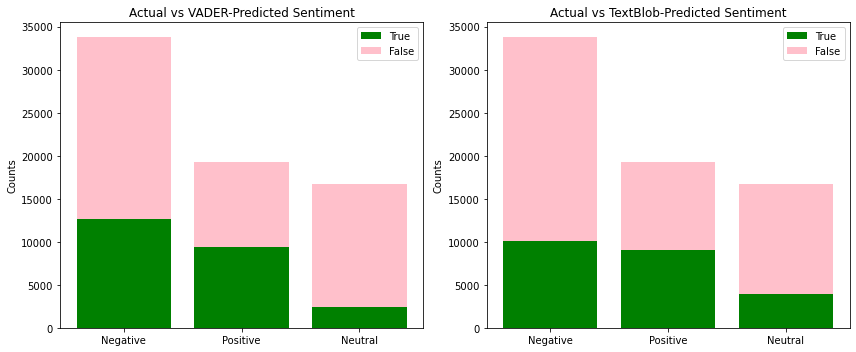

In [36]:
# Putting all the graphs together.

plt.figure(figsize=(12, 6))


# plot1 - VADER
true_neg_v = 12702
false_pos_v = 21106
true_pos_v = 9412
false_neg_v = 9870
true_neu_v = 2452
false_neu_v = 14220

# make a stacked bar graph
labels = ['Negative', 'Positive', 'Neutral']
true_results = [true_neg_v, true_pos_v, true_neu_v]
false_results = [false_pos_v, false_neg_v, false_neu_v]

# Subplot for VADER
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

# True results for VADER
axes[0].bar(labels, true_results, color='green', label='True')

# False results for VADER
axes[0].bar(labels, false_results, color='pink', bottom=true_results, label='False')

axes[0].set_ylabel('Counts')
axes[0].set_title('Actual vs VADER-Predicted Sentiment')
axes[0].legend()

# plot2 - TextBlob
true_neg_tb = 10072
false_pos_tb = 23736
true_pos_tb = 9043
false_neg_tb = 10239
false_neu_tb = 12770
true_neu_tb = 3902

labels = ['Negative', 'Positive', 'Neutral']
true_results_tb = [true_neg_tb, true_pos_tb, true_neu_tb]
false_results_tb = [false_pos_tb, false_neg_tb, false_neu_tb]

# True results for TextBlob
axes[1].bar(labels, true_results_tb, color='green', label='True')

# False results for TextBlob
axes[1].bar(labels, false_results_tb, color='pink', bottom=true_results_tb, label='False')

axes[1].set_ylabel('Counts')
axes[1].set_title('Actual vs TextBlob-Predicted Sentiment')
axes[1].legend()

plt.tight_layout()
plt.show()

In [37]:
# Percentages VADER
total_pos_v = true_pos_v + false_neg_v 
total_neg_v = true_neg_v + false_pos_v 
total_neu_v = true_neu_v + false_neu_v

percent_pos_true = (true_pos_v / total_pos_v) * 100 
percent_neg_true = (true_neg_v / total_neg_v) * 100
percent_pos_false = 100 - percent_neg_true
percent_neg_false = 100 - percent_pos_true
percent_neu_true = (true_neu_v / total_neu_v) * 100 
percent_neu_false = 100 - percent_neu_true

print(f' Percent True Positive: {percent_pos_true}%')
print(f' Percent False Negative: {percent_neg_false}%')
print(f' Percent True Negative: {percent_neg_true}%')
print(f' Percent False Positive: {percent_pos_false}%')
print(f' Percent True Neutral: {percent_neu_true}%')
print(f' Percent False Neutral: {percent_neu_false}%') 

 Percent True Positive: 48.81236386266985%
 Percent False Negative: 51.18763613733015%
 Percent True Negative: 37.57098911500237%
 Percent False Positive: 62.42901088499763%
 Percent True Neutral: 14.707293666026871%
 Percent False Neutral: 85.29270633397313%


In [38]:
# # Percentages TextBlob
# total_pos_tb = true_pos_tb + false_neg_tb 
# total_neg_tb = true_neg_tb + false_pos_tb 
# false_neu_tb = 12770
# one_no_polarity_tb = 17361

# percent_pos_true_tb = (true_pos_tb / total_pos_tb) * 100 
# percent_neg_true_tb = (true_neg_tb / total_neg_tb) * 100
# percent_pos_false_tb = 100 - percent_neg_true_tb
# percent_neg_false_tb = 100 - percent_pos_true_tb
# percent_one_no_pol_tb = (17361 / (total_pos_tb + total_neg_tb + false_neu_tb + one_no_polarity_tb)) * 100
# percent_false_neu_tb = (12770 / (total_pos_tb + total_neg_tb + false_neu_tb + one_no_polarity_tb)) * 100

# print(f' Percent True Positive: {percent_pos_true_tb}%')
# print(f' Percent False Negative: {percent_neg_false_tb}%')
# print(f' Percent True Negative: {percent_neg_true_tb}%')
# print(f' Percent False Positive: {percent_pos_false_tb}%')
# print(f' Percent False Neutral (overall): {percent_false_neu_tb}%')
# print(f' Percent One Factor w/o Polarity (overall): {percent_one_no_pol_tb}%') 

In [39]:
# Percentages TextBlob
total_pos_tb = true_pos_tb + false_neg_tb 
total_neg_tb = true_neg_tb + false_pos_tb 
total_neu_tb = true_neu_tb + false_neu_tb

percent_pos_true_tb = (true_pos_tb / total_pos_tb) * 100 
percent_neg_true_tb = (true_neg_tb / total_neg_tb) * 100
percent_pos_false_tb = 100 - percent_neg_true_tb
percent_neg_false_tb = 100 - percent_pos_true_tb
percent_neu_true_tb = (true_neu_tb / total_neu_tb) * 100 
percent_neu_false_tb = 100 - percent_neu_true_tb

print(f' Percent True Positive: {percent_pos_true_tb}%')
print(f' Percent False Negative: {percent_neg_false_tb}%')
print(f' Percent True Negative: {percent_neg_true_tb}%')
print(f' Percent False Positive: {percent_pos_false_tb}%')
print(f' Percent True Neutral: {percent_neu_true_tb}%')
print(f' Percent False Neutral: {percent_neu_false_tb}%') 

 Percent True Positive: 46.8986619645265%
 Percent False Negative: 53.1013380354735%
 Percent True Negative: 29.791765262659727%
 Percent False Positive: 70.20823473734028%
 Percent True Neutral: 23.40451055662188%
 Percent False Neutral: 76.59548944337811%
